In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import os
import re
import math
import time
import timeit

import sounddevice as sd
from scipy.io import wavfile
import IPython.display as ipd
import soundfile as sf

from multiprocess import Pool
import functools
import pdb

In [2]:
# import session_info
# session_info.show()

In [3]:
sd.query_devices()
# sd.default.device = 3

> 0 MacBook Air Microphone, Core Audio (1 in, 0 out)
< 1 MacBook Air Speakers, Core Audio (0 in, 2 out)
  2 ZoomAudioDevice, Core Audio (2 in, 2 out)

### Function to create file

In [4]:
def midi_to_timeseries(midiPath):
    """ Function that converts .txt file with midi events* to a list and returns all note on events.
    
    Args:
        midiPath: file path - .txt file with all note and pedal events of form [t,event,note/pedal,vel]
    
    Returns:
        time_notes: list of the form[[t,note,vel],[t,note,vel],[t,note,vel],...]
    
    """

    #    MIDI EVENT TYPES
    #    0x80 (hex)      128 (decimal)    Note Off
    #    0x90 (hex)      144 (decimal)    Note On
    #    0xB0 (hex)      176 (decimal)    Continuous Controller
    
    time_notes = []
    uniqueTypes = [128,144,176] 
            
    with open(midiPath) as midi_events:
        for line in midi_events:
            processedLine = line.split(" ")
    
            processedLine[0] = int(processedLine[0]) # processedLine[0] is timestamp
            processedLine[1] = int(processedLine[1], 16) # processedLine[1] is event type
            processedLine[2] = int(processedLine[2], 16) # processedLine[2] is note
            processedLine[3] = int(processedLine[3],16) # processedLine[3] is velocity

            if processedLine[1] not in uniqueTypes:
                print("unexpected event type got! ", processedLine[1])

            if processedLine[1] == 144:
                time_notes.append([processedLine[0], processedLine[2], processedLine[3]])
                
    return np.array(time_notes)

### Function to read .wav file

In [5]:
def read_audio(file):
    """ Function that reads .wav file of midi recording and saves it to a global variable
    Args:
        file: .txt file with midi notes
    """
    
    global samplerate, piano_audio
    samplerate, piano_audio = wavfile.read(file)

read_audio('Audio.wav')

/var/folders/f5/4s_l2s456y985n42_18zrt_00000gn/T/ipykernel_20157/2785934704.py:8: WavFileWarning: Chunk (non-data) not understood, skipping it.
  samplerate, piano_audio = wavfile.read(file)


### Functions to deal with notes as integers vs names

In [6]:
def int_to_note(i):
    """ Function that converts note from integer to name
    Args:
        i: integer value corresponding to note
    Returns:
        note: note name, eg. "C4" 
    """
    
    # convert integer to note
    notes = ['C','C#/Db','D','D#/Eb','E','F','F#/Gb','G','G#/Ab','A','A#/Bb','B']
    return notes[i%12] + str(i//12 - 1)

def note_to_int(note):
    """ Function that converts note from name to integer
    Args:
        note: note name, eg. "C4"
    Returns:
        i: integer value corresponding to note
    """
    
    # convert integer to note
    temp = re.compile("([a-zA-Z]+)([0-9]+)")
    note = temp.match(note).groups()
    notes = {'C':0,'C#/Db':1,'C#':1,'Db':1,'D':2,'D#/Eb':3,'D#':3,'Eb':3,'E':4,'F':5,'F#/Gb':6,'F#':6,'Gb':6,'G':7,'G#/Ab':8,'Ab':8,'G#':8,'A':9,'A#/Bb':10,'A#':10,'Bb':10,'B':11}
    return notes[note[0]] + 12*(int(note[1])+1)


### Functions to help judge quality of match

In [7]:
def predict(notes, source_id_start, source_id_end, target_id_start, target_id_end, curr_time,pred_time=100,sound=False):
    """ Function that predicts the next 100 ms given a match
    Args:
        notes: 
        source_id_start: 
        source_id_end: 
        target_id_start: 
        target_id_end: 
        curr_time: 
        
    Returns:
        pred: predicted notes for 100ms, [[predTime1, note1, vel1], [predTime2, note2, vel2],...]
    """
    
    # predicting pred_time(100ms) of music
    time_ratio = (notes[target_id_start][0]-notes[target_id_end][0])/(notes[source_id_start][0]-notes[source_id_end][0])
    last_matching_note_target=0
    for event1 in range(source_id_start,source_id_end,-1):
        for event2 in range(target_id_start,target_id_end,-1):
            s = note_similarity(notes[event1],notes[event2],time_ratio)
            if s > 0:
                last_matching_note_target = event2
                break
        if last_matching_note_target:
            break
    
    target_time = notes[last_matching_note_target][0]
    time = target_time
    predicted = [target_id_start]
    i = target_id_start + 10
    while time <= target_time + pred_time:
        if notes[i][0] < time:
            predicted.append(i)
            i += 1
        time += 10
    predicted.append(i)
    
        
    if(sound):
        play_match(notes[source_id_start][0],notes[source_id_end][0],notes[predicted[-1]][0],notes[predicted[0]][0],pausebetween=False)
        
    return predicted

def predict1(notes, target_time, curr_time, target_id_start, pred_time=100,sound=False):
    """ Function that predicts the next 100 ms given a match
    Args:
        notes: 
        source_id_start: 
        source_id_end: 
        target_id_start: 
        target_id_end: 
        curr_time: 
        
    Returns:
        pred: predicted notes for 100ms, [[predTime1, note1, vel1], [predTime2, note2, vel2],...]
    """
    
    # predicting pred_time(100ms) of music
    time = target_time
    predicted = [target_id_start]
    i = target_id_start + 10
    while time <= target_time + pred_time:
        if notes[i][0] < time:
            predicted.append(i)
            i += 1
        time += 10
    predicted.append(i)
        
    if(sound):
        play_match(notes[source_id_start][0],notes[source_id_end][0],notes[predicted[-1]][0],notes[predicted[0]][0],pausebetween=False)
        
    return predicted
    
def display_match(notes, source_id_start, source_id_end, target_id_start, target_id_end, score, sourceStart, targetStart):
    """ Function that displays the snippets if they match.
    Args:
        notes: note name, eg. "C4"
        source_start: 
        source_end: 
        target_start: 
        target_end: 
        score: 
        sourceStart: 
        targetStart: 
    """
    
    print("Score: ", score)
    print("Source({st}):  Target({tt}): ".format(st=source_id_end, tt=target_id_end))
    for i in range(min(source_id_start-source_id_end, target_id_start-target_id_end)):
        print(notes[i+source_id_end][0]-sourceStart, int_to_note(notes[i+source_id_end][1]), end=", ")
        print(notes[i+target_id_end][0]-targetStart, int_to_note(notes[i+target_id_end][1]))
    for i in range(target_id_start-target_id_end, source_id_start-source_id_end):
        print(notes[i+source_id_end][0]-sourceStart, int_to_note(notes[i+source_id_end][1]), end=", \n")
    for i in range(source_id_start-source_id_end, target_id_start-target_id_end):
        print("        ,",notes[i+target_id_end][0]-targetStart, int_to_note(notes[i+target_id_end][1]))
        
    print("  Next notes: ")
    for i in range(5):
        print(notes[i+source_id_start][0]-sourceStart,int_to_note(notes[i+source_id_start][1]), end=", ")
        print(notes[i+target_id_start][0]-targetStart,int_to_note(notes[i+target_id_start][1]))
        
    print()
        
def play_match(source_start, source_end, target_start, target_end, pausebetween=False):
    """ Function that plays portion of audio file corresponding to each sequence of a match
    Args:
        source_start: 
        source_end: 
        target_start: 
        target_end: 
    """
    
    global piano_audio
    ss = (source_start * samplerate) // 1000
    se = (source_end * samplerate) // 1000
    te = (target_end * samplerate) // 1000
    ts = (target_start * samplerate) // 1000
    #Source
    sd.play(piano_audio[se:ss], samplerate, blocking = True)
    if pausebetween:
        time.sleep(1)
    #Target
    sd.play(piano_audio[te:ts], samplerate, blocking = True)
    if pausebetween:
        time.sleep(1)
        
def display_snippet_plot(notes, source_start, source_end, target_start, target_end, score, sourceStart, targetStart):
    plt.figure(figsize = (10,5))
    lenSource = source_start-source_end
    lenTarget = target_start-target_end
    timeStampSourceEnd = notes[(lenSource - 1)+source_end][0]-sourceStart
    timeStampTargetEnd = notes[(lenTarget - 1)+target_end][0]-targetStart

    if timeStampSourceEnd >= timeStampTargetEnd:
        xmax = timeStampSourceEnd
    else:
        xmax = timeStampTargetEnd

#     plt.xlim(0,xmax)
    plt.xlabel("Relative Snippet Time (in MS)")
    # yscale = ['C','C#/Db','D','D#/Eb','E','F','F#/Gb','G','G#/Ab','A','A#/Bb','B']
    # plt.yticks(range(0,len(yscale)),yscale)
    plt.ylabel("Note (Integer Representation)")
    title = "Snippet Plot:" + ", Source @ " + str(notes[source_end][0]) + " ms, Target @ " + str(notes[target_end][0]) + " ms, Score: " + str(round(score,4))
    plt.title(title)
    plt.locator_params(axis="both", integer=True, tight=True)

    sourceX = []
    sourceY = []
    targetX = []
    targetY = []
    for i in range(min(source_start-source_end, target_start-target_end)):
        sourceX.append(notes[i+source_end][0]-sourceStart)
        sourceY.append((notes[i+source_end][1]))
        targetX.append(notes[i+target_end][0]-targetStart)
        targetY.append((notes[i+target_end][1]))
    for i in range(target_start-target_end, source_start-source_end):
        sourceX.append(notes[i+source_end][0]-sourceStart)
        sourceY.append((notes[i+source_end][1]))
    for i in range(source_start-source_end, target_start-target_end):
        targetX.append(notes[i+target_end][0]-targetStart)
        targetY.append((notes[i+target_end][1]))

    plt.scatter(sourceX, sourceY, label="Source",marker='*')
    plt.scatter(targetX, targetY, label="Target",marker='.')
    plt.legend()
    plt.show()

def display_snippet_plot_2(sequence1,sequence2,source_start,target_start,score=0,time_ratio=1):
    plt.figure(figsize = (10,5))

#     plt.xlim(0,xmax)
    plt.xlabel("Relative Snippet Time (in MS)")
    # yscale = ['C','C#/Db','D','D#/Eb','E','F','F#/Gb','G','G#/Ab','A','A#/Bb','B']
    # plt.yticks(range(0,len(yscale)),yscale)
    plt.ylabel("Note (Integer Representation)")
    plt.locator_params(axis="both", integer=True, tight=True)

    sourceX = [] # x axis - source timestamp in ms
    sourceY = [] # y axis - note integer repr for source
    targetX = []
    targetY = []
    for i in range(len(sequence1)):
        sourceX.append(sequence1[i][0]*time_ratio)
        sourceY.append(sequence1[i][1])

    for i in range(len(sequence2)):
        targetX.append(sequence2[i][0])
        targetY.append(sequence2[i][1])

    title = "Snippet Plot:" + ", Source @ " + str(source_start) + " ms, Target @ " + \
        str(target_start) + " ms, Score: " + str(score) + ", Length (ms): "+ str(sourceX[-1]-sourceX[0])
    plt.title(title)
    plt.scatter(sourceX, sourceY, label="Source",marker='*')
    plt.scatter(targetX, targetY, label="Target",marker='.')
    plt.legend()
    plt.show()
    
    
    

In [8]:
# Generates .wav file of predictions
def gen_prediction_wav(notes, df, thresh=0.7, pred_time=100):
    """ Function that ...
    
    Args:
        notes: list of all note arrays of lengths min_notes to max_notes snip[1][2][3][4]
               1 - length of snip, 2 - start index from notes, 3 - index of note in array, 4 - [t, note, vel]
        df: Pandas DataFrame of source, match, and score information
                columns: ["source_timestamp","target_timestamp", "score", "source_id_start", "source_id_end", "target_id_start", "target_id_end"]
        pred_time: number of ms outwards to predict
    
    Returns:
        pred_audio: Numpy array of WAV bits corresponding to predicted WAV file 
    
    """
    # Create blank Numpy WAV data
    global input_audio
    input_audio = np.mean(piano_audio,axis=1)
    input_audio /= np.max(input_audio)
    pred_audio = np.zeros(input_audio.shape)

    # Loop through matches
    arr = np.array(df)
    for i in range(arr.shape[0]):

        # Extract data per match
        sourceTimestamp = arr[i,0]
        targetTimestamp = arr[i,1]
        score = arr[i,2]
        sourceIDStart = int(arr[i,3])
        sourceIDEnd = int(arr[i,4])
        targetIDStart = int(arr[i,5])
        targetIDEnd = int(arr[i,6])

        # Get predicted notes
#         predicted = predict1(notes, targetTimestamp, sourceTimestamp, targetIDStart, pred_time=pred_time, sound=False)

        # Calculate indices to extract from piano_audio
        predEnd = int(targetTimestamp * samplerate) // 1000
        predStart = int((targetTimestamp + pred_time) * samplerate) // 1000

        # Calculate indices for placing data in pred_audio
        locStart = int(sourceTimestamp * samplerate) // 1000
        dist = predStart - predEnd
        locEnd = locStart + dist

        # Makes sure we don't overwrite existing match data
        nonZero = False
        if locEnd >= piano_audio.shape[0] or pred_audio[locStart:locEnd].any():
            nonZero = True
            print("Avoiding overwriting existing data!")
        
        # Only writes to pred_audio if score is above our 0.7 threshold
        if not nonZero and score > thresh:
            pred_audio[locStart:locEnd] = input_audio[predEnd:predStart]
            
    return pred_audio

### Functions to calculate similarity

In [88]:
def two_way_similarity(tf1, tf2, disp = False):
    a1,b1,c1,d1,score1 = musical_similarity(tf1,tf2,disp)
    b2,a2,d2,c2,score2 = musical_similarity(tf2,tf1,disp)
    if score1>score2:
        return a1,b1,c1,d1,score1
    return a2,b2,c2,d2,score2

def musical_similarity(tf1, tf2, disp = False):
    """ Function that calculates similarity score between 2 snippets 
        eg [[-17,60],[-100,62],[-101,64],[-300,60]] and [[-20,60],[-50,61],[-101,64],[-102,62],[-307,60]]
    
    Args:
        tf1: first snippet [[t,note],[t,note],[t,note],...]
        tf2: second snippet [[t,note],[t,note],[t,note],...]
    
    Returns:
        lastmatch1: index of tf1 corresponding to last matching note between tf1 and tf2
        lastmatch2: index of tf2 corresponding to last matching note between tf1 and tf2
        mean_offset1: mean time dist between matching notes of 2 snippets (wrt last note being matched)
    
        score: similarity - integer between 0 to 1
    
    """
    
    # TO dO: 
    # 1) trim unmatched ends of both snips before penalizing 0 scores
    # 2) penalize 0 scores more
    # 3) fix scaling
    
#     pdb.set_trace()
    
    tf1 = np.array(tf1)
    tf2 = np.array(tf2)
    
    # updating time stamps wrt first note for tf1
    sequence1 = tf1
    sequence1[:,0] = tf1[:,0]-tf1[-1,0]
    
    # updating time stamps wrt first note for tf2
    ind = np.argwhere(tf2[:,1] == tf1[-1,1])
    if ind.any():
        ind = ind[-1]
#         print("ind: ",ind,tf2[-1:],tf2[ind])
        lastmatch1 = tf1.shape[0]-1
        lastmatch2 = int(ind[0])
        mo = tf2[-1,0]-tf2[ind,0]
        if type(lastmatch1) != int or type(lastmatch2) != int:
            print(type(lastmatch1),type(lastmatch2))
        if (tf1[lastmatch1] != tf1[-1]).all():
            print("Error in lastmatch1:",lastmatch1)
    else:
        ind = -1
        lastmatch1 = None
        lastmatch2 = None
        mo = 0
    sequence2 = tf2
    sequence2[:,0] = tf2[:,0]-tf2[ind,0]
    
    seq_1_time_del = tf1[-1,0] - tf1[0,0]
    seq_2_time_del = tf2[-1,0] - tf2[0,0]
    
    time_ratio = seq_2_time_del / seq_1_time_del
    
    # Calculating score array by comparing every note from each sequence and taking the best match
    scores, mean_offset1, mean_offset2 = note_similarity_vect2_mean(sequence1,sequence2,time_ratio*(np.arange(sequence2.shape[0],0,-1)))
    
    score = scores.max(axis=0)
    score2 = scores.max(axis=1)
    if lastmatch1 == None:
        lastmatch1, = np.nonzero(score)
        if lastmatch1.any():
            lastmatch1 = lastmatch1[-1]
        else:
            lastmatch1 = -1
        lastmatch2, = np.nonzero(score2)
        if lastmatch2.any():
            lastmatch2 = lastmatch2[-1]
        else:
            lastmatch2 = -1
#     mo += sequence1[lastmatch1][0] - sequence2[lastmatch2][0]
    
    # For every pair of notes in both sequences, if a match was not found, add a zero score
    count_zeros = np.sum(score==0)
    count_score = sequence1.shape[0] + sequence2.shape[0] + count_zeros - score.shape[0]
  
    # Similarity of the two sequences is the mean of the note similarity scores
    score_1 = np.sum(score)/(count_score)
    
    # including length in score, if at least 5 notes
    if len(tf1)>5:
        score_1 += score_1 * seq_1_time_del/500000 # 50 seconds yield 10% increase
    
    if disp:# and score_1>0.7:
        print("Scores:",score)
        print("Sequence1: ",sequence1)
        print("Sequence2: ",sequence2)
        print("mean_offset1: ", mean_offset1)
        print("mean_offset2: ", mean_offset2)
        print("mo: ", mo)
        print("Count zeros: ",count_zeros)
#         print("Matched vals: ",matched_targets)
        display_snippet_plot_2(sequence1,np.array(sequence2),tf1[0][0],tf2[0][0],score_1, 1)
    
    return lastmatch1, lastmatch2, mean_offset1-mo, mean_offset2+mo, score_1

def note_similarity_vect2(sequence1,sequence2,ratio):
    """ Function that calculates similarity score between 2 notes - depending on note value and time
    
    Args:
        note1: first note to compare [t,note]
        note2: second note to compare [t,note]
    
    Returns:
        score: similarity - integer between 0 to 1
    
    """
    # score is linear with time difference between notes
    
    min_dist = 50 * ratio[:,None] # acceptable time difference for same note
#     min_dist = 600 + np.minimum((10 * ratio[:,None]),200) # alternate
    
    time_diff = abs(sequence1[None,:,0] - sequence2[:,None,0]).astype(float)
    
    # remapping time diff to 0.5-1
    op = (sequence1[None,:,1] == sequence2[:,None,1]) * (time_diff < (min_dist)) * (1 - time_diff/min_dist)
    
    return op

def note_similarity_vect2_mean(sequence1,sequence2,ratio):
    """ Function that calculates similarity score between 2 notes - depending on note value and time
    
    Args:
        note1: first note to compare [t,note]
        note2: second note to compare [t,note]
    
    Returns:
        score: similarity - integer between 0 to 1
    
    """
    # score is linear with time difference between notes
    
#     min_dist = 50 * ratio[:,None] # acceptable time difference for same note
    min_dist = 400
    max_offset = 600
    
    time_diff = abs(sequence1[None,:,0] - sequence2[:,None,0]).astype(float)
    time_diff_sign = np.sign(sequence1[None,:,0] - sequence2[:,None,0]).astype(float)
    
    # re-aligning sequences
    offset = (sequence1[None,:,1] == sequence2[:,None,1]) * (time_diff) + (sequence1[None,:,1] != sequence2[:,None,1]) * 100000
#     print(offset)
    offset1 = offset.argmin(axis = 0)
    offset1 = np.diag(offset[offset1,:] * time_diff_sign[offset1,:]) * -1
    if len(np.nonzero(np.abs(offset1)<max_offset)[0]) == 0:
        offset1 = 0
    else:
        offset1 = np.sum(offset1[np.abs(offset1)<max_offset])/len(np.nonzero(np.abs(offset1)<max_offset)[0])
    offset2 = offset.argmin(axis = 1)
    offset2 = np.diag(offset[:,offset2] * time_diff_sign[:,offset2])
    if len(np.nonzero(np.abs(offset2)<max_offset)[0]) == 0:
        offset2 = 0
    else:
        offset2 = np.sum(offset2[np.abs(offset2)<max_offset])/len(np.nonzero(np.abs(offset2)<max_offset)[0])
    sequence2[:,0] += int(offset2)
    
    # calculating score based on time difference between maching notes
    time_diff = abs(sequence1[None,:,0] - sequence2[:,None,0]).astype(float)
    op = (sequence1[None,:,1] == sequence2[:,None,1]) * ((time_diff) < (min_dist)) * (1 - (time_diff)/min_dist)
    
    return op,offset1,offset2
    
    

### Helper Functions

In [10]:
def time_to_index(notes, timestamp):
    for i in range(len(notes)):
        if notes[i][0] >= timestamp:
            return i
        
def index_to_time(notes, index):
    return notes[index][0]

def index_to_sequence(notes, ids): # assume start>end & not include start for convention
    start_id, end_id = ids
    sequence = []
    for i in range(end_id,start_id):
        sequence.appaned(notes[i])
    return sequence

def time_to_sequence(notes, times): # assume start>end & not include start for convention
    start, end = times
    i = time_to_index(notes, end)
    sequence = []
    while i < len(notes):
        if notes[i][0]>=start:
            break
        sequence.append(notes[i])
        i += 1
    return sequence

def find_note(notes, time, note_val, max_time_dist = 10000):
    note_id = time_to_index(notes,time)
    op1 = None
    op2 = None
    
    end = time_to_index(notes,min(time+max_time_dist,notes[-1][0]))-1
    # checking forward
    for i in range(note_id,end):
        if notes[i][1] == note_val:
            if abs(notes[i][0]-time) > max_time_dist:
                print("UP",abs(notes[i][0]-time))
            op1 = i
            break
    
    end = time_to_index(notes,max(time-max_time_dist,0))
    # checking reverse
    for i in range(note_id-1,end,-1):
        if notes[i][1] == note_val:
            if abs(notes[i][0]-time) > max_time_dist:
                print("DOWN",abs(notes[i][0]-time),time,time-max_time_dist,note_id,end,i)
            op2 = i
            break
    
    if not op1:
        return op2
    if not op2:
        return op1
    if abs(notes[op1][0]-time) < abs(time-notes[op2][0]):
        return op1
    return op2


In [11]:
midiPath = '../midi-recordings/ladispute.txt'
# midiPath = '../midi-recordings/2_prelude.txt'
notes = midi_to_timeseries(midiPath)

Scores: [-0.     -0.      0.885   0.85    0.955   0.8175  0.9125  0.915   0.945
  0.99    0.9375  0.9675  0.975   0.9875  0.9625  0.7675  0.8475  0.9225
  0.93    0.97    1.    ]
Sequence1:  [[-4814    55    45]
 [-4790    59    39]
 [-4184    71    55]
 [-4173    50    45]
 [-3578    55    51]
 [-3573    59    34]
 [-3030    55    48]
 [-3014    59    29]
 [-2804    62    49]
 [-2728    63    54]
 [-2644    65    59]
 [-2461    63    54]
 [-2444    51    53]
 [-1822    58    36]
 [-1820    55    44]
 [-1264    55    49]
 [-1250    58    44]
 [ -613    70    58]
 [ -602    51    46]
 [   -3    55    45]
 [    0    58    32]]
Sequence2:  [[-4233    50    42]
 [-4230    71    55]
 [-3646    59    37]
 [-3596    55    39]
 [-2995    55    46]
 [-2980    59    23]
 [-2782    62    43]
 [-2724    63    56]
 [-2619    65    45]
 [-2474    63    49]
 [-2434    51    53]
 [-1835    55    49]
 [-1827    58    34]
 [-1189    58    26]
 [-1171    55    35]
 [ -644    70    53]
 [ -630    51    51

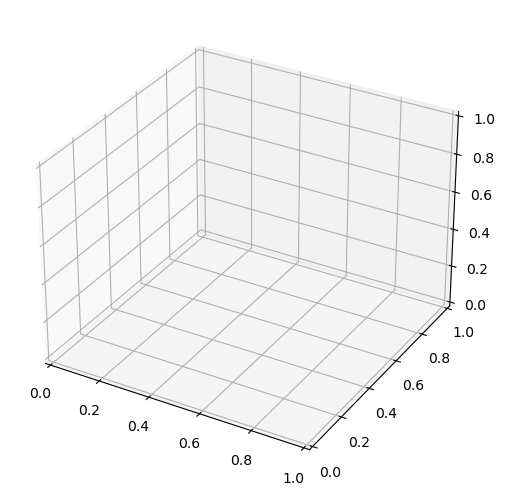

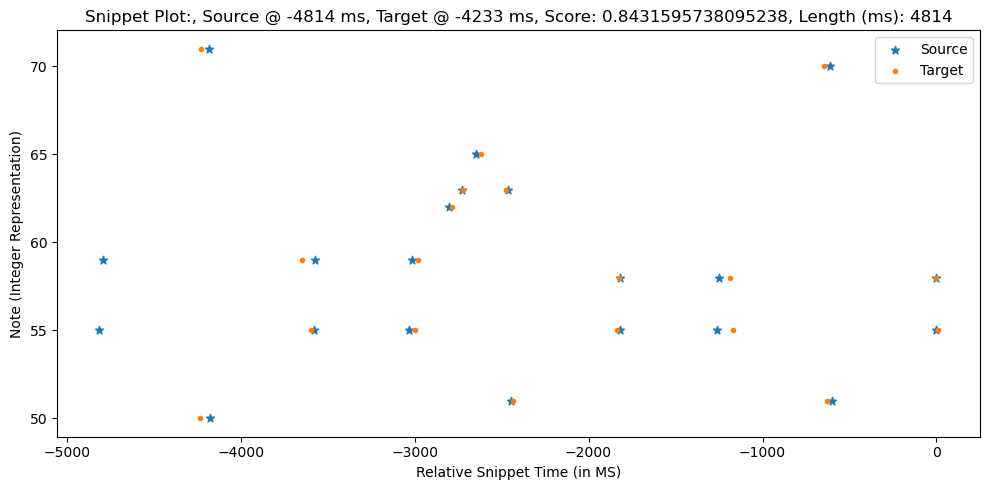

Scores: [0.8475 0.8825 0.815  0.9525 0.915  0.9175 0.9475 0.9925 0.94   0.965
 0.9775 0.96   0.985  0.85   0.77   0.92   0.9275 0.9975 0.9725]
Sequence1:  [[-4231    50    42]
 [-4228    71    55]
 [-3644    59    37]
 [-3594    55    39]
 [-2993    55    46]
 [-2978    59    23]
 [-2780    62    43]
 [-2722    63    56]
 [-2617    65    45]
 [-2472    63    49]
 [-2432    51    53]
 [-1833    55    49]
 [-1825    58    34]
 [-1187    58    26]
 [-1169    55    35]
 [ -642    70    53]
 [ -628    51    51]
 [    2    58    33]
 [   11    55    42]]
Sequence2:  [[-4811    55    45]
 [-4787    59    39]
 [-4181    71    55]
 [-4170    50    45]
 [-3575    55    51]
 [-3570    59    34]
 [-3027    55    48]
 [-3011    59    29]
 [-2801    62    49]
 [-2725    63    54]
 [-2641    65    59]
 [-2458    63    54]
 [-2441    51    53]
 [-1819    58    36]
 [-1817    55    44]
 [-1261    55    49]
 [-1247    58    44]
 [ -610    70    58]
 [ -599    51    46]
 [    0    55    45]
 [    3    58

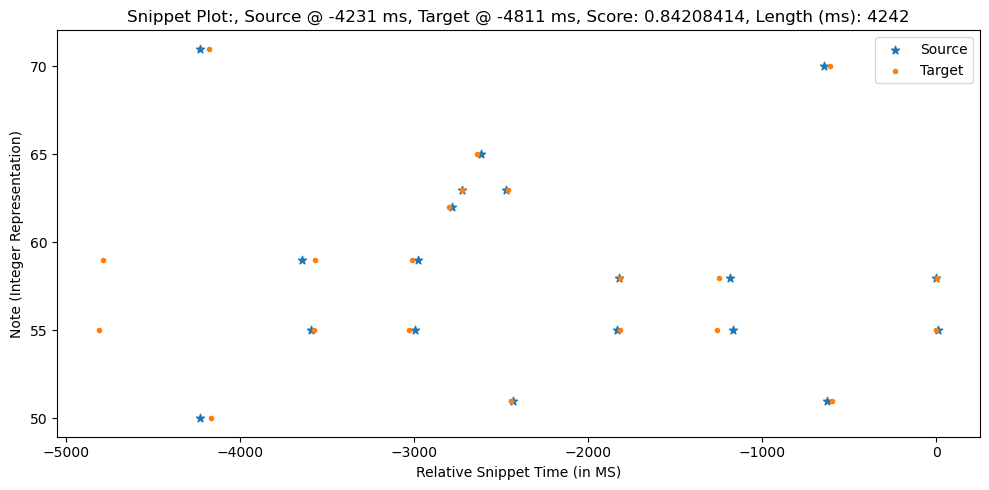

0.8431595738095238
Scores: [-0.     -0.      0.9075  0.8725  0.9775  0.84    0.89    0.8925  0.9225
  0.9675  0.915   0.99    0.9525  0.99    0.985   0.745   0.825   0.945
  0.9525  0.9475  0.9775  0.965  -0.      0.915   0.9325  0.9525  0.9
  0.89  ]
Sequence1:  [[-6552    55    45]
 [-6528    59    39]
 [-5922    71    55]
 [-5911    50    45]
 [-5316    55    51]
 [-5311    59    34]
 [-4768    55    48]
 [-4752    59    29]
 [-4542    62    49]
 [-4466    63    54]
 [-4382    65    59]
 [-4199    63    54]
 [-4182    51    53]
 [-3560    58    36]
 [-3558    55    44]
 [-3002    55    49]
 [-2988    58    44]
 [-2351    70    58]
 [-2340    51    46]
 [-1741    55    45]
 [-1738    58    32]
 [-1134    55    48]
 [-1122    58    39]
 [ -688    63    52]
 [ -552    50    42]
 [ -540    62    56]
 [   42    59    46]
 [   44    55    46]]
Sequence2:  [[-5962    50    42]
 [-5959    71    55]
 [-5375    59    37]
 [-5325    55    39]
 [-4724    55    46]
 [-4709    59    23]
 [-4511  

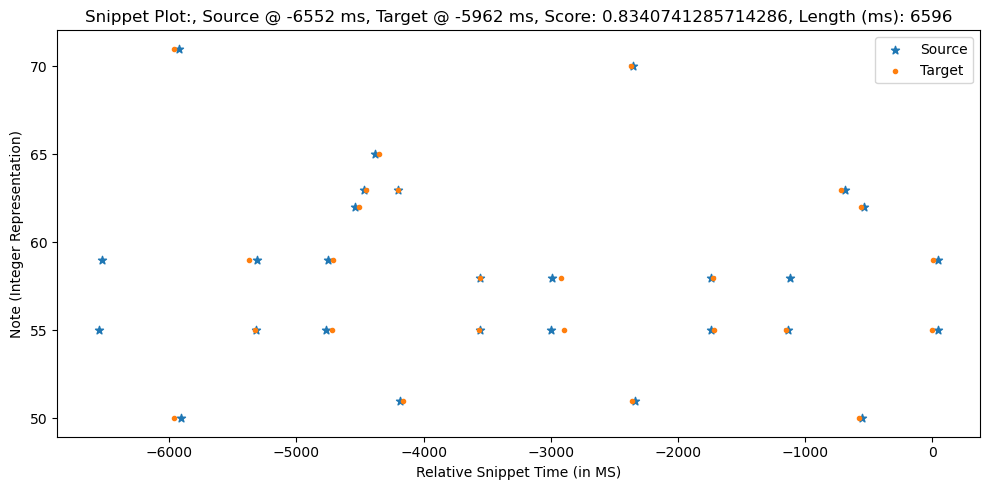

Scores: [0.8725 0.9075 0.84   0.9775 0.89   0.8925 0.9225 0.9675 0.915  0.99
 0.9525 0.985  0.99   0.825  0.745  0.945  0.9525 0.9775 0.9475 0.965
 0.915  0.9325 0.9525 0.89   0.9   ]
Sequence1:  [[-6004    50    42]
 [-6001    71    55]
 [-5417    59    37]
 [-5367    55    39]
 [-4766    55    46]
 [-4751    59    23]
 [-4553    62    43]
 [-4495    63    56]
 [-4390    65    45]
 [-4245    63    49]
 [-4205    51    53]
 [-3606    55    49]
 [-3598    58    34]
 [-2960    58    26]
 [-2942    55    35]
 [-2415    70    53]
 [-2401    51    51]
 [-1771    58    33]
 [-1762    55    42]
 [-1190    55    48]
 [ -764    63    49]
 [ -621    50    44]
 [ -601    62    54]
 [  -42    55    44]
 [  -40    59    42]]
Sequence2:  [[-6594    55    45]
 [-6570    59    39]
 [-5964    71    55]
 [-5953    50    45]
 [-5358    55    51]
 [-5353    59    34]
 [-4810    55    48]
 [-4794    59    29]
 [-4584    62    49]
 [-4508    63    54]
 [-4424    65    59]
 [-4241    63    54]
 [-4224    51 

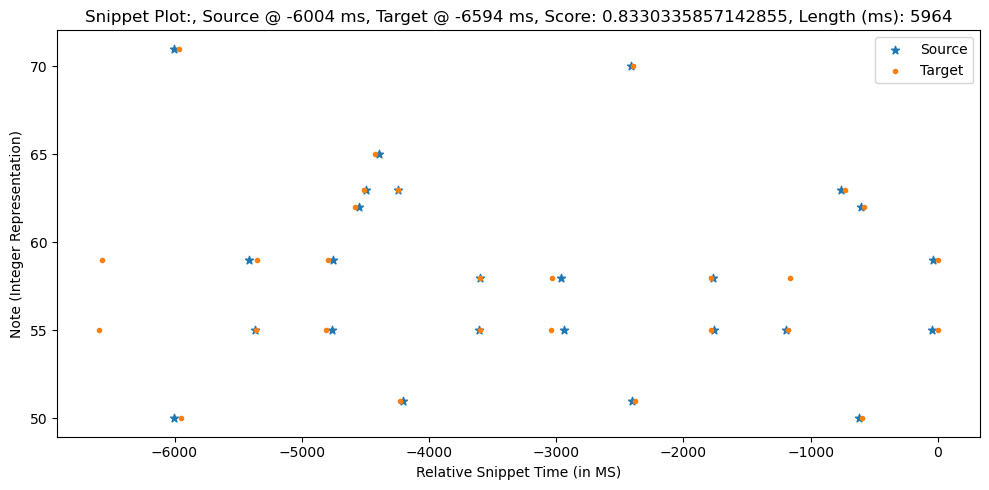

0.8340741285714286
Scores: [-0.     -0.      0.915   0.88    0.985   0.8475  0.8825  0.885   0.915
  0.96    0.9075  0.9975  0.945   0.9825  0.9925  0.7375  0.8175  0.9525
  0.96    0.94    0.97    0.9725 -0.      0.9225  0.94    0.96    0.9075
  0.8975  0.975   0.94    0.8675  0.9575  0.9425]
Sequence1:  [[-8384    55    45]
 [-8360    59    39]
 [-7754    71    55]
 [-7743    50    45]
 [-7148    55    51]
 [-7143    59    34]
 [-6600    55    48]
 [-6584    59    29]
 [-6374    62    49]
 [-6298    63    54]
 [-6214    65    59]
 [-6031    63    54]
 [-6014    51    53]
 [-5392    58    36]
 [-5390    55    44]
 [-4834    55    49]
 [-4820    58    44]
 [-4183    70    58]
 [-4172    51    46]
 [-3573    55    45]
 [-3570    58    32]
 [-2966    55    48]
 [-2954    58    39]
 [-2520    63    52]
 [-2384    50    42]
 [-2372    62    56]
 [-1790    59    46]
 [-1788    55    46]
 [-1195    59    42]
 [-1189    55    48]
 [ -580    50    46]
 [   21    59    39]
 [   23    55    44]]

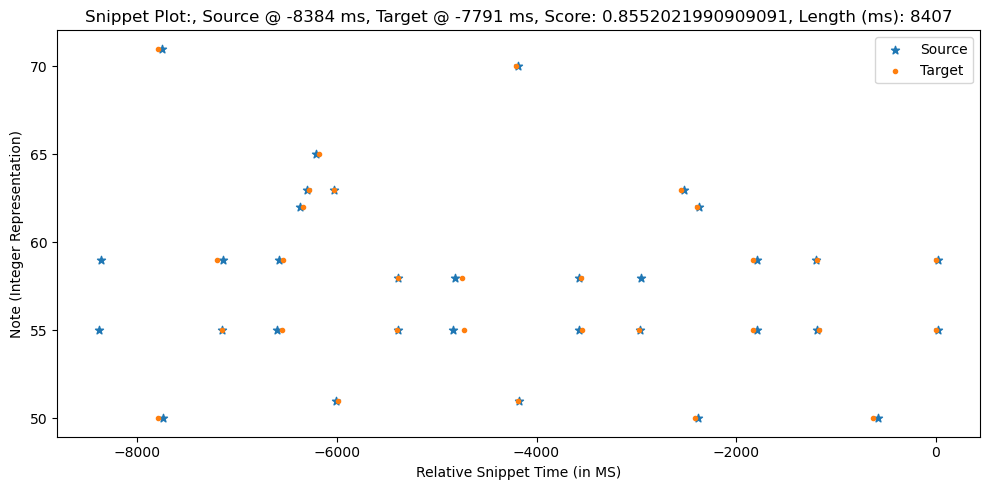

Scores: [0.88   0.915  0.8475 0.985  0.8825 0.885  0.915  0.96   0.9075 0.9975
 0.945  0.9925 0.9825 0.8175 0.7375 0.9525 0.96   0.97   0.94   0.9725
 0.9225 0.94   0.96   0.8975 0.9075 0.975  0.94   0.8675 0.9425 0.9575]
Sequence1:  [[-7812    50    42]
 [-7809    71    55]
 [-7225    59    37]
 [-7175    55    39]
 [-6574    55    46]
 [-6559    59    23]
 [-6361    62    43]
 [-6303    63    56]
 [-6198    65    45]
 [-6053    63    49]
 [-6013    51    53]
 [-5414    55    49]
 [-5406    58    34]
 [-4768    58    26]
 [-4750    55    35]
 [-4223    70    53]
 [-4209    51    51]
 [-3579    58    33]
 [-3570    55    42]
 [-2998    55    48]
 [-2572    63    49]
 [-2429    50    44]
 [-2409    62    54]
 [-1850    55    44]
 [-1848    59    42]
 [-1206    59    41]
 [-1186    55    45]
 [ -654    50    51]
 [  -21    55    44]
 [  -17    59    40]]
Sequence2:  [[-8405    55    45]
 [-8381    59    39]
 [-7775    71    55]
 [-7764    50    45]
 [-7169    55    51]
 [-7164    59    3

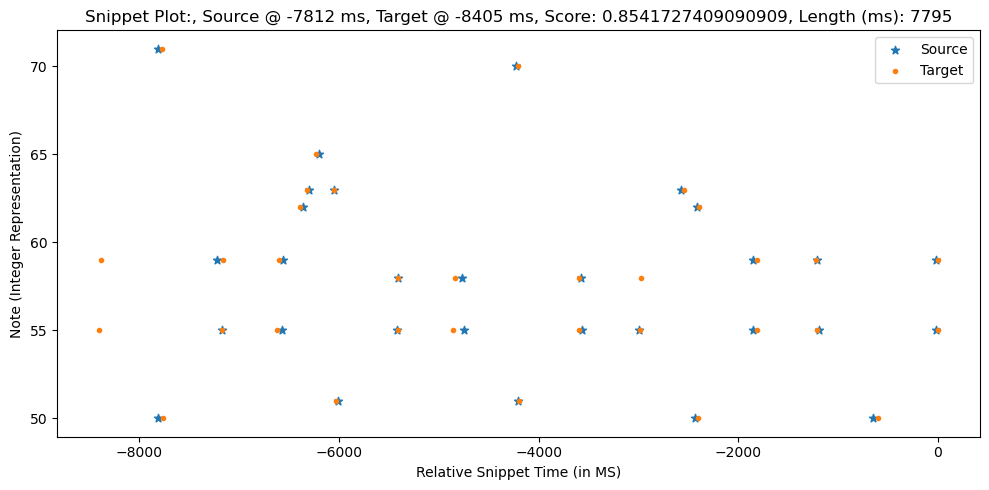

0.8552021990909091
Scores: [-0.     -0.      0.92    0.885   0.99    0.8525  0.8775  0.88    0.91
  0.955   0.9025  0.9975  0.94    0.9775  0.9975  0.7325  0.8125  0.9575
  0.965   0.935   0.965   0.9775 -0.      0.9275  0.945   0.965   0.9125
  0.9025  0.97    0.935   0.8725  0.9625  0.9475 -0.      0.925   0.99
  0.9725 -0.      0.935   0.8225]
Sequence1:  [[-10761     55     45]
 [-10737     59     39]
 [-10131     71     55]
 [-10120     50     45]
 [ -9525     55     51]
 [ -9520     59     34]
 [ -8977     55     48]
 [ -8961     59     29]
 [ -8751     62     49]
 [ -8675     63     54]
 [ -8591     65     59]
 [ -8408     63     54]
 [ -8391     51     53]
 [ -7769     58     36]
 [ -7767     55     44]
 [ -7211     55     49]
 [ -7197     58     44]
 [ -6560     70     58]
 [ -6549     51     46]
 [ -5950     55     45]
 [ -5947     58     32]
 [ -5343     55     48]
 [ -5331     58     39]
 [ -4897     63     52]
 [ -4761     50     42]
 [ -4749     62     56]
 [ -4167     59

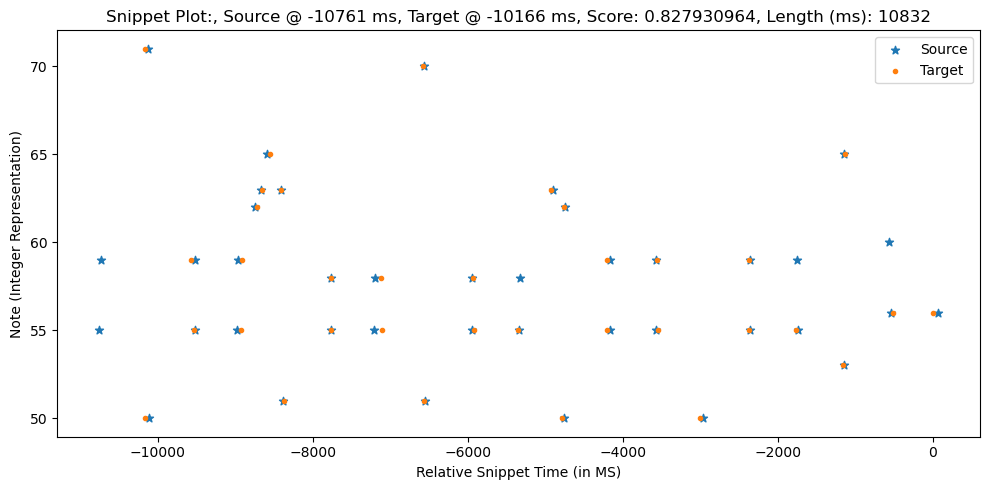

Scores: [0.885  0.92   0.8525 0.99   0.8775 0.88   0.91   0.955  0.9025 0.9975
 0.94   0.9975 0.9775 0.8125 0.7325 0.9575 0.965  0.965  0.935  0.9775
 0.9275 0.945  0.965  0.9025 0.9125 0.97   0.935  0.8725 0.9475 0.9625
 0.925  0.99   0.9725 0.935  0.8225]
Sequence1:  [[-10237     50     42]
 [-10234     71     55]
 [ -9650     59     37]
 [ -9600     55     39]
 [ -8999     55     46]
 [ -8984     59     23]
 [ -8786     62     43]
 [ -8728     63     56]
 [ -8623     65     45]
 [ -8478     63     49]
 [ -8438     51     53]
 [ -7839     55     49]
 [ -7831     58     34]
 [ -7193     58     26]
 [ -7175     55     35]
 [ -6648     70     53]
 [ -6634     51     51]
 [ -6004     58     33]
 [ -5995     55     42]
 [ -5423     55     48]
 [ -4997     63     49]
 [ -4854     50     44]
 [ -4834     62     54]
 [ -4275     55     44]
 [ -4273     59     42]
 [ -3631     59     41]
 [ -3611     55     45]
 [ -3079     50     51]
 [ -2446     55     44]
 [ -2442     59     40]
 [ -1833  

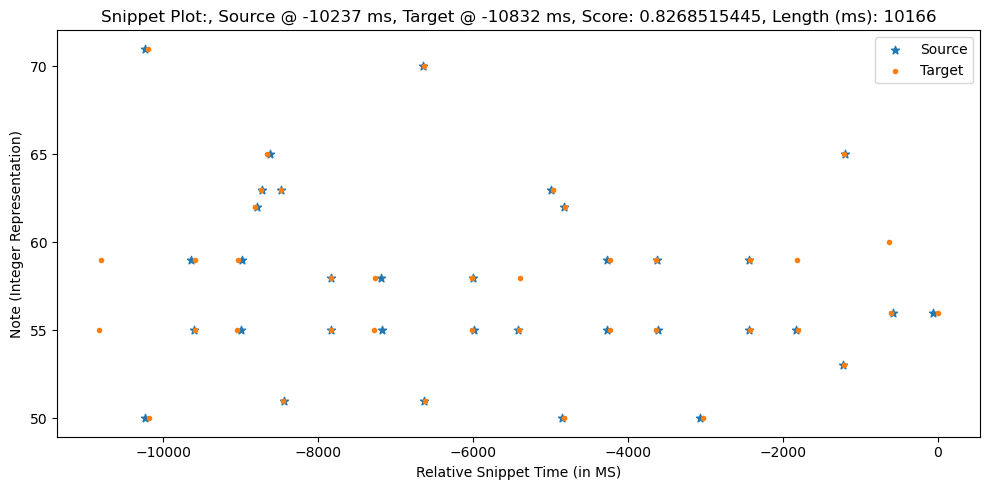

0.827930964
Scores: [-0.     -0.      0.91    0.875   0.98    0.8425  0.8875  0.89    0.92
  0.965   0.9125  0.9925  0.95    0.9875  0.9875  0.7425  0.8225  0.9475
  0.955   0.945   0.975   0.9675 -0.      0.9175  0.935   0.955   0.9025
  0.8925  0.98    0.945   0.8625  0.9525  0.9375 -0.      0.915   0.98
  0.9825 -0.      0.945   0.8125  0.95    0.945   0.925   0.9675  0.93
  0.9575]
Sequence1:  [[-12665     55     45]
 [-12641     59     39]
 [-12035     71     55]
 [-12024     50     45]
 [-11429     55     51]
 [-11424     59     34]
 [-10881     55     48]
 [-10865     59     29]
 [-10655     62     49]
 [-10579     63     54]
 [-10495     65     59]
 [-10312     63     54]
 [-10295     51     53]
 [ -9673     58     36]
 [ -9671     55     44]
 [ -9115     55     49]
 [ -9101     58     44]
 [ -8464     70     58]
 [ -8453     51     46]
 [ -7854     55     45]
 [ -7851     58     32]
 [ -7247     55     48]
 [ -7235     58     39]
 [ -6801     63     52]
 [ -6665     50     42]

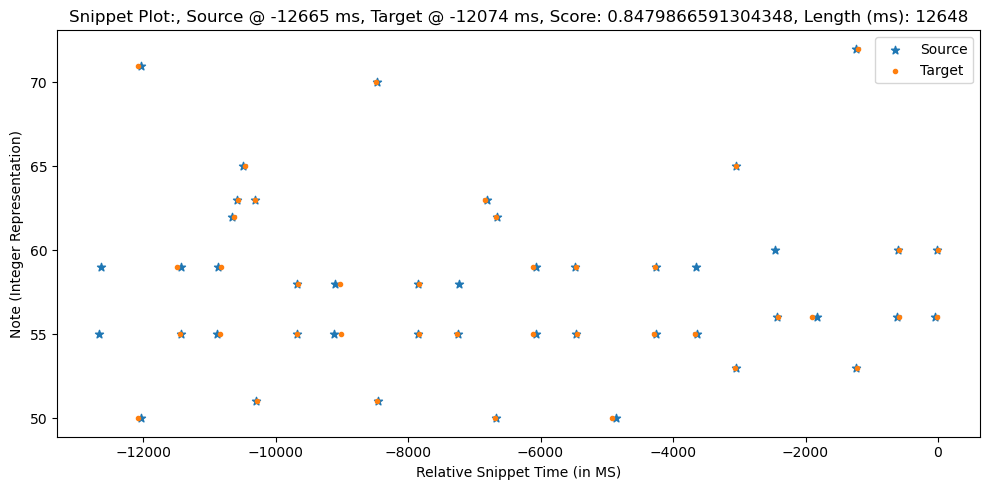

Scores: [0.875  0.91   0.8425 0.98   0.8875 0.89   0.92   0.965  0.9125 0.9925
 0.95   0.9875 0.9875 0.8225 0.7425 0.9475 0.955  0.975  0.945  0.9675
 0.9175 0.935  0.955  0.8925 0.9025 0.98   0.945  0.8625 0.9375 0.9525
 0.915  0.98   0.9825 0.945  0.8125 0.95   0.945  0.9675 0.925  0.93
 0.9575]
Sequence1:  [[-12057     50     42]
 [-12054     71     55]
 [-11470     59     37]
 [-11420     55     39]
 [-10819     55     46]
 [-10804     59     23]
 [-10606     62     43]
 [-10548     63     56]
 [-10443     65     45]
 [-10298     63     49]
 [-10258     51     53]
 [ -9659     55     49]
 [ -9651     58     34]
 [ -9013     58     26]
 [ -8995     55     35]
 [ -8468     70     53]
 [ -8454     51     51]
 [ -7824     58     33]
 [ -7815     55     42]
 [ -7243     55     48]
 [ -6817     63     49]
 [ -6674     50     44]
 [ -6654     62     54]
 [ -6095     55     44]
 [ -6093     59     42]
 [ -5451     59     41]
 [ -5431     55     45]
 [ -4899     50     51]
 [ -4266     55  

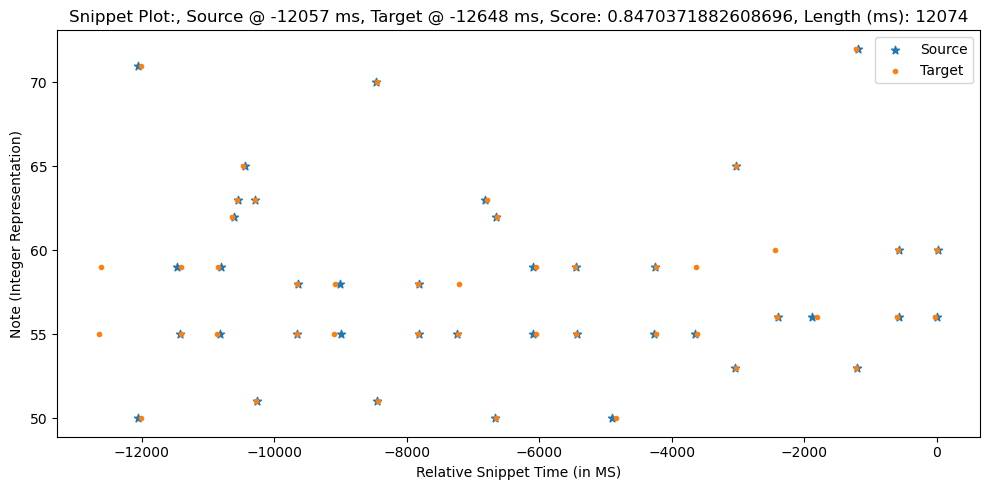

0.8479866591304348
Scores: [-0.     -0.      0.905   0.87    0.975   0.8375  0.8925  0.895   0.925
  0.97    0.9175  0.9875  0.955   0.9925  0.9825  0.7475  0.8275  0.9425
  0.95    0.95    0.98    0.9625 -0.      0.9125  0.93    0.95    0.8975
  0.8875  0.985   0.95    0.8575  0.9475  0.9325 -0.      0.91    0.975
  0.9875 -0.      0.95    0.8075  0.955   0.95    0.93    0.9725  0.935
  0.9625  0.915   0.9925  0.9     0.8525  0.8725  0.9375  0.9375]
Sequence1:  [[-14417     55     45]
 [-14393     59     39]
 [-13787     71     55]
 [-13776     50     45]
 [-13181     55     51]
 [-13176     59     34]
 [-12633     55     48]
 [-12617     59     29]
 [-12407     62     49]
 [-12331     63     54]
 [-12247     65     59]
 [-12064     63     54]
 [-12047     51     53]
 [-11425     58     36]
 [-11423     55     44]
 [-10867     55     49]
 [-10853     58     44]
 [-10216     70     58]
 [-10205     51     46]
 [ -9606     55     45]
 [ -9603     58     32]
 [ -8999     55     48]
 [ -8

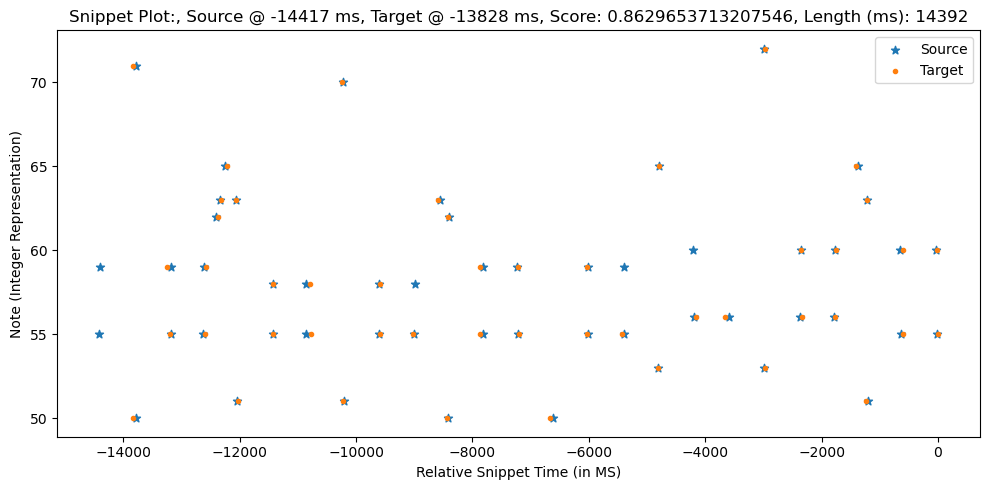

Scores: [0.87   0.905  0.8375 0.975  0.8925 0.895  0.925  0.97   0.9175 0.9875
 0.955  0.9825 0.9925 0.8275 0.7475 0.9425 0.95   0.98   0.95   0.9625
 0.9125 0.93   0.95   0.8875 0.8975 0.985  0.95   0.8575 0.9325 0.9475
 0.91   0.975  0.9875 0.95   0.8075 0.955  0.95   0.9725 0.93   0.935
 0.9625 0.915  0.9    0.9925 0.8525 0.8725 0.9375 0.9375]
Sequence1:  [[-13803     50     42]
 [-13800     71     55]
 [-13216     59     37]
 [-13166     55     39]
 [-12565     55     46]
 [-12550     59     23]
 [-12352     62     43]
 [-12294     63     56]
 [-12189     65     45]
 [-12044     63     49]
 [-12004     51     53]
 [-11405     55     49]
 [-11397     58     34]
 [-10759     58     26]
 [-10741     55     35]
 [-10214     70     53]
 [-10200     51     51]
 [ -9570     58     33]
 [ -9561     55     42]
 [ -8989     55     48]
 [ -8563     63     49]
 [ -8420     50     44]
 [ -8400     62     54]
 [ -7841     55     44]
 [ -7839     59     42]
 [ -7197     59     41]
 [ -7177     55

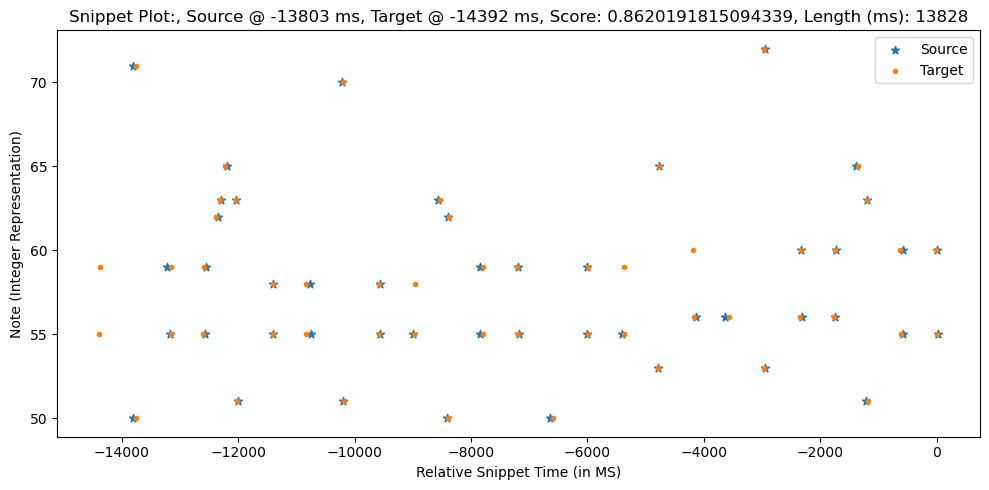

0.8629653713207546
Scores: [-0.     -0.      0.9075  0.8725  0.9775  0.84    0.89    0.8925  0.9225
  0.9675  0.915   0.99    0.9525  0.99    0.985   0.745   0.825   0.945
  0.9525  0.9475  0.9775  0.965  -0.      0.915   0.9325  0.9525  0.9
  0.89    0.9825  0.9475  0.86    0.95    0.935  -0.      0.9125  0.9775
  0.985  -0.      0.9475  0.81    0.9525  0.9475  0.9275  0.97    0.9325
  0.96    0.9175  0.995   0.9025  0.85    0.87    0.935   0.935   0.9975
  0.975   0.805   0.845   0.965   0.99    0.8575  0.935   0.91  ]
Sequence1:  [[-16850     55     45]
 [-16826     59     39]
 [-16220     71     55]
 [-16209     50     45]
 [-15614     55     51]
 [-15609     59     34]
 [-15066     55     48]
 [-15050     59     29]
 [-14840     62     49]
 [-14764     63     54]
 [-14680     65     59]
 [-14497     63     54]
 [-14480     51     53]
 [-13858     58     36]
 [-13856     55     44]
 [-13300     55     49]
 [-13286     58     44]
 [-12649     70     58]
 [-12638     51     46]
 [-12

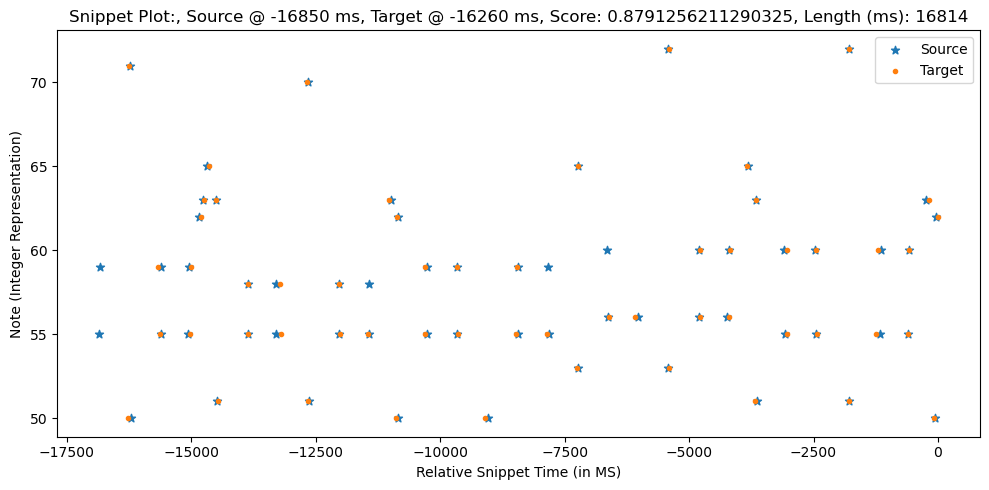

Scores: [0.8725 0.9075 0.84   0.9775 0.89   0.8925 0.9225 0.9675 0.915  0.99
 0.9525 0.985  0.99   0.825  0.745  0.945  0.9525 0.9775 0.9475 0.965
 0.915  0.9325 0.9525 0.89   0.9    0.9825 0.9475 0.86   0.935  0.95
 0.9125 0.9775 0.985  0.9475 0.81   0.9525 0.9475 0.97   0.9275 0.9325
 0.96   0.9175 0.9025 0.995  0.85   0.87   0.935  0.935  0.9975 0.975
 0.805  0.845  0.965  0.99   0.8575 0.935  0.91  ]
Sequence1:  [[-16224     50     42]
 [-16221     71     55]
 [-15637     59     37]
 [-15587     55     39]
 [-14986     55     46]
 [-14971     59     23]
 [-14773     62     43]
 [-14715     63     56]
 [-14610     65     45]
 [-14465     63     49]
 [-14425     51     53]
 [-13826     55     49]
 [-13818     58     34]
 [-13180     58     26]
 [-13162     55     35]
 [-12635     70     53]
 [-12621     51     51]
 [-11991     58     33]
 [-11982     55     42]
 [-11410     55     48]
 [-10984     63     49]
 [-10841     50     44]
 [-10821     62     54]
 [-10262     55     44]
 [-1

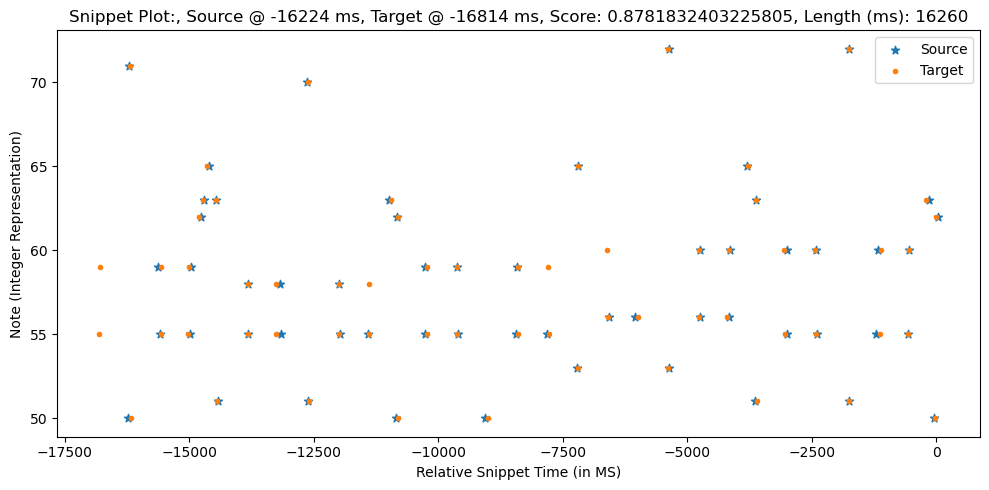

0.8791256211290325
Scores: [-0.     -0.      0.9075  0.8725  0.9775  0.84    0.89    0.8925  0.9225
  0.9675  0.915   0.99    0.9525  0.99    0.985   0.745   0.825   0.945
  0.9525  0.9475  0.9775  0.965  -0.      0.915   0.9325  0.9525  0.9
  0.89    0.9825  0.9475  0.86    0.95    0.935  -0.      0.9125  0.9775
  0.985  -0.      0.9475  0.81    0.9525  0.9475  0.9275  0.97    0.9325
  0.96    0.9175  0.995   0.9025  0.85    0.87    0.935   0.935   0.9975
  0.975   0.805   0.845   0.965   0.99    0.8575  0.935   0.91    0.8175
  0.8075  0.9175  0.94    0.9625  0.9675]
Sequence1:  [[-18620     55     45]
 [-18596     59     39]
 [-17990     71     55]
 [-17979     50     45]
 [-17384     55     51]
 [-17379     59     34]
 [-16836     55     48]
 [-16820     59     29]
 [-16610     62     49]
 [-16534     63     54]
 [-16450     65     59]
 [-16267     63     54]
 [-16250     51     53]
 [-15628     58     36]
 [-15626     55     44]
 [-15070     55     49]
 [-15056     58     44]
 [-1

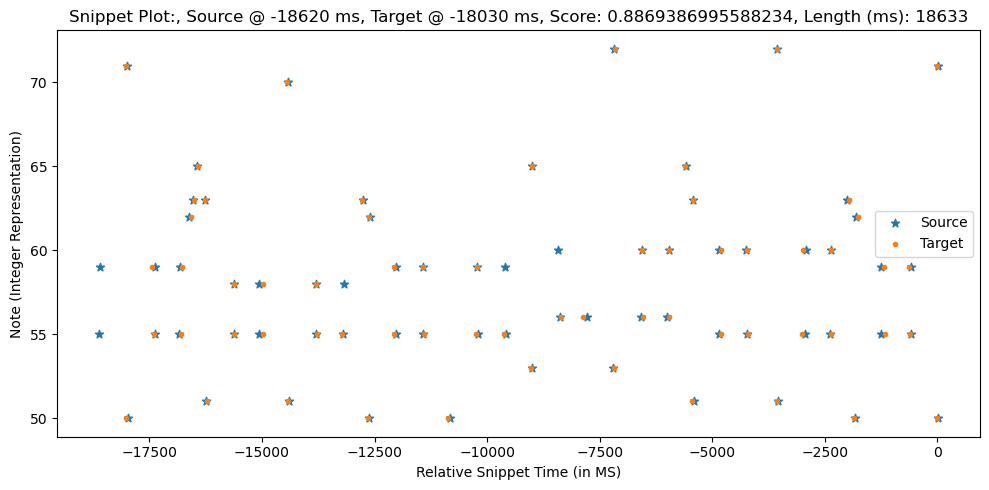

Scores: [0.8725 0.9075 0.84   0.9775 0.89   0.8925 0.9225 0.9675 0.915  0.99
 0.9525 0.985  0.99   0.825  0.745  0.945  0.9525 0.9775 0.9475 0.965
 0.915  0.9325 0.9525 0.89   0.9    0.9825 0.9475 0.86   0.935  0.95
 0.9125 0.9775 0.985  0.9475 0.81   0.9525 0.9475 0.97   0.9275 0.9325
 0.96   0.9175 0.9025 0.995  0.85   0.87   0.935  0.935  0.9975 0.975
 0.805  0.845  0.965  0.99   0.8575 0.935  0.91   0.8175 0.8075 0.9175
 0.94   0.9625 0.9675]
Sequence1:  [[-18043     50     42]
 [-18040     71     55]
 [-17456     59     37]
 [-17406     55     39]
 [-16805     55     46]
 [-16790     59     23]
 [-16592     62     43]
 [-16534     63     56]
 [-16429     65     45]
 [-16284     63     49]
 [-16244     51     53]
 [-15645     55     49]
 [-15637     58     34]
 [-14999     58     26]
 [-14981     55     35]
 [-14454     70     53]
 [-14440     51     51]
 [-13810     58     33]
 [-13801     55     42]
 [-13229     55     48]
 [-12803     63     49]
 [-12660     50     44]
 [-12640 

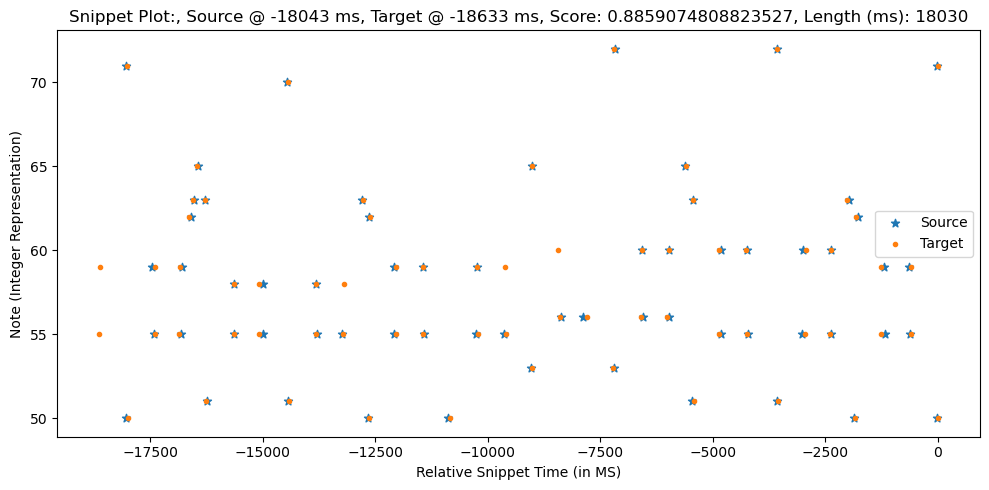

0.8869386995588234
Scores: [-0.     -0.      0.9125  0.8775  0.9825  0.845   0.885   0.8875  0.9175
  0.9625  0.91    0.995   0.9475  0.985   0.99    0.74    0.82    0.95
  0.9575  0.9425  0.9725  0.97   -0.      0.92    0.9375  0.9575  0.905
  0.895   0.9775  0.9425  0.865   0.955   0.94   -0.      0.9175  0.9825
  0.98   -0.      0.9425  0.815   0.9475  0.9425  0.9225  0.965   0.9275
  0.955   0.9225  1.      0.9075  0.845   0.865   0.93    0.93    0.9975
  0.98    0.81    0.85    0.96    0.995   0.8525  0.94    0.905   0.8125
  0.8025  0.9225  0.945   0.9675  0.9725  0.9875  0.965   0.895   0.9525
  0.9675  0.935   0.92  ]
Sequence1:  [[-20391     55     45]
 [-20367     59     39]
 [-19761     71     55]
 [-19750     50     45]
 [-19155     55     51]
 [-19150     59     34]
 [-18607     55     48]
 [-18591     59     29]
 [-18381     62     49]
 [-18305     63     54]
 [-18221     65     59]
 [-18038     63     54]
 [-18021     51     53]
 [-17399     58     36]
 [-17397     55   

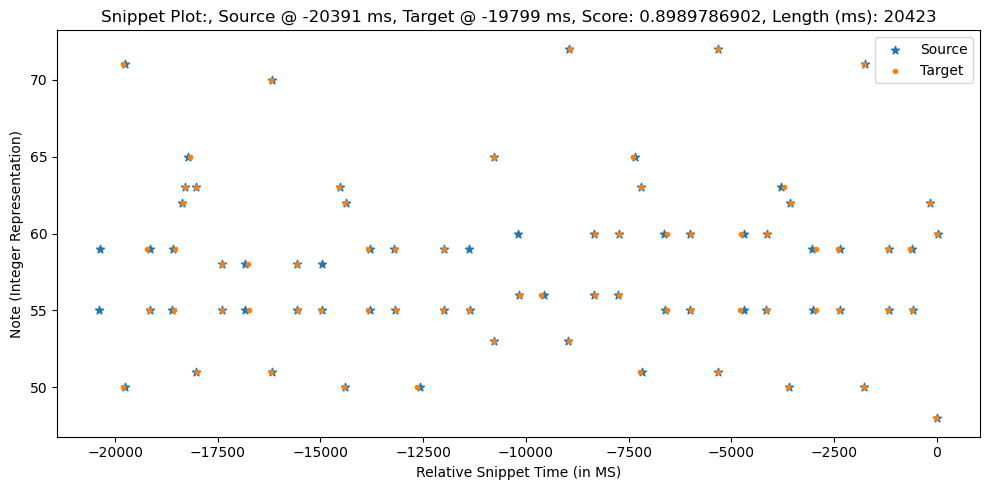

Scores: [0.8775 0.9125 0.845  0.9825 0.885  0.8875 0.9175 0.9625 0.91   0.995
 0.9475 0.99   0.985  0.82   0.74   0.95   0.9575 0.9725 0.9425 0.97
 0.92   0.9375 0.9575 0.895  0.905  0.9775 0.9425 0.865  0.94   0.955
 0.9175 0.9825 0.98   0.9425 0.815  0.9475 0.9425 0.965  0.9225 0.9275
 0.955  0.9225 0.9075 1.     0.845  0.865  0.93   0.93   0.9975 0.98
 0.81   0.85   0.96   0.995  0.8525 0.94   0.905  0.8125 0.8025 0.9225
 0.945  0.9675 0.9725 0.965  0.9875 0.895  0.9525 0.9675 0.935  0.92  ]
Sequence1:  [[-19831     50     42]
 [-19828     71     55]
 [-19244     59     37]
 [-19194     55     39]
 [-18593     55     46]
 [-18578     59     23]
 [-18380     62     43]
 [-18322     63     56]
 [-18217     65     45]
 [-18072     63     49]
 [-18032     51     53]
 [-17433     55     49]
 [-17425     58     34]
 [-16787     58     26]
 [-16769     55     35]
 [-16242     70     53]
 [-16228     51     51]
 [-15598     58     33]
 [-15589     55     42]
 [-15017     55     48]
 [-14591

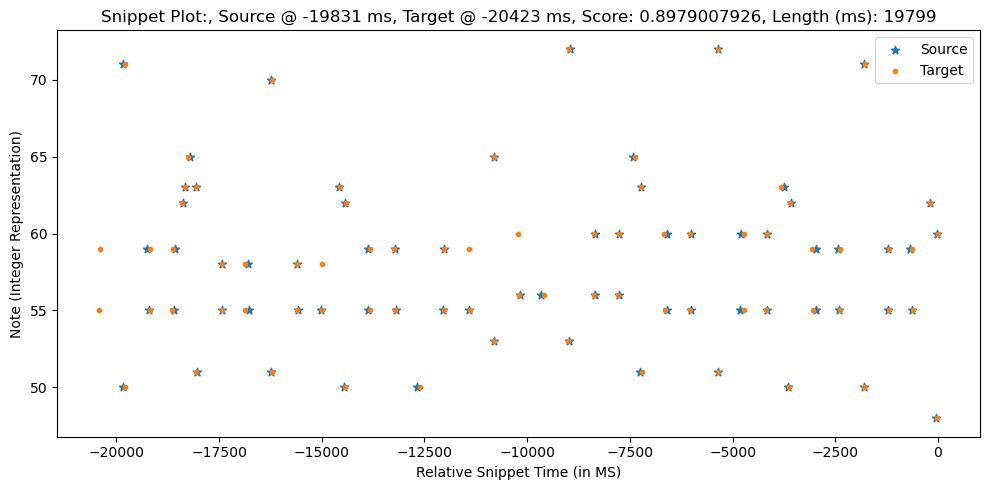

0.8989786902
Scores: [-0.     -0.      0.9125  0.8775  0.9825  0.845   0.885   0.8875  0.9175
  0.9625  0.91    0.995   0.9475  0.985   0.99    0.74    0.82    0.95
  0.9575  0.9425  0.9725  0.97   -0.      0.92    0.9375  0.9575  0.905
  0.895   0.9775  0.9425  0.865   0.955   0.94   -0.      0.9175  0.9825
  0.98   -0.      0.9425  0.815   0.9475  0.9425  0.9225  0.965   0.9275
  0.955   0.9225  1.      0.9075  0.845   0.865   0.93    0.93    0.9975
  0.98    0.81    0.85    0.96    0.995   0.8525  0.94    0.905   0.8125
  0.8025  0.9225  0.945   0.9675  0.9725  0.9875  0.965   0.895   0.9525
  0.9675  0.935   0.92    0.965   0.875   0.9625  0.8275  0.9375  0.98
  0.9475  0.96    0.975 ]
Sequence1:  [[-22813     55     45]
 [-22789     59     39]
 [-22183     71     55]
 [-22172     50     45]
 [-21577     55     51]
 [-21572     59     34]
 [-21029     55     48]
 [-21013     59     29]
 [-20803     62     49]
 [-20727     63     54]
 [-20643     65     59]
 [-20460     63     54]
 

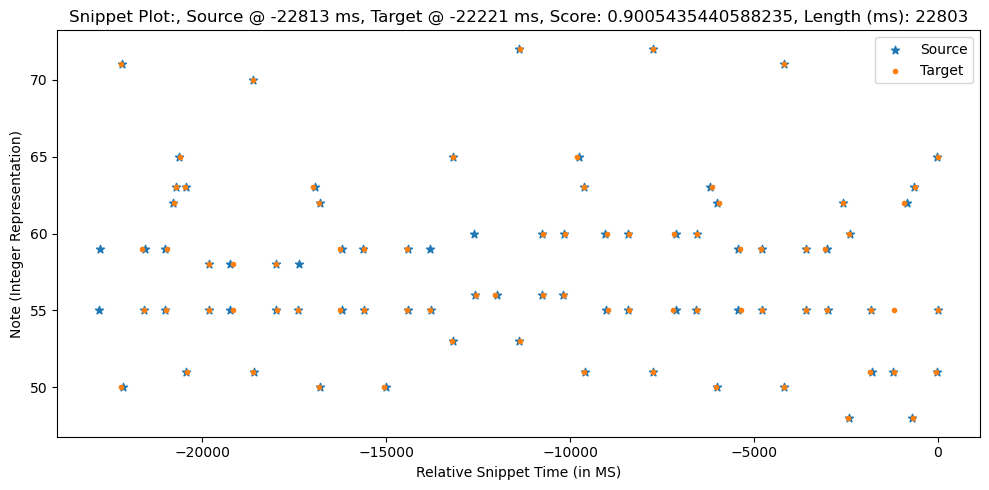

Scores: [ 0.8775  0.9125  0.845   0.9825  0.885   0.8875  0.9175  0.9625  0.91
  0.995   0.9475  0.99    0.985   0.82    0.74    0.95    0.9575  0.9725
  0.9425  0.97    0.92    0.9375  0.9575  0.895   0.905   0.9775  0.9425
  0.865   0.94    0.955   0.9175  0.9825  0.98    0.9425  0.815   0.9475
  0.9425  0.965   0.9225  0.9275  0.955   0.9225  0.9075  1.      0.845
  0.865   0.93    0.93    0.9975  0.98    0.81    0.85    0.96    0.995
  0.8525  0.94    0.905   0.8125  0.8025  0.9225  0.945   0.9675  0.9725
  0.965   0.9875  0.895   0.9525  0.9675  0.935   0.92    0.875   0.965
  0.9625 -0.      0.8275  0.9375  0.98    0.96    0.9475  0.975 ]
Sequence1:  [[-22211     50     42]
 [-22208     71     55]
 [-21624     59     37]
 [-21574     55     39]
 [-20973     55     46]
 [-20958     59     23]
 [-20760     62     43]
 [-20702     63     56]
 [-20597     65     45]
 [-20452     63     49]
 [-20412     51     53]
 [-19813     55     49]
 [-19805     58     34]
 [-19167     58     26]

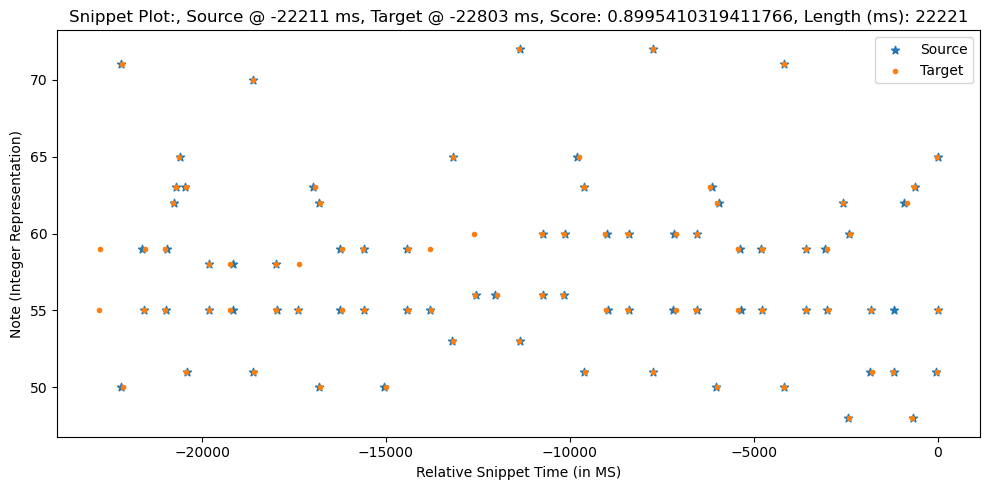

0.9005435440588235
Scores: [-0.     -0.      0.92    0.885   0.99    0.8525  0.8775  0.88    0.91
  0.955   0.9025  0.9975  0.94    0.9775  0.9975  0.7325  0.8125  0.9575
  0.965   0.935   0.965   0.9775 -0.      0.9275  0.945   0.965   0.9125
  0.9025  0.97    0.935   0.8725  0.9625  0.9475 -0.      0.925   0.99
  0.9725 -0.      0.935   0.8225  0.94    0.935   0.915   0.9575  0.92
  0.9475  0.93    0.9925  0.915   0.8375  0.8575  0.9225  0.9225  0.99
  0.9875  0.8175  0.8575  0.9525  0.9975  0.845   0.9475  0.8975  0.805
  0.795   0.93    0.9525  0.975   0.98    0.995   0.9725  0.9025  0.96
  0.975   0.9425  0.9275  0.9575  0.8825  0.955   0.835   0.93    0.9725
  0.94    0.9675  0.9675  0.97    0.975   0.9975  0.9825  0.88    0.825 ]
Sequence1:  [[-24630     55     45]
 [-24606     59     39]
 [-24000     71     55]
 [-23989     50     45]
 [-23394     55     51]
 [-23389     59     34]
 [-22846     55     48]
 [-22830     59     29]
 [-22620     62     49]
 [-22544     63     54]
 

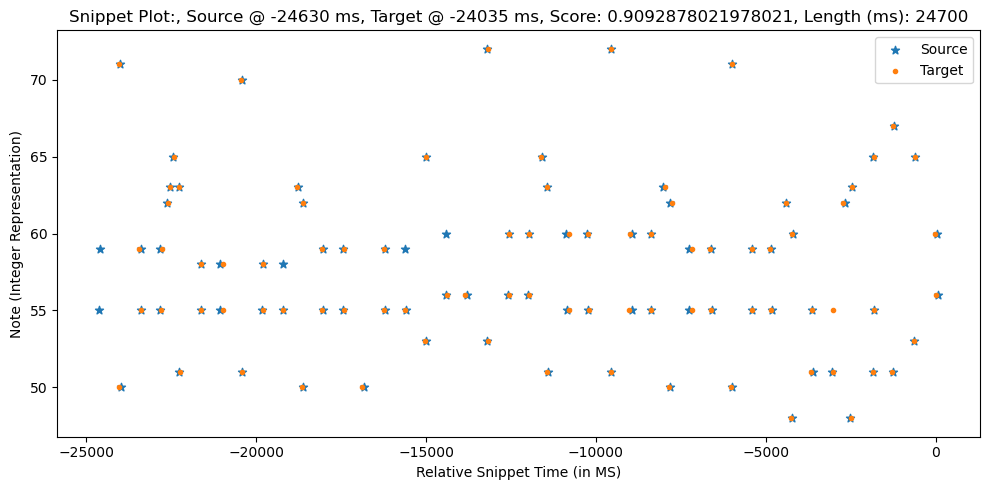

Scores: [ 0.885   0.92    0.8525  0.99    0.8775  0.88    0.91    0.955   0.9025
  0.9975  0.94    0.9975  0.9775  0.8125  0.7325  0.9575  0.965   0.965
  0.935   0.9775  0.9275  0.945   0.965   0.9025  0.9125  0.97    0.935
  0.8725  0.9475  0.9625  0.925   0.99    0.9725  0.935   0.8225  0.94
  0.935   0.9575  0.915   0.92    0.9475  0.93    0.915   0.9925  0.8375
  0.8575  0.9225  0.9225  0.99    0.9875  0.8175  0.8575  0.9525  0.9975
  0.845   0.9475  0.8975  0.805   0.795   0.93    0.9525  0.975   0.98
  0.9725  0.995   0.9025  0.96    0.975   0.9425  0.9275  0.8825  0.9575
  0.955  -0.      0.835   0.93    0.9725  0.9675  0.94    0.9675  0.97
  0.975   0.9975  0.9825  0.88    0.825 ]
Sequence1:  [[-24105     50     42]
 [-24102     71     55]
 [-23518     59     37]
 [-23468     55     39]
 [-22867     55     46]
 [-22852     59     23]
 [-22654     62     43]
 [-22596     63     56]
 [-22491     65     45]
 [-22346     63     49]
 [-22306     51     53]
 [-21707     55     49]
 

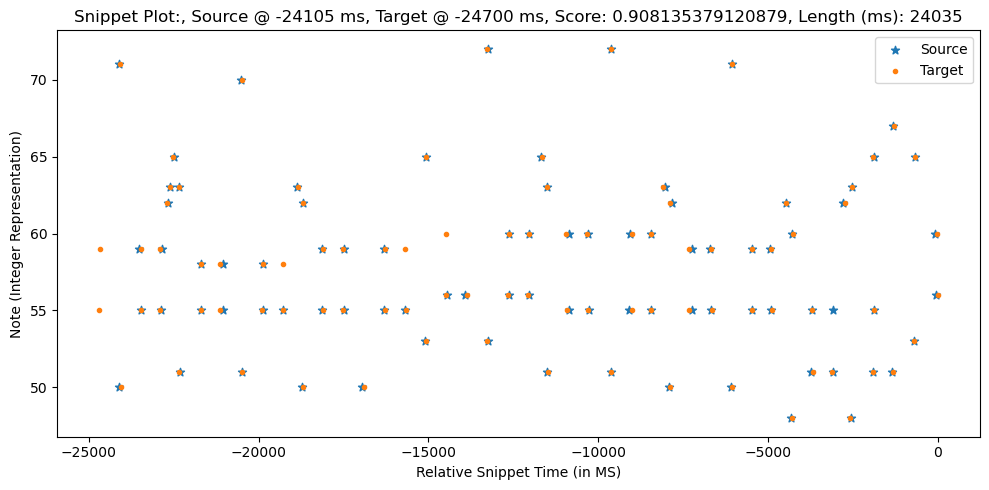

0.9092878021978021
Scores: [-0.     -0.      0.9175  0.8825  0.9875  0.85    0.88    0.8825  0.9125
  0.9575  0.905   1.      0.9425  0.98    0.995   0.735   0.815   0.955
  0.9625  0.9375  0.9675  0.975  -0.      0.925   0.9425  0.9625  0.91
  0.9     0.9725  0.9375  0.87    0.96    0.945  -0.      0.9225  0.9875
  0.975  -0.      0.9375  0.82    0.9425  0.9375  0.9175  0.96    0.9225
  0.95    0.9275  0.995   0.9125  0.84    0.86    0.925   0.925   0.9925
  0.985   0.815   0.855   0.955   1.      0.8475  0.945   0.9     0.8075
  0.7975  0.9275  0.95    0.9725  0.9775  0.9925  0.97    0.9     0.9575
  0.9725  0.94    0.925   0.96    0.88    0.9575  0.8325  0.9325  0.975
  0.9425  0.965   0.97    0.9675  0.9725  0.995   0.985   0.8775  0.8225
  0.8575  0.98    0.9725  0.995   0.925 ]
Sequence1:  [[-26483     55     45]
 [-26459     59     39]
 [-25853     71     55]
 [-25842     50     45]
 [-25247     55     51]
 [-25242     59     34]
 [-24699     55     48]
 [-24683     59     29]
 

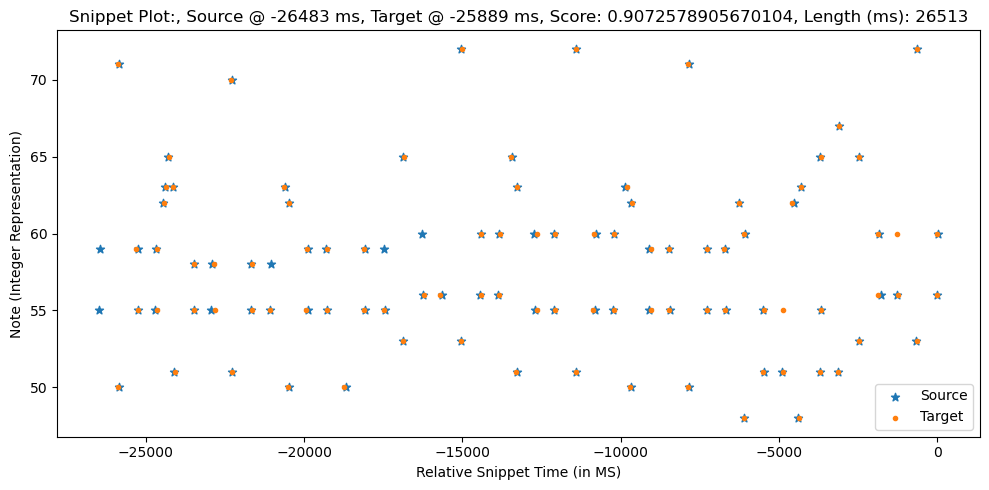

Scores: [ 0.8825  0.9175  0.85    0.9875  0.88    0.8825  0.9125  0.9575  0.905
  1.      0.9425  0.995   0.98    0.815   0.735   0.955   0.9625  0.9675
  0.9375  0.975   0.925   0.9425  0.9625  0.9     0.91    0.9725  0.9375
  0.87    0.945   0.96    0.9225  0.9875  0.975   0.9375  0.82    0.9425
  0.9375  0.96    0.9175  0.9225  0.95    0.9275  0.9125  0.995   0.84
  0.86    0.925   0.925   0.9925  0.985   0.815   0.855   0.955   1.
  0.8475  0.945   0.9     0.8075  0.7975  0.9275  0.95    0.9725  0.9775
  0.97    0.9925  0.9     0.9575  0.9725  0.94    0.925   0.88    0.96
  0.9575 -0.      0.8325  0.9325  0.975   0.965   0.9425  0.97    0.9675
  0.9725  0.995   0.985   0.8775  0.8225 -0.      0.8575  0.9725  0.98
  0.995   0.925 ]
Sequence1:  [[-25919     50     42]
 [-25916     71     55]
 [-25332     59     37]
 [-25282     55     39]
 [-24681     55     46]
 [-24666     59     23]
 [-24468     62     43]
 [-24410     63     56]
 [-24305     65     45]
 [-24160     63     49]
 [-

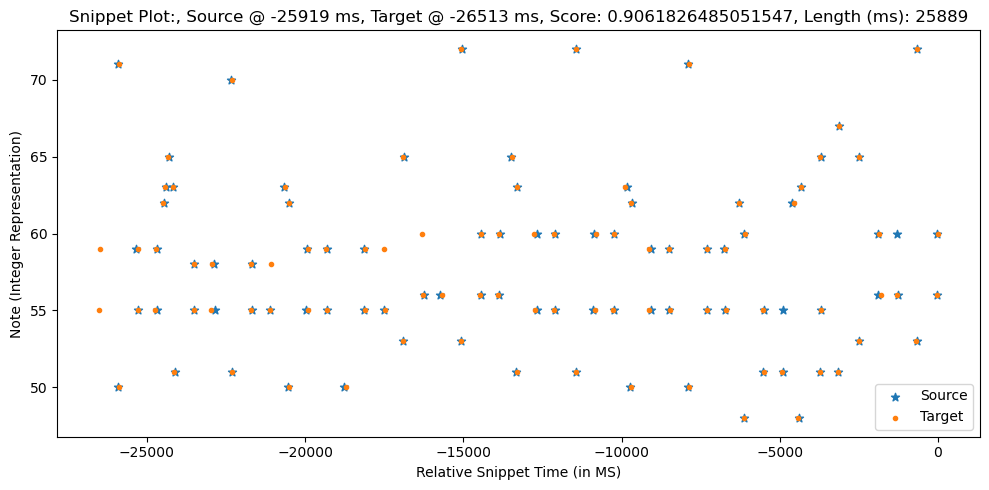

0.9072578905670104
Scores: [-0.     -0.      0.92    0.885   0.99    0.8525  0.8775  0.88    0.91
  0.955   0.9025  0.9975  0.94    0.9775  0.9975  0.7325  0.8125  0.9575
  0.965   0.935   0.965   0.9775 -0.      0.9275  0.945   0.965   0.9125
  0.9025  0.97    0.935   0.8725  0.9625  0.9475 -0.      0.925   0.99
  0.9725 -0.      0.935   0.8225  0.94    0.935   0.915   0.9575  0.92
  0.9475  0.93    0.9925  0.915   0.8375  0.8575  0.9225  0.9225  0.99
  0.9875  0.8175  0.8575  0.9525  0.9975  0.845   0.9475  0.8975  0.805
  0.795   0.93    0.9525  0.975   0.98    0.995   0.9725  0.9025  0.96
  0.975   0.9425  0.9275  0.9575  0.8825  0.955   0.835   0.93    0.9725
  0.94    0.9675  0.9675  0.97    0.975   0.9975  0.9825  0.88    0.825
  0.855   0.9775  0.975   0.9925  0.9275  0.8375  0.995   0.9725  0.965
  0.9725  0.99    0.9075  0.9725  0.835 ]
Sequence1:  [[-28733     55     45]
 [-28709     59     39]
 [-28103     71     55]
 [-28092     50     45]
 [-27497     55     51]
 [-27492 

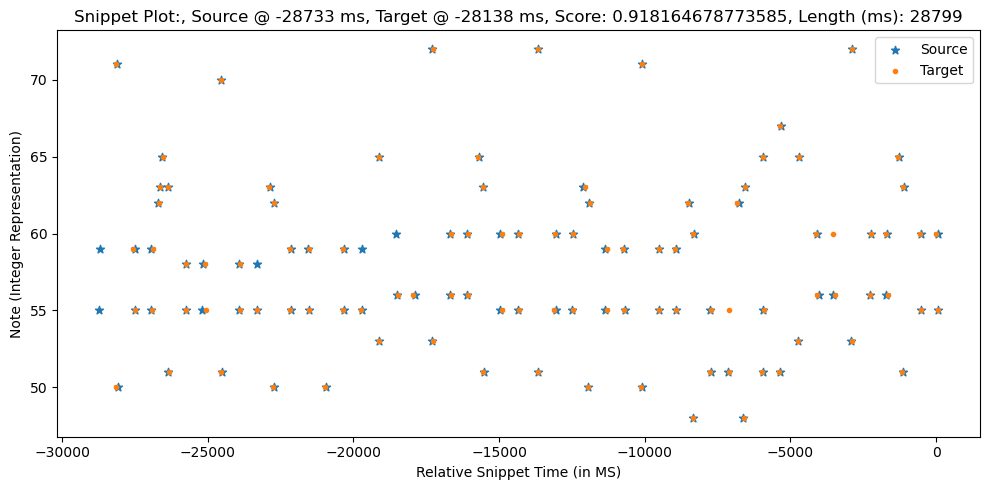

Scores: [ 0.885   0.92    0.8525  0.99    0.8775  0.88    0.91    0.955   0.9025
  0.9975  0.94    0.9975  0.9775  0.8125  0.7325  0.9575  0.965   0.965
  0.935   0.9775  0.9275  0.945   0.965   0.9025  0.9125  0.97    0.935
  0.8725  0.9475  0.9625  0.925   0.99    0.9725  0.935   0.8225  0.94
  0.935   0.9575  0.915   0.92    0.9475  0.93    0.915   0.9925  0.8375
  0.8575  0.9225  0.9225  0.99    0.9875  0.8175  0.8575  0.9525  0.9975
  0.845   0.9475  0.8975  0.805   0.795   0.93    0.9525  0.975   0.98
  0.9725  0.995   0.9025  0.96    0.975   0.9425  0.9275  0.8825  0.9575
  0.955  -0.      0.835   0.93    0.9725  0.9675  0.94    0.9675  0.97
  0.975   0.9975  0.9825  0.88    0.825  -0.      0.855   0.975   0.9775
  0.9925  0.9275  0.995   0.8375  0.9725  0.965   0.9725  0.9075  0.99
  0.835   0.9725]
Sequence1:  [[-28199     50     42]
 [-28196     71     55]
 [-27612     59     37]
 [-27562     55     39]
 [-26961     55     46]
 [-26946     59     23]
 [-26748     62     43]
 

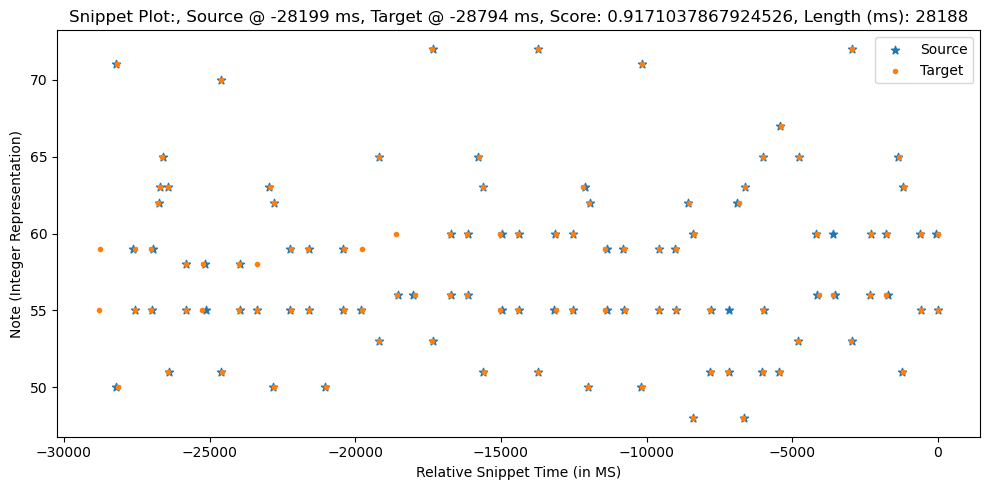

0.918164678773585
Scores: [-0.     -0.      0.9225  0.8875  0.9925  0.855   0.875   0.8775  0.9075
  0.9525  0.9     0.995   0.9375  0.975   1.      0.73    0.81    0.96
  0.9675  0.9325  0.9625  0.98   -0.      0.93    0.9475  0.9675  0.915
  0.905   0.9675  0.9325  0.875   0.965   0.95   -0.      0.9275  0.9925
  0.97   -0.      0.9325  0.825   0.9375  0.9325  0.9125  0.955   0.9175
  0.945   0.9325  0.99    0.9175  0.835   0.855   0.92    0.92    0.9875
  0.99    0.82    0.86    0.95    0.995   0.8425  0.95    0.895   0.8025
  0.7925  0.9325  0.955   0.9775  0.9825  0.9975  0.975   0.905   0.9625
  0.9775  0.945   0.93    0.955   0.885   0.9525  0.8375  0.9275  0.97
  0.9375  0.97    0.965   0.9725  0.9775  1.      0.98    0.8825  0.8275
  0.8525  0.975   0.9775  0.99    0.93    0.835   0.9975  0.975   0.9675
  0.975   0.9875  0.91    0.975   0.8375  0.985   0.9975  0.93    0.935
  0.      0.8875]
Sequence1:  [[-30584     55     45]
 [-30560     59     39]
 [-29954     71     55]
 [

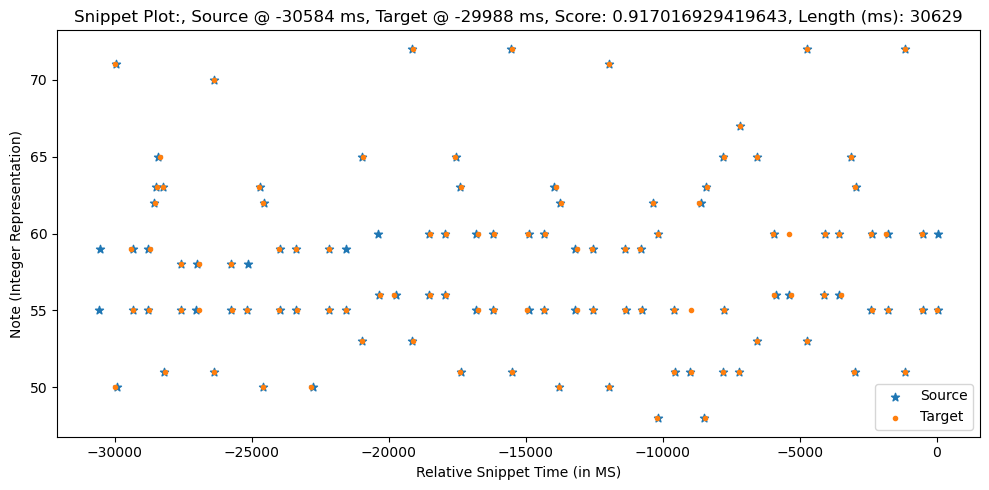

Scores: [ 0.8875  0.9225  0.855   0.9925  0.875   0.8775  0.9075  0.9525  0.9
  0.995   0.9375  1.      0.975   0.81    0.73    0.96    0.9675  0.9625
  0.9325  0.98    0.93    0.9475  0.9675  0.905   0.915   0.9675  0.9325
  0.875   0.95    0.965   0.9275  0.9925  0.97    0.9325  0.825   0.9375
  0.9325  0.955   0.9125  0.9175  0.945   0.9325  0.9175  0.99    0.835
  0.855   0.92    0.92    0.9875  0.99    0.82    0.86    0.95    0.995
  0.8425  0.95    0.895   0.8025  0.7925  0.9325  0.955   0.9775  0.9825
  0.975   0.9975  0.905   0.9625  0.9775  0.945   0.93    0.885   0.955
  0.9525 -0.      0.8375  0.9275  0.97    0.97    0.9375  0.965   0.9725
  0.9775  1.      0.98    0.8825  0.8275 -0.      0.8525  0.9775  0.975
  0.99    0.93    0.9975  0.835   0.975   0.9675  0.975   0.91    0.9875
  0.8375  0.975   0.9975  0.985   0.93    0.935   0.8875]
Sequence1:  [[-30033     50     42]
 [-30030     71     55]
 [-29446     59     37]
 [-29396     55     39]
 [-28795     55     46]
 [-287

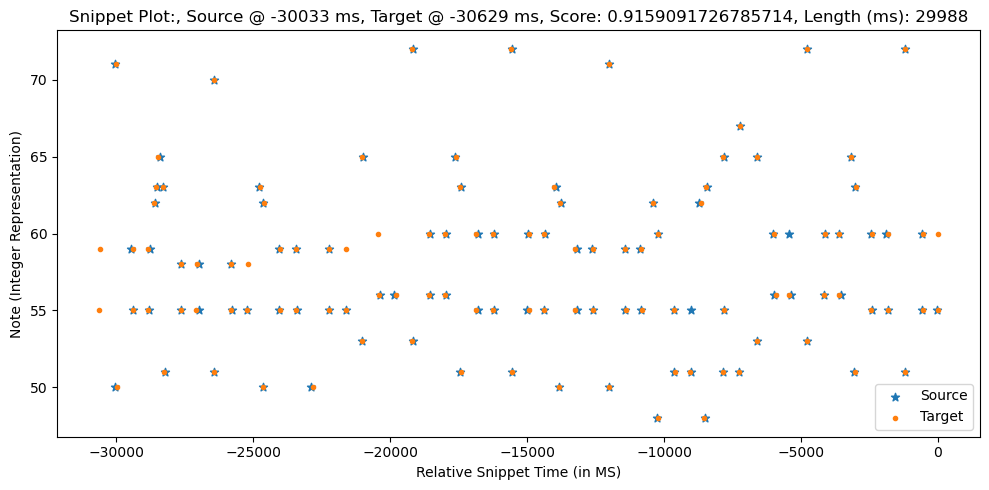

0.917016929419643
Scores: [-0.     -0.      0.9275  0.8925  0.9975  0.86    0.87    0.8725  0.9025
  0.9475  0.895   0.99    0.9325  0.97    0.995   0.725   0.805   0.965
  0.9725  0.9275  0.9575  0.985  -0.      0.935   0.9525  0.9725  0.92
  0.91    0.9625  0.9275  0.88    0.97    0.955  -0.      0.9325  0.9975
  0.965  -0.      0.9275  0.83    0.9325  0.9275  0.9075  0.95    0.9125
  0.94    0.9375  0.985   0.9225  0.83    0.85    0.915   0.915   0.9825
  0.995   0.825   0.865   0.945   0.99    0.8375  0.955   0.89    0.7975
  0.7875  0.9375  0.96    0.9825  0.9875  0.9975  0.98    0.91    0.9675
  0.9825  0.95    0.935   0.95    0.89    0.9475  0.8425  0.9225  0.965
  0.9325  0.975   0.96    0.9775  0.9825  0.995   0.975   0.8875  0.8325
  0.8475  0.97    0.9825  0.985   0.935   0.83    0.9975  0.98    0.9725
  0.98    0.9825  0.915   0.98    0.8425  0.98    0.9925  0.935   0.94
 -0.      0.8925  0.8925  0.7625  0.905   0.9975  0.97    0.9775  0.93  ]
Sequence1:  [[-32403     55   

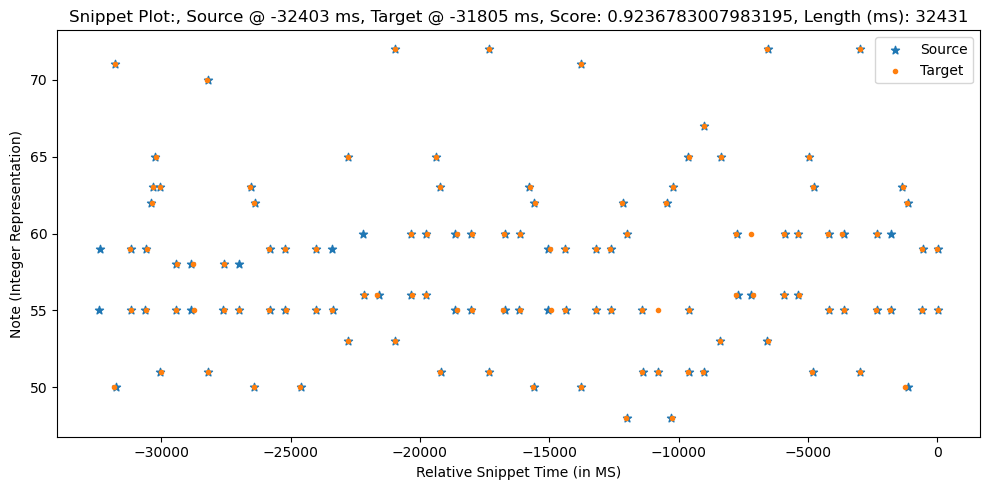

Scores: [ 0.8925  0.9275  0.86    0.9975  0.87    0.8725  0.9025  0.9475  0.895
  0.99    0.9325  0.995   0.97    0.805   0.725   0.965   0.9725  0.9575
  0.9275  0.985   0.935   0.9525  0.9725  0.91    0.92    0.9625  0.9275
  0.88    0.955   0.97    0.9325  0.9975  0.965   0.9275  0.83    0.9325
  0.9275  0.95    0.9075  0.9125  0.94    0.9375  0.9225  0.985   0.83
  0.85    0.915   0.915   0.9825  0.995   0.825   0.865   0.945   0.99
  0.8375  0.955   0.89    0.7975  0.7875  0.9375  0.96    0.9825  0.9875
  0.98    0.9975  0.91    0.9675  0.9825  0.95    0.935   0.89    0.95
  0.9475 -0.      0.8425  0.9225  0.965   0.975   0.9325  0.96    0.9775
  0.9825  0.995   0.975   0.8875  0.8325 -0.      0.8475  0.9825  0.97
  0.985   0.935   0.9975  0.83    0.98    0.9725  0.98    0.915   0.9825
  0.8425  0.98    0.9925  0.98    0.935   0.94    0.8925  0.8925  0.7625
  0.905   0.9975  0.97    0.93    0.9775]
Sequence1:  [[-31825     50     42]
 [-31822     71     55]
 [-31238     59     37]

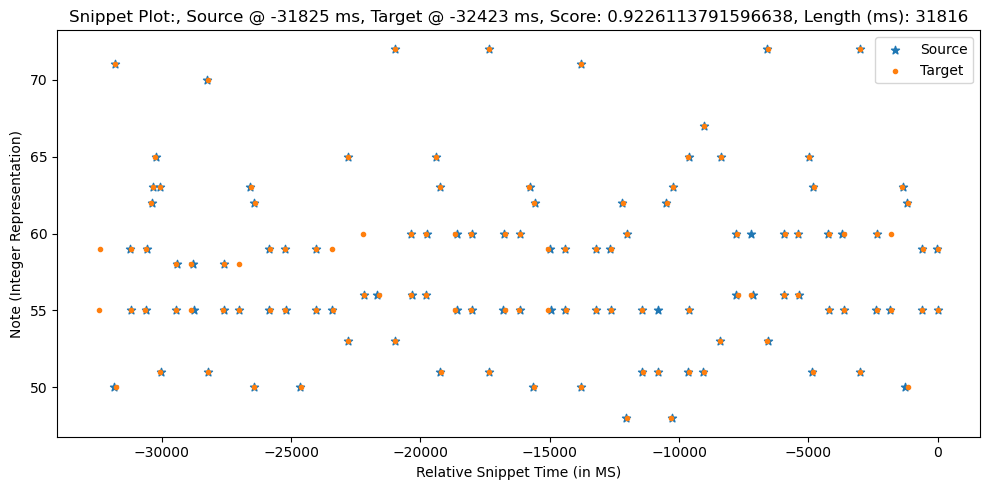

0.9236783007983195
Scores: [-0.     -0.      0.9325  0.8975  0.9975  0.865   0.865   0.8675  0.8975
  0.9425  0.89    0.985   0.9275  0.965   0.99    0.72    0.8     0.97
  0.9775  0.9225  0.9525  0.99   -0.      0.94    0.9575  0.9775  0.925
  0.915   0.9575  0.9225  0.885   0.975   0.96   -0.      0.9375  0.9975
  0.96   -0.      0.9225  0.835   0.9275  0.9225  0.9025  0.945   0.9075
  0.935   0.9425  0.98    0.9275  0.825   0.845   0.91    0.91    0.9775
  1.      0.83    0.87    0.94    0.985   0.8325  0.96    0.885   0.7925
  0.7825  0.9425  0.965   0.9875  0.9925  0.9925  0.985   0.915   0.9725
  0.9875  0.955   0.94    0.945   0.895   0.9425  0.8475  0.9175  0.96
  0.9275  0.98    0.955   0.9825  0.9875  0.99    0.97    0.8925  0.8375
  0.8425  0.965   0.9875  0.98    0.94    0.825   0.9925  0.985   0.9775
  0.985   0.9775  0.92    0.985   0.8475  0.975   0.9875  0.94    0.945
 -0.      0.8975  0.8875  0.7675  0.91    0.9925  0.975   0.9825  0.935
  0.9575  0.905   0.8975  0.872

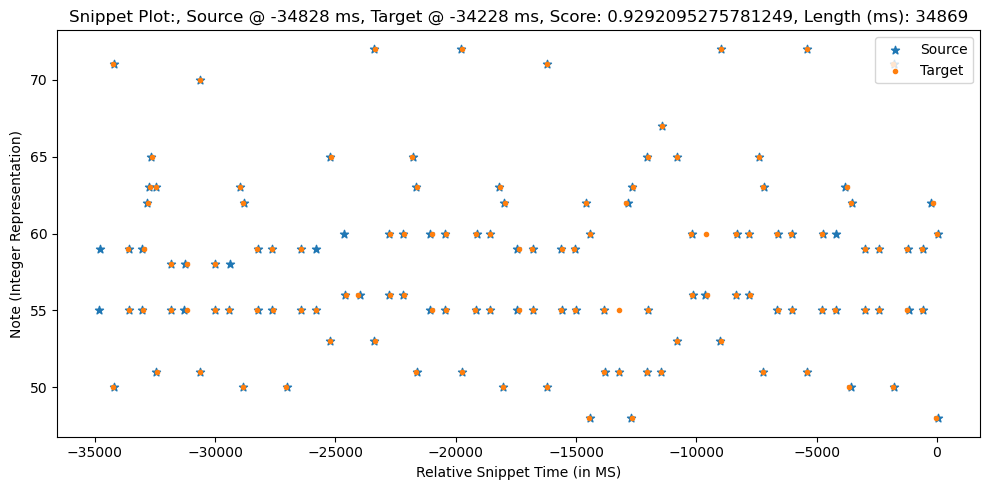

Scores: [ 0.8975  0.9325  0.865   0.9975  0.865   0.8675  0.8975  0.9425  0.89
  0.985   0.9275  0.99    0.965   0.8     0.72    0.97    0.9775  0.9525
  0.9225  0.99    0.94    0.9575  0.9775  0.915   0.925   0.9575  0.9225
  0.885   0.96    0.975   0.9375  0.9975  0.96    0.9225  0.835   0.9275
  0.9225  0.945   0.9025  0.9075  0.935   0.9425  0.9275  0.98    0.825
  0.845   0.91    0.91    0.9775  1.      0.83    0.87    0.94    0.985
  0.8325  0.96    0.885   0.7925  0.7825  0.9425  0.965   0.9875  0.9925
  0.985   0.9925  0.915   0.9725  0.9875  0.955   0.94    0.895   0.945
  0.9425 -0.      0.8475  0.9175  0.96    0.98    0.9275  0.955   0.9825
  0.9875  0.99    0.97    0.8925  0.8375 -0.      0.8425  0.9875  0.965
  0.98    0.94    0.9925  0.825   0.985   0.9775  0.985   0.92    0.9775
  0.8475  0.985   0.9875  0.975   0.94    0.945   0.8975  0.8875  0.7675
  0.91    0.9925  0.975   0.935   0.9825  0.9575  0.905   0.8975  0.8725
  0.8875  0.8875  0.865   0.7875  0.8975]
Sequenc

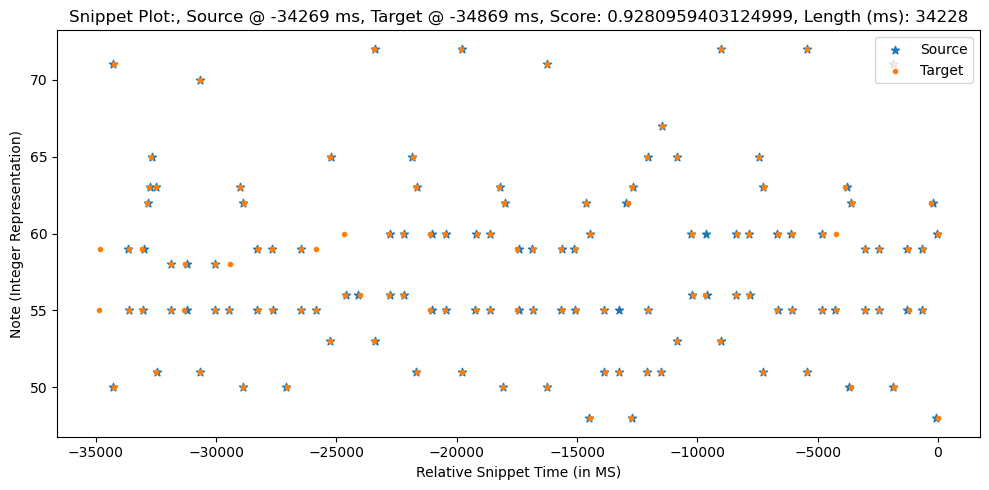

0.9292095275781249
Scores: [-0.     -0.      0.93    0.895   1.      0.8625  0.8675  0.87    0.9
  0.945   0.8925  0.9875  0.93    0.9675  0.9925  0.7225  0.8025  0.9675
  0.975   0.925   0.955   0.9875 -0.      0.9375  0.955   0.975   0.9225
  0.9125  0.96    0.925   0.8825  0.9725  0.9575 -0.      0.935   1.
  0.9625 -0.      0.925   0.8325  0.93    0.925   0.905   0.9475  0.91
  0.9375  0.94    0.9825  0.925   0.8275  0.8475  0.9125  0.9125  0.98
  0.9975  0.8275  0.8675  0.9425  0.9875  0.835   0.9575  0.8875  0.795
  0.785   0.94    0.9625  0.985   0.99    0.995   0.9825  0.9125  0.97
  0.985   0.9525  0.9375  0.9475  0.8925  0.945   0.845   0.92    0.9625
  0.93    0.9775  0.9575  0.98    0.985   0.9925  0.9725  0.89    0.835
  0.845   0.9675  0.985   0.9825  0.9375  0.8275  0.995   0.9825  0.975
  0.9825  0.98    0.9175  0.9825  0.845   0.9775  0.99    0.9375  0.9425
 -0.      0.895   0.89    0.765   0.9075  0.995   0.9725  0.98    0.9325
  0.955   0.9025  0.895   0.87    0.885 

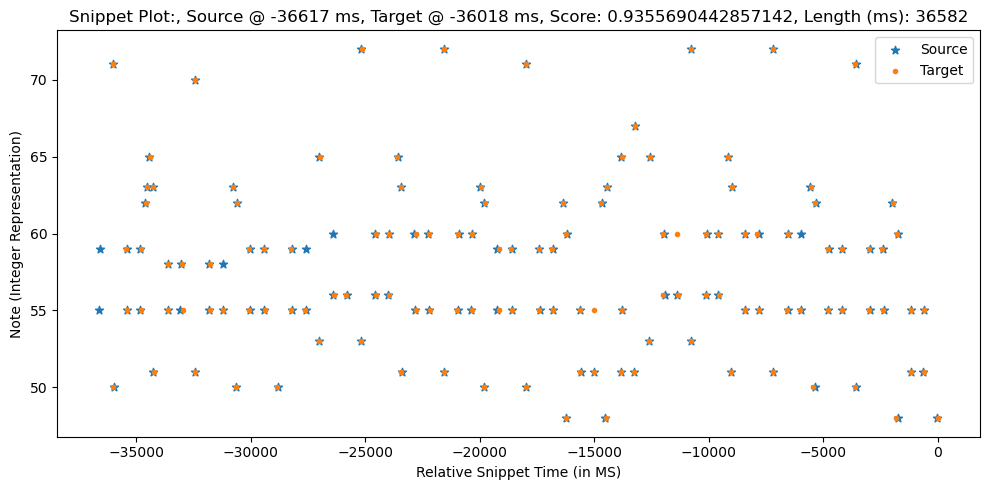

Scores: [ 0.895   0.93    0.8625  1.      0.8675  0.87    0.9     0.945   0.8925
  0.9875  0.93    0.9925  0.9675  0.8025  0.7225  0.9675  0.975   0.955
  0.925   0.9875  0.9375  0.955   0.975   0.9125  0.9225  0.96    0.925
  0.8825  0.9575  0.9725  0.935   1.      0.9625  0.925   0.8325  0.93
  0.925   0.9475  0.905   0.91    0.9375  0.94    0.925   0.9825  0.8275
  0.8475  0.9125  0.9125  0.98    0.9975  0.8275  0.8675  0.9425  0.9875
  0.835   0.9575  0.8875  0.795   0.785   0.94    0.9625  0.985   0.99
  0.9825  0.995   0.9125  0.97    0.985   0.9525  0.9375  0.8925  0.9475
  0.945  -0.      0.845   0.92    0.9625  0.9775  0.93    0.9575  0.98
  0.985   0.9925  0.9725  0.89    0.835  -0.      0.845   0.985   0.9675
  0.9825  0.9375  0.995   0.8275  0.9825  0.975   0.9825  0.9175  0.98
  0.845   0.9825  0.99    0.9775  0.9375  0.9425  0.895   0.89    0.765
  0.9075  0.995   0.9725  0.9325  0.98    0.955   0.9025  0.895   0.87
  0.885   0.885   0.8675  0.785   0.895   0.965   0.9825

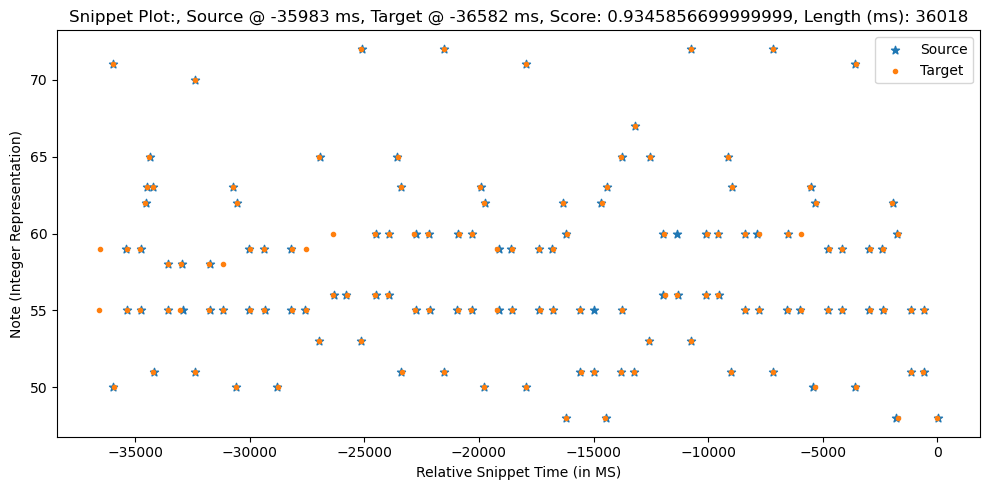

0.9355690442857142
Scores: [-0.     -0.      0.9375  0.9025  0.9925  0.87    0.86    0.8625  0.8925
  0.9375  0.885   0.98    0.9225  0.96    0.985   0.715   0.795   0.975
  0.9825  0.9175  0.9475  0.995  -0.      0.945   0.9625  0.9825  0.93
  0.92    0.9525  0.9175  0.89    0.98    0.965  -0.      0.9425  0.9925
  0.955  -0.      0.9175  0.84    0.9225  0.9175  0.8975  0.94    0.9025
  0.93    0.9475  0.975   0.9325  0.82    0.84    0.905   0.905   0.9725
  0.995   0.835   0.875   0.935   0.98    0.8275  0.965   0.88    0.7875
  0.7775  0.9475  0.97    0.9925  0.9975  0.9875  0.99    0.92    0.9775
  0.9925  0.96    0.945   0.94    0.9     0.9375  0.8525  0.9125  0.955
  0.9225  0.985   0.95    0.9875  0.9925  0.985   0.965   0.8975  0.8425
  0.8375  0.96    0.9925  0.975   0.945   0.82    0.9875  0.99    0.9825
  0.99    0.9725  0.925   0.99    0.8525  0.97    0.9825  0.945   0.95
 -0.      0.9025  0.8825  0.7725  0.915   0.9875  0.98    0.9875  0.94
  0.9625  0.91    0.9025  0.8775

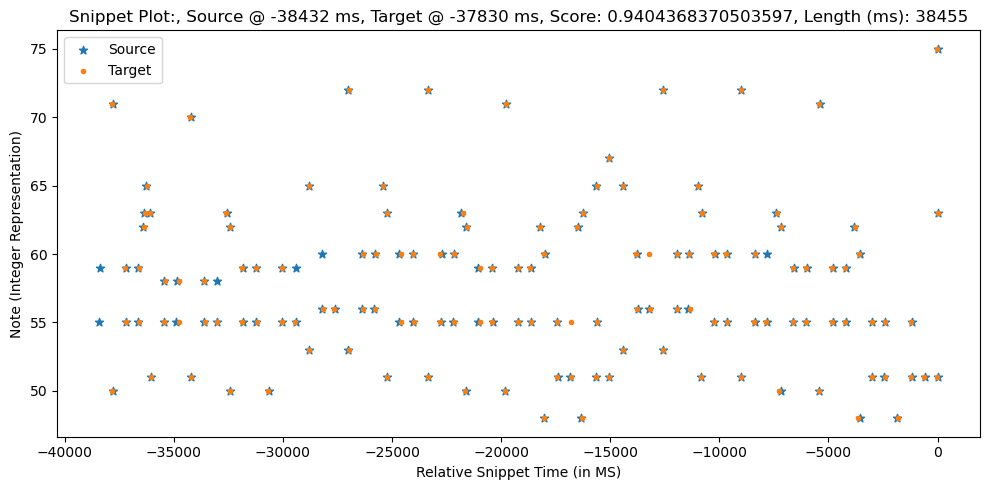

Scores: [ 0.9025  0.9375  0.87    0.9925  0.86    0.8625  0.8925  0.9375  0.885
  0.98    0.9225  0.985   0.96    0.795   0.715   0.975   0.9825  0.9475
  0.9175  0.995   0.945   0.9625  0.9825  0.92    0.93    0.9525  0.9175
  0.89    0.965   0.98    0.9425  0.9925  0.955   0.9175  0.84    0.9225
  0.9175  0.94    0.8975  0.9025  0.93    0.9475  0.9325  0.975   0.82
  0.84    0.905   0.905   0.9725  0.995   0.835   0.875   0.935   0.98
  0.8275  0.965   0.88    0.7875  0.7775  0.9475  0.97    0.9925  0.9975
  0.99    0.9875  0.92    0.9775  0.9925  0.96    0.945   0.9     0.94
  0.9375 -0.      0.8525  0.9125  0.955   0.985   0.9225  0.95    0.9875
  0.9925  0.985   0.965   0.8975  0.8425 -0.      0.8375  0.9925  0.96
  0.975   0.945   0.9875  0.82    0.99    0.9825  0.99    0.925   0.9725
  0.8525  0.99    0.9825  0.97    0.945   0.95    0.9025  0.8825  0.7725
  0.915   0.9875  0.98    0.94    0.9875  0.9625  0.91    0.9025  0.8775
  0.8925  0.8925  0.86    0.7925  0.9025  0.9725  0.

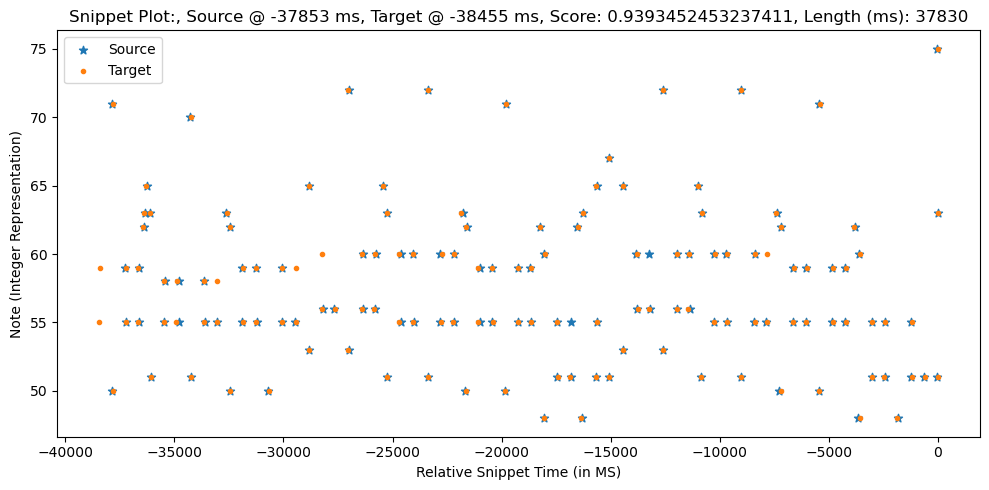

0.9404368370503597
Scores: [-0.     -0.      0.9325  0.8975  0.9975  0.865   0.865   0.8675  0.8975
  0.9425  0.89    0.985   0.9275  0.965   0.99    0.72    0.8     0.97
  0.9775  0.9225  0.9525  0.99   -0.      0.94    0.9575  0.9775  0.925
  0.915   0.9575  0.9225  0.885   0.975   0.96   -0.      0.9375  0.9975
  0.96   -0.      0.9225  0.835   0.9275  0.9225  0.9025  0.945   0.9075
  0.935   0.9425  0.98    0.9275  0.825   0.845   0.91    0.91    0.9775
  1.      0.83    0.87    0.94    0.985   0.8325  0.96    0.885   0.7925
  0.7825  0.9425  0.965   0.9875  0.9925  0.9925  0.985   0.915   0.9725
  0.9875  0.955   0.94    0.945   0.895   0.9425  0.8475  0.9175  0.96
  0.9275  0.98    0.955   0.9825  0.9875  0.99    0.97    0.8925  0.8375
  0.8425  0.965   0.9875  0.98    0.94    0.825   0.9925  0.985   0.9775
  0.985   0.9775  0.92    0.985   0.8475  0.975   0.9875  0.94    0.945
 -0.      0.8975  0.8875  0.7675  0.91    0.9925  0.975   0.9825  0.935
  0.9575  0.905   0.8975  0.872

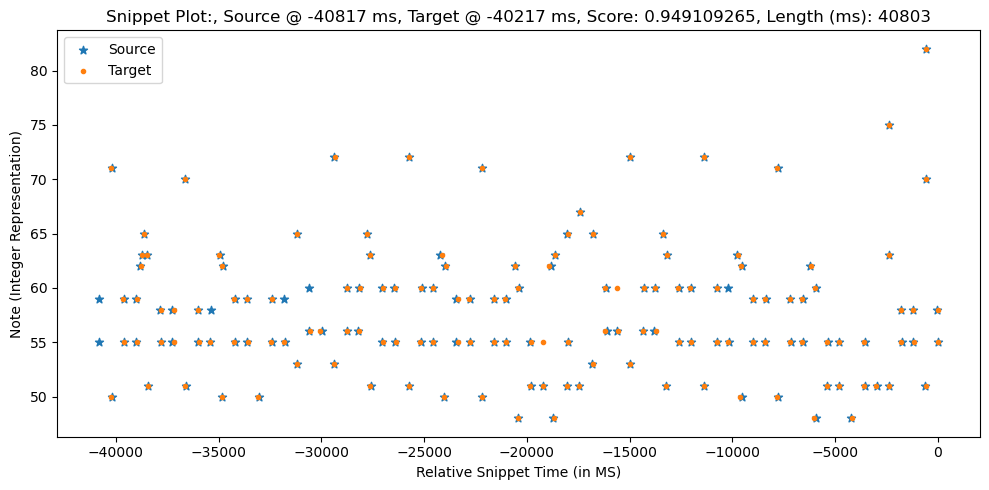

Scores: [ 0.8975  0.9325  0.865   0.9975  0.865   0.8675  0.8975  0.9425  0.89
  0.985   0.9275  0.99    0.965   0.8     0.72    0.97    0.9775  0.9525
  0.9225  0.99    0.94    0.9575  0.9775  0.915   0.925   0.9575  0.9225
  0.885   0.96    0.975   0.9375  0.9975  0.96    0.9225  0.835   0.9275
  0.9225  0.945   0.9025  0.9075  0.935   0.9425  0.9275  0.98    0.825
  0.845   0.91    0.91    0.9775  1.      0.83    0.87    0.94    0.985
  0.8325  0.96    0.885   0.7925  0.7825  0.9425  0.965   0.9875  0.9925
  0.985   0.9925  0.915   0.9725  0.9875  0.955   0.94    0.895   0.945
  0.9425 -0.      0.8475  0.9175  0.96    0.98    0.9275  0.955   0.9825
  0.9875  0.99    0.97    0.8925  0.8375 -0.      0.8425  0.9875  0.965
  0.98    0.94    0.9925  0.825   0.985   0.9775  0.985   0.92    0.9775
  0.8475  0.985   0.9875  0.975   0.94    0.945   0.8975  0.8875  0.7675
  0.91    0.9925  0.975   0.935   0.9825  0.9575  0.905   0.8975  0.8725
  0.8875  0.8875  0.865   0.7875  0.8975  0.9675 

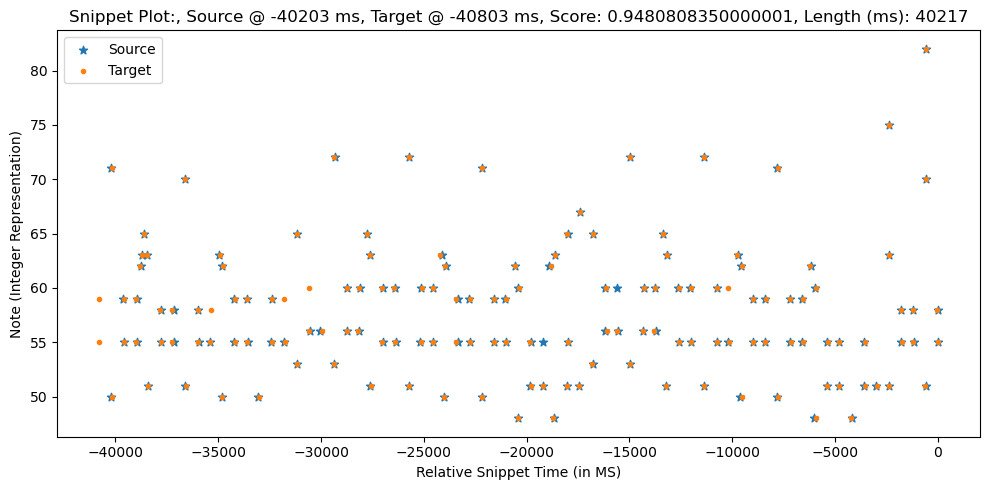

0.949109265
Scores: [-0.     -0.      0.9375  0.9025  0.9925  0.87    0.86    0.8625  0.8925
  0.9375  0.885   0.98    0.9225  0.96    0.985   0.715   0.795   0.975
  0.9825  0.9175  0.9475  0.995  -0.      0.945   0.9625  0.9825  0.93
  0.92    0.9525  0.9175  0.89    0.98    0.965  -0.      0.9425  0.9925
  0.955  -0.      0.9175  0.84    0.9225  0.9175  0.8975  0.94    0.9025
  0.93    0.9475  0.975   0.9325  0.82    0.84    0.905   0.905   0.9725
  0.995   0.835   0.875   0.935   0.98    0.8275  0.965   0.88    0.7875
  0.7775  0.9475  0.97    0.9925  0.9975  0.9875  0.99    0.92    0.9775
  0.9925  0.96    0.945   0.94    0.9     0.9375  0.8525  0.9125  0.955
  0.9225  0.985   0.95    0.9875  0.9925  0.985   0.965   0.8975  0.8425
  0.8375  0.96    0.9925  0.975   0.945   0.82    0.9875  0.99    0.9825
  0.99    0.9725  0.925   0.99    0.8525  0.97    0.9825  0.945   0.95
 -0.      0.9025  0.8825  0.7725  0.915   0.9875  0.98    0.9875  0.94
  0.9625  0.91    0.9025  0.8775  0.892

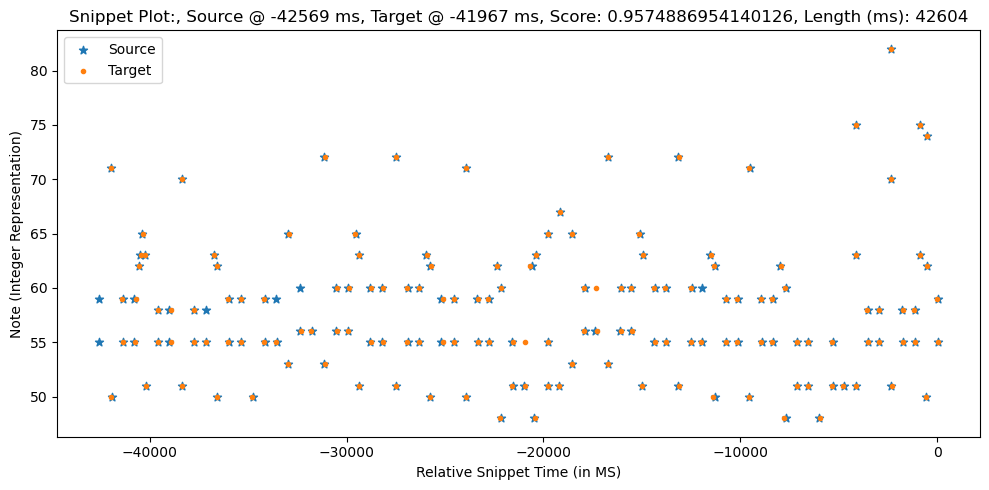

Scores: [ 0.9025  0.9375  0.87    0.9925  0.86    0.8625  0.8925  0.9375  0.885
  0.98    0.9225  0.985   0.96    0.795   0.715   0.975   0.9825  0.9475
  0.9175  0.995   0.945   0.9625  0.9825  0.92    0.93    0.9525  0.9175
  0.89    0.965   0.98    0.9425  0.9925  0.955   0.9175  0.84    0.9225
  0.9175  0.94    0.8975  0.9025  0.93    0.9475  0.9325  0.975   0.82
  0.84    0.905   0.905   0.9725  0.995   0.835   0.875   0.935   0.98
  0.8275  0.965   0.88    0.7875  0.7775  0.9475  0.97    0.9925  0.9975
  0.99    0.9875  0.92    0.9775  0.9925  0.96    0.945   0.9     0.94
  0.9375 -0.      0.8525  0.9125  0.955   0.985   0.9225  0.95    0.9875
  0.9925  0.985   0.965   0.8975  0.8425 -0.      0.8375  0.9925  0.96
  0.975   0.945   0.9875  0.82    0.99    0.9825  0.99    0.925   0.9725
  0.8525  0.99    0.9825  0.97    0.945   0.95    0.9025  0.8825  0.7725
  0.915   0.9875  0.98    0.94    0.9875  0.9625  0.91    0.9025  0.8775
  0.8925  0.8925  0.86    0.7925  0.9025  0.9725  0.

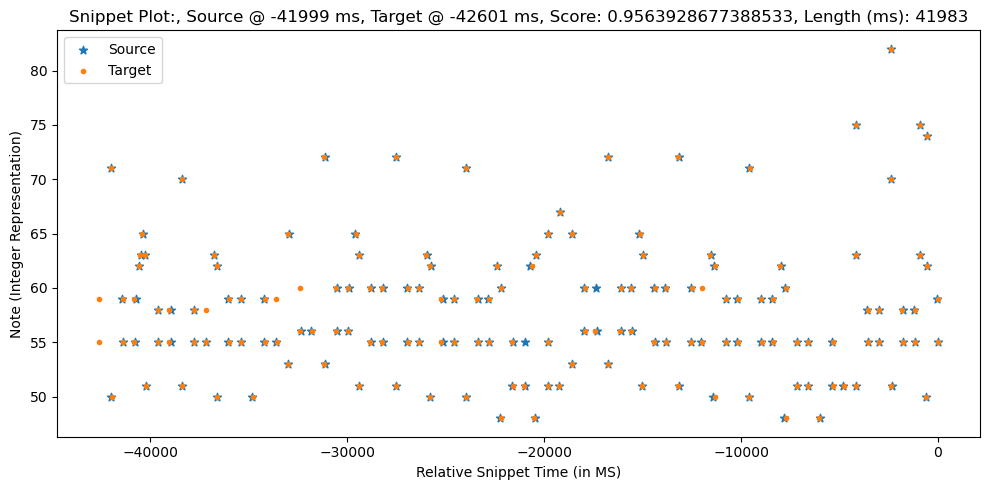

0.9574886954140126
Scores: [-0.     -0.      0.9375  0.9025  0.9925  0.87    0.86    0.8625  0.8925
  0.9375  0.885   0.98    0.9225  0.96    0.985   0.715   0.795   0.975
  0.9825  0.9175  0.9475  0.995  -0.      0.945   0.9625  0.9825  0.93
  0.92    0.9525  0.9175  0.89    0.98    0.965  -0.      0.9425  0.9925
  0.955  -0.      0.9175  0.84    0.9225  0.9175  0.8975  0.94    0.9025
  0.93    0.9475  0.975   0.9325  0.82    0.84    0.905   0.905   0.9725
  0.995   0.835   0.875   0.935   0.98    0.8275  0.965   0.88    0.7875
  0.7775  0.9475  0.97    0.9925  0.9975  0.9875  0.99    0.92    0.9775
  0.9925  0.96    0.945   0.94    0.9     0.9375  0.8525  0.9125  0.955
  0.9225  0.985   0.95    0.9875  0.9925  0.985   0.965   0.8975  0.8425
  0.8375  0.96    0.9925  0.975   0.945   0.82    0.9875  0.99    0.9825
  0.99    0.9725  0.925   0.99    0.8525  0.97    0.9825  0.945   0.95
 -0.      0.9025  0.8825  0.7725  0.915   0.9875  0.98    0.9875  0.94
  0.9625  0.91    0.9025  0.8775

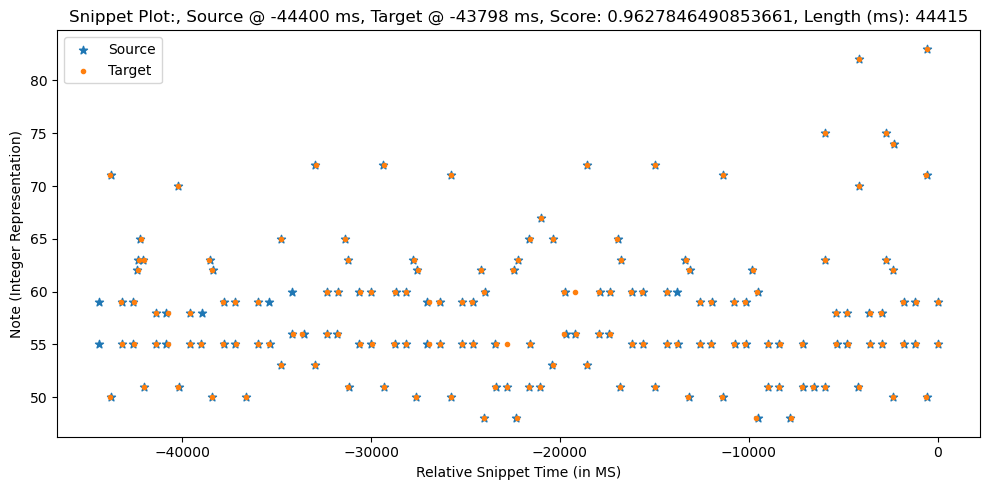

Scores: [ 0.9     0.935   0.8675  0.995   0.8625  0.865   0.895   0.94    0.8875
  0.9825  0.925   0.9875  0.9625  0.7975  0.7175  0.9725  0.98    0.95
  0.92    0.9925  0.9425  0.96    0.98    0.9175  0.9275  0.955   0.92
  0.8875  0.9625  0.9775  0.94    0.995   0.9575  0.92    0.8375  0.925
  0.92    0.9425  0.9     0.905   0.9325  0.945   0.93    0.9775  0.8225
  0.8425  0.9075  0.9075  0.975   0.9975  0.8325  0.8725  0.9375  0.9825
  0.83    0.9625  0.8825  0.79    0.78    0.945   0.9675  0.99    0.995
  0.9875  0.99    0.9175  0.975   0.99    0.9575  0.9425  0.8975  0.9425
  0.94   -0.      0.85    0.915   0.9575  0.9825  0.925   0.9525  0.985
  0.99    0.9875  0.9675  0.895   0.84   -0.      0.84    0.99    0.9625
  0.9775  0.9425  0.99    0.8225  0.9875  0.98    0.9875  0.9225  0.975
  0.85    0.9875  0.985   0.9725  0.9425  0.9475  0.9     0.885   0.77
  0.9125  0.99    0.9775  0.9375  0.985   0.96    0.9075  0.9     0.875
  0.89    0.89    0.8625  0.79    0.9     0.97    0.98

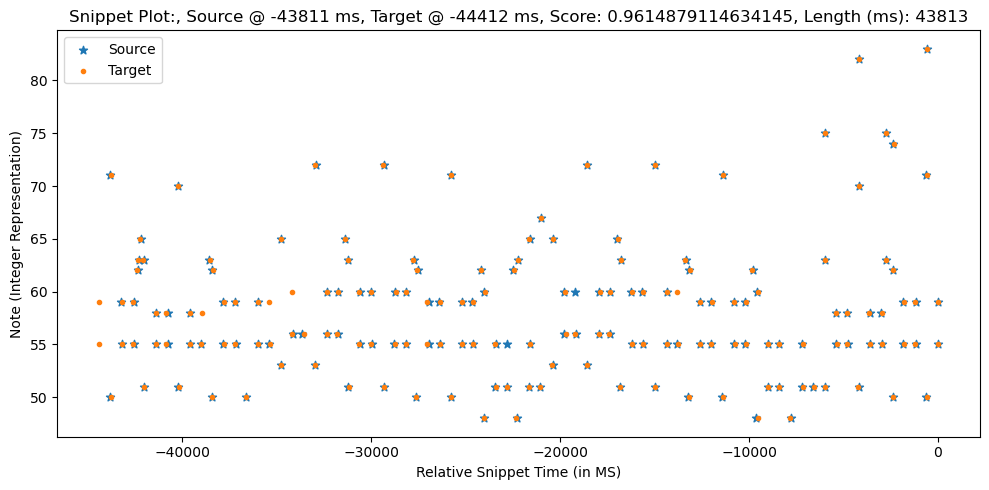

0.9627846490853661
Scores: [-0.     -0.      0.9375  0.9025  0.9925  0.87    0.86    0.8625  0.8925
  0.9375  0.885   0.98    0.9225  0.96    0.985   0.715   0.795   0.975
  0.9825  0.9175  0.9475  0.995  -0.      0.945   0.9625  0.9825  0.93
  0.92    0.9525  0.9175  0.89    0.98    0.965  -0.      0.9425  0.9925
  0.955  -0.      0.9175  0.84    0.9225  0.9175  0.8975  0.94    0.9025
  0.93    0.9475  0.975   0.9325  0.82    0.84    0.905   0.905   0.9725
  0.995   0.835   0.875   0.935   0.98    0.8275  0.965   0.88    0.7875
  0.7775  0.9475  0.97    0.9925  0.9975  0.9875  0.99    0.92    0.9775
  0.9925  0.96    0.945   0.94    0.9     0.9375  0.8525  0.9125  0.955
  0.9225  0.985   0.95    0.9875  0.9925  0.985   0.965   0.8975  0.8425
  0.8375  0.96    0.9925  0.975   0.945   0.82    0.9875  0.99    0.9825
  0.99    0.9725  0.925   0.99    0.8525  0.97    0.9825  0.945   0.95
 -0.      0.9025  0.8825  0.7725  0.915   0.9875  0.98    0.9875  0.94
  0.9625  0.91    0.9025  0.8775

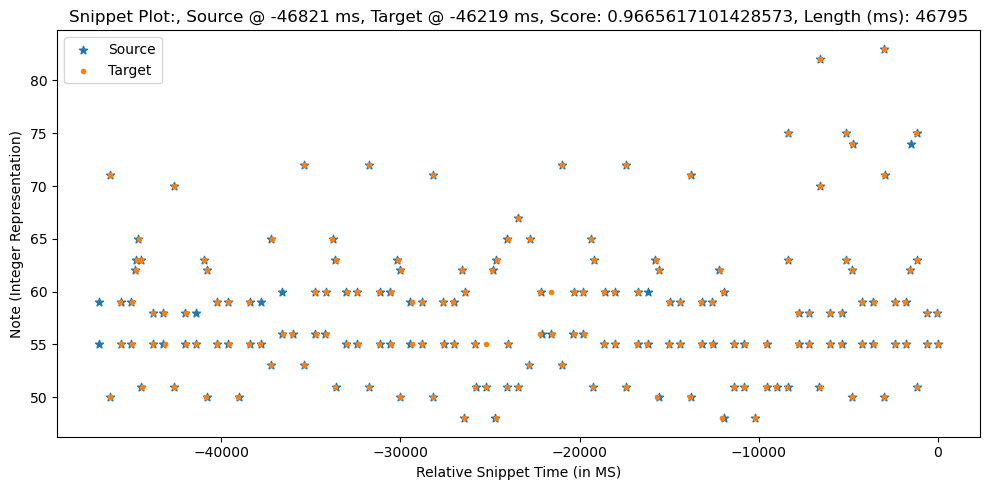

Scores: [ 0.9025  0.9375  0.87    0.9925  0.86    0.8625  0.8925  0.9375  0.885
  0.98    0.9225  0.985   0.96    0.795   0.715   0.975   0.9825  0.9475
  0.9175  0.995   0.945   0.9625  0.9825  0.92    0.93    0.9525  0.9175
  0.89    0.965   0.98    0.9425  0.9925  0.955   0.9175  0.84    0.9225
  0.9175  0.94    0.8975  0.9025  0.93    0.9475  0.9325  0.975   0.82
  0.84    0.905   0.905   0.9725  0.995   0.835   0.875   0.935   0.98
  0.8275  0.965   0.88    0.7875  0.7775  0.9475  0.97    0.9925  0.9975
  0.99    0.9875  0.92    0.9775  0.9925  0.96    0.945   0.9     0.94
  0.9375 -0.      0.8525  0.9125  0.955   0.985   0.9225  0.95    0.9875
  0.9925  0.985   0.965   0.8975  0.8425 -0.      0.8375  0.9925  0.96
  0.975   0.945   0.9875  0.82    0.99    0.9825  0.99    0.925   0.9725
  0.8525  0.99    0.9825  0.97    0.945   0.95    0.9025  0.8825  0.7725
  0.915   0.9875  0.98    0.94    0.9875  0.9625  0.91    0.9025  0.8775
  0.8925  0.8925  0.86    0.7925  0.9025  0.9725  0.

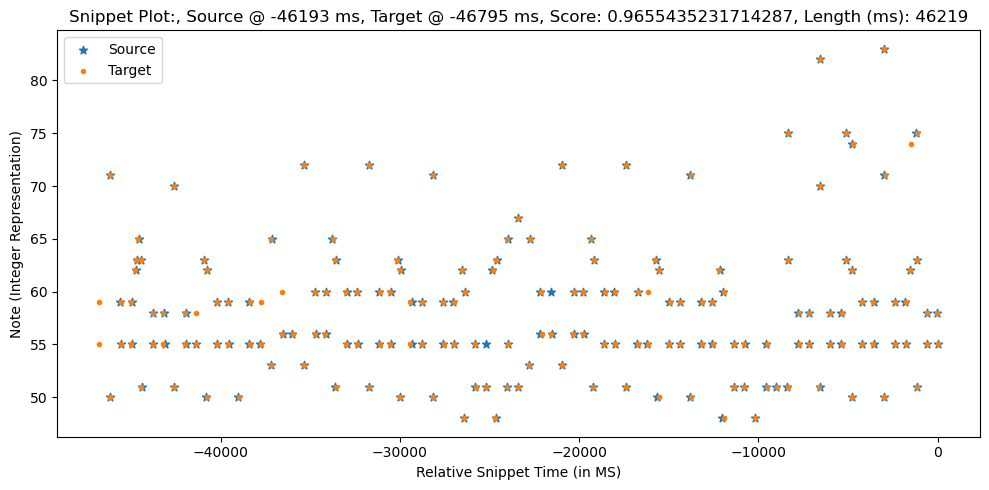

0.9665617101428573
Scores: [-0.     -0.      0.9425  0.9075  0.9875  0.875   0.855   0.8575  0.8875
  0.9325  0.88    0.975   0.9175  0.955   0.98    0.71    0.79    0.98
  0.9875  0.9125  0.9425  1.     -0.      0.95    0.9675  0.9875  0.935
  0.925   0.9475  0.9125  0.895   0.985   0.97   -0.      0.9475  0.9875
  0.95   -0.      0.9125  0.845   0.9175  0.9125  0.8925  0.935   0.8975
  0.925   0.9525  0.97    0.9375  0.815   0.835   0.9     0.9     0.9675
  0.99    0.84    0.88    0.93    0.975   0.8225  0.97    0.875   0.7825
  0.7725  0.9525  0.975   0.9975  0.9975  0.9825  0.995   0.925   0.9825
  0.9975  0.965   0.95    0.935   0.905   0.9325  0.8575  0.9075  0.95
  0.9175  0.99    0.945   0.9925  0.9975  0.98    0.96    0.9025  0.8475
  0.8325  0.955   0.9975  0.97    0.95    0.815   0.9825  0.995   0.9875
  0.995   0.9675  0.93    0.995   0.8575  0.965   0.9775  0.95    0.955
 -0.      0.9075  0.8775  0.7775  0.92    0.9825  0.985   0.9925  0.945
  0.9675  0.915   0.9075  0.882

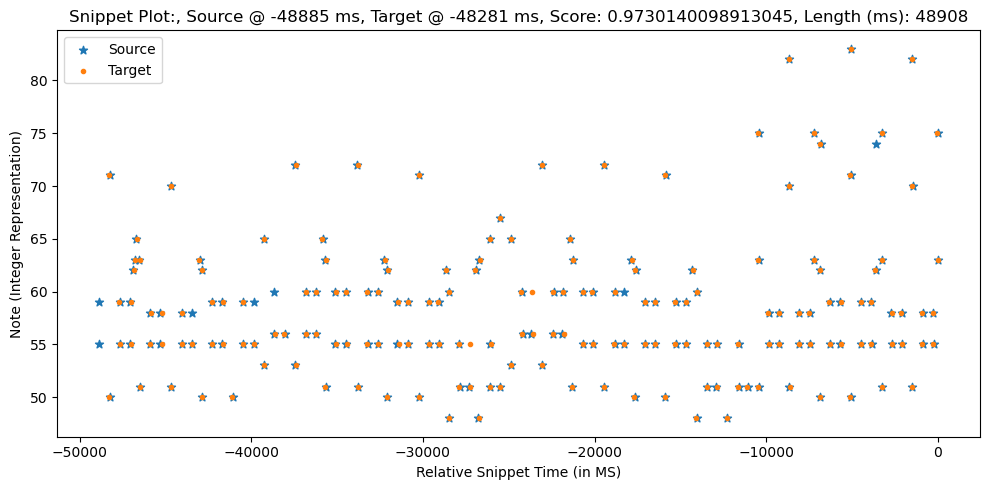

Scores: [ 0.9075  0.9425  0.875   0.9875  0.855   0.8575  0.8875  0.9325  0.88
  0.975   0.9175  0.98    0.955   0.79    0.71    0.98    0.9875  0.9425
  0.9125  1.      0.95    0.9675  0.9875  0.925   0.935   0.9475  0.9125
  0.895   0.97    0.985   0.9475  0.9875  0.95    0.9125  0.845   0.9175
  0.9125  0.935   0.8925  0.8975  0.925   0.9525  0.9375  0.97    0.815
  0.835   0.9     0.9     0.9675  0.99    0.84    0.88    0.93    0.975
  0.8225  0.97    0.875   0.7825  0.7725  0.9525  0.975   0.9975  0.9975
  0.995   0.9825  0.925   0.9825  0.9975  0.965   0.95    0.905   0.935
  0.9325 -0.      0.8575  0.9075  0.95    0.99    0.9175  0.945   0.9925
  0.9975  0.98    0.96    0.9025  0.8475 -0.      0.8325  0.9975  0.955
  0.97    0.95    0.9825  0.815   0.995   0.9875  0.995   0.93    0.9675
  0.8575  0.995   0.9775  0.965   0.95    0.955   0.9075  0.8775  0.7775
  0.92    0.9825  0.985   0.945   0.9925  0.9675  0.915   0.9075  0.8825
  0.8975  0.8975  0.855   0.7975  0.9075  0.9775 

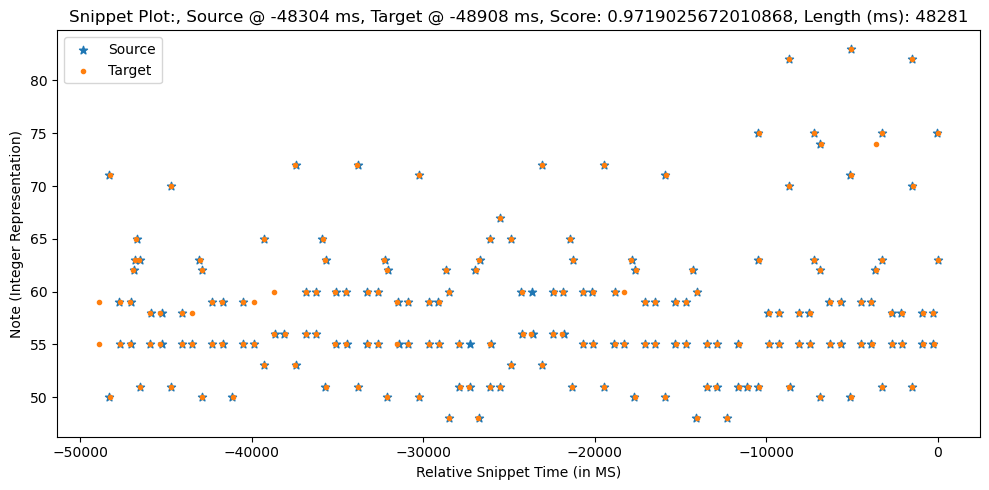

0.9730140098913045
Scores: [-0.     -0.     -0.     -0.      0.95    0.785  -0.     -0.     -0.
  0.2925 -0.     -0.     -0.      0.9375  0.9225 -0.     -0.     -0.
 -0.      0.8775  0.825 ]
Sequence1:  [[-4730    71    55]
 [-4719    50    45]
 [-4124    55    51]
 [-4119    59    34]
 [-3576    55    48]
 [-3560    59    29]
 [-3350    62    49]
 [-3274    63    54]
 [-3190    65    59]
 [-3007    63    54]
 [-2990    51    53]
 [-2368    58    36]
 [-2366    55    44]
 [-1810    55    49]
 [-1796    58    44]
 [-1159    70    58]
 [-1148    51    46]
 [ -549    55    45]
 [ -546    58    32]
 [   58    55    48]
 [   70    58    39]]
Sequence2:  [[-4233    50    42]
 [-4230    71    55]
 [-3646    59    37]
 [-3596    55    39]
 [-2995    55    46]
 [-2980    59    23]
 [-2782    62    43]
 [-2724    63    56]
 [-2619    65    45]
 [-2474    63    49]
 [-2434    51    53]
 [-1835    55    49]
 [-1827    58    34]
 [-1189    58    26]
 [-1171    55    35]
 [ -644    70    53]
 [ -630

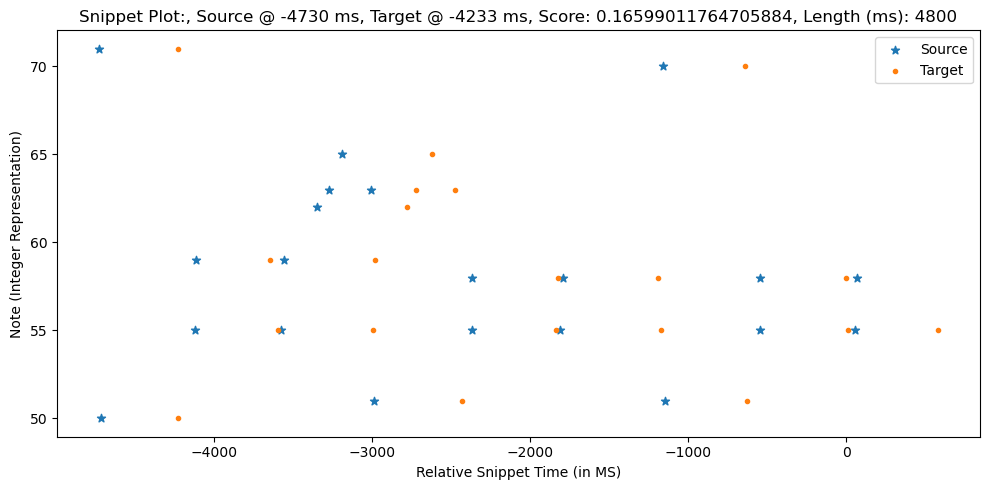

Scores: [0.8525 0.8875 0.82   0.9575 0.91   0.9125 0.9425 0.9875 0.935  0.97
 0.9725 0.965  0.99   0.845  0.765  0.925  0.9325 0.9975 0.9675 0.945 ]
Sequence1:  [[-4836    50    42]
 [-4833    71    55]
 [-4249    59    37]
 [-4199    55    39]
 [-3598    55    46]
 [-3583    59    23]
 [-3385    62    43]
 [-3327    63    56]
 [-3222    65    45]
 [-3077    63    49]
 [-3037    51    53]
 [-2438    55    49]
 [-2430    58    34]
 [-1792    58    26]
 [-1774    55    35]
 [-1247    70    53]
 [-1233    51    51]
 [ -603    58    33]
 [ -594    55    42]
 [  -22    55    48]]
Sequence2:  [[-4788    71    55]
 [-4777    50    45]
 [-4182    55    51]
 [-4177    59    34]
 [-3634    55    48]
 [-3618    59    29]
 [-3408    62    49]
 [-3332    63    54]
 [-3248    65    59]
 [-3065    63    54]
 [-3048    51    53]
 [-2426    58    36]
 [-2424    55    44]
 [-1868    55    49]
 [-1854    58    44]
 [-1217    70    58]
 [-1206    51    46]
 [ -607    55    45]
 [ -604    58    32]
 [    0

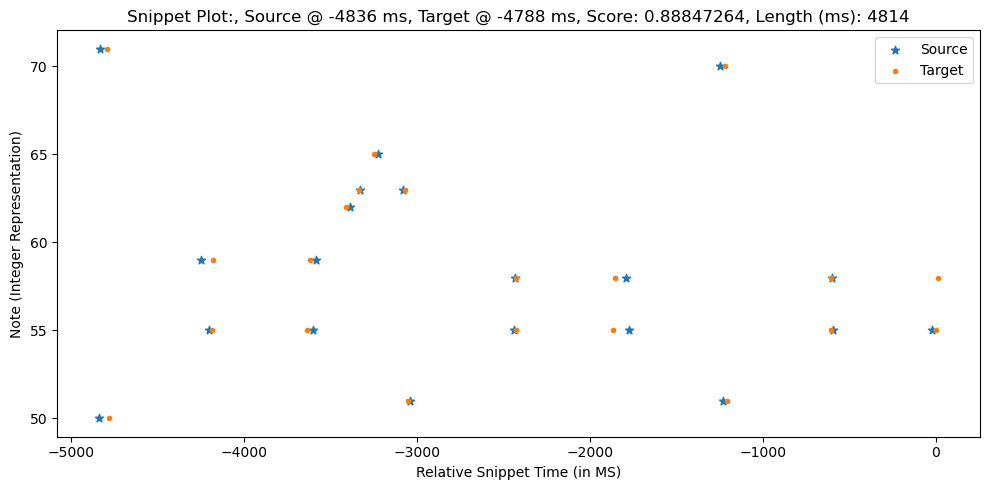

0.88847264
Scores: [ 0.9025  0.8675  0.9725  0.835   0.895   0.8975  0.9275  0.9725  0.92
  0.985   0.9575  0.995   0.98    0.75    0.83    0.94    0.9475  0.9525
  0.9825  0.96   -0.      0.91    0.9275  0.9475  0.895   0.885   0.9875
  0.9525]
Sequence1:  [[-6584    71    55]
 [-6573    50    45]
 [-5978    55    51]
 [-5973    59    34]
 [-5430    55    48]
 [-5414    59    29]
 [-5204    62    49]
 [-5128    63    54]
 [-5044    65    59]
 [-4861    63    54]
 [-4844    51    53]
 [-4222    58    36]
 [-4220    55    44]
 [-3664    55    49]
 [-3650    58    44]
 [-3013    70    58]
 [-3002    51    46]
 [-2403    55    45]
 [-2400    58    32]
 [-1796    55    48]
 [-1784    58    39]
 [-1350    63    52]
 [-1214    50    42]
 [-1202    62    56]
 [ -620    59    46]
 [ -618    55    46]
 [  -25    59    42]
 [  -19    55    48]]
Sequence2:  [[-6626    50    42]
 [-6623    71    55]
 [-6039    59    37]
 [-5989    55    39]
 [-5388    55    46]
 [-5373    59    23]
 [-5175    62  

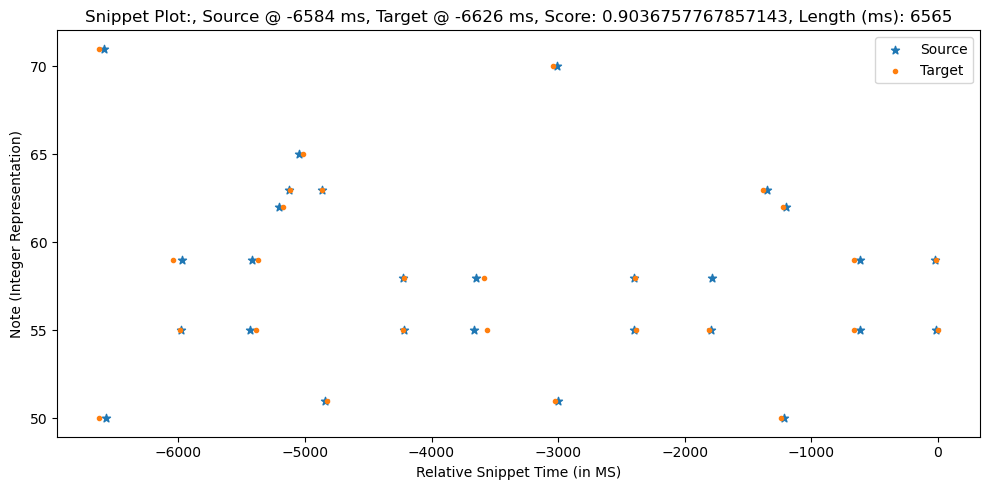

Scores: [0.8675 0.9025 0.835  0.9725 0.895  0.8975 0.9275 0.9725 0.92   0.985
 0.9575 0.98   0.995  0.83   0.75   0.94   0.9475 0.9825 0.9525 0.96
 0.91   0.9275 0.9475 0.885  0.895  0.9875 0.9525]
Sequence1:  [[-6607    50    42]
 [-6604    71    55]
 [-6020    59    37]
 [-5970    55    39]
 [-5369    55    46]
 [-5354    59    23]
 [-5156    62    43]
 [-5098    63    56]
 [-4993    65    45]
 [-4848    63    49]
 [-4808    51    53]
 [-4209    55    49]
 [-4201    58    34]
 [-3563    58    26]
 [-3545    55    35]
 [-3018    70    53]
 [-3004    51    51]
 [-2374    58    33]
 [-2365    55    42]
 [-1793    55    48]
 [-1367    63    49]
 [-1224    50    44]
 [-1204    62    54]
 [ -645    55    44]
 [ -643    59    42]
 [   -1    59    41]
 [   19    55    45]]
Sequence2:  [[-6565    71    55]
 [-6554    50    45]
 [-5959    55    51]
 [-5954    59    34]
 [-5411    55    48]
 [-5395    59    29]
 [-5185    62    49]
 [-5109    63    54]
 [-5025    65    59]
 [-4842    63    54]


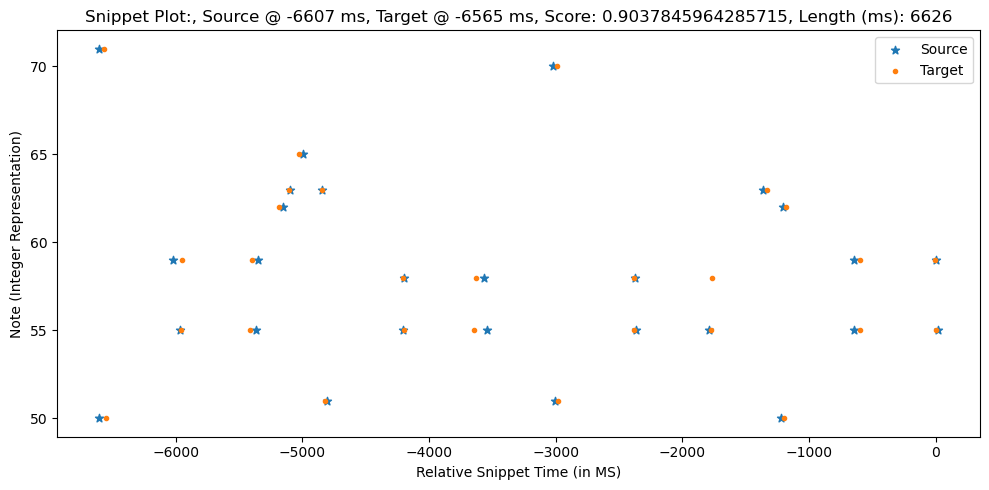

0.9037845964285715
Scores: [ 0.9175  0.8825  0.9875  0.85    0.88    0.8825  0.9125  0.9575  0.905
  1.      0.9425  0.98    0.995   0.735   0.815   0.955   0.9625  0.9375
  0.9675  0.975  -0.      0.925   0.9425  0.9625  0.91    0.9     0.9725
  0.9375  0.87    0.96    0.945   0.      0.9225]
Sequence1:  [[-8368    71    55]
 [-8357    50    45]
 [-7762    55    51]
 [-7757    59    34]
 [-7214    55    48]
 [-7198    59    29]
 [-6988    62    49]
 [-6912    63    54]
 [-6828    65    59]
 [-6645    63    54]
 [-6628    51    53]
 [-6006    58    36]
 [-6004    55    44]
 [-5448    55    49]
 [-5434    58    44]
 [-4797    70    58]
 [-4786    51    46]
 [-4187    55    45]
 [-4184    58    32]
 [-3580    55    48]
 [-3568    58    39]
 [-3134    63    52]
 [-2998    50    42]
 [-2986    62    56]
 [-2404    59    46]
 [-2402    55    46]
 [-1809    59    42]
 [-1803    55    48]
 [-1194    50    46]
 [ -593    59    39]
 [ -591    55    44]
 [   15    59    34]
 [   31    55    41]]

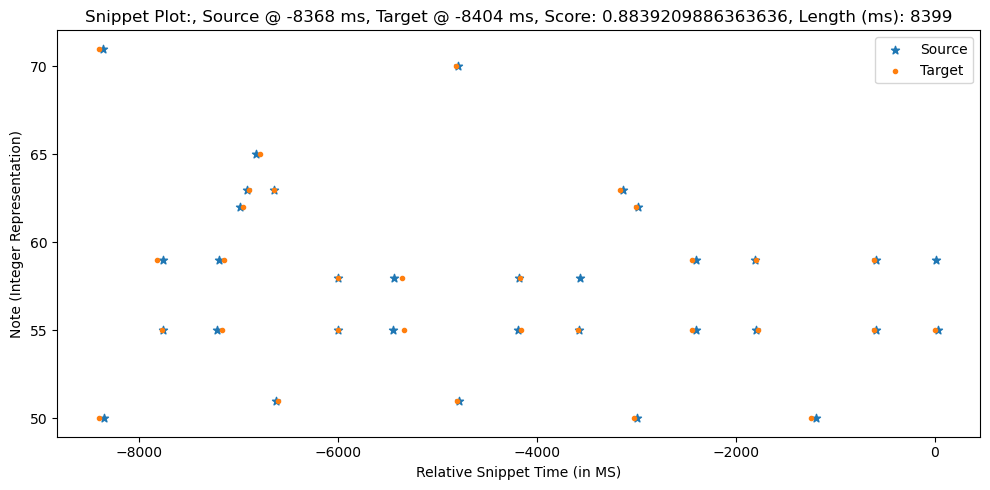

Scores: [0.8825 0.9175 0.85   0.9875 0.88   0.8825 0.9125 0.9575 0.905  1.
 0.9425 0.995  0.98   0.815  0.735  0.955  0.9625 0.9675 0.9375 0.975
 0.925  0.9425 0.9625 0.9    0.91   0.9725 0.9375 0.87   0.945  0.96
 0.9225]
Sequence1:  [[-8435    50    42]
 [-8432    71    55]
 [-7848    59    37]
 [-7798    55    39]
 [-7197    55    46]
 [-7182    59    23]
 [-6984    62    43]
 [-6926    63    56]
 [-6821    65    45]
 [-6676    63    49]
 [-6636    51    53]
 [-6037    55    49]
 [-6029    58    34]
 [-5391    58    26]
 [-5373    55    35]
 [-4846    70    53]
 [-4832    51    51]
 [-4202    58    33]
 [-4193    55    42]
 [-3621    55    48]
 [-3195    63    49]
 [-3052    50    44]
 [-3032    62    54]
 [-2473    55    44]
 [-2471    59    42]
 [-1829    59    41]
 [-1809    55    45]
 [-1277    50    51]
 [ -644    55    44]
 [ -640    59    40]
 [  -31    55    47]]
Sequence2:  [[-8399    71    55]
 [-8388    50    45]
 [-7793    55    51]
 [-7788    59    34]
 [-7245    55    

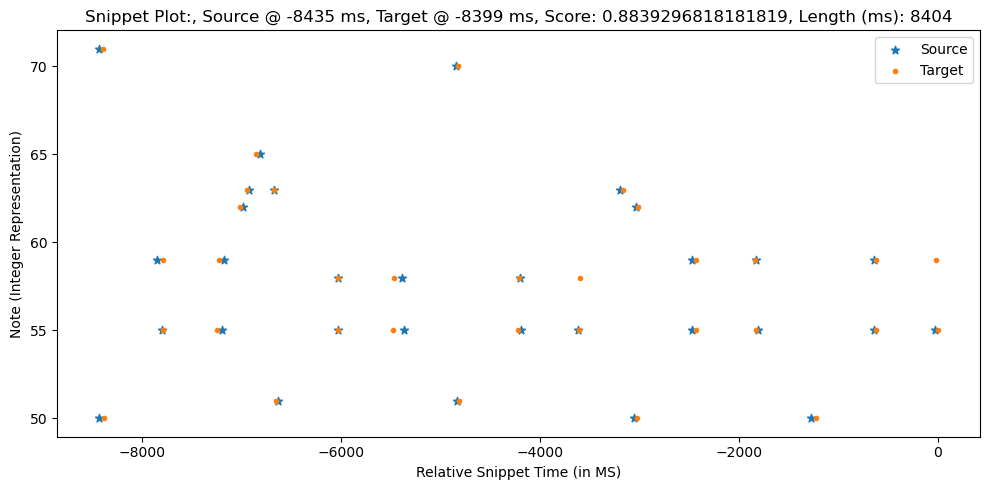

0.8839296818181819
Scores: [-0.     -0.     -0.     -0.      0.745   0.91   -0.     -0.     -0.
 -0.     -0.     -0.     -0.      0.7575  0.7725 -0.     -0.     -0.
 -0.      0.8175  0.87   -0.     -0.     -0.     -0.     -0.      0.94
  0.96   -0.     -0.     -0.      0.9225  0.9725 -0.     -0.     -0.
 -0.      0.805   0.      0.    ]
Sequence1:  [[-10785     71     55]
 [-10774     50     45]
 [-10179     55     51]
 [-10174     59     34]
 [ -9631     55     48]
 [ -9615     59     29]
 [ -9405     62     49]
 [ -9329     63     54]
 [ -9245     65     59]
 [ -9062     63     54]
 [ -9045     51     53]
 [ -8423     58     36]
 [ -8421     55     44]
 [ -7865     55     49]
 [ -7851     58     44]
 [ -7214     70     58]
 [ -7203     51     46]
 [ -6604     55     45]
 [ -6601     58     32]
 [ -5997     55     48]
 [ -5985     58     39]
 [ -5551     63     52]
 [ -5415     50     42]
 [ -5403     62     56]
 [ -4821     59     46]
 [ -4819     55     46]
 [ -4226     59     42]
 

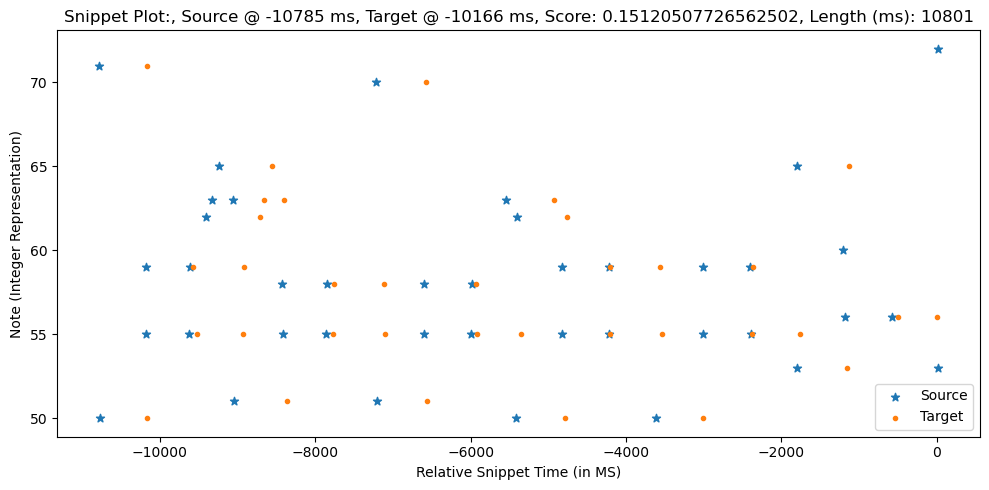

Scores: [0.885  0.92   0.8525 0.99   0.8775 0.88   0.91   0.955  0.9025 0.9975
 0.94   0.9975 0.9775 0.8125 0.7325 0.9575 0.965  0.965  0.935  0.9775
 0.9275 0.945  0.965  0.9025 0.9125 0.97   0.935  0.8725 0.9475 0.9625
 0.925  0.99   0.9725 0.935  0.8225]
Sequence1:  [[-10237     50     42]
 [-10234     71     55]
 [ -9650     59     37]
 [ -9600     55     39]
 [ -8999     55     46]
 [ -8984     59     23]
 [ -8786     62     43]
 [ -8728     63     56]
 [ -8623     65     45]
 [ -8478     63     49]
 [ -8438     51     53]
 [ -7839     55     49]
 [ -7831     58     34]
 [ -7193     58     26]
 [ -7175     55     35]
 [ -6648     70     53]
 [ -6634     51     51]
 [ -6004     58     33]
 [ -5995     55     42]
 [ -5423     55     48]
 [ -4997     63     49]
 [ -4854     50     44]
 [ -4834     62     54]
 [ -4275     55     44]
 [ -4273     59     42]
 [ -3631     59     41]
 [ -3611     55     45]
 [ -3079     50     51]
 [ -2446     55     44]
 [ -2442     59     40]
 [ -1833  

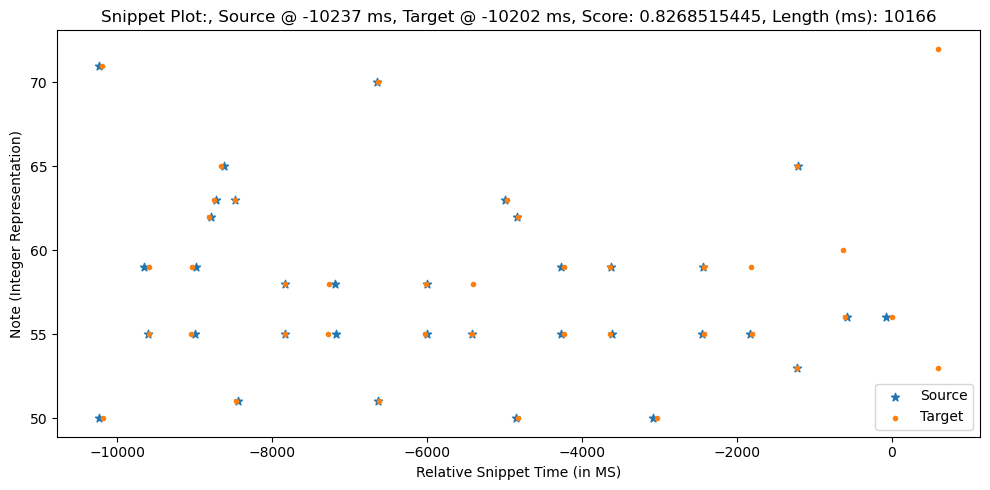

0.8268515445
Scores: [ 0.915   0.88    0.985   0.8475  0.8825  0.885   0.915   0.96    0.9075
  0.9975  0.945   0.9825  0.9925  0.7375  0.8175  0.9525  0.96    0.94
  0.97    0.9725 -0.      0.9225  0.94    0.96    0.9075  0.8975  0.975
  0.94    0.8675  0.9575  0.9425 -0.      0.92    0.985   0.9775 -0.
  0.94    0.8175  0.945   0.94    0.92    0.9625  0.925   0.9525  0.925
  0.9975  0.91  ]
Sequence1:  [[-12551     71     55]
 [-12540     50     45]
 [-11945     55     51]
 [-11940     59     34]
 [-11397     55     48]
 [-11381     59     29]
 [-11171     62     49]
 [-11095     63     54]
 [-11011     65     59]
 [-10828     63     54]
 [-10811     51     53]
 [-10189     58     36]
 [-10187     55     44]
 [ -9631     55     49]
 [ -9617     58     44]
 [ -8980     70     58]
 [ -8969     51     46]
 [ -8370     55     45]
 [ -8367     58     32]
 [ -7763     55     48]
 [ -7751     58     39]
 [ -7317     63     52]
 [ -7181     50     42]
 [ -7169     62     56]
 [ -6587     59 

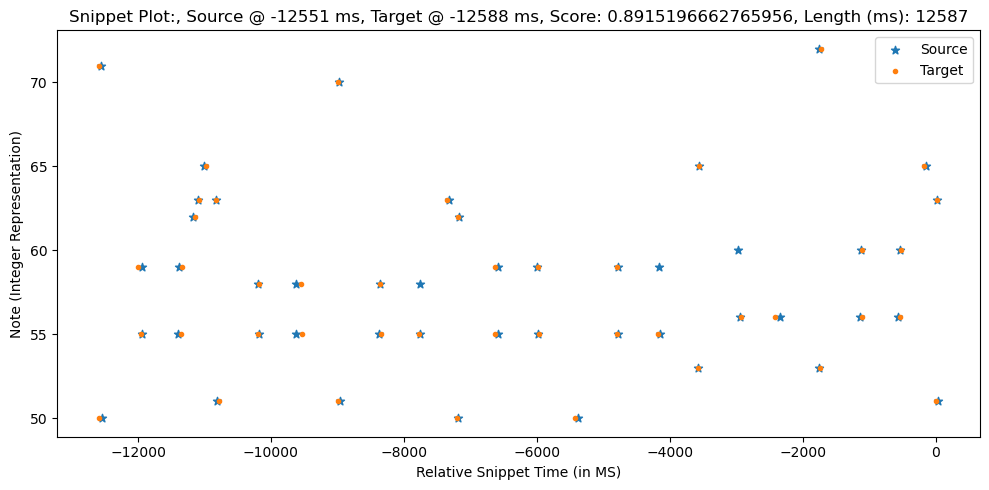

Scores: [0.8775 0.9125 0.845  0.9825 0.885  0.8875 0.9175 0.9625 0.91   0.995
 0.9475 0.99   0.985  0.82   0.74   0.95   0.9575 0.9725 0.9425 0.97
 0.92   0.9375 0.9575 0.895  0.905  0.9775 0.9425 0.865  0.94   0.955
 0.9175 0.9825 0.98   0.9425 0.815  0.9475 0.9425 0.965  0.9225 0.9275
 0.955  0.9225 0.9075 1.    ]
Sequence1:  [[-12602     50     42]
 [-12599     71     55]
 [-12015     59     37]
 [-11965     55     39]
 [-11364     55     46]
 [-11349     59     23]
 [-11151     62     43]
 [-11093     63     56]
 [-10988     65     45]
 [-10843     63     49]
 [-10803     51     53]
 [-10204     55     49]
 [-10196     58     34]
 [ -9558     58     26]
 [ -9540     55     35]
 [ -9013     70     53]
 [ -8999     51     51]
 [ -8369     58     33]
 [ -8360     55     42]
 [ -7788     55     48]
 [ -7362     63     49]
 [ -7219     50     44]
 [ -7199     62     54]
 [ -6640     55     44]
 [ -6638     59     42]
 [ -5996     59     41]
 [ -5976     55     45]
 [ -5444     50     51

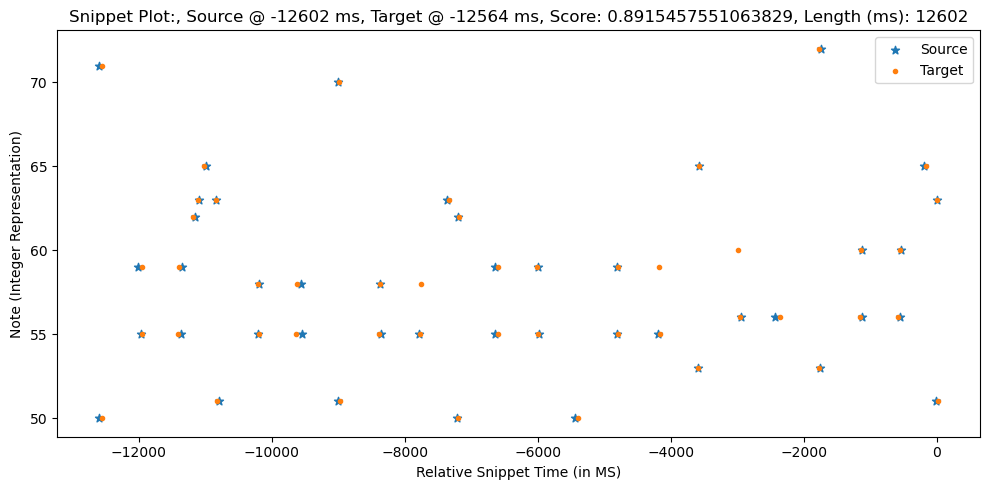

0.8915457551063829
Scores: [ 0.9075  0.8725  0.9775  0.84    0.89    0.8925  0.9225  0.9675  0.915
  0.99    0.9525  0.99    0.985   0.745   0.825   0.945   0.9525  0.9475
  0.9775  0.965  -0.      0.915   0.9325  0.9525  0.9     0.89    0.9825
  0.9475  0.86    0.95    0.935  -0.      0.9125  0.9775  0.985  -0.
  0.9475  0.81    0.9525  0.9475  0.9275  0.97    0.9325  0.96    0.9175
  0.995   0.9025  0.85    0.87    0.935   0.935   0.9975  0.975 ]
Sequence1:  [[-14431     71     55]
 [-14420     50     45]
 [-13825     55     51]
 [-13820     59     34]
 [-13277     55     48]
 [-13261     59     29]
 [-13051     62     49]
 [-12975     63     54]
 [-12891     65     59]
 [-12708     63     54]
 [-12691     51     53]
 [-12069     58     36]
 [-12067     55     44]
 [-11511     55     49]
 [-11497     58     44]
 [-10860     70     58]
 [-10849     51     46]
 [-10250     55     45]
 [-10247     58     32]
 [ -9643     55     48]
 [ -9631     58     39]
 [ -9197     63     52]
 [ -906

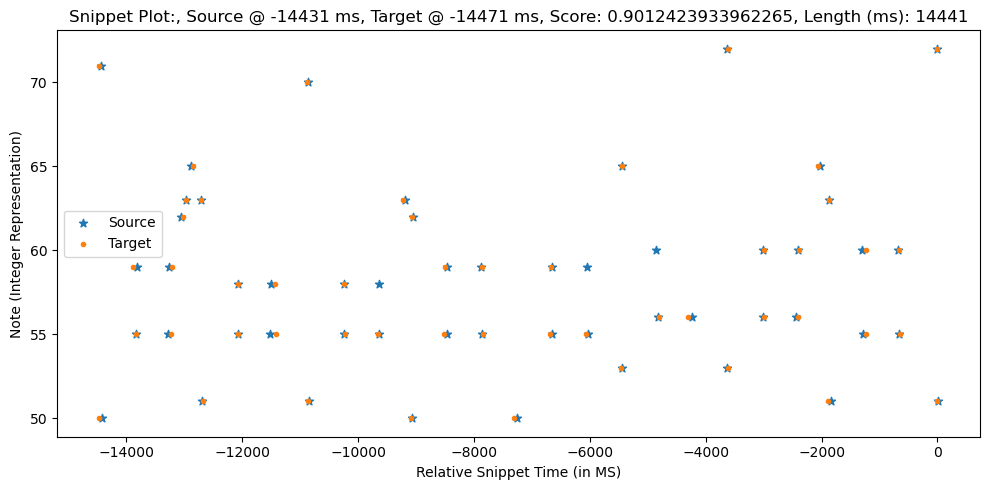

Scores: [0.8725 0.9075 0.84   0.9775 0.89   0.8925 0.9225 0.9675 0.915  0.99
 0.9525 0.985  0.99   0.825  0.745  0.945  0.9525 0.9775 0.9475 0.965
 0.915  0.9325 0.9525 0.89   0.9    0.9825 0.9475 0.86   0.935  0.95
 0.9125 0.9775 0.985  0.9475 0.81   0.9525 0.9475 0.97   0.9275 0.9325
 0.96   0.9175 0.9025 0.995  0.85   0.87   0.935  0.935  0.9975 0.975 ]
Sequence1:  [[-14481     50     42]
 [-14478     71     55]
 [-13894     59     37]
 [-13844     55     39]
 [-13243     55     46]
 [-13228     59     23]
 [-13030     62     43]
 [-12972     63     56]
 [-12867     65     45]
 [-12722     63     49]
 [-12682     51     53]
 [-12083     55     49]
 [-12075     58     34]
 [-11437     58     26]
 [-11419     55     35]
 [-10892     70     53]
 [-10878     51     51]
 [-10248     58     33]
 [-10239     55     42]
 [ -9667     55     48]
 [ -9241     63     49]
 [ -9098     50     44]
 [ -9078     62     54]
 [ -8519     55     44]
 [ -8517     59     42]
 [ -7875     59     41]
 [ -7

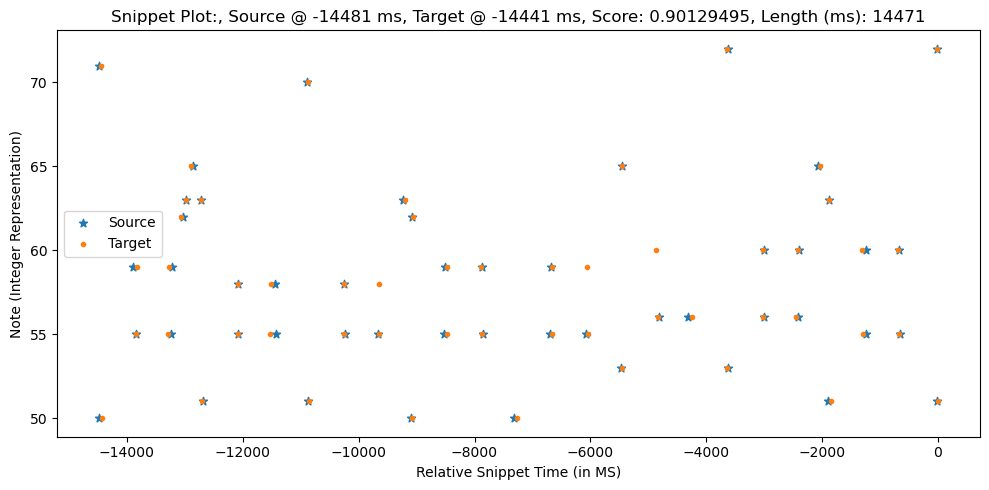

0.90129495
Scores: [-0.     -0.     -0.     -0.     -0.      0.1125 -0.     -0.     -0.
 -0.     -0.     -0.      0.53   -0.     -0.     -0.     -0.      0.5475
  0.495   0.02    0.0725 -0.     -0.     -0.     -0.      0.465   0.1425
  0.1625 -0.      0.4225  0.4675  0.125   0.175  -0.     -0.     -0.
 -0.      0.0075 -0.     -0.      0.22   -0.     -0.      0.0025 -0.
 -0.     -0.      0.7025 -0.     -0.     -0.     -0.     -0.      0.27
  0.2     0.135   0.1175 -0.     -0.     -0.     -0.      0.6625]
Sequence1:  [[-16604     71     55]
 [-16593     50     45]
 [-15998     55     51]
 [-15993     59     34]
 [-15450     55     48]
 [-15434     59     29]
 [-15224     62     49]
 [-15148     63     54]
 [-15064     65     59]
 [-14881     63     54]
 [-14864     51     53]
 [-14242     58     36]
 [-14240     55     44]
 [-13684     55     49]
 [-13670     58     44]
 [-13033     70     58]
 [-13022     51     46]
 [-12423     55     45]
 [-12420     58     32]
 [-11816     55     48]

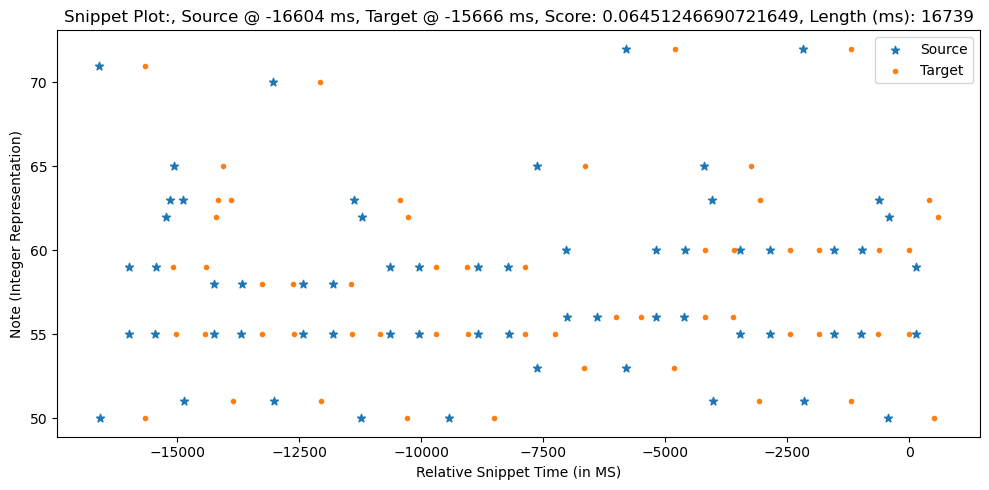

Scores: [0.8725 0.9075 0.84   0.9775 0.89   0.8925 0.9225 0.9675 0.915  0.99
 0.9525 0.985  0.99   0.825  0.745  0.945  0.9525 0.9775 0.9475 0.965
 0.915  0.9325 0.9525 0.89   0.9    0.9825 0.9475 0.86   0.935  0.95
 0.9125 0.9775 0.985  0.9475 0.81   0.9525 0.9475 0.97   0.9275 0.9325
 0.96   0.9175 0.9025 0.995  0.85   0.87   0.935  0.935  0.9975 0.975
 0.805  0.845  0.965  0.99   0.8575 0.935  0.91  ]
Sequence1:  [[-16224     50     42]
 [-16221     71     55]
 [-15637     59     37]
 [-15587     55     39]
 [-14986     55     46]
 [-14971     59     23]
 [-14773     62     43]
 [-14715     63     56]
 [-14610     65     45]
 [-14465     63     49]
 [-14425     51     53]
 [-13826     55     49]
 [-13818     58     34]
 [-13180     58     26]
 [-13162     55     35]
 [-12635     70     53]
 [-12621     51     51]
 [-11991     58     33]
 [-11982     55     42]
 [-11410     55     48]
 [-10984     63     49]
 [-10841     50     44]
 [-10821     62     54]
 [-10262     55     44]
 [-1

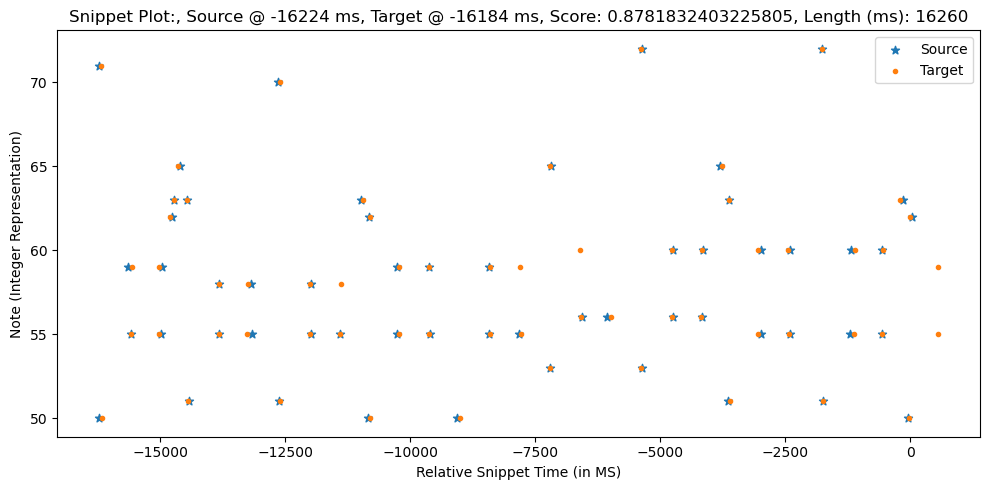

0.8781832403225805
Scores: [ 0.9075  0.8725  0.9775  0.84    0.89    0.8925  0.9225  0.9675  0.915
  0.99    0.9525  0.99    0.985   0.745   0.825   0.945   0.9525  0.9475
  0.9775  0.965  -0.      0.915   0.9325  0.9525  0.9     0.89    0.9825
  0.9475  0.86    0.95    0.935  -0.      0.9125  0.9775  0.985  -0.
  0.9475  0.81    0.9525  0.9475  0.9275  0.97    0.9325  0.96    0.9175
  0.995   0.9025  0.85    0.87    0.935   0.935   0.9975  0.975   0.805
  0.845   0.965   0.99    0.8575  0.935   0.91    0.8175  0.8075  0.9175
  0.94    0.9625  0.9675  0.9825  0.96  ]
Sequence1:  [[-18579     71     55]
 [-18568     50     45]
 [-17973     55     51]
 [-17968     59     34]
 [-17425     55     48]
 [-17409     59     29]
 [-17199     62     49]
 [-17123     63     54]
 [-17039     65     59]
 [-16856     63     54]
 [-16839     51     53]
 [-16217     58     36]
 [-16215     55     44]
 [-15659     55     49]
 [-15645     58     44]
 [-15008     70     58]
 [-14997     51     46]
 [-143

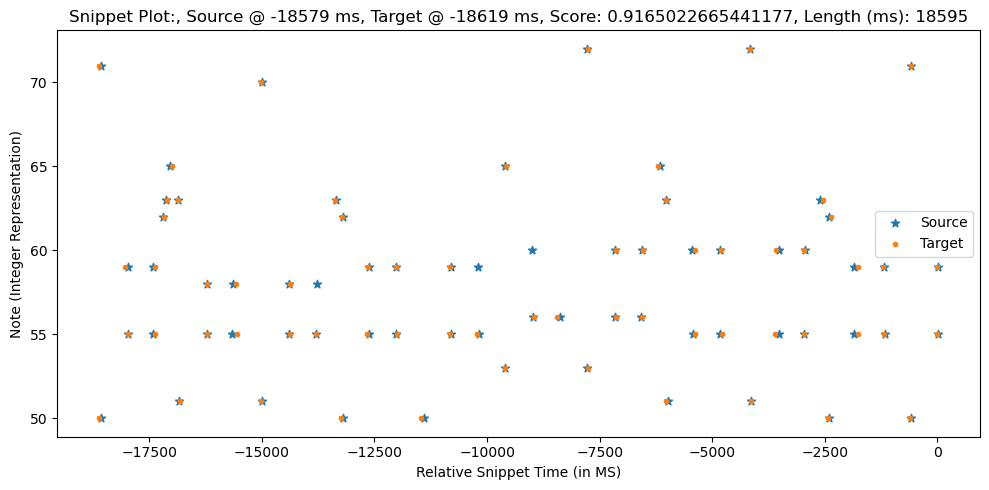

Scores: [0.8725 0.9075 0.84   0.9775 0.89   0.8925 0.9225 0.9675 0.915  0.99
 0.9525 0.985  0.99   0.825  0.745  0.945  0.9525 0.9775 0.9475 0.965
 0.915  0.9325 0.9525 0.89   0.9    0.9825 0.9475 0.86   0.935  0.95
 0.9125 0.9775 0.985  0.9475 0.81   0.9525 0.9475 0.97   0.9275 0.9325
 0.96   0.9175 0.9025 0.995  0.85   0.87   0.935  0.935  0.9975 0.975
 0.805  0.845  0.965  0.99   0.8575 0.935  0.91   0.8175 0.8075 0.9175
 0.94   0.9625 0.9675 0.96   0.9825]
Sequence1:  [[-18629     50     42]
 [-18626     71     55]
 [-18042     59     37]
 [-17992     55     39]
 [-17391     55     46]
 [-17376     59     23]
 [-17178     62     43]
 [-17120     63     56]
 [-17015     65     45]
 [-16870     63     49]
 [-16830     51     53]
 [-16231     55     49]
 [-16223     58     34]
 [-15585     58     26]
 [-15567     55     35]
 [-15040     70     53]
 [-15026     51     51]
 [-14396     58     33]
 [-14387     55     42]
 [-13815     55     48]
 [-13389     63     49]
 [-13246     50    

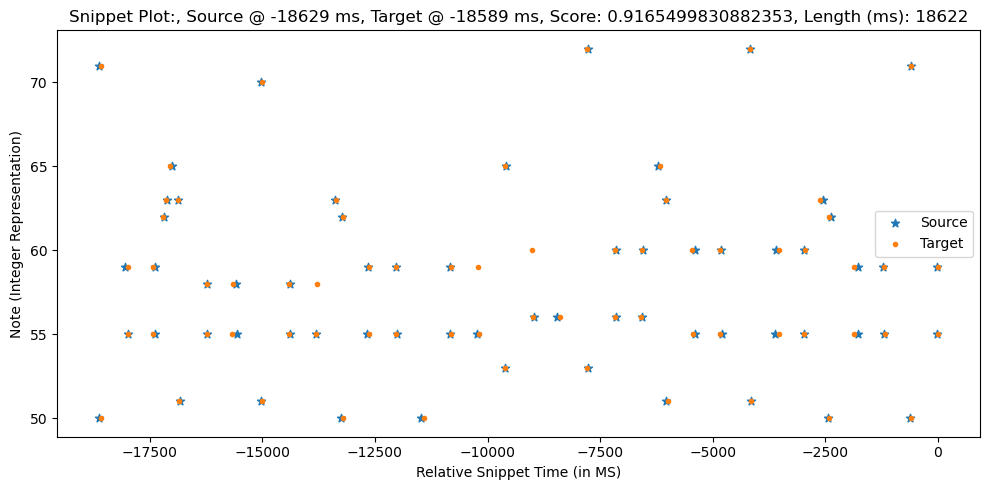

0.9165499830882353
Scores: [ 0.915   0.88    0.985   0.8475  0.8825  0.885   0.915   0.96    0.9075
  0.9975  0.945   0.9825  0.9925  0.7375  0.8175  0.9525  0.96    0.94
  0.97    0.9725 -0.      0.9225  0.94    0.96    0.9075  0.8975  0.975
  0.94    0.8675  0.9575  0.9425 -0.      0.92    0.985   0.9775 -0.
  0.94    0.8175  0.945   0.94    0.92    0.9625  0.925   0.9525  0.925
  0.9975  0.91    0.8425  0.8625  0.9275  0.9275  0.995   0.9825  0.8125
  0.8525  0.9575  0.9975  0.85    0.9425  0.9025  0.81    0.8     0.925
  0.9475  0.97    0.975   0.99    0.9675  0.8975  0.955   0.97    0.9375
  0.9225  0.9625  0.8775]
Sequence1:  [[-20340     71     55]
 [-20329     50     45]
 [-19734     55     51]
 [-19729     59     34]
 [-19186     55     48]
 [-19170     59     29]
 [-18960     62     49]
 [-18884     63     54]
 [-18800     65     59]
 [-18617     63     54]
 [-18600     51     53]
 [-17978     58     36]
 [-17976     55     44]
 [-17420     55     49]
 [-17406     58     44]


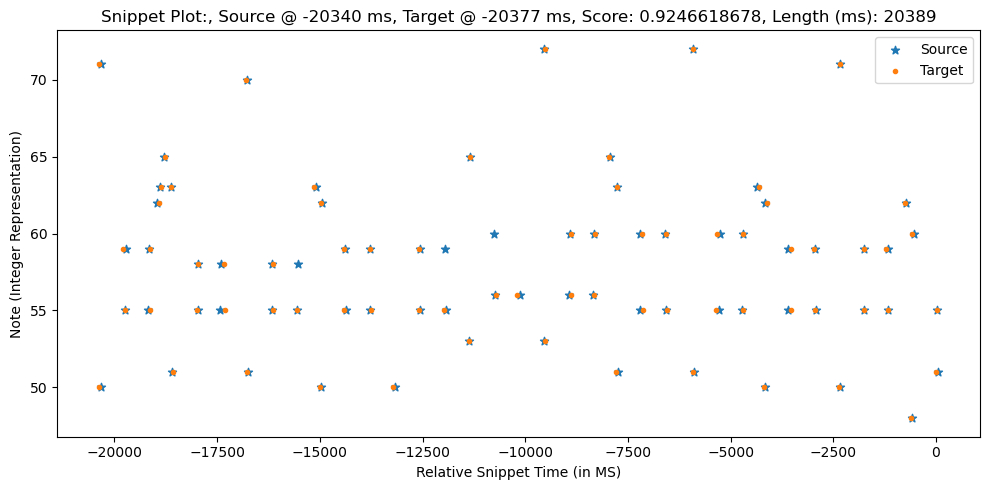

Scores: [0.8775 0.9125 0.845  0.9825 0.885  0.8875 0.9175 0.9625 0.91   0.995
 0.9475 0.99   0.985  0.82   0.74   0.95   0.9575 0.9725 0.9425 0.97
 0.92   0.9375 0.9575 0.895  0.905  0.9775 0.9425 0.865  0.94   0.955
 0.9175 0.9825 0.98   0.9425 0.815  0.9475 0.9425 0.965  0.9225 0.9275
 0.955  0.9225 0.9075 1.     0.845  0.865  0.93   0.93   0.9975 0.98
 0.81   0.85   0.96   0.995  0.8525 0.94   0.905  0.8125 0.8025 0.9225
 0.945  0.9675 0.9725 0.965  0.9875 0.895  0.9525 0.9675 0.935  0.92
 0.875  0.965 ]
Sequence1:  [[-20391     50     42]
 [-20388     71     55]
 [-19804     59     37]
 [-19754     55     39]
 [-19153     55     46]
 [-19138     59     23]
 [-18940     62     43]
 [-18882     63     56]
 [-18777     65     45]
 [-18632     63     49]
 [-18592     51     53]
 [-17993     55     49]
 [-17985     58     34]
 [-17347     58     26]
 [-17329     55     35]
 [-16802     70     53]
 [-16788     51     51]
 [-16158     58     33]
 [-16149     55     42]
 [-15577     55    

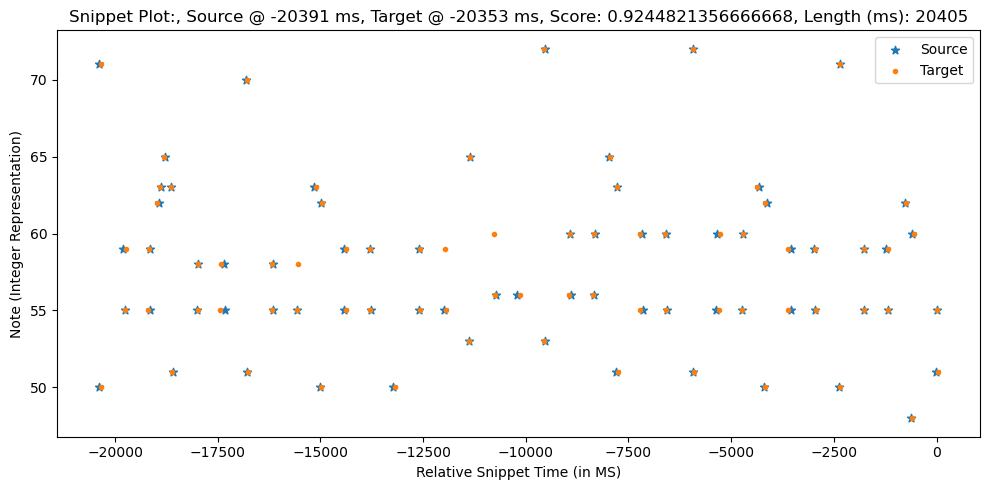

0.9246618678
Scores: [ 0.915   0.88    0.985   0.8475  0.8825  0.885   0.915   0.96    0.9075
  0.9975  0.945   0.9825  0.9925  0.7375  0.8175  0.9525  0.96    0.94
  0.97    0.9725 -0.      0.9225  0.94    0.96    0.9075  0.8975  0.975
  0.94    0.8675  0.9575  0.9425 -0.      0.92    0.985   0.9775 -0.
  0.94    0.8175  0.945   0.94    0.92    0.9625  0.925   0.9525  0.925
  0.9975  0.91    0.8425  0.8625  0.9275  0.9275  0.995   0.9825  0.8125
  0.8525  0.9575  0.9975  0.85    0.9425  0.9025  0.81    0.8     0.925
  0.9475  0.97    0.975   0.99    0.9675  0.8975  0.955   0.97    0.9375
  0.9225  0.9625  0.8775  0.96    0.83    0.935   0.9775  0.945   0.9625
  0.9725  0.965   0.97  ]
Sequence1:  [[-22754     71     55]
 [-22743     50     45]
 [-22148     55     51]
 [-22143     59     34]
 [-21600     55     48]
 [-21584     59     29]
 [-21374     62     49]
 [-21298     63     54]
 [-21214     65     59]
 [-21031     63     54]
 [-21014     51     53]
 [-20392     58     36]
 [-20

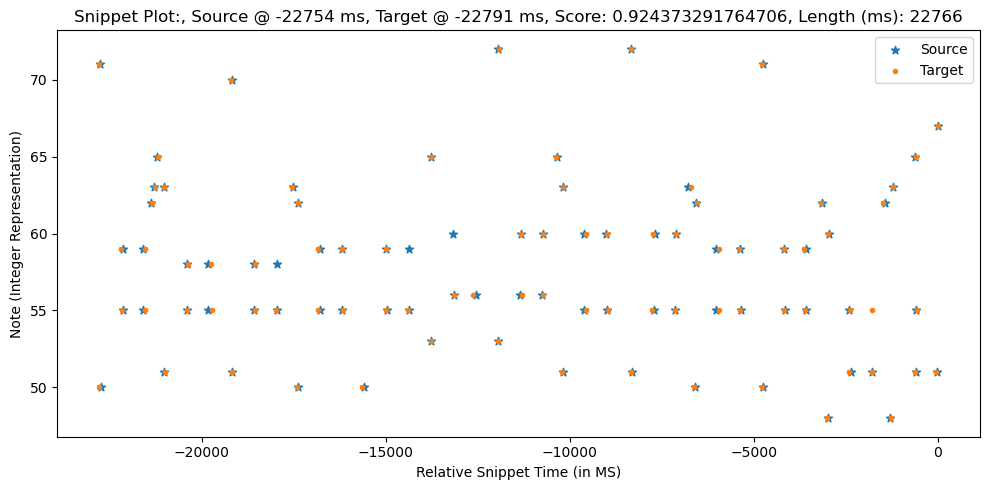

Scores: [ 0.88    0.915   0.8475  0.985   0.8825  0.885   0.915   0.96    0.9075
  0.9975  0.945   0.9925  0.9825  0.8175  0.7375  0.9525  0.96    0.97
  0.94    0.9725  0.9225  0.94    0.96    0.8975  0.9075  0.975   0.94
  0.8675  0.9425  0.9575  0.92    0.985   0.9775  0.94    0.8175  0.945
  0.94    0.9625  0.92    0.925   0.9525  0.925   0.91    0.9975  0.8425
  0.8625  0.9275  0.9275  0.995   0.9825  0.8125  0.8525  0.9575  0.9975
  0.85    0.9425  0.9025  0.81    0.8     0.925   0.9475  0.97    0.975
  0.9675  0.99    0.8975  0.955   0.97    0.9375  0.9225  0.8775  0.9625
  0.96   -0.      0.83    0.935   0.9775  0.9625  0.945   0.9725  0.965
  0.97  ]
Sequence1:  [[-22803     50     42]
 [-22800     71     55]
 [-22216     59     37]
 [-22166     55     39]
 [-21565     55     46]
 [-21550     59     23]
 [-21352     62     43]
 [-21294     63     56]
 [-21189     65     45]
 [-21044     63     49]
 [-21004     51     53]
 [-20405     55     49]
 [-20397     58     34]
 [-19759

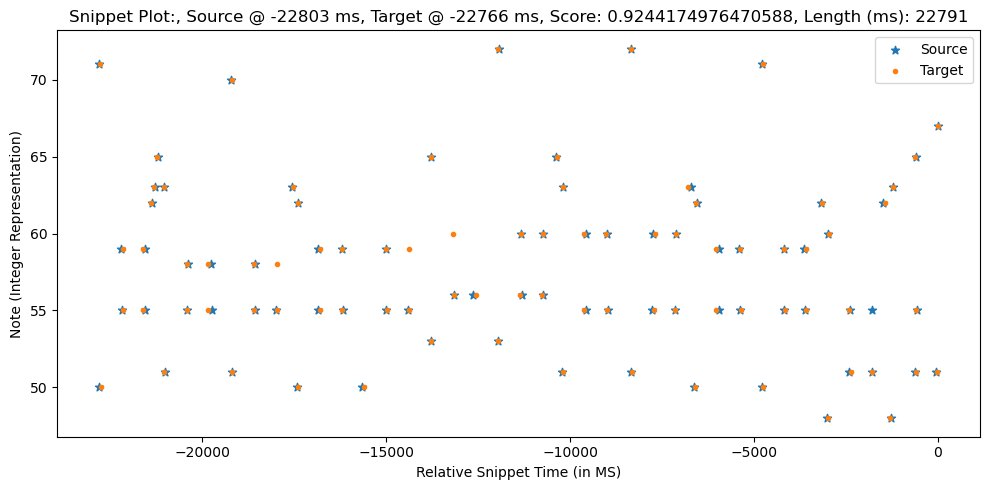

0.9244174976470588
Scores: [ 0.915   0.88    0.985   0.8475  0.8825  0.885   0.915   0.96    0.9075
  0.9975  0.945   0.9825  0.9925  0.7375  0.8175  0.9525  0.96    0.94
  0.97    0.9725 -0.      0.9225  0.94    0.96    0.9075  0.8975  0.975
  0.94    0.8675  0.9575  0.9425 -0.      0.92    0.985   0.9775 -0.
  0.94    0.8175  0.945   0.94    0.92    0.9625  0.925   0.9525  0.925
  0.9975  0.91    0.8425  0.8625  0.9275  0.9275  0.995   0.9825  0.8125
  0.8525  0.9575  0.9975  0.85    0.9425  0.9025  0.81    0.8     0.925
  0.9475  0.97    0.975   0.99    0.9675  0.8975  0.955   0.97    0.9375
  0.9225  0.9625  0.8775  0.96    0.83    0.935   0.9775  0.945   0.9625
  0.9725  0.965   0.97    0.9925  0.9875  0.875   0.82    0.86  ]
Sequence1:  [[-24631     71     55]
 [-24620     50     45]
 [-24025     55     51]
 [-24020     59     34]
 [-23477     55     48]
 [-23461     59     29]
 [-23251     62     49]
 [-23175     63     54]
 [-23091     65     59]
 [-22908     63     54]
 [-2289

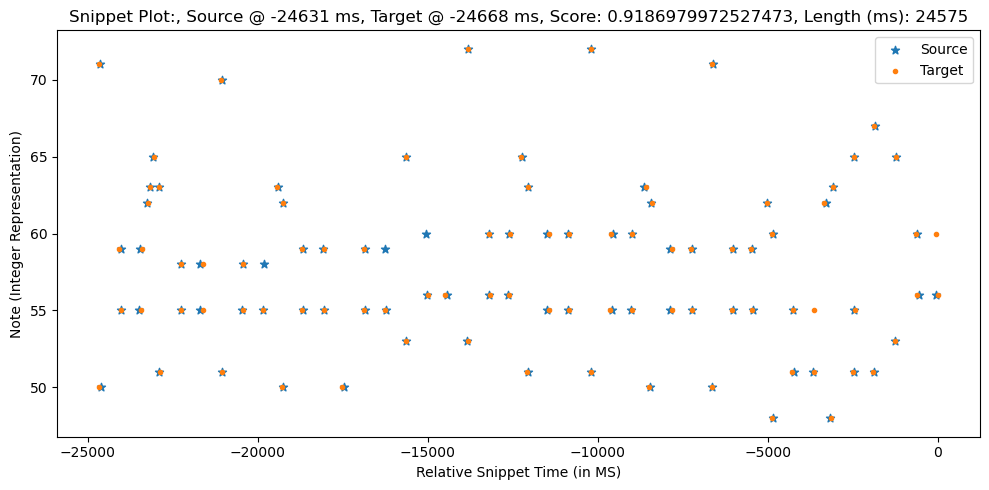

Scores: [ 0.865   0.9     0.8325  0.97    0.8975  0.9     0.93    0.975   0.9225
  0.9825  0.96    0.9775  0.9975  0.8325  0.7525  0.9375  0.945   0.985
  0.955   0.9575  0.9075  0.925   0.945   0.8825  0.8925  0.99    0.955
  0.8525  0.9275  0.9425  0.905   0.97    0.9925  0.955   0.8025  0.96
  0.955   0.9775  0.935   0.94    0.9675  0.91    0.895   0.9875  0.8575
  0.8775  0.9425  0.9425  0.99    0.9675  0.7975  0.8375  0.9725  0.9825
  0.865   0.9275  0.9175  0.825   0.815   0.91    0.9325  0.955   0.96
  0.9525  0.975   0.8825  0.94    0.955   0.9225  0.9075  0.8625  0.9775
  0.975  -0.      0.815   0.95    0.9925  0.9475  0.96    0.9875  0.95
  0.955   0.9775  0.9975  0.86    0.805   0.      0.875 ]
Sequence1:  [[-24618     50     42]
 [-24615     71     55]
 [-24031     59     37]
 [-23981     55     39]
 [-23380     55     46]
 [-23365     59     23]
 [-23167     62     43]
 [-23109     63     56]
 [-23004     65     45]
 [-22859     63     49]
 [-22819     51     53]
 [-22220 

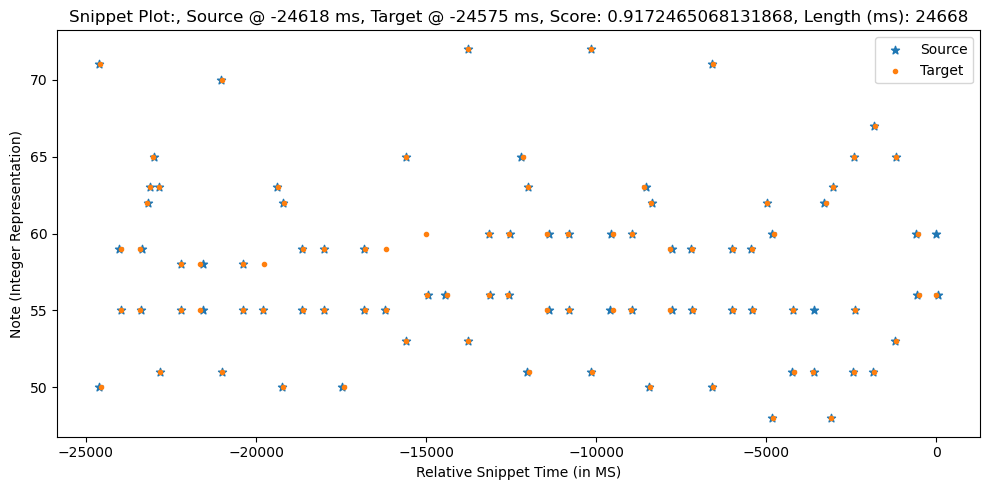

0.9186979972527473
Scores: [ 0.9175  0.8825  0.9875  0.85    0.88    0.8825  0.9125  0.9575  0.905
  1.      0.9425  0.98    0.995   0.735   0.815   0.955   0.9625  0.9375
  0.9675  0.975  -0.      0.925   0.9425  0.9625  0.91    0.9     0.9725
  0.9375  0.87    0.96    0.945  -0.      0.9225  0.9875  0.975  -0.
  0.9375  0.82    0.9425  0.9375  0.9175  0.96    0.9225  0.95    0.9275
  0.995   0.9125  0.84    0.86    0.925   0.925   0.9925  0.985   0.815
  0.855   0.955   1.      0.8475  0.945   0.9     0.8075  0.7975  0.9275
  0.95    0.9725  0.9775  0.9925  0.97    0.9     0.9575  0.9725  0.94
  0.925   0.96    0.88    0.9575  0.8325  0.9325  0.975   0.9425  0.965
  0.97    0.9675  0.9725  0.995   0.985   0.8775  0.8225  0.8575  0.98
  0.9725  0.995   0.925   0.84    0.9925  0.97  ]
Sequence1:  [[-26806     71     55]
 [-26795     50     45]
 [-26200     55     51]
 [-26195     59     34]
 [-25652     55     48]
 [-25636     59     29]
 [-25426     62     49]
 [-25350     63     54]


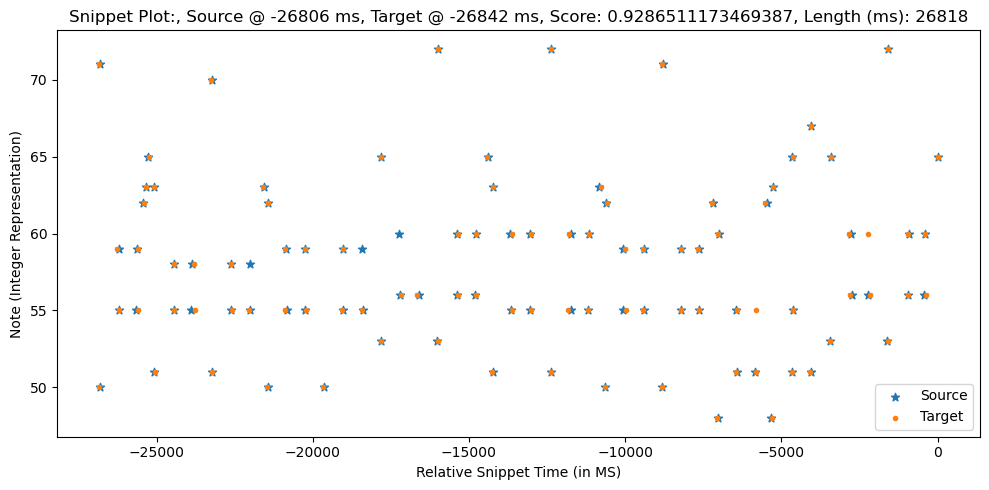

Scores: [ 0.8825  0.9175  0.85    0.9875  0.88    0.8825  0.9125  0.9575  0.905
  1.      0.9425  0.995   0.98    0.815   0.735   0.955   0.9625  0.9675
  0.9375  0.975   0.925   0.9425  0.9625  0.9     0.91    0.9725  0.9375
  0.87    0.945   0.96    0.9225  0.9875  0.975   0.9375  0.82    0.9425
  0.9375  0.96    0.9175  0.9225  0.95    0.9275  0.9125  0.995   0.84
  0.86    0.925   0.925   0.9925  0.985   0.815   0.855   0.955   1.
  0.8475  0.945   0.9     0.8075  0.7975  0.9275  0.95    0.9725  0.9775
  0.97    0.9925  0.9     0.9575  0.9725  0.94    0.925   0.88    0.96
  0.9575 -0.      0.8325  0.9325  0.975   0.965   0.9425  0.97    0.9675
  0.9725  0.995   0.985   0.8775  0.8225 -0.      0.8575  0.9725  0.98
  0.995   0.925   0.9925  0.84    0.97  ]
Sequence1:  [[-26854     50     42]
 [-26851     71     55]
 [-26267     59     37]
 [-26217     55     39]
 [-25616     55     46]
 [-25601     59     23]
 [-25403     62     43]
 [-25345     63     56]
 [-25240     65     45]
 [-

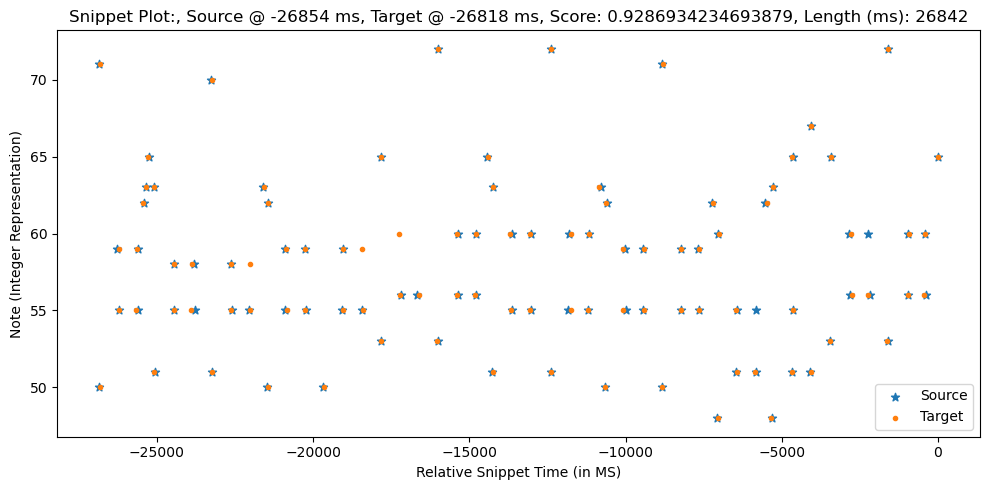

0.9286934234693879
Scores: [ 0.92    0.885   0.99    0.8525  0.8775  0.88    0.91    0.955   0.9025
  0.9975  0.94    0.9775  0.9975  0.7325  0.8125  0.9575  0.965   0.935
  0.965   0.9775 -0.      0.9275  0.945   0.965   0.9125  0.9025  0.97
  0.935   0.8725  0.9625  0.9475 -0.      0.925   0.99    0.9725 -0.
  0.935   0.8225  0.94    0.935   0.915   0.9575  0.92    0.9475  0.93
  0.9925  0.915   0.8375  0.8575  0.9225  0.9225  0.99    0.9875  0.8175
  0.8575  0.9525  0.9975  0.845   0.9475  0.8975  0.805   0.795   0.93
  0.9525  0.975   0.98    0.995   0.9725  0.9025  0.96    0.975   0.9425
  0.9275  0.9575  0.8825  0.955   0.835   0.93    0.9725  0.94    0.9675
  0.9675  0.97    0.975   0.9975  0.9825  0.88    0.825   0.855   0.9775
  0.975   0.9925  0.9275  0.8375  0.995   0.9725  0.965   0.9725  0.99
  0.9075  0.9725  0.835   0.9875  1.    ]
Sequence1:  [[-28791     71     55]
 [-28780     50     45]
 [-28185     55     51]
 [-28180     59     34]
 [-27637     55     48]
 [-27621 

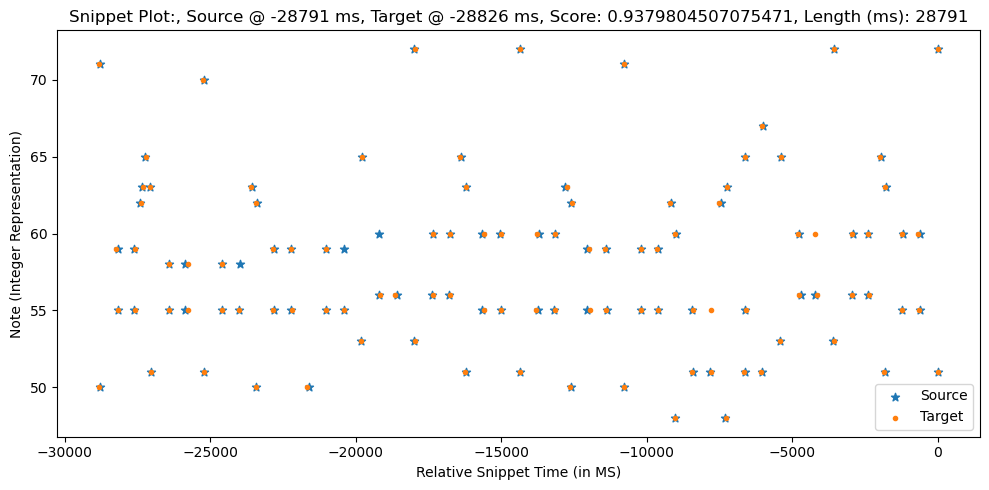

Scores: [ 0.8825  0.9175  0.85    0.9875  0.88    0.8825  0.9125  0.9575  0.905
  1.      0.9425  0.995   0.98    0.815   0.735   0.955   0.9625  0.9675
  0.9375  0.975   0.925   0.9425  0.9625  0.9     0.91    0.9725  0.9375
  0.87    0.945   0.96    0.9225  0.9875  0.975   0.9375  0.82    0.9425
  0.9375  0.96    0.9175  0.9225  0.95    0.9275  0.9125  0.995   0.84
  0.86    0.925   0.925   0.9925  0.985   0.815   0.855   0.955   1.
  0.8475  0.945   0.9     0.8075  0.7975  0.9275  0.95    0.9725  0.9775
  0.97    0.9925  0.9     0.9575  0.9725  0.94    0.925   0.88    0.96
  0.9575 -0.      0.8325  0.9325  0.975   0.965   0.9425  0.97    0.9675
  0.9725  0.995   0.985   0.8775  0.8225 -0.      0.8575  0.9725  0.98
  0.995   0.925   0.9925  0.84    0.97    0.9625  0.97    0.905   0.9925
  0.8325  0.97    0.9975  0.99  ]
Sequence1:  [[-28825     50     42]
 [-28822     71     55]
 [-28238     59     37]
 [-28188     55     39]
 [-27587     55     46]
 [-27572     59     23]
 [-27374  

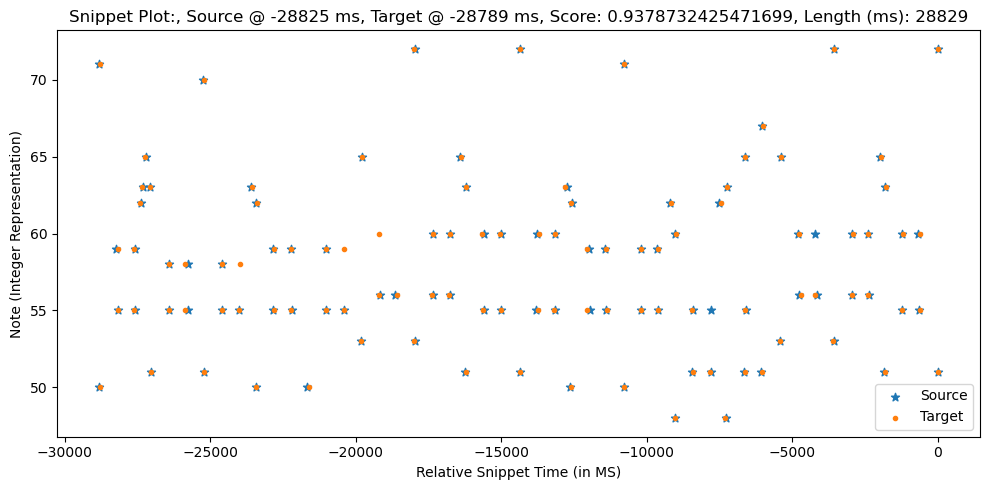

0.9379804507075471
Scores: [ 0.925   0.89    0.995   0.8575  0.8725  0.875   0.905   0.95    0.8975
  0.9925  0.935   0.9725  0.9975  0.7275  0.8075  0.9625  0.97    0.93
  0.96    0.9825 -0.      0.9325  0.95    0.97    0.9175  0.9075  0.965
  0.93    0.8775  0.9675  0.9525 -0.      0.93    0.995   0.9675 -0.
  0.93    0.8275  0.935   0.93    0.91    0.9525  0.915   0.9425  0.935
  0.9875  0.92    0.8325  0.8525  0.9175  0.9175  0.985   0.9925  0.8225
  0.8625  0.9475  0.9925  0.84    0.9525  0.8925  0.8     0.79    0.935
  0.9575  0.98    0.985   1.      0.9775  0.9075  0.965   0.98    0.9475
  0.9325  0.9525  0.8875  0.95    0.84    0.925   0.9675  0.935   0.9725
  0.9625  0.975   0.98    0.9975  0.9775  0.885   0.83    0.85    0.9725
  0.98    0.9875  0.9325  0.8325  1.      0.9775  0.97    0.9775  0.985
  0.9125  0.9775  0.84    0.9825  0.995   0.9325  0.9375 -0.      0.89
  0.895   0.76    0.9025]
Sequence1:  [[-30605     71     55]
 [-30594     50     45]
 [-29999     55     51]

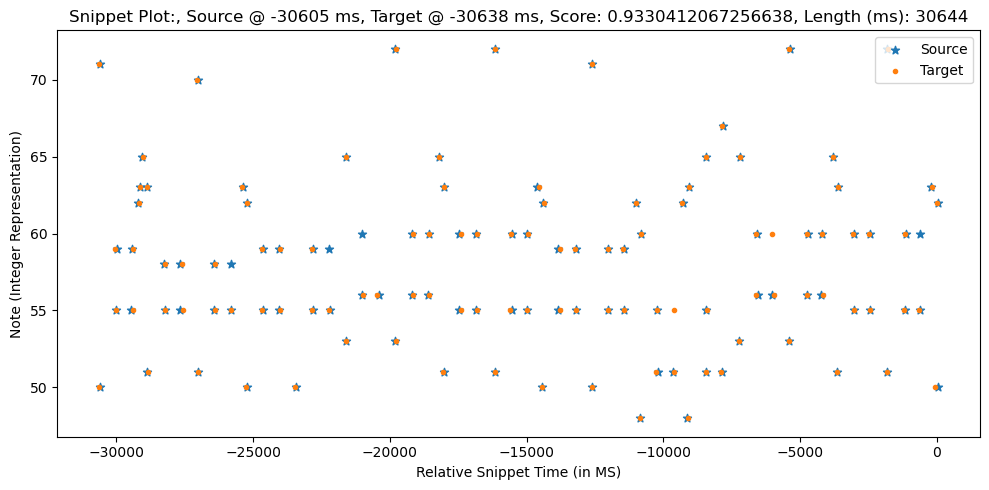

Scores: [ 0.89    0.925   0.8575  0.995   0.8725  0.875   0.905   0.95    0.8975
  0.9925  0.935   0.9975  0.9725  0.8075  0.7275  0.9625  0.97    0.96
  0.93    0.9825  0.9325  0.95    0.97    0.9075  0.9175  0.965   0.93
  0.8775  0.9525  0.9675  0.93    0.995   0.9675  0.93    0.8275  0.935
  0.93    0.9525  0.91    0.915   0.9425  0.935   0.92    0.9875  0.8325
  0.8525  0.9175  0.9175  0.985   0.9925  0.8225  0.8625  0.9475  0.9925
  0.84    0.9525  0.8925  0.8     0.79    0.935   0.9575  0.98    0.985
  0.9775  1.      0.9075  0.965   0.98    0.9475  0.9325  0.8875  0.9525
  0.95   -0.      0.84    0.925   0.9675  0.9725  0.935   0.9625  0.975
  0.98    0.9975  0.9775  0.885   0.83   -0.      0.85    0.98    0.9725
  0.9875  0.9325  1.      0.8325  0.9775  0.97    0.9775  0.9125  0.985
  0.84    0.9775  0.995   0.9825  0.9325  0.9375  0.89    0.895   0.76
  0.9025]
Sequence1:  [[-30677     50     42]
 [-30674     71     55]
 [-30090     59     37]
 [-30040     55     39]
 [-29439

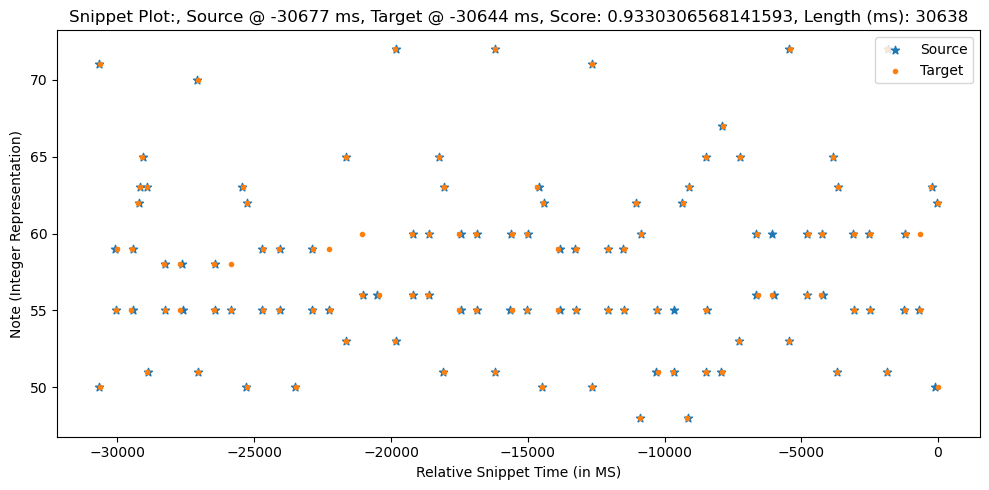

0.9330412067256638
Scores: [ 0.9275  0.8925  0.9975  0.86    0.87    0.8725  0.9025  0.9475  0.895
  0.99    0.9325  0.97    0.995   0.725   0.805   0.965   0.9725  0.9275
  0.9575  0.985  -0.      0.935   0.9525  0.9725  0.92    0.91    0.9625
  0.9275  0.88    0.97    0.955  -0.      0.9325  0.9975  0.965  -0.
  0.9275  0.83    0.9325  0.9275  0.9075  0.95    0.9125  0.94    0.9375
  0.985   0.9225  0.83    0.85    0.915   0.915   0.9825  0.995   0.825
  0.865   0.945   0.99    0.8375  0.955   0.89    0.7975  0.7875  0.9375
  0.96    0.9825  0.9875  0.9975  0.98    0.91    0.9675  0.9825  0.95
  0.935   0.95    0.89    0.9475  0.8425  0.9225  0.965   0.9325  0.975
  0.96    0.9775  0.9825  0.995   0.975   0.8875  0.8325  0.8475  0.97
  0.9825  0.985   0.935   0.83    0.9975  0.98    0.9725  0.98    0.9825
  0.915   0.98    0.8425  0.98    0.9925  0.935   0.94   -0.      0.8925
  0.8925  0.7625  0.905   0.9975  0.97    0.9775  0.93    0.9525  0.9   ]
Sequence1:  [[-32373     71     55

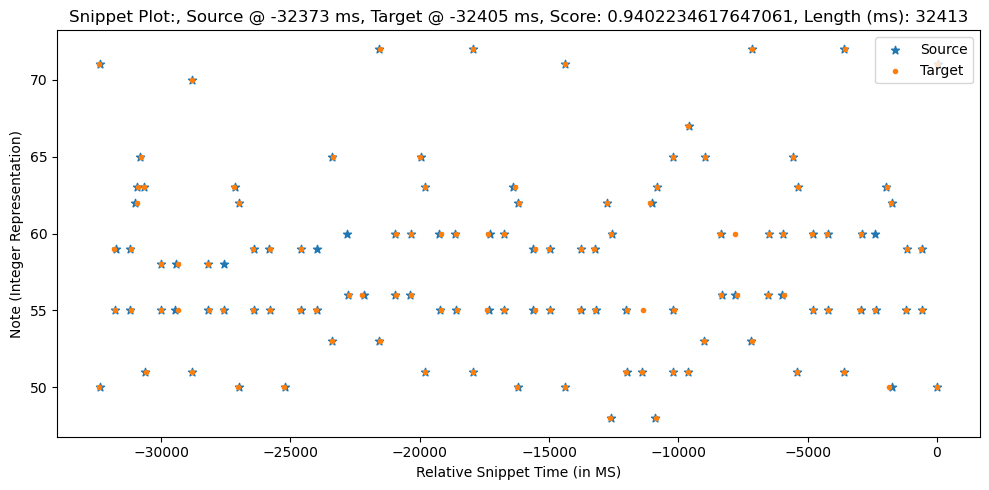

Scores: [ 0.8925  0.9275  0.86    0.9975  0.87    0.8725  0.9025  0.9475  0.895
  0.99    0.9325  0.995   0.97    0.805   0.725   0.965   0.9725  0.9575
  0.9275  0.985   0.935   0.9525  0.9725  0.91    0.92    0.9625  0.9275
  0.88    0.955   0.97    0.9325  0.9975  0.965   0.9275  0.83    0.9325
  0.9275  0.95    0.9075  0.9125  0.94    0.9375  0.9225  0.985   0.83
  0.85    0.915   0.915   0.9825  0.995   0.825   0.865   0.945   0.99
  0.8375  0.955   0.89    0.7975  0.7875  0.9375  0.96    0.9825  0.9875
  0.98    0.9975  0.91    0.9675  0.9825  0.95    0.935   0.89    0.95
  0.9475 -0.      0.8425  0.9225  0.965   0.975   0.9325  0.96    0.9775
  0.9825  0.995   0.975   0.8875  0.8325 -0.      0.8475  0.9825  0.97
  0.985   0.935   0.9975  0.83    0.98    0.9725  0.98    0.915   0.9825
  0.8425  0.98    0.9925  0.98    0.935   0.94    0.8925  0.8925  0.7625
  0.905   0.9975  0.97    0.93    0.9775  0.9525  0.9   ]
Sequence1:  [[-32445     50     42]
 [-32442     71     55]
 [-3185

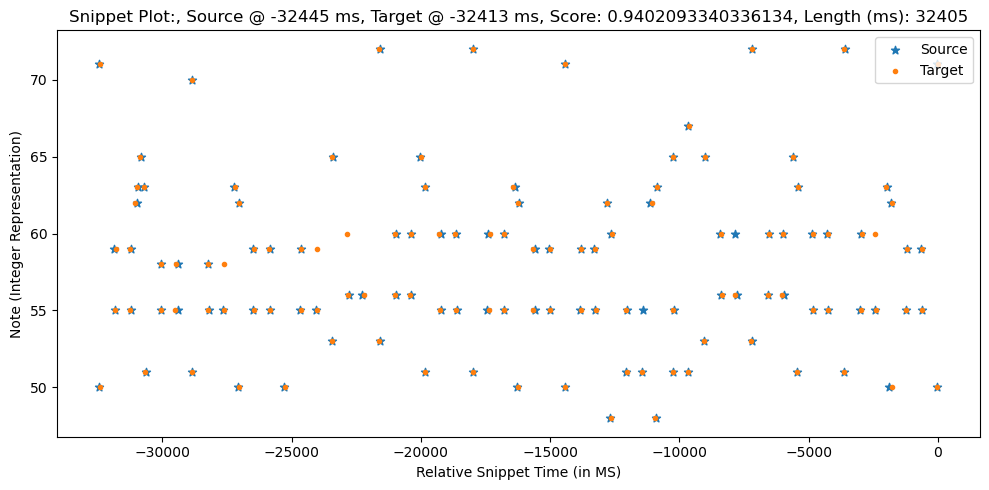

0.9402234617647061
Scores: [ 0.935   0.9     0.995   0.8675  0.8625  0.865   0.895   0.94    0.8875
  0.9825  0.925   0.9625  0.9875  0.7175  0.7975  0.9725  0.98    0.92
  0.95    0.9925 -0.      0.9425  0.96    0.98    0.9275  0.9175  0.955
  0.92    0.8875  0.9775  0.9625 -0.      0.94    0.995   0.9575 -0.
  0.92    0.8375  0.925   0.92    0.9     0.9425  0.905   0.9325  0.945
  0.9775  0.93    0.8225  0.8425  0.9075  0.9075  0.975   0.9975  0.8325
  0.8725  0.9375  0.9825  0.83    0.9625  0.8825  0.79    0.78    0.945
  0.9675  0.99    0.995   0.99    0.9875  0.9175  0.975   0.99    0.9575
  0.9425  0.9425  0.8975  0.94    0.85    0.915   0.9575  0.925   0.9825
  0.9525  0.985   0.99    0.9875  0.9675  0.895   0.84    0.84    0.9625
  0.99    0.9775  0.9425  0.8225  0.99    0.9875  0.98    0.9875  0.975
  0.9225  0.9875  0.85    0.9725  0.985   0.9425  0.9475 -0.      0.9
  0.885   0.77    0.9125  0.99    0.9775  0.985   0.9375  0.96    0.9075
  0.9     0.875   0.89    0.89    0.8

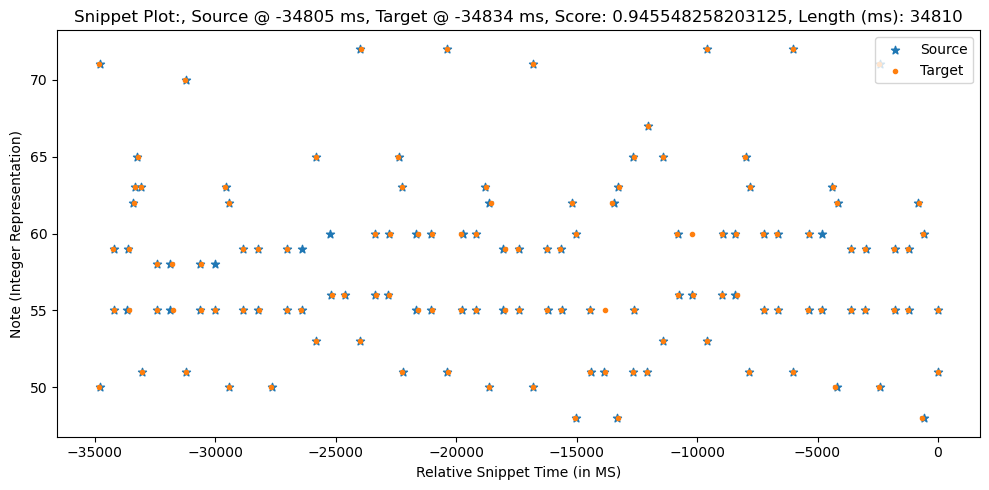

Scores: [ 0.9     0.935   0.8675  0.995   0.8625  0.865   0.895   0.94    0.8875
  0.9825  0.925   0.9875  0.9625  0.7975  0.7175  0.9725  0.98    0.95
  0.92    0.9925  0.9425  0.96    0.98    0.9175  0.9275  0.955   0.92
  0.8875  0.9625  0.9775  0.94    0.995   0.9575  0.92    0.8375  0.925
  0.92    0.9425  0.9     0.905   0.9325  0.945   0.93    0.9775  0.8225
  0.8425  0.9075  0.9075  0.975   0.9975  0.8325  0.8725  0.9375  0.9825
  0.83    0.9625  0.8825  0.79    0.78    0.945   0.9675  0.99    0.995
  0.9875  0.99    0.9175  0.975   0.99    0.9575  0.9425  0.8975  0.9425
  0.94   -0.      0.85    0.915   0.9575  0.9825  0.925   0.9525  0.985
  0.99    0.9875  0.9675  0.895   0.84   -0.      0.84    0.99    0.9625
  0.9775  0.9425  0.99    0.8225  0.9875  0.98    0.9875  0.9225  0.975
  0.85    0.9875  0.985   0.9725  0.9425  0.9475  0.9     0.885   0.77
  0.9125  0.99    0.9775  0.9375  0.985   0.96    0.9075  0.9     0.875
  0.89    0.89    0.8625  0.79    0.9     0.97    0.98

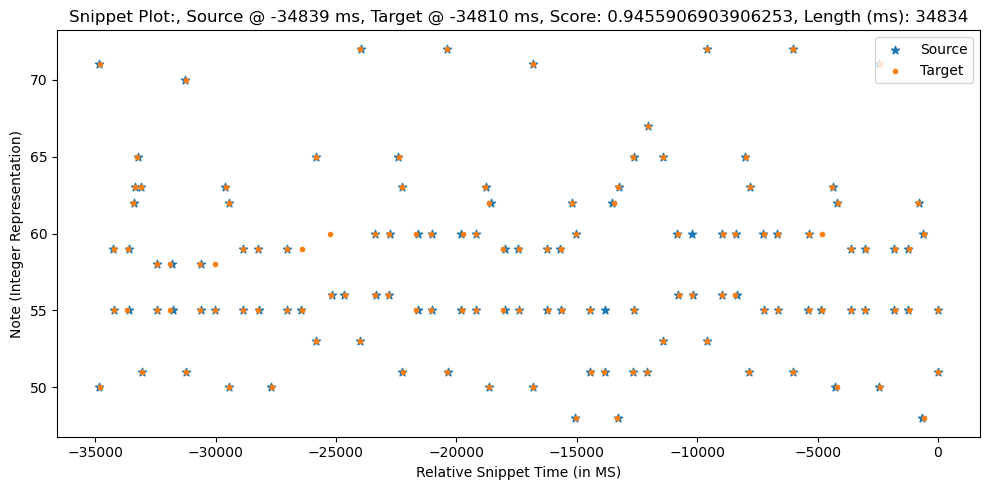

0.9455906903906253
Scores: [ 0.935   0.9     0.995   0.8675  0.8625  0.865   0.895   0.94    0.8875
  0.9825  0.925   0.9625  0.9875  0.7175  0.7975  0.9725  0.98    0.92
  0.95    0.9925 -0.      0.9425  0.96    0.98    0.9275  0.9175  0.955
  0.92    0.8875  0.9775  0.9625 -0.      0.94    0.995   0.9575 -0.
  0.92    0.8375  0.925   0.92    0.9     0.9425  0.905   0.9325  0.945
  0.9775  0.93    0.8225  0.8425  0.9075  0.9075  0.975   0.9975  0.8325
  0.8725  0.9375  0.9825  0.83    0.9625  0.8825  0.79    0.78    0.945
  0.9675  0.99    0.995   0.99    0.9875  0.9175  0.975   0.99    0.9575
  0.9425  0.9425  0.8975  0.94    0.85    0.915   0.9575  0.925   0.9825
  0.9525  0.985   0.99    0.9875  0.9675  0.895   0.84    0.84    0.9625
  0.99    0.9775  0.9425  0.8225  0.99    0.9875  0.98    0.9875  0.975
  0.9225  0.9875  0.85    0.9725  0.985   0.9425  0.9475 -0.      0.9
  0.885   0.77    0.9125  0.99    0.9775  0.985   0.9375  0.96    0.9075
  0.9     0.875   0.89    0.89    0.8

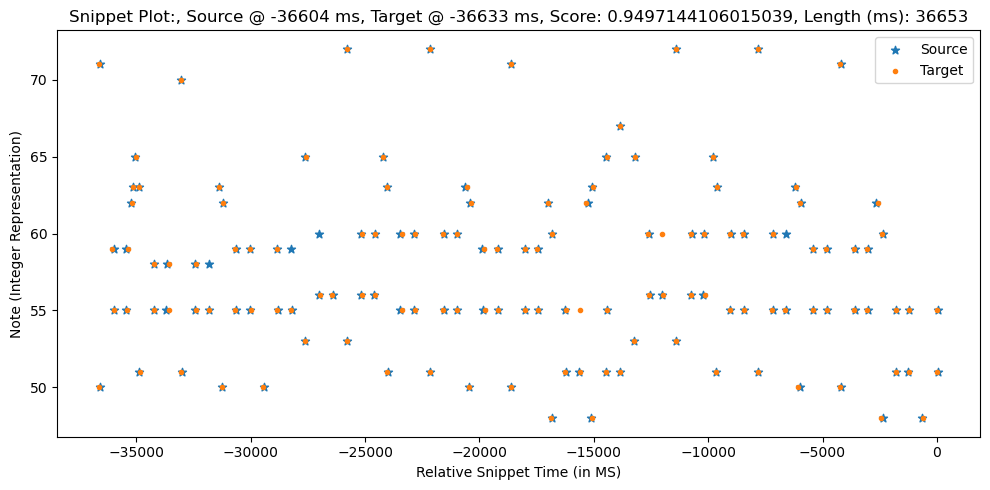

Scores: [ 0.9     0.935   0.8675  0.995   0.8625  0.865   0.895   0.94    0.8875
  0.9825  0.925   0.9875  0.9625  0.7975  0.7175  0.9725  0.98    0.95
  0.92    0.9925  0.9425  0.96    0.98    0.9175  0.9275  0.955   0.92
  0.8875  0.9625  0.9775  0.94    0.995   0.9575  0.92    0.8375  0.925
  0.92    0.9425  0.9     0.905   0.9325  0.945   0.93    0.9775  0.8225
  0.8425  0.9075  0.9075  0.975   0.9975  0.8325  0.8725  0.9375  0.9825
  0.83    0.9625  0.8825  0.79    0.78    0.945   0.9675  0.99    0.995
  0.9875  0.99    0.9175  0.975   0.99    0.9575  0.9425  0.8975  0.9425
  0.94   -0.      0.85    0.915   0.9575  0.9825  0.925   0.9525  0.985
  0.99    0.9875  0.9675  0.895   0.84   -0.      0.84    0.99    0.9625
  0.9775  0.9425  0.99    0.8225  0.9875  0.98    0.9875  0.9225  0.975
  0.85    0.9875  0.985   0.9725  0.9425  0.9475  0.9     0.885   0.77
  0.9125  0.99    0.9775  0.9375  0.985   0.96    0.9075  0.9     0.875
  0.89    0.89    0.8625  0.79    0.9     0.97    0.98

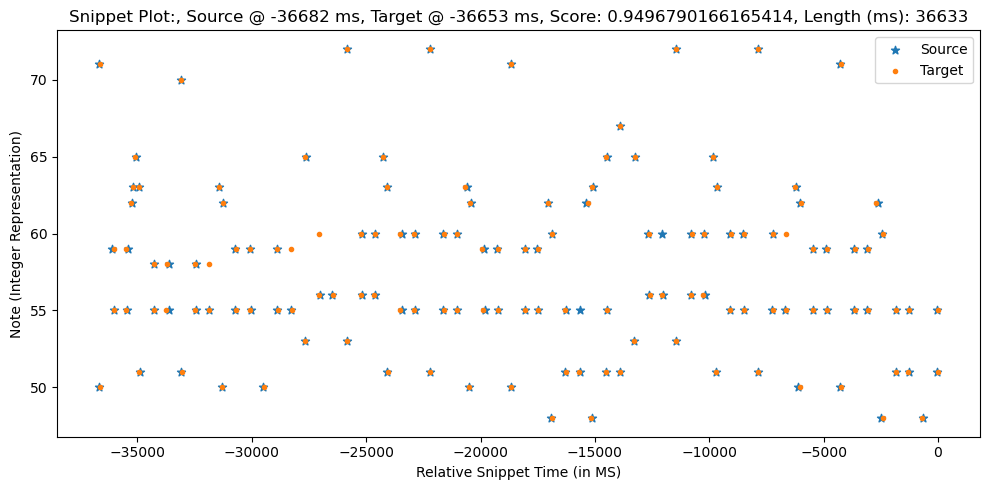

0.9497144106015039
Scores: [ 0.9375  0.9025  0.9925  0.87    0.86    0.8625  0.8925  0.9375  0.885
  0.98    0.9225  0.96    0.985   0.715   0.795   0.975   0.9825  0.9175
  0.9475  0.995  -0.      0.945   0.9625  0.9825  0.93    0.92    0.9525
  0.9175  0.89    0.98    0.965  -0.      0.9425  0.9925  0.955  -0.
  0.9175  0.84    0.9225  0.9175  0.8975  0.94    0.9025  0.93    0.9475
  0.975   0.9325  0.82    0.84    0.905   0.905   0.9725  0.995   0.835
  0.875   0.935   0.98    0.8275  0.965   0.88    0.7875  0.7775  0.9475
  0.97    0.9925  0.9975  0.9875  0.99    0.92    0.9775  0.9925  0.96
  0.945   0.94    0.9     0.9375  0.8525  0.9125  0.955   0.9225  0.985
  0.95    0.9875  0.9925  0.985   0.965   0.8975  0.8425  0.8375  0.96
  0.9925  0.975   0.945   0.82    0.9875  0.99    0.9825  0.99    0.9725
  0.925   0.99    0.8525  0.97    0.9825  0.945   0.95   -0.      0.9025
  0.8825  0.7725  0.915   0.9875  0.98    0.9875  0.94    0.9625  0.91
  0.9025  0.8775  0.8925  0.8925  0.8

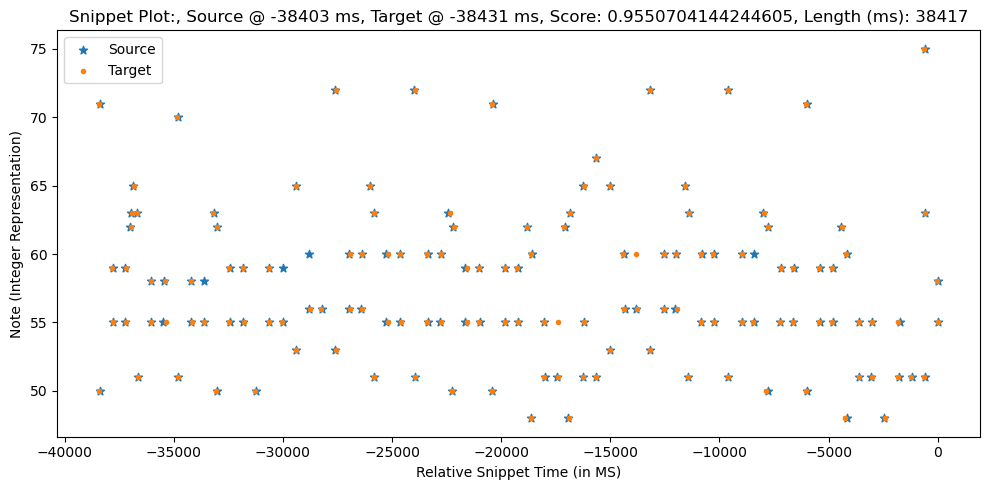

Scores: [ 0.9025  0.9375  0.87    0.9925  0.86    0.8625  0.8925  0.9375  0.885
  0.98    0.9225  0.985   0.96    0.795   0.715   0.975   0.9825  0.9475
  0.9175  0.995   0.945   0.9625  0.9825  0.92    0.93    0.9525  0.9175
  0.89    0.965   0.98    0.9425  0.9925  0.955   0.9175  0.84    0.9225
  0.9175  0.94    0.8975  0.9025  0.93    0.9475  0.9325  0.975   0.82
  0.84    0.905   0.905   0.9725  0.995   0.835   0.875   0.935   0.98
  0.8275  0.965   0.88    0.7875  0.7775  0.9475  0.97    0.9925  0.9975
  0.99    0.9875  0.92    0.9775  0.9925  0.96    0.945   0.9     0.94
  0.9375 -0.      0.8525  0.9125  0.955   0.985   0.9225  0.95    0.9875
  0.9925  0.985   0.965   0.8975  0.8425 -0.      0.8375  0.9925  0.96
  0.975   0.945   0.9875  0.82    0.99    0.9825  0.99    0.925   0.9725
  0.8525  0.99    0.9825  0.97    0.945   0.95    0.9025  0.8825  0.7725
  0.915   0.9875  0.98    0.94    0.9875  0.9625  0.91    0.9025  0.8775
  0.8925  0.8925  0.86    0.7925  0.9025  0.9725  0.

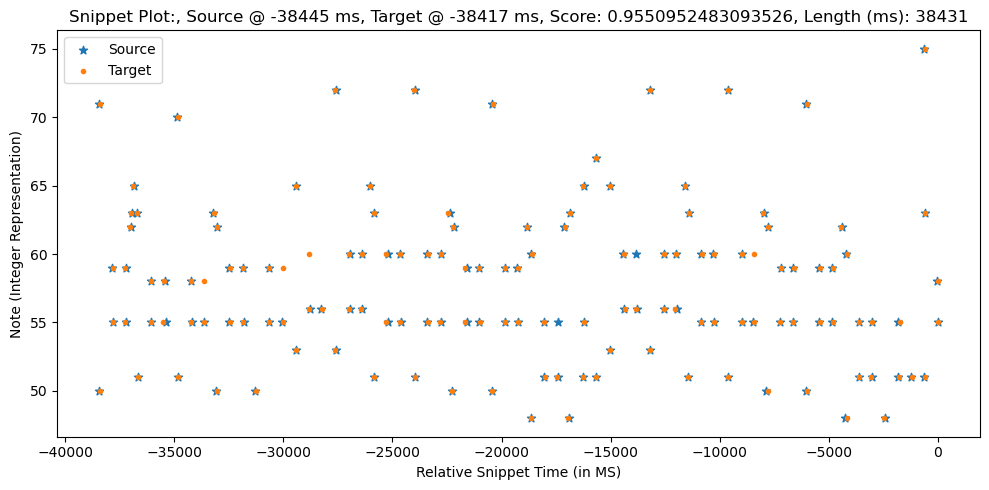

0.9550952483093526
Scores: [ 0.9375  0.9025  0.9925  0.87    0.86    0.8625  0.8925  0.9375  0.885
  0.98    0.9225  0.96    0.985   0.715   0.795   0.975   0.9825  0.9175
  0.9475  0.995  -0.      0.945   0.9625  0.9825  0.93    0.92    0.9525
  0.9175  0.89    0.98    0.965  -0.      0.9425  0.9925  0.955  -0.
  0.9175  0.84    0.9225  0.9175  0.8975  0.94    0.9025  0.93    0.9475
  0.975   0.9325  0.82    0.84    0.905   0.905   0.9725  0.995   0.835
  0.875   0.935   0.98    0.8275  0.965   0.88    0.7875  0.7775  0.9475
  0.97    0.9925  0.9975  0.9875  0.99    0.92    0.9775  0.9925  0.96
  0.945   0.94    0.9     0.9375  0.8525  0.9125  0.955   0.9225  0.985
  0.95    0.9875  0.9925  0.985   0.965   0.8975  0.8425  0.8375  0.96
  0.9925  0.975   0.945   0.82    0.9875  0.99    0.9825  0.99    0.9725
  0.925   0.99    0.8525  0.97    0.9825  0.945   0.95   -0.      0.9025
  0.8825  0.7725  0.915   0.9875  0.98    0.9875  0.94    0.9625  0.91
  0.9025  0.8775  0.8925  0.8925  0.8

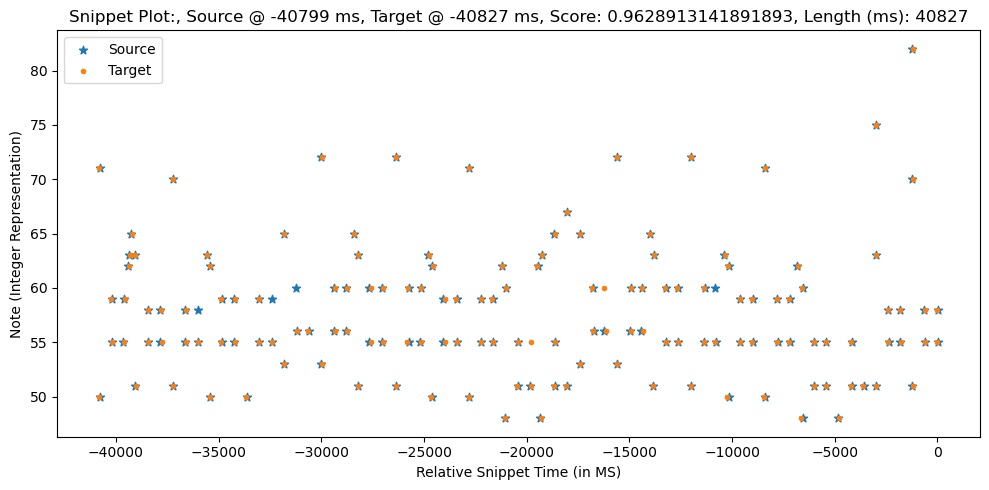

Scores: [ 0.9025  0.9375  0.87    0.9925  0.86    0.8625  0.8925  0.9375  0.885
  0.98    0.9225  0.985   0.96    0.795   0.715   0.975   0.9825  0.9475
  0.9175  0.995   0.945   0.9625  0.9825  0.92    0.93    0.9525  0.9175
  0.89    0.965   0.98    0.9425  0.9925  0.955   0.9175  0.84    0.9225
  0.9175  0.94    0.8975  0.9025  0.93    0.9475  0.9325  0.975   0.82
  0.84    0.905   0.905   0.9725  0.995   0.835   0.875   0.935   0.98
  0.8275  0.965   0.88    0.7875  0.7775  0.9475  0.97    0.9925  0.9975
  0.99    0.9875  0.92    0.9775  0.9925  0.96    0.945   0.9     0.94
  0.9375 -0.      0.8525  0.9125  0.955   0.985   0.9225  0.95    0.9875
  0.9925  0.985   0.965   0.8975  0.8425 -0.      0.8375  0.9925  0.96
  0.975   0.945   0.9875  0.82    0.99    0.9825  0.99    0.925   0.9725
  0.8525  0.99    0.9825  0.97    0.945   0.95    0.9025  0.8825  0.7725
  0.915   0.9875  0.98    0.94    0.9875  0.9625  0.91    0.9025  0.8775
  0.8925  0.8925  0.86    0.7925  0.9025  0.9725  0.

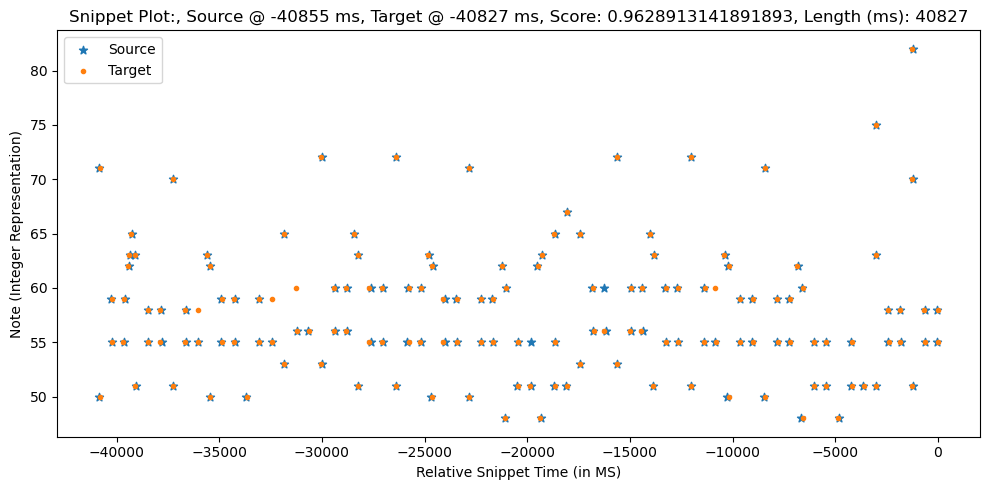

0.9628913141891893
Scores: [ 0.935   0.9     0.995   0.8675  0.8625  0.865   0.895   0.94    0.8875
  0.9825  0.925   0.9625  0.9875  0.7175  0.7975  0.9725  0.98    0.92
  0.95    0.9925 -0.      0.9425  0.96    0.98    0.9275  0.9175  0.955
  0.92    0.8875  0.9775  0.9625 -0.      0.94    0.995   0.9575 -0.
  0.92    0.8375  0.925   0.92    0.9     0.9425  0.905   0.9325  0.945
  0.9775  0.93    0.8225  0.8425  0.9075  0.9075  0.975   0.9975  0.8325
  0.8725  0.9375  0.9825  0.83    0.9625  0.8825  0.79    0.78    0.945
  0.9675  0.99    0.995   0.99    0.9875  0.9175  0.975   0.99    0.9575
  0.9425  0.9425  0.8975  0.94    0.85    0.915   0.9575  0.925   0.9825
  0.9525  0.985   0.99    0.9875  0.9675  0.895   0.84    0.84    0.9625
  0.99    0.9775  0.9425  0.8225  0.99    0.9875  0.98    0.9875  0.975
  0.9225  0.9875  0.85    0.9725  0.985   0.9425  0.9475 -0.      0.9
  0.885   0.77    0.9125  0.99    0.9775  0.985   0.9375  0.96    0.9075
  0.9     0.875   0.89    0.89    0.8

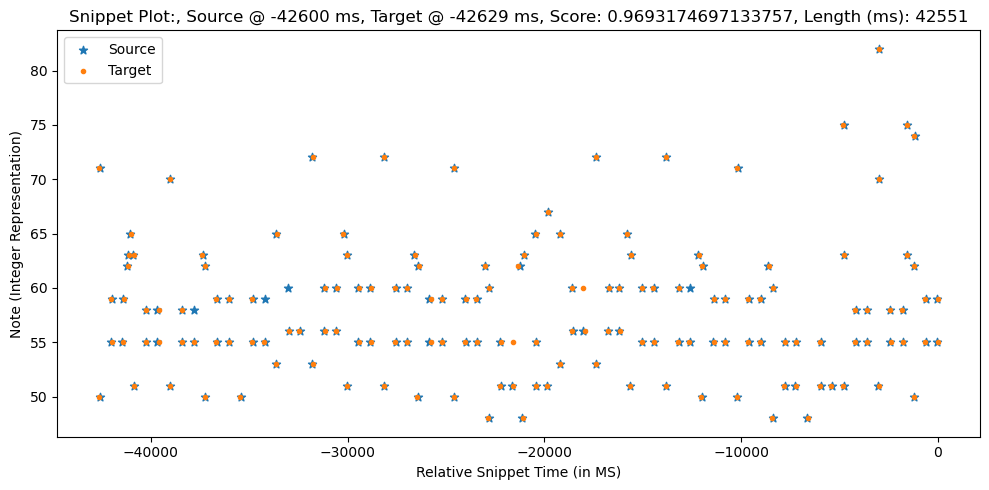

Scores: [ 0.9     0.935   0.8675  0.995   0.8625  0.865   0.895   0.94    0.8875
  0.9825  0.925   0.9875  0.9625  0.7975  0.7175  0.9725  0.98    0.95
  0.92    0.9925  0.9425  0.96    0.98    0.9175  0.9275  0.955   0.92
  0.8875  0.9625  0.9775  0.94    0.995   0.9575  0.92    0.8375  0.925
  0.92    0.9425  0.9     0.905   0.9325  0.945   0.93    0.9775  0.8225
  0.8425  0.9075  0.9075  0.975   0.9975  0.8325  0.8725  0.9375  0.9825
  0.83    0.9625  0.8825  0.79    0.78    0.945   0.9675  0.99    0.995
  0.9875  0.99    0.9175  0.975   0.99    0.9575  0.9425  0.8975  0.9425
  0.94   -0.      0.85    0.915   0.9575  0.9825  0.925   0.9525  0.985
  0.99    0.9875  0.9675  0.895   0.84   -0.      0.84    0.99    0.9625
  0.9775  0.9425  0.99    0.8225  0.9875  0.98    0.9875  0.9225  0.975
  0.85    0.9875  0.985   0.9725  0.9425  0.9475  0.9     0.885   0.77
  0.9125  0.99    0.9775  0.9375  0.985   0.96    0.9075  0.9     0.875
  0.89    0.89    0.8625  0.79    0.9     0.97    0.98

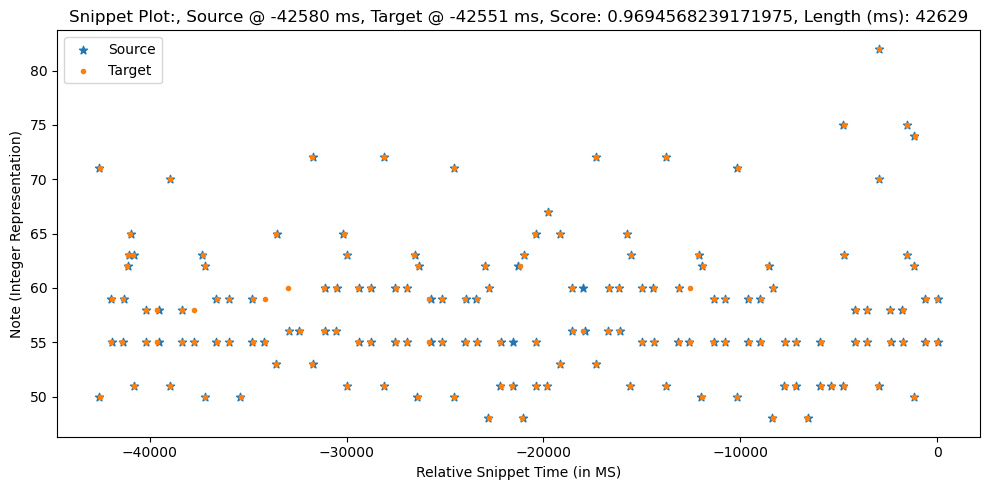

0.9694568239171975
Scores: [-0.     -0.     -0.     -0.     -0.     -0.     -0.     -0.     -0.
 -0.     -0.     -0.     -0.     -0.     -0.     -0.     -0.      0.465
 -0.      0.45   -0.      0.6375 -0.     -0.     -0.      0.405  -0.
  0.5675 -0.     -0.      0.4875 -0.      0.3625 -0.     -0.     -0.
 -0.     -0.     -0.     -0.     -0.     -0.     -0.     -0.      0.88
 -0.     -0.     -0.     -0.     -0.     -0.      0.41   -0.     -0.
  0.35   -0.      0.43    0.8825 -0.     -0.     -0.      0.5625 -0.
  0.37   -0.     -0.     -0.      0.3875 -0.      0.5425  0.9625 -0.
 -0.      0.5825 -0.     -0.     -0.     -0.     -0.     -0.     -0.
  0.44   -0.     -0.     -0.     -0.     -0.     -0.     -0.     -0.
 -0.     -0.     -0.     -0.     -0.      0.8725 -0.     -0.     -0.
  0.395  -0.      0.4275  0.4525 -0.     -0.      0.405   0.435  -0.
  0.885  -0.     -0.      0.37   -0.      0.3125 -0.     -0.     -0.
 -0.      0.3775 -0.      0.27    0.975  -0.     -0.     -0.      0.352

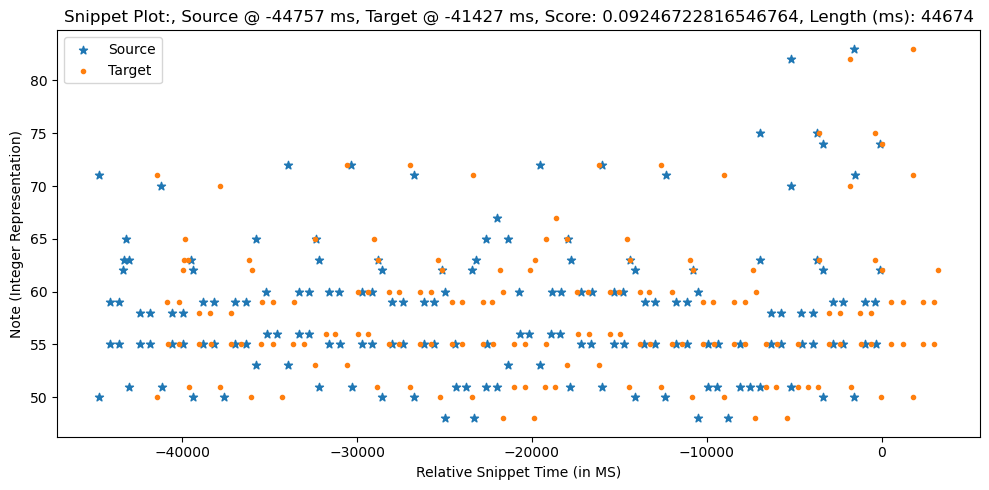

Scores: [ 0.905   0.94    0.8725  0.99    0.8575  0.86    0.89    0.935   0.8825
  0.9775  0.92    0.9825  0.9575  0.7925  0.7125  0.9775  0.985   0.945
  0.915   0.9975  0.9475  0.965   0.985   0.9225  0.9325  0.95    0.915
  0.8925  0.9675  0.9825  0.945   0.99    0.9525  0.915   0.8425  0.92
  0.915   0.9375  0.895   0.9     0.9275  0.95    0.935   0.9725  0.8175
  0.8375  0.9025  0.9025  0.97    0.9925  0.8375  0.8775  0.9325  0.9775
  0.825   0.9675  0.8775  0.785   0.775   0.95    0.9725  0.995   1.
  0.9925  0.985   0.9225  0.98    0.995   0.9625  0.9475  0.9025  0.9375
  0.935  -0.      0.855   0.91    0.9525  0.9875  0.92    0.9475  0.99
  0.995   0.9825  0.9625  0.9     0.845  -0.      0.835   0.995   0.9575
  0.9725  0.9475  0.985   0.8175  0.9925  0.985   0.9925  0.9275  0.97
  0.855   0.9925  0.98    0.9675  0.9475  0.9525  0.905   0.88    0.775
  0.9175  0.985   0.9825  0.9425  0.99    0.965   0.9125  0.905   0.88
  0.895   0.895   0.8575  0.795   0.905   0.975   0.9925  

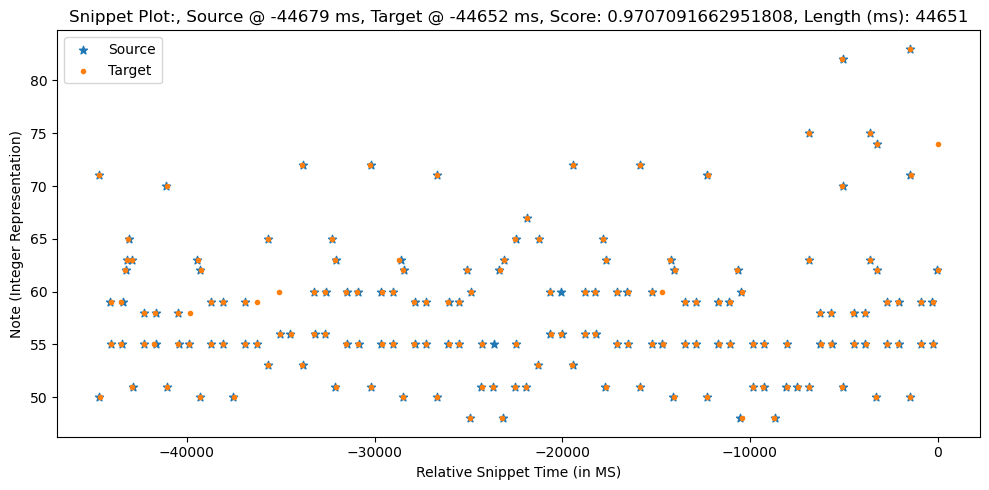

0.9707091662951808
Scores: [ 0.94    0.905   0.99    0.8725  0.8575  0.86    0.89    0.935   0.8825
  0.9775  0.92    0.9575  0.9825  0.7125  0.7925  0.9775  0.985   0.915
  0.945   0.9975 -0.      0.9475  0.965   0.985   0.9325  0.9225  0.95
  0.915   0.8925  0.9825  0.9675 -0.      0.945   0.99    0.9525 -0.
  0.915   0.8425  0.92    0.915   0.895   0.9375  0.9     0.9275  0.95
  0.9725  0.935   0.8175  0.8375  0.9025  0.9025  0.97    0.9925  0.8375
  0.8775  0.9325  0.9775  0.825   0.9675  0.8775  0.785   0.775   0.95
  0.9725  0.995   1.      0.985   0.9925  0.9225  0.98    0.995   0.9625
  0.9475  0.9375  0.9025  0.935   0.855   0.91    0.9525  0.92    0.9875
  0.9475  0.99    0.995   0.9825  0.9625  0.9     0.845   0.835   0.9575
  0.995   0.9725  0.9475  0.8175  0.985   0.9925  0.985   0.9925  0.97
  0.9275  0.9925  0.855   0.9675  0.98    0.9475  0.9525 -0.      0.905
  0.88    0.775   0.9175  0.985   0.9825  0.99    0.9425  0.965   0.9125
  0.905   0.88    0.895   0.895   0.85

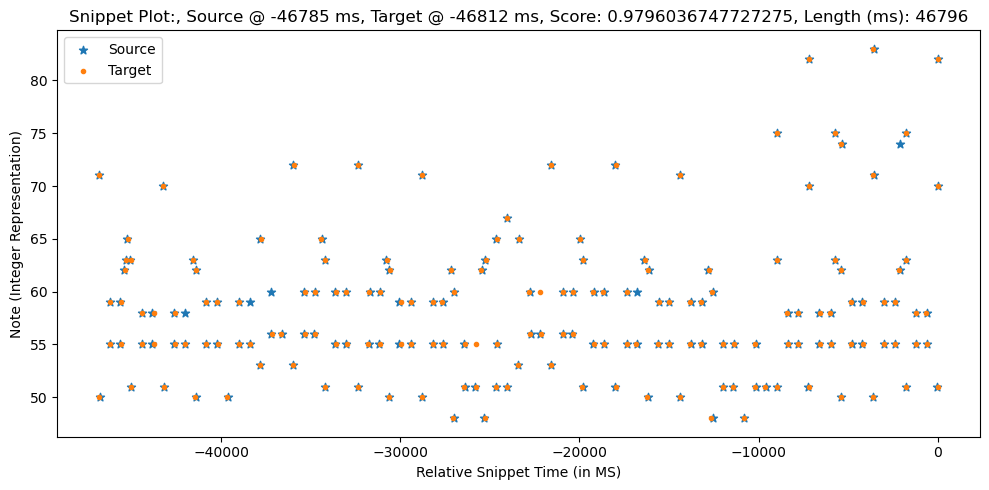

Scores: [ 0.905   0.94    0.8725  0.99    0.8575  0.86    0.89    0.935   0.8825
  0.9775  0.92    0.9825  0.9575  0.7925  0.7125  0.9775  0.985   0.945
  0.915   0.9975  0.9475  0.965   0.985   0.9225  0.9325  0.95    0.915
  0.8925  0.9675  0.9825  0.945   0.99    0.9525  0.915   0.8425  0.92
  0.915   0.9375  0.895   0.9     0.9275  0.95    0.935   0.9725  0.8175
  0.8375  0.9025  0.9025  0.97    0.9925  0.8375  0.8775  0.9325  0.9775
  0.825   0.9675  0.8775  0.785   0.775   0.95    0.9725  0.995   1.
  0.9925  0.985   0.9225  0.98    0.995   0.9625  0.9475  0.9025  0.9375
  0.935  -0.      0.855   0.91    0.9525  0.9875  0.92    0.9475  0.99
  0.995   0.9825  0.9625  0.9     0.845  -0.      0.835   0.995   0.9575
  0.9725  0.9475  0.985   0.8175  0.9925  0.985   0.9925  0.9275  0.97
  0.855   0.9925  0.98    0.9675  0.9475  0.9525  0.905   0.88    0.775
  0.9175  0.985   0.9825  0.9425  0.99    0.965   0.9125  0.905   0.88
  0.895   0.895   0.8575  0.795   0.905   0.975   0.9925  

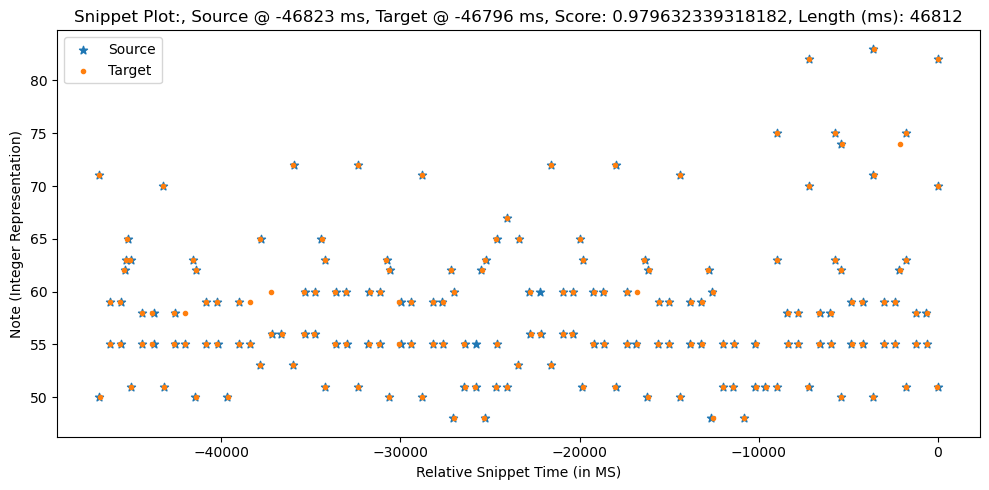

0.979632339318182
Scores: [ 0.9425  0.9075  0.9875  0.875   0.855   0.8575  0.8875  0.9325  0.88
  0.975   0.9175  0.955   0.98    0.71    0.79    0.98    0.9875  0.9125
  0.9425  1.     -0.      0.95    0.9675  0.9875  0.935   0.925   0.9475
  0.9125  0.895   0.985   0.97   -0.      0.9475  0.9875  0.95   -0.
  0.9125  0.845   0.9175  0.9125  0.8925  0.935   0.8975  0.925   0.9525
  0.97    0.9375  0.815   0.835   0.9     0.9     0.9675  0.99    0.84
  0.88    0.93    0.975   0.8225  0.97    0.875   0.7825  0.7725  0.9525
  0.975   0.9975  0.9975  0.9825  0.995   0.925   0.9825  0.9975  0.965
  0.95    0.935   0.905   0.9325  0.8575  0.9075  0.95    0.9175  0.99
  0.945   0.9925  0.9975  0.98    0.96    0.9025  0.8475  0.8325  0.955
  0.9975  0.97    0.95    0.815   0.9825  0.995   0.9875  0.995   0.9675
  0.93    0.995   0.8575  0.965   0.9775  0.95    0.955  -0.      0.9075
  0.8775  0.7775  0.92    0.9825  0.985   0.9925  0.945   0.9675  0.915
  0.9075  0.8825  0.8975  0.8975  0.85

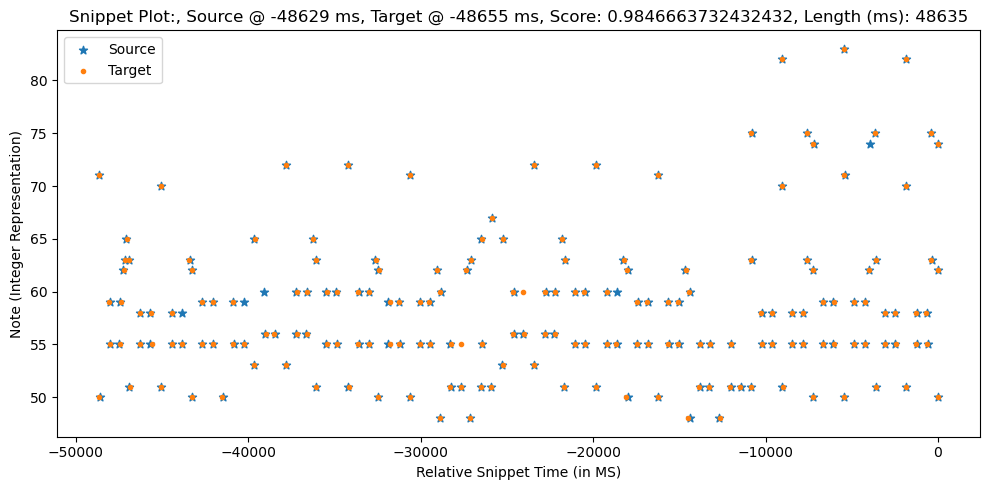

Scores: [ 0.9075  0.9425  0.875   0.9875  0.855   0.8575  0.8875  0.9325  0.88
  0.975   0.9175  0.98    0.955   0.79    0.71    0.98    0.9875  0.9425
  0.9125  1.      0.95    0.9675  0.9875  0.925   0.935   0.9475  0.9125
  0.895   0.97    0.985   0.9475  0.9875  0.95    0.9125  0.845   0.9175
  0.9125  0.935   0.8925  0.8975  0.925   0.9525  0.9375  0.97    0.815
  0.835   0.9     0.9     0.9675  0.99    0.84    0.88    0.93    0.975
  0.8225  0.97    0.875   0.7825  0.7725  0.9525  0.975   0.9975  0.9975
  0.995   0.9825  0.925   0.9825  0.9975  0.965   0.95    0.905   0.935
  0.9325 -0.      0.8575  0.9075  0.95    0.99    0.9175  0.945   0.9925
  0.9975  0.98    0.96    0.9025  0.8475 -0.      0.8325  0.9975  0.955
  0.97    0.95    0.9825  0.815   0.995   0.9875  0.995   0.93    0.9675
  0.8575  0.995   0.9775  0.965   0.95    0.955   0.9075  0.8775  0.7775
  0.92    0.9825  0.985   0.945   0.9925  0.9675  0.915   0.9075  0.8825
  0.8975  0.8975  0.855   0.7975  0.9075  0.9775 

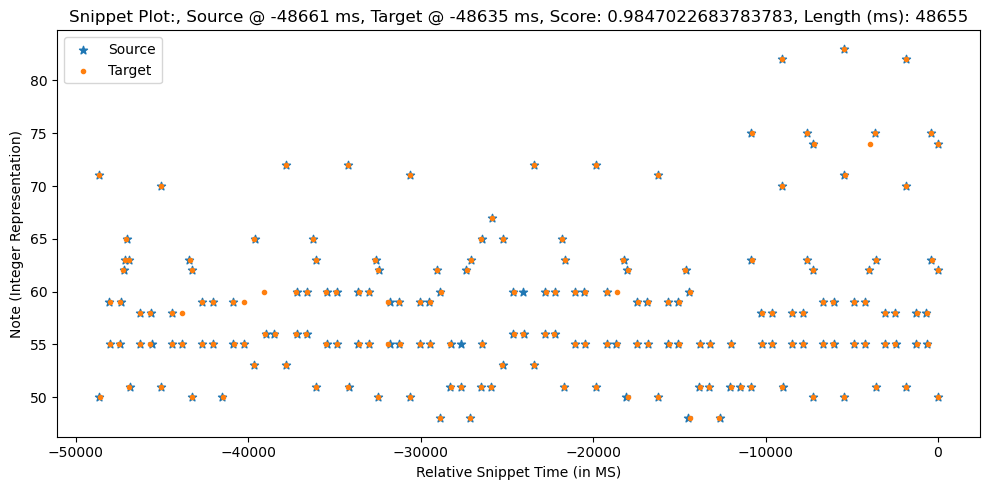

0.9847022683783783
Scores: [0.95   0.8125 0.9175 0.92   0.95   0.995  0.9425 0.9625 0.98   0.9825
 0.9575 0.7725 0.8525 0.9175 0.925  0.975  0.995  0.9375 0.     0.8875]
Sequence1:  [[-4583    55    51]
 [-4578    59    34]
 [-4035    55    48]
 [-4019    59    29]
 [-3809    62    49]
 [-3733    63    54]
 [-3649    65    59]
 [-3466    63    54]
 [-3449    51    53]
 [-2827    58    36]
 [-2825    55    44]
 [-2269    55    49]
 [-2255    58    44]
 [-1618    70    58]
 [-1607    51    46]
 [-1008    55    45]
 [-1005    58    32]
 [ -401    55    48]
 [ -389    58    39]
 [   45    63    52]]
Sequence2:  [[-4653    59    37]
 [-4603    55    39]
 [-4002    55    46]
 [-3987    59    23]
 [-3789    62    43]
 [-3731    63    56]
 [-3626    65    45]
 [-3481    63    49]
 [-3441    51    53]
 [-2842    55    49]
 [-2834    58    34]
 [-2196    58    26]
 [-2178    55    35]
 [-1651    70    53]
 [-1637    51    51]
 [-1007    58    33]
 [ -998    55    42]
 [ -426    55    48]
 [    0

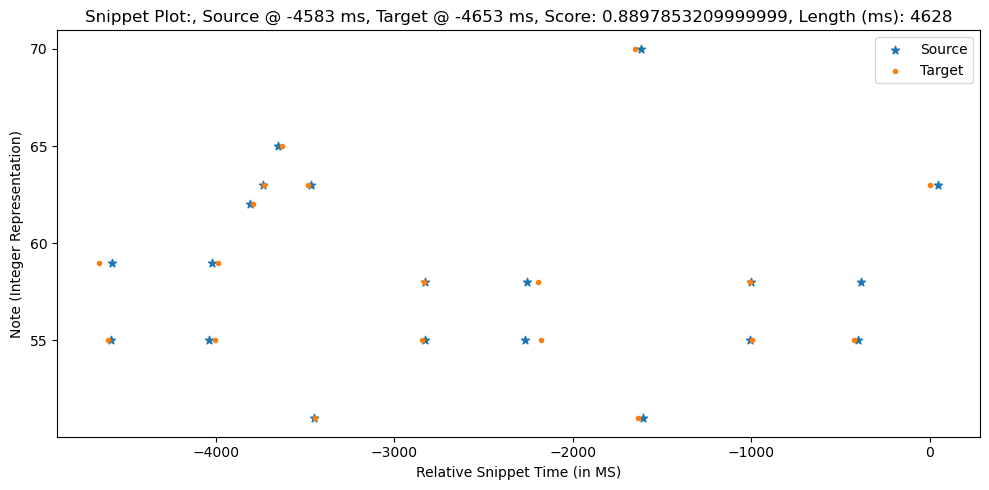

Scores: [0.8125 0.95   0.9175 0.92   0.95   0.995  0.9425 0.9625 0.98   0.9575
 0.9825 0.8525 0.7725 0.9175 0.925  0.995  0.975  0.9375 0.8875]
Sequence1:  [[-4698    59    37]
 [-4648    55    39]
 [-4047    55    46]
 [-4032    59    23]
 [-3834    62    43]
 [-3776    63    56]
 [-3671    65    45]
 [-3526    63    49]
 [-3486    51    53]
 [-2887    55    49]
 [-2879    58    34]
 [-2241    58    26]
 [-2223    55    35]
 [-1696    70    53]
 [-1682    51    51]
 [-1052    58    33]
 [-1043    55    42]
 [ -471    55    48]
 [  -45    63    49]]
Sequence2:  [[-4628    55    51]
 [-4623    59    34]
 [-4080    55    48]
 [-4064    59    29]
 [-3854    62    49]
 [-3778    63    54]
 [-3694    65    59]
 [-3511    63    54]
 [-3494    51    53]
 [-2872    58    36]
 [-2870    55    44]
 [-2314    55    49]
 [-2300    58    44]
 [-1663    70    58]
 [-1652    51    46]
 [-1053    55    45]
 [-1050    58    32]
 [ -446    55    48]
 [ -434    58    39]
 [    0    63    52]]
mean_offset

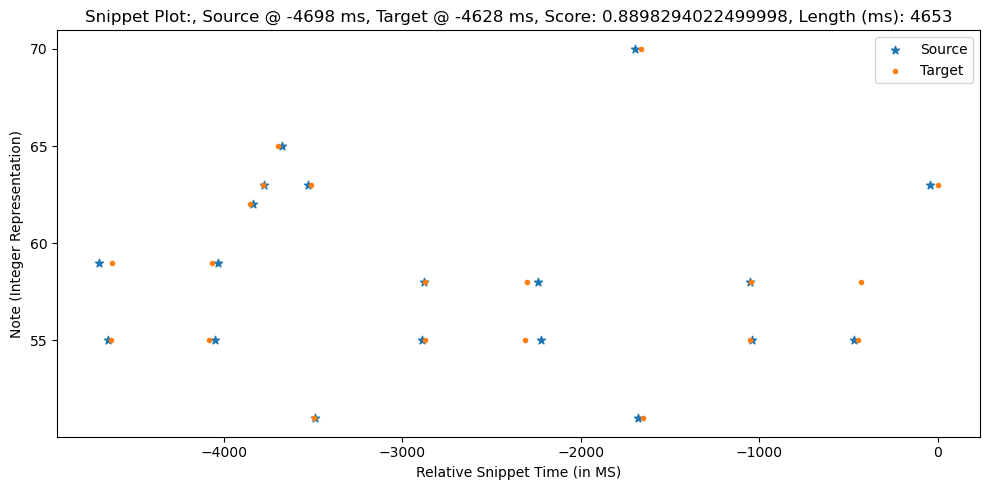

0.8898294022499998
Scores: [ 0.9725  0.835   0.895   0.8975  0.9275  0.9725  0.92    0.985   0.9575
  0.995   0.98    0.75    0.83    0.94    0.9475  0.9525  0.9825  0.96
 -0.      0.91    0.9275  0.9475  0.895   0.885   0.9875  0.9525  0.855 ]
Sequence1:  [[-6510    55    51]
 [-6505    59    34]
 [-5962    55    48]
 [-5946    59    29]
 [-5736    62    49]
 [-5660    63    54]
 [-5576    65    59]
 [-5393    63    54]
 [-5376    51    53]
 [-4754    58    36]
 [-4752    55    44]
 [-4196    55    49]
 [-4182    58    44]
 [-3545    70    58]
 [-3534    51    46]
 [-2935    55    45]
 [-2932    58    32]
 [-2328    55    48]
 [-2316    58    39]
 [-1882    63    52]
 [-1746    50    42]
 [-1734    62    56]
 [-1152    59    46]
 [-1150    55    46]
 [ -557    59    42]
 [ -551    55    48]
 [   58    50    46]]
Sequence2:  [[-6571    59    37]
 [-6521    55    39]
 [-5920    55    46]
 [-5905    59    23]
 [-5707    62    43]
 [-5649    63    56]
 [-5544    65    45]
 [-5399    63   

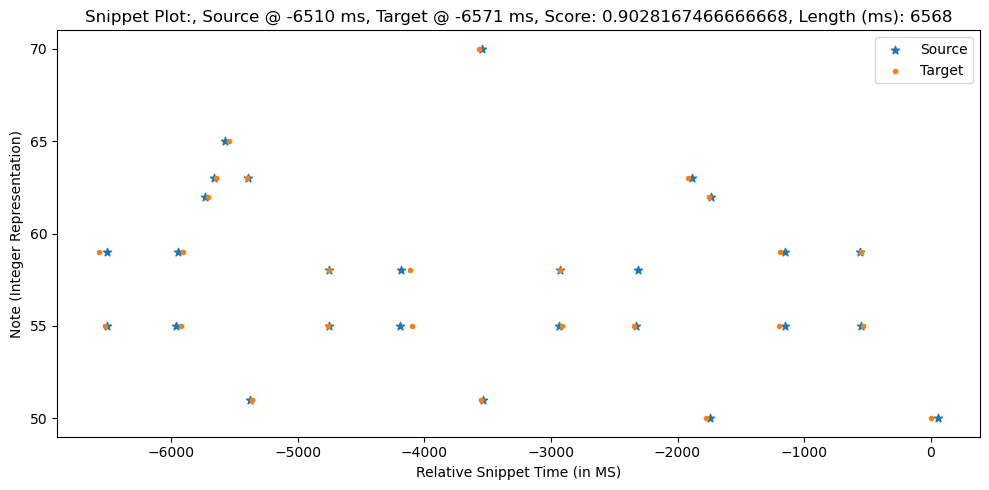

Scores: [0.835  0.9725 0.895  0.8975 0.9275 0.9725 0.92   0.985  0.9575 0.98
 0.995  0.83   0.75   0.94   0.9475 0.9825 0.9525 0.96   0.91   0.9275
 0.9475 0.885  0.895  0.9875 0.9525 0.855 ]
Sequence1:  [[-6629    59    37]
 [-6579    55    39]
 [-5978    55    46]
 [-5963    59    23]
 [-5765    62    43]
 [-5707    63    56]
 [-5602    65    45]
 [-5457    63    49]
 [-5417    51    53]
 [-4818    55    49]
 [-4810    58    34]
 [-4172    58    26]
 [-4154    55    35]
 [-3627    70    53]
 [-3613    51    51]
 [-2983    58    33]
 [-2974    55    42]
 [-2402    55    48]
 [-1976    63    49]
 [-1833    50    44]
 [-1813    62    54]
 [-1254    55    44]
 [-1252    59    42]
 [ -610    59    41]
 [ -590    55    45]
 [  -58    50    51]]
Sequence2:  [[-6568    55    51]
 [-6563    59    34]
 [-6020    55    48]
 [-6004    59    29]
 [-5794    62    49]
 [-5718    63    54]
 [-5634    65    59]
 [-5451    63    54]
 [-5434    51    53]
 [-4812    58    36]
 [-4810    55    44]
 [-425

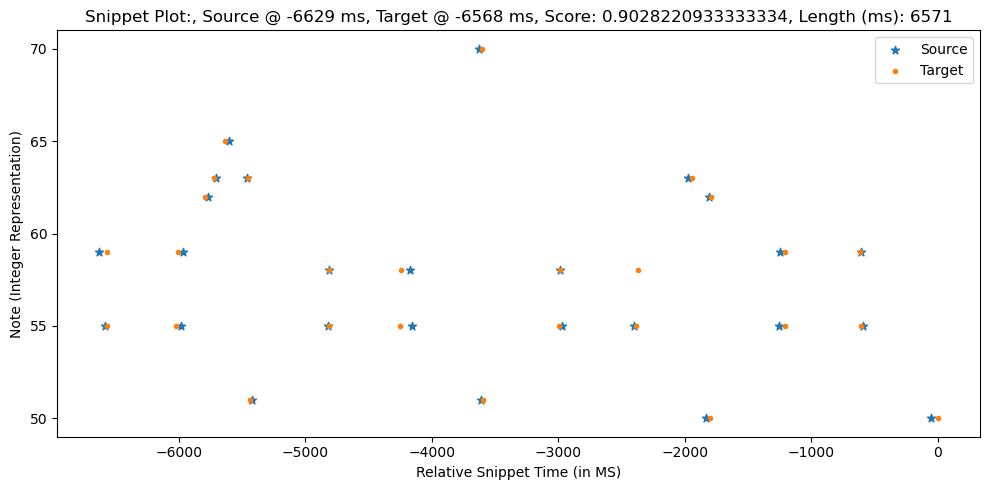

0.9028220933333334
Scores: [ 0.9775  0.84    0.89    0.8925  0.9225  0.9675  0.915   0.99    0.9525
  0.99    0.985   0.745   0.825   0.945   0.9525  0.9475  0.9775  0.965
 -0.      0.915   0.9325  0.9525  0.9     0.89    0.9825  0.9475  0.86
  0.95    0.935  -0.      0.9125  0.9775  0.985 ]
Sequence1:  [[-8385    55    51]
 [-8380    59    34]
 [-7837    55    48]
 [-7821    59    29]
 [-7611    62    49]
 [-7535    63    54]
 [-7451    65    59]
 [-7268    63    54]
 [-7251    51    53]
 [-6629    58    36]
 [-6627    55    44]
 [-6071    55    49]
 [-6057    58    44]
 [-5420    70    58]
 [-5409    51    46]
 [-4810    55    45]
 [-4807    58    32]
 [-4203    55    48]
 [-4191    58    39]
 [-3757    63    52]
 [-3621    50    42]
 [-3609    62    56]
 [-3027    59    46]
 [-3025    55    46]
 [-2432    59    42]
 [-2426    55    48]
 [-1817    50    46]
 [-1216    59    39]
 [-1214    55    44]
 [ -608    59    34]
 [ -592    55    41]
 [   -9    53    47]
 [   -6    65    54]]
S

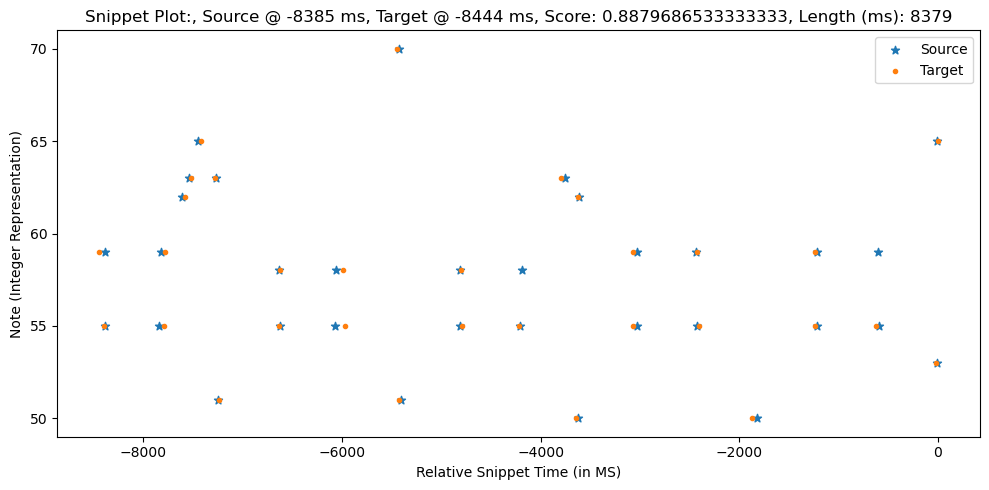

Scores: [0.84   0.9775 0.89   0.8925 0.9225 0.9675 0.915  0.99   0.9525 0.985
 0.99   0.825  0.745  0.945  0.9525 0.9775 0.9475 0.965  0.915  0.9325
 0.9525 0.89   0.9    0.9825 0.9475 0.86   0.935  0.95   0.9125 0.9775
 0.985 ]
Sequence1:  [[-8438    59    37]
 [-8388    55    39]
 [-7787    55    46]
 [-7772    59    23]
 [-7574    62    43]
 [-7516    63    56]
 [-7411    65    45]
 [-7266    63    49]
 [-7226    51    53]
 [-6627    55    49]
 [-6619    58    34]
 [-5981    58    26]
 [-5963    55    35]
 [-5436    70    53]
 [-5422    51    51]
 [-4792    58    33]
 [-4783    55    42]
 [-4211    55    48]
 [-3785    63    49]
 [-3642    50    44]
 [-3622    62    54]
 [-3063    55    44]
 [-3061    59    42]
 [-2419    59    41]
 [-2399    55    45]
 [-1867    50    51]
 [-1234    55    44]
 [-1230    59    40]
 [ -621    55    47]
 [  -12    53    43]
 [    6    65    49]]
Sequence2:  [[-8379    55    51]
 [-8374    59    34]
 [-7831    55    48]
 [-7815    59    29]
 [-7605    

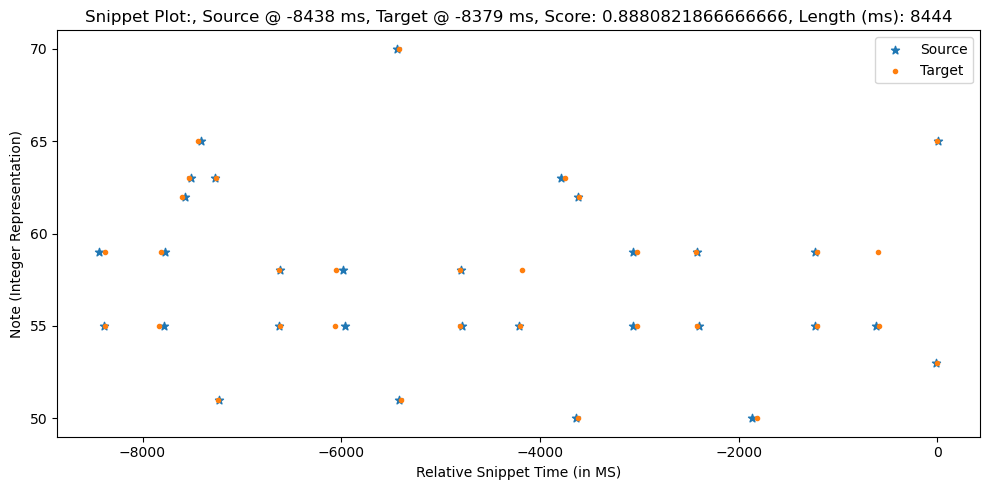

0.8880821866666666
Scores: [ 0.98    0.8425  0.8875  0.89    0.92    0.965   0.9125  0.9925  0.95
  0.9875  0.9875  0.7425  0.8225  0.9475  0.955   0.945   0.975   0.9675
 -0.      0.9175  0.935   0.955   0.9025  0.8925  0.98    0.945   0.8625
  0.9525  0.9375 -0.      0.915   0.98    0.9825 -0.      0.945   0.8125
  0.95    0.945 ]
Sequence1:  [[-10217     55     51]
 [-10212     59     34]
 [ -9669     55     48]
 [ -9653     59     29]
 [ -9443     62     49]
 [ -9367     63     54]
 [ -9283     65     59]
 [ -9100     63     54]
 [ -9083     51     53]
 [ -8461     58     36]
 [ -8459     55     44]
 [ -7903     55     49]
 [ -7889     58     44]
 [ -7252     70     58]
 [ -7241     51     46]
 [ -6642     55     45]
 [ -6639     58     32]
 [ -6035     55     48]
 [ -6023     58     39]
 [ -5589     63     52]
 [ -5453     50     42]
 [ -5441     62     56]
 [ -4859     59     46]
 [ -4857     55     46]
 [ -4264     59     42]
 [ -4258     55     48]
 [ -3649     50     46]
 [ -3

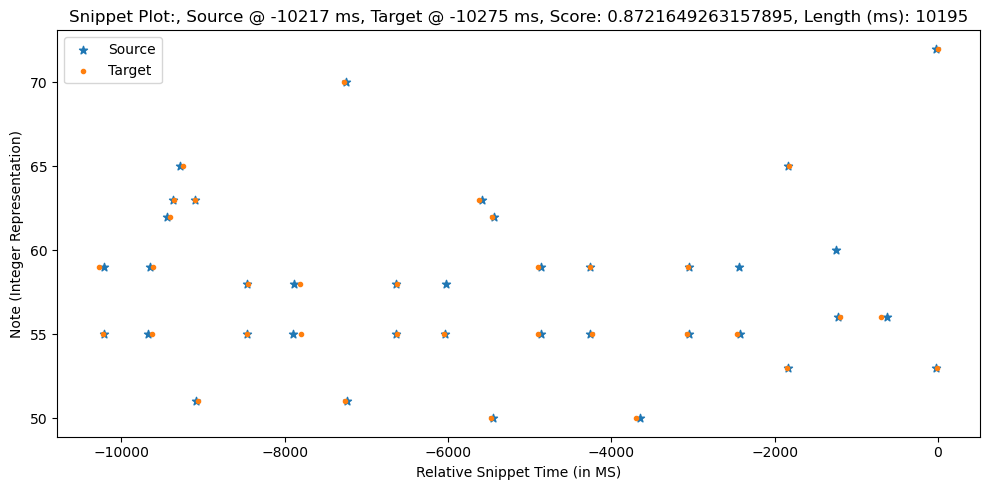

Scores: [0.8425 0.98   0.8875 0.89   0.92   0.965  0.9125 0.9925 0.95   0.9875
 0.9875 0.8225 0.7425 0.9475 0.955  0.975  0.945  0.9675 0.9175 0.935
 0.955  0.8925 0.9025 0.98   0.945  0.8625 0.9375 0.9525 0.915  0.98
 0.9825 0.945  0.8125 0.95   0.945 ]
Sequence1:  [[-10253     59     37]
 [-10203     55     39]
 [ -9602     55     46]
 [ -9587     59     23]
 [ -9389     62     43]
 [ -9331     63     56]
 [ -9226     65     45]
 [ -9081     63     49]
 [ -9041     51     53]
 [ -8442     55     49]
 [ -8434     58     34]
 [ -7796     58     26]
 [ -7778     55     35]
 [ -7251     70     53]
 [ -7237     51     51]
 [ -6607     58     33]
 [ -6598     55     42]
 [ -6026     55     48]
 [ -5600     63     49]
 [ -5457     50     44]
 [ -5437     62     54]
 [ -4878     55     44]
 [ -4876     59     42]
 [ -4234     59     41]
 [ -4214     55     45]
 [ -3682     50     51]
 [ -3049     55     44]
 [ -3045     59     40]
 [ -2436     55     47]
 [ -1827     53     43]
 [ -1809     

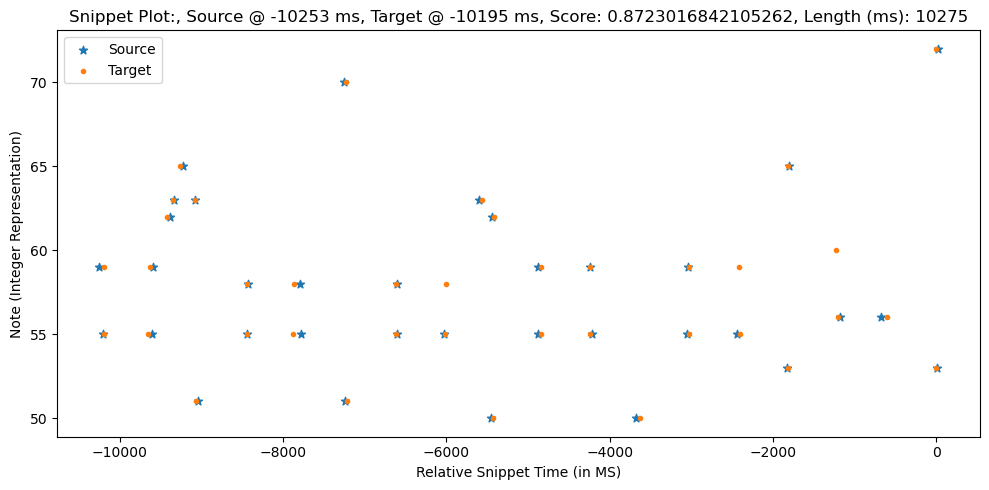

0.8723016842105262
Scores: [ 0.9725  0.835   0.895   0.8975  0.9275  0.9725  0.92    0.985   0.9575
  0.995   0.98    0.75    0.83    0.94    0.9475  0.9525  0.9825  0.96
 -0.      0.91    0.9275  0.9475  0.895   0.885   0.9875  0.9525  0.855
  0.945   0.93   -0.      0.9075  0.9725  0.99   -0.      0.9525  0.805
  0.9575  0.9525  0.9325  0.975   0.9375  0.965   0.9125  0.99    0.8975
  0.855   0.875 ]
Sequence1:  [[-12586     55     51]
 [-12581     59     34]
 [-12038     55     48]
 [-12022     59     29]
 [-11812     62     49]
 [-11736     63     54]
 [-11652     65     59]
 [-11469     63     54]
 [-11452     51     53]
 [-10830     58     36]
 [-10828     55     44]
 [-10272     55     49]
 [-10258     58     44]
 [ -9621     70     58]
 [ -9610     51     46]
 [ -9011     55     45]
 [ -9008     58     32]
 [ -8404     55     48]
 [ -8392     58     39]
 [ -7958     63     52]
 [ -7822     50     42]
 [ -7810     62     56]
 [ -7228     59     46]
 [ -7226     55     46]
 [ -66

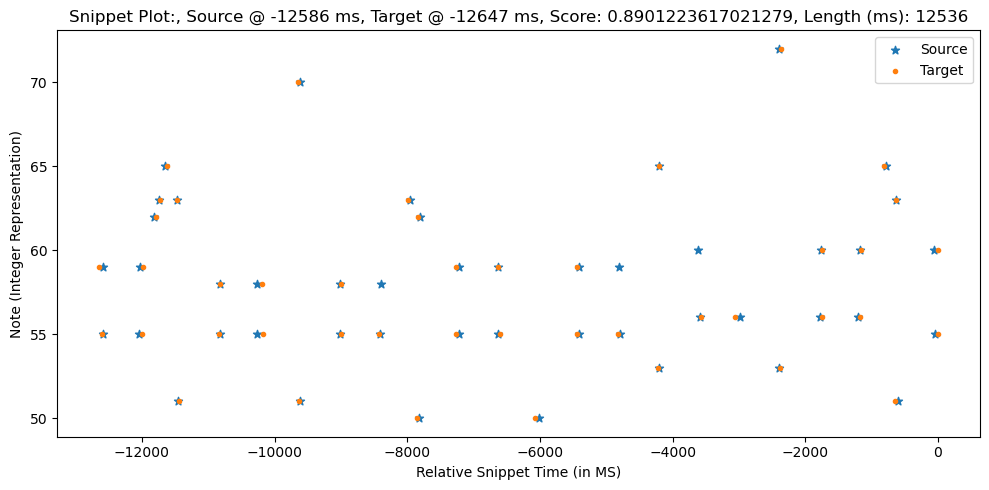

Scores: [0.835  0.9725 0.895  0.8975 0.9275 0.9725 0.92   0.985  0.9575 0.98
 0.995  0.83   0.75   0.94   0.9475 0.9825 0.9525 0.96   0.91   0.9275
 0.9475 0.885  0.895  0.9875 0.9525 0.855  0.93   0.945  0.9075 0.9725
 0.99   0.9525 0.805  0.9575 0.9525 0.975  0.9325 0.9375 0.965  0.9125
 0.8975 0.99   0.855  0.875 ]
Sequence1:  [[-12597     59     37]
 [-12547     55     39]
 [-11946     55     46]
 [-11931     59     23]
 [-11733     62     43]
 [-11675     63     56]
 [-11570     65     45]
 [-11425     63     49]
 [-11385     51     53]
 [-10786     55     49]
 [-10778     58     34]
 [-10140     58     26]
 [-10122     55     35]
 [ -9595     70     53]
 [ -9581     51     51]
 [ -8951     58     33]
 [ -8942     55     42]
 [ -8370     55     48]
 [ -7944     63     49]
 [ -7801     50     44]
 [ -7781     62     54]
 [ -7222     55     44]
 [ -7220     59     42]
 [ -6578     59     41]
 [ -6558     55     45]
 [ -6026     50     51]
 [ -5393     55     44]
 [ -5389     59     

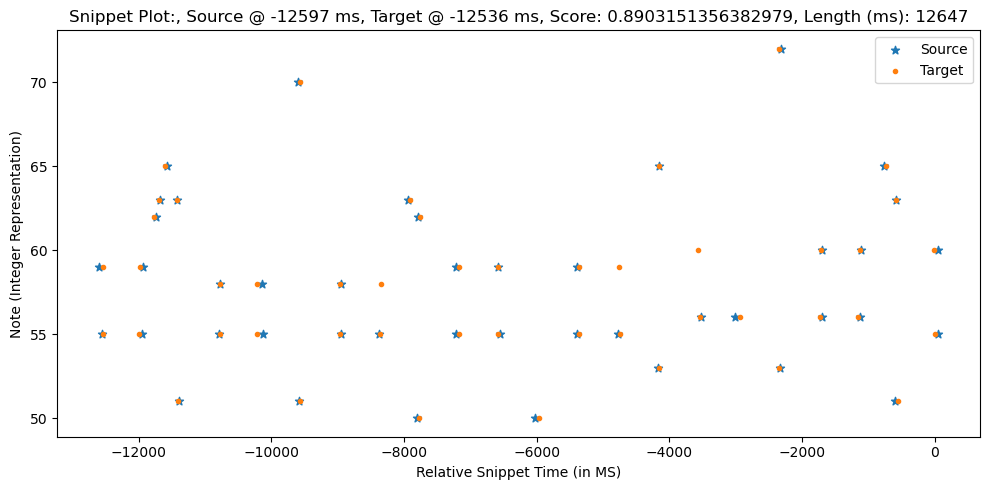

0.8903151356382979
Scores: [ 0.98    0.8425  0.8875  0.89    0.92    0.965   0.9125  0.9925  0.95
  0.9875  0.9875  0.7425  0.8225  0.9475  0.955   0.945   0.975   0.9675
 -0.      0.9175  0.935   0.955   0.9025  0.8925  0.98    0.945   0.8625
  0.9525  0.9375 -0.      0.915   0.98    0.9825 -0.      0.945   0.8125
  0.95    0.945   0.925   0.9675  0.93    0.9575  0.92    0.9975  0.905
  0.8475  0.8675  0.9325  0.9325  1.      0.9775  0.8075  0.8475]
Sequence1:  [[-14402     55     51]
 [-14397     59     34]
 [-13854     55     48]
 [-13838     59     29]
 [-13628     62     49]
 [-13552     63     54]
 [-13468     65     59]
 [-13285     63     54]
 [-13268     51     53]
 [-12646     58     36]
 [-12644     55     44]
 [-12088     55     49]
 [-12074     58     44]
 [-11437     70     58]
 [-11426     51     46]
 [-10827     55     45]
 [-10824     58     32]
 [-10220     55     48]
 [-10208     58     39]
 [ -9774     63     52]
 [ -9638     50     42]
 [ -9626     62     56]
 [ -9

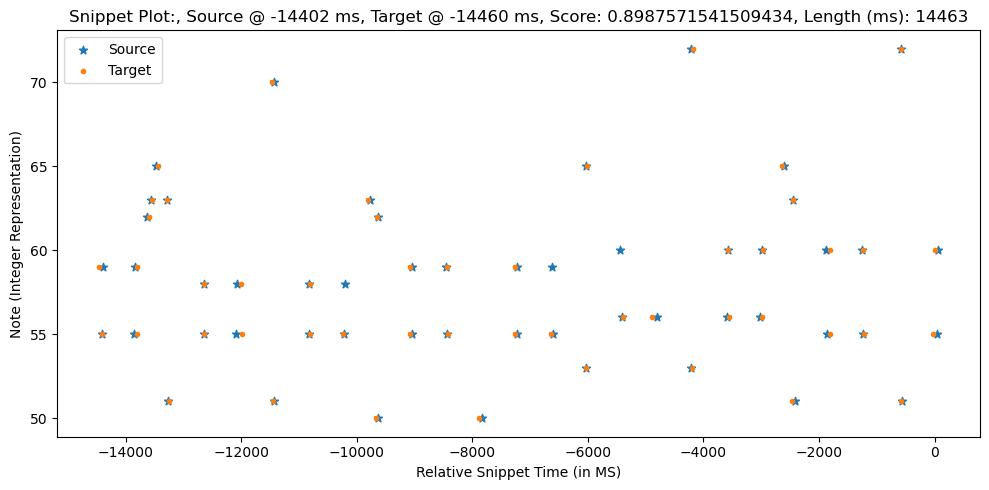

Scores: [0.8425 0.98   0.8875 0.89   0.92   0.965  0.9125 0.9925 0.95   0.9875
 0.9875 0.8225 0.7425 0.9475 0.955  0.975  0.945  0.9675 0.9175 0.935
 0.955  0.8925 0.9025 0.98   0.945  0.8625 0.9375 0.9525 0.915  0.98
 0.9825 0.945  0.8125 0.95   0.945  0.9675 0.925  0.93   0.9575 0.92
 0.905  0.9975 0.8475 0.8675 0.9325 0.9325 1.     0.9775 0.8075 0.8475]
Sequence1:  [[-14521     59     37]
 [-14471     55     39]
 [-13870     55     46]
 [-13855     59     23]
 [-13657     62     43]
 [-13599     63     56]
 [-13494     65     45]
 [-13349     63     49]
 [-13309     51     53]
 [-12710     55     49]
 [-12702     58     34]
 [-12064     58     26]
 [-12046     55     35]
 [-11519     70     53]
 [-11505     51     51]
 [-10875     58     33]
 [-10866     55     42]
 [-10294     55     48]
 [ -9868     63     49]
 [ -9725     50     44]
 [ -9705     62     54]
 [ -9146     55     44]
 [ -9144     59     42]
 [ -8502     59     41]
 [ -8482     55     45]
 [ -7950     50     51]
 [ -7

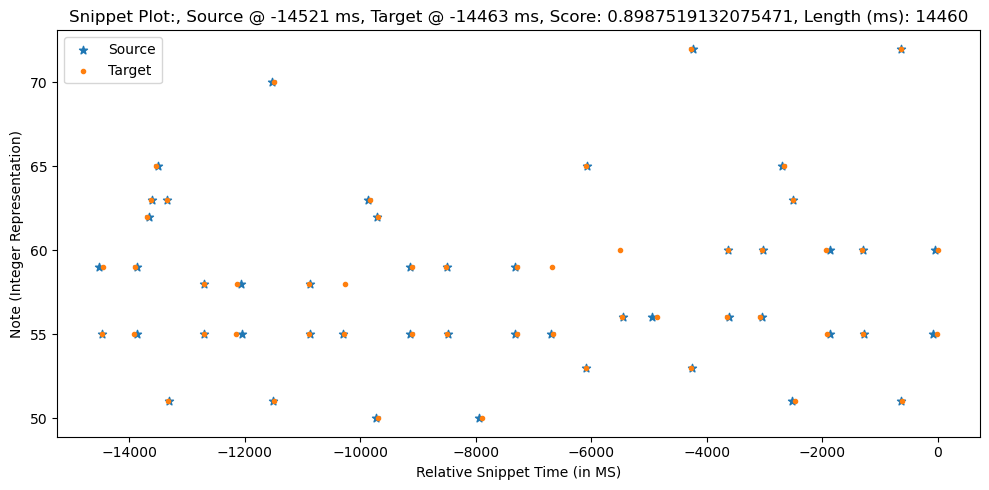

0.8987571541509434
Scores: [ 0.9675  0.83    0.9     0.9025  0.9325  0.9775  0.925   0.98    0.9625
  1.      0.975   0.755   0.835   0.935   0.9425  0.9575  0.9875  0.955
 -0.      0.905   0.9225  0.9425  0.89    0.88    0.9925  0.9575  0.85
  0.94    0.925  -0.      0.9025  0.9675  0.995  -0.      0.9575  0.8
  0.9625  0.9575  0.9375  0.98    0.9425  0.97    0.9075  0.985   0.8925
  0.86    0.88    0.945   0.945   0.9875  0.965   0.795   0.835   0.975
  0.98    0.8675  0.925   0.92    0.8275  0.8175]
Sequence1:  [[-16206     55     51]
 [-16201     59     34]
 [-15658     55     48]
 [-15642     59     29]
 [-15432     62     49]
 [-15356     63     54]
 [-15272     65     59]
 [-15089     63     54]
 [-15072     51     53]
 [-14450     58     36]
 [-14448     55     44]
 [-13892     55     49]
 [-13878     58     44]
 [-13241     70     58]
 [-13230     51     46]
 [-12631     55     45]
 [-12628     58     32]
 [-12024     55     48]
 [-12012     58     39]
 [-11578     63     52]


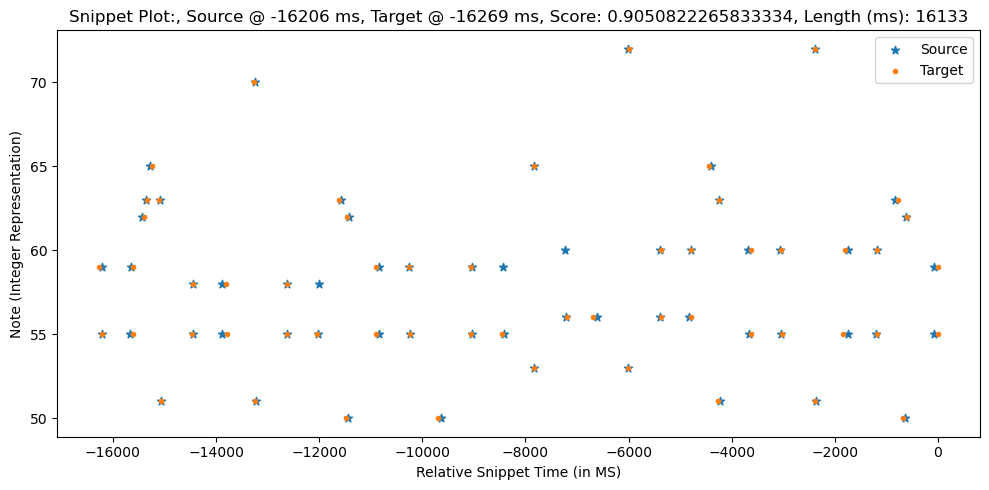

Scores: [0.83   0.9675 0.9    0.9025 0.9325 0.9775 0.925  0.98   0.9625 0.975
 1.     0.835  0.755  0.935  0.9425 0.9875 0.9575 0.955  0.905  0.9225
 0.9425 0.88   0.89   0.9925 0.9575 0.85   0.925  0.94   0.9025 0.9675
 0.995  0.9575 0.8    0.9625 0.9575 0.98   0.9375 0.9425 0.97   0.9075
 0.8925 0.985  0.86   0.88   0.945  0.945  0.9875 0.965  0.795  0.835
 0.975  0.98   0.8675 0.925  0.92   0.8275 0.8175]
Sequence1:  [[-16196     59     37]
 [-16146     55     39]
 [-15545     55     46]
 [-15530     59     23]
 [-15332     62     43]
 [-15274     63     56]
 [-15169     65     45]
 [-15024     63     49]
 [-14984     51     53]
 [-14385     55     49]
 [-14377     58     34]
 [-13739     58     26]
 [-13721     55     35]
 [-13194     70     53]
 [-13180     51     51]
 [-12550     58     33]
 [-12541     55     42]
 [-11969     55     48]
 [-11543     63     49]
 [-11400     50     44]
 [-11380     62     54]
 [-10821     55     44]
 [-10819     59     42]
 [-10177     59     41]


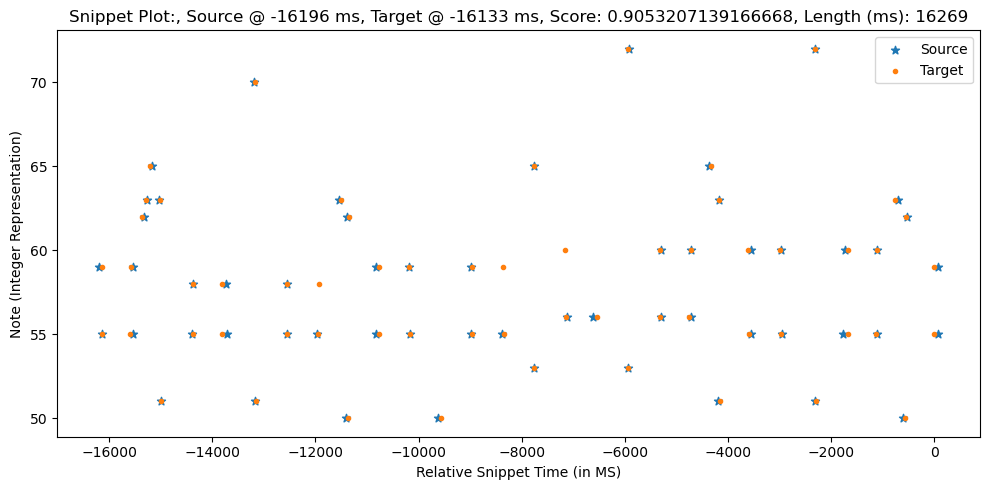

0.9053207139166668
Scores: [ 0.9775  0.84    0.89    0.8925  0.9225  0.9675  0.915   0.99    0.9525
  0.99    0.985   0.745   0.825   0.945   0.9525  0.9475  0.9775  0.965
 -0.      0.915   0.9325  0.9525  0.9     0.89    0.9825  0.9475  0.86
  0.95    0.935  -0.      0.9125  0.9775  0.985  -0.      0.9475  0.81
  0.9525  0.9475  0.9275  0.97    0.9325  0.96    0.9175  0.995   0.9025
  0.85    0.87    0.935   0.935   0.9975  0.975   0.805   0.845   0.965
  0.99    0.8575  0.935   0.91    0.8175  0.8075  0.9175  0.94    0.9625
  0.9675  0.9825  0.96    0.89    0.9475]
Sequence1:  [[-18552     55     51]
 [-18547     59     34]
 [-18004     55     48]
 [-17988     59     29]
 [-17778     62     49]
 [-17702     63     54]
 [-17618     65     59]
 [-17435     63     54]
 [-17418     51     53]
 [-16796     58     36]
 [-16794     55     44]
 [-16238     55     49]
 [-16224     58     44]
 [-15587     70     58]
 [-15576     51     46]
 [-14977     55     45]
 [-14974     58     32]
 [-143

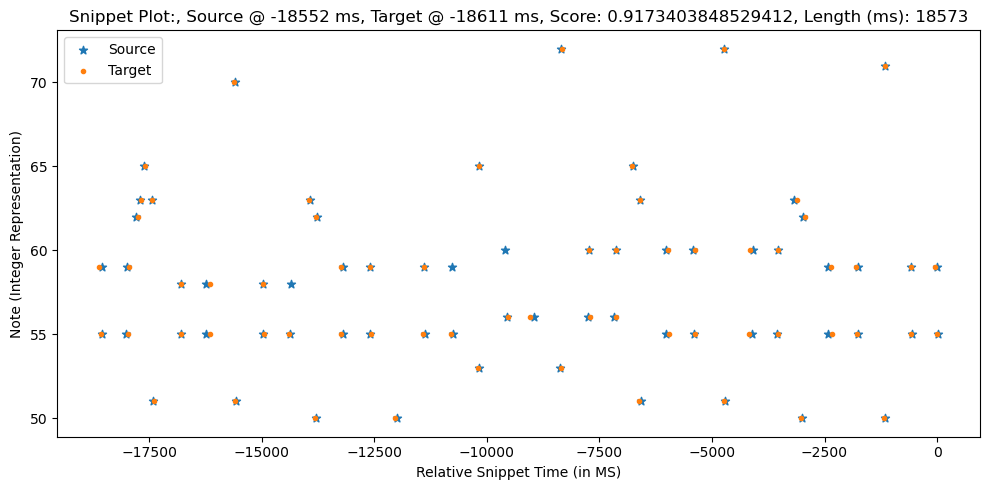

Scores: [0.84   0.9775 0.89   0.8925 0.9225 0.9675 0.915  0.99   0.9525 0.985
 0.99   0.825  0.745  0.945  0.9525 0.9775 0.9475 0.965  0.915  0.9325
 0.9525 0.89   0.9    0.9825 0.9475 0.86   0.935  0.95   0.9125 0.9775
 0.985  0.9475 0.81   0.9525 0.9475 0.97   0.9275 0.9325 0.96   0.9175
 0.9025 0.995  0.85   0.87   0.935  0.935  0.9975 0.975  0.805  0.845
 0.965  0.99   0.8575 0.935  0.91   0.8175 0.8075 0.9175 0.94   0.9625
 0.9675 0.96   0.9825 0.89   0.9475]
Sequence1:  [[-18632     59     37]
 [-18582     55     39]
 [-17981     55     46]
 [-17966     59     23]
 [-17768     62     43]
 [-17710     63     56]
 [-17605     65     45]
 [-17460     63     49]
 [-17420     51     53]
 [-16821     55     49]
 [-16813     58     34]
 [-16175     58     26]
 [-16157     55     35]
 [-15630     70     53]
 [-15616     51     51]
 [-14986     58     33]
 [-14977     55     42]
 [-14405     55     48]
 [-13979     63     49]
 [-13836     50     44]
 [-13816     62     54]
 [-13257     55

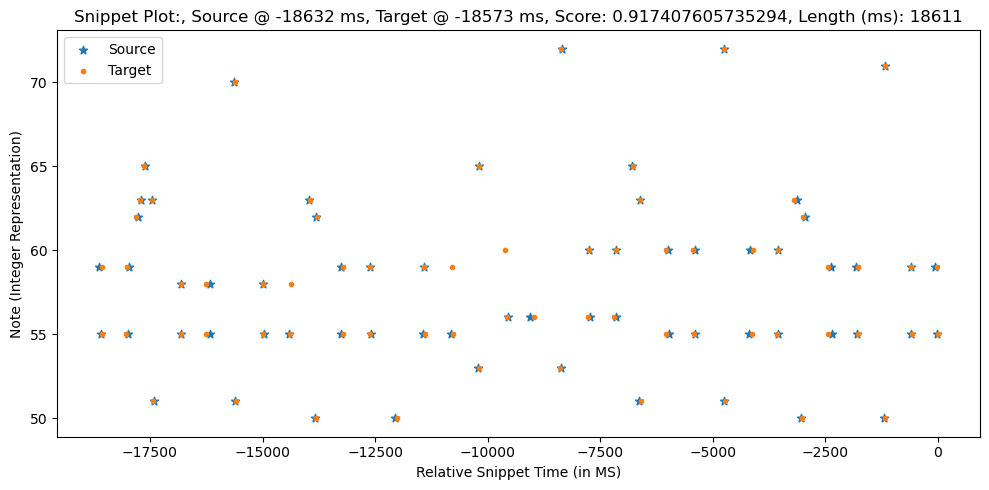

0.917407605735294
Scores: [ 0.9775  0.84    0.89    0.8925  0.9225  0.9675  0.915   0.99    0.9525
  0.99    0.985   0.745   0.825   0.945   0.9525  0.9475  0.9775  0.965
 -0.      0.915   0.9325  0.9525  0.9     0.89    0.9825  0.9475  0.86
  0.95    0.935  -0.      0.9125  0.9775  0.985  -0.      0.9475  0.81
  0.9525  0.9475  0.9275  0.97    0.9325  0.96    0.9175  0.995   0.9025
  0.85    0.87    0.935   0.935   0.9975  0.975   0.805   0.845   0.965
  0.99    0.8575  0.935   0.91    0.8175  0.8075  0.9175  0.94    0.9625
  0.9675  0.9825  0.96    0.89    0.9475  0.9625  0.93    0.915   0.97
  0.87    0.9675]
Sequence1:  [[-20367     55     51]
 [-20362     59     34]
 [-19819     55     48]
 [-19803     59     29]
 [-19593     62     49]
 [-19517     63     54]
 [-19433     65     59]
 [-19250     63     54]
 [-19233     51     53]
 [-18611     58     36]
 [-18609     55     44]
 [-18053     55     49]
 [-18039     58     44]
 [-17402     70     58]
 [-17391     51     46]
 [-16792

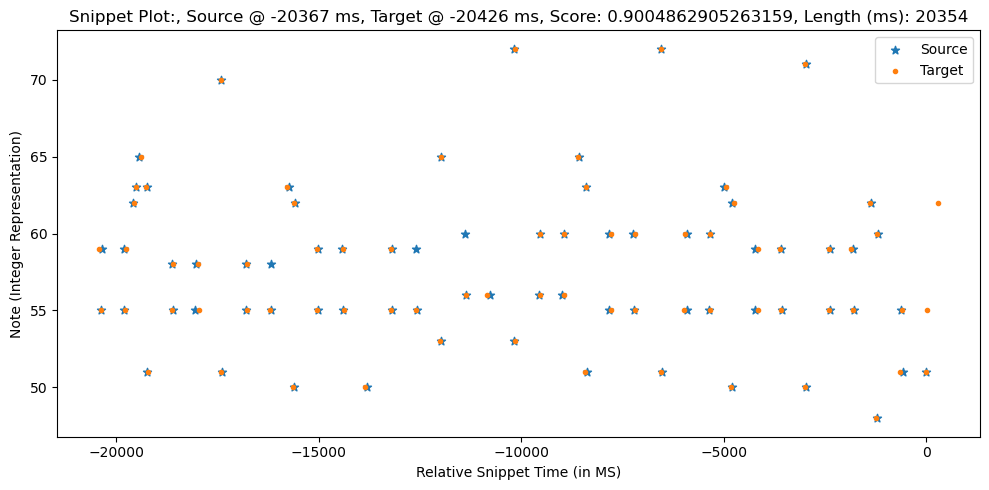

Scores: [-0.     -0.     -0.     -0.     -0.     -0.     -0.     -0.     -0.
  0.87   -0.     -0.      0.84   -0.      0.9525  0.9325  0.915   0.875
 -0.     -0.     -0.      0.8425 -0.     -0.      0.985   0.86    0.9525
  0.9675  0.9875 -0.     -0.     -0.     -0.      0.9325 -0.      0.845
  0.8975  0.97   -0.     -0.     -0.     -0.      0.9    -0.      0.8725
 -0.     -0.      0.9     0.915   0.82    0.85    0.8025 -0.     -0.
 -0.     -0.      0.885  -0.      0.925   0.9725 -0.      0.91    0.895
  0.8     0.86   -0.     -0.     -0.     -0.      0.915  -0.      0.995
  0.64  ]
Sequence1:  [[-20862     59     37]
 [-20812     55     39]
 [-20211     55     46]
 [-20196     59     23]
 [-19998     62     43]
 [-19940     63     56]
 [-19835     65     45]
 [-19690     63     49]
 [-19650     51     53]
 [-19051     55     49]
 [-19043     58     34]
 [-18405     58     26]
 [-18387     55     35]
 [-17860     70     53]
 [-17846     51     51]
 [-17216     58     33]
 [-17207     5

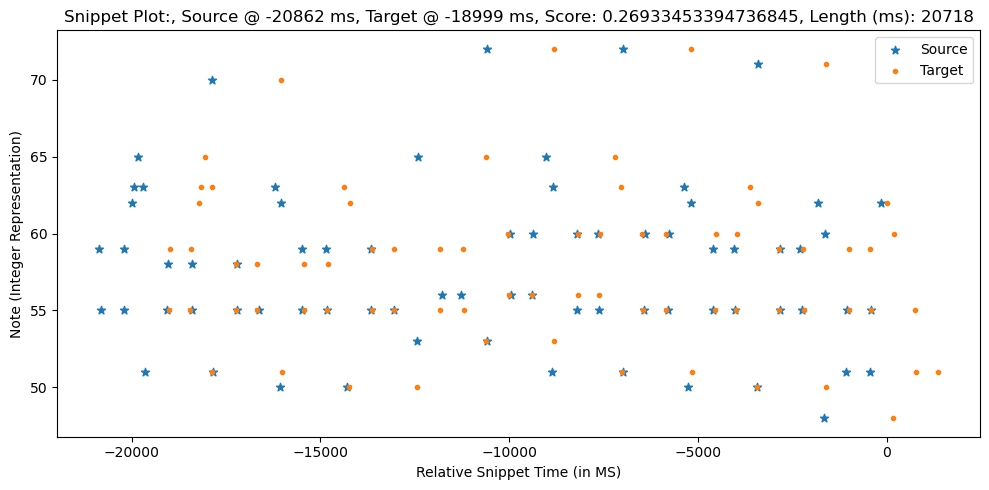

0.9004862905263159
Scores: [ 0.9825  0.845   0.885   0.8875  0.9175  0.9625  0.91    0.995   0.9475
  0.985   0.99    0.74    0.82    0.95    0.9575  0.9425  0.9725  0.97
 -0.      0.92    0.9375  0.9575  0.905   0.895   0.9775  0.9425  0.865
  0.955   0.94   -0.      0.9175  0.9825  0.98   -0.      0.9425  0.815
  0.9475  0.9425  0.9225  0.965   0.9275  0.955   0.9225  1.      0.9075
  0.845   0.865   0.93    0.93    0.9975  0.98    0.81    0.85    0.96
  0.995   0.8525  0.94    0.905   0.8125  0.8025  0.9225  0.945   0.9675
  0.9725  0.9875  0.965   0.895   0.9525  0.9675  0.935   0.92    0.965
  0.875   0.9625  0.8275  0.9375  0.98    0.9475  0.96    0.975   0.9625
  0.9675]
Sequence1:  [[-22147     55     51]
 [-22142     59     34]
 [-21599     55     48]
 [-21583     59     29]
 [-21373     62     49]
 [-21297     63     54]
 [-21213     65     59]
 [-21030     63     54]
 [-21013     51     53]
 [-20391     58     36]
 [-20389     55     44]
 [-19833     55     49]
 [-19819     

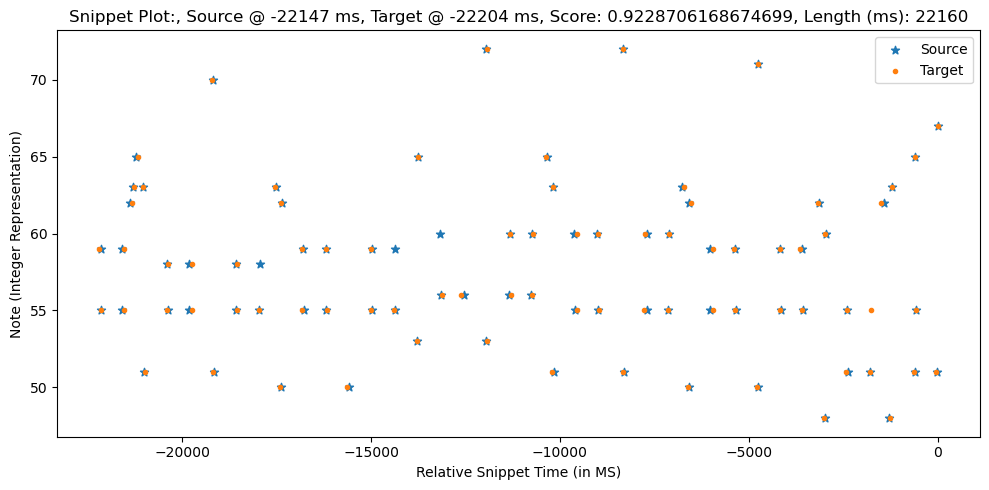

Scores: [ 0.845   0.9825  0.885   0.8875  0.9175  0.9625  0.91    0.995   0.9475
  0.99    0.985   0.82    0.74    0.95    0.9575  0.9725  0.9425  0.97
  0.92    0.9375  0.9575  0.895   0.905   0.9775  0.9425  0.865   0.94
  0.955   0.9175  0.9825  0.98    0.9425  0.815   0.9475  0.9425  0.965
  0.9225  0.9275  0.955   0.9225  0.9075  1.      0.845   0.865   0.93
  0.93    0.9975  0.98    0.81    0.85    0.96    0.995   0.8525  0.94
  0.905   0.8125  0.8025  0.9225  0.945   0.9675  0.9725  0.965   0.9875
  0.895   0.9525  0.9675  0.935   0.92    0.875   0.965   0.9625 -0.
  0.8275  0.9375  0.98    0.96    0.9475  0.975   0.9625  0.9675]
Sequence1:  [[-22217     59     37]
 [-22167     55     39]
 [-21566     55     46]
 [-21551     59     23]
 [-21353     62     43]
 [-21295     63     56]
 [-21190     65     45]
 [-21045     63     49]
 [-21005     51     53]
 [-20406     55     49]
 [-20398     58     34]
 [-19760     58     26]
 [-19742     55     35]
 [-19215     70     53]
 [-1920

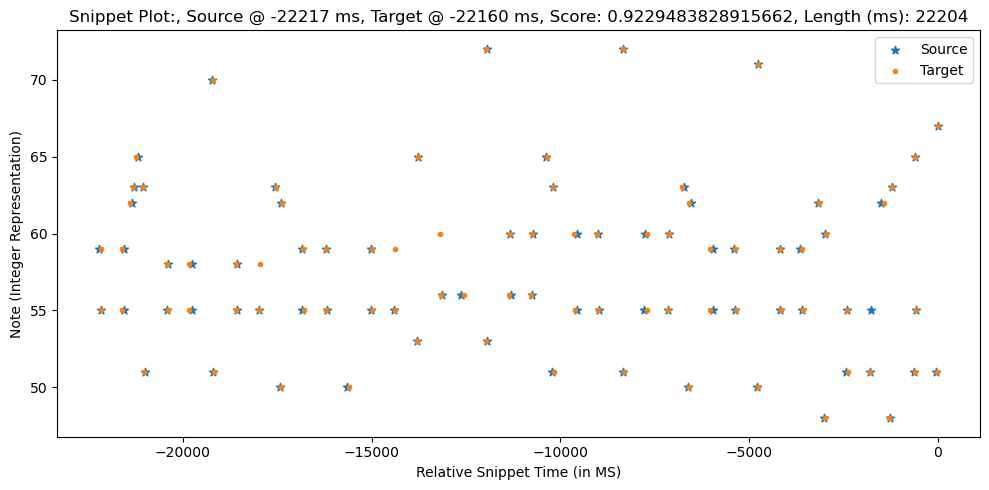

0.9229483828915662
Scores: [ 0.985   0.8475  0.8825  0.885   0.915   0.96    0.9075  0.9975  0.945
  0.9825  0.9925  0.7375  0.8175  0.9525  0.96    0.94    0.97    0.9725
 -0.      0.9225  0.94    0.96    0.9075  0.8975  0.975   0.94    0.8675
  0.9575  0.9425 -0.      0.92    0.985   0.9775 -0.      0.94    0.8175
  0.945   0.94    0.92    0.9625  0.925   0.9525  0.925   0.9975  0.91
  0.8425  0.8625  0.9275  0.9275  0.995   0.9825  0.8125  0.8525  0.9575
  0.9975  0.85    0.9425  0.9025  0.81    0.8     0.925   0.9475  0.97
  0.975   0.99    0.9675  0.8975  0.955   0.97    0.9375  0.9225  0.9625
  0.8775  0.96    0.83    0.935   0.9775  0.945   0.9625  0.9725  0.965
  0.97    0.9925  0.9875  0.875   0.82    0.86    0.9825  0.97  ]
Sequence1:  [[-24597     55     51]
 [-24592     59     34]
 [-24049     55     48]
 [-24033     59     29]
 [-23823     62     49]
 [-23747     63     54]
 [-23663     65     59]
 [-23480     63     54]
 [-23463     51     53]
 [-22841     58     36]
 [-2

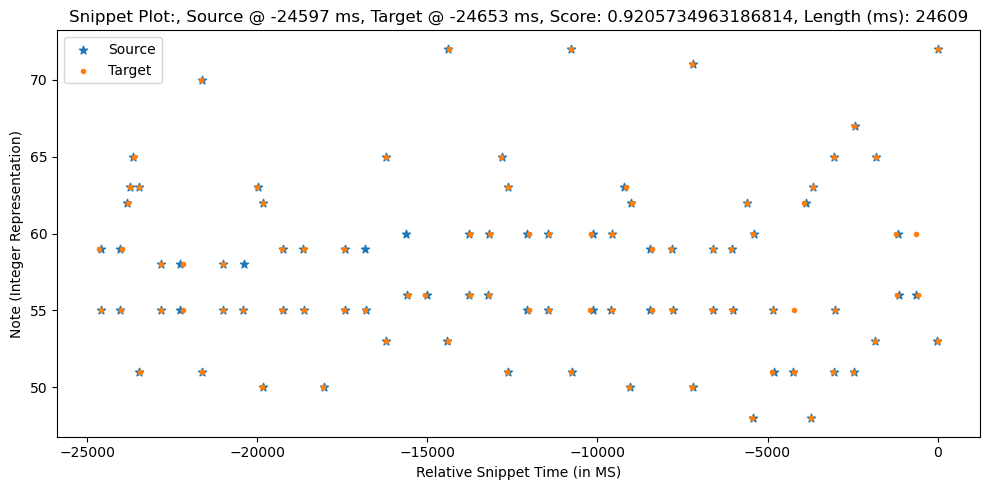

Scores: [ 0.845   0.9825  0.885   0.8875  0.9175  0.9625  0.91    0.995   0.9475
  0.99    0.985   0.82    0.74    0.95    0.9575  0.9725  0.9425  0.97
  0.92    0.9375  0.9575  0.895   0.905   0.9775  0.9425  0.865   0.94
  0.955   0.9175  0.9825  0.98    0.9425  0.815   0.9475  0.9425  0.965
  0.9225  0.9275  0.955   0.9225  0.9075  1.      0.845   0.865   0.93
  0.93    0.9975  0.98    0.81    0.85    0.96    0.995   0.8525  0.94
  0.905   0.8125  0.8025  0.9225  0.945   0.9675  0.9725  0.965   0.9875
  0.895   0.9525  0.9675  0.935   0.92    0.875   0.965   0.9625 -0.
  0.8275  0.9375  0.98    0.96    0.9475  0.975   0.9625  0.9675  0.99
  0.99    0.8725  0.8175 -0.      0.8625  0.9675  0.985 ]
Sequence1:  [[-24649     59     37]
 [-24599     55     39]
 [-23998     55     46]
 [-23983     59     23]
 [-23785     62     43]
 [-23727     63     56]
 [-23622     65     45]
 [-23477     63     49]
 [-23437     51     53]
 [-22838     55     49]
 [-22830     58     34]
 [-22192     58 

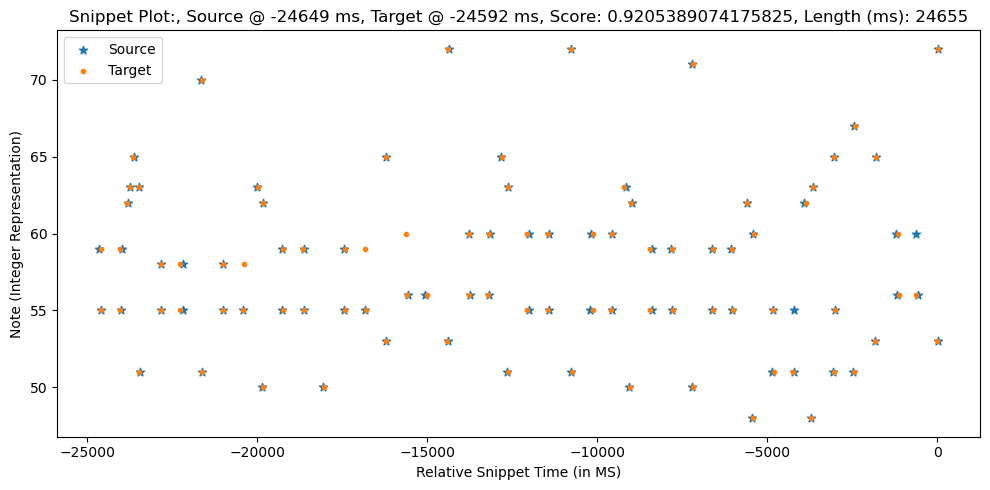

0.9205734963186814
Scores: [ 0.985   0.8475  0.8825  0.885   0.915   0.96    0.9075  0.9975  0.945
  0.9825  0.9925  0.7375  0.8175  0.9525  0.96    0.94    0.97    0.9725
 -0.      0.9225  0.94    0.96    0.9075  0.8975  0.975   0.94    0.8675
  0.9575  0.9425 -0.      0.92    0.985   0.9775 -0.      0.94    0.8175
  0.945   0.94    0.92    0.9625  0.925   0.9525  0.925   0.9975  0.91
  0.8425  0.8625  0.9275  0.9275  0.995   0.9825  0.8125  0.8525  0.9575
  0.9975  0.85    0.9425  0.9025  0.81    0.8     0.925   0.9475  0.97
  0.975   0.99    0.9675  0.8975  0.955   0.97    0.9375  0.9225  0.9625
  0.8775  0.96    0.83    0.935   0.9775  0.945   0.9625  0.9725  0.965
  0.97    0.9925  0.9875  0.875   0.82    0.86    0.9825  0.97    0.9975
  0.9225  0.8425  0.99    0.9675  0.96    0.9675]
Sequence1:  [[-26371     55     51]
 [-26366     59     34]
 [-25823     55     48]
 [-25807     59     29]
 [-25597     62     49]
 [-25521     63     54]
 [-25437     65     59]
 [-25254     63    

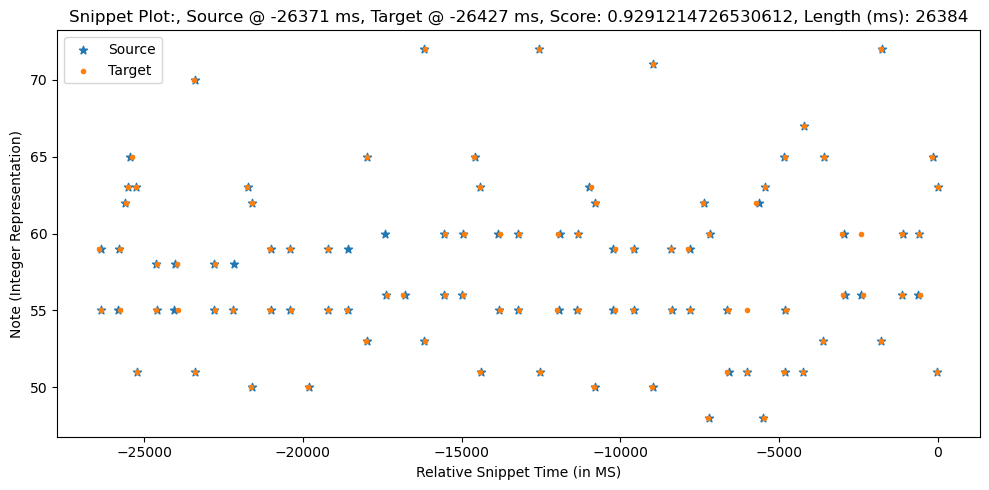

Scores: [ 0.8475  0.985   0.8825  0.885   0.915   0.96    0.9075  0.9975  0.945
  0.9925  0.9825  0.8175  0.7375  0.9525  0.96    0.97    0.94    0.9725
  0.9225  0.94    0.96    0.8975  0.9075  0.975   0.94    0.8675  0.9425
  0.9575  0.92    0.985   0.9775  0.94    0.8175  0.945   0.94    0.9625
  0.92    0.925   0.9525  0.925   0.91    0.9975  0.8425  0.8625  0.9275
  0.9275  0.995   0.9825  0.8125  0.8525  0.9575  0.9975  0.85    0.9425
  0.9025  0.81    0.8     0.925   0.9475  0.97    0.975   0.9675  0.99
  0.8975  0.955   0.97    0.9375  0.9225  0.8775  0.9625  0.96   -0.
  0.83    0.935   0.9775  0.9625  0.945   0.9725  0.965   0.97    0.9925
  0.9875  0.875   0.82   -0.      0.86    0.97    0.9825  0.9975  0.9225
  0.99    0.8425  0.9675  0.96    0.9675]
Sequence1:  [[-26440     59     37]
 [-26390     55     39]
 [-25789     55     46]
 [-25774     59     23]
 [-25576     62     43]
 [-25518     63     56]
 [-25413     65     45]
 [-25268     63     49]
 [-25228     51     53]

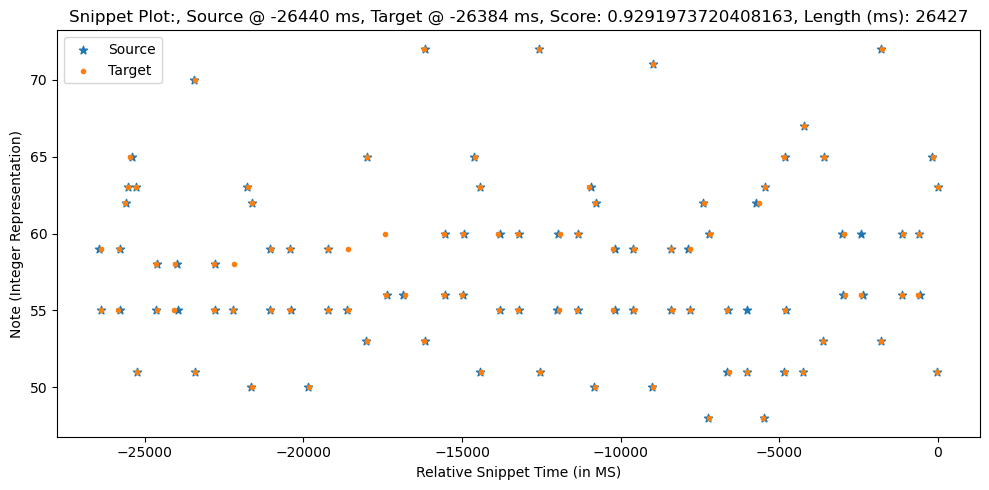

0.9291973720408163
Scores: [ 0.9875  0.85    0.88    0.8825  0.9125  0.9575  0.905   1.      0.9425
  0.98    0.995   0.735   0.815   0.955   0.9625  0.9375  0.9675  0.975
 -0.      0.925   0.9425  0.9625  0.91    0.9     0.9725  0.9375  0.87
  0.96    0.945  -0.      0.9225  0.9875  0.975  -0.      0.9375  0.82
  0.9425  0.9375  0.9175  0.96    0.9225  0.95    0.9275  0.995   0.9125
  0.84    0.86    0.925   0.925   0.9925  0.985   0.815   0.855   0.955
  1.      0.8475  0.945   0.9     0.8075  0.7975  0.9275  0.95    0.9725
  0.9775  0.9925  0.97    0.9     0.9575  0.9725  0.94    0.925   0.96
  0.88    0.9575  0.8325  0.9325  0.975   0.9425  0.965   0.97    0.9675
  0.9725  0.995   0.985   0.8775  0.8225  0.8575  0.98    0.9725  0.995
  0.925   0.84    0.9925  0.97    0.9625  0.97    0.9925  0.905   0.97
  0.8325  0.99    0.9975]
Sequence1:  [[-28184     55     51]
 [-28179     59     34]
 [-27636     55     48]
 [-27620     59     29]
 [-27410     62     49]
 [-27334     63     54]

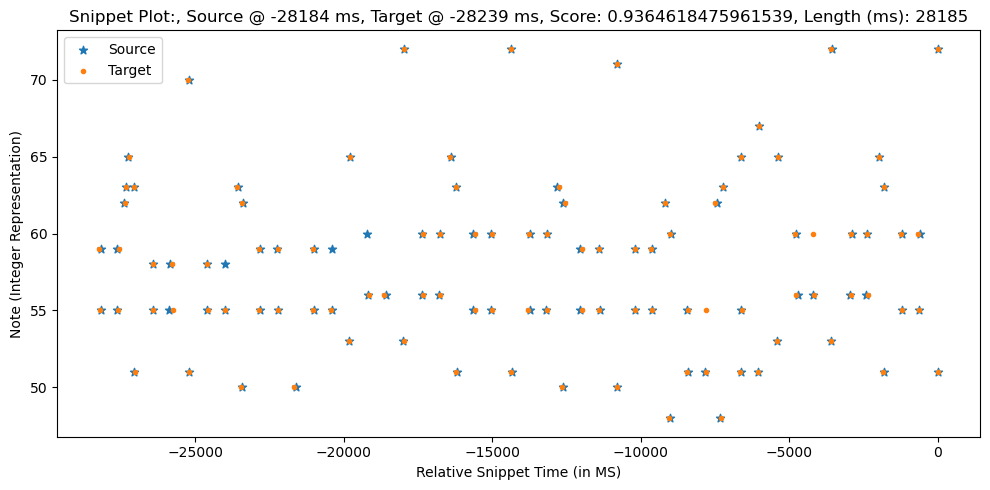

Scores: [ 0.8475  0.985   0.8825  0.885   0.915   0.96    0.9075  0.9975  0.945
  0.9925  0.9825  0.8175  0.7375  0.9525  0.96    0.97    0.94    0.9725
  0.9225  0.94    0.96    0.8975  0.9075  0.975   0.94    0.8675  0.9425
  0.9575  0.92    0.985   0.9775  0.94    0.8175  0.945   0.94    0.9625
  0.92    0.925   0.9525  0.925   0.91    0.9975  0.8425  0.8625  0.9275
  0.9275  0.995   0.9825  0.8125  0.8525  0.9575  0.9975  0.85    0.9425
  0.9025  0.81    0.8     0.925   0.9475  0.97    0.975   0.9675  0.99
  0.8975  0.955   0.97    0.9375  0.9225  0.8775  0.9625  0.96   -0.
  0.83    0.935   0.9775  0.9625  0.945   0.9725  0.965   0.97    0.9925
  0.9875  0.875   0.82   -0.      0.86    0.97    0.9825  0.9975  0.9225
  0.99    0.8425  0.9675  0.96    0.9675  0.9025  0.995   0.83    0.9675
  0.995   0.9925]
Sequence1:  [[-28239     59     37]
 [-28189     55     39]
 [-27588     55     46]
 [-27573     59     23]
 [-27375     62     43]
 [-27317     63     56]
 [-27212     65     45

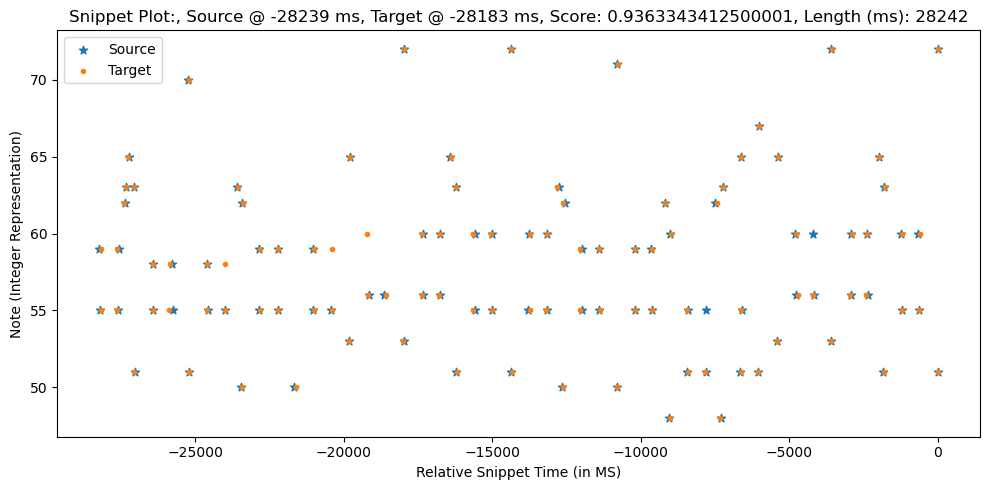

0.9364618475961539
Scores: [ 0.995   0.8575  0.8725  0.875   0.905   0.95    0.8975  0.9925  0.935
  0.9725  0.9975  0.7275  0.8075  0.9625  0.97    0.93    0.96    0.9825
 -0.      0.9325  0.95    0.97    0.9175  0.9075  0.965   0.93    0.8775
  0.9675  0.9525 -0.      0.93    0.995   0.9675 -0.      0.93    0.8275
  0.935   0.93    0.91    0.9525  0.915   0.9425  0.935   0.9875  0.92
  0.8325  0.8525  0.9175  0.9175  0.985   0.9925  0.8225  0.8625  0.9475
  0.9925  0.84    0.9525  0.8925  0.8     0.79    0.935   0.9575  0.98
  0.985   1.      0.9775  0.9075  0.965   0.98    0.9475  0.9325  0.9525
  0.8875  0.95    0.84    0.925   0.9675  0.935   0.9725  0.9625  0.975
  0.98    0.9975  0.9775  0.885   0.83    0.85    0.9725  0.98    0.9875
  0.9325  0.8325  1.      0.9775  0.97    0.9775  0.985   0.9125  0.9775
  0.84    0.9825  0.995   0.9325  0.9375 -0.      0.89    0.895   0.76
  0.9025  1.      0.9675]
Sequence1:  [[-30588     55     51]
 [-30583     59     34]
 [-30040     55    

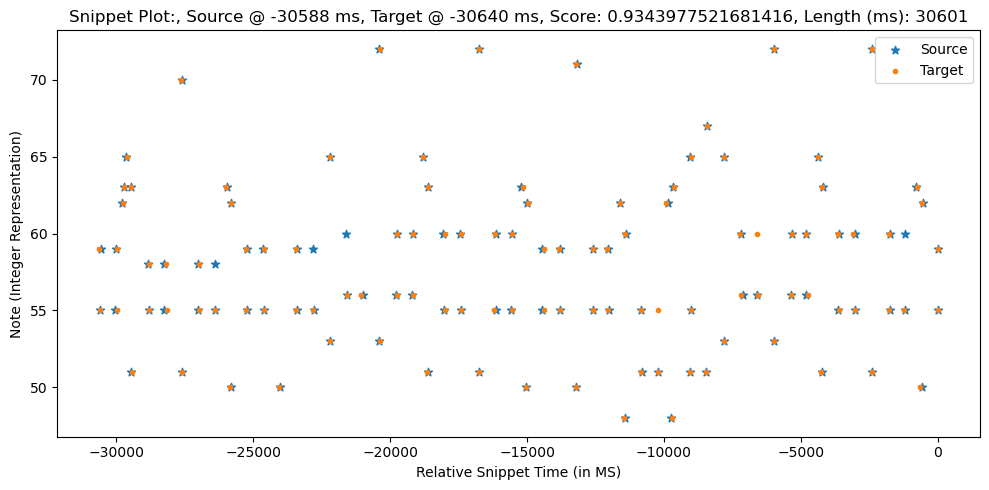

Scores: [ 0.8575  0.995   0.8725  0.875   0.905   0.95    0.8975  0.9925  0.935
  0.9975  0.9725  0.8075  0.7275  0.9625  0.97    0.96    0.93    0.9825
  0.9325  0.95    0.97    0.9075  0.9175  0.965   0.93    0.8775  0.9525
  0.9675  0.93    0.995   0.9675  0.93    0.8275  0.935   0.93    0.9525
  0.91    0.915   0.9425  0.935   0.92    0.9875  0.8325  0.8525  0.9175
  0.9175  0.985   0.9925  0.8225  0.8625  0.9475  0.9925  0.84    0.9525
  0.8925  0.8     0.79    0.935   0.9575  0.98    0.985   0.9775  1.
  0.9075  0.965   0.98    0.9475  0.9325  0.8875  0.9525  0.95   -0.
  0.84    0.925   0.9675  0.9725  0.935   0.9625  0.975   0.98    0.9975
  0.9775  0.885   0.83   -0.      0.85    0.98    0.9725  0.9875  0.9325
  1.      0.8325  0.9775  0.97    0.9775  0.9125  0.985   0.84    0.9775
  0.995   0.9825  0.9325  0.9375  0.89    0.895   0.76    0.9025  1.
  0.9675]
Sequence1:  [[-30653     59     37]
 [-30603     55     39]
 [-30002     55     46]
 [-29987     59     23]
 [-29789   

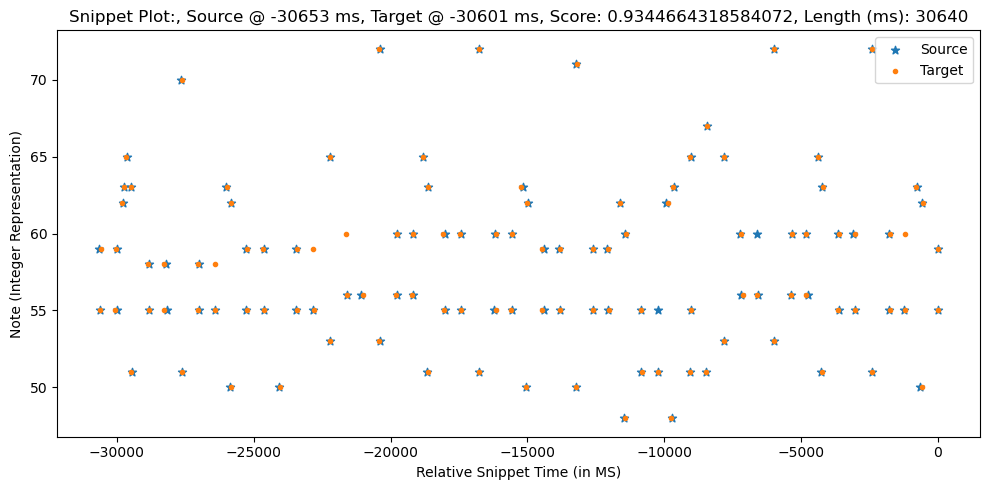

0.9344664318584072
Scores: [ 0.9975  0.86    0.87    0.8725  0.9025  0.9475  0.895   0.99    0.9325
  0.97    0.995   0.725   0.805   0.965   0.9725  0.9275  0.9575  0.985
 -0.      0.935   0.9525  0.9725  0.92    0.91    0.9625  0.9275  0.88
  0.97    0.955  -0.      0.9325  0.9975  0.965  -0.      0.9275  0.83
  0.9325  0.9275  0.9075  0.95    0.9125  0.94    0.9375  0.985   0.9225
  0.83    0.85    0.915   0.915   0.9825  0.995   0.825   0.865   0.945
  0.99    0.8375  0.955   0.89    0.7975  0.7875  0.9375  0.96    0.9825
  0.9875  0.9975  0.98    0.91    0.9675  0.9825  0.95    0.935   0.95
  0.89    0.9475  0.8425  0.9225  0.965   0.9325  0.975   0.96    0.9775
  0.9825  0.995   0.975   0.8875  0.8325  0.8475  0.97    0.9825  0.985
  0.935   0.83    0.9975  0.98    0.9725  0.98    0.9825  0.915   0.98
  0.8425  0.98    0.9925  0.935   0.94   -0.      0.8925  0.8925  0.7625
  0.905   0.9975  0.97    0.9775  0.93    0.9525  0.9     0.8925  0.8675]
Sequence1:  [[-32360     55     51

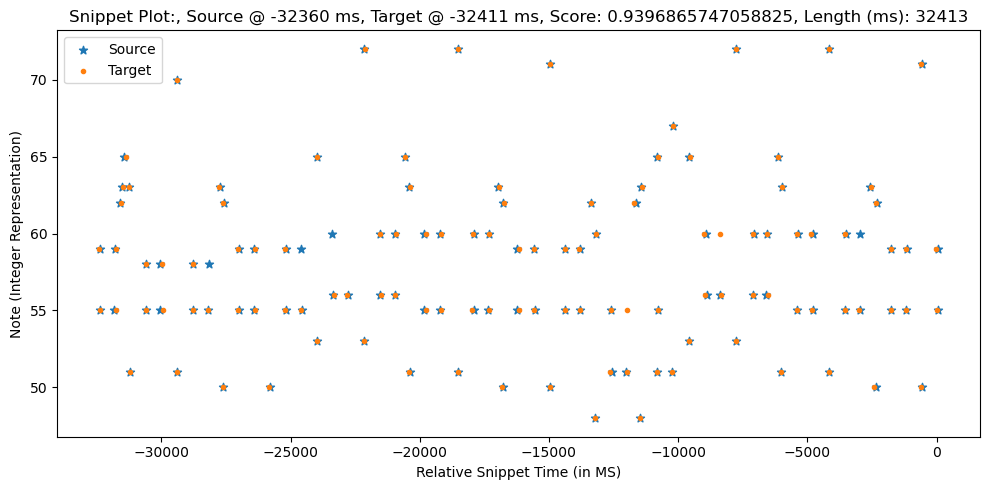

Scores: [ 0.86    0.9975  0.87    0.8725  0.9025  0.9475  0.895   0.99    0.9325
  0.995   0.97    0.805   0.725   0.965   0.9725  0.9575  0.9275  0.985
  0.935   0.9525  0.9725  0.91    0.92    0.9625  0.9275  0.88    0.955
  0.97    0.9325  0.9975  0.965   0.9275  0.83    0.9325  0.9275  0.95
  0.9075  0.9125  0.94    0.9375  0.9225  0.985   0.83    0.85    0.915
  0.915   0.9825  0.995   0.825   0.865   0.945   0.99    0.8375  0.955
  0.89    0.7975  0.7875  0.9375  0.96    0.9825  0.9875  0.98    0.9975
  0.91    0.9675  0.9825  0.95    0.935   0.89    0.95    0.9475 -0.
  0.8425  0.9225  0.965   0.975   0.9325  0.96    0.9775  0.9825  0.995
  0.975   0.8875  0.8325 -0.      0.8475  0.9825  0.97    0.985   0.935
  0.9975  0.83    0.98    0.9725  0.98    0.915   0.9825  0.8425  0.98
  0.9925  0.98    0.935   0.94    0.8925  0.8925  0.7625  0.905   0.9975
  0.97    0.93    0.9775  0.9525  0.9     0.8925  0.8675]
Sequence1:  [[-32464     59     37]
 [-32414     55     39]
 [-31813    

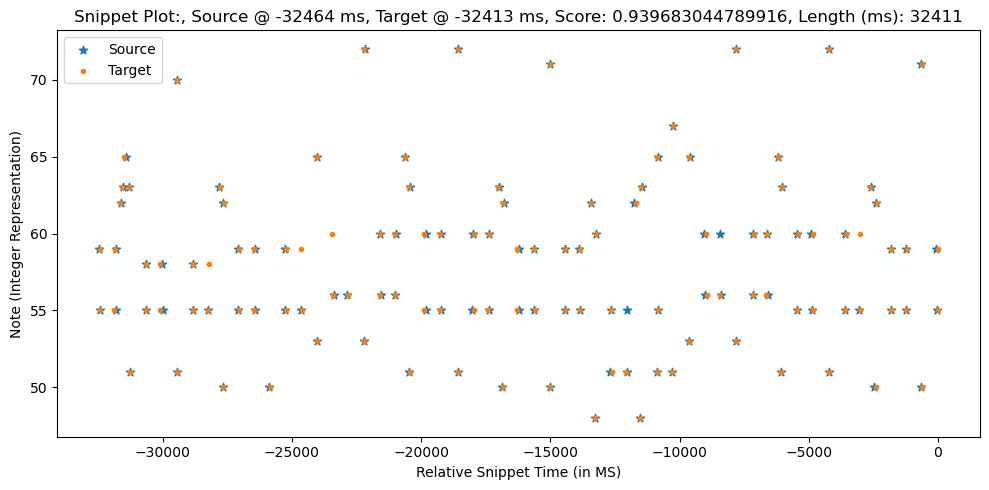

0.9396865747058825
Scores: [ 0.9975  0.865   0.865   0.8675  0.8975  0.9425  0.89    0.985   0.9275
  0.965   0.99    0.72    0.8     0.97    0.9775  0.9225  0.9525  0.99
 -0.      0.94    0.9575  0.9775  0.925   0.915   0.9575  0.9225  0.885
  0.975   0.96   -0.      0.9375  0.9975  0.96   -0.      0.9225  0.835
  0.9275  0.9225  0.9025  0.945   0.9075  0.935   0.9425  0.98    0.9275
  0.825   0.845   0.91    0.91    0.9775  1.      0.83    0.87    0.94
  0.985   0.8325  0.96    0.885   0.7925  0.7825  0.9425  0.965   0.9875
  0.9925  0.9925  0.985   0.915   0.9725  0.9875  0.955   0.94    0.945
  0.895   0.9425  0.8475  0.9175  0.96    0.9275  0.98    0.955   0.9825
  0.9875  0.99    0.97    0.8925  0.8375  0.8425  0.965   0.9875  0.98
  0.94    0.825   0.9925  0.985   0.9775  0.985   0.9775  0.92    0.985
  0.8475  0.975   0.9875  0.94    0.945  -0.      0.8975  0.8875  0.7675
  0.91    0.9925  0.975   0.9825  0.935   0.9575  0.905   0.8975  0.8725
  0.8875  0.8875  0.865   0.7875  

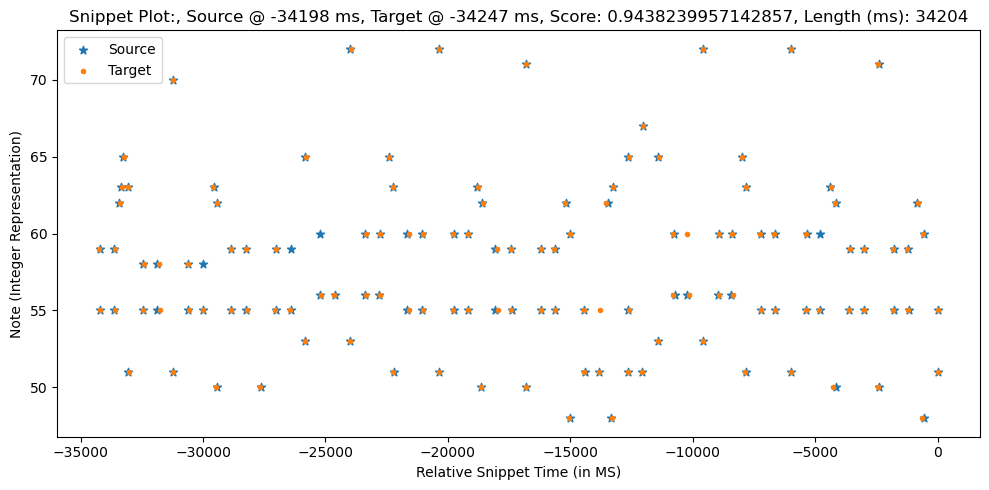

Scores: [ 0.865   0.9975  0.865   0.8675  0.8975  0.9425  0.89    0.985   0.9275
  0.99    0.965   0.8     0.72    0.97    0.9775  0.9525  0.9225  0.99
  0.94    0.9575  0.9775  0.915   0.925   0.9575  0.9225  0.885   0.96
  0.975   0.9375  0.9975  0.96    0.9225  0.835   0.9275  0.9225  0.945
  0.9025  0.9075  0.935   0.9425  0.9275  0.98    0.825   0.845   0.91
  0.91    0.9775  1.      0.83    0.87    0.94    0.985   0.8325  0.96
  0.885   0.7925  0.7825  0.9425  0.965   0.9875  0.9925  0.985   0.9925
  0.915   0.9725  0.9875  0.955   0.94    0.895   0.945   0.9425 -0.
  0.8475  0.9175  0.96    0.98    0.9275  0.955   0.9825  0.9875  0.99
  0.97    0.8925  0.8375 -0.      0.8425  0.9875  0.965   0.98    0.94
  0.9925  0.825   0.985   0.9775  0.985   0.92    0.9775  0.8475  0.985
  0.9875  0.975   0.94    0.945   0.8975  0.8875  0.7675  0.91    0.9925
  0.975   0.935   0.9825  0.9575  0.905   0.8975  0.8725  0.8875  0.8875
  0.865   0.7875  0.8975  0.9675  0.985 ]
Sequence1:  [[-3425

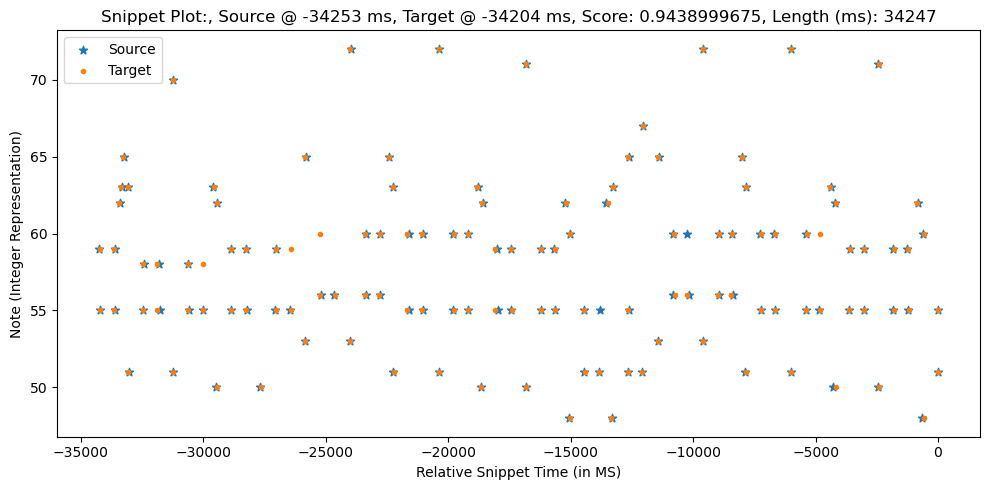

0.9438999675
Scores: [ 0.995   0.8675  0.8625  0.865   0.895   0.94    0.8875  0.9825  0.925
  0.9625  0.9875  0.7175  0.7975  0.9725  0.98    0.92    0.95    0.9925
 -0.      0.9425  0.96    0.98    0.9275  0.9175  0.955   0.92    0.8875
  0.9775  0.9625 -0.      0.94    0.995   0.9575 -0.      0.92    0.8375
  0.925   0.92    0.9     0.9425  0.905   0.9325  0.945   0.9775  0.93
  0.8225  0.8425  0.9075  0.9075  0.975   0.9975  0.8325  0.8725  0.9375
  0.9825  0.83    0.9625  0.8825  0.79    0.78    0.945   0.9675  0.99
  0.995   0.99    0.9875  0.9175  0.975   0.99    0.9575  0.9425  0.9425
  0.8975  0.94    0.85    0.915   0.9575  0.925   0.9825  0.9525  0.985
  0.99    0.9875  0.9675  0.895   0.84    0.84    0.9625  0.99    0.9775
  0.9425  0.8225  0.99    0.9875  0.98    0.9875  0.975   0.9225  0.9875
  0.85    0.9725  0.985   0.9425  0.9475 -0.      0.9     0.885   0.77
  0.9125  0.99    0.9775  0.985   0.9375  0.96    0.9075  0.9     0.875
  0.89    0.89    0.8625  0.79    0.9  

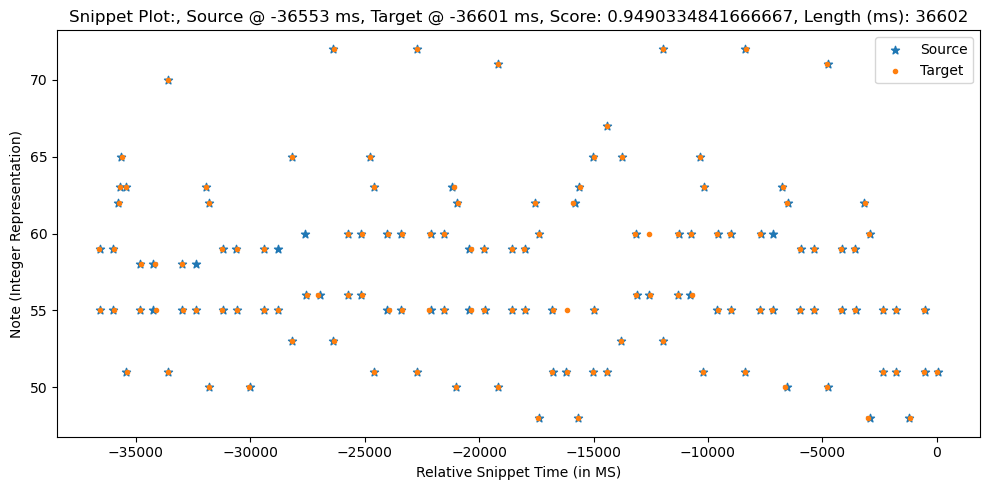

Scores: [ 0.8675  0.995   0.8625  0.865   0.895   0.94    0.8875  0.9825  0.925
  0.9875  0.9625  0.7975  0.7175  0.9725  0.98    0.95    0.92    0.9925
  0.9425  0.96    0.98    0.9175  0.9275  0.955   0.92    0.8875  0.9625
  0.9775  0.94    0.995   0.9575  0.92    0.8375  0.925   0.92    0.9425
  0.9     0.905   0.9325  0.945   0.93    0.9775  0.8225  0.8425  0.9075
  0.9075  0.975   0.9975  0.8325  0.8725  0.9375  0.9825  0.83    0.9625
  0.8825  0.79    0.78    0.945   0.9675  0.99    0.995   0.9875  0.99
  0.9175  0.975   0.99    0.9575  0.9425  0.8975  0.9425  0.94   -0.
  0.85    0.915   0.9575  0.9825  0.925   0.9525  0.985   0.99    0.9875
  0.9675  0.895   0.84   -0.      0.84    0.99    0.9625  0.9775  0.9425
  0.99    0.8225  0.9875  0.98    0.9875  0.9225  0.975   0.85    0.9875
  0.985   0.9725  0.9425  0.9475  0.9     0.885   0.77    0.9125  0.99
  0.9775  0.9375  0.985   0.96    0.9075  0.9     0.875   0.89    0.89
  0.8625  0.79    0.9     0.97    0.9875  0.9325  0.97

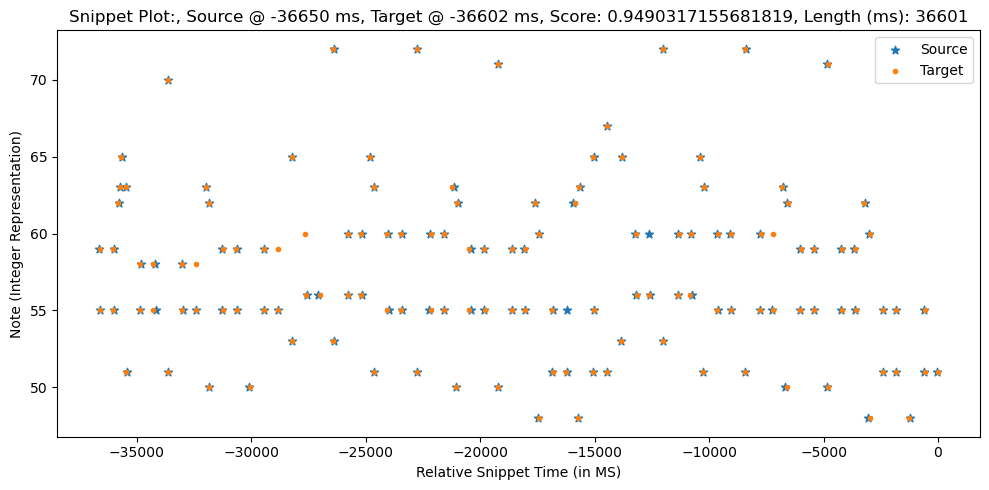

0.9490334841666667
Scores: [ 0.9925  0.87    0.86    0.8625  0.8925  0.9375  0.885   0.98    0.9225
  0.96    0.985   0.715   0.795   0.975   0.9825  0.9175  0.9475  0.995
 -0.      0.945   0.9625  0.9825  0.93    0.92    0.9525  0.9175  0.89
  0.98    0.965  -0.      0.9425  0.9925  0.955  -0.      0.9175  0.84
  0.9225  0.9175  0.8975  0.94    0.9025  0.93    0.9475  0.975   0.9325
  0.82    0.84    0.905   0.905   0.9725  0.995   0.835   0.875   0.935
  0.98    0.8275  0.965   0.88    0.7875  0.7775  0.9475  0.97    0.9925
  0.9975  0.9875  0.99    0.92    0.9775  0.9925  0.96    0.945   0.94
  0.9     0.9375  0.8525  0.9125  0.955   0.9225  0.985   0.95    0.9875
  0.9925  0.985   0.965   0.8975  0.8425  0.8375  0.96    0.9925  0.975
  0.945   0.82    0.9875  0.99    0.9825  0.99    0.9725  0.925   0.99
  0.8525  0.97    0.9825  0.945   0.95   -0.      0.9025  0.8825  0.7725
  0.915   0.9875  0.98    0.9875  0.94    0.9625  0.91    0.9025  0.8775
  0.8925  0.8925  0.86    0.7925  0

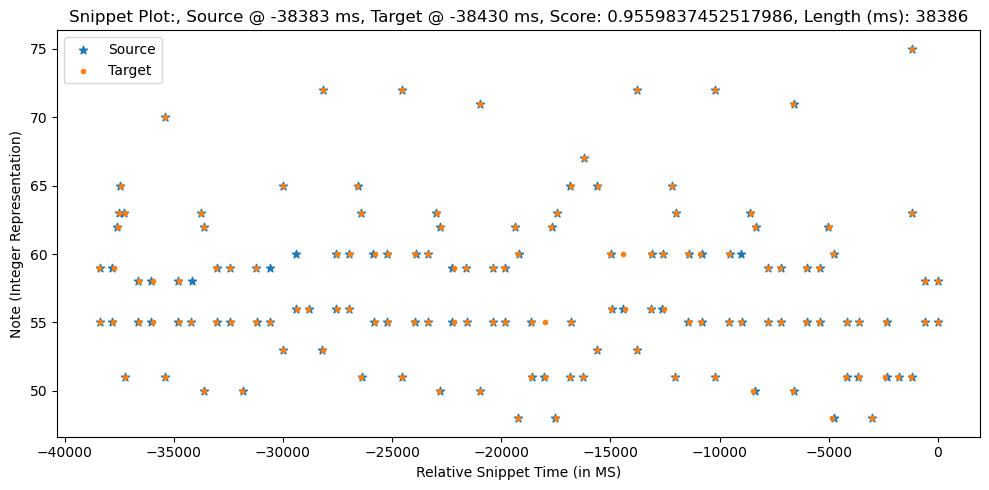

Scores: [ 0.8675  0.995   0.8625  0.865   0.895   0.94    0.8875  0.9825  0.925
  0.9875  0.9625  0.7975  0.7175  0.9725  0.98    0.95    0.92    0.9925
  0.9425  0.96    0.98    0.9175  0.9275  0.955   0.92    0.8875  0.9625
  0.9775  0.94    0.995   0.9575  0.92    0.8375  0.925   0.92    0.9425
  0.9     0.905   0.9325  0.945   0.93    0.9775  0.8225  0.8425  0.9075
  0.9075  0.975   0.9975  0.8325  0.8725  0.9375  0.9825  0.83    0.9625
  0.8825  0.79    0.78    0.945   0.9675  0.99    0.995   0.9875  0.99
  0.9175  0.975   0.99    0.9575  0.9425  0.8975  0.9425  0.94   -0.
  0.85    0.915   0.9575  0.9825  0.925   0.9525  0.985   0.99    0.9875
  0.9675  0.895   0.84   -0.      0.84    0.99    0.9625  0.9775  0.9425
  0.99    0.8225  0.9875  0.98    0.9875  0.9225  0.975   0.85    0.9875
  0.985   0.9725  0.9425  0.9475  0.9     0.885   0.77    0.9125  0.99
  0.9775  0.9375  0.985   0.96    0.9075  0.9     0.875   0.89    0.89
  0.8625  0.79    0.9     0.97    0.9875  0.9325  0.97

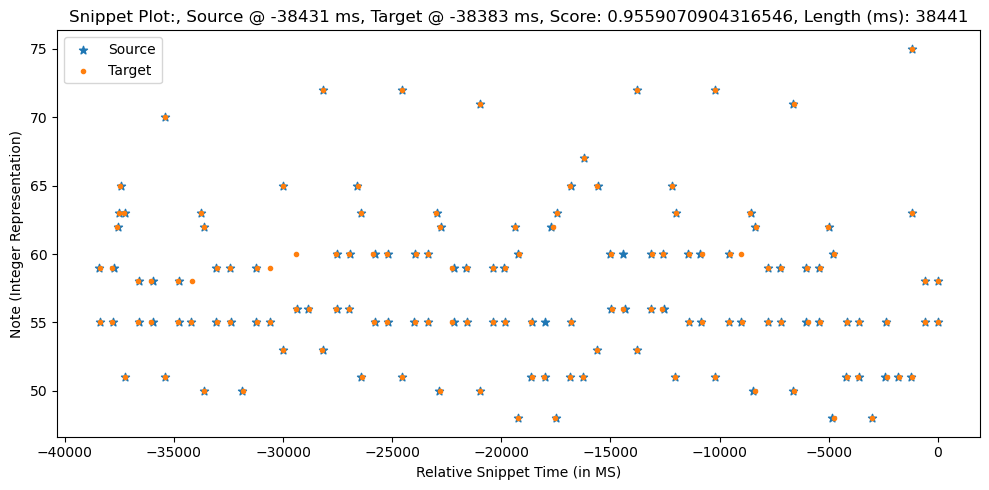

0.9559837452517986
Scores: [ 0.995   0.8675  0.8625  0.865   0.895   0.94    0.8875  0.9825  0.925
  0.9625  0.9875  0.7175  0.7975  0.9725  0.98    0.92    0.95    0.9925
 -0.      0.9425  0.96    0.98    0.9275  0.9175  0.955   0.92    0.8875
  0.9775  0.9625 -0.      0.94    0.995   0.9575 -0.      0.92    0.8375
  0.925   0.92    0.9     0.9425  0.905   0.9325  0.945   0.9775  0.93
  0.8225  0.8425  0.9075  0.9075  0.975   0.9975  0.8325  0.8725  0.9375
  0.9825  0.83    0.9625  0.8825  0.79    0.78    0.945   0.9675  0.99
  0.995   0.99    0.9875  0.9175  0.975   0.99    0.9575  0.9425  0.9425
  0.8975  0.94    0.85    0.915   0.9575  0.925   0.9825  0.9525  0.985
  0.99    0.9875  0.9675  0.895   0.84    0.84    0.9625  0.99    0.9775
  0.9425  0.8225  0.99    0.9875  0.98    0.9875  0.975   0.9225  0.9875
  0.85    0.9725  0.985   0.9425  0.9475 -0.      0.9     0.885   0.77
  0.9125  0.99    0.9775  0.985   0.9375  0.96    0.9075  0.9     0.875
  0.89    0.89    0.8625  0.79   

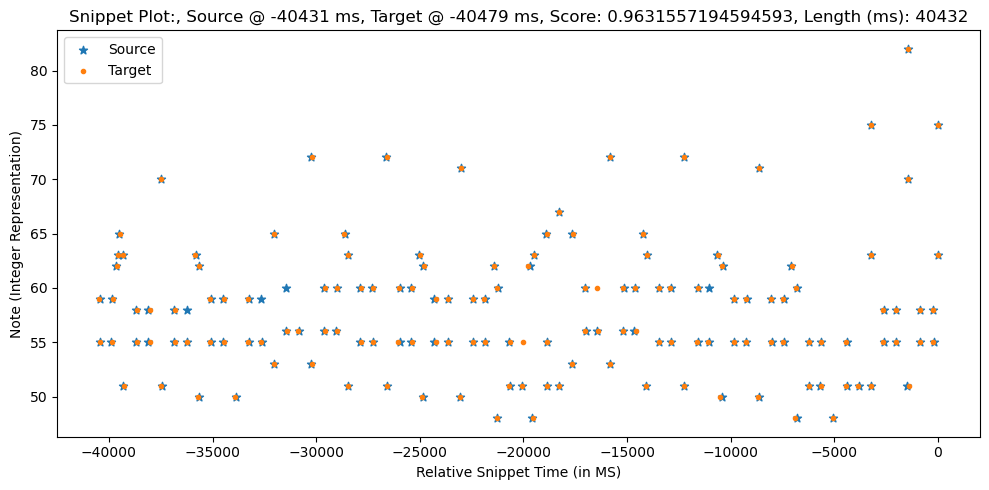

Scores: [ 0.8675  0.995   0.8625  0.865   0.895   0.94    0.8875  0.9825  0.925
  0.9875  0.9625  0.7975  0.7175  0.9725  0.98    0.95    0.92    0.9925
  0.9425  0.96    0.98    0.9175  0.9275  0.955   0.92    0.8875  0.9625
  0.9775  0.94    0.995   0.9575  0.92    0.8375  0.925   0.92    0.9425
  0.9     0.905   0.9325  0.945   0.93    0.9775  0.8225  0.8425  0.9075
  0.9075  0.975   0.9975  0.8325  0.8725  0.9375  0.9825  0.83    0.9625
  0.8825  0.79    0.78    0.945   0.9675  0.99    0.995   0.9875  0.99
  0.9175  0.975   0.99    0.9575  0.9425  0.8975  0.9425  0.94   -0.
  0.85    0.915   0.9575  0.9825  0.925   0.9525  0.985   0.99    0.9875
  0.9675  0.895   0.84   -0.      0.84    0.99    0.9625  0.9775  0.9425
  0.99    0.8225  0.9875  0.98    0.9875  0.9225  0.975   0.85    0.9875
  0.985   0.9725  0.9425  0.9475  0.9     0.885   0.77    0.9125  0.99
  0.9775  0.9375  0.985   0.96    0.9075  0.9     0.875   0.89    0.89
  0.8625  0.79    0.9     0.97    0.9875  0.9325  0.97

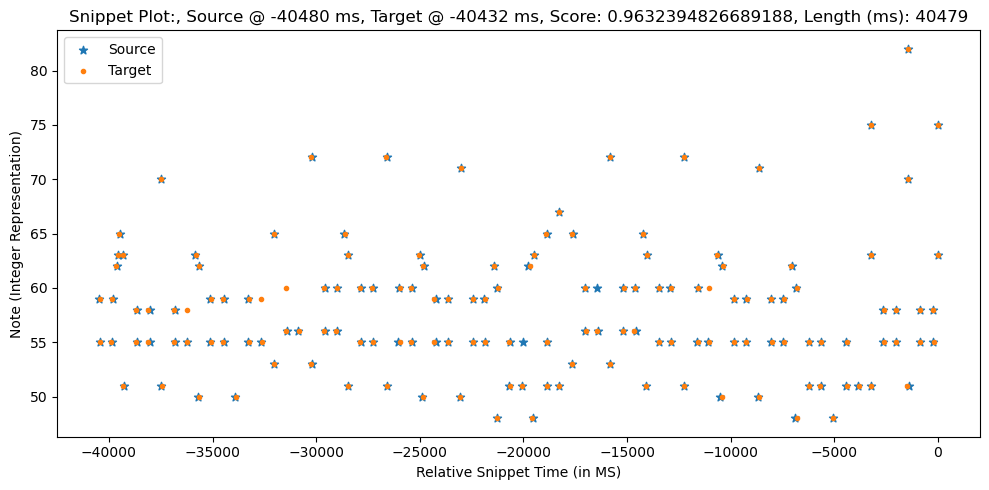

0.9632394826689188
Scores: [ 0.9925  0.87    0.86    0.8625  0.8925  0.9375  0.885   0.98    0.9225
  0.96    0.985   0.715   0.795   0.975   0.9825  0.9175  0.9475  0.995
 -0.      0.945   0.9625  0.9825  0.93    0.92    0.9525  0.9175  0.89
  0.98    0.965  -0.      0.9425  0.9925  0.955  -0.      0.9175  0.84
  0.9225  0.9175  0.8975  0.94    0.9025  0.93    0.9475  0.975   0.9325
  0.82    0.84    0.905   0.905   0.9725  0.995   0.835   0.875   0.935
  0.98    0.8275  0.965   0.88    0.7875  0.7775  0.9475  0.97    0.9925
  0.9975  0.9875  0.99    0.92    0.9775  0.9925  0.96    0.945   0.94
  0.9     0.9375  0.8525  0.9125  0.955   0.9225  0.985   0.95    0.9875
  0.9925  0.985   0.965   0.8975  0.8425  0.8375  0.96    0.9925  0.975
  0.945   0.82    0.9875  0.99    0.9825  0.99    0.9725  0.925   0.99
  0.8525  0.97    0.9825  0.945   0.95   -0.      0.9025  0.8825  0.7725
  0.915   0.9875  0.98    0.9875  0.94    0.9625  0.91    0.9025  0.8775
  0.8925  0.8925  0.86    0.7925  0

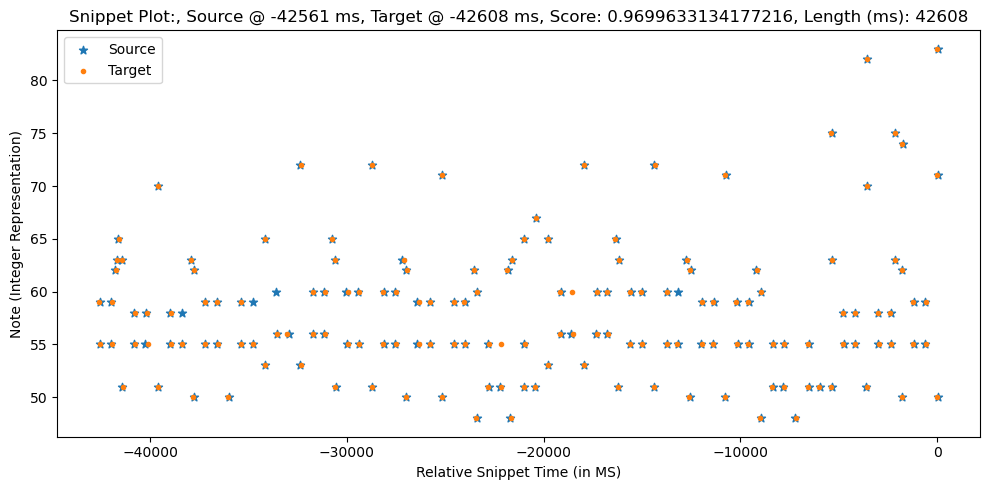

Scores: [ 0.87    0.9925  0.86    0.8625  0.8925  0.9375  0.885   0.98    0.9225
  0.985   0.96    0.795   0.715   0.975   0.9825  0.9475  0.9175  0.995
  0.945   0.9625  0.9825  0.92    0.93    0.9525  0.9175  0.89    0.965
  0.98    0.9425  0.9925  0.955   0.9175  0.84    0.9225  0.9175  0.94
  0.8975  0.9025  0.93    0.9475  0.9325  0.975   0.82    0.84    0.905
  0.905   0.9725  0.995   0.835   0.875   0.935   0.98    0.8275  0.965
  0.88    0.7875  0.7775  0.9475  0.97    0.9925  0.9975  0.99    0.9875
  0.92    0.9775  0.9925  0.96    0.945   0.9     0.94    0.9375 -0.
  0.8525  0.9125  0.955   0.985   0.9225  0.95    0.9875  0.9925  0.985
  0.965   0.8975  0.8425 -0.      0.8375  0.9925  0.96    0.975   0.945
  0.9875  0.82    0.99    0.9825  0.99    0.925   0.9725  0.8525  0.99
  0.9825  0.97    0.945   0.95    0.9025  0.8825  0.7725  0.915   0.9875
  0.98    0.94    0.9875  0.9625  0.91    0.9025  0.8775  0.8925  0.8925
  0.86    0.7925  0.9025  0.9725  0.99    0.93    0.9725 

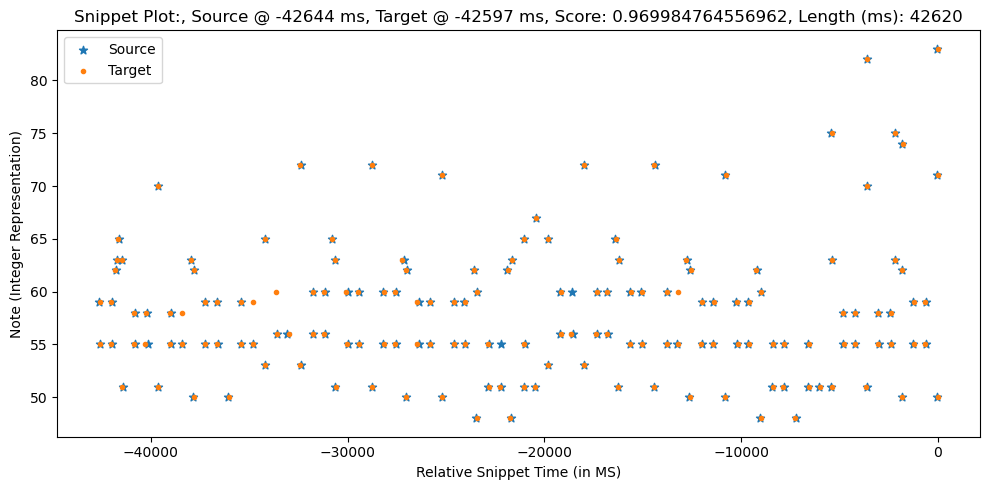

0.969984764556962
Scores: [ 0.9925  0.87    0.86    0.8625  0.8925  0.9375  0.885   0.98    0.9225
  0.96    0.985   0.715   0.795   0.975   0.9825  0.9175  0.9475  0.995
 -0.      0.945   0.9625  0.9825  0.93    0.92    0.9525  0.9175  0.89
  0.98    0.965  -0.      0.9425  0.9925  0.955  -0.      0.9175  0.84
  0.9225  0.9175  0.8975  0.94    0.9025  0.93    0.9475  0.975   0.9325
  0.82    0.84    0.905   0.905   0.9725  0.995   0.835   0.875   0.935
  0.98    0.8275  0.965   0.88    0.7875  0.7775  0.9475  0.97    0.9925
  0.9975  0.9875  0.99    0.92    0.9775  0.9925  0.96    0.945   0.94
  0.9     0.9375  0.8525  0.9125  0.955   0.9225  0.985   0.95    0.9875
  0.9925  0.985   0.965   0.8975  0.8425  0.8375  0.96    0.9925  0.975
  0.945   0.82    0.9875  0.99    0.9825  0.99    0.9725  0.925   0.99
  0.8525  0.97    0.9825  0.945   0.95   -0.      0.9025  0.8825  0.7725
  0.915   0.9875  0.98    0.9875  0.94    0.9625  0.91    0.9025  0.8775
  0.8925  0.8925  0.86    0.7925  0.

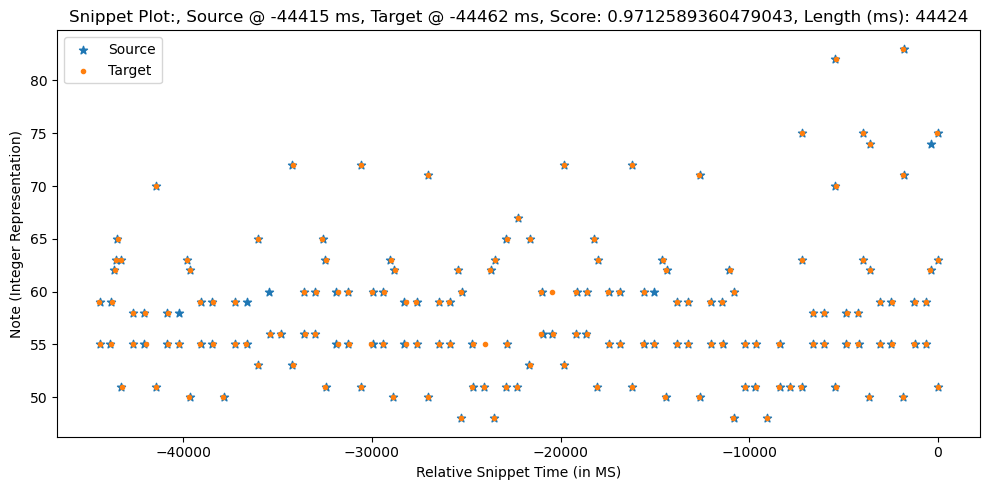

Scores: [ 0.87    0.9925  0.86    0.8625  0.8925  0.9375  0.885   0.98    0.9225
  0.985   0.96    0.795   0.715   0.975   0.9825  0.9475  0.9175  0.995
  0.945   0.9625  0.9825  0.92    0.93    0.9525  0.9175  0.89    0.965
  0.98    0.9425  0.9925  0.955   0.9175  0.84    0.9225  0.9175  0.94
  0.8975  0.9025  0.93    0.9475  0.9325  0.975   0.82    0.84    0.905
  0.905   0.9725  0.995   0.835   0.875   0.935   0.98    0.8275  0.965
  0.88    0.7875  0.7775  0.9475  0.97    0.9925  0.9975  0.99    0.9875
  0.92    0.9775  0.9925  0.96    0.945   0.9     0.94    0.9375 -0.
  0.8525  0.9125  0.955   0.985   0.9225  0.95    0.9875  0.9925  0.985
  0.965   0.8975  0.8425 -0.      0.8375  0.9925  0.96    0.975   0.945
  0.9875  0.82    0.99    0.9825  0.99    0.925   0.9725  0.8525  0.99
  0.9825  0.97    0.945   0.95    0.9025  0.8825  0.7725  0.915   0.9875
  0.98    0.94    0.9875  0.9625  0.91    0.9025  0.8775  0.8925  0.8925
  0.86    0.7925  0.9025  0.9725  0.99    0.93    0.9725 

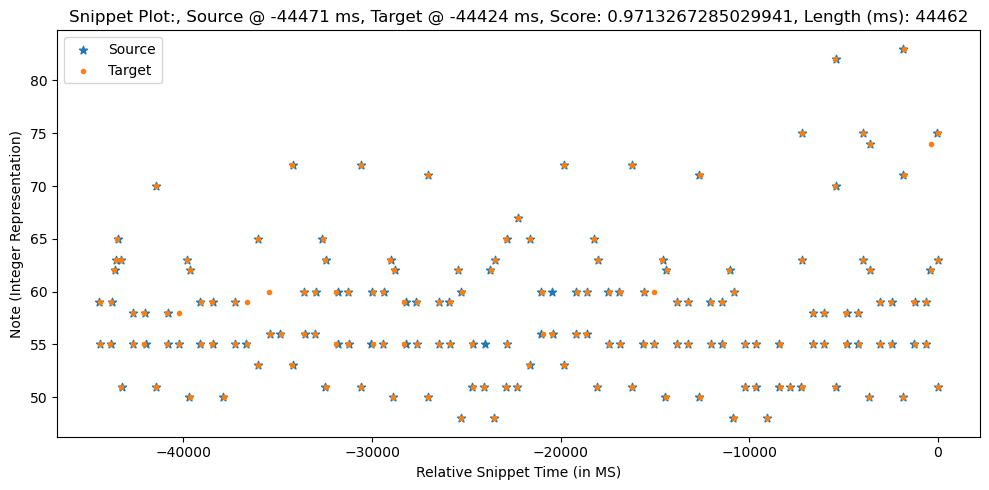

0.9713267285029941
Scores: [ 0.9925  0.87    0.86    0.8625  0.8925  0.9375  0.885   0.98    0.9225
  0.96    0.985   0.715   0.795   0.975   0.9825  0.9175  0.9475  0.995
 -0.      0.945   0.9625  0.9825  0.93    0.92    0.9525  0.9175  0.89
  0.98    0.965  -0.      0.9425  0.9925  0.955  -0.      0.9175  0.84
  0.9225  0.9175  0.8975  0.94    0.9025  0.93    0.9475  0.975   0.9325
  0.82    0.84    0.905   0.905   0.9725  0.995   0.835   0.875   0.935
  0.98    0.8275  0.965   0.88    0.7875  0.7775  0.9475  0.97    0.9925
  0.9975  0.9875  0.99    0.92    0.9775  0.9925  0.96    0.945   0.94
  0.9     0.9375  0.8525  0.9125  0.955   0.9225  0.985   0.95    0.9875
  0.9925  0.985   0.965   0.8975  0.8425  0.8375  0.96    0.9925  0.975
  0.945   0.82    0.9875  0.99    0.9825  0.99    0.9725  0.925   0.99
  0.8525  0.97    0.9825  0.945   0.95   -0.      0.9025  0.8825  0.7725
  0.915   0.9875  0.98    0.9875  0.94    0.9625  0.91    0.9025  0.8775
  0.8925  0.8925  0.86    0.7925  0

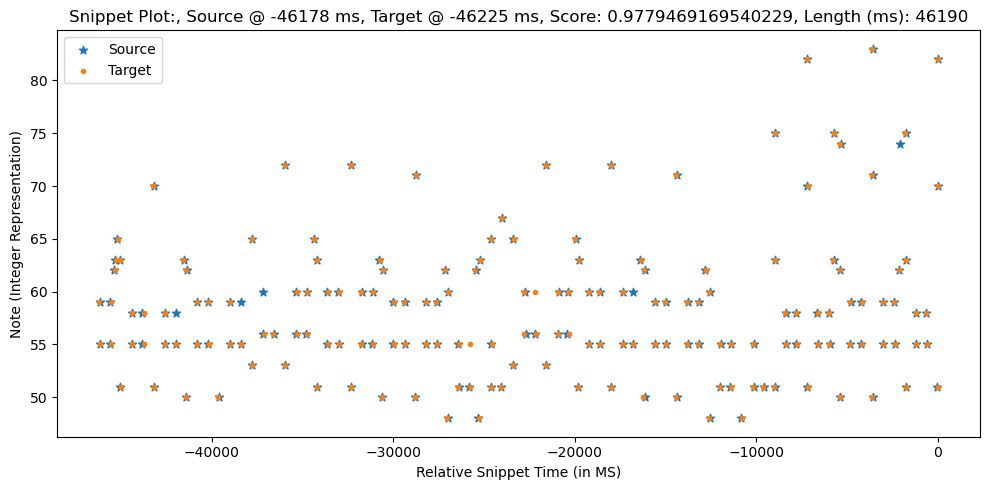

Scores: [ 0.87    0.9925  0.86    0.8625  0.8925  0.9375  0.885   0.98    0.9225
  0.985   0.96    0.795   0.715   0.975   0.9825  0.9475  0.9175  0.995
  0.945   0.9625  0.9825  0.92    0.93    0.9525  0.9175  0.89    0.965
  0.98    0.9425  0.9925  0.955   0.9175  0.84    0.9225  0.9175  0.94
  0.8975  0.9025  0.93    0.9475  0.9325  0.975   0.82    0.84    0.905
  0.905   0.9725  0.995   0.835   0.875   0.935   0.98    0.8275  0.965
  0.88    0.7875  0.7775  0.9475  0.97    0.9925  0.9975  0.99    0.9875
  0.92    0.9775  0.9925  0.96    0.945   0.9     0.94    0.9375 -0.
  0.8525  0.9125  0.955   0.985   0.9225  0.95    0.9875  0.9925  0.985
  0.965   0.8975  0.8425 -0.      0.8375  0.9925  0.96    0.975   0.945
  0.9875  0.82    0.99    0.9825  0.99    0.925   0.9725  0.8525  0.99
  0.9825  0.97    0.945   0.95    0.9025  0.8825  0.7725  0.915   0.9875
  0.98    0.94    0.9875  0.9625  0.91    0.9025  0.8775  0.8925  0.8925
  0.86    0.7925  0.9025  0.9725  0.99    0.93    0.9725 

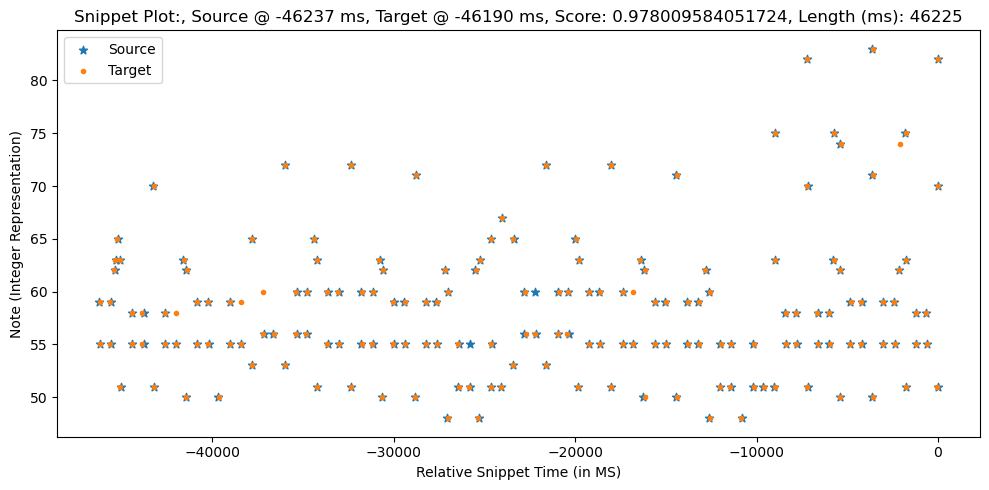

0.978009584051724
Scores: [ 0.9875  0.875   0.855   0.8575  0.8875  0.9325  0.88    0.975   0.9175
  0.955   0.98    0.71    0.79    0.98    0.9875  0.9125  0.9425  1.
 -0.      0.95    0.9675  0.9875  0.935   0.925   0.9475  0.9125  0.895
  0.985   0.97   -0.      0.9475  0.9875  0.95   -0.      0.9125  0.845
  0.9175  0.9125  0.8925  0.935   0.8975  0.925   0.9525  0.97    0.9375
  0.815   0.835   0.9     0.9     0.9675  0.99    0.84    0.88    0.93
  0.975   0.8225  0.97    0.875   0.7825  0.7725  0.9525  0.975   0.9975
  0.9975  0.9825  0.995   0.925   0.9825  0.9975  0.965   0.95    0.935
  0.905   0.9325  0.8575  0.9075  0.95    0.9175  0.99    0.945   0.9925
  0.9975  0.98    0.96    0.9025  0.8475  0.8325  0.955   0.9975  0.97
  0.95    0.815   0.9825  0.995   0.9875  0.995   0.9675  0.93    0.995
  0.8575  0.965   0.9775  0.95    0.955  -0.      0.9075  0.8775  0.7775
  0.92    0.9825  0.985   0.9925  0.945   0.9675  0.915   0.9075  0.8825
  0.8975  0.8975  0.855   0.7975  0.9

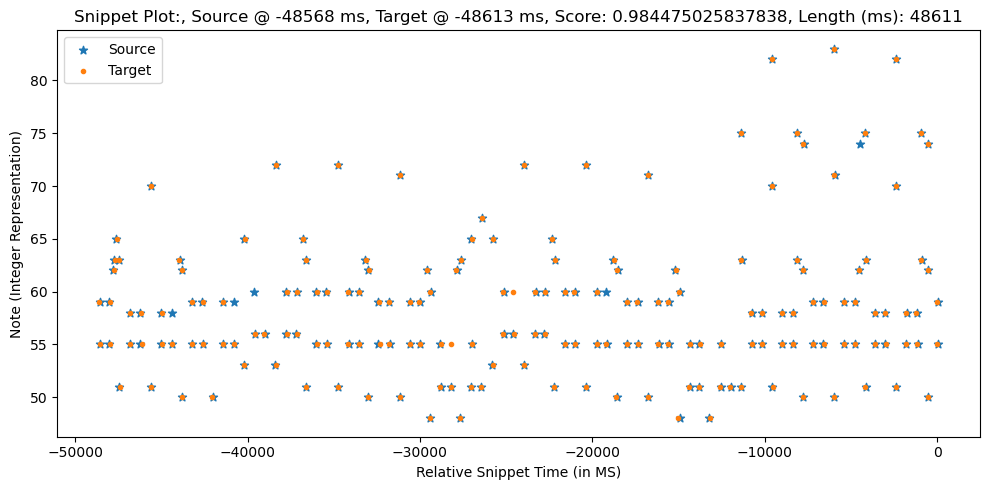

Scores: [ 0.875   0.9875  0.855   0.8575  0.8875  0.9325  0.88    0.975   0.9175
  0.98    0.955   0.79    0.71    0.98    0.9875  0.9425  0.9125  1.
  0.95    0.9675  0.9875  0.925   0.935   0.9475  0.9125  0.895   0.97
  0.985   0.9475  0.9875  0.95    0.9125  0.845   0.9175  0.9125  0.935
  0.8925  0.8975  0.925   0.9525  0.9375  0.97    0.815   0.835   0.9
  0.9     0.9675  0.99    0.84    0.88    0.93    0.975   0.8225  0.97
  0.875   0.7825  0.7725  0.9525  0.975   0.9975  0.9975  0.995   0.9825
  0.925   0.9825  0.9975  0.965   0.95    0.905   0.935   0.9325 -0.
  0.8575  0.9075  0.95    0.99    0.9175  0.945   0.9925  0.9975  0.98
  0.96    0.9025  0.8475 -0.      0.8325  0.9975  0.955   0.97    0.95
  0.9825  0.815   0.995   0.9875  0.995   0.93    0.9675  0.8575  0.995
  0.9775  0.965   0.95    0.955   0.9075  0.8775  0.7775  0.92    0.9825
  0.985   0.945   0.9925  0.9675  0.915   0.9075  0.8825  0.8975  0.8975
  0.855   0.7975  0.9075  0.9775  0.995   0.925   0.9675  0.9   

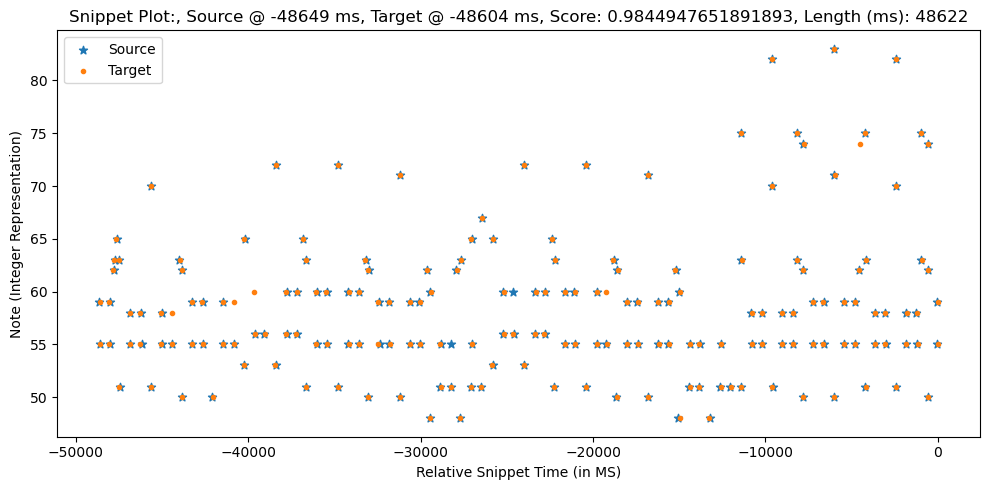

0.9844947651891893
Scores: [ 0.92    0.9225  0.9525  0.9975  0.945   0.96    0.9825  0.98    0.955
  0.775   0.855   0.915   0.9225  0.9775  0.9925  0.935  -0.      0.885
  0.9025  0.9225]
Sequence1:  [[-4197    55    48]
 [-4181    59    29]
 [-3971    62    49]
 [-3895    63    54]
 [-3811    65    59]
 [-3628    63    54]
 [-3611    51    53]
 [-2989    58    36]
 [-2987    55    44]
 [-2431    55    49]
 [-2417    58    44]
 [-1780    70    58]
 [-1769    51    46]
 [-1170    55    45]
 [-1167    58    32]
 [ -563    55    48]
 [ -551    58    39]
 [ -117    63    52]
 [   19    50    42]
 [   31    62    56]]
Sequence2:  [[-4165    55    46]
 [-4150    59    23]
 [-3952    62    43]
 [-3894    63    56]
 [-3789    65    45]
 [-3644    63    49]
 [-3604    51    53]
 [-3005    55    49]
 [-2997    58    34]
 [-2359    58    26]
 [-2341    55    35]
 [-1814    70    53]
 [-1800    51    51]
 [-1170    58    33]
 [-1161    55    42]
 [ -589    55    48]
 [ -163    63    49]
 [  -20  

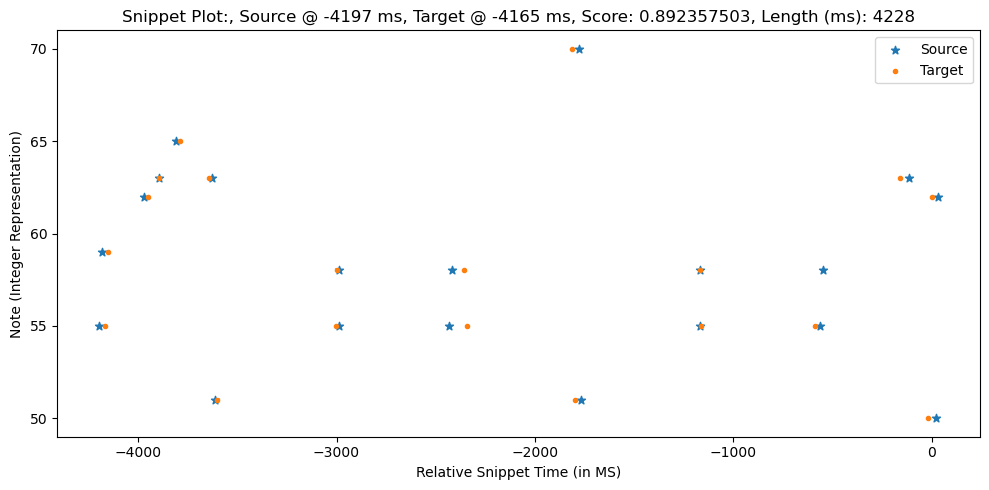

Scores: [0.92   0.9225 0.9525 0.9975 0.945  0.96   0.9825 0.955  0.98   0.855
 0.775  0.915  0.9225 0.9925 0.9775 0.935  0.885  0.9025 0.9225]
Sequence1:  [[-4196    55    46]
 [-4181    59    23]
 [-3983    62    43]
 [-3925    63    56]
 [-3820    65    45]
 [-3675    63    49]
 [-3635    51    53]
 [-3036    55    49]
 [-3028    58    34]
 [-2390    58    26]
 [-2372    55    35]
 [-1845    70    53]
 [-1831    51    51]
 [-1201    58    33]
 [-1192    55    42]
 [ -620    55    48]
 [ -194    63    49]
 [  -51    50    44]
 [  -31    62    54]]
Sequence2:  [[-4228    55    48]
 [-4212    59    29]
 [-4002    62    49]
 [-3926    63    54]
 [-3842    65    59]
 [-3659    63    54]
 [-3642    51    53]
 [-3020    58    36]
 [-3018    55    44]
 [-2462    55    49]
 [-2448    58    44]
 [-1811    70    58]
 [-1800    51    46]
 [-1201    55    45]
 [-1198    58    32]
 [ -594    55    48]
 [ -582    58    39]
 [ -148    63    52]
 [  -12    50    42]
 [    0    62    56]]
mean_offset1

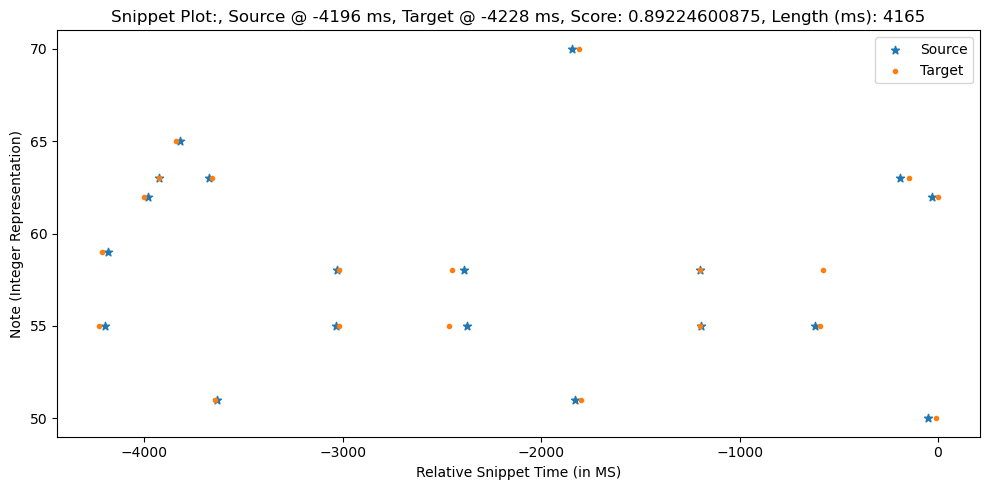

0.892357503
Scores: [ 0.8975  0.9     0.93    0.975   0.9225  0.9825  0.96    0.9975  0.9775
  0.7525  0.8325  0.9375  0.945   0.955   0.985   0.9575 -0.      0.9075
  0.925   0.945   0.8925  0.8825  0.99    0.955   0.8525  0.9425  0.9275]
Sequence1:  [[-6594    55    48]
 [-6578    59    29]
 [-6368    62    49]
 [-6292    63    54]
 [-6208    65    59]
 [-6025    63    54]
 [-6008    51    53]
 [-5386    58    36]
 [-5384    55    44]
 [-4828    55    49]
 [-4814    58    44]
 [-4177    70    58]
 [-4166    51    46]
 [-3567    55    45]
 [-3564    58    32]
 [-2960    55    48]
 [-2948    58    39]
 [-2514    63    52]
 [-2378    50    42]
 [-2366    62    56]
 [-1784    59    46]
 [-1782    55    46]
 [-1189    59    42]
 [-1183    55    48]
 [ -574    50    46]
 [   27    59    39]
 [   29    55    44]]
Sequence2:  [[-6553    55    46]
 [-6538    59    23]
 [-6340    62    43]
 [-6282    63    56]
 [-6177    65    45]
 [-6032    63    49]
 [-5992    51    53]
 [-5393    55    49]


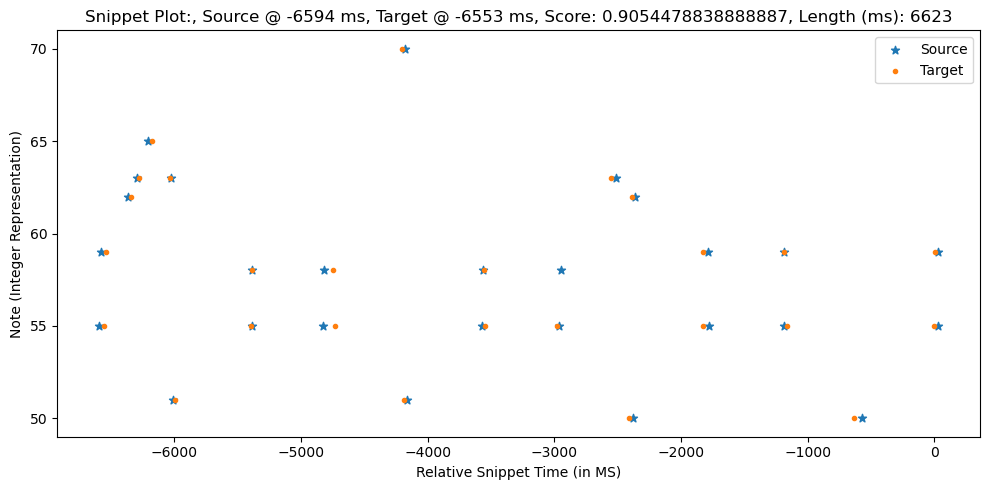

Scores: [0.8975 0.9    0.93   0.975  0.9225 0.9825 0.96   0.9775 0.9975 0.8325
 0.7525 0.9375 0.945  0.985  0.955  0.9575 0.9075 0.925  0.945  0.8825
 0.8925 0.99   0.955  0.8525 0.9275 0.9425]
Sequence1:  [[-6580    55    46]
 [-6565    59    23]
 [-6367    62    43]
 [-6309    63    56]
 [-6204    65    45]
 [-6059    63    49]
 [-6019    51    53]
 [-5420    55    49]
 [-5412    58    34]
 [-4774    58    26]
 [-4756    55    35]
 [-4229    70    53]
 [-4215    51    51]
 [-3585    58    33]
 [-3576    55    42]
 [-3004    55    48]
 [-2578    63    49]
 [-2435    50    44]
 [-2415    62    54]
 [-1856    55    44]
 [-1854    59    42]
 [-1212    59    41]
 [-1192    55    45]
 [ -660    50    51]
 [  -27    55    44]
 [  -23    59    40]]
Sequence2:  [[-6621    55    48]
 [-6605    59    29]
 [-6395    62    49]
 [-6319    63    54]
 [-6235    65    59]
 [-6052    63    54]
 [-6035    51    53]
 [-5413    58    36]
 [-5411    55    44]
 [-4855    55    49]
 [-4841    58    44]
 [-4

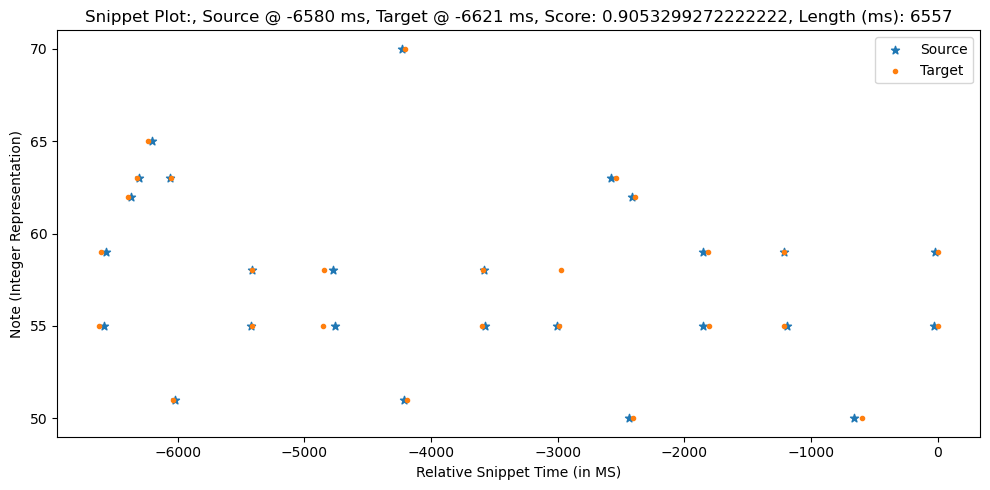

0.9054478838888887
Scores: [ 0.8975  0.9     0.93    0.975   0.9225  0.9825  0.96    0.9975  0.9775
  0.7525  0.8325  0.9375  0.945   0.955   0.985   0.9575 -0.      0.9075
  0.925   0.945   0.8925  0.8825  0.99    0.955   0.8525  0.9425  0.9275
 -0.      0.905   0.97    0.9925  0.      0.955 ]
Sequence1:  [[-8464    55    48]
 [-8448    59    29]
 [-8238    62    49]
 [-8162    63    54]
 [-8078    65    59]
 [-7895    63    54]
 [-7878    51    53]
 [-7256    58    36]
 [-7254    55    44]
 [-6698    55    49]
 [-6684    58    44]
 [-6047    70    58]
 [-6036    51    46]
 [-5437    55    45]
 [-5434    58    32]
 [-4830    55    48]
 [-4818    58    39]
 [-4384    63    52]
 [-4248    50    42]
 [-4236    62    56]
 [-3654    59    46]
 [-3652    55    46]
 [-3059    59    42]
 [-3053    55    48]
 [-2444    50    46]
 [-1843    59    39]
 [-1841    55    44]
 [-1235    59    34]
 [-1219    55    41]
 [ -636    53    47]
 [ -633    65    54]
 [  -45    60    34]
 [  -18    56    44]

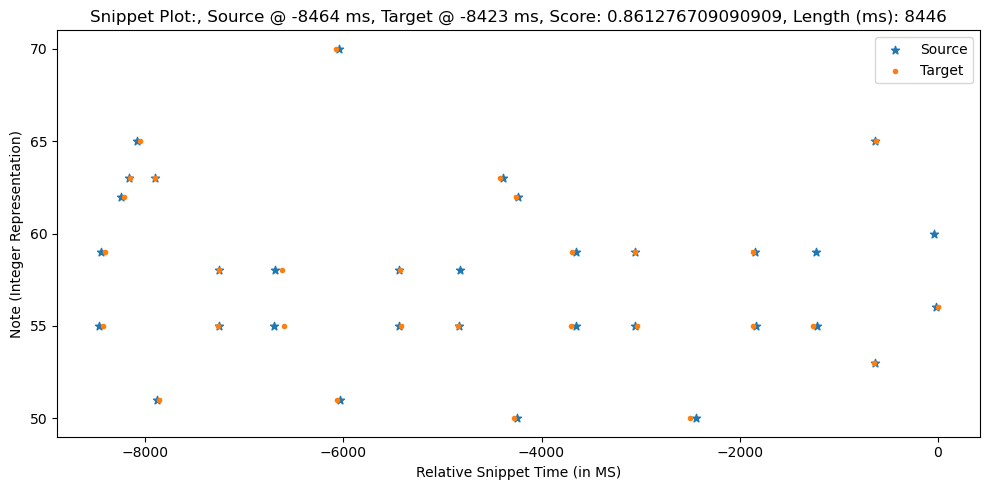

Scores: [0.8975 0.9    0.93   0.975  0.9225 0.9825 0.96   0.9775 0.9975 0.8325
 0.7525 0.9375 0.945  0.985  0.955  0.9575 0.9075 0.925  0.945  0.8825
 0.8925 0.99   0.955  0.8525 0.9275 0.9425 0.905  0.97   0.9925 0.955 ]
Sequence1:  [[-8405    55    46]
 [-8390    59    23]
 [-8192    62    43]
 [-8134    63    56]
 [-8029    65    45]
 [-7884    63    49]
 [-7844    51    53]
 [-7245    55    49]
 [-7237    58    34]
 [-6599    58    26]
 [-6581    55    35]
 [-6054    70    53]
 [-6040    51    51]
 [-5410    58    33]
 [-5401    55    42]
 [-4829    55    48]
 [-4403    63    49]
 [-4260    50    44]
 [-4240    62    54]
 [-3681    55    44]
 [-3679    59    42]
 [-3037    59    41]
 [-3017    55    45]
 [-2485    50    51]
 [-1852    55    44]
 [-1848    59    40]
 [-1239    55    47]
 [ -630    53    43]
 [ -612    65    49]
 [   18    56    41]]
Sequence2:  [[-8446    55    48]
 [-8430    59    29]
 [-8220    62    49]
 [-8144    63    54]
 [-8060    65    59]
 [-7877    63    5

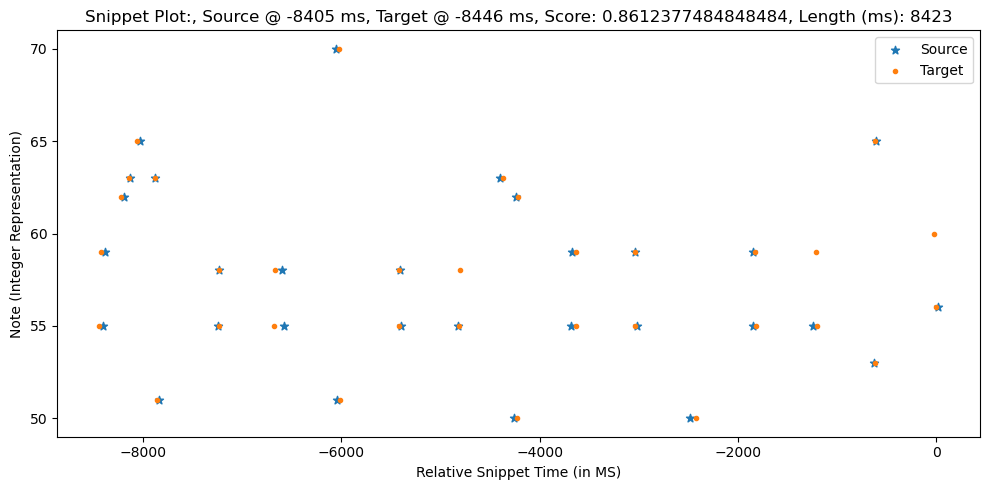

0.861276709090909
Scores: [ 0.8975  0.9     0.93    0.975   0.9225  0.9825  0.96    0.9975  0.9775
  0.7525  0.8325  0.9375  0.945   0.955   0.985   0.9575 -0.      0.9075
  0.925   0.945   0.8925  0.8825  0.99    0.955   0.8525  0.9425  0.9275
 -0.      0.905   0.97    0.9925 -0.      0.955   0.8025  0.96    0.955
  0.935   0.9775]
Sequence1:  [[-10282     55     48]
 [-10266     59     29]
 [-10056     62     49]
 [ -9980     63     54]
 [ -9896     65     59]
 [ -9713     63     54]
 [ -9696     51     53]
 [ -9074     58     36]
 [ -9072     55     44]
 [ -8516     55     49]
 [ -8502     58     44]
 [ -7865     70     58]
 [ -7854     51     46]
 [ -7255     55     45]
 [ -7252     58     32]
 [ -6648     55     48]
 [ -6636     58     39]
 [ -6202     63     52]
 [ -6066     50     42]
 [ -6054     62     56]
 [ -5472     59     46]
 [ -5470     55     46]
 [ -4877     59     42]
 [ -4871     55     48]
 [ -4262     50     46]
 [ -3661     59     39]
 [ -3659     55     44]
 [ -3

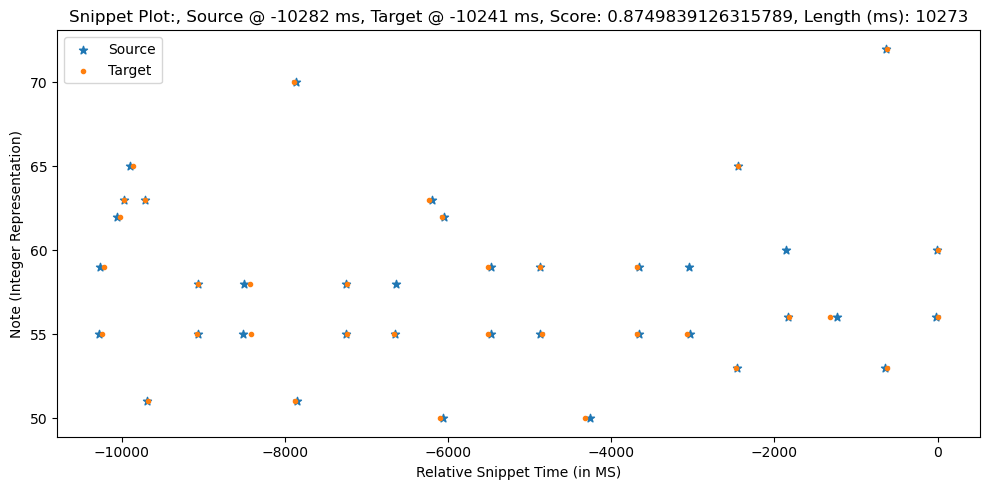

Scores: [0.8975 0.9    0.93   0.975  0.9225 0.9825 0.96   0.9775 0.9975 0.8325
 0.7525 0.9375 0.945  0.985  0.955  0.9575 0.9075 0.925  0.945  0.8825
 0.8925 0.99   0.955  0.8525 0.9275 0.9425 0.905  0.97   0.9925 0.955
 0.8025 0.96   0.955  0.9775 0.935 ]
Sequence1:  [[-10221     55     46]
 [-10206     59     23]
 [-10008     62     43]
 [ -9950     63     56]
 [ -9845     65     45]
 [ -9700     63     49]
 [ -9660     51     53]
 [ -9061     55     49]
 [ -9053     58     34]
 [ -8415     58     26]
 [ -8397     55     35]
 [ -7870     70     53]
 [ -7856     51     51]
 [ -7226     58     33]
 [ -7217     55     42]
 [ -6645     55     48]
 [ -6219     63     49]
 [ -6076     50     44]
 [ -6056     62     54]
 [ -5497     55     44]
 [ -5495     59     42]
 [ -4853     59     41]
 [ -4833     55     45]
 [ -4301     50     51]
 [ -3668     55     44]
 [ -3664     59     40]
 [ -3055     55     47]
 [ -2446     53     43]
 [ -2428     65     49]
 [ -1798     56     41]
 [ -1293   

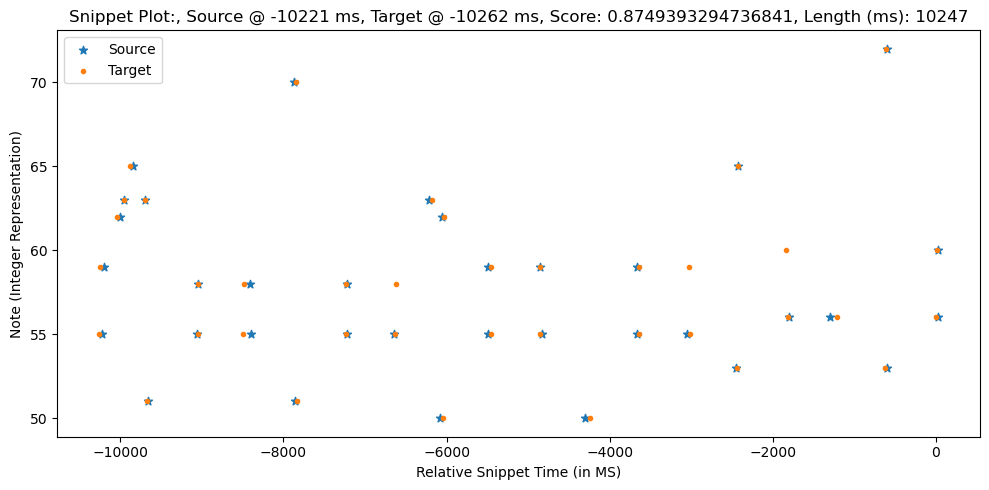

0.8749839126315789
Scores: [ 0.9025  0.905   0.935   0.98    0.9275  0.9775  0.965   0.9975  0.9725
  0.7575  0.8375  0.9325  0.94    0.96    0.99    0.9525 -0.      0.9025
  0.92    0.94    0.8875  0.8775  0.995   0.96    0.8475  0.9375  0.9225
 -0.      0.9     0.965   0.9975 -0.      0.96    0.7975  0.965   0.96
  0.94    0.9825  0.945   0.9725  0.905   0.9825  0.89    0.8625  0.8825
  0.9475  0.9475]
Sequence1:  [[-12629     55     48]
 [-12613     59     29]
 [-12403     62     49]
 [-12327     63     54]
 [-12243     65     59]
 [-12060     63     54]
 [-12043     51     53]
 [-11421     58     36]
 [-11419     55     44]
 [-10863     55     49]
 [-10849     58     44]
 [-10212     70     58]
 [-10201     51     46]
 [ -9602     55     45]
 [ -9599     58     32]
 [ -8995     55     48]
 [ -8983     58     39]
 [ -8549     63     52]
 [ -8413     50     42]
 [ -8401     62     56]
 [ -7819     59     46]
 [ -7817     55     46]
 [ -7224     59     42]
 [ -7218     55     48]
 [ -

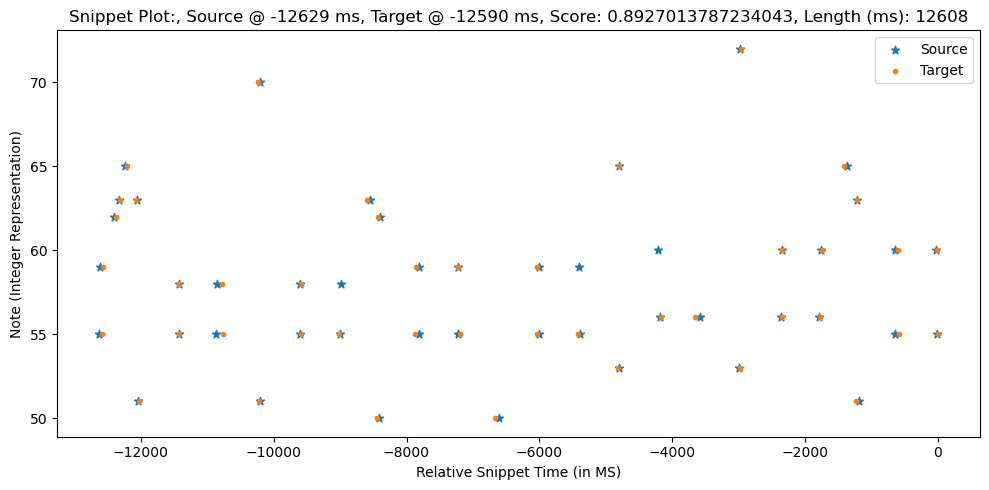

Scores: [0.9025 0.905  0.935  0.98   0.9275 0.9775 0.965  0.9725 0.9975 0.8375
 0.7575 0.9325 0.94   0.99   0.96   0.9525 0.9025 0.92   0.94   0.8775
 0.8875 0.995  0.96   0.8475 0.9225 0.9375 0.9    0.965  0.9975 0.96
 0.7975 0.965  0.96   0.9825 0.94   0.945  0.9725 0.905  0.89   0.9825
 0.8625 0.8825 0.9475 0.9475]
Sequence1:  [[-12569     55     46]
 [-12554     59     23]
 [-12356     62     43]
 [-12298     63     56]
 [-12193     65     45]
 [-12048     63     49]
 [-12008     51     53]
 [-11409     55     49]
 [-11401     58     34]
 [-10763     58     26]
 [-10745     55     35]
 [-10218     70     53]
 [-10204     51     51]
 [ -9574     58     33]
 [ -9565     55     42]
 [ -8993     55     48]
 [ -8567     63     49]
 [ -8424     50     44]
 [ -8404     62     54]
 [ -7845     55     44]
 [ -7843     59     42]
 [ -7201     59     41]
 [ -7181     55     45]
 [ -6649     50     51]
 [ -6016     55     44]
 [ -6012     59     40]
 [ -5403     55     47]
 [ -4794     53     

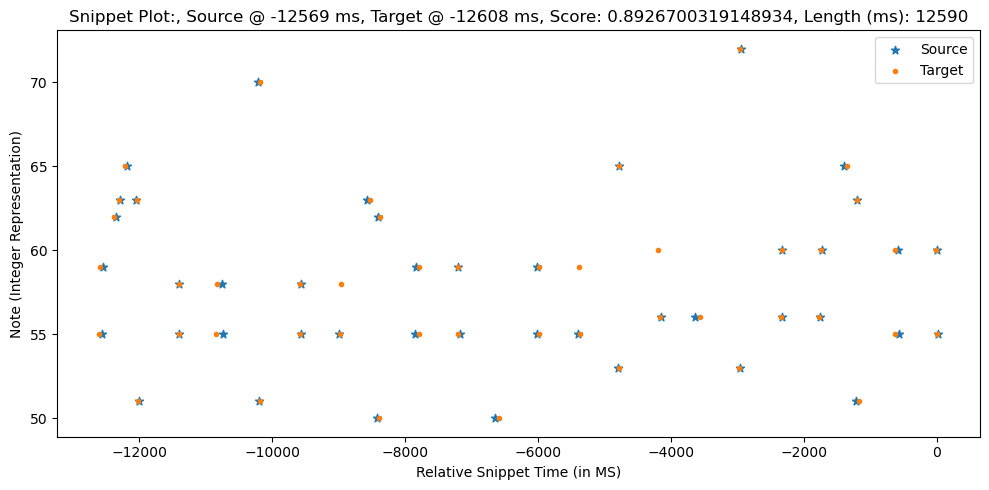

0.8927013787234043
Scores: [ 0.8925  0.895   0.925   0.97    0.9175  0.9875  0.955   0.9925  0.9825
  0.7475  0.8275  0.9425  0.95    0.95    0.98    0.9625 -0.      0.9125
  0.93    0.95    0.8975  0.8875  0.985   0.95    0.8575  0.9475  0.9325
 -0.      0.91    0.975   0.9875 -0.      0.95    0.8075  0.955   0.95
  0.93    0.9725  0.935   0.9625  0.915   0.9925  0.9     0.8525  0.8725
  0.9375  0.9375  0.995   0.9725  0.8025  0.8425  0.9675  0.9875]
Sequence1:  [[-14473     55     48]
 [-14457     59     29]
 [-14247     62     49]
 [-14171     63     54]
 [-14087     65     59]
 [-13904     63     54]
 [-13887     51     53]
 [-13265     58     36]
 [-13263     55     44]
 [-12707     55     49]
 [-12693     58     44]
 [-12056     70     58]
 [-12045     51     46]
 [-11446     55     45]
 [-11443     58     32]
 [-10839     55     48]
 [-10827     58     39]
 [-10393     63     52]
 [-10257     50     42]
 [-10245     62     56]
 [ -9663     59     46]
 [ -9661     55     46]
 [ -

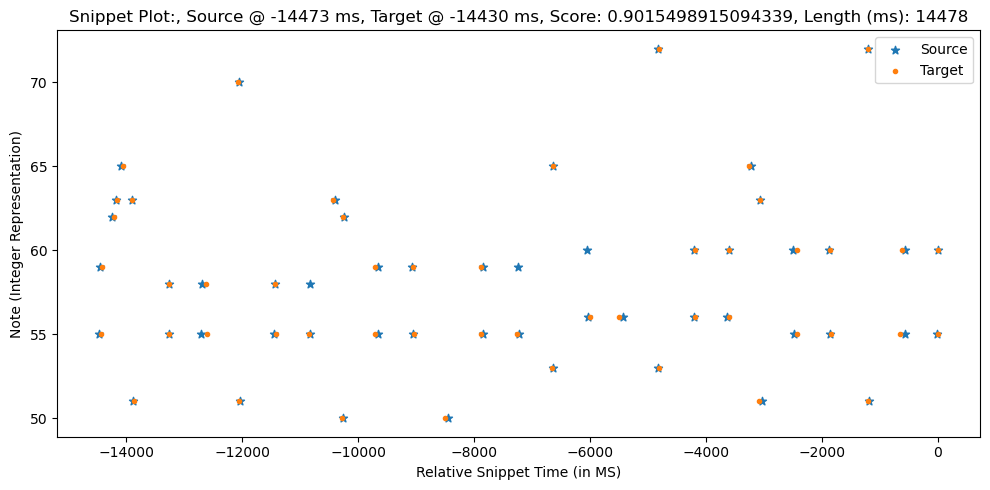

Scores: [0.8925 0.895  0.925  0.97   0.9175 0.9875 0.955  0.9825 0.9925 0.8275
 0.7475 0.9425 0.95   0.98   0.95   0.9625 0.9125 0.93   0.95   0.8875
 0.8975 0.985  0.95   0.8575 0.9325 0.9475 0.91   0.975  0.9875 0.95
 0.8075 0.955  0.95   0.9725 0.93   0.935  0.9625 0.915  0.9    0.9925
 0.8525 0.8725 0.9375 0.9375 0.995  0.9725 0.8025 0.8425 0.9675 0.9875]
Sequence1:  [[-14435     55     46]
 [-14420     59     23]
 [-14222     62     43]
 [-14164     63     56]
 [-14059     65     45]
 [-13914     63     49]
 [-13874     51     53]
 [-13275     55     49]
 [-13267     58     34]
 [-12629     58     26]
 [-12611     55     35]
 [-12084     70     53]
 [-12070     51     51]
 [-11440     58     33]
 [-11431     55     42]
 [-10859     55     48]
 [-10433     63     49]
 [-10290     50     44]
 [-10270     62     54]
 [ -9711     55     44]
 [ -9709     59     42]
 [ -9067     59     41]
 [ -9047     55     45]
 [ -8515     50     51]
 [ -7882     55     44]
 [ -7878     59     40]
 [

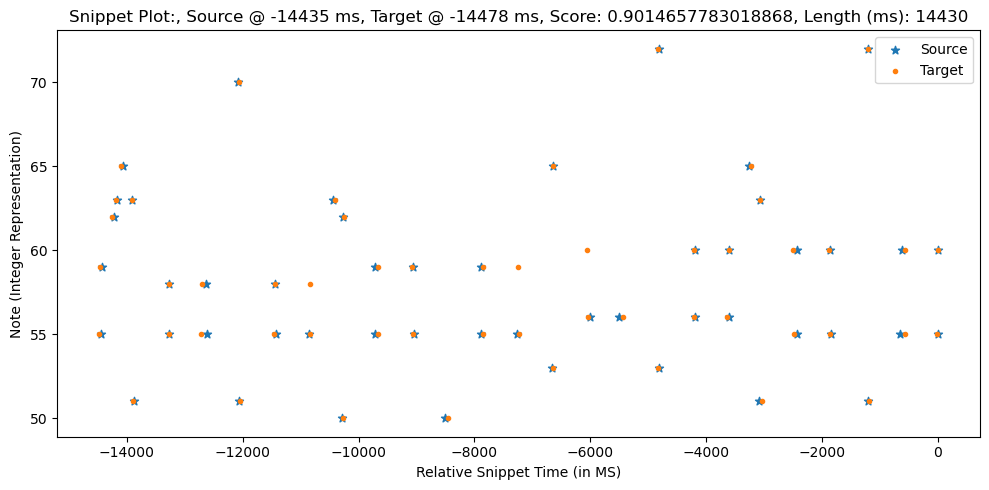

0.9015498915094339
Scores: [ 0.8975  0.9     0.93    0.975   0.9225  0.9825  0.96    0.9975  0.9775
  0.7525  0.8325  0.9375  0.945   0.955   0.985   0.9575 -0.      0.9075
  0.925   0.945   0.8925  0.8825  0.99    0.955   0.8525  0.9425  0.9275
 -0.      0.905   0.97    0.9925 -0.      0.955   0.8025  0.96    0.955
  0.935   0.9775  0.94    0.9675  0.91    0.9875  0.895   0.8575  0.8775
  0.9425  0.9425  0.99    0.9675  0.7975  0.8375  0.9725  0.9825  0.865
  0.9275  0.9175  0.825   0.815   0.91    0.9325]
Sequence1:  [[-16229     55     48]
 [-16213     59     29]
 [-16003     62     49]
 [-15927     63     54]
 [-15843     65     59]
 [-15660     63     54]
 [-15643     51     53]
 [-15021     58     36]
 [-15019     55     44]
 [-14463     55     49]
 [-14449     58     44]
 [-13812     70     58]
 [-13801     51     46]
 [-13202     55     45]
 [-13199     58     32]
 [-12595     55     48]
 [-12583     58     39]
 [-12149     63     52]
 [-12013     50     42]
 [-12001     62    

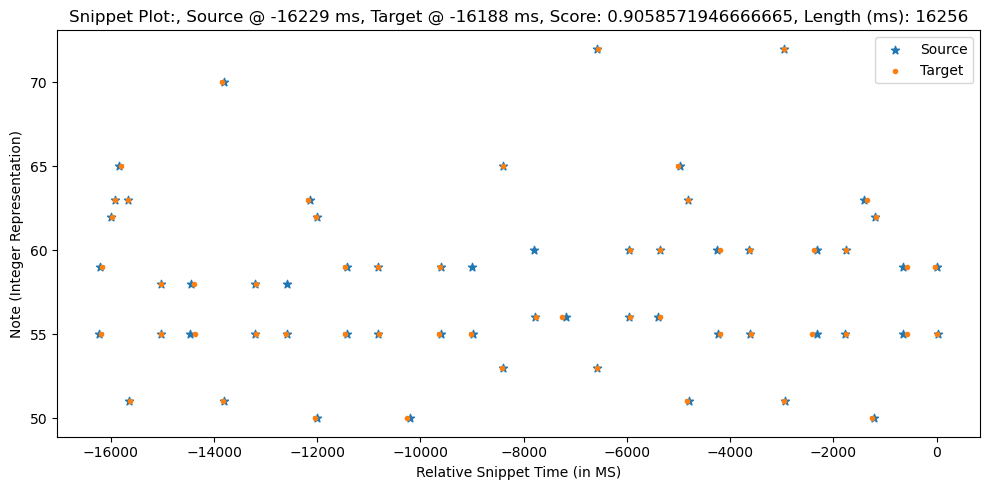

Scores: [0.8975 0.9    0.93   0.975  0.9225 0.9825 0.96   0.9775 0.9975 0.8325
 0.7525 0.9375 0.945  0.985  0.955  0.9575 0.9075 0.925  0.945  0.8825
 0.8925 0.99   0.955  0.8525 0.9275 0.9425 0.905  0.97   0.9925 0.955
 0.8025 0.96   0.955  0.9775 0.935  0.94   0.9675 0.91   0.895  0.9875
 0.8575 0.8775 0.9425 0.9425 0.99   0.9675 0.7975 0.8375 0.9725 0.9825
 0.865  0.9275 0.9175 0.825  0.815  0.91   0.9325]
Sequence1:  [[-16215     55     46]
 [-16200     59     23]
 [-16002     62     43]
 [-15944     63     56]
 [-15839     65     45]
 [-15694     63     49]
 [-15654     51     53]
 [-15055     55     49]
 [-15047     58     34]
 [-14409     58     26]
 [-14391     55     35]
 [-13864     70     53]
 [-13850     51     51]
 [-13220     58     33]
 [-13211     55     42]
 [-12639     55     48]
 [-12213     63     49]
 [-12070     50     44]
 [-12050     62     54]
 [-11491     55     44]
 [-11489     59     42]
 [-10847     59     41]
 [-10827     55     45]
 [-10295     50     51]

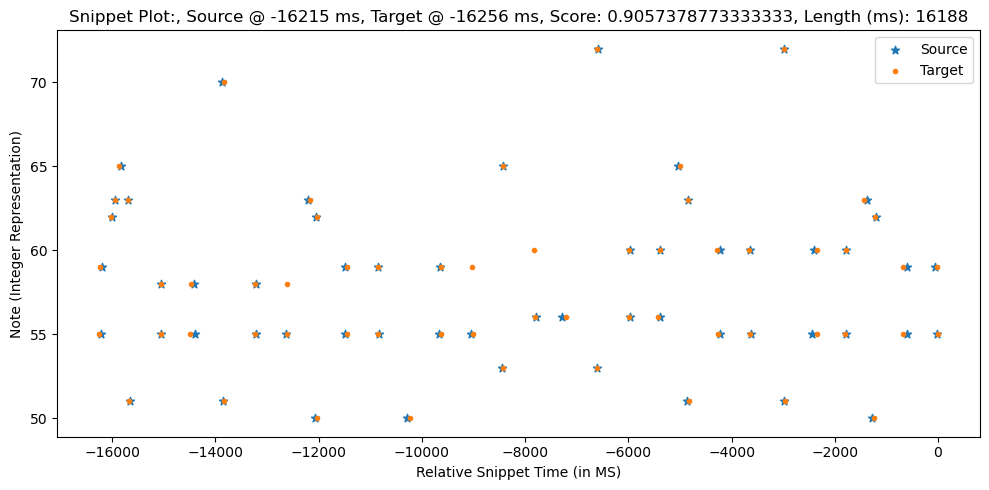

0.9058571946666665
Scores: [ 0.89    0.8925  0.9225  0.9675  0.915   0.99    0.9525  0.99    0.985
  0.745   0.825   0.945   0.9525  0.9475  0.9775  0.965  -0.      0.915
  0.9325  0.9525  0.9     0.89    0.9825  0.9475  0.86    0.95    0.935
 -0.      0.9125  0.9775  0.985  -0.      0.9475  0.81    0.9525  0.9475
  0.9275  0.97    0.9325  0.96    0.9175  0.995   0.9025  0.85    0.87
  0.935   0.935   0.9975  0.975   0.805   0.845   0.965   0.99    0.8575
  0.935   0.91    0.8175  0.8075  0.9175  0.94    0.9625  0.9675  0.9825
  0.96    0.89    0.9475  0.9625  0.93    0.915 ]
Sequence1:  [[-18605     55     48]
 [-18589     59     29]
 [-18379     62     49]
 [-18303     63     54]
 [-18219     65     59]
 [-18036     63     54]
 [-18019     51     53]
 [-17397     58     36]
 [-17395     55     44]
 [-16839     55     49]
 [-16825     58     44]
 [-16188     70     58]
 [-16177     51     46]
 [-15578     55     45]
 [-15575     58     32]
 [-14971     55     48]
 [-14959     58     3

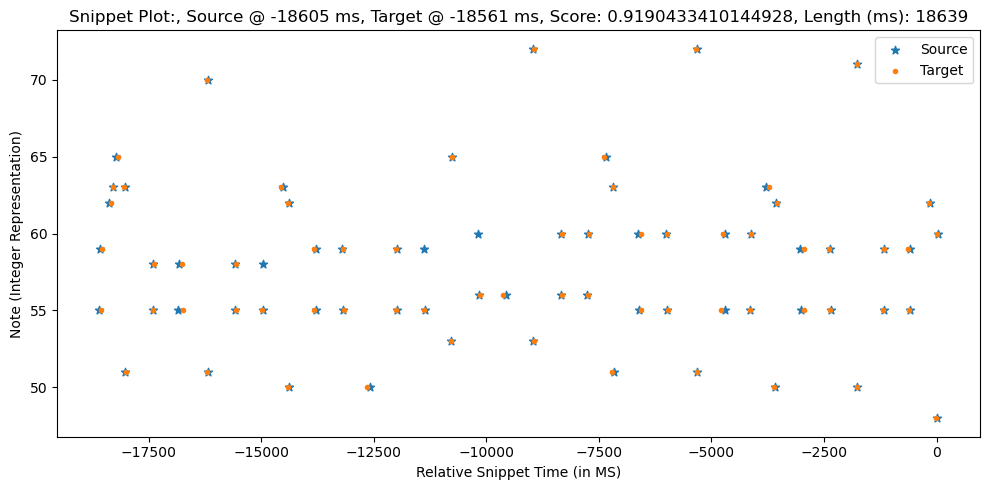

Scores: [0.89   0.8925 0.9225 0.9675 0.915  0.99   0.9525 0.985  0.99   0.825
 0.745  0.945  0.9525 0.9775 0.9475 0.965  0.915  0.9325 0.9525 0.89
 0.9    0.9825 0.9475 0.86   0.935  0.95   0.9125 0.9775 0.985  0.9475
 0.81   0.9525 0.9475 0.97   0.9275 0.9325 0.96   0.9175 0.9025 0.995
 0.85   0.87   0.935  0.935  0.9975 0.975  0.805  0.845  0.965  0.99
 0.8575 0.935  0.91   0.8175 0.8075 0.9175 0.94   0.9625 0.9675 0.96
 0.9825 0.89   0.9475 0.9625 0.93   0.915 ]
Sequence1:  [[-18595     55     46]
 [-18580     59     23]
 [-18382     62     43]
 [-18324     63     56]
 [-18219     65     45]
 [-18074     63     49]
 [-18034     51     53]
 [-17435     55     49]
 [-17427     58     34]
 [-16789     58     26]
 [-16771     55     35]
 [-16244     70     53]
 [-16230     51     51]
 [-15600     58     33]
 [-15591     55     42]
 [-15019     55     48]
 [-14593     63     49]
 [-14450     50     44]
 [-14430     62     54]
 [-13871     55     44]
 [-13869     59     42]
 [-13227     5

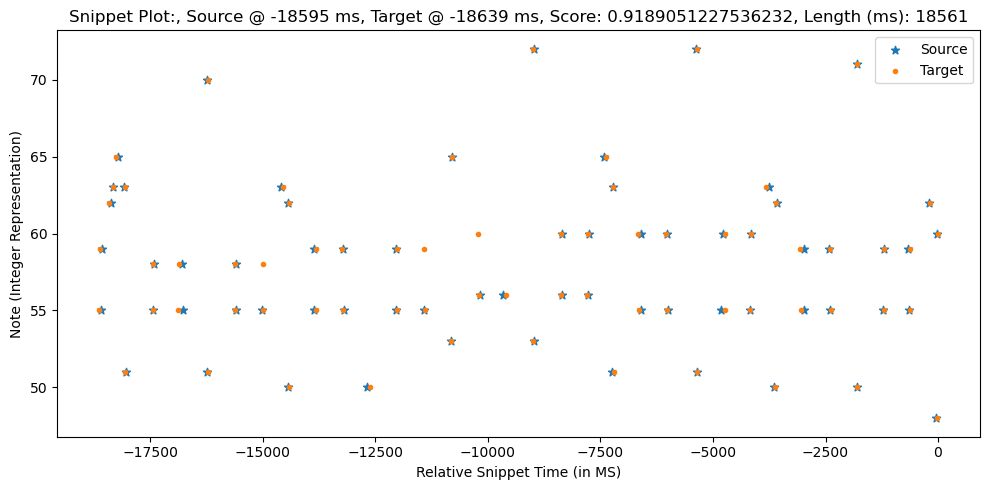

0.9190433410144928
Scores: [ 0.89    0.8925  0.9225  0.9675  0.915   0.99    0.9525  0.99    0.985
  0.745   0.825   0.945   0.9525  0.9475  0.9775  0.965  -0.      0.915
  0.9325  0.9525  0.9     0.89    0.9825  0.9475  0.86    0.95    0.935
 -0.      0.9125  0.9775  0.985  -0.      0.9475  0.81    0.9525  0.9475
  0.9275  0.97    0.9325  0.96    0.9175  0.995   0.9025  0.85    0.87
  0.935   0.935   0.9975  0.975   0.805   0.845   0.965   0.99    0.8575
  0.935   0.91    0.8175  0.8075  0.9175  0.94    0.9625  0.9675  0.9825
  0.96    0.89    0.9475  0.9625  0.93    0.915   0.97    0.87    0.9675
  0.8225  0.9425  0.985 ]
Sequence1:  [[-20391     55     48]
 [-20375     59     29]
 [-20165     62     49]
 [-20089     63     54]
 [-20005     65     59]
 [-19822     63     54]
 [-19805     51     53]
 [-19183     58     36]
 [-19181     55     44]
 [-18625     55     49]
 [-18611     58     44]
 [-17974     70     58]
 [-17963     51     46]
 [-17364     55     45]
 [-17361     58     

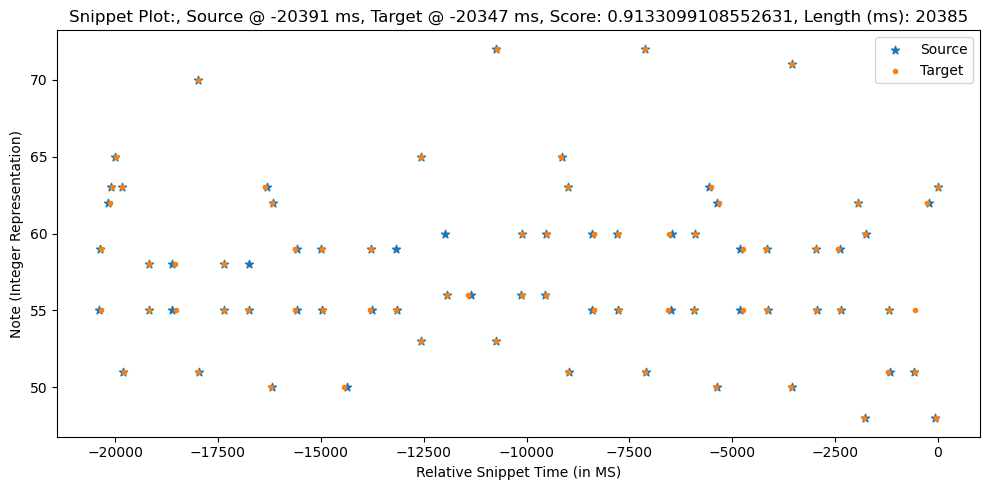

Scores: [ 0.89    0.8925  0.9225  0.9675  0.915   0.99    0.9525  0.985   0.99
  0.825   0.745   0.945   0.9525  0.9775  0.9475  0.965   0.915   0.9325
  0.9525  0.89    0.9     0.9825  0.9475  0.86    0.935   0.95    0.9125
  0.9775  0.985   0.9475  0.81    0.9525  0.9475  0.97    0.9275  0.9325
  0.96    0.9175  0.9025  0.995   0.85    0.87    0.935   0.935   0.9975
  0.975   0.805   0.845   0.965   0.99    0.8575  0.935   0.91    0.8175
  0.8075  0.9175  0.94    0.9625  0.9675  0.96    0.9825  0.89    0.9475
  0.9625  0.93    0.915   0.87    0.97    0.9675 -0.      0.8225  0.9425
  0.985 ]
Sequence1:  [[-20341     55     46]
 [-20326     59     23]
 [-20128     62     43]
 [-20070     63     56]
 [-19965     65     45]
 [-19820     63     49]
 [-19780     51     53]
 [-19181     55     49]
 [-19173     58     34]
 [-18535     58     26]
 [-18517     55     35]
 [-17990     70     53]
 [-17976     51     51]
 [-17346     58     33]
 [-17337     55     42]
 [-16765     55     48]
 [-1

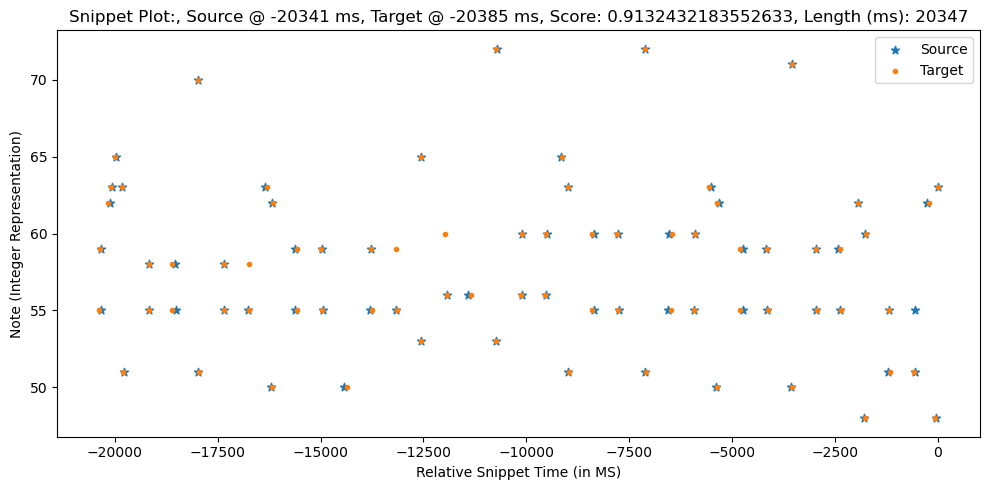

0.9133099108552631
Scores: [ 0.89    0.8925  0.9225  0.9675  0.915   0.99    0.9525  0.99    0.985
  0.745   0.825   0.945   0.9525  0.9475  0.9775  0.965  -0.      0.915
  0.9325  0.9525  0.9     0.89    0.9825  0.9475  0.86    0.95    0.935
 -0.      0.9125  0.9775  0.985  -0.      0.9475  0.81    0.9525  0.9475
  0.9275  0.97    0.9325  0.96    0.9175  0.995   0.9025  0.85    0.87
  0.935   0.935   0.9975  0.975   0.805   0.845   0.965   0.99    0.8575
  0.935   0.91    0.8175  0.8075  0.9175  0.94    0.9625  0.9675  0.9825
  0.96    0.89    0.9475  0.9625  0.93    0.915   0.97    0.87    0.9675
  0.8225  0.9425  0.985   0.9525  0.955   0.98    0.9575  0.9625  0.985
  0.995 ]
Sequence1:  [[-22243     55     48]
 [-22227     59     29]
 [-22017     62     49]
 [-21941     63     54]
 [-21857     65     59]
 [-21674     63     54]
 [-21657     51     53]
 [-21035     58     36]
 [-21033     55     44]
 [-20477     55     49]
 [-20463     58     44]
 [-19826     70     58]
 [-19815    

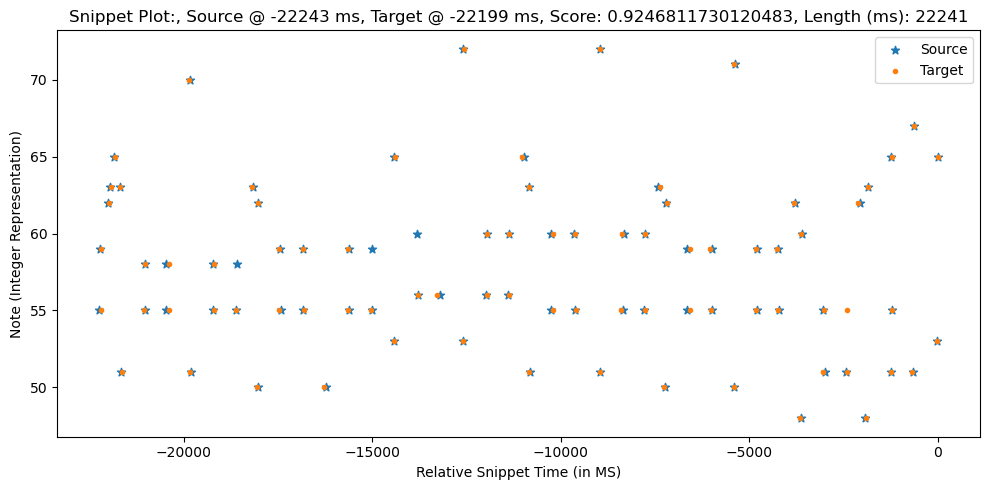

Scores: [ 0.89    0.8925  0.9225  0.9675  0.915   0.99    0.9525  0.985   0.99
  0.825   0.745   0.945   0.9525  0.9775  0.9475  0.965   0.915   0.9325
  0.9525  0.89    0.9     0.9825  0.9475  0.86    0.935   0.95    0.9125
  0.9775  0.985   0.9475  0.81    0.9525  0.9475  0.97    0.9275  0.9325
  0.96    0.9175  0.9025  0.995   0.85    0.87    0.935   0.935   0.9975
  0.975   0.805   0.845   0.965   0.99    0.8575  0.935   0.91    0.8175
  0.8075  0.9175  0.94    0.9625  0.9675  0.96    0.9825  0.89    0.9475
  0.9625  0.93    0.915   0.87    0.97    0.9675 -0.      0.8225  0.9425
  0.985   0.955   0.9525  0.98    0.9575  0.9625  0.985   0.995 ]
Sequence1:  [[-22197     55     46]
 [-22182     59     23]
 [-21984     62     43]
 [-21926     63     56]
 [-21821     65     45]
 [-21676     63     49]
 [-21636     51     53]
 [-21037     55     49]
 [-21029     58     34]
 [-20391     58     26]
 [-20373     55     35]
 [-19846     70     53]
 [-19832     51     51]
 [-19202     58     

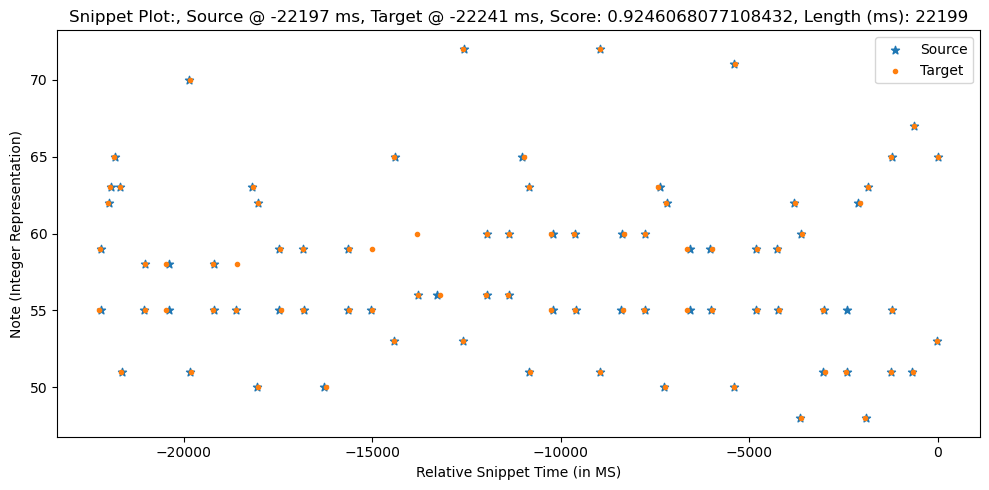

0.9246811730120483
Scores: [ 0.885   0.8875  0.9175  0.9625  0.91    0.995   0.9475  0.985   0.99
  0.74    0.82    0.95    0.9575  0.9425  0.9725  0.97   -0.      0.92
  0.9375  0.9575  0.905   0.895   0.9775  0.9425  0.865   0.955   0.94
 -0.      0.9175  0.9825  0.98   -0.      0.9425  0.815   0.9475  0.9425
  0.9225  0.965   0.9275  0.955   0.9225  1.      0.9075  0.845   0.865
  0.93    0.93    0.9975  0.98    0.81    0.85    0.96    0.995   0.8525
  0.94    0.905   0.8125  0.8025  0.9225  0.945   0.9675  0.9725  0.9875
  0.965   0.895   0.9525  0.9675  0.935   0.92    0.965   0.875   0.9625
  0.8275  0.9375  0.98    0.9475  0.96    0.975   0.9625  0.9675  0.99
  0.99    0.8725  0.8175  0.8625  0.985   0.9675]
Sequence1:  [[-24048     55     48]
 [-24032     59     29]
 [-23822     62     49]
 [-23746     63     54]
 [-23662     65     59]
 [-23479     63     54]
 [-23462     51     53]
 [-22840     58     36]
 [-22838     55     44]
 [-22282     55     49]
 [-22268     58     44]

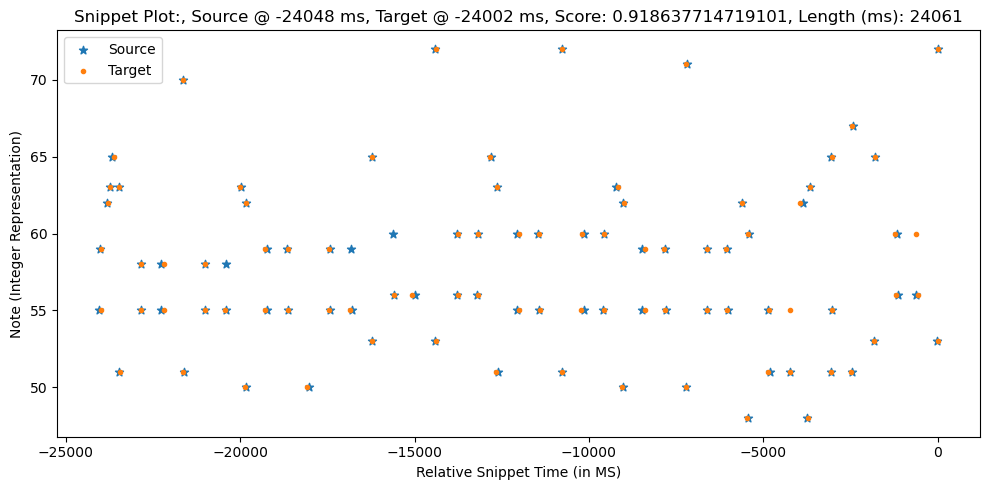

Scores: [ 0.8875  0.89    0.92    0.965   0.9125  0.9925  0.95    0.9875  0.9875
  0.8225  0.7425  0.9475  0.955   0.975   0.945   0.9675  0.9175  0.935
  0.955   0.8925  0.9025  0.98    0.945   0.8625  0.9375  0.9525  0.915
  0.98    0.9825  0.945   0.8125  0.95    0.945   0.9675  0.925   0.93
  0.9575  0.92    0.905   0.9975  0.8475  0.8675  0.9325  0.9325  1.
  0.9775  0.8075  0.8475  0.9625  0.9925  0.855   0.9375  0.9075  0.815
  0.805   0.92    0.9425  0.965   0.97    0.9625  0.985   0.8925  0.95
  0.965   0.9325  0.9175  0.8725  0.9675  0.965  -0.      0.825   0.94
  0.9825  0.9575  0.95    0.9775  0.96    0.965   0.9875  0.9925  0.87
  0.815  -0.      0.865   0.965   0.9875]
Sequence1:  [[-23999     55     46]
 [-23984     59     23]
 [-23786     62     43]
 [-23728     63     56]
 [-23623     65     45]
 [-23478     63     49]
 [-23438     51     53]
 [-22839     55     49]
 [-22831     58     34]
 [-22193     58     26]
 [-22175     55     35]
 [-21648     70     53]
 [-21634

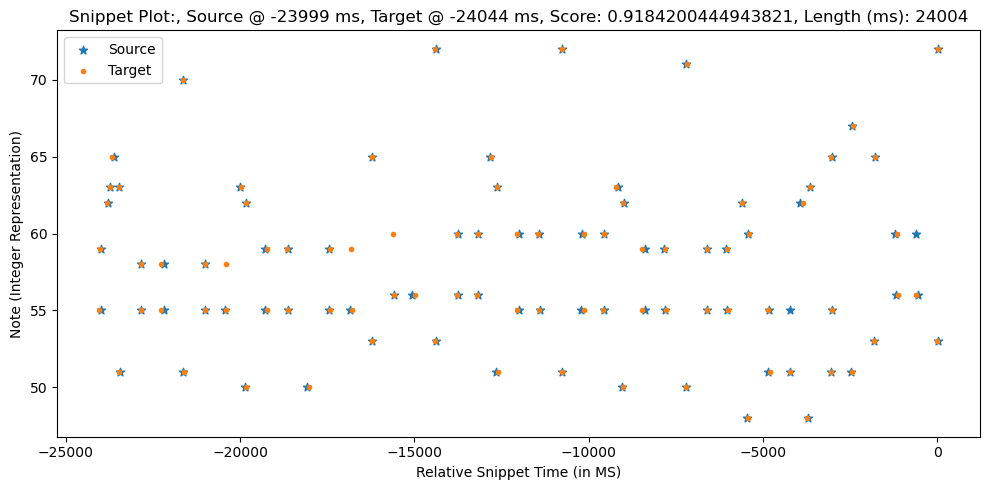

0.918637714719101
Scores: [ 0.8825  0.885   0.915   0.96    0.9075  0.9975  0.945   0.9825  0.9925
  0.7375  0.8175  0.9525  0.96    0.94    0.97    0.9725 -0.      0.9225
  0.94    0.96    0.9075  0.8975  0.975   0.94    0.8675  0.9575  0.9425
 -0.      0.92    0.985   0.9775 -0.      0.94    0.8175  0.945   0.94
  0.92    0.9625  0.925   0.9525  0.925   0.9975  0.91    0.8425  0.8625
  0.9275  0.9275  0.995   0.9825  0.8125  0.8525  0.9575  0.9975  0.85
  0.9425  0.9025  0.81    0.8     0.925   0.9475  0.97    0.975   0.99
  0.9675  0.8975  0.955   0.97    0.9375  0.9225  0.9625  0.8775  0.96
  0.83    0.935   0.9775  0.945   0.9625  0.9725  0.965   0.97    0.9925
  0.9875  0.875   0.82    0.86    0.9825  0.97    0.9975  0.9225  0.8425
  0.99    0.9675  0.96    0.9675  0.995   0.9025]
Sequence1:  [[-26391     55     48]
 [-26375     59     29]
 [-26165     62     49]
 [-26089     63     54]
 [-26005     65     59]
 [-25822     63     54]
 [-25805     51     53]
 [-25183     58     36

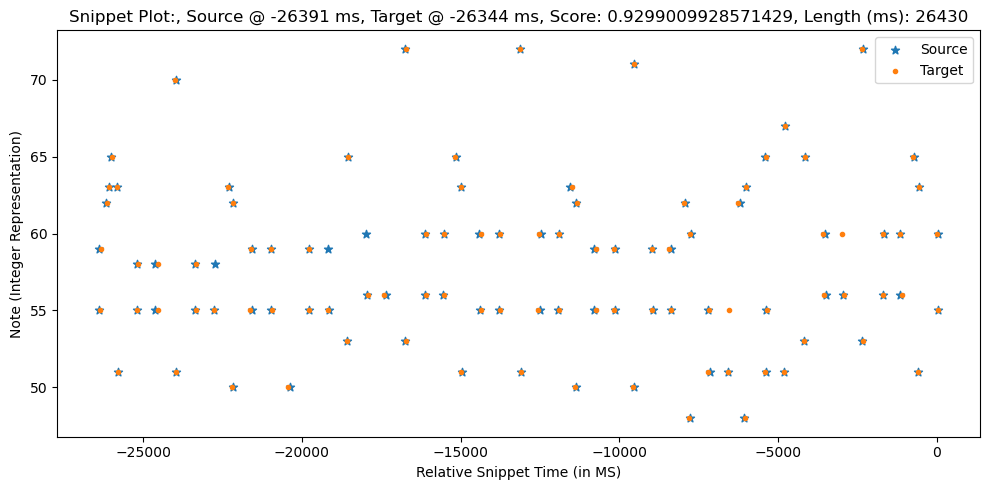

Scores: [ 0.885   0.8875  0.9175  0.9625  0.91    0.995   0.9475  0.99    0.985
  0.82    0.74    0.95    0.9575  0.9725  0.9425  0.97    0.92    0.9375
  0.9575  0.895   0.905   0.9775  0.9425  0.865   0.94    0.955   0.9175
  0.9825  0.98    0.9425  0.815   0.9475  0.9425  0.965   0.9225  0.9275
  0.955   0.9225  0.9075  1.      0.845   0.865   0.93    0.93    0.9975
  0.98    0.81    0.85    0.96    0.995   0.8525  0.94    0.905   0.8125
  0.8025  0.9225  0.945   0.9675  0.9725  0.965   0.9875  0.895   0.9525
  0.9675  0.935   0.92    0.875   0.965   0.9625 -0.      0.8275  0.9375
  0.98    0.96    0.9475  0.975   0.9625  0.9675  0.99    0.99    0.8725
  0.8175 -0.      0.8625  0.9675  0.985   1.      0.92    0.9875  0.845
  0.965   0.9575  0.965   0.9     0.9975]
Sequence1:  [[-26367     55     46]
 [-26352     59     23]
 [-26154     62     43]
 [-26096     63     56]
 [-25991     65     45]
 [-25846     63     49]
 [-25806     51     53]
 [-25207     55     49]
 [-25199     58   

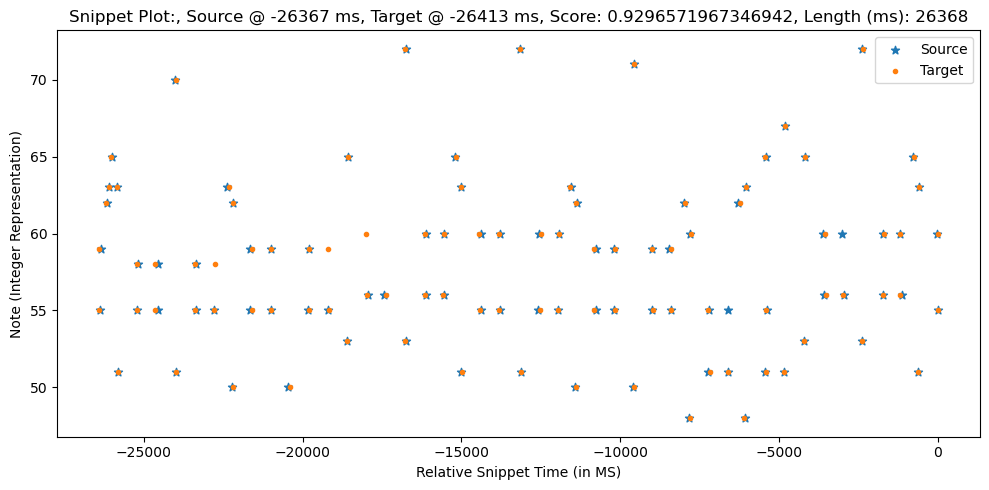

0.9299009928571429
Scores: [ 0.88    0.8825  0.9125  0.9575  0.905   1.      0.9425  0.98    0.995
  0.735   0.815   0.955   0.9625  0.9375  0.9675  0.975  -0.      0.925
  0.9425  0.9625  0.91    0.9     0.9725  0.9375  0.87    0.96    0.945
 -0.      0.9225  0.9875  0.975  -0.      0.9375  0.82    0.9425  0.9375
  0.9175  0.96    0.9225  0.95    0.9275  0.995   0.9125  0.84    0.86
  0.925   0.925   0.9925  0.985   0.815   0.855   0.955   1.      0.8475
  0.945   0.9     0.8075  0.7975  0.9275  0.95    0.9725  0.9775  0.9925
  0.97    0.9     0.9575  0.9725  0.94    0.925   0.96    0.88    0.9575
  0.8325  0.9325  0.975   0.9425  0.965   0.97    0.9675  0.9725  0.995
  0.985   0.8775  0.8225  0.8575  0.98    0.9725  0.995   0.925   0.84
  0.9925  0.97    0.9625  0.97    0.9925  0.905   0.97    0.8325  0.99
  0.9975  0.925   0.93  ]
Sequence1:  [[-28275     55     48]
 [-28259     59     29]
 [-28049     62     49]
 [-27973     63     54]
 [-27889     65     59]
 [-27706     63     54

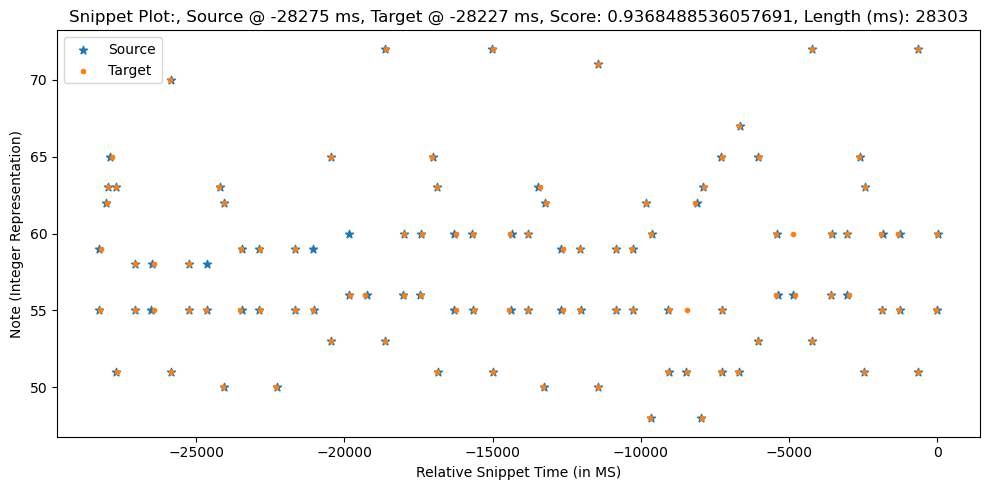

Scores: [ 0.88    0.8825  0.9125  0.9575  0.905   1.      0.9425  0.995   0.98
  0.815   0.735   0.955   0.9625  0.9675  0.9375  0.975   0.925   0.9425
  0.9625  0.9     0.91    0.9725  0.9375  0.87    0.945   0.96    0.9225
  0.9875  0.975   0.9375  0.82    0.9425  0.9375  0.96    0.9175  0.9225
  0.95    0.9275  0.9125  0.995   0.84    0.86    0.925   0.925   0.9925
  0.985   0.815   0.855   0.955   1.      0.8475  0.945   0.9     0.8075
  0.7975  0.9275  0.95    0.9725  0.9775  0.97    0.9925  0.9     0.9575
  0.9725  0.94    0.925   0.88    0.96    0.9575 -0.      0.8325  0.9325
  0.975   0.965   0.9425  0.97    0.9675  0.9725  0.995   0.985   0.8775
  0.8225 -0.      0.8575  0.9725  0.98    0.995   0.925   0.9925  0.84
  0.97    0.9625  0.97    0.905   0.9925  0.8325  0.97    0.9975  0.99
  0.925   0.93  ]
Sequence1:  [[-28255     55     46]
 [-28240     59     23]
 [-28042     62     43]
 [-27984     63     56]
 [-27879     65     45]
 [-27734     63     49]
 [-27694     51     5

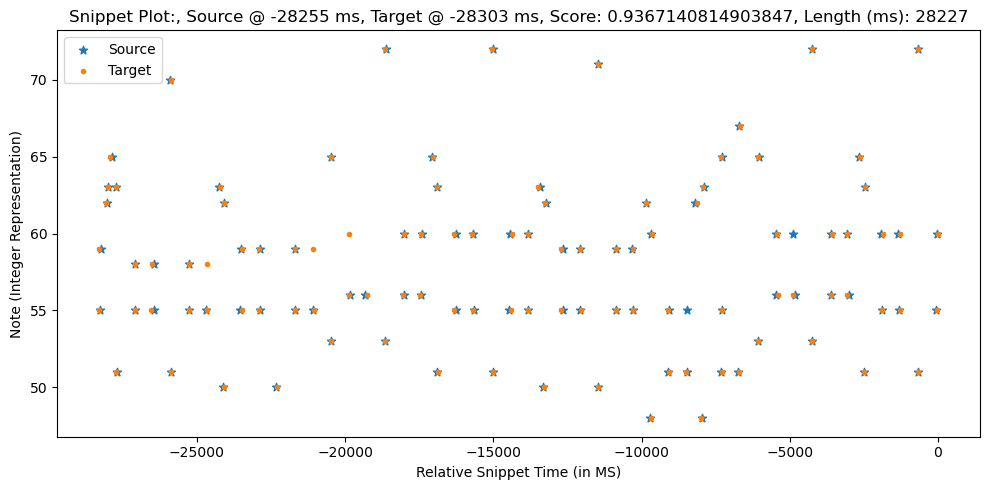

0.9368488536057691
Scores: [ 0.875   0.8775  0.9075  0.9525  0.9     0.995   0.9375  0.975   1.
  0.73    0.81    0.96    0.9675  0.9325  0.9625  0.98   -0.      0.93
  0.9475  0.9675  0.915   0.905   0.9675  0.9325  0.875   0.965   0.95
 -0.      0.9275  0.9925  0.97   -0.      0.9325  0.825   0.9375  0.9325
  0.9125  0.955   0.9175  0.945   0.9325  0.99    0.9175  0.835   0.855
  0.92    0.92    0.9875  0.99    0.82    0.86    0.95    0.995   0.8425
  0.95    0.895   0.8025  0.7925  0.9325  0.955   0.9775  0.9825  0.9975
  0.975   0.905   0.9625  0.9775  0.945   0.93    0.955   0.885   0.9525
  0.8375  0.9275  0.97    0.9375  0.97    0.965   0.9725  0.9775  1.
  0.98    0.8825  0.8275  0.8525  0.975   0.9775  0.99    0.93    0.835
  0.9975  0.975   0.9675  0.975   0.9875  0.91    0.975   0.8375  0.985
  0.9975  0.93    0.935  -0.      0.8875  0.8975  0.7575  0.9     0.9975
  0.965   0.9725  0.925 ]
Sequence1:  [[-30617     55     48]
 [-30601     59     29]
 [-30391     62     49]
 [

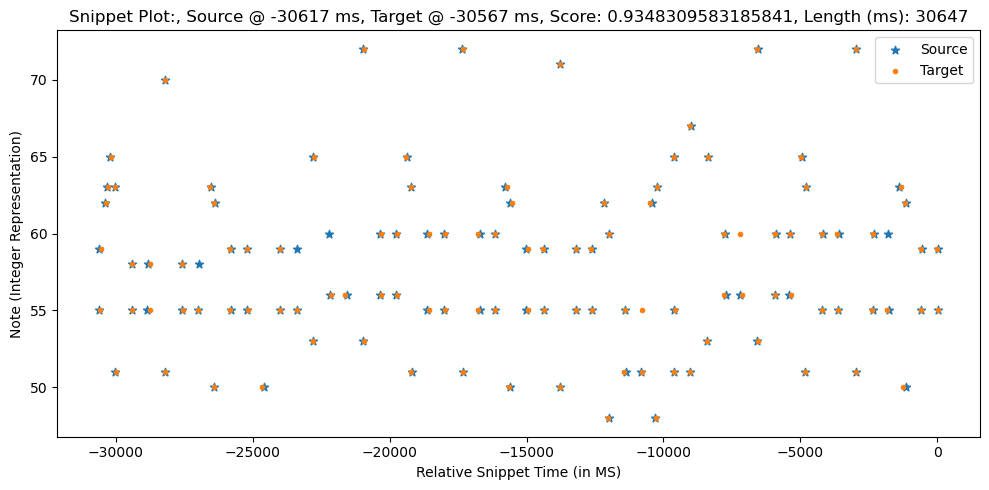

Scores: [ 0.875   0.8775  0.9075  0.9525  0.9     0.995   0.9375  1.      0.975
  0.81    0.73    0.96    0.9675  0.9625  0.9325  0.98    0.93    0.9475
  0.9675  0.905   0.915   0.9675  0.9325  0.875   0.95    0.965   0.9275
  0.9925  0.97    0.9325  0.825   0.9375  0.9325  0.955   0.9125  0.9175
  0.945   0.9325  0.9175  0.99    0.835   0.855   0.92    0.92    0.9875
  0.99    0.82    0.86    0.95    0.995   0.8425  0.95    0.895   0.8025
  0.7925  0.9325  0.955   0.9775  0.9825  0.975   0.9975  0.905   0.9625
  0.9775  0.945   0.93    0.885   0.955   0.9525 -0.      0.8375  0.9275
  0.97    0.97    0.9375  0.965   0.9725  0.9775  1.      0.98    0.8825
  0.8275 -0.      0.8525  0.9775  0.975   0.99    0.93    0.9975  0.835
  0.975   0.9675  0.975   0.91    0.9875  0.8375  0.975   0.9975  0.985
  0.93    0.935   0.8875  0.8975  0.7575  0.9     0.9975  0.965   0.925
  0.9725]
Sequence1:  [[-30589     55     46]
 [-30574     59     23]
 [-30376     62     43]
 [-30318     63     56]
 [

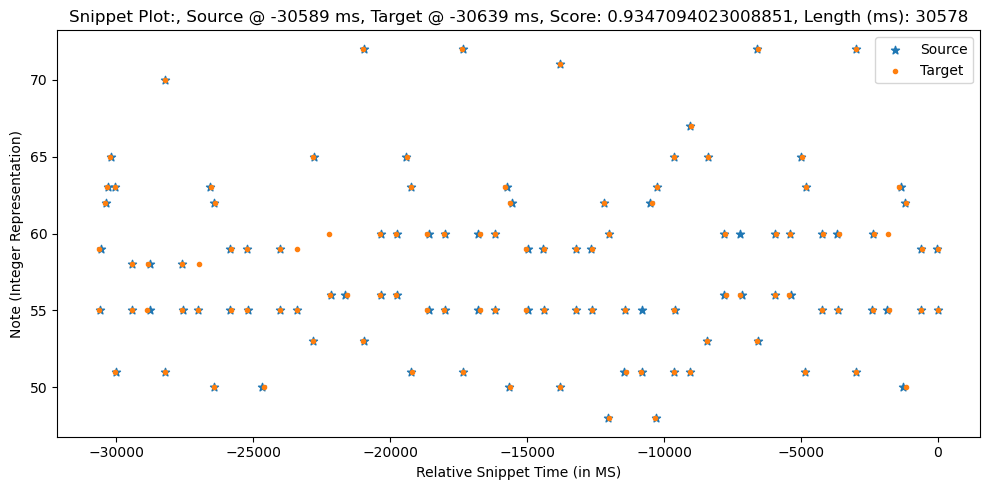

0.9348309583185841
Scores: [ 0.8675  0.87    0.9     0.945   0.8925  0.9875  0.93    0.9675  0.9925
  0.7225  0.8025  0.9675  0.975   0.925   0.955   0.9875 -0.      0.9375
  0.955   0.975   0.9225  0.9125  0.96    0.925   0.8825  0.9725  0.9575
 -0.      0.935   1.      0.9625 -0.      0.925   0.8325  0.93    0.925
  0.905   0.9475  0.91    0.9375  0.94    0.9825  0.925   0.8275  0.8475
  0.9125  0.9125  0.98    0.9975  0.8275  0.8675  0.9425  0.9875  0.835
  0.9575  0.8875  0.795   0.785   0.94    0.9625  0.985   0.99    0.995
  0.9825  0.9125  0.97    0.985   0.9525  0.9375  0.9475  0.8925  0.945
  0.845   0.92    0.9625  0.93    0.9775  0.9575  0.98    0.985   0.9925
  0.9725  0.89    0.835   0.845   0.9675  0.985   0.9825  0.9375  0.8275
  0.995   0.9825  0.975   0.9825  0.98    0.9175  0.9825  0.845   0.9775
  0.99    0.9375  0.9425 -0.      0.895   0.89    0.765   0.9075  0.995
  0.9725  0.98    0.9325  0.955   0.9025  0.895   0.87    0.885   0.885 ]
Sequence1:  [[-32410     55 

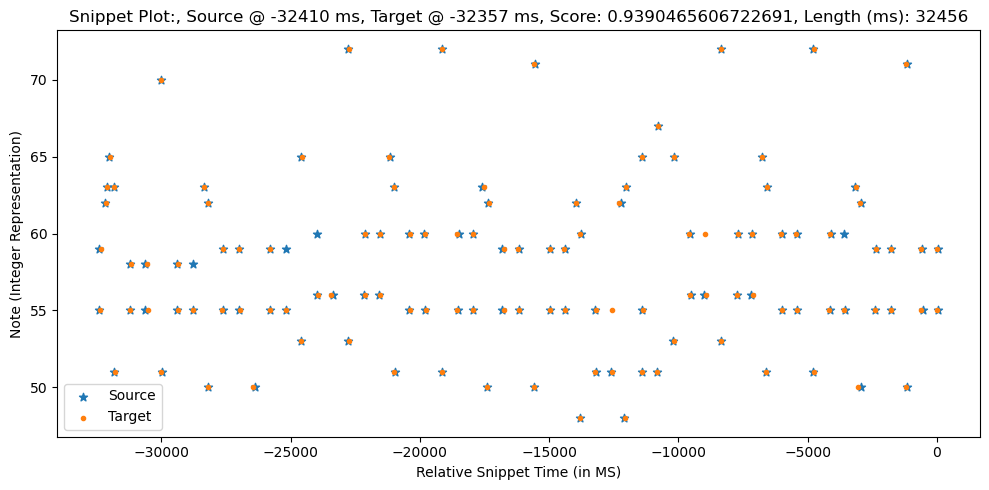

Scores: [ 0.8675  0.87    0.9     0.945   0.8925  0.9875  0.93    0.9925  0.9675
  0.8025  0.7225  0.9675  0.975   0.955   0.925   0.9875  0.9375  0.955
  0.975   0.9125  0.9225  0.96    0.925   0.8825  0.9575  0.9725  0.935
  1.      0.9625  0.925   0.8325  0.93    0.925   0.9475  0.905   0.91
  0.9375  0.94    0.925   0.9825  0.8275  0.8475  0.9125  0.9125  0.98
  0.9975  0.8275  0.8675  0.9425  0.9875  0.835   0.9575  0.8875  0.795
  0.785   0.94    0.9625  0.985   0.99    0.9825  0.995   0.9125  0.97
  0.985   0.9525  0.9375  0.8925  0.9475  0.945  -0.      0.845   0.92
  0.9625  0.9775  0.93    0.9575  0.98    0.985   0.9925  0.9725  0.89
  0.835  -0.      0.845   0.985   0.9675  0.9825  0.9375  0.995   0.8275
  0.9825  0.975   0.9825  0.9175  0.98    0.845   0.9825  0.99    0.9775
  0.9375  0.9425  0.895   0.89    0.765   0.9075  0.995   0.9725  0.9325
  0.98    0.955   0.9025  0.895   0.87    0.885   0.885 ]
Sequence1:  [[-32403     55     46]
 [-32388     59     23]
 [-32190   

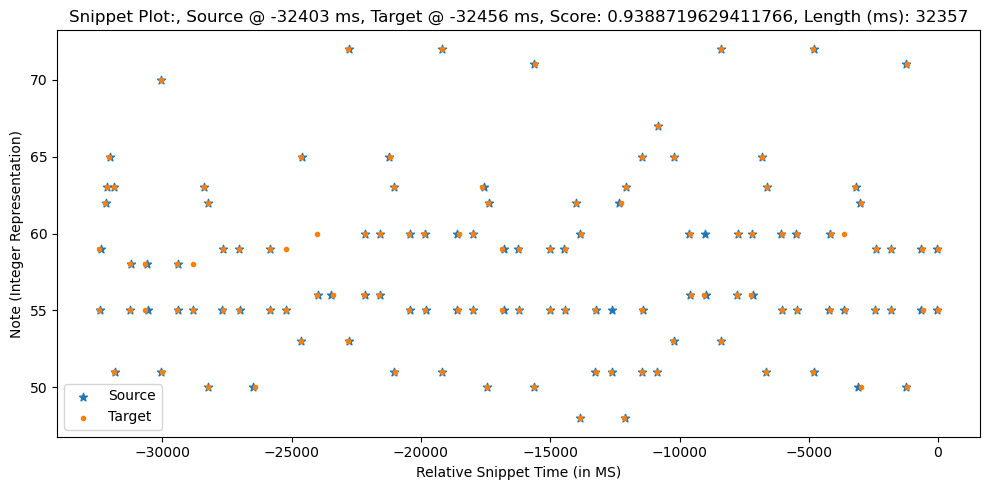

0.9390465606722691
Scores: [ 0.87    0.8725  0.9025  0.9475  0.895   0.99    0.9325  0.97    0.995
  0.725   0.805   0.965   0.9725  0.9275  0.9575  0.985  -0.      0.935
  0.9525  0.9725  0.92    0.91    0.9625  0.9275  0.88    0.97    0.955
 -0.      0.9325  0.9975  0.965  -0.      0.9275  0.83    0.9325  0.9275
  0.9075  0.95    0.9125  0.94    0.9375  0.985   0.9225  0.83    0.85
  0.915   0.915   0.9825  0.995   0.825   0.865   0.945   0.99    0.8375
  0.955   0.89    0.7975  0.7875  0.9375  0.96    0.9825  0.9875  0.9975
  0.98    0.91    0.9675  0.9825  0.95    0.935   0.95    0.89    0.9475
  0.8425  0.9225  0.965   0.9325  0.975   0.96    0.9775  0.9825  0.995
  0.975   0.8875  0.8325  0.8475  0.97    0.9825  0.985   0.935   0.83
  0.9975  0.98    0.9725  0.98    0.9825  0.915   0.98    0.8425  0.98
  0.9925  0.935   0.94   -0.      0.8925  0.8925  0.7625  0.905   0.9975
  0.97    0.9775  0.93    0.9525  0.9     0.8925  0.8675  0.8825  0.8825
  0.87    0.7825  0.8925  0.9625  

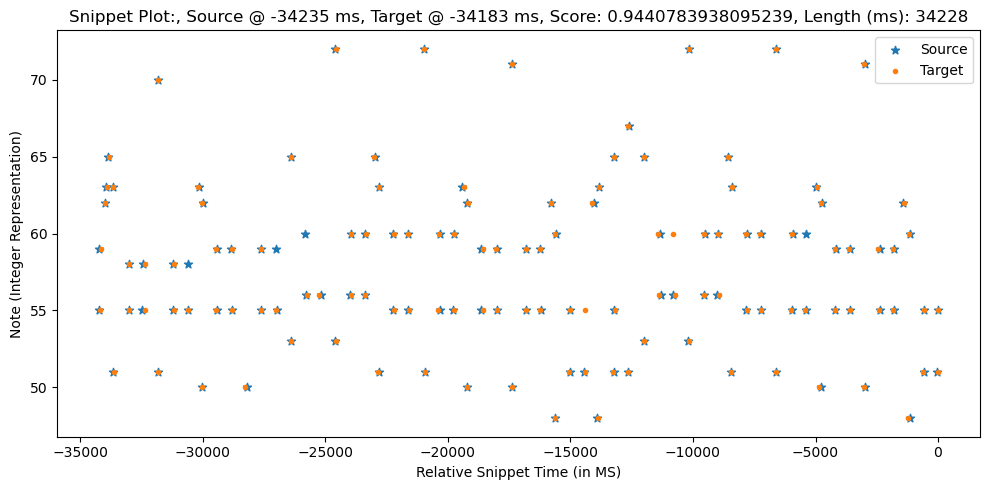

Scores: [ 0.87    0.8725  0.9025  0.9475  0.895   0.99    0.9325  0.995   0.97
  0.805   0.725   0.965   0.9725  0.9575  0.9275  0.985   0.935   0.9525
  0.9725  0.91    0.92    0.9625  0.9275  0.88    0.955   0.97    0.9325
  0.9975  0.965   0.9275  0.83    0.9325  0.9275  0.95    0.9075  0.9125
  0.94    0.9375  0.9225  0.985   0.83    0.85    0.915   0.915   0.9825
  0.995   0.825   0.865   0.945   0.99    0.8375  0.955   0.89    0.7975
  0.7875  0.9375  0.96    0.9825  0.9875  0.98    0.9975  0.91    0.9675
  0.9825  0.95    0.935   0.89    0.95    0.9475 -0.      0.8425  0.9225
  0.965   0.975   0.9325  0.96    0.9775  0.9825  0.995   0.975   0.8875
  0.8325 -0.      0.8475  0.9825  0.97    0.985   0.935   0.9975  0.83
  0.98    0.9725  0.98    0.915   0.9825  0.8425  0.98    0.9925  0.98
  0.935   0.94    0.8925  0.8925  0.7625  0.905   0.9975  0.97    0.93
  0.9775  0.9525  0.9     0.8925  0.8675  0.8825  0.8825  0.87    0.7825
  0.8925  0.9625  0.98    0.94    0.9825]
Sequence1

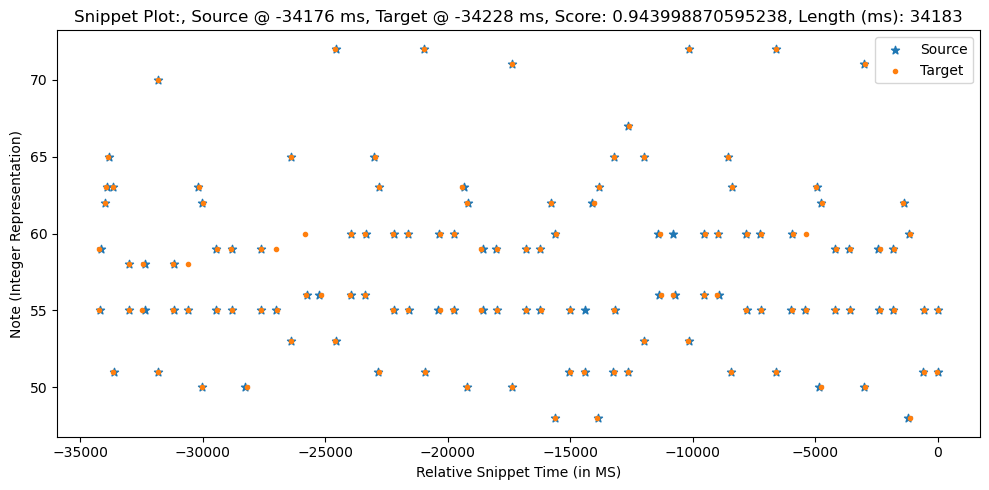

0.9440783938095239
Scores: [ 0.8625  0.865   0.895   0.94    0.8875  0.9825  0.925   0.9625  0.9875
  0.7175  0.7975  0.9725  0.98    0.92    0.95    0.9925 -0.      0.9425
  0.96    0.98    0.9275  0.9175  0.955   0.92    0.8875  0.9775  0.9625
 -0.      0.94    0.995   0.9575 -0.      0.92    0.8375  0.925   0.92
  0.9     0.9425  0.905   0.9325  0.945   0.9775  0.93    0.8225  0.8425
  0.9075  0.9075  0.975   0.9975  0.8325  0.8725  0.9375  0.9825  0.83
  0.9625  0.8825  0.79    0.78    0.945   0.9675  0.99    0.995   0.99
  0.9875  0.9175  0.975   0.99    0.9575  0.9425  0.9425  0.8975  0.94
  0.85    0.915   0.9575  0.925   0.9825  0.9525  0.985   0.99    0.9875
  0.9675  0.895   0.84    0.84    0.9625  0.99    0.9775  0.9425  0.8225
  0.99    0.9875  0.98    0.9875  0.975   0.9225  0.9875  0.85    0.9725
  0.985   0.9425  0.9475 -0.      0.9     0.885   0.77    0.9125  0.99
  0.9775  0.985   0.9375  0.96    0.9075  0.9     0.875   0.89    0.89
  0.8625  0.79    0.9     0.97    0.

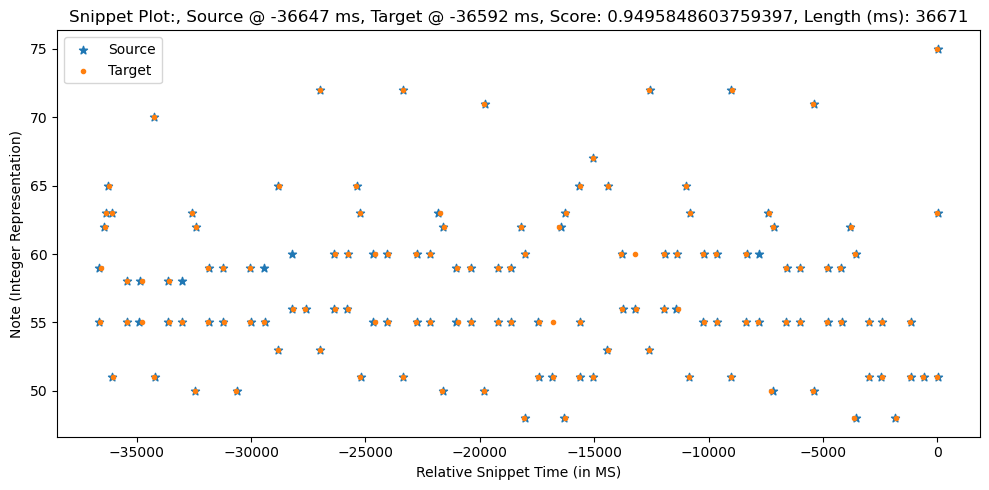

Scores: [ 0.8625  0.865   0.895   0.94    0.8875  0.9825  0.925   0.9875  0.9625
  0.7975  0.7175  0.9725  0.98    0.95    0.92    0.9925  0.9425  0.96
  0.98    0.9175  0.9275  0.955   0.92    0.8875  0.9625  0.9775  0.94
  0.995   0.9575  0.92    0.8375  0.925   0.92    0.9425  0.9     0.905
  0.9325  0.945   0.93    0.9775  0.8225  0.8425  0.9075  0.9075  0.975
  0.9975  0.8325  0.8725  0.9375  0.9825  0.83    0.9625  0.8825  0.79
  0.78    0.945   0.9675  0.99    0.995   0.9875  0.99    0.9175  0.975
  0.99    0.9575  0.9425  0.8975  0.9425  0.94   -0.      0.85    0.915
  0.9575  0.9825  0.925   0.9525  0.985   0.99    0.9875  0.9675  0.895
  0.84   -0.      0.84    0.99    0.9625  0.9775  0.9425  0.99    0.8225
  0.9875  0.98    0.9875  0.9225  0.975   0.85    0.9875  0.985   0.9725
  0.9425  0.9475  0.9     0.885   0.77    0.9125  0.99    0.9775  0.9375
  0.985   0.96    0.9075  0.9     0.875   0.89    0.89    0.8625  0.79
  0.9     0.97    0.9875  0.9325  0.975   0.9075  0.84  

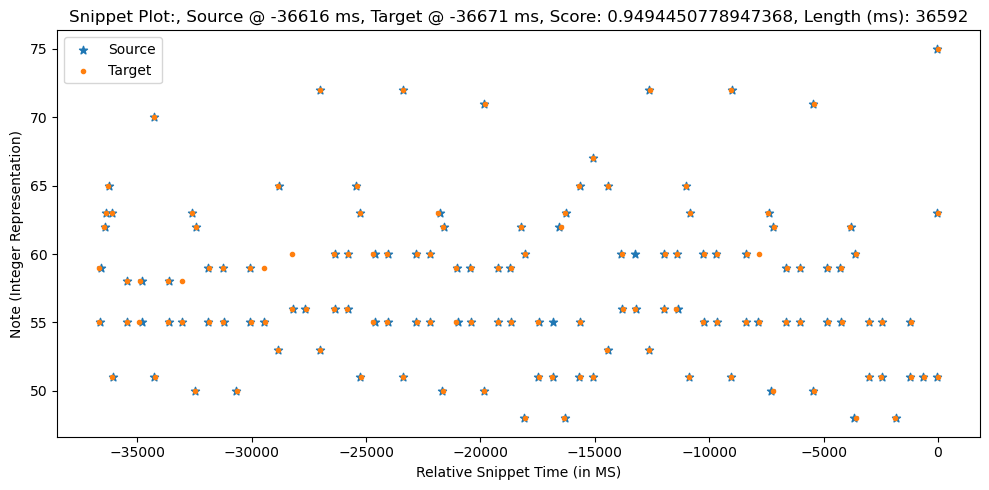

0.9495848603759397
Scores: [ 0.865   0.8675  0.8975  0.9425  0.89    0.985   0.9275  0.965   0.99
  0.72    0.8     0.97    0.9775  0.9225  0.9525  0.99   -0.      0.94
  0.9575  0.9775  0.925   0.915   0.9575  0.9225  0.885   0.975   0.96
 -0.      0.9375  0.9975  0.96   -0.      0.9225  0.835   0.9275  0.9225
  0.9025  0.945   0.9075  0.935   0.9425  0.98    0.9275  0.825   0.845
  0.91    0.91    0.9775  1.      0.83    0.87    0.94    0.985   0.8325
  0.96    0.885   0.7925  0.7825  0.9425  0.965   0.9875  0.9925  0.9925
  0.985   0.915   0.9725  0.9875  0.955   0.94    0.945   0.895   0.9425
  0.8475  0.9175  0.96    0.9275  0.98    0.955   0.9825  0.9875  0.99
  0.97    0.8925  0.8375  0.8425  0.965   0.9875  0.98    0.94    0.825
  0.9925  0.985   0.9775  0.985   0.9775  0.92    0.985   0.8475  0.975
  0.9875  0.94    0.945  -0.      0.8975  0.8875  0.7675  0.91    0.9925
  0.975   0.9825  0.935   0.9575  0.905   0.8975  0.8725  0.8875  0.8875
  0.865   0.7875  0.8975  0.9675  0

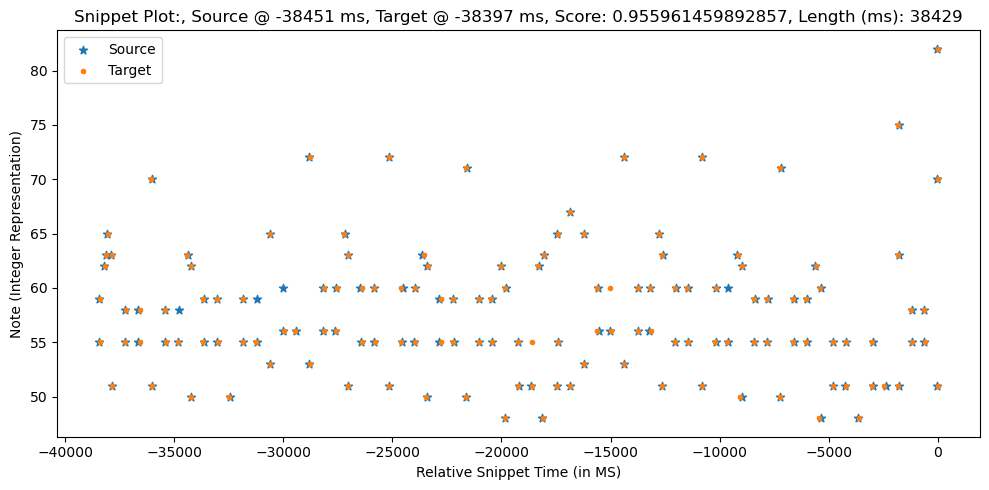

Scores: [ 0.865   0.8675  0.8975  0.9425  0.89    0.985   0.9275  0.99    0.965
  0.8     0.72    0.97    0.9775  0.9525  0.9225  0.99    0.94    0.9575
  0.9775  0.915   0.925   0.9575  0.9225  0.885   0.96    0.975   0.9375
  0.9975  0.96    0.9225  0.835   0.9275  0.9225  0.945   0.9025  0.9075
  0.935   0.9425  0.9275  0.98    0.825   0.845   0.91    0.91    0.9775
  1.      0.83    0.87    0.94    0.985   0.8325  0.96    0.885   0.7925
  0.7825  0.9425  0.965   0.9875  0.9925  0.985   0.9925  0.915   0.9725
  0.9875  0.955   0.94    0.895   0.945   0.9425 -0.      0.8475  0.9175
  0.96    0.98    0.9275  0.955   0.9825  0.9875  0.99    0.97    0.8925
  0.8375 -0.      0.8425  0.9875  0.965   0.98    0.94    0.9925  0.825
  0.985   0.9775  0.985   0.92    0.9775  0.8475  0.985   0.9875  0.975
  0.94    0.945   0.8975  0.8875  0.7675  0.91    0.9925  0.975   0.935
  0.9825  0.9575  0.905   0.8975  0.8725  0.8875  0.8875  0.865   0.7875
  0.8975  0.9675  0.985   0.935   0.9775  0.91 

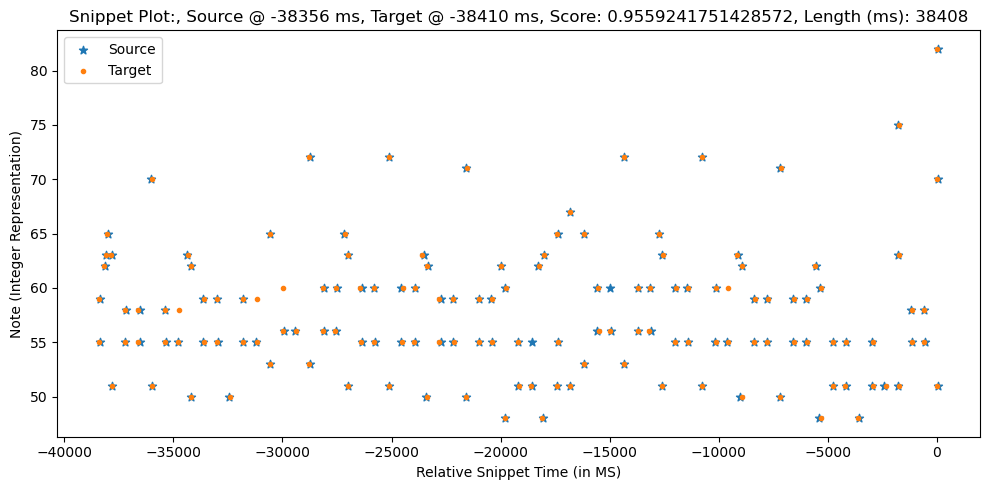

0.955961459892857
Scores: [ 0.8625  0.865   0.895   0.94    0.8875  0.9825  0.925   0.9625  0.9875
  0.7175  0.7975  0.9725  0.98    0.92    0.95    0.9925 -0.      0.9425
  0.96    0.98    0.9275  0.9175  0.955   0.92    0.8875  0.9775  0.9625
 -0.      0.94    0.995   0.9575 -0.      0.92    0.8375  0.925   0.92
  0.9     0.9425  0.905   0.9325  0.945   0.9775  0.93    0.8225  0.8425
  0.9075  0.9075  0.975   0.9975  0.8325  0.8725  0.9375  0.9825  0.83
  0.9625  0.8825  0.79    0.78    0.945   0.9675  0.99    0.995   0.99
  0.9875  0.9175  0.975   0.99    0.9575  0.9425  0.9425  0.8975  0.94
  0.85    0.915   0.9575  0.925   0.9825  0.9525  0.985   0.99    0.9875
  0.9675  0.895   0.84    0.84    0.9625  0.99    0.9775  0.9425  0.8225
  0.99    0.9875  0.98    0.9875  0.975   0.9225  0.9875  0.85    0.9725
  0.985   0.9425  0.9475 -0.      0.9     0.885   0.77    0.9125  0.99
  0.9775  0.985   0.9375  0.96    0.9075  0.9     0.875   0.89    0.89
  0.8625  0.79    0.9     0.97    0.9

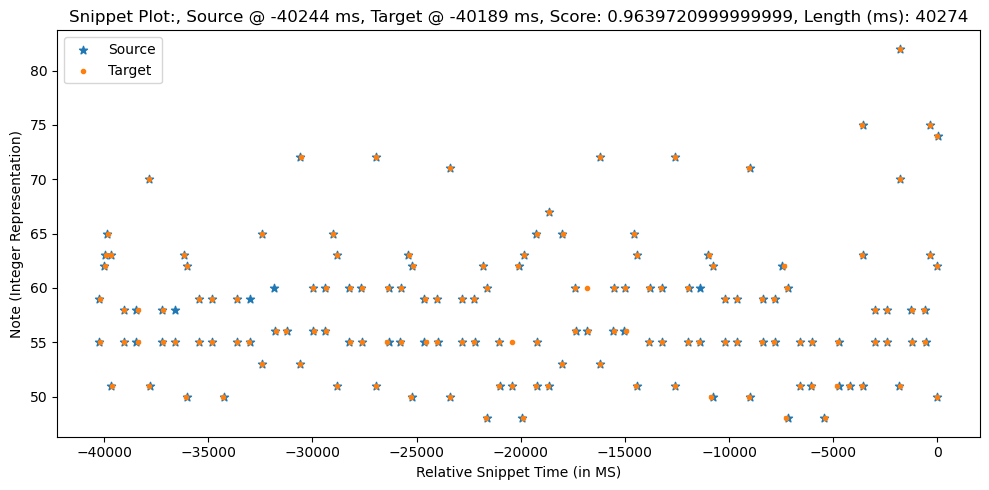

Scores: [ 0.8625  0.865   0.895   0.94    0.8875  0.9825  0.925   0.9875  0.9625
  0.7975  0.7175  0.9725  0.98    0.95    0.92    0.9925  0.9425  0.96
  0.98    0.9175  0.9275  0.955   0.92    0.8875  0.9625  0.9775  0.94
  0.995   0.9575  0.92    0.8375  0.925   0.92    0.9425  0.9     0.905
  0.9325  0.945   0.93    0.9775  0.8225  0.8425  0.9075  0.9075  0.975
  0.9975  0.8325  0.8725  0.9375  0.9825  0.83    0.9625  0.8825  0.79
  0.78    0.945   0.9675  0.99    0.995   0.9875  0.99    0.9175  0.975
  0.99    0.9575  0.9425  0.8975  0.9425  0.94   -0.      0.85    0.915
  0.9575  0.9825  0.925   0.9525  0.985   0.99    0.9875  0.9675  0.895
  0.84   -0.      0.84    0.99    0.9625  0.9775  0.9425  0.99    0.8225
  0.9875  0.98    0.9875  0.9225  0.975   0.85    0.9875  0.985   0.9725
  0.9425  0.9475  0.9     0.885   0.77    0.9125  0.99    0.9775  0.9375
  0.985   0.96    0.9075  0.9     0.875   0.89    0.89    0.8625  0.79
  0.9     0.97    0.9875  0.9325  0.975   0.9075  0.84  

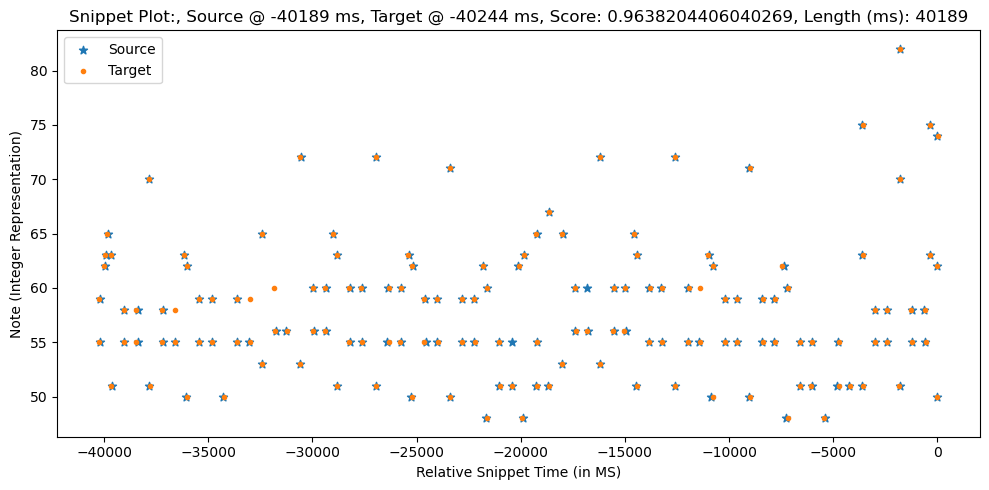

0.9639720999999999
Scores: [ 0.86    0.8625  0.8925  0.9375  0.885   0.98    0.9225  0.96    0.985
  0.715   0.795   0.975   0.9825  0.9175  0.9475  0.995  -0.      0.945
  0.9625  0.9825  0.93    0.92    0.9525  0.9175  0.89    0.98    0.965
 -0.      0.9425  0.9925  0.955  -0.      0.9175  0.84    0.9225  0.9175
  0.8975  0.94    0.9025  0.93    0.9475  0.975   0.9325  0.82    0.84
  0.905   0.905   0.9725  0.995   0.835   0.875   0.935   0.98    0.8275
  0.965   0.88    0.7875  0.7775  0.9475  0.97    0.9925  0.9975  0.9875
  0.99    0.92    0.9775  0.9925  0.96    0.945   0.94    0.9     0.9375
  0.8525  0.9125  0.955   0.9225  0.985   0.95    0.9875  0.9925  0.985
  0.965   0.8975  0.8425  0.8375  0.96    0.9925  0.975   0.945   0.82
  0.9875  0.99    0.9825  0.99    0.9725  0.925   0.99    0.8525  0.97
  0.9825  0.945   0.95   -0.      0.9025  0.8825  0.7725  0.915   0.9875
  0.98    0.9875  0.94    0.9625  0.91    0.9025  0.8775  0.8925  0.8925
  0.86    0.7925  0.9025  0.9725  

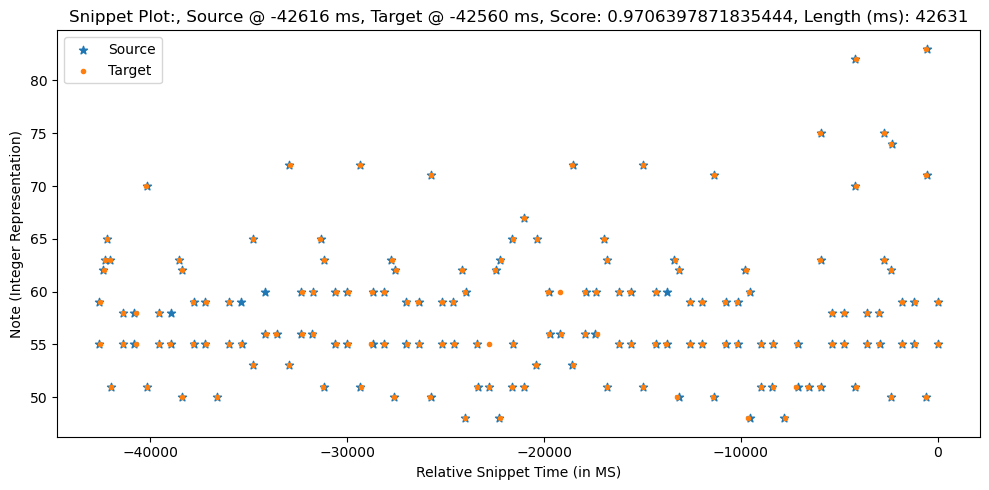

Scores: [ 0.8625  0.865   0.895   0.94    0.8875  0.9825  0.925   0.9875  0.9625
  0.7975  0.7175  0.9725  0.98    0.95    0.92    0.9925  0.9425  0.96
  0.98    0.9175  0.9275  0.955   0.92    0.8875  0.9625  0.9775  0.94
  0.995   0.9575  0.92    0.8375  0.925   0.92    0.9425  0.9     0.905
  0.9325  0.945   0.93    0.9775  0.8225  0.8425  0.9075  0.9075  0.975
  0.9975  0.8325  0.8725  0.9375  0.9825  0.83    0.9625  0.8825  0.79
  0.78    0.945   0.9675  0.99    0.995   0.9875  0.99    0.9175  0.975
  0.99    0.9575  0.9425  0.8975  0.9425  0.94   -0.      0.85    0.915
  0.9575  0.9825  0.925   0.9525  0.985   0.99    0.9875  0.9675  0.895
  0.84   -0.      0.84    0.99    0.9625  0.9775  0.9425  0.99    0.8225
  0.9875  0.98    0.9875  0.9225  0.975   0.85    0.9875  0.985   0.9725
  0.9425  0.9475  0.9     0.885   0.77    0.9125  0.99    0.9775  0.9375
  0.985   0.96    0.9075  0.9     0.875   0.89    0.89    0.8625  0.79
  0.9     0.97    0.9875  0.9325  0.975   0.9075  0.84  

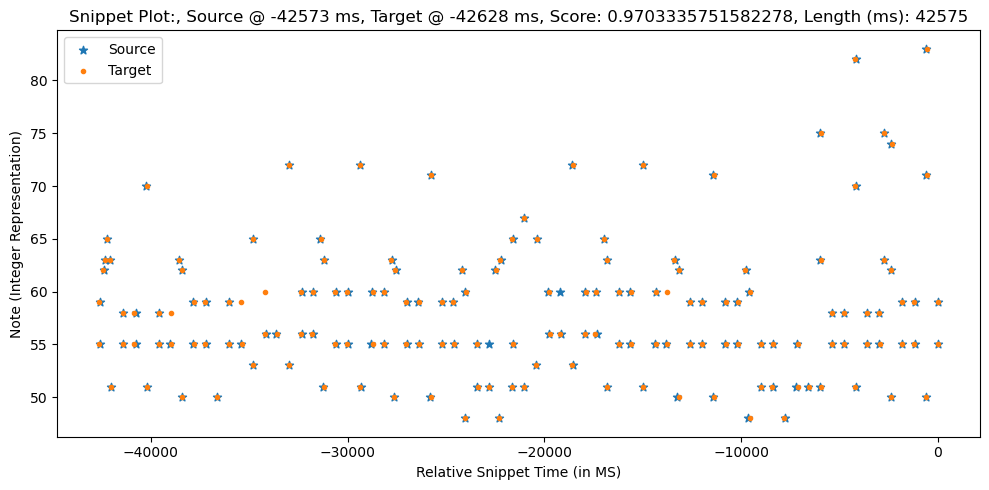

0.9706397871835444
Scores: [ 0.8625  0.865   0.895   0.94    0.8875  0.9825  0.925   0.9625  0.9875
  0.7175  0.7975  0.9725  0.98    0.92    0.95    0.9925 -0.      0.9425
  0.96    0.98    0.9275  0.9175  0.955   0.92    0.8875  0.9775  0.9625
 -0.      0.94    0.995   0.9575 -0.      0.92    0.8375  0.925   0.92
  0.9     0.9425  0.905   0.9325  0.945   0.9775  0.93    0.8225  0.8425
  0.9075  0.9075  0.975   0.9975  0.8325  0.8725  0.9375  0.9825  0.83
  0.9625  0.8825  0.79    0.78    0.945   0.9675  0.99    0.995   0.99
  0.9875  0.9175  0.975   0.99    0.9575  0.9425  0.9425  0.8975  0.94
  0.85    0.915   0.9575  0.925   0.9825  0.9525  0.985   0.99    0.9875
  0.9675  0.895   0.84    0.84    0.9625  0.99    0.9775  0.9425  0.8225
  0.99    0.9875  0.98    0.9875  0.975   0.9225  0.9875  0.85    0.9725
  0.985   0.9425  0.9475 -0.      0.9     0.885   0.77    0.9125  0.99
  0.9775  0.985   0.9375  0.96    0.9075  0.9     0.875   0.89    0.89
  0.8625  0.79    0.9     0.97    0.

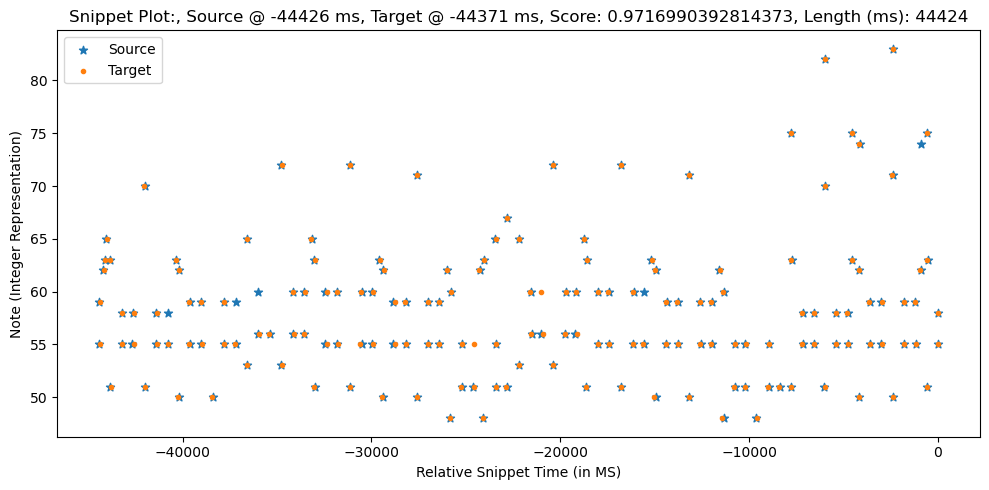

Scores: [ 0.8625  0.865   0.895   0.94    0.8875  0.9825  0.925   0.9875  0.9625
  0.7975  0.7175  0.9725  0.98    0.95    0.92    0.9925  0.9425  0.96
  0.98    0.9175  0.9275  0.955   0.92    0.8875  0.9625  0.9775  0.94
  0.995   0.9575  0.92    0.8375  0.925   0.92    0.9425  0.9     0.905
  0.9325  0.945   0.93    0.9775  0.8225  0.8425  0.9075  0.9075  0.975
  0.9975  0.8325  0.8725  0.9375  0.9825  0.83    0.9625  0.8825  0.79
  0.78    0.945   0.9675  0.99    0.995   0.9875  0.99    0.9175  0.975
  0.99    0.9575  0.9425  0.8975  0.9425  0.94   -0.      0.85    0.915
  0.9575  0.9825  0.925   0.9525  0.985   0.99    0.9875  0.9675  0.895
  0.84   -0.      0.84    0.99    0.9625  0.9775  0.9425  0.99    0.8225
  0.9875  0.98    0.9875  0.9225  0.975   0.85    0.9875  0.985   0.9725
  0.9425  0.9475  0.9     0.885   0.77    0.9125  0.99    0.9775  0.9375
  0.985   0.96    0.9075  0.9     0.875   0.89    0.89    0.8625  0.79
  0.9     0.97    0.9875  0.9325  0.975   0.9075  0.84  

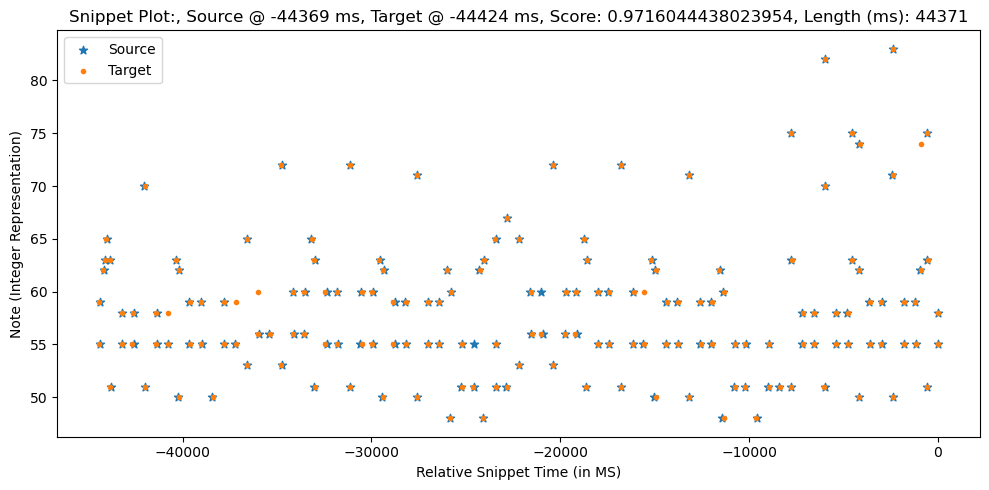

0.9716990392814373
Scores: [ 0.8575  0.86    0.89    0.935   0.8825  0.9775  0.92    0.9575  0.9825
  0.7125  0.7925  0.9775  0.985   0.915   0.945   0.9975 -0.      0.9475
  0.965   0.985   0.9325  0.9225  0.95    0.915   0.8925  0.9825  0.9675
 -0.      0.945   0.99    0.9525 -0.      0.915   0.8425  0.92    0.915
  0.895   0.9375  0.9     0.9275  0.95    0.9725  0.935   0.8175  0.8375
  0.9025  0.9025  0.97    0.9925  0.8375  0.8775  0.9325  0.9775  0.825
  0.9675  0.8775  0.785   0.775   0.95    0.9725  0.995   1.      0.985
  0.9925  0.9225  0.98    0.995   0.9625  0.9475  0.9375  0.9025  0.935
  0.855   0.91    0.9525  0.92    0.9875  0.9475  0.99    0.995   0.9825
  0.9625  0.9     0.845   0.835   0.9575  0.995   0.9725  0.9475  0.8175
  0.985   0.9925  0.985   0.9925  0.97    0.9275  0.9925  0.855   0.9675
  0.98    0.9475  0.9525 -0.      0.905   0.88    0.775   0.9175  0.985
  0.9825  0.99    0.9425  0.965   0.9125  0.905   0.88    0.895   0.895
  0.8575  0.795   0.905   0.97

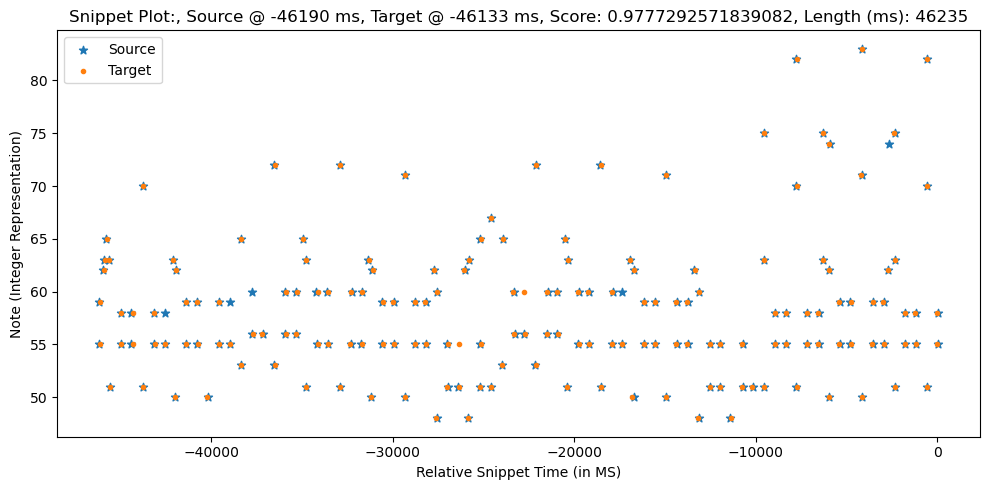

Scores: [ 0.8575  0.86    0.89    0.935   0.8825  0.9775  0.92    0.9825  0.9575
  0.7925  0.7125  0.9775  0.985   0.945   0.915   0.9975  0.9475  0.965
  0.985   0.9225  0.9325  0.95    0.915   0.8925  0.9675  0.9825  0.945
  0.99    0.9525  0.915   0.8425  0.92    0.915   0.9375  0.895   0.9
  0.9275  0.95    0.935   0.9725  0.8175  0.8375  0.9025  0.9025  0.97
  0.9925  0.8375  0.8775  0.9325  0.9775  0.825   0.9675  0.8775  0.785
  0.775   0.95    0.9725  0.995   1.      0.9925  0.985   0.9225  0.98
  0.995   0.9625  0.9475  0.9025  0.9375  0.935  -0.      0.855   0.91
  0.9525  0.9875  0.92    0.9475  0.99    0.995   0.9825  0.9625  0.9
  0.845  -0.      0.835   0.995   0.9575  0.9725  0.9475  0.985   0.8175
  0.9925  0.985   0.9925  0.9275  0.97    0.855   0.9925  0.98    0.9675
  0.9475  0.9525  0.905   0.88    0.775   0.9175  0.985   0.9825  0.9425
  0.99    0.965   0.9125  0.905   0.88    0.895   0.895   0.8575  0.795
  0.905   0.975   0.9925  0.9275  0.97    0.9025  0.845   0

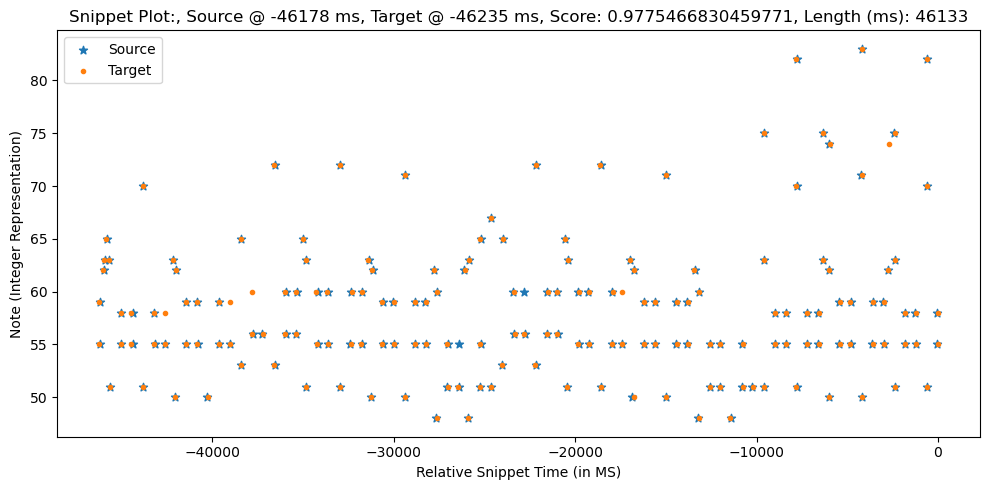

0.9777292571839082
Scores: [ 0.845   0.8475  0.8775  0.9225  0.87    0.965   0.9075  0.945   0.97
  0.7     0.78    0.99    0.9975  0.9025  0.9325  0.99   -0.      0.96
  0.9775  0.9975  0.945   0.935   0.9375  0.9025  0.905   0.995   0.98
 -0.      0.9575  0.9775  0.94   -0.      0.9025  0.855   0.9075  0.9025
  0.8825  0.925   0.8875  0.915   0.9625  0.96    0.9475  0.805   0.825
  0.89    0.89    0.9575  0.98    0.85    0.89    0.92    0.965   0.8125
  0.98    0.865   0.7725  0.7625  0.9625  0.985   0.9925  0.9875  0.9725
  0.995   0.935   0.9925  0.9925  0.975   0.96    0.925   0.915   0.9225
  0.8675  0.8975  0.94    0.9075  1.      0.935   0.9975  0.9925  0.97
  0.95    0.9125  0.8575  0.8225  0.945   0.9925  0.96    0.96    0.805
  0.9725  0.995   0.9975  0.995   0.9575  0.94    0.995   0.8675  0.955
  0.9675  0.96    0.965  -0.      0.9175  0.8675  0.7875  0.93    0.9725
  0.995   0.9975  0.955   0.9775  0.925   0.9175  0.8925  0.9075  0.9075
  0.845   0.8075  0.9175  0.9875  0

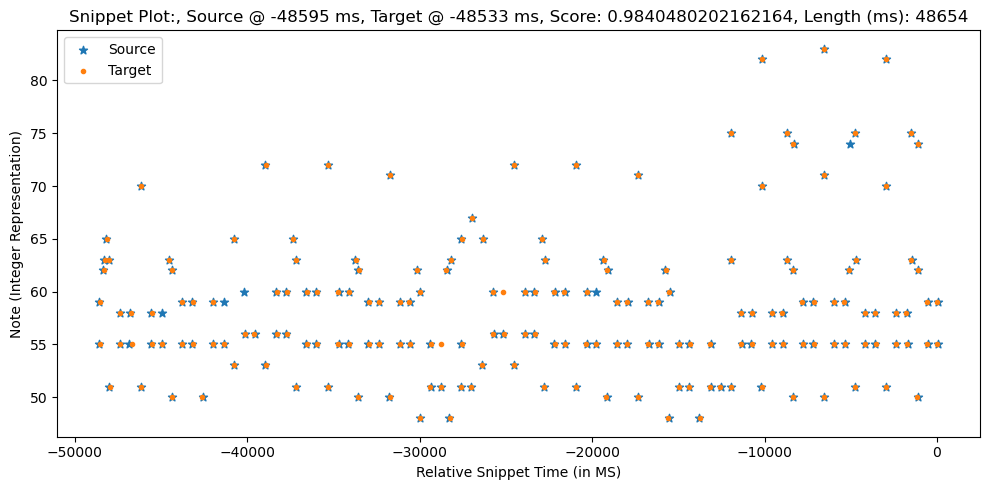

Scores: [ 0.8525  0.855   0.885   0.93    0.8775  0.9725  0.915   0.9775  0.9525
  0.7875  0.7075  0.9825  0.99    0.94    0.91    0.9975  0.9525  0.97
  0.99    0.9275  0.9375  0.945   0.91    0.8975  0.9725  0.9875  0.95
  0.985   0.9475  0.91    0.8475  0.915   0.91    0.9325  0.89    0.895
  0.9225  0.955   0.94    0.9675  0.8125  0.8325  0.8975  0.8975  0.965
  0.9875  0.8425  0.8825  0.9275  0.9725  0.82    0.9725  0.8725  0.78
  0.77    0.955   0.9775  1.      0.995   0.9975  0.98    0.9275  0.985
  1.      0.9675  0.9525  0.9075  0.9325  0.93   -0.      0.86    0.905
  0.9475  0.9925  0.915   0.9425  0.995   1.      0.9775  0.9575  0.905
  0.85   -0.      0.83    1.      0.9525  0.9675  0.9525  0.98    0.8125
  0.9975  0.99    0.9975  0.9325  0.965   0.86    0.9975  0.975   0.9625
  0.9525  0.9575  0.91    0.875   0.78    0.9225  0.98    0.9875  0.9475
  0.995   0.97    0.9175  0.91    0.885   0.9     0.9     0.8525  0.8
  0.91    0.98    0.9975  0.9225  0.965   0.8975  0.85   

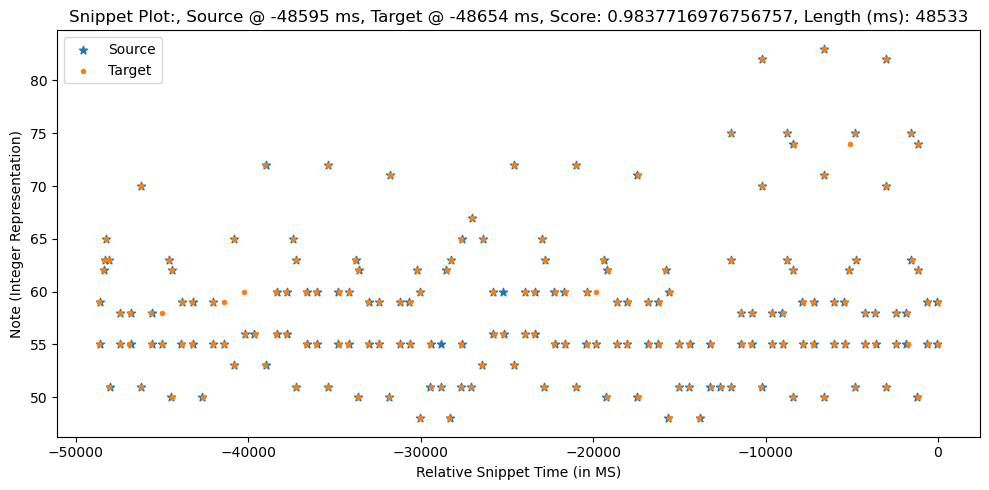

0.9840480202162164
Scores: [ 0.93    0.975   0.9225  0.9825  0.96    0.9975  0.9775  0.7525  0.8325
  0.9375  0.945   0.955   0.985   0.9575 -0.      0.9075  0.925   0.945
  0.8925  0.8825]
Sequence1:  [[-4539    62    49]
 [-4463    63    54]
 [-4379    65    59]
 [-4196    63    54]
 [-4179    51    53]
 [-3557    58    36]
 [-3555    55    44]
 [-2999    55    49]
 [-2985    58    44]
 [-2348    70    58]
 [-2337    51    46]
 [-1738    55    45]
 [-1735    58    32]
 [-1131    55    48]
 [-1119    58    39]
 [ -685    63    52]
 [ -549    50    42]
 [ -537    62    56]
 [   45    59    46]
 [   47    55    46]]
Sequence2:  [[-4511    62    43]
 [-4453    63    56]
 [-4348    65    45]
 [-4203    63    49]
 [-4163    51    53]
 [-3564    55    49]
 [-3556    58    34]
 [-2918    58    26]
 [-2900    55    35]
 [-2373    70    53]
 [-2359    51    51]
 [-1729    58    33]
 [-1720    55    42]
 [-1148    55    48]
 [ -722    63    49]
 [ -579    50    44]
 [ -559    62    54]
 [    0 

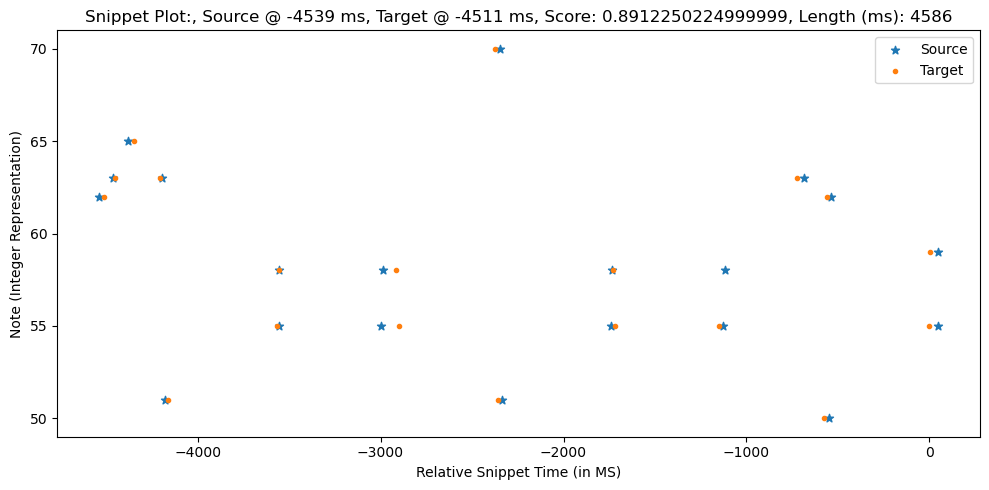

Scores: [0.93   0.975  0.9225 0.9825 0.96   0.9775 0.9975 0.8325 0.7525 0.9375
 0.945  0.985  0.955  0.9575 0.9075 0.925  0.945  0.8825 0.8925]
Sequence1:  [[-4556    62    43]
 [-4498    63    56]
 [-4393    65    45]
 [-4248    63    49]
 [-4208    51    53]
 [-3609    55    49]
 [-3601    58    34]
 [-2963    58    26]
 [-2945    55    35]
 [-2418    70    53]
 [-2404    51    51]
 [-1774    58    33]
 [-1765    55    42]
 [-1193    55    48]
 [ -767    63    49]
 [ -624    50    44]
 [ -604    62    54]
 [  -45    55    44]
 [  -43    59    42]]
Sequence2:  [[-4584    62    49]
 [-4508    63    54]
 [-4424    65    59]
 [-4241    63    54]
 [-4224    51    53]
 [-3602    58    36]
 [-3600    55    44]
 [-3044    55    49]
 [-3030    58    44]
 [-2393    70    58]
 [-2382    51    46]
 [-1783    55    45]
 [-1780    58    32]
 [-1176    55    48]
 [-1164    58    39]
 [ -730    63    52]
 [ -594    50    42]
 [ -582    62    56]
 [    0    59    46]
 [    2    55    46]]
mean_offset

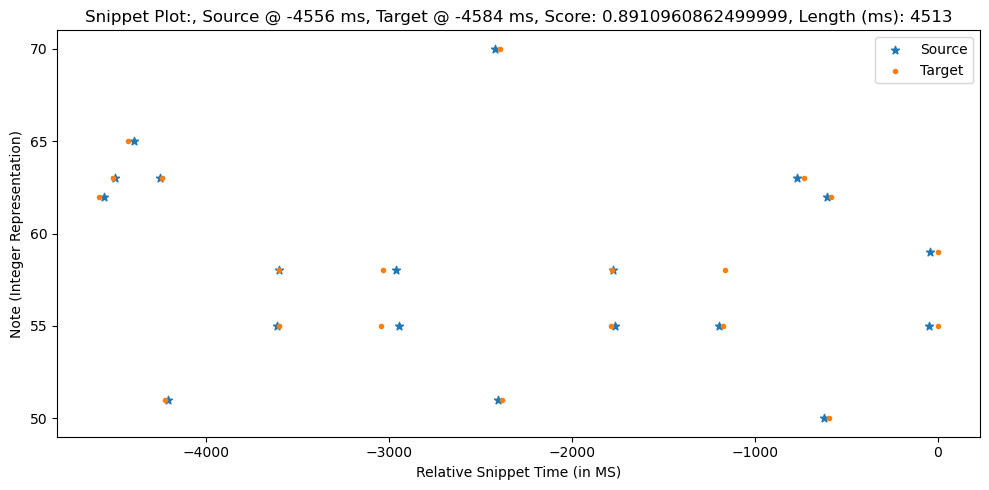

0.8912250224999999
Scores: [ 0.9225  0.9675  0.915   0.99    0.9525  0.99    0.985   0.745   0.825
  0.945   0.9525  0.9475  0.9775  0.965  -0.      0.915   0.9325  0.9525
  0.9     0.89    0.9825  0.9475  0.86    0.95    0.935 ]
Sequence1:  [[-6371    62    49]
 [-6295    63    54]
 [-6211    65    59]
 [-6028    63    54]
 [-6011    51    53]
 [-5389    58    36]
 [-5387    55    44]
 [-4831    55    49]
 [-4817    58    44]
 [-4180    70    58]
 [-4169    51    46]
 [-3570    55    45]
 [-3567    58    32]
 [-2963    55    48]
 [-2951    58    39]
 [-2517    63    52]
 [-2381    50    42]
 [-2369    62    56]
 [-1787    59    46]
 [-1785    55    46]
 [-1192    59    42]
 [-1186    55    48]
 [ -577    50    46]
 [   24    59    39]
 [   26    55    44]]
Sequence2:  [[-6340    62    43]
 [-6282    63    56]
 [-6177    65    45]
 [-6032    63    49]
 [-5992    51    53]
 [-5393    55    49]
 [-5385    58    34]
 [-4747    58    26]
 [-4729    55    35]
 [-4202    70    53]
 [-4188   

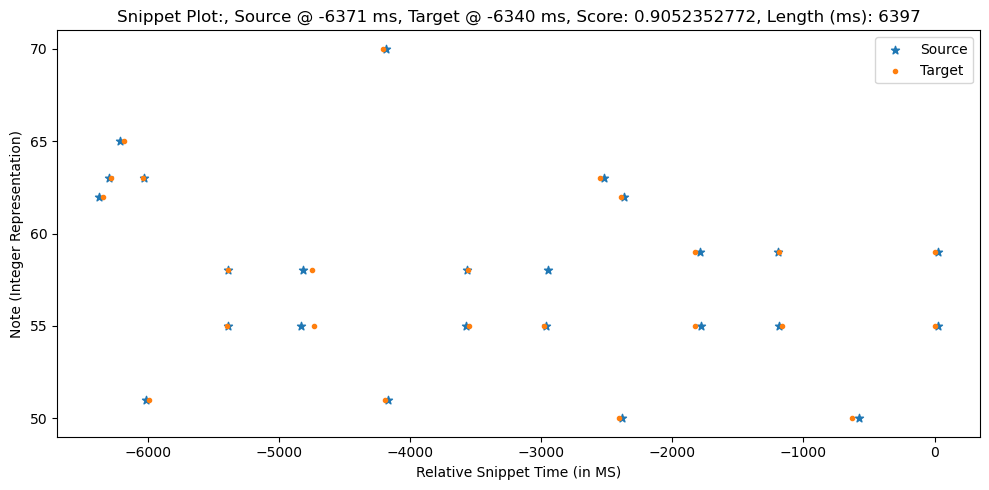

Scores: [0.9225 0.9675 0.915  0.99   0.9525 0.985  0.99   0.825  0.745  0.945
 0.9525 0.9775 0.9475 0.965  0.915  0.9325 0.9525 0.89   0.9    0.9825
 0.9475 0.86   0.935  0.95  ]
Sequence1:  [[-6364    62    43]
 [-6306    63    56]
 [-6201    65    45]
 [-6056    63    49]
 [-6016    51    53]
 [-5417    55    49]
 [-5409    58    34]
 [-4771    58    26]
 [-4753    55    35]
 [-4226    70    53]
 [-4212    51    51]
 [-3582    58    33]
 [-3573    55    42]
 [-3001    55    48]
 [-2575    63    49]
 [-2432    50    44]
 [-2412    62    54]
 [-1853    55    44]
 [-1851    59    42]
 [-1209    59    41]
 [-1189    55    45]
 [ -657    50    51]
 [  -24    55    44]
 [  -20    59    40]]
Sequence2:  [[-6395    62    49]
 [-6319    63    54]
 [-6235    65    59]
 [-6052    63    54]
 [-6035    51    53]
 [-5413    58    36]
 [-5411    55    44]
 [-4855    55    49]
 [-4841    58    44]
 [-4204    70    58]
 [-4193    51    46]
 [-3594    55    45]
 [-3591    58    32]
 [-2987    55    48

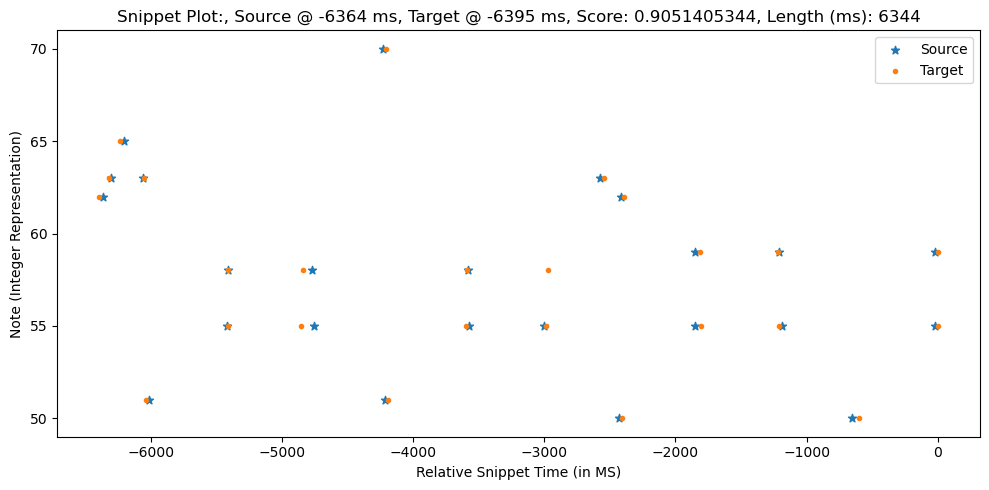

0.9052352772
Scores: [ 0.9125  0.9575  0.905   1.      0.9425  0.98    0.995   0.735   0.815
  0.955   0.9625  0.9375  0.9675  0.975  -0.      0.925   0.9425  0.9625
  0.91    0.9     0.9725  0.9375  0.87    0.96    0.945  -0.      0.9225
  0.9875  0.975  -0.      0.9375  0.82  ]
Sequence1:  [[-8750    62    49]
 [-8674    63    54]
 [-8590    65    59]
 [-8407    63    54]
 [-8390    51    53]
 [-7768    58    36]
 [-7766    55    44]
 [-7210    55    49]
 [-7196    58    44]
 [-6559    70    58]
 [-6548    51    46]
 [-5949    55    45]
 [-5946    58    32]
 [-5342    55    48]
 [-5330    58    39]
 [-4896    63    52]
 [-4760    50    42]
 [-4748    62    56]
 [-4166    59    46]
 [-4164    55    46]
 [-3571    59    42]
 [-3565    55    48]
 [-2956    50    46]
 [-2355    59    39]
 [-2353    55    44]
 [-1747    59    34]
 [-1731    55    41]
 [-1148    53    47]
 [-1145    65    54]
 [ -557    60    34]
 [ -530    56    44]
 [   72    56    45]]
Sequence2:  [[-8715    62    43]
 

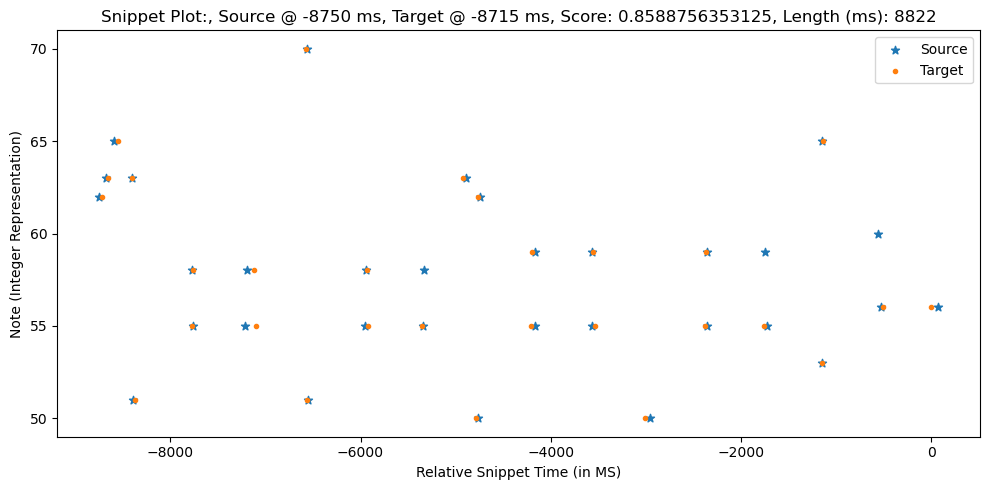

Scores: [0.9125 0.9575 0.905  1.     0.9425 0.995  0.98   0.815  0.735  0.955
 0.9625 0.9675 0.9375 0.975  0.925  0.9425 0.9625 0.9    0.91   0.9725
 0.9375 0.87   0.945  0.96   0.9225 0.9875 0.975  0.9375 0.82  ]
Sequence1:  [[-8787    62    43]
 [-8729    63    56]
 [-8624    65    45]
 [-8479    63    49]
 [-8439    51    53]
 [-7840    55    49]
 [-7832    58    34]
 [-7194    58    26]
 [-7176    55    35]
 [-6649    70    53]
 [-6635    51    51]
 [-6005    58    33]
 [-5996    55    42]
 [-5424    55    48]
 [-4998    63    49]
 [-4855    50    44]
 [-4835    62    54]
 [-4276    55    44]
 [-4274    59    42]
 [-3632    59    41]
 [-3612    55    45]
 [-3080    50    51]
 [-2447    55    44]
 [-2443    59    40]
 [-1834    55    47]
 [-1225    53    43]
 [-1207    65    49]
 [ -577    56    41]
 [  -72    56    41]]
Sequence2:  [[-8822    62    49]
 [-8746    63    54]
 [-8662    65    59]
 [-8479    63    54]
 [-8462    51    53]
 [-7840    58    36]
 [-7838    55    44]
 [-72

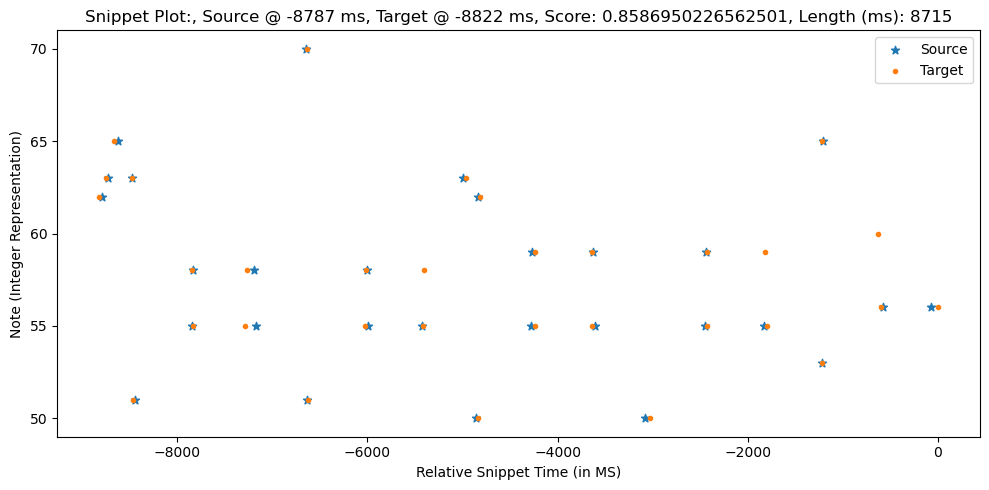

0.8588756353125
Scores: [ 0.925   0.97    0.9175  0.9875  0.955   0.9925  0.9825  0.7475  0.8275
  0.9425  0.95    0.95    0.98    0.9625 -0.      0.9125  0.93    0.95
  0.8975  0.8875  0.985   0.95    0.8575  0.9475  0.9325 -0.      0.91
  0.975   0.9875 -0.      0.95    0.8075  0.955   0.95    0.93    0.9725
  0.935   0.9625]
Sequence1:  [[-10653     62     49]
 [-10577     63     54]
 [-10493     65     59]
 [-10310     63     54]
 [-10293     51     53]
 [ -9671     58     36]
 [ -9669     55     44]
 [ -9113     55     49]
 [ -9099     58     44]
 [ -8462     70     58]
 [ -8451     51     46]
 [ -7852     55     45]
 [ -7849     58     32]
 [ -7245     55     48]
 [ -7233     58     39]
 [ -6799     63     52]
 [ -6663     50     42]
 [ -6651     62     56]
 [ -6069     59     46]
 [ -6067     55     46]
 [ -5474     59     42]
 [ -5468     55     48]
 [ -4859     50     46]
 [ -4258     59     39]
 [ -4256     55     44]
 [ -3650     59     34]
 [ -3634     55     41]
 [ -3051  

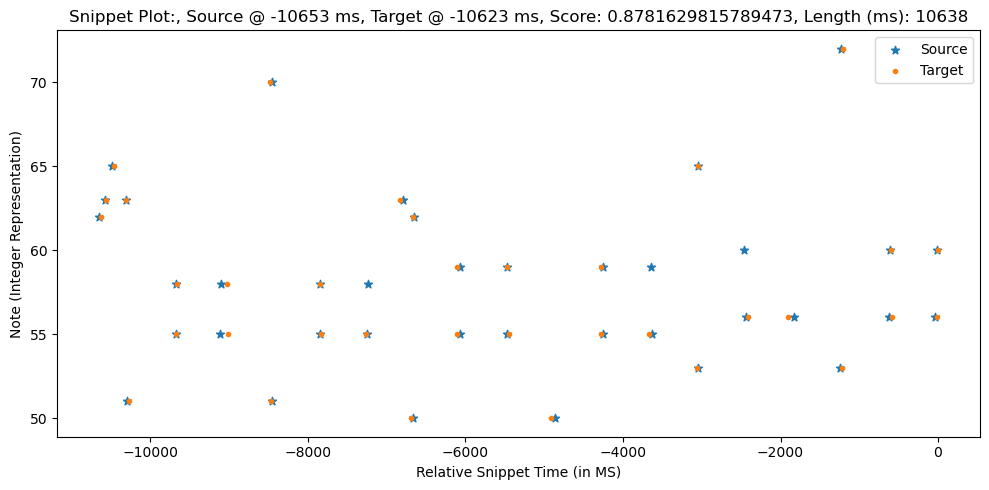

Scores: [0.925  0.97   0.9175 0.9875 0.955  0.9825 0.9925 0.8275 0.7475 0.9425
 0.95   0.98   0.95   0.9625 0.9125 0.93   0.95   0.8875 0.8975 0.985
 0.95   0.8575 0.9325 0.9475 0.91   0.975  0.9875 0.95   0.8075 0.955
 0.95   0.9725 0.93   0.935  0.9625]
Sequence1:  [[-10608     62     43]
 [-10550     63     56]
 [-10445     65     45]
 [-10300     63     49]
 [-10260     51     53]
 [ -9661     55     49]
 [ -9653     58     34]
 [ -9015     58     26]
 [ -8997     55     35]
 [ -8470     70     53]
 [ -8456     51     51]
 [ -7826     58     33]
 [ -7817     55     42]
 [ -7245     55     48]
 [ -6819     63     49]
 [ -6676     50     44]
 [ -6656     62     54]
 [ -6097     55     44]
 [ -6095     59     42]
 [ -5453     59     41]
 [ -5433     55     45]
 [ -4901     50     51]
 [ -4268     55     44]
 [ -4264     59     40]
 [ -3655     55     47]
 [ -3046     53     43]
 [ -3028     65     49]
 [ -2398     56     41]
 [ -1893     56     41]
 [ -1206     53     54]
 [ -1197    

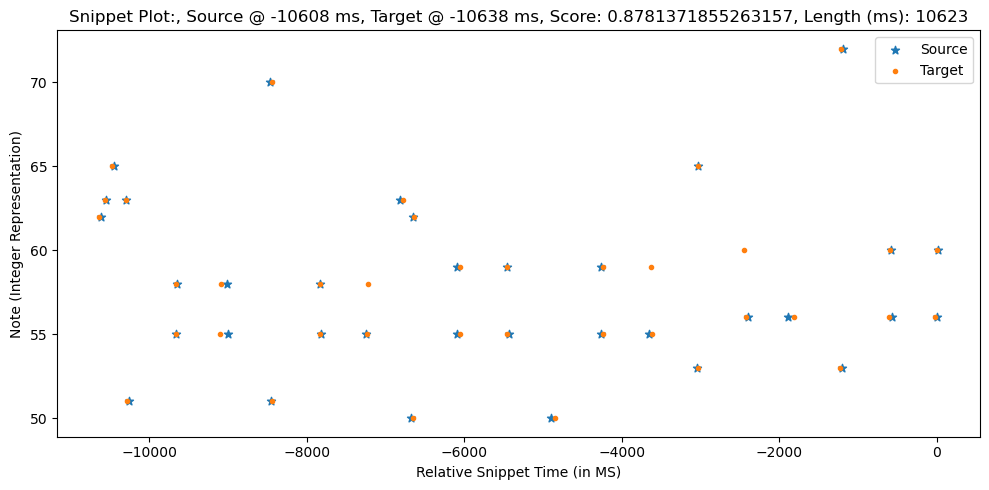

0.8781629815789473
Scores: [ 0.93    0.975   0.9225  0.9825  0.96    0.9975  0.9775  0.7525  0.8325
  0.9375  0.945   0.955   0.985   0.9575 -0.      0.9075  0.925   0.945
  0.8925  0.8825  0.99    0.955   0.8525  0.9425  0.9275 -0.      0.905
  0.97    0.9925 -0.      0.955   0.8025  0.96    0.955   0.935   0.9775
  0.94    0.9675  0.91    0.9875  0.895   0.8575  0.8775  0.9425  0.9425]
Sequence1:  [[-12405     62     49]
 [-12329     63     54]
 [-12245     65     59]
 [-12062     63     54]
 [-12045     51     53]
 [-11423     58     36]
 [-11421     55     44]
 [-10865     55     49]
 [-10851     58     44]
 [-10214     70     58]
 [-10203     51     46]
 [ -9604     55     45]
 [ -9601     58     32]
 [ -8997     55     48]
 [ -8985     58     39]
 [ -8551     63     52]
 [ -8415     50     42]
 [ -8403     62     56]
 [ -7821     59     46]
 [ -7819     55     46]
 [ -7226     59     42]
 [ -7220     55     48]
 [ -6611     50     46]
 [ -6010     59     39]
 [ -6008     55     4

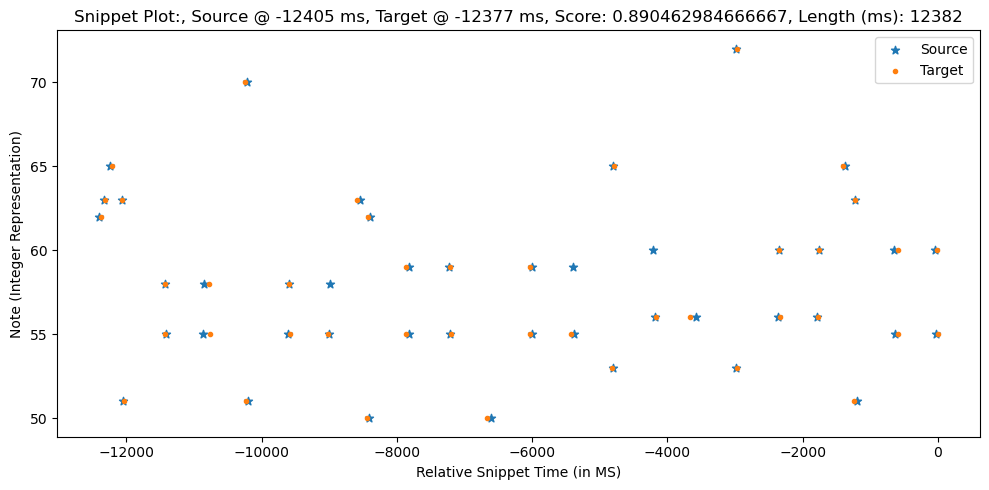

Scores: [0.93   0.975  0.9225 0.9825 0.96   0.9775 0.9975 0.8325 0.7525 0.9375
 0.945  0.985  0.955  0.9575 0.9075 0.925  0.945  0.8825 0.8925 0.99
 0.955  0.8525 0.9275 0.9425 0.905  0.97   0.9925 0.955  0.8025 0.96
 0.955  0.9775 0.935  0.94   0.9675 0.91   0.895  0.9875 0.8575 0.8775
 0.9425 0.9425]
Sequence1:  [[-12354     62     43]
 [-12296     63     56]
 [-12191     65     45]
 [-12046     63     49]
 [-12006     51     53]
 [-11407     55     49]
 [-11399     58     34]
 [-10761     58     26]
 [-10743     55     35]
 [-10216     70     53]
 [-10202     51     51]
 [ -9572     58     33]
 [ -9563     55     42]
 [ -8991     55     48]
 [ -8565     63     49]
 [ -8422     50     44]
 [ -8402     62     54]
 [ -7843     55     44]
 [ -7841     59     42]
 [ -7199     59     41]
 [ -7179     55     45]
 [ -6647     50     51]
 [ -6014     55     44]
 [ -6010     59     40]
 [ -5401     55     47]
 [ -4792     53     43]
 [ -4774     65     49]
 [ -4144     56     41]
 [ -3639    

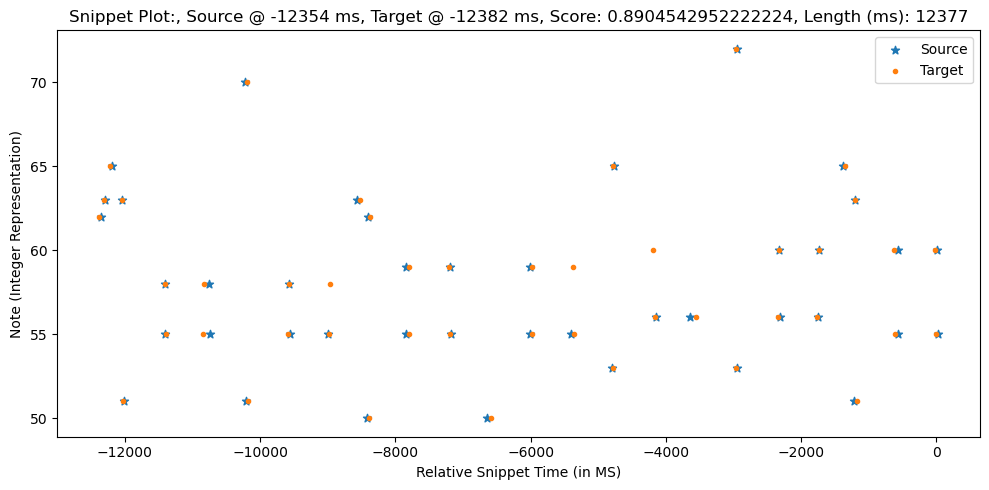

0.890462984666667
Scores: [ 0.925   0.97    0.9175  0.9875  0.955   0.9925  0.9825  0.7475  0.8275
  0.9425  0.95    0.95    0.98    0.9625 -0.      0.9125  0.93    0.95
  0.8975  0.8875  0.985   0.95    0.8575  0.9475  0.9325 -0.      0.91
  0.975   0.9875 -0.      0.95    0.8075  0.955   0.95    0.93    0.9725
  0.935   0.9625  0.915   0.9925  0.9     0.8525  0.8725  0.9375  0.9375
  0.995   0.9725  0.8025  0.8425  0.9675  0.9875  0.86    0.9325  0.9125]
Sequence1:  [[-14839     62     49]
 [-14763     63     54]
 [-14679     65     59]
 [-14496     63     54]
 [-14479     51     53]
 [-13857     58     36]
 [-13855     55     44]
 [-13299     55     49]
 [-13285     58     44]
 [-12648     70     58]
 [-12637     51     46]
 [-12038     55     45]
 [-12035     58     32]
 [-11431     55     48]
 [-11419     58     39]
 [-10985     63     52]
 [-10849     50     42]
 [-10837     62     56]
 [-10255     59     46]
 [-10253     55     46]
 [ -9660     59     42]
 [ -9654     55     48]

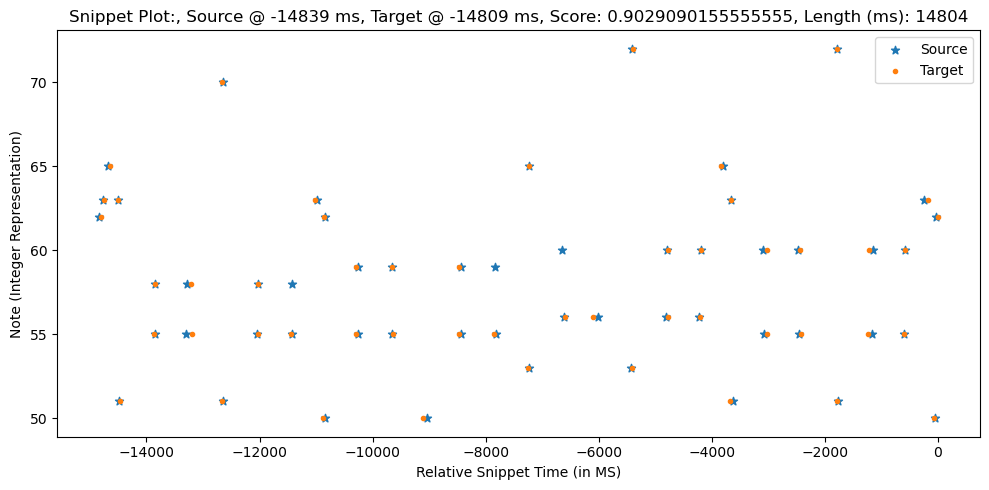

Scores: [0.925  0.97   0.9175 0.9875 0.955  0.9825 0.9925 0.8275 0.7475 0.9425
 0.95   0.98   0.95   0.9625 0.9125 0.93   0.95   0.8875 0.8975 0.985
 0.95   0.8575 0.9325 0.9475 0.91   0.975  0.9875 0.95   0.8075 0.955
 0.95   0.9725 0.93   0.935  0.9625 0.915  0.9    0.9925 0.8525 0.8725
 0.9375 0.9375 0.995  0.9725 0.8025 0.8425 0.9675 0.9875 0.86   0.9325
 0.9125]
Sequence1:  [[-14774     62     43]
 [-14716     63     56]
 [-14611     65     45]
 [-14466     63     49]
 [-14426     51     53]
 [-13827     55     49]
 [-13819     58     34]
 [-13181     58     26]
 [-13163     55     35]
 [-12636     70     53]
 [-12622     51     51]
 [-11992     58     33]
 [-11983     55     42]
 [-11411     55     48]
 [-10985     63     49]
 [-10842     50     44]
 [-10822     62     54]
 [-10263     55     44]
 [-10261     59     42]
 [ -9619     59     41]
 [ -9599     55     45]
 [ -9067     50     51]
 [ -8434     55     44]
 [ -8430     59     40]
 [ -7821     55     47]
 [ -7212     53   

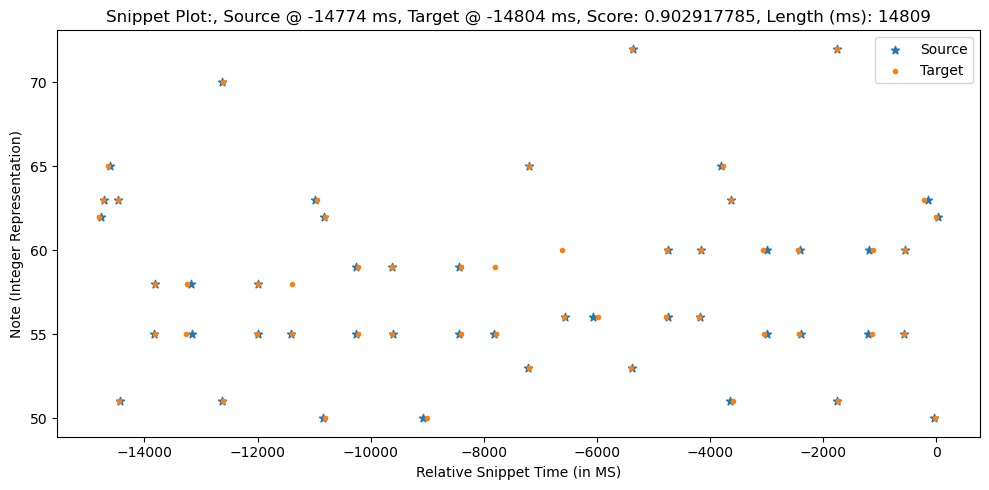

0.902917785
Scores: [ 0.925   0.97    0.9175  0.9875  0.955   0.9925  0.9825  0.7475  0.8275
  0.9425  0.95    0.95    0.98    0.9625 -0.      0.9125  0.93    0.95
  0.8975  0.8875  0.985   0.95    0.8575  0.9475  0.9325 -0.      0.91
  0.975   0.9875 -0.      0.95    0.8075  0.955   0.95    0.93    0.9725
  0.935   0.9625  0.915   0.9925  0.9     0.8525  0.8725  0.9375  0.9375
  0.995   0.9725  0.8025  0.8425  0.9675  0.9875  0.86    0.9325  0.9125
  0.82    0.81    0.915   0.9375  0.96    0.965 ]
Sequence1:  [[-16609     62     49]
 [-16533     63     54]
 [-16449     65     59]
 [-16266     63     54]
 [-16249     51     53]
 [-15627     58     36]
 [-15625     55     44]
 [-15069     55     49]
 [-15055     58     44]
 [-14418     70     58]
 [-14407     51     46]
 [-13808     55     45]
 [-13805     58     32]
 [-13201     55     48]
 [-13189     58     39]
 [-12755     63     52]
 [-12619     50     42]
 [-12607     62     56]
 [-12025     59     46]
 [-12023     55     46]
 [-1

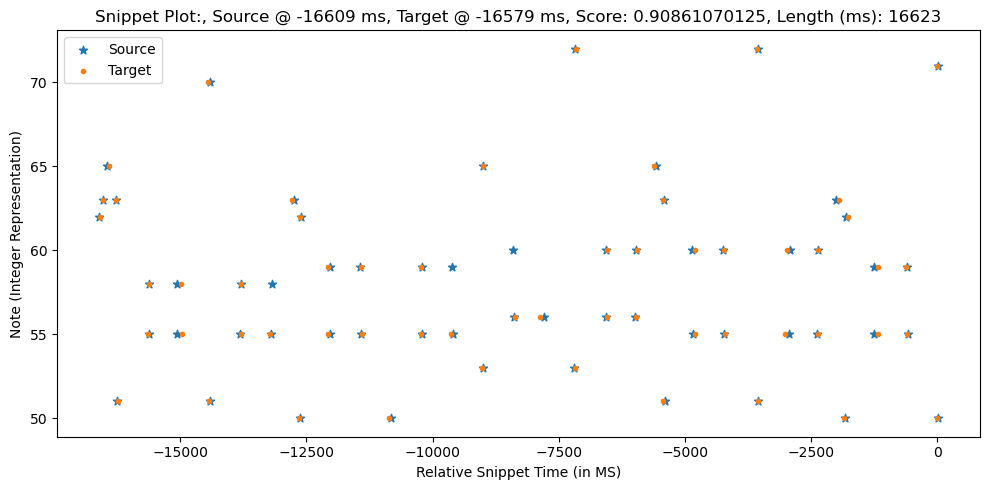

Scores: [0.925  0.97   0.9175 0.9875 0.955  0.9825 0.9925 0.8275 0.7475 0.9425
 0.95   0.98   0.95   0.9625 0.9125 0.93   0.95   0.8875 0.8975 0.985
 0.95   0.8575 0.9325 0.9475 0.91   0.975  0.9875 0.95   0.8075 0.955
 0.95   0.9725 0.93   0.935  0.9625 0.915  0.9    0.9925 0.8525 0.8725
 0.9375 0.9375 0.995  0.9725 0.8025 0.8425 0.9675 0.9875 0.86   0.9325
 0.9125 0.82   0.81   0.915  0.9375 0.96   0.965 ]
Sequence1:  [[-16593     62     43]
 [-16535     63     56]
 [-16430     65     45]
 [-16285     63     49]
 [-16245     51     53]
 [-15646     55     49]
 [-15638     58     34]
 [-15000     58     26]
 [-14982     55     35]
 [-14455     70     53]
 [-14441     51     51]
 [-13811     58     33]
 [-13802     55     42]
 [-13230     55     48]
 [-12804     63     49]
 [-12661     50     44]
 [-12641     62     54]
 [-12082     55     44]
 [-12080     59     42]
 [-11438     59     41]
 [-11418     55     45]
 [-10886     50     51]
 [-10253     55     44]
 [-10249     59     40]


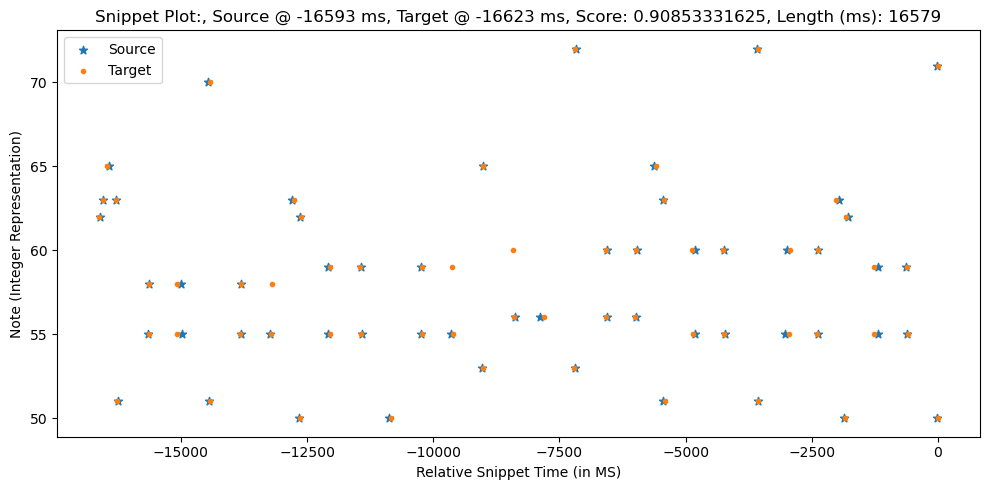

0.90861070125
Scores: [ 0.92    0.965   0.9125  0.9925  0.95    0.9875  0.9875  0.7425  0.8225
  0.9475  0.955   0.945   0.975   0.9675 -0.      0.9175  0.935   0.955
  0.9025  0.8925  0.98    0.945   0.8625  0.9525  0.9375 -0.      0.915
  0.98    0.9825 -0.      0.945   0.8125  0.95    0.945   0.925   0.9675
  0.93    0.9575  0.92    0.9975  0.905   0.8475  0.8675  0.9325  0.9325
  1.      0.9775  0.8075  0.8475  0.9625  0.9925  0.855   0.9375  0.9075
  0.815   0.805   0.92    0.9425  0.965   0.97    0.985   0.9625  0.8925
  0.95    0.965   0.9325  0.9175]
Sequence1:  [[-18380     62     49]
 [-18304     63     54]
 [-18220     65     59]
 [-18037     63     54]
 [-18020     51     53]
 [-17398     58     36]
 [-17396     55     44]
 [-16840     55     49]
 [-16826     58     44]
 [-16189     70     58]
 [-16178     51     46]
 [-15579     55     45]
 [-15576     58     32]
 [-14972     55     48]
 [-14960     58     39]
 [-14526     63     52]
 [-14390     50     42]
 [-14378     62

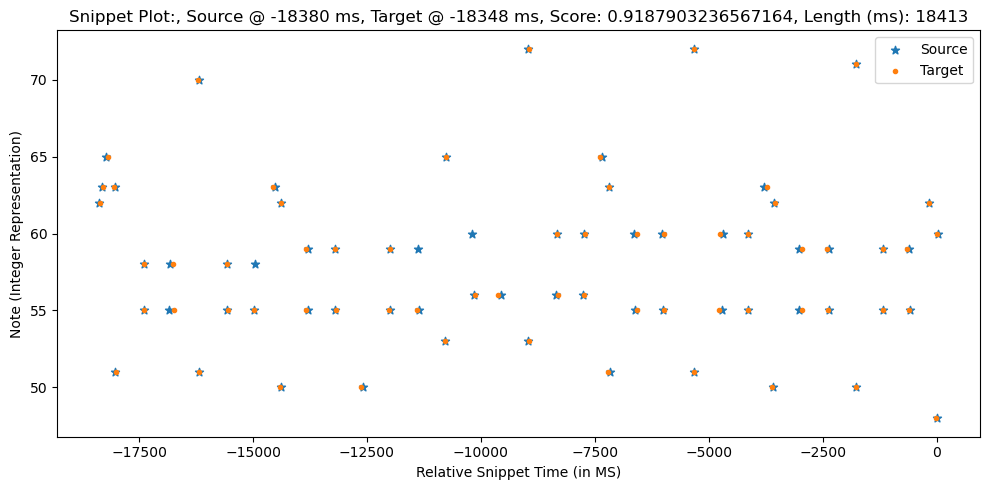

Scores: [0.92   0.965  0.9125 0.9925 0.95   0.9875 0.9875 0.8225 0.7425 0.9475
 0.955  0.975  0.945  0.9675 0.9175 0.935  0.955  0.8925 0.9025 0.98
 0.945  0.8625 0.9375 0.9525 0.915  0.98   0.9825 0.945  0.8125 0.95
 0.945  0.9675 0.925  0.93   0.9575 0.92   0.905  0.9975 0.8475 0.8675
 0.9325 0.9325 1.     0.9775 0.8075 0.8475 0.9625 0.9925 0.855  0.9375
 0.9075 0.815  0.805  0.92   0.9425 0.965  0.97   0.9625 0.985  0.8925
 0.95   0.965  0.9325 0.9175]
Sequence1:  [[-18381     62     43]
 [-18323     63     56]
 [-18218     65     45]
 [-18073     63     49]
 [-18033     51     53]
 [-17434     55     49]
 [-17426     58     34]
 [-16788     58     26]
 [-16770     55     35]
 [-16243     70     53]
 [-16229     51     51]
 [-15599     58     33]
 [-15590     55     42]
 [-15018     55     48]
 [-14592     63     49]
 [-14449     50     44]
 [-14429     62     54]
 [-13870     55     44]
 [-13868     59     42]
 [-13226     59     41]
 [-13206     55     45]
 [-12674     50     51]


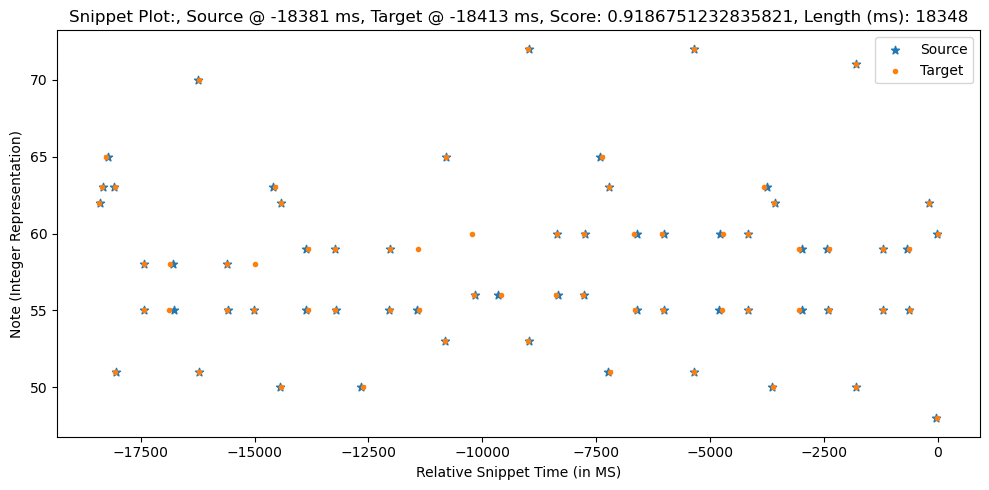

0.9187903236567164
Scores: [ 0.92    0.965   0.9125  0.9925  0.95    0.9875  0.9875  0.7425  0.8225
  0.9475  0.955   0.945   0.975   0.9675 -0.      0.9175  0.935   0.955
  0.9025  0.8925  0.98    0.945   0.8625  0.9525  0.9375 -0.      0.915
  0.98    0.9825 -0.      0.945   0.8125  0.95    0.945   0.925   0.9675
  0.93    0.9575  0.92    0.9975  0.905   0.8475  0.8675  0.9325  0.9325
  1.      0.9775  0.8075  0.8475  0.9625  0.9925  0.855   0.9375  0.9075
  0.815   0.805   0.92    0.9425  0.965   0.97    0.985   0.9625  0.8925
  0.95    0.965   0.9325  0.9175  0.9675  0.8725  0.965   0.825   0.94
  0.9825  0.95    0.9575  0.9775]
Sequence1:  [[-20802     62     49]
 [-20726     63     54]
 [-20642     65     59]
 [-20459     63     54]
 [-20442     51     53]
 [-19820     58     36]
 [-19818     55     44]
 [-19262     55     49]
 [-19248     58     44]
 [-18611     70     58]
 [-18600     51     46]
 [-18001     55     45]
 [-17998     58     32]
 [-17394     55     48]
 [-17382   

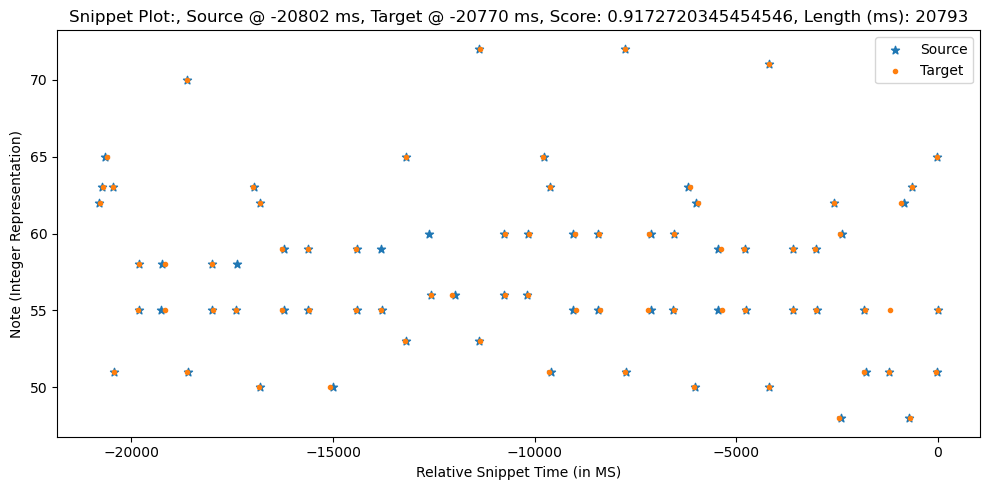

Scores: [ 0.92    0.965   0.9125  0.9925  0.95    0.9875  0.9875  0.8225  0.7425
  0.9475  0.955   0.975   0.945   0.9675  0.9175  0.935   0.955   0.8925
  0.9025  0.98    0.945   0.8625  0.9375  0.9525  0.915   0.98    0.9825
  0.945   0.8125  0.95    0.945   0.9675  0.925   0.93    0.9575  0.92
  0.905   0.9975  0.8475  0.8675  0.9325  0.9325  1.      0.9775  0.8075
  0.8475  0.9625  0.9925  0.855   0.9375  0.9075  0.815   0.805   0.92
  0.9425  0.965   0.97    0.9625  0.985   0.8925  0.95    0.965   0.9325
  0.9175  0.8725  0.9675  0.965  -0.      0.825   0.94    0.9825  0.9575
  0.95    0.9775]
Sequence1:  [[-20761     62     43]
 [-20703     63     56]
 [-20598     65     45]
 [-20453     63     49]
 [-20413     51     53]
 [-19814     55     49]
 [-19806     58     34]
 [-19168     58     26]
 [-19150     55     35]
 [-18623     70     53]
 [-18609     51     51]
 [-17979     58     33]
 [-17970     55     42]
 [-17398     55     48]
 [-16972     63     49]
 [-16829     50     44

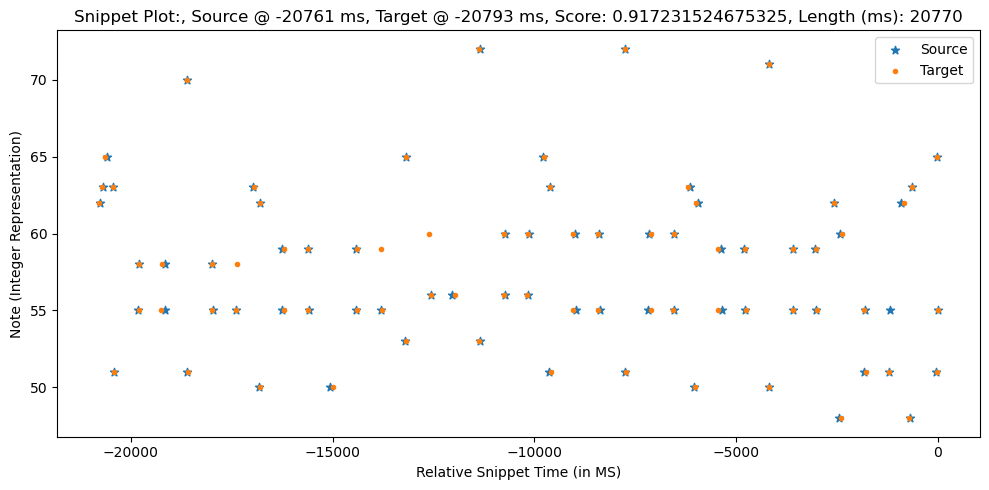

0.9172720345454546
Scores: [ 0.9125  0.9575  0.905   1.      0.9425  0.98    0.995   0.735   0.815
  0.955   0.9625  0.9375  0.9675  0.975  -0.      0.925   0.9425  0.9625
  0.91    0.9     0.9725  0.9375  0.87    0.96    0.945  -0.      0.9225
  0.9875  0.975  -0.      0.9375  0.82    0.9425  0.9375  0.9175  0.96
  0.9225  0.95    0.9275  0.995   0.9125  0.84    0.86    0.925   0.925
  0.9925  0.985   0.815   0.855   0.955   1.      0.8475  0.945   0.9
  0.8075  0.7975  0.9275  0.95    0.9725  0.9775  0.9925  0.97    0.9
  0.9575  0.9725  0.94    0.925   0.96    0.88    0.9575  0.8325  0.9325
  0.975   0.9425  0.965   0.97    0.9675  0.9725  0.995   0.985   0.8775
  0.8225]
Sequence1:  [[-22619     62     49]
 [-22543     63     54]
 [-22459     65     59]
 [-22276     63     54]
 [-22259     51     53]
 [-21637     58     36]
 [-21635     55     44]
 [-21079     55     49]
 [-21065     58     44]
 [-20428     70     58]
 [-20417     51     46]
 [-19818     55     45]
 [-19815     58 

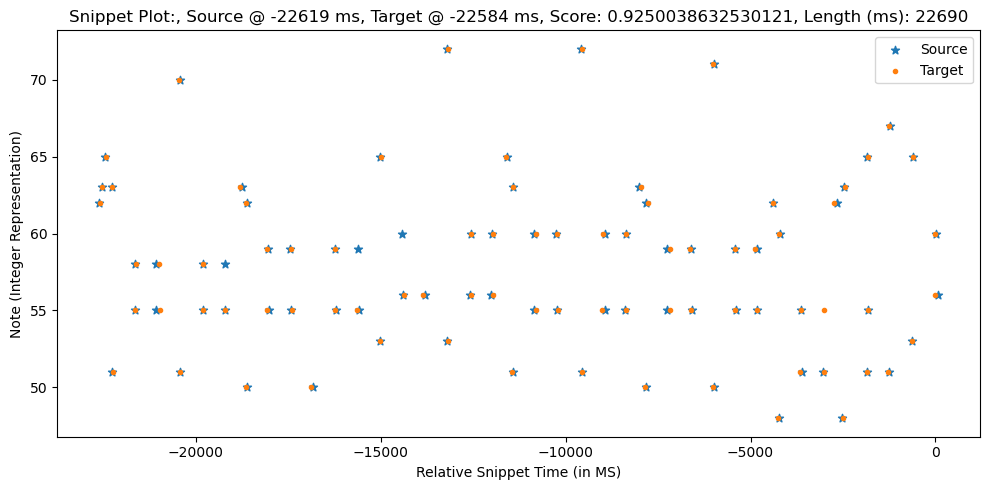

Scores: [ 0.9125  0.9575  0.905   1.      0.9425  0.995   0.98    0.815   0.735
  0.955   0.9625  0.9675  0.9375  0.975   0.925   0.9425  0.9625  0.9
  0.91    0.9725  0.9375  0.87    0.945   0.96    0.9225  0.9875  0.975
  0.9375  0.82    0.9425  0.9375  0.96    0.9175  0.9225  0.95    0.9275
  0.9125  0.995   0.84    0.86    0.925   0.925   0.9925  0.985   0.815
  0.855   0.955   1.      0.8475  0.945   0.9     0.8075  0.7975  0.9275
  0.95    0.9725  0.9775  0.97    0.9925  0.9     0.9575  0.9725  0.94
  0.925   0.88    0.96    0.9575 -0.      0.8325  0.9325  0.975   0.965
  0.9425  0.97    0.9675  0.9725  0.995   0.985   0.8775  0.8225]
Sequence1:  [[-22655     62     43]
 [-22597     63     56]
 [-22492     65     45]
 [-22347     63     49]
 [-22307     51     53]
 [-21708     55     49]
 [-21700     58     34]
 [-21062     58     26]
 [-21044     55     35]
 [-20517     70     53]
 [-20503     51     51]
 [-19873     58     33]
 [-19864     55     42]
 [-19292     55     48]
 [-

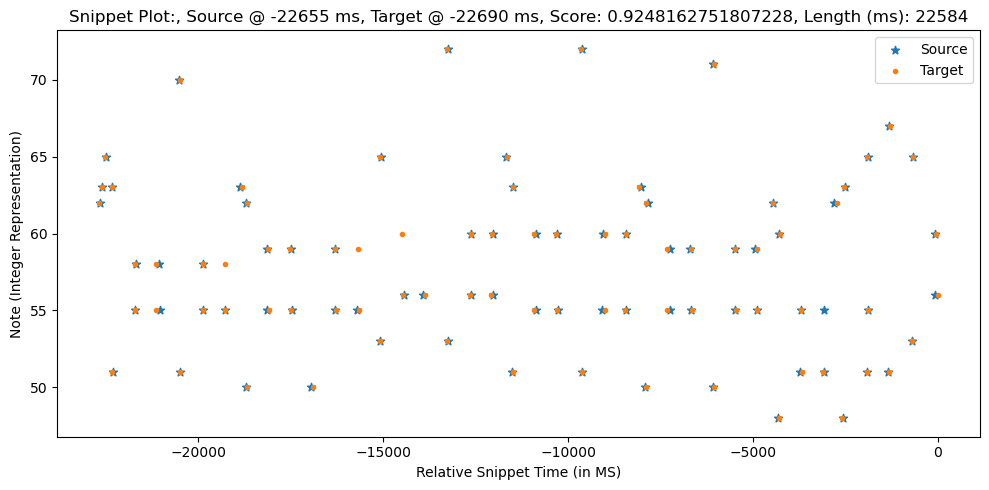

0.9250038632530121
Scores: [ 0.9125  0.9575  0.905   1.      0.9425  0.98    0.995   0.735   0.815
  0.955   0.9625  0.9375  0.9675  0.975  -0.      0.925   0.9425  0.9625
  0.91    0.9     0.9725  0.9375  0.87    0.96    0.945  -0.      0.9225
  0.9875  0.975  -0.      0.9375  0.82    0.9425  0.9375  0.9175  0.96
  0.9225  0.95    0.9275  0.995   0.9125  0.84    0.86    0.925   0.925
  0.9925  0.985   0.815   0.855   0.955   1.      0.8475  0.945   0.9
  0.8075  0.7975  0.9275  0.95    0.9725  0.9775  0.9925  0.97    0.9
  0.9575  0.9725  0.94    0.925   0.96    0.88    0.9575  0.8325  0.9325
  0.975   0.9425  0.965   0.97    0.9675  0.9725  0.995   0.985   0.8775
  0.8225  0.8575  0.98    0.9725  0.995   0.925 ]
Sequence1:  [[-24473     62     49]
 [-24397     63     54]
 [-24313     65     59]
 [-24130     63     54]
 [-24113     51     53]
 [-23491     58     36]
 [-23489     55     44]
 [-22933     55     49]
 [-22919     58     44]
 [-22282     70     58]
 [-22271     51     46]


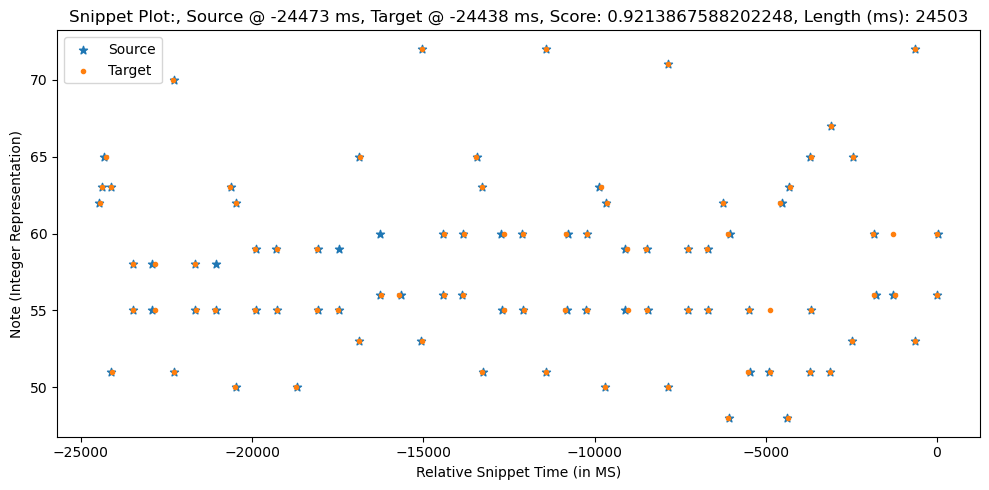

Scores: [ 0.9125  0.9575  0.905   1.      0.9425  0.995   0.98    0.815   0.735
  0.955   0.9625  0.9675  0.9375  0.975   0.925   0.9425  0.9625  0.9
  0.91    0.9725  0.9375  0.87    0.945   0.96    0.9225  0.9875  0.975
  0.9375  0.82    0.9425  0.9375  0.96    0.9175  0.9225  0.95    0.9275
  0.9125  0.995   0.84    0.86    0.925   0.925   0.9925  0.985   0.815
  0.855   0.955   1.      0.8475  0.945   0.9     0.8075  0.7975  0.9275
  0.95    0.9725  0.9775  0.97    0.9925  0.9     0.9575  0.9725  0.94
  0.925   0.88    0.96    0.9575 -0.      0.8325  0.9325  0.975   0.965
  0.9425  0.97    0.9675  0.9725  0.995   0.985   0.8775  0.8225 -0.
  0.8575  0.9725  0.98    0.995   0.925 ]
Sequence1:  [[-24468     62     43]
 [-24410     63     56]
 [-24305     65     45]
 [-24160     63     49]
 [-24120     51     53]
 [-23521     55     49]
 [-23513     58     34]
 [-22875     58     26]
 [-22857     55     35]
 [-22330     70     53]
 [-22316     51     51]
 [-21686     58     33]
 [-216

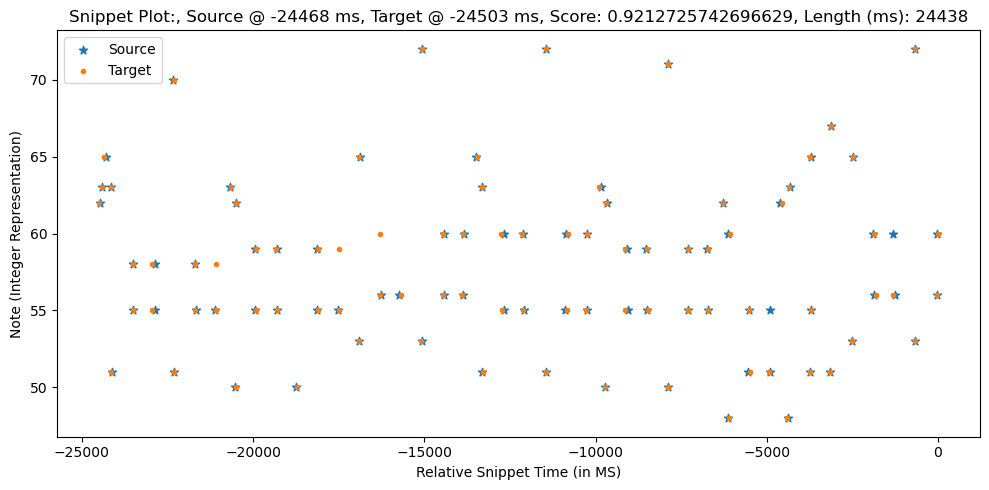

0.9213867588202248
Scores: [ 0.91    0.955   0.9025  0.9975  0.94    0.9775  0.9975  0.7325  0.8125
  0.9575  0.965   0.935   0.965   0.9775 -0.      0.9275  0.945   0.965
  0.9125  0.9025  0.97    0.935   0.8725  0.9625  0.9475 -0.      0.925
  0.99    0.9725 -0.      0.935   0.8225  0.94    0.935   0.915   0.9575
  0.92    0.9475  0.93    0.9925  0.915   0.8375  0.8575  0.9225  0.9225
  0.99    0.9875  0.8175  0.8575  0.9525  0.9975  0.845   0.9475  0.8975
  0.805   0.795   0.93    0.9525  0.975   0.98    0.995   0.9725  0.9025
  0.96    0.975   0.9425  0.9275  0.9575  0.8825  0.955   0.835   0.93
  0.9725  0.94    0.9675  0.9675  0.97    0.975   0.9975  0.9825  0.88
  0.825   0.855   0.9775  0.975   0.9925  0.9275  0.8375  0.995   0.9725
  0.965   0.9725  0.99    0.9075  0.9725  0.835 ]
Sequence1:  [[-26723     62     49]
 [-26647     63     54]
 [-26563     65     59]
 [-26380     63     54]
 [-26363     51     53]
 [-25741     58     36]
 [-25739     55     44]
 [-25183     55    

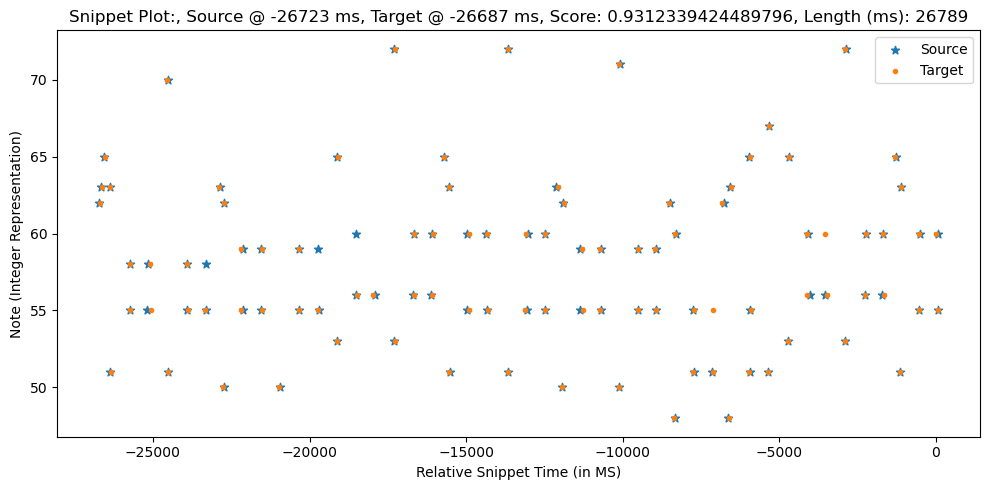

Scores: [ 0.91    0.955   0.9025  0.9975  0.94    0.9975  0.9775  0.8125  0.7325
  0.9575  0.965   0.965   0.935   0.9775  0.9275  0.945   0.965   0.9025
  0.9125  0.97    0.935   0.8725  0.9475  0.9625  0.925   0.99    0.9725
  0.935   0.8225  0.94    0.935   0.9575  0.915   0.92    0.9475  0.93
  0.915   0.9925  0.8375  0.8575  0.9225  0.9225  0.99    0.9875  0.8175
  0.8575  0.9525  0.9975  0.845   0.9475  0.8975  0.805   0.795   0.93
  0.9525  0.975   0.98    0.9725  0.995   0.9025  0.96    0.975   0.9425
  0.9275  0.8825  0.9575  0.955  -0.      0.835   0.93    0.9725  0.9675
  0.94    0.9675  0.97    0.975   0.9975  0.9825  0.88    0.825  -0.
  0.855   0.975   0.9775  0.9925  0.9275  0.995   0.8375  0.9725  0.965
  0.9725  0.9075  0.99    0.835   0.9725]
Sequence1:  [[-26748     62     43]
 [-26690     63     56]
 [-26585     65     45]
 [-26440     63     49]
 [-26400     51     53]
 [-25801     55     49]
 [-25793     58     34]
 [-25155     58     26]
 [-25137     55     35]
 

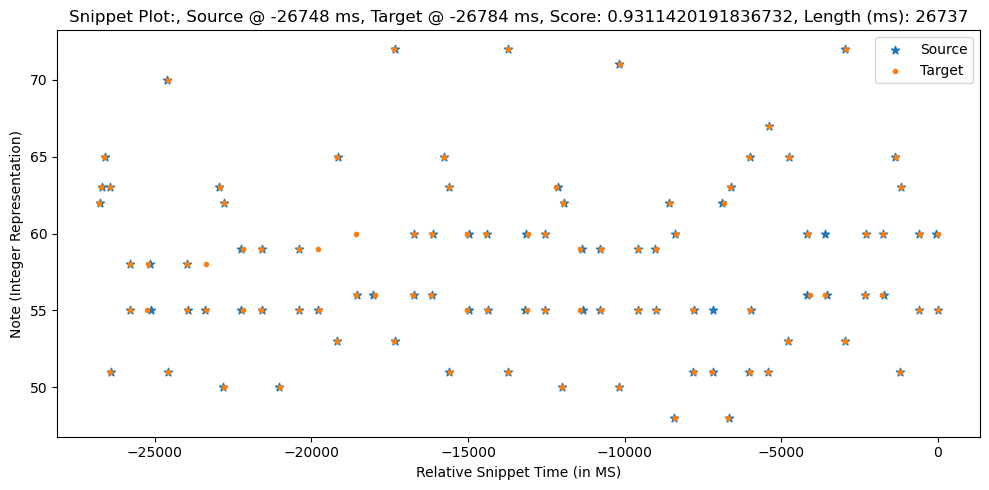

0.9312339424489796
Scores: [ 0.9075  0.9525  0.9     0.995   0.9375  0.975   1.      0.73    0.81
  0.96    0.9675  0.9325  0.9625  0.98   -0.      0.93    0.9475  0.9675
  0.915   0.905   0.9675  0.9325  0.875   0.965   0.95   -0.      0.9275
  0.9925  0.97   -0.      0.9325  0.825   0.9375  0.9325  0.9125  0.955
  0.9175  0.945   0.9325  0.99    0.9175  0.835   0.855   0.92    0.92
  0.9875  0.99    0.82    0.86    0.95    0.995   0.8425  0.95    0.895
  0.8025  0.7925  0.9325  0.955   0.9775  0.9825  0.9975  0.975   0.905
  0.9625  0.9775  0.945   0.93    0.955   0.885   0.9525  0.8375  0.9275
  0.97    0.9375  0.97    0.965   0.9725  0.9775  1.      0.98    0.8825
  0.8275  0.8525  0.975   0.9775  0.99    0.93    0.835   0.9975  0.975
  0.9675  0.975   0.9875  0.91    0.975   0.8375  0.985   0.9975  0.93
  0.935   0.      0.8875]
Sequence1:  [[-28574     62     49]
 [-28498     63     54]
 [-28414     65     59]
 [-28231     63     54]
 [-28214     51     53]
 [-27592     58     36

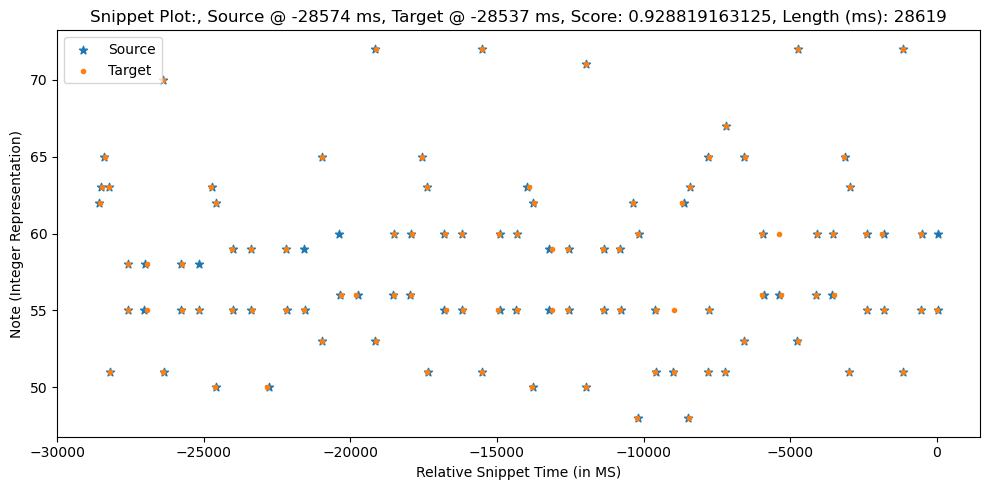

Scores: [ 0.9075  0.9525  0.9     0.995   0.9375  1.      0.975   0.81    0.73
  0.96    0.9675  0.9625  0.9325  0.98    0.93    0.9475  0.9675  0.905
  0.915   0.9675  0.9325  0.875   0.95    0.965   0.9275  0.9925  0.97
  0.9325  0.825   0.9375  0.9325  0.955   0.9125  0.9175  0.945   0.9325
  0.9175  0.99    0.835   0.855   0.92    0.92    0.9875  0.99    0.82
  0.86    0.95    0.995   0.8425  0.95    0.895   0.8025  0.7925  0.9325
  0.955   0.9775  0.9825  0.975   0.9975  0.905   0.9625  0.9775  0.945
  0.93    0.885   0.955   0.9525 -0.      0.8375  0.9275  0.97    0.97
  0.9375  0.965   0.9725  0.9775  1.      0.98    0.8825  0.8275 -0.
  0.8525  0.9775  0.975   0.99    0.93    0.9975  0.835   0.975   0.9675
  0.975   0.91    0.9875  0.8375  0.975   0.9975  0.985   0.93    0.935
  0.8875]
Sequence1:  [[-28582     62     43]
 [-28524     63     56]
 [-28419     65     45]
 [-28274     63     49]
 [-28234     51     53]
 [-27635     55     49]
 [-27627     58     34]
 [-26989     5

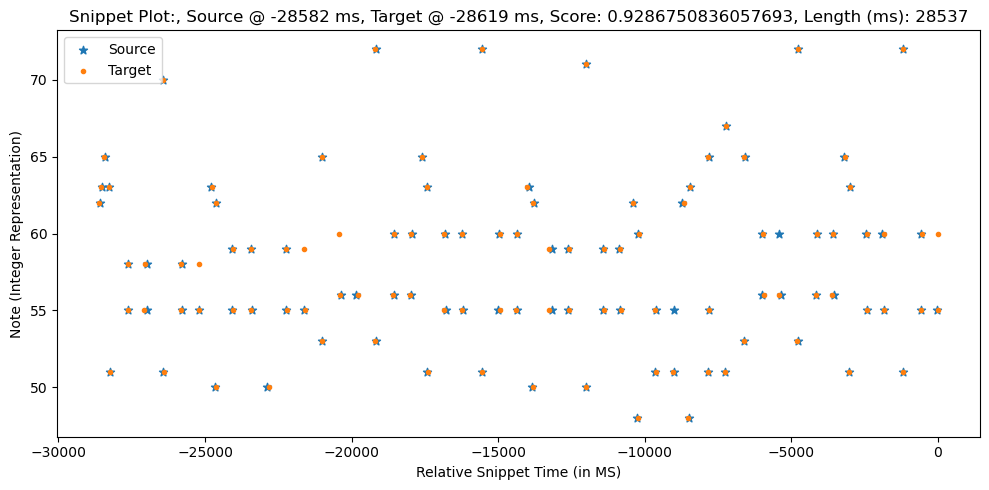

0.928819163125
Scores: [ 0.905   0.95    0.8975  0.9925  0.935   0.9725  0.9975  0.7275  0.8075
  0.9625  0.97    0.93    0.96    0.9825 -0.      0.9325  0.95    0.97
  0.9175  0.9075  0.965   0.93    0.8775  0.9675  0.9525 -0.      0.93
  0.995   0.9675 -0.      0.93    0.8275  0.935   0.93    0.91    0.9525
  0.915   0.9425  0.935   0.9875  0.92    0.8325  0.8525  0.9175  0.9175
  0.985   0.9925  0.8225  0.8625  0.9475  0.9925  0.84    0.9525  0.8925
  0.8     0.79    0.935   0.9575  0.98    0.985   1.      0.9775  0.9075
  0.965   0.98    0.9475  0.9325  0.9525  0.8875  0.95    0.84    0.925
  0.9675  0.935   0.9725  0.9625  0.975   0.98    0.9975  0.9775  0.885
  0.83    0.85    0.9725  0.98    0.9875  0.9325  0.8325  1.      0.9775
  0.97    0.9775  0.985   0.9125  0.9775  0.84    0.9825  0.995   0.9325
  0.9375 -0.      0.89    0.895   0.76    0.9025  1.      0.9675  0.975
  0.9275]
Sequence1:  [[-30392     62     49]
 [-30316     63     54]
 [-30232     65     59]
 [-30049     6

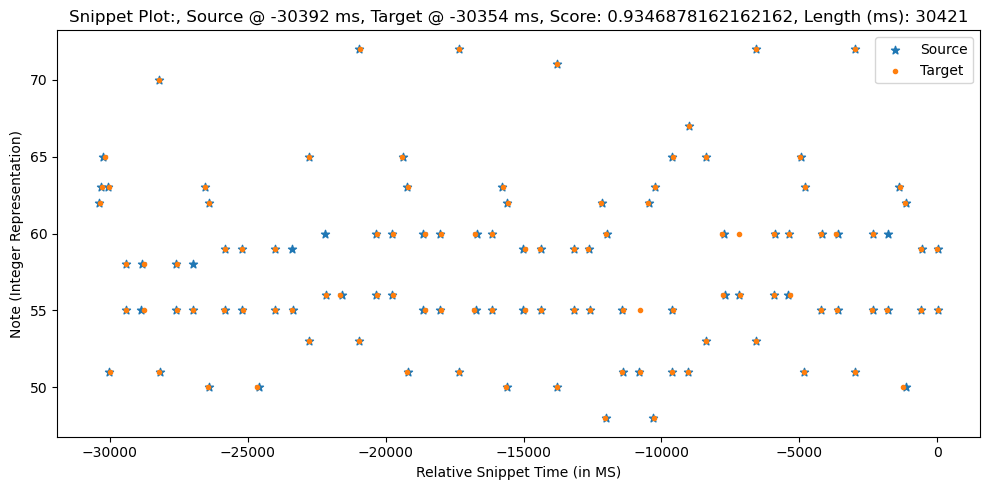

Scores: [ 0.905   0.95    0.8975  0.9925  0.935   0.9975  0.9725  0.8075  0.7275
  0.9625  0.97    0.96    0.93    0.9825  0.9325  0.95    0.97    0.9075
  0.9175  0.965   0.93    0.8775  0.9525  0.9675  0.93    0.995   0.9675
  0.93    0.8275  0.935   0.93    0.9525  0.91    0.915   0.9425  0.935
  0.92    0.9875  0.8325  0.8525  0.9175  0.9175  0.985   0.9925  0.8225
  0.8625  0.9475  0.9925  0.84    0.9525  0.8925  0.8     0.79    0.935
  0.9575  0.98    0.985   0.9775  1.      0.9075  0.965   0.98    0.9475
  0.9325  0.8875  0.9525  0.95   -0.      0.84    0.925   0.9675  0.9725
  0.935   0.9625  0.975   0.98    0.9975  0.9775  0.885   0.83   -0.
  0.85    0.98    0.9725  0.9875  0.9325  1.      0.8325  0.9775  0.97
  0.9775  0.9125  0.985   0.84    0.9775  0.995   0.9825  0.9325  0.9375
  0.89    0.895   0.76    0.9025  1.      0.9675  0.9275  0.975 ]
Sequence1:  [[-30375     62     43]
 [-30317     63     56]
 [-30212     65     45]
 [-30067     63     49]
 [-30027     51     53]

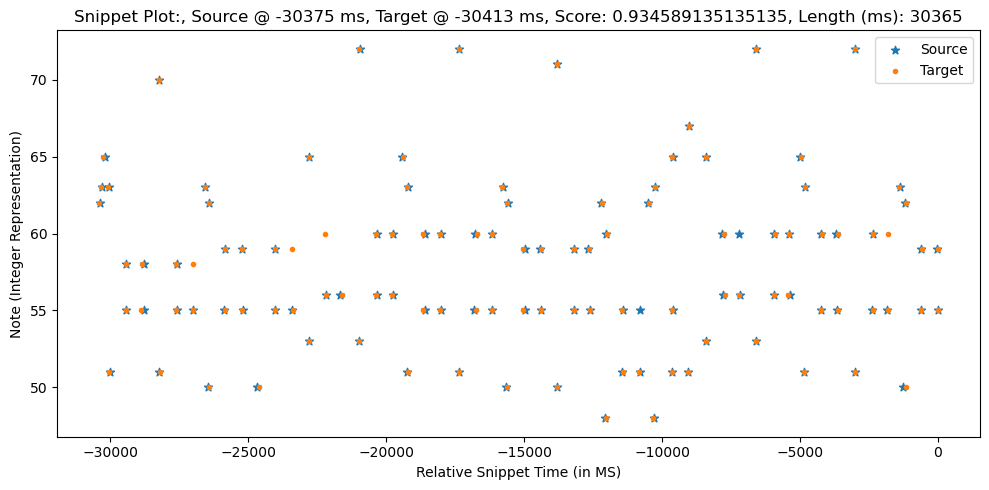

0.9346878162162162
Scores: [ 0.8975  0.9425  0.89    0.985   0.9275  0.965   0.99    0.72    0.8
  0.97    0.9775  0.9225  0.9525  0.99   -0.      0.94    0.9575  0.9775
  0.925   0.915   0.9575  0.9225  0.885   0.975   0.96   -0.      0.9375
  0.9975  0.96   -0.      0.9225  0.835   0.9275  0.9225  0.9025  0.945
  0.9075  0.935   0.9425  0.98    0.9275  0.825   0.845   0.91    0.91
  0.9775  1.      0.83    0.87    0.94    0.985   0.8325  0.96    0.885
  0.7925  0.7825  0.9425  0.965   0.9875  0.9925  0.9925  0.985   0.915
  0.9725  0.9875  0.955   0.94    0.945   0.895   0.9425  0.8475  0.9175
  0.96    0.9275  0.98    0.955   0.9825  0.9875  0.99    0.97    0.8925
  0.8375  0.8425  0.965   0.9875  0.98    0.94    0.825   0.9925  0.985
  0.9775  0.985   0.9775  0.92    0.985   0.8475  0.975   0.9875  0.94
  0.945  -0.      0.8975  0.8875  0.7675  0.91    0.9925  0.975   0.9825
  0.935   0.9575  0.905   0.8975  0.8725  0.8875  0.8875  0.865   0.7875
  0.8975]
Sequence1:  [[-32818     

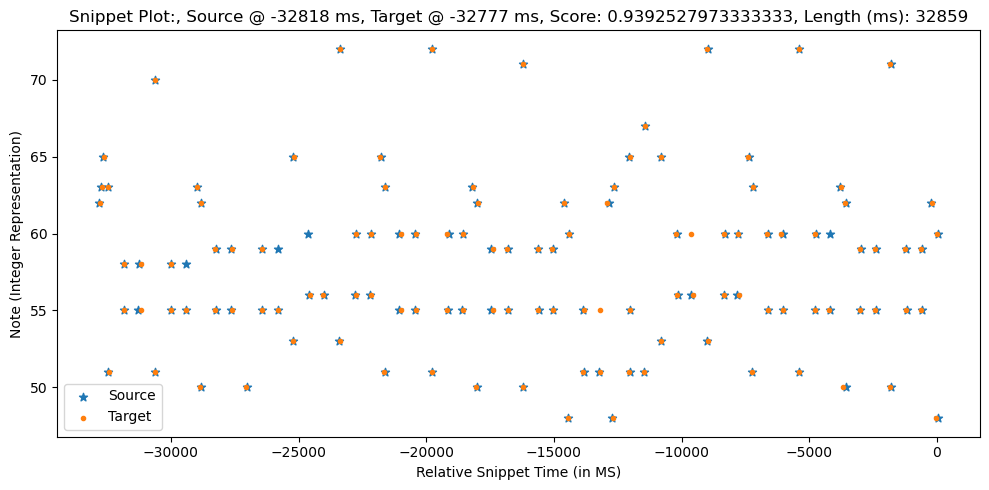

Scores: [ 0.8975  0.9425  0.89    0.985   0.9275  0.99    0.965   0.8     0.72
  0.97    0.9775  0.9525  0.9225  0.99    0.94    0.9575  0.9775  0.915
  0.925   0.9575  0.9225  0.885   0.96    0.975   0.9375  0.9975  0.96
  0.9225  0.835   0.9275  0.9225  0.945   0.9025  0.9075  0.935   0.9425
  0.9275  0.98    0.825   0.845   0.91    0.91    0.9775  1.      0.83
  0.87    0.94    0.985   0.8325  0.96    0.885   0.7925  0.7825  0.9425
  0.965   0.9875  0.9925  0.985   0.9925  0.915   0.9725  0.9875  0.955
  0.94    0.895   0.945   0.9425 -0.      0.8475  0.9175  0.96    0.98
  0.9275  0.955   0.9825  0.9875  0.99    0.97    0.8925  0.8375 -0.
  0.8425  0.9875  0.965   0.98    0.94    0.9925  0.825   0.985   0.9775
  0.985   0.92    0.9775  0.8475  0.985   0.9875  0.975   0.94    0.945
  0.8975  0.8875  0.7675  0.91    0.9925  0.975   0.935   0.9825  0.9575
  0.905   0.8975  0.8725  0.8875  0.8875  0.865   0.7875  0.8975]
Sequence1:  [[-32818     62     43]
 [-32760     63     56]
 [-32

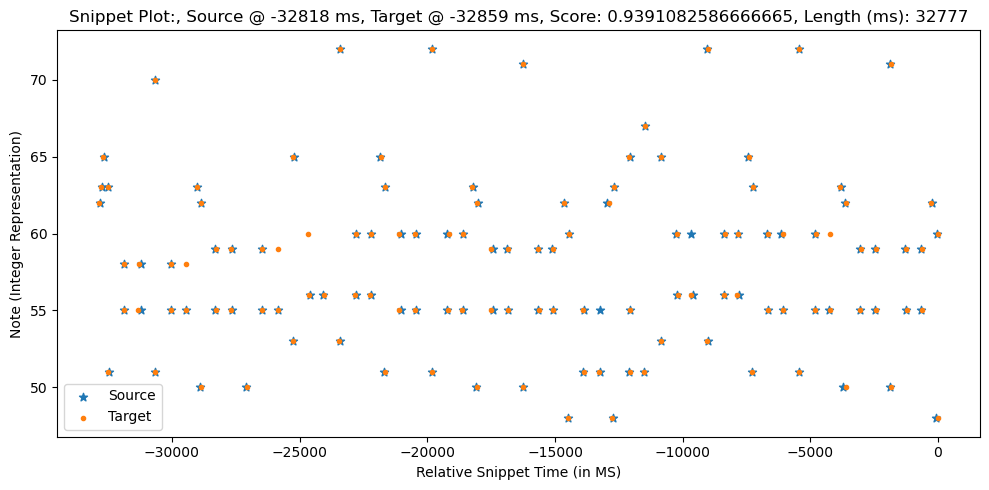

0.9392527973333333
Scores: [ 0.9     0.945   0.8925  0.9875  0.93    0.9675  0.9925  0.7225  0.8025
  0.9675  0.975   0.925   0.955   0.9875 -0.      0.9375  0.955   0.975
  0.9225  0.9125  0.96    0.925   0.8825  0.9725  0.9575 -0.      0.935
  1.      0.9625 -0.      0.925   0.8325  0.93    0.925   0.905   0.9475
  0.91    0.9375  0.94    0.9825  0.925   0.8275  0.8475  0.9125  0.9125
  0.98    0.9975  0.8275  0.8675  0.9425  0.9875  0.835   0.9575  0.8875
  0.795   0.785   0.94    0.9625  0.985   0.99    0.995   0.9825  0.9125
  0.97    0.985   0.9525  0.9375  0.9475  0.8925  0.945   0.845   0.92
  0.9625  0.93    0.9775  0.9575  0.98    0.985   0.9925  0.9725  0.89
  0.835   0.845   0.9675  0.985   0.9825  0.9375  0.8275  0.995   0.9825
  0.975   0.9825  0.98    0.9175  0.9825  0.845   0.9775  0.99    0.9375
  0.9425 -0.      0.895   0.89    0.765   0.9075  0.995   0.9725  0.98
  0.9325  0.955   0.9025  0.895   0.87    0.885   0.885   0.8675  0.785
  0.895   0.965   0.9825  0.9375 

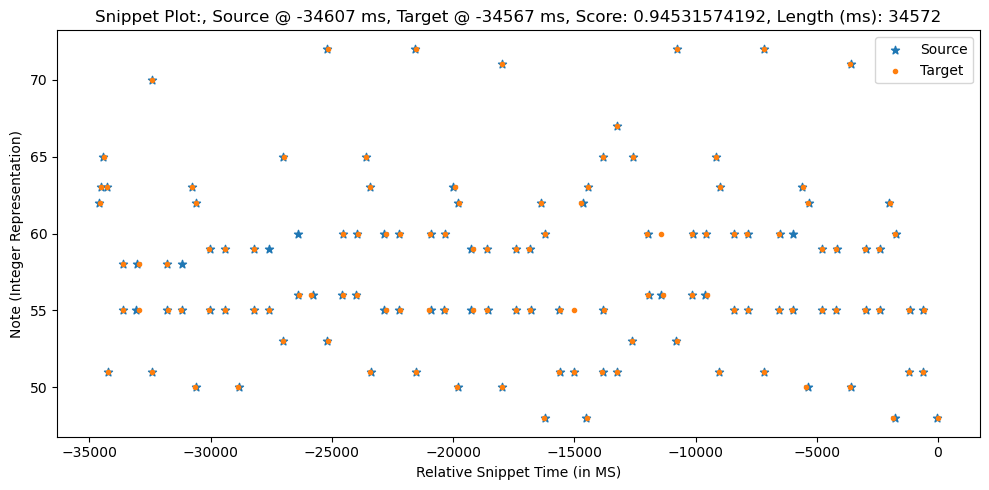

Scores: [ 0.9     0.945   0.8925  0.9875  0.93    0.9925  0.9675  0.8025  0.7225
  0.9675  0.975   0.955   0.925   0.9875  0.9375  0.955   0.975   0.9125
  0.9225  0.96    0.925   0.8825  0.9575  0.9725  0.935   1.      0.9625
  0.925   0.8325  0.93    0.925   0.9475  0.905   0.91    0.9375  0.94
  0.925   0.9825  0.8275  0.8475  0.9125  0.9125  0.98    0.9975  0.8275
  0.8675  0.9425  0.9875  0.835   0.9575  0.8875  0.795   0.785   0.94
  0.9625  0.985   0.99    0.9825  0.995   0.9125  0.97    0.985   0.9525
  0.9375  0.8925  0.9475  0.945  -0.      0.845   0.92    0.9625  0.9775
  0.93    0.9575  0.98    0.985   0.9925  0.9725  0.89    0.835  -0.
  0.845   0.985   0.9675  0.9825  0.9375  0.995   0.8275  0.9825  0.975
  0.9825  0.9175  0.98    0.845   0.9825  0.99    0.9775  0.9375  0.9425
  0.895   0.89    0.765   0.9075  0.995   0.9725  0.9325  0.98    0.955
  0.9025  0.895   0.87    0.885   0.885   0.8675  0.785   0.895   0.965
  0.9825  0.9375  0.98    0.9125]
Sequence1:  [[-34532

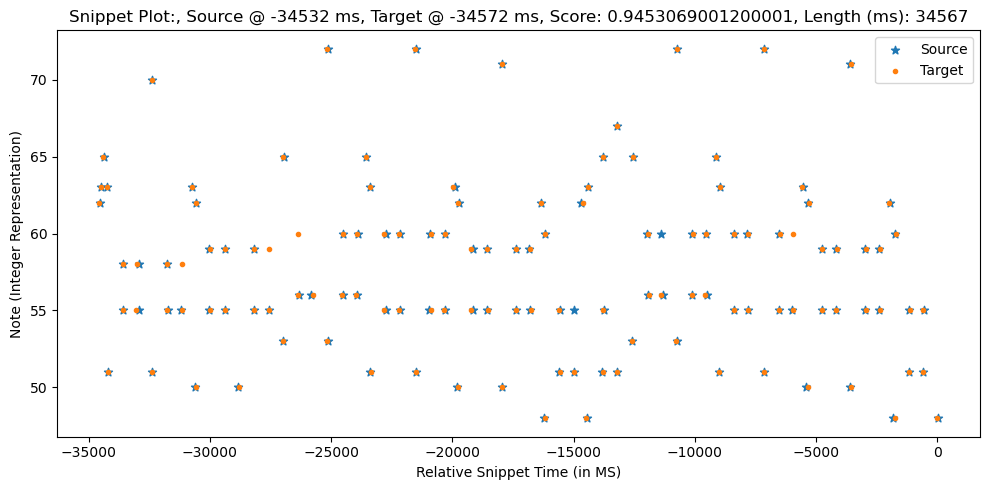

0.94531574192
Scores: [ 0.8925  0.9375  0.885   0.98    0.9225  0.96    0.985   0.715   0.795
  0.975   0.9825  0.9175  0.9475  0.995  -0.      0.945   0.9625  0.9825
  0.93    0.92    0.9525  0.9175  0.89    0.98    0.965  -0.      0.9425
  0.9925  0.955  -0.      0.9175  0.84    0.9225  0.9175  0.8975  0.94
  0.9025  0.93    0.9475  0.975   0.9325  0.82    0.84    0.905   0.905
  0.9725  0.995   0.835   0.875   0.935   0.98    0.8275  0.965   0.88
  0.7875  0.7775  0.9475  0.97    0.9925  0.9975  0.9875  0.99    0.92
  0.9775  0.9925  0.96    0.945   0.94    0.9     0.9375  0.8525  0.9125
  0.955   0.9225  0.985   0.95    0.9875  0.9925  0.985   0.965   0.8975
  0.8425  0.8375  0.96    0.9925  0.975   0.945   0.82    0.9875  0.99
  0.9825  0.99    0.9725  0.925   0.99    0.8525  0.97    0.9825  0.945
  0.95   -0.      0.9025  0.8825  0.7725  0.915   0.9875  0.98    0.9875
  0.94    0.9625  0.91    0.9025  0.8775  0.8925  0.8925  0.86    0.7925
  0.9025  0.9725  0.99    0.93    0.9725

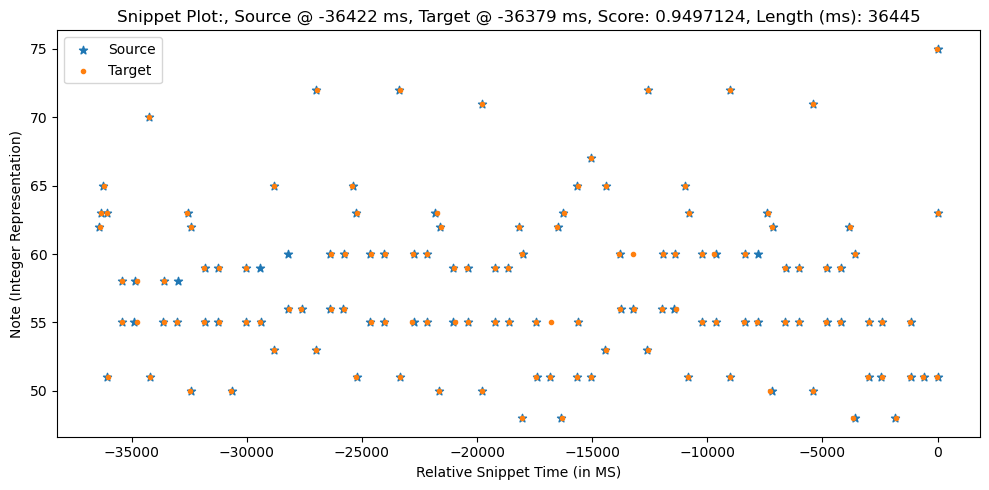

Scores: [ 0.8925  0.9375  0.885   0.98    0.9225  0.985   0.96    0.795   0.715
  0.975   0.9825  0.9475  0.9175  0.995   0.945   0.9625  0.9825  0.92
  0.93    0.9525  0.9175  0.89    0.965   0.98    0.9425  0.9925  0.955
  0.9175  0.84    0.9225  0.9175  0.94    0.8975  0.9025  0.93    0.9475
  0.9325  0.975   0.82    0.84    0.905   0.905   0.9725  0.995   0.835
  0.875   0.935   0.98    0.8275  0.965   0.88    0.7875  0.7775  0.9475
  0.97    0.9925  0.9975  0.99    0.9875  0.92    0.9775  0.9925  0.96
  0.945   0.9     0.94    0.9375 -0.      0.8525  0.9125  0.955   0.985
  0.9225  0.95    0.9875  0.9925  0.985   0.965   0.8975  0.8425 -0.
  0.8375  0.9925  0.96    0.975   0.945   0.9875  0.82    0.99    0.9825
  0.99    0.925   0.9725  0.8525  0.99    0.9825  0.97    0.945   0.95
  0.9025  0.8825  0.7725  0.915   0.9875  0.98    0.94    0.9875  0.9625
  0.91    0.9025  0.8775  0.8925  0.8925  0.86    0.7925  0.9025  0.9725
  0.99    0.93    0.9725  0.905   0.8425  0.88    0.88   

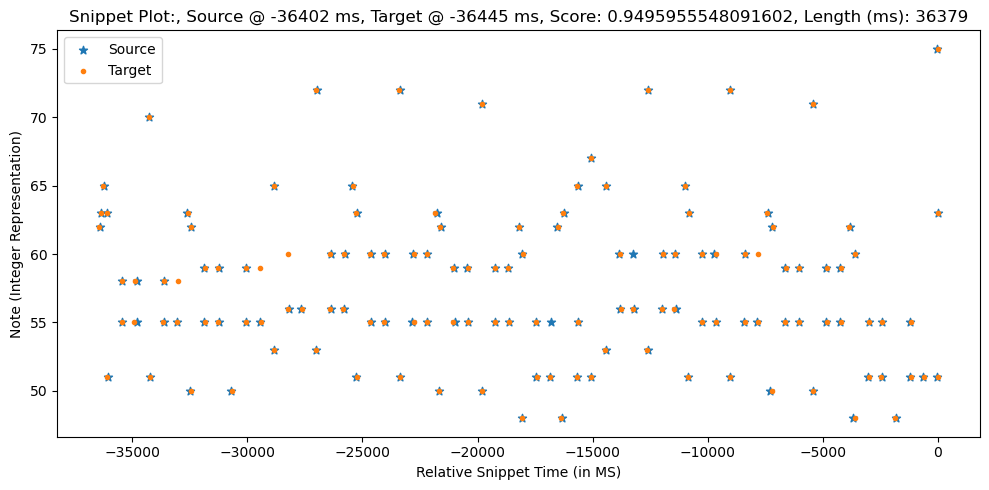

0.9497124
Scores: [ 0.8975  0.9425  0.89    0.985   0.9275  0.965   0.99    0.72    0.8
  0.97    0.9775  0.9225  0.9525  0.99   -0.      0.94    0.9575  0.9775
  0.925   0.915   0.9575  0.9225  0.885   0.975   0.96   -0.      0.9375
  0.9975  0.96   -0.      0.9225  0.835   0.9275  0.9225  0.9025  0.945
  0.9075  0.935   0.9425  0.98    0.9275  0.825   0.845   0.91    0.91
  0.9775  1.      0.83    0.87    0.94    0.985   0.8325  0.96    0.885
  0.7925  0.7825  0.9425  0.965   0.9875  0.9925  0.9925  0.985   0.915
  0.9725  0.9875  0.955   0.94    0.945   0.895   0.9425  0.8475  0.9175
  0.96    0.9275  0.98    0.955   0.9825  0.9875  0.99    0.97    0.8925
  0.8375  0.8425  0.965   0.9875  0.98    0.94    0.825   0.9925  0.985
  0.9775  0.985   0.9775  0.92    0.985   0.8475  0.975   0.9875  0.94
  0.945  -0.      0.8975  0.8875  0.7675  0.91    0.9925  0.975   0.9825
  0.935   0.9575  0.905   0.8975  0.8725  0.8875  0.8875  0.865   0.7875
  0.8975  0.9675  0.985   0.935   0.9775  0.

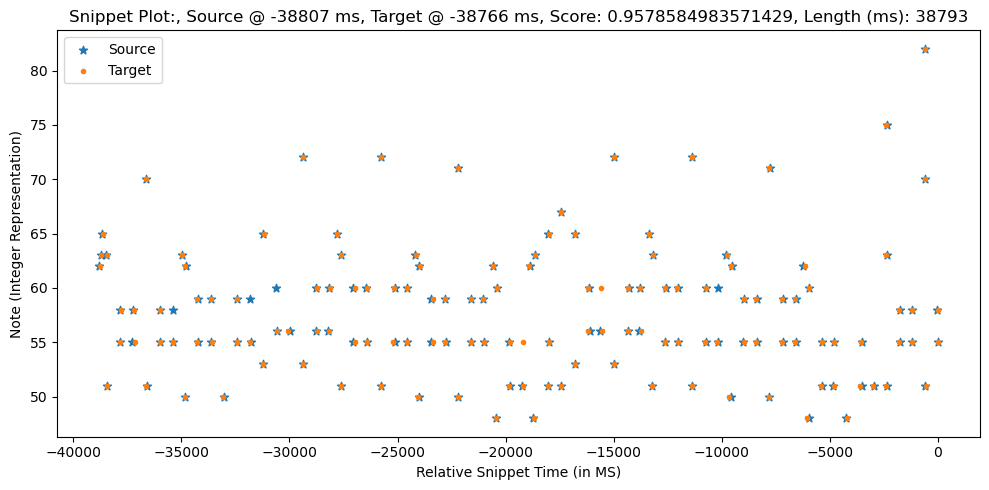

Scores: [ 0.8975  0.9425  0.89    0.985   0.9275  0.99    0.965   0.8     0.72
  0.97    0.9775  0.9525  0.9225  0.99    0.94    0.9575  0.9775  0.915
  0.925   0.9575  0.9225  0.885   0.96    0.975   0.9375  0.9975  0.96
  0.9225  0.835   0.9275  0.9225  0.945   0.9025  0.9075  0.935   0.9425
  0.9275  0.98    0.825   0.845   0.91    0.91    0.9775  1.      0.83
  0.87    0.94    0.985   0.8325  0.96    0.885   0.7925  0.7825  0.9425
  0.965   0.9875  0.9925  0.985   0.9925  0.915   0.9725  0.9875  0.955
  0.94    0.895   0.945   0.9425 -0.      0.8475  0.9175  0.96    0.98
  0.9275  0.955   0.9825  0.9875  0.99    0.97    0.8925  0.8375 -0.
  0.8425  0.9875  0.965   0.98    0.94    0.9925  0.825   0.985   0.9775
  0.985   0.92    0.9775  0.8475  0.985   0.9875  0.975   0.94    0.945
  0.8975  0.8875  0.7675  0.91    0.9925  0.975   0.935   0.9825  0.9575
  0.905   0.8975  0.8725  0.8875  0.8875  0.865   0.7875  0.8975  0.9675
  0.985   0.935   0.9775  0.91    0.8375  0.875   0.875   

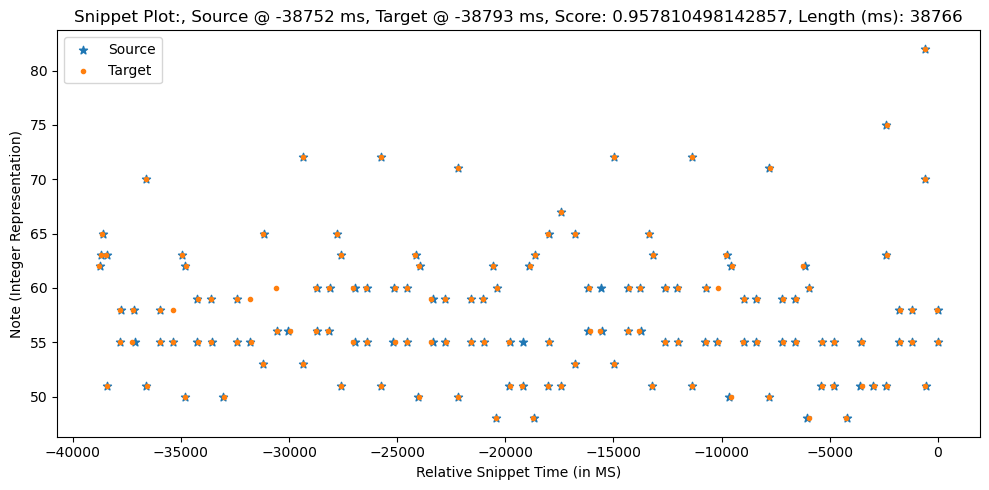

0.9578584983571429
Scores: [ 0.8925  0.9375  0.885   0.98    0.9225  0.96    0.985   0.715   0.795
  0.975   0.9825  0.9175  0.9475  0.995  -0.      0.945   0.9625  0.9825
  0.93    0.92    0.9525  0.9175  0.89    0.98    0.965  -0.      0.9425
  0.9925  0.955  -0.      0.9175  0.84    0.9225  0.9175  0.8975  0.94
  0.9025  0.93    0.9475  0.975   0.9325  0.82    0.84    0.905   0.905
  0.9725  0.995   0.835   0.875   0.935   0.98    0.8275  0.965   0.88
  0.7875  0.7775  0.9475  0.97    0.9925  0.9975  0.9875  0.99    0.92
  0.9775  0.9925  0.96    0.945   0.94    0.9     0.9375  0.8525  0.9125
  0.955   0.9225  0.985   0.95    0.9875  0.9925  0.985   0.965   0.8975
  0.8425  0.8375  0.96    0.9925  0.975   0.945   0.82    0.9875  0.99
  0.9825  0.99    0.9725  0.925   0.99    0.8525  0.97    0.9825  0.945
  0.95   -0.      0.9025  0.8825  0.7725  0.915   0.9875  0.98    0.9875
  0.94    0.9625  0.91    0.9025  0.8775  0.8925  0.8925  0.86    0.7925
  0.9025  0.9725  0.99    0.93    0

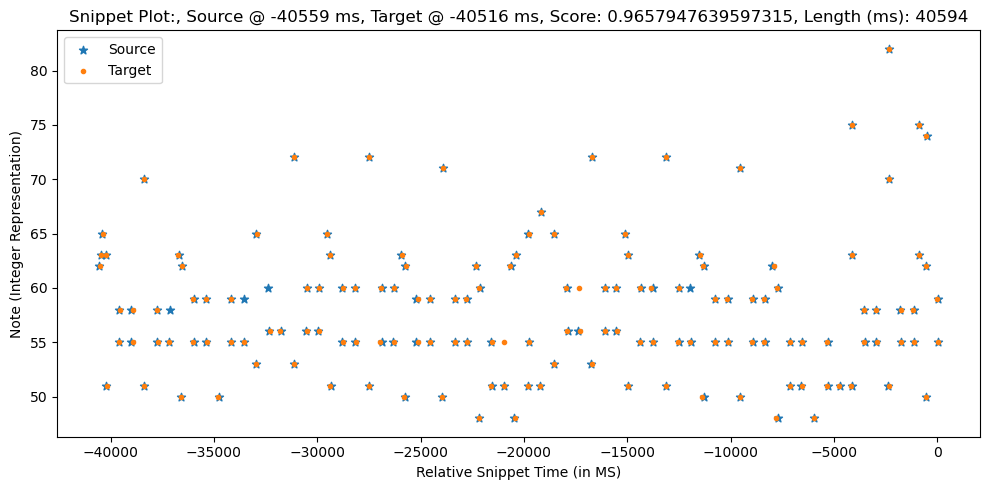

Scores: [ 0.8925  0.9375  0.885   0.98    0.9225  0.985   0.96    0.795   0.715
  0.975   0.9825  0.9475  0.9175  0.995   0.945   0.9625  0.9825  0.92
  0.93    0.9525  0.9175  0.89    0.965   0.98    0.9425  0.9925  0.955
  0.9175  0.84    0.9225  0.9175  0.94    0.8975  0.9025  0.93    0.9475
  0.9325  0.975   0.82    0.84    0.905   0.905   0.9725  0.995   0.835
  0.875   0.935   0.98    0.8275  0.965   0.88    0.7875  0.7775  0.9475
  0.97    0.9925  0.9975  0.99    0.9875  0.92    0.9775  0.9925  0.96
  0.945   0.9     0.94    0.9375 -0.      0.8525  0.9125  0.955   0.985
  0.9225  0.95    0.9875  0.9925  0.985   0.965   0.8975  0.8425 -0.
  0.8375  0.9925  0.96    0.975   0.945   0.9875  0.82    0.99    0.9825
  0.99    0.925   0.9725  0.8525  0.99    0.9825  0.97    0.945   0.95
  0.9025  0.8825  0.7725  0.915   0.9875  0.98    0.94    0.9875  0.9625
  0.91    0.9025  0.8775  0.8925  0.8925  0.86    0.7925  0.9025  0.9725
  0.99    0.93    0.9725  0.905   0.8425  0.88    0.88   

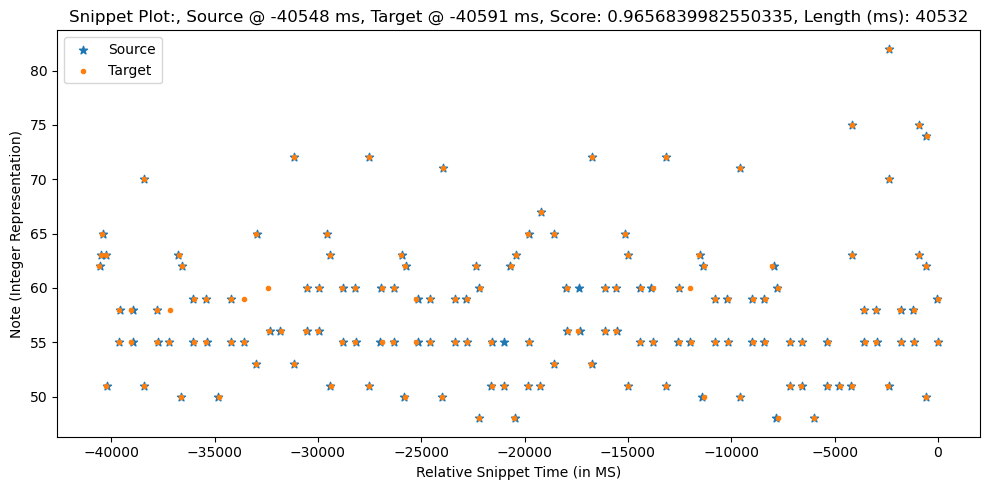

0.9657947639597315
Scores: [ 0.8925  0.9375  0.885   0.98    0.9225  0.96    0.985   0.715   0.795
  0.975   0.9825  0.9175  0.9475  0.995  -0.      0.945   0.9625  0.9825
  0.93    0.92    0.9525  0.9175  0.89    0.98    0.965  -0.      0.9425
  0.9925  0.955  -0.      0.9175  0.84    0.9225  0.9175  0.8975  0.94
  0.9025  0.93    0.9475  0.975   0.9325  0.82    0.84    0.905   0.905
  0.9725  0.995   0.835   0.875   0.935   0.98    0.8275  0.965   0.88
  0.7875  0.7775  0.9475  0.97    0.9925  0.9975  0.9875  0.99    0.92
  0.9775  0.9925  0.96    0.945   0.94    0.9     0.9375  0.8525  0.9125
  0.955   0.9225  0.985   0.95    0.9875  0.9925  0.985   0.965   0.8975
  0.8425  0.8375  0.96    0.9925  0.975   0.945   0.82    0.9875  0.99
  0.9825  0.99    0.9725  0.925   0.99    0.8525  0.97    0.9825  0.945
  0.95   -0.      0.9025  0.8825  0.7725  0.915   0.9875  0.98    0.9875
  0.94    0.9625  0.91    0.9025  0.8775  0.8925  0.8925  0.86    0.7925
  0.9025  0.9725  0.99    0.93    0

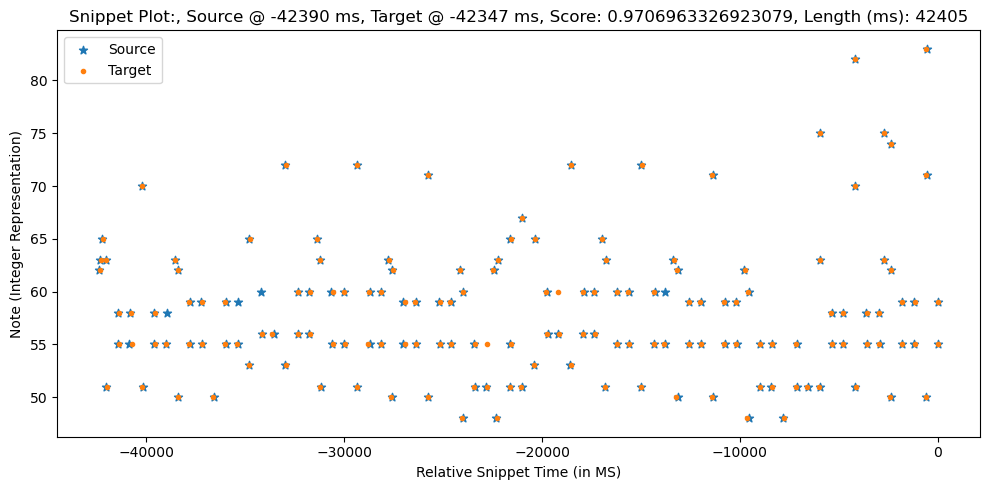

Scores: [ 0.895   0.94    0.8875  0.9825  0.925   0.9875  0.9625  0.7975  0.7175
  0.9725  0.98    0.95    0.92    0.9925  0.9425  0.96    0.98    0.9175
  0.9275  0.955   0.92    0.8875  0.9625  0.9775  0.94    0.995   0.9575
  0.92    0.8375  0.925   0.92    0.9425  0.9     0.905   0.9325  0.945
  0.93    0.9775  0.8225  0.8425  0.9075  0.9075  0.975   0.9975  0.8325
  0.8725  0.9375  0.9825  0.83    0.9625  0.8825  0.79    0.78    0.945
  0.9675  0.99    0.995   0.9875  0.99    0.9175  0.975   0.99    0.9575
  0.9425  0.8975  0.9425  0.94   -0.      0.85    0.915   0.9575  0.9825
  0.925   0.9525  0.985   0.99    0.9875  0.9675  0.895   0.84   -0.
  0.84    0.99    0.9625  0.9775  0.9425  0.99    0.8225  0.9875  0.98
  0.9875  0.9225  0.975   0.85    0.9875  0.985   0.9725  0.9425  0.9475
  0.9     0.885   0.77    0.9125  0.99    0.9775  0.9375  0.985   0.96
  0.9075  0.9     0.875   0.89    0.89    0.8625  0.79    0.9     0.97
  0.9875  0.9325  0.975   0.9075  0.84    0.8775  0.877

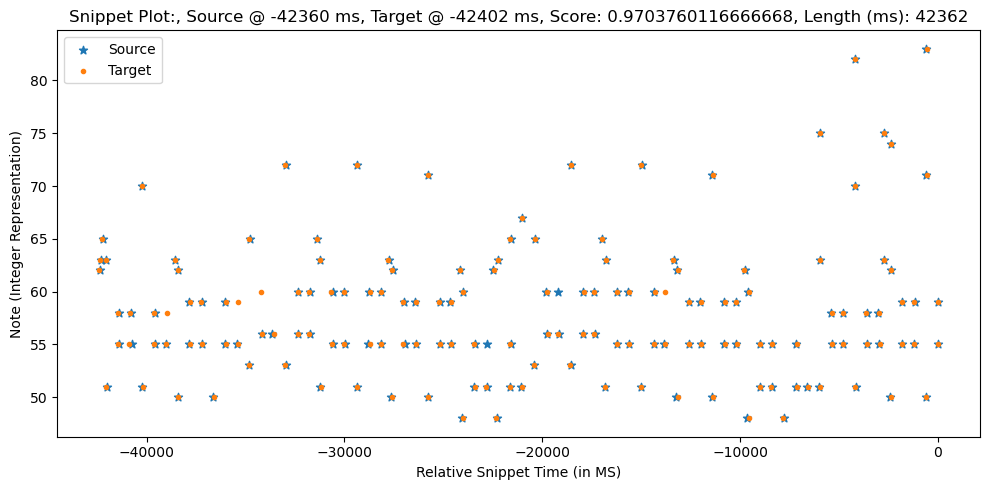

0.9706963326923079
Scores: [ 0.8925  0.9375  0.885   0.98    0.9225  0.96    0.985   0.715   0.795
  0.975   0.9825  0.9175  0.9475  0.995  -0.      0.945   0.9625  0.9825
  0.93    0.92    0.9525  0.9175  0.89    0.98    0.965  -0.      0.9425
  0.9925  0.955  -0.      0.9175  0.84    0.9225  0.9175  0.8975  0.94
  0.9025  0.93    0.9475  0.975   0.9325  0.82    0.84    0.905   0.905
  0.9725  0.995   0.835   0.875   0.935   0.98    0.8275  0.965   0.88
  0.7875  0.7775  0.9475  0.97    0.9925  0.9975  0.9875  0.99    0.92
  0.9775  0.9925  0.96    0.945   0.94    0.9     0.9375  0.8525  0.9125
  0.955   0.9225  0.985   0.95    0.9875  0.9925  0.985   0.965   0.8975
  0.8425  0.8375  0.96    0.9925  0.975   0.945   0.82    0.9875  0.99
  0.9825  0.99    0.9725  0.925   0.99    0.8525  0.97    0.9825  0.945
  0.95   -0.      0.9025  0.8825  0.7725  0.915   0.9875  0.98    0.9875
  0.94    0.9625  0.91    0.9025  0.8775  0.8925  0.8925  0.86    0.7925
  0.9025  0.9725  0.99    0.93    0

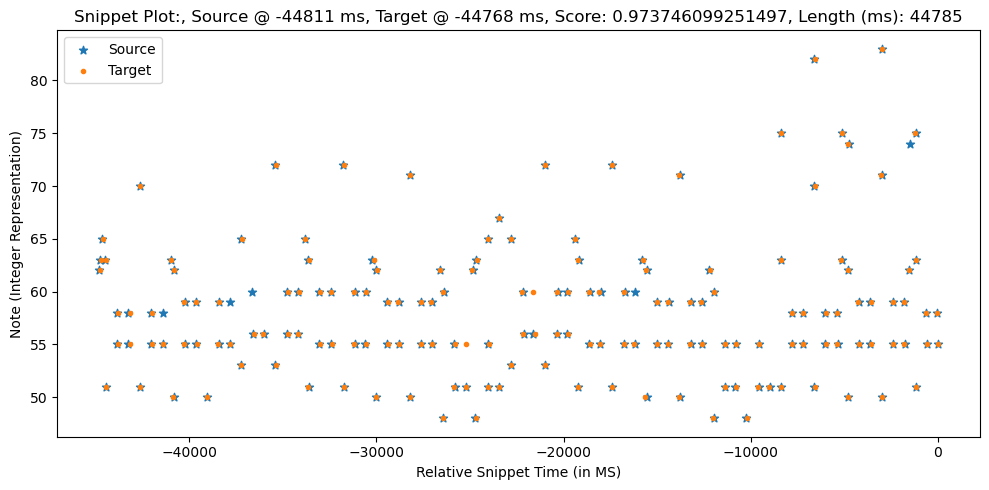

Scores: [ 0.8925  0.9375  0.885   0.98    0.9225  0.985   0.96    0.795   0.715
  0.975   0.9825  0.9475  0.9175  0.995   0.945   0.9625  0.9825  0.92
  0.93    0.9525  0.9175  0.89    0.965   0.98    0.9425  0.9925  0.955
  0.9175  0.84    0.9225  0.9175  0.94    0.8975  0.9025  0.93    0.9475
  0.9325  0.975   0.82    0.84    0.905   0.905   0.9725  0.995   0.835
  0.875   0.935   0.98    0.8275  0.965   0.88    0.7875  0.7775  0.9475
  0.97    0.9925  0.9975  0.99    0.9875  0.92    0.9775  0.9925  0.96
  0.945   0.9     0.94    0.9375 -0.      0.8525  0.9125  0.955   0.985
  0.9225  0.95    0.9875  0.9925  0.985   0.965   0.8975  0.8425 -0.
  0.8375  0.9925  0.96    0.975   0.945   0.9875  0.82    0.99    0.9825
  0.99    0.925   0.9725  0.8525  0.99    0.9825  0.97    0.945   0.95
  0.9025  0.8825  0.7725  0.915   0.9875  0.98    0.94    0.9875  0.9625
  0.91    0.9025  0.8775  0.8925  0.8925  0.86    0.7925  0.9025  0.9725
  0.99    0.93    0.9725  0.905   0.8425  0.88    0.88   

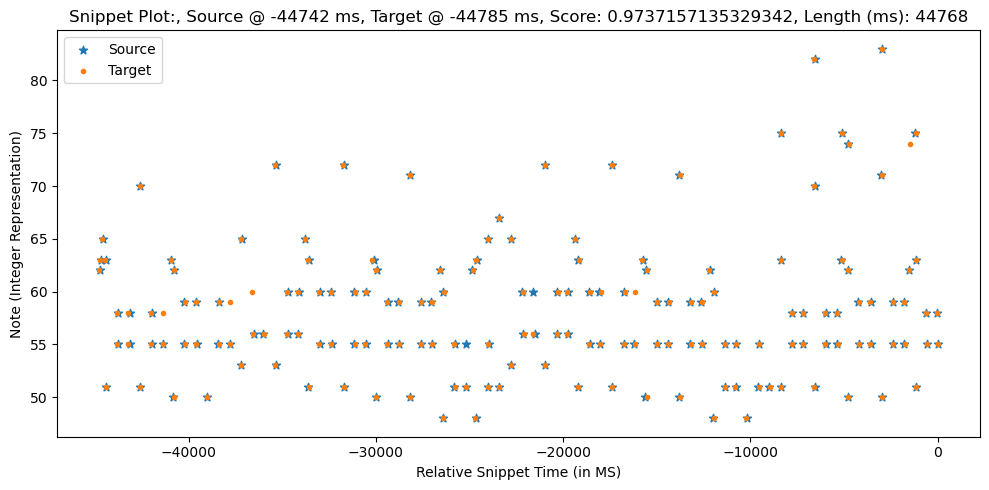

0.973746099251497
Scores: [ 0.8875  0.9325  0.88    0.975   0.9175  0.955   0.98    0.71    0.79
  0.98    0.9875  0.9125  0.9425  1.     -0.      0.95    0.9675  0.9875
  0.935   0.925   0.9475  0.9125  0.895   0.985   0.97   -0.      0.9475
  0.9875  0.95   -0.      0.9125  0.845   0.9175  0.9125  0.8925  0.935
  0.8975  0.925   0.9525  0.97    0.9375  0.815   0.835   0.9     0.9
  0.9675  0.99    0.84    0.88    0.93    0.975   0.8225  0.97    0.875
  0.7825  0.7725  0.9525  0.975   0.9975  0.9975  0.9825  0.995   0.925
  0.9825  0.9975  0.965   0.95    0.935   0.905   0.9325  0.8575  0.9075
  0.95    0.9175  0.99    0.945   0.9925  0.9975  0.98    0.96    0.9025
  0.8475  0.8325  0.955   0.9975  0.97    0.95    0.815   0.9825  0.995
  0.9875  0.995   0.9675  0.93    0.995   0.8575  0.965   0.9775  0.95
  0.955  -0.      0.9075  0.8775  0.7775  0.92    0.9825  0.985   0.9925
  0.945   0.9675  0.915   0.9075  0.8825  0.8975  0.8975  0.855   0.7975
  0.9075  0.9775  0.995   0.925   0.

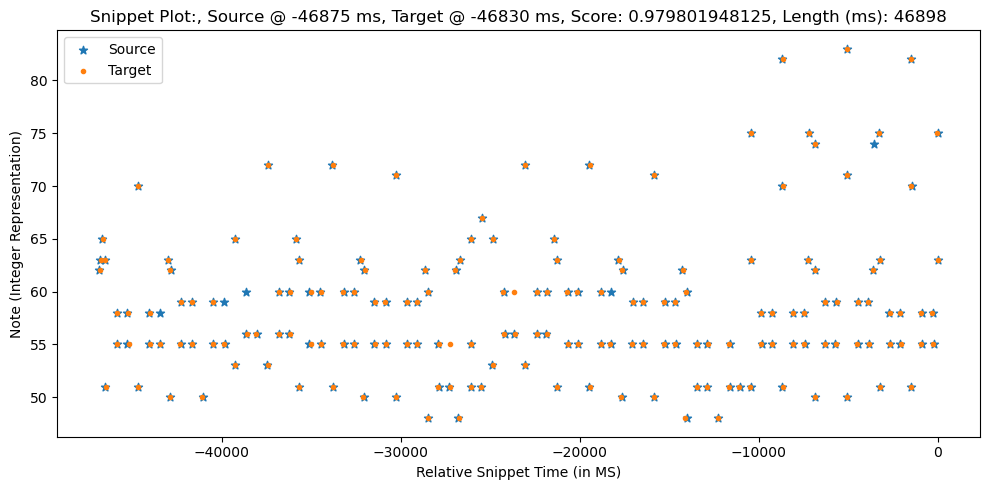

Scores: [ 0.8875  0.9325  0.88    0.975   0.9175  0.98    0.955   0.79    0.71
  0.98    0.9875  0.9425  0.9125  1.      0.95    0.9675  0.9875  0.925
  0.935   0.9475  0.9125  0.895   0.97    0.985   0.9475  0.9875  0.95
  0.9125  0.845   0.9175  0.9125  0.935   0.8925  0.8975  0.925   0.9525
  0.9375  0.97    0.815   0.835   0.9     0.9     0.9675  0.99    0.84
  0.88    0.93    0.975   0.8225  0.97    0.875   0.7825  0.7725  0.9525
  0.975   0.9975  0.9975  0.995   0.9825  0.925   0.9825  0.9975  0.965
  0.95    0.905   0.935   0.9325 -0.      0.8575  0.9075  0.95    0.99
  0.9175  0.945   0.9925  0.9975  0.98    0.96    0.9025  0.8475 -0.
  0.8325  0.9975  0.955   0.97    0.95    0.9825  0.815   0.995   0.9875
  0.995   0.93    0.9675  0.8575  0.995   0.9775  0.965   0.95    0.955
  0.9075  0.8775  0.7775  0.92    0.9825  0.985   0.945   0.9925  0.9675
  0.915   0.9075  0.8825  0.8975  0.8975  0.855   0.7975  0.9075  0.9775
  0.995   0.925   0.9675  0.9     0.8475  0.885   0.885   

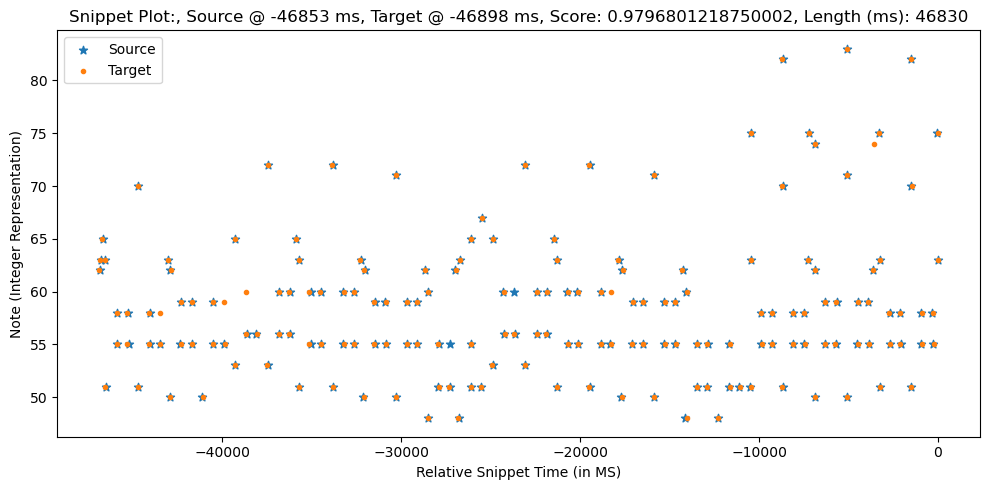

0.979801948125
Scores: [ 0.875   0.92    0.8675  0.9625  0.905   0.9425  0.9675  0.6975  0.7775
  0.9925  1.      0.9     0.93    0.9875 -0.      0.9625  0.98    1.
  0.9475  0.9375  0.935   0.9     0.9075  0.9975  0.9825 -0.      0.96
  0.975   0.9375 -0.      0.9     0.8575  0.905   0.9     0.88    0.9225
  0.885   0.9125  0.965   0.9575  0.95    0.8025  0.8225  0.8875  0.8875
  0.955   0.9775  0.8525  0.8925  0.9175  0.9625  0.81    0.9825  0.8625
  0.77    0.76    0.965   0.9875  0.99    0.985   0.97    0.9925  0.9375
  0.995   0.99    0.9775  0.9625  0.9225  0.9175  0.92    0.87    0.895
  0.9375  0.905   0.9975  0.9325  0.995   0.99    0.9675  0.9475  0.915
  0.86    0.82    0.9425  0.99    0.9575  0.9625  0.8025  0.97    0.9925
  1.      0.9925  0.955   0.9425  0.9925  0.87    0.9525  0.965   0.9625
  0.9675 -0.      0.92    0.865   0.79    0.9325  0.97    0.9975  0.995
  0.9575  0.98    0.9275  0.92    0.895   0.91    0.91    0.8425  0.81
  0.92    0.99    0.9925  0.9125  0.955

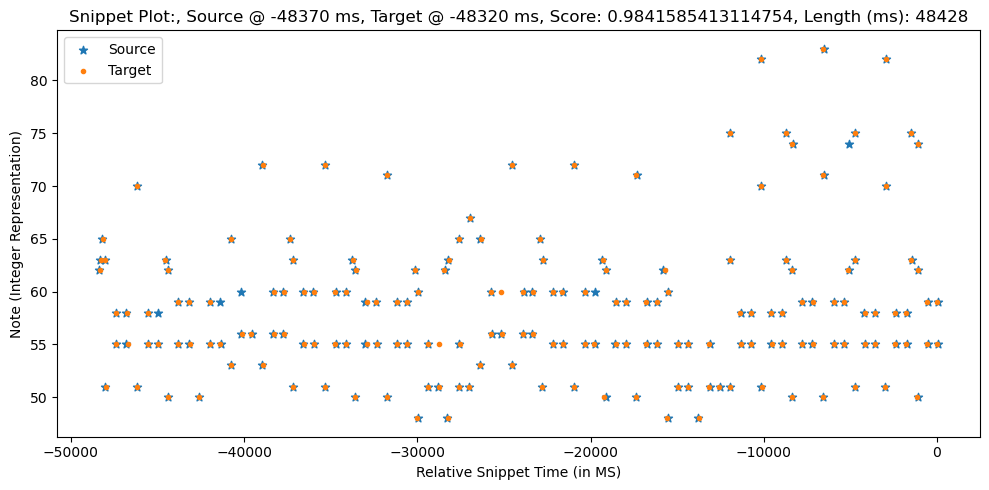

Scores: [ 0.885   0.93    0.8775  0.9725  0.915   0.9775  0.9525  0.7875  0.7075
  0.9825  0.99    0.94    0.91    0.9975  0.9525  0.97    0.99    0.9275
  0.9375  0.945   0.91    0.8975  0.9725  0.9875  0.95    0.985   0.9475
  0.91    0.8475  0.915   0.91    0.9325  0.89    0.895   0.9225  0.955
  0.94    0.9675  0.8125  0.8325  0.8975  0.8975  0.965   0.9875  0.8425
  0.8825  0.9275  0.9725  0.82    0.9725  0.8725  0.78    0.77    0.955
  0.9775  1.      0.995   0.9975  0.98    0.9275  0.985   1.      0.9675
  0.9525  0.9075  0.9325  0.93   -0.      0.86    0.905   0.9475  0.9925
  0.915   0.9425  0.995   1.      0.9775  0.9575  0.905   0.85   -0.
  0.83    1.      0.9525  0.9675  0.9525  0.98    0.8125  0.9975  0.99
  0.9975  0.9325  0.965   0.86    0.9975  0.975   0.9625  0.9525  0.9575
  0.91    0.875   0.78    0.9225  0.98    0.9875  0.9475  0.995   0.97
  0.9175  0.91    0.885   0.9     0.9     0.8525  0.8     0.91    0.98
  0.9975  0.9225  0.965   0.8975  0.85    0.8875  0.887

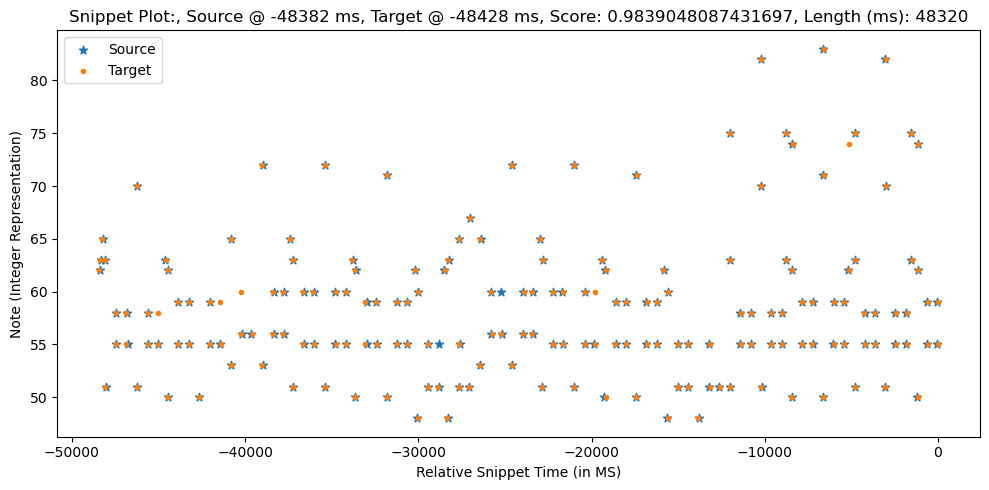

0.9841585413114754
Scores: [ 0.9925  0.9825  0.7475  0.8275  0.9425  0.95    0.95    0.98    0.9625
 -0.      0.9125  0.93    0.95    0.8975  0.8875  0.985   0.95  ]
Sequence1:  [[-4223    58    36]
 [-4221    55    44]
 [-3665    55    49]
 [-3651    58    44]
 [-3014    70    58]
 [-3003    51    46]
 [-2404    55    45]
 [-2401    58    32]
 [-1797    55    48]
 [-1785    58    39]
 [-1351    63    52]
 [-1215    50    42]
 [-1203    62    56]
 [ -621    59    46]
 [ -619    55    46]
 [  -26    59    42]
 [  -20    55    48]]
Sequence2:  [[-4228    55    49]
 [-4220    58    34]
 [-3582    58    26]
 [-3564    55    35]
 [-3037    70    53]
 [-3023    51    51]
 [-2393    58    33]
 [-2384    55    42]
 [-1812    55    48]
 [-1386    63    49]
 [-1243    50    44]
 [-1223    62    54]
 [ -664    55    44]
 [ -662    59    42]
 [  -20    59    41]
 [    0    55    45]]
mean_offset1:  -20.4375
mean_offset2:  20.4375
mo:  [0]
Count zeros:  1


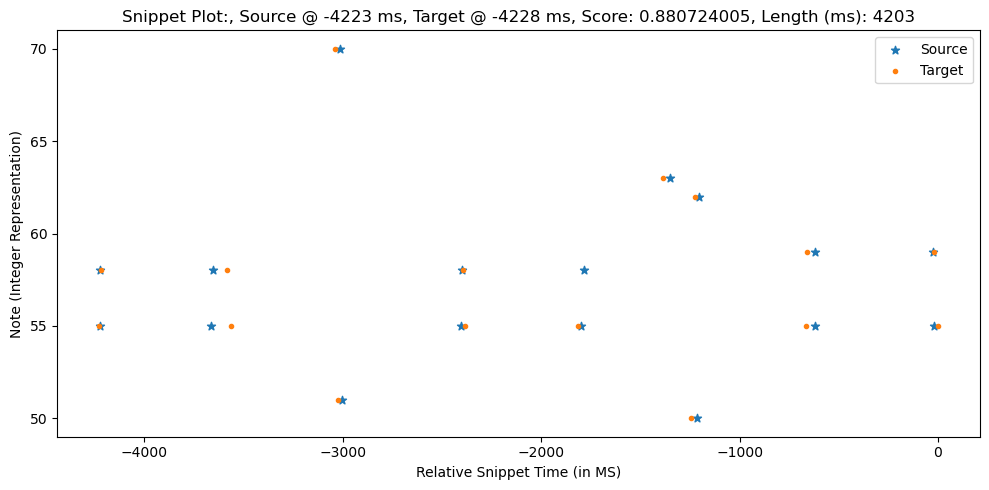

Scores: [0.9825 0.9925 0.8275 0.7475 0.9425 0.95   0.98   0.95   0.9625 0.9125
 0.93   0.95   0.8875 0.8975 0.985  0.95  ]
Sequence1:  [[-4208    55    49]
 [-4200    58    34]
 [-3562    58    26]
 [-3544    55    35]
 [-3017    70    53]
 [-3003    51    51]
 [-2373    58    33]
 [-2364    55    42]
 [-1792    55    48]
 [-1366    63    49]
 [-1223    50    44]
 [-1203    62    54]
 [ -644    55    44]
 [ -642    59    42]
 [    0    59    41]
 [   20    55    45]]
Sequence2:  [[-4203    58    36]
 [-4201    55    44]
 [-3645    55    49]
 [-3631    58    44]
 [-2994    70    58]
 [-2983    51    46]
 [-2384    55    45]
 [-2381    58    32]
 [-1777    55    48]
 [-1765    58    39]
 [-1331    63    52]
 [-1195    50    42]
 [-1183    62    56]
 [ -601    59    46]
 [ -599    55    46]
 [   -6    59    42]
 [    0    55    48]]
mean_offset1:  20.4375
mean_offset2:  -20.4375
mo:  [0]
Count zeros:  0


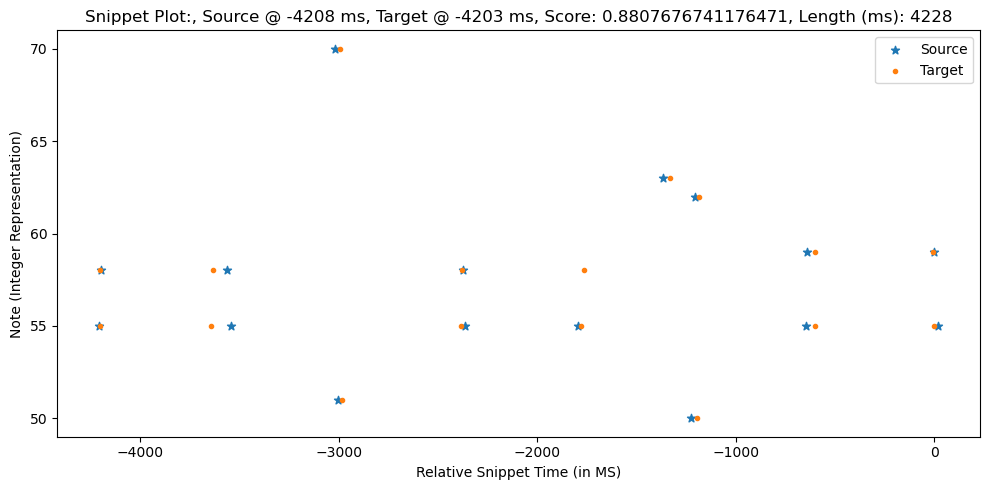

0.8807676741176471
Scores: [ 0.9725  0.9975  0.7275  0.8075  0.9625  0.97    0.93    0.96    0.9825
 -0.      0.9325  0.95    0.97    0.9175  0.9075  0.965   0.93    0.8775
  0.9675  0.9525  0.      0.93  ]
Sequence1:  [[-6009    58    36]
 [-6007    55    44]
 [-5451    55    49]
 [-5437    58    44]
 [-4800    70    58]
 [-4789    51    46]
 [-4190    55    45]
 [-4187    58    32]
 [-3583    55    48]
 [-3571    58    39]
 [-3137    63    52]
 [-3001    50    42]
 [-2989    62    56]
 [-2407    59    46]
 [-2405    55    46]
 [-1812    59    42]
 [-1806    55    48]
 [-1197    50    46]
 [ -596    59    39]
 [ -594    55    44]
 [   12    59    34]
 [   28    55    41]]
Sequence2:  [[-6006    55    49]
 [-5998    58    34]
 [-5360    58    26]
 [-5342    55    35]
 [-4815    70    53]
 [-4801    51    51]
 [-4171    58    33]
 [-4162    55    42]
 [-3590    55    48]
 [-3164    63    49]
 [-3021    50    44]
 [-3001    62    54]
 [-2442    55    44]
 [-2440    59    42]
 [-1798    5

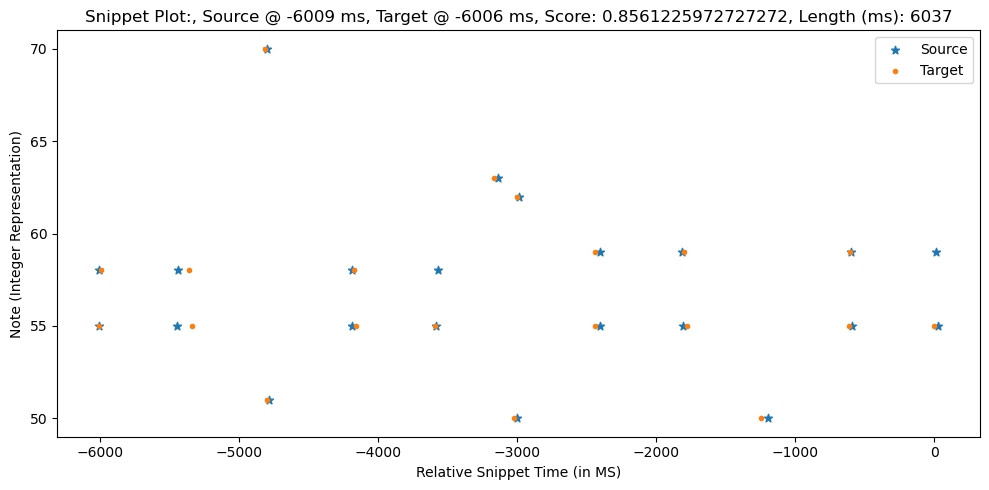

Scores: [0.9975 0.9725 0.8075 0.7275 0.9625 0.97   0.96   0.93   0.9825 0.9325
 0.95   0.97   0.9075 0.9175 0.965  0.93   0.8775 0.9525 0.9675 0.93  ]
Sequence1:  [[-6034    55    49]
 [-6026    58    34]
 [-5388    58    26]
 [-5370    55    35]
 [-4843    70    53]
 [-4829    51    51]
 [-4199    58    33]
 [-4190    55    42]
 [-3618    55    48]
 [-3192    63    49]
 [-3049    50    44]
 [-3029    62    54]
 [-2470    55    44]
 [-2468    59    42]
 [-1826    59    41]
 [-1806    55    45]
 [-1274    50    51]
 [ -641    55    44]
 [ -637    59    40]
 [  -28    55    47]]
Sequence2:  [[-6037    58    36]
 [-6035    55    44]
 [-5479    55    49]
 [-5465    58    44]
 [-4828    70    58]
 [-4817    51    46]
 [-4218    55    45]
 [-4215    58    32]
 [-3611    55    48]
 [-3599    58    39]
 [-3165    63    52]
 [-3029    50    42]
 [-3017    62    56]
 [-2435    59    46]
 [-2433    55    46]
 [-1840    59    42]
 [-1834    55    48]
 [-1225    50    46]
 [ -624    59    39]
 [ -6

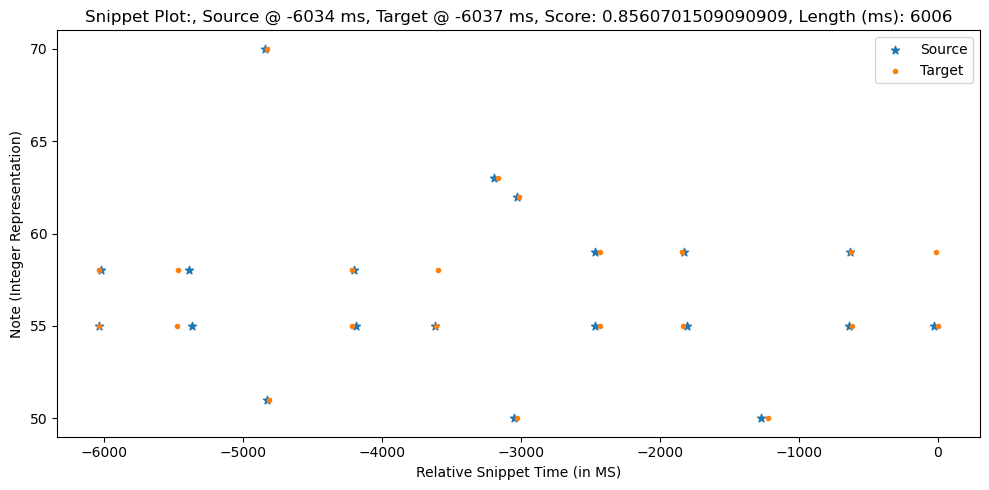

0.8561225972727272
Scores: [-0.     -0.      0.75    0.765  -0.     -0.     -0.     -0.      0.81
  0.8625 -0.     -0.     -0.     -0.     -0.      0.9325  0.9525 -0.
 -0.     -0.      0.915   0.965  -0.     -0.     -0.     -0.      0.7975
  0.      0.    ]
Sequence1:  [[-8426    58    36]
 [-8424    55    44]
 [-7868    55    49]
 [-7854    58    44]
 [-7217    70    58]
 [-7206    51    46]
 [-6607    55    45]
 [-6604    58    32]
 [-6000    55    48]
 [-5988    58    39]
 [-5554    63    52]
 [-5418    50    42]
 [-5406    62    56]
 [-4824    59    46]
 [-4822    55    46]
 [-4229    59    42]
 [-4223    55    48]
 [-3614    50    46]
 [-3013    59    39]
 [-3011    55    44]
 [-2405    59    34]
 [-2389    55    41]
 [-1806    53    47]
 [-1803    65    54]
 [-1215    60    34]
 [-1188    56    44]
 [ -586    56    45]
 [    6    53    46]
 [   13    72    59]]
Sequence2:  [[-7768    55    49]
 [-7760    58    34]
 [-7122    58    26]
 [-7104    55    35]
 [-6577    70    53]
 [-

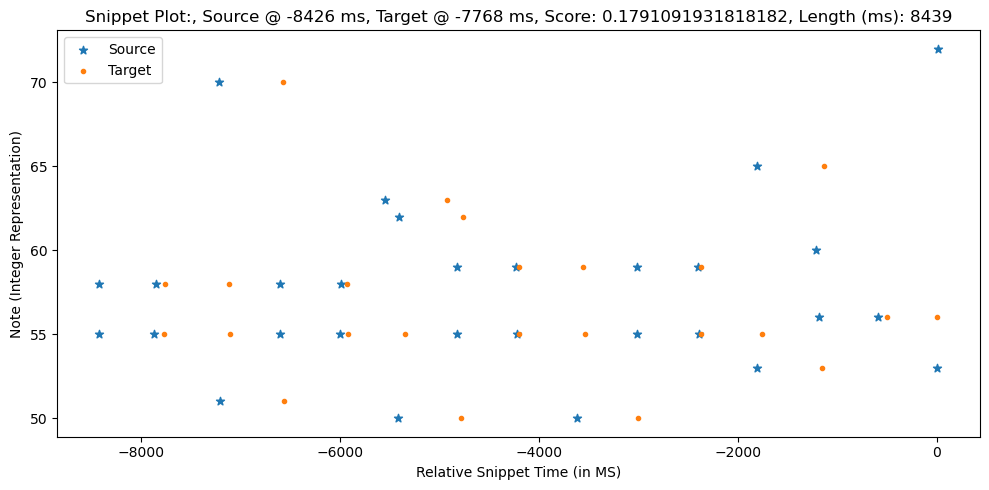

Scores: [0.995  0.97   0.805  0.725  0.965  0.9725 0.9575 0.9275 0.985  0.935
 0.9525 0.9725 0.91   0.92   0.9625 0.9275 0.88   0.955  0.97   0.9325
 0.9975 0.965  0.9275 0.83  ]
Sequence1:  [[-7836    55    49]
 [-7828    58    34]
 [-7190    58    26]
 [-7172    55    35]
 [-6645    70    53]
 [-6631    51    51]
 [-6001    58    33]
 [-5992    55    42]
 [-5420    55    48]
 [-4994    63    49]
 [-4851    50    44]
 [-4831    62    54]
 [-4272    55    44]
 [-4270    59    42]
 [-3628    59    41]
 [-3608    55    45]
 [-3076    50    51]
 [-2443    55    44]
 [-2439    59    40]
 [-1830    55    47]
 [-1221    53    43]
 [-1203    65    49]
 [ -573    56    41]
 [  -68    56    41]]
Sequence2:  [[-7840    58    36]
 [-7838    55    44]
 [-7282    55    49]
 [-7268    58    44]
 [-6631    70    58]
 [-6620    51    46]
 [-6021    55    45]
 [-6018    58    32]
 [-5414    55    48]
 [-5402    58    39]
 [-4968    63    52]
 [-4832    50    42]
 [-4820    62    56]
 [-4238    59    46

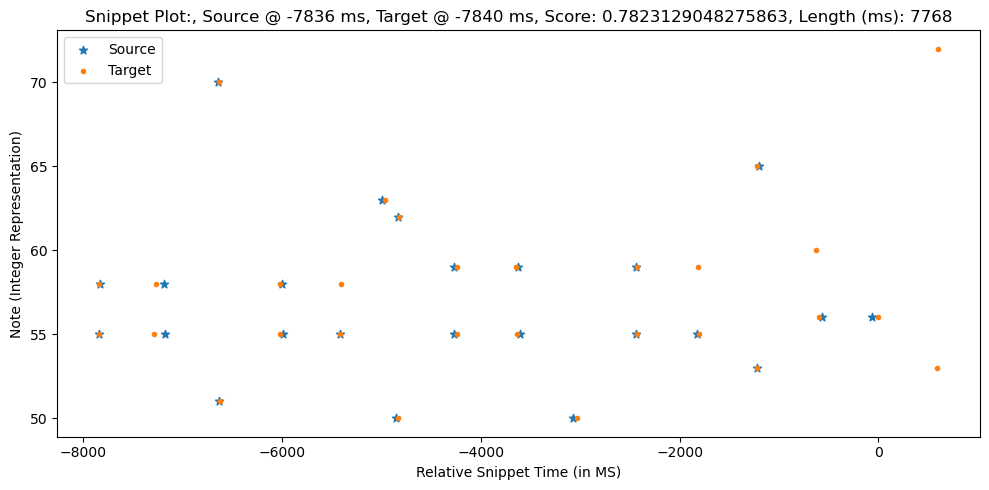

0.7823129048275863
Oops
Scores: [ 0.9775  0.9975  0.7325  0.8125  0.9575  0.965   0.935   0.965   0.9775
 -0.      0.9275  0.945   0.965   0.9125  0.9025  0.97    0.935   0.8725
  0.9625  0.9475 -0.      0.925   0.99    0.9725 -0.      0.935   0.8225
  0.94    0.935   0.915   0.9575  0.92    0.9475  0.93    0.9925  0.915 ]
Sequence1:  [[-10191     58     36]
 [-10189     55     44]
 [ -9633     55     49]
 [ -9619     58     44]
 [ -8982     70     58]
 [ -8971     51     46]
 [ -8372     55     45]
 [ -8369     58     32]
 [ -7765     55     48]
 [ -7753     58     39]
 [ -7319     63     52]
 [ -7183     50     42]
 [ -7171     62     56]
 [ -6589     59     46]
 [ -6587     55     46]
 [ -5994     59     42]
 [ -5988     55     48]
 [ -5379     50     46]
 [ -4778     59     39]
 [ -4776     55     44]
 [ -4170     59     34]
 [ -4154     55     41]
 [ -3571     53     47]
 [ -3568     65     54]
 [ -2980     60     34]
 [ -2953     56     44]
 [ -2351     56     45]
 [ -1759     53

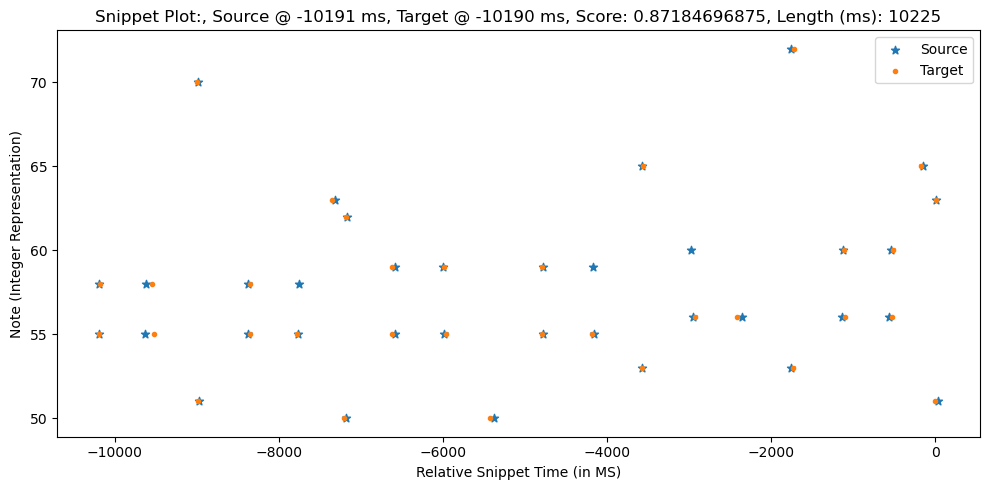

Scores: [0.995  0.98   0.815  0.735  0.955  0.9625 0.9675 0.9375 0.975  0.925
 0.9425 0.9625 0.9    0.91   0.9725 0.9375 0.87   0.945  0.96   0.9225
 0.9875 0.975  0.9375 0.82   0.9425 0.9375 0.96   0.9175 0.9225 0.95
 0.9275 0.9125 0.995 ]
Sequence1:  [[-10202     55     49]
 [-10194     58     34]
 [ -9556     58     26]
 [ -9538     55     35]
 [ -9011     70     53]
 [ -8997     51     51]
 [ -8367     58     33]
 [ -8358     55     42]
 [ -7786     55     48]
 [ -7360     63     49]
 [ -7217     50     44]
 [ -7197     62     54]
 [ -6638     55     44]
 [ -6636     59     42]
 [ -5994     59     41]
 [ -5974     55     45]
 [ -5442     50     51]
 [ -4809     55     44]
 [ -4805     59     40]
 [ -4196     55     47]
 [ -3587     53     43]
 [ -3569     65     49]
 [ -2939     56     41]
 [ -2434     56     41]
 [ -1747     53     54]
 [ -1738     72     55]
 [ -1121     60     32]
 [ -1115     56     44]
 [  -542     56     48]
 [  -526     60     31]
 [  -184     65     40]
 [ 

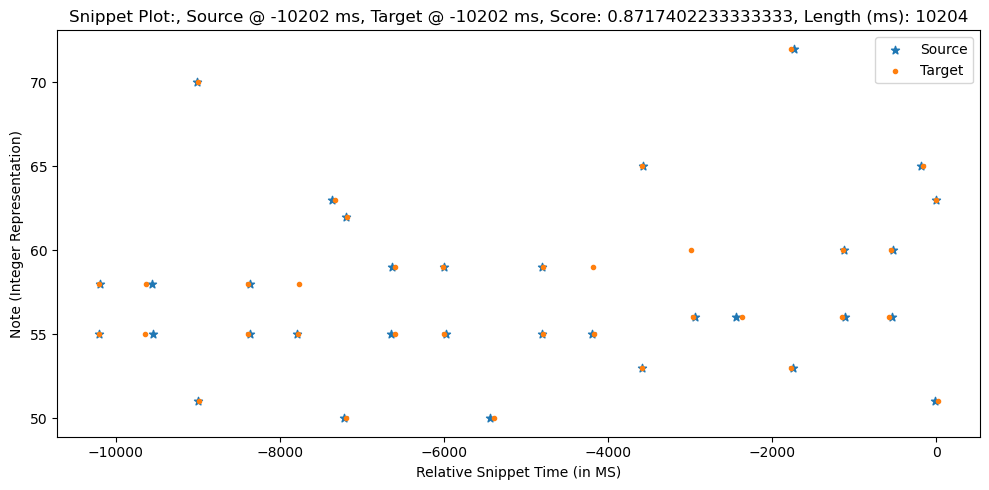

0.87184696875
Scores: [ 0.99    0.985   0.745   0.825   0.945   0.9525  0.9475  0.9775  0.965
 -0.      0.915   0.9325  0.9525  0.9     0.89    0.9825  0.9475  0.86
  0.95    0.935  -0.      0.9125  0.9775  0.985  -0.      0.9475  0.81
  0.9525  0.9475  0.9275  0.97    0.9325  0.96    0.9175  0.995   0.9025
  0.85    0.87    0.935   0.935   0.9975  0.975 ]
Sequence1:  [[-12069     58     36]
 [-12067     55     44]
 [-11511     55     49]
 [-11497     58     44]
 [-10860     70     58]
 [-10849     51     46]
 [-10250     55     45]
 [-10247     58     32]
 [ -9643     55     48]
 [ -9631     58     39]
 [ -9197     63     52]
 [ -9061     50     42]
 [ -9049     62     56]
 [ -8467     59     46]
 [ -8465     55     46]
 [ -7872     59     42]
 [ -7866     55     48]
 [ -7257     50     46]
 [ -6656     59     39]
 [ -6654     55     44]
 [ -6048     59     34]
 [ -6032     55     41]
 [ -5449     53     47]
 [ -5446     65     54]
 [ -4858     60     34]
 [ -4831     56     44]
 [ -4

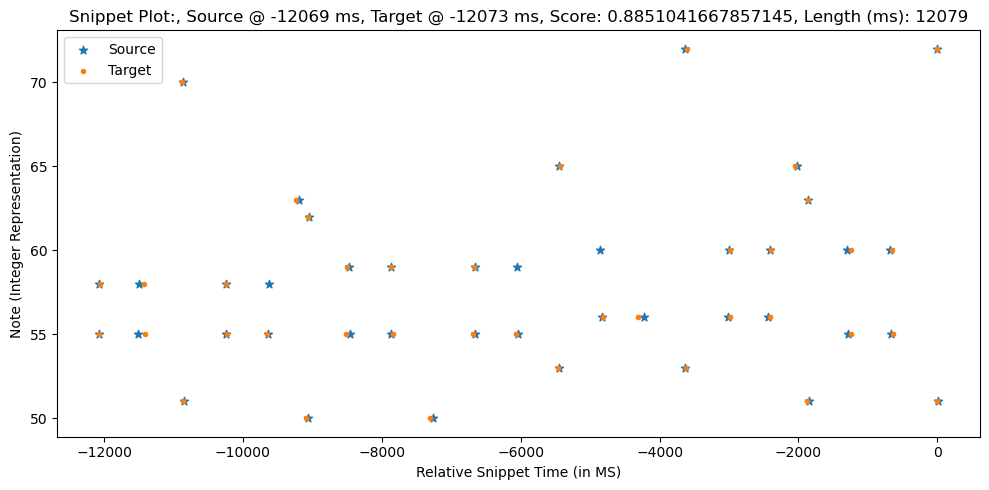

Scores: [0.985  0.99   0.825  0.745  0.945  0.9525 0.9775 0.9475 0.965  0.915
 0.9325 0.9525 0.89   0.9    0.9825 0.9475 0.86   0.935  0.95   0.9125
 0.9775 0.985  0.9475 0.81   0.9525 0.9475 0.97   0.9275 0.9325 0.96
 0.9175 0.9025 0.995  0.85   0.87   0.935  0.935  0.9975 0.975 ]
Sequence1:  [[-12083     55     49]
 [-12075     58     34]
 [-11437     58     26]
 [-11419     55     35]
 [-10892     70     53]
 [-10878     51     51]
 [-10248     58     33]
 [-10239     55     42]
 [ -9667     55     48]
 [ -9241     63     49]
 [ -9098     50     44]
 [ -9078     62     54]
 [ -8519     55     44]
 [ -8517     59     42]
 [ -7875     59     41]
 [ -7855     55     45]
 [ -7323     50     51]
 [ -6690     55     44]
 [ -6686     59     40]
 [ -6077     55     47]
 [ -5468     53     43]
 [ -5450     65     49]
 [ -4820     56     41]
 [ -4315     56     41]
 [ -3628     53     54]
 [ -3619     72     55]
 [ -3002     60     32]
 [ -2996     56     44]
 [ -2423     56     48]
 [ -2407 

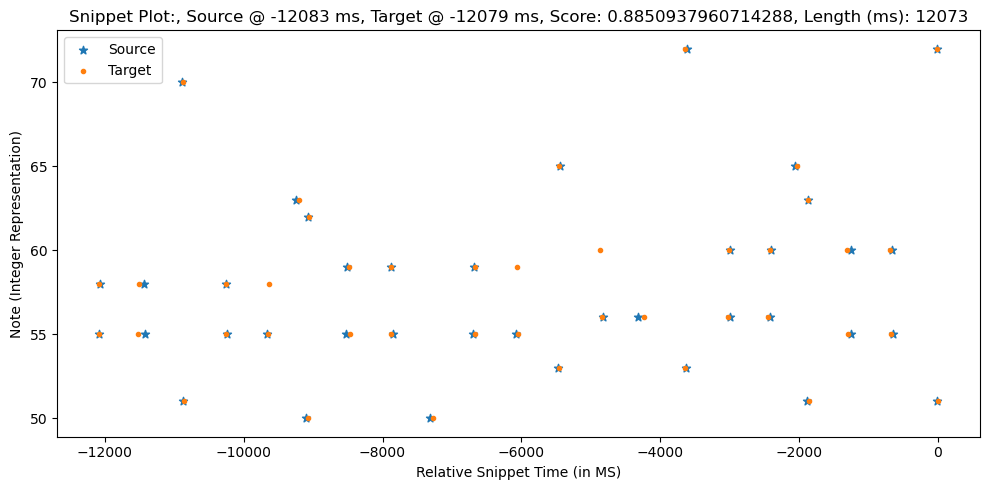

0.8851041667857145
Scores: [-0.     -0.     -0.     -0.     -0.     -0.      0.575   0.5225 -0.
  0.045  -0.     -0.     -0.     -0.      0.4925  0.115   0.135  -0.
  0.45    0.495   0.0975  0.1475 -0.     -0.     -0.     -0.     -0.
 -0.     -0.      0.2475 -0.     -0.     -0.     -0.     -0.     -0.
  0.73   -0.     -0.     -0.     -0.     -0.      0.2975  0.2275  0.1075
  0.09   -0.     -0.     -0.     -0.      0.69  ]
Sequence1:  [[-14253     58     36]
 [-14251     55     44]
 [-13695     55     49]
 [-13681     58     44]
 [-13044     70     58]
 [-13033     51     46]
 [-12434     55     45]
 [-12431     58     32]
 [-11827     55     48]
 [-11815     58     39]
 [-11381     63     52]
 [-11245     50     42]
 [-11233     62     56]
 [-10651     59     46]
 [-10649     55     46]
 [-10056     59     42]
 [-10050     55     48]
 [ -9441     50     46]
 [ -8840     59     39]
 [ -8838     55     44]
 [ -8232     59     34]
 [ -8216     55     41]
 [ -7633     53     47]
 [ -7630  

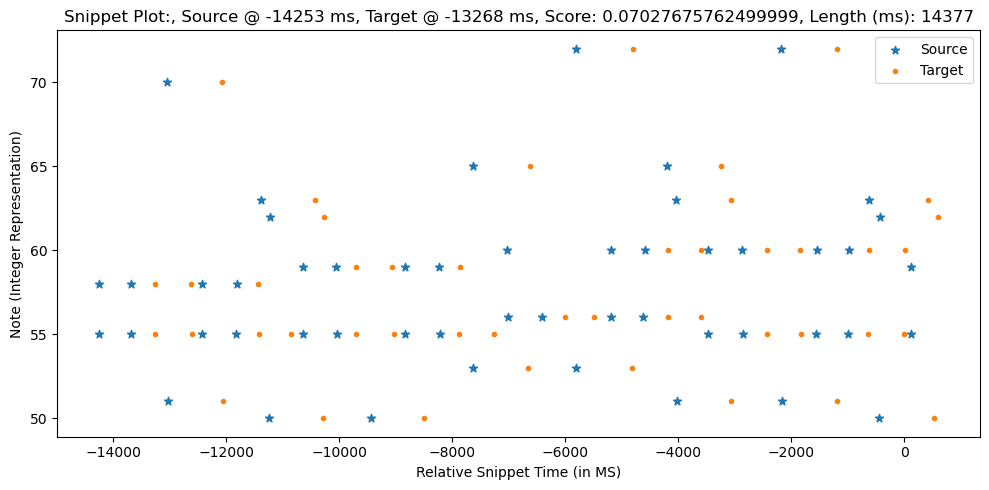

Scores: [0.9875 0.9875 0.8225 0.7425 0.9475 0.955  0.975  0.945  0.9675 0.9175
 0.935  0.955  0.8925 0.9025 0.98   0.945  0.8625 0.9375 0.9525 0.915
 0.98   0.9825 0.945  0.8125 0.95   0.945  0.9675 0.925  0.93   0.9575
 0.92   0.905  0.9975 0.8475 0.8675 0.9325 0.9325 1.     0.9775 0.8075
 0.8475 0.9625 0.9925 0.855  0.9375 0.9075]
Sequence1:  [[-13825     55     49]
 [-13817     58     34]
 [-13179     58     26]
 [-13161     55     35]
 [-12634     70     53]
 [-12620     51     51]
 [-11990     58     33]
 [-11981     55     42]
 [-11409     55     48]
 [-10983     63     49]
 [-10840     50     44]
 [-10820     62     54]
 [-10261     55     44]
 [-10259     59     42]
 [ -9617     59     41]
 [ -9597     55     45]
 [ -9065     50     51]
 [ -8432     55     44]
 [ -8428     59     40]
 [ -7819     55     47]
 [ -7210     53     43]
 [ -7192     65     49]
 [ -6562     56     41]
 [ -6057     56     41]
 [ -5370     53     54]
 [ -5361     72     55]
 [ -4744     60     32]
 [ -4

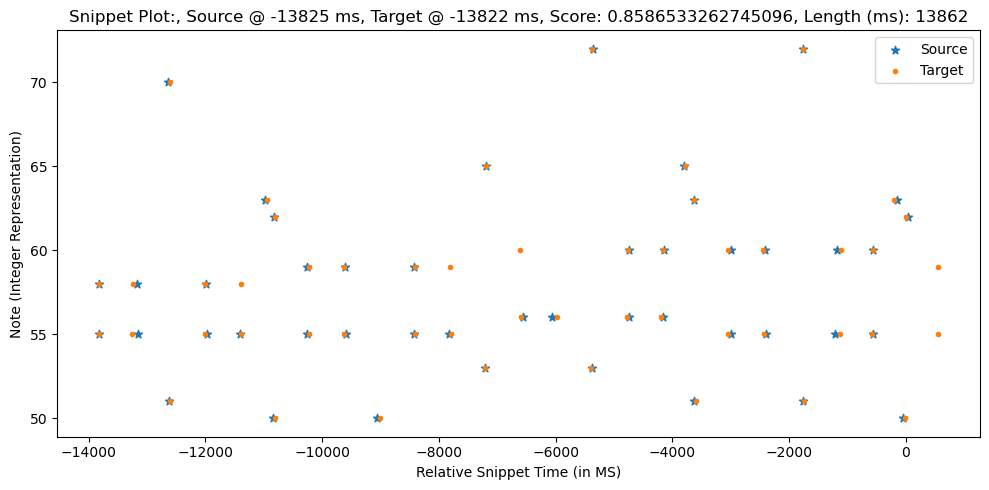

0.8586533262745096
Scores: [ 0.9875  0.9875  0.7425  0.8225  0.9475  0.955   0.945   0.975   0.9675
 -0.      0.9175  0.935   0.955   0.9025  0.8925  0.98    0.945   0.8625
  0.9525  0.9375 -0.      0.915   0.98    0.9825 -0.      0.945   0.8125
  0.95    0.945   0.925   0.9675  0.93    0.9575  0.92    0.9975  0.905
  0.8475  0.8675  0.9325  0.9325  1.      0.9775  0.8075  0.8475  0.9625
  0.9925  0.855   0.9375  0.9075  0.815   0.805   0.92    0.9425  0.965
  0.97    0.985   0.9625]
Sequence1:  [[-16218     58     36]
 [-16216     55     44]
 [-15660     55     49]
 [-15646     58     44]
 [-15009     70     58]
 [-14998     51     46]
 [-14399     55     45]
 [-14396     58     32]
 [-13792     55     48]
 [-13780     58     39]
 [-13346     63     52]
 [-13210     50     42]
 [-13198     62     56]
 [-12616     59     46]
 [-12614     55     46]
 [-12021     59     42]
 [-12015     55     48]
 [-11406     50     46]
 [-10805     59     39]
 [-10803     55     44]
 [-10197     59    

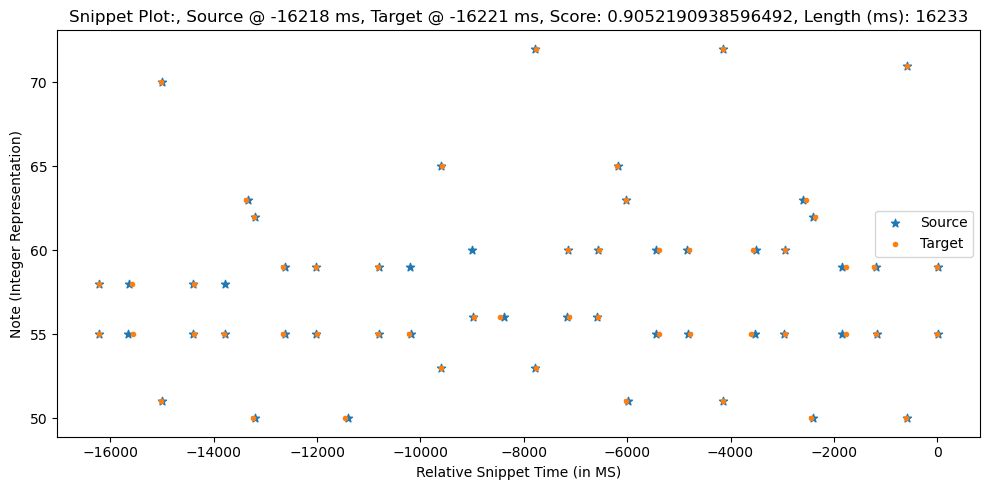

Scores: [0.9875 0.9875 0.8225 0.7425 0.9475 0.955  0.975  0.945  0.9675 0.9175
 0.935  0.955  0.8925 0.9025 0.98   0.945  0.8625 0.9375 0.9525 0.915
 0.98   0.9825 0.945  0.8125 0.95   0.945  0.9675 0.925  0.93   0.9575
 0.92   0.905  0.9975 0.8475 0.8675 0.9325 0.9325 1.     0.9775 0.8075
 0.8475 0.9625 0.9925 0.855  0.9375 0.9075 0.815  0.805  0.92   0.9425
 0.965  0.97   0.9625 0.985 ]
Sequence1:  [[-16230     55     49]
 [-16222     58     34]
 [-15584     58     26]
 [-15566     55     35]
 [-15039     70     53]
 [-15025     51     51]
 [-14395     58     33]
 [-14386     55     42]
 [-13814     55     48]
 [-13388     63     49]
 [-13245     50     44]
 [-13225     62     54]
 [-12666     55     44]
 [-12664     59     42]
 [-12022     59     41]
 [-12002     55     45]
 [-11470     50     51]
 [-10837     55     44]
 [-10833     59     40]
 [-10224     55     47]
 [ -9615     53     43]
 [ -9597     65     49]
 [ -8967     56     41]
 [ -8462     56     41]
 [ -7775     53     

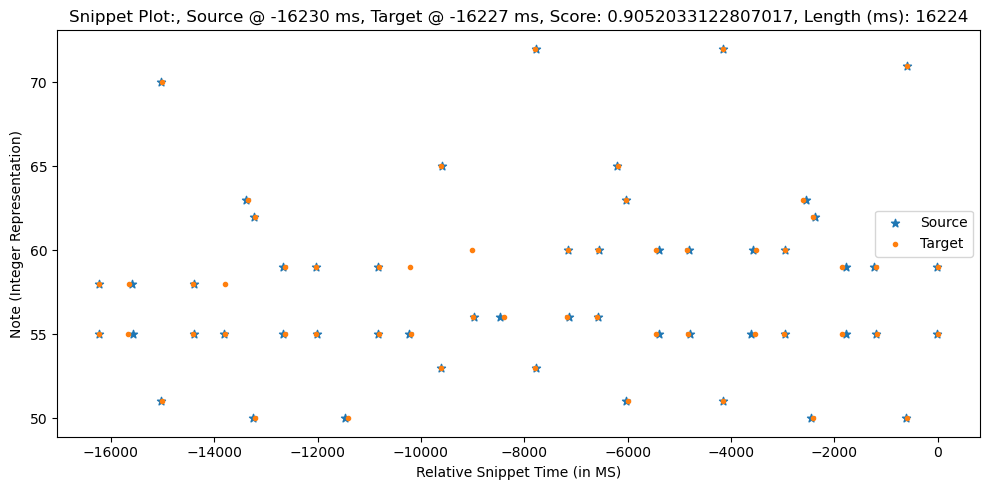

0.9052190938596492
Scores: [ 0.98    0.995   0.735   0.815   0.955   0.9625  0.9375  0.9675  0.975
 -0.      0.925   0.9425  0.9625  0.91    0.9     0.9725  0.9375  0.87
  0.96    0.945  -0.      0.9225  0.9875  0.975  -0.      0.9375  0.82
  0.9425  0.9375  0.9175  0.96    0.9225  0.95    0.9275  0.995   0.9125
  0.84    0.86    0.925   0.925   0.9925  0.985   0.815   0.855   0.955
  1.      0.8475  0.945   0.9     0.8075  0.7975  0.9275  0.95    0.9725
  0.9775  0.9925  0.97    0.9     0.9575  0.9725  0.94    0.925   0.96
  0.88  ]
Sequence1:  [[-17979     58     36]
 [-17977     55     44]
 [-17421     55     49]
 [-17407     58     44]
 [-16770     70     58]
 [-16759     51     46]
 [-16160     55     45]
 [-16157     58     32]
 [-15553     55     48]
 [-15541     58     39]
 [-15107     63     52]
 [-14971     50     42]
 [-14959     62     56]
 [-14377     59     46]
 [-14375     55     46]
 [-13782     59     42]
 [-13776     55     48]
 [-13167     50     46]
 [-12566     59 

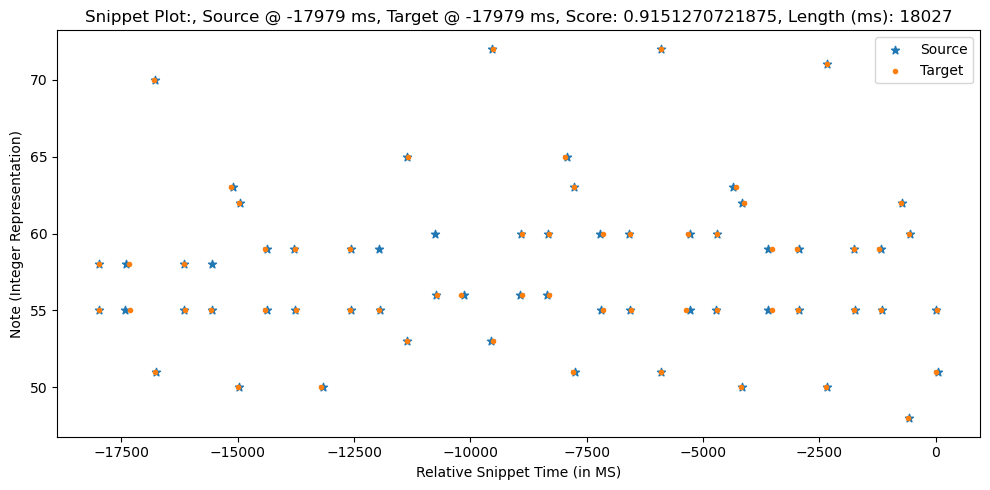

Scores: [0.9925 0.9825 0.8175 0.7375 0.9525 0.96   0.97   0.94   0.9725 0.9225
 0.94   0.96   0.8975 0.9075 0.975  0.94   0.8675 0.9425 0.9575 0.92
 0.985  0.9775 0.94   0.8175 0.945  0.94   0.9625 0.92   0.925  0.9525
 0.925  0.91   0.9975 0.8425 0.8625 0.9275 0.9275 0.995  0.9825 0.8125
 0.8525 0.9575 0.9975 0.85   0.9425 0.9025 0.81   0.8    0.925  0.9475
 0.97   0.975  0.9675 0.99   0.8975 0.955  0.97   0.9375 0.9225 0.8775
 0.9625]
Sequence1:  [[-17992     55     49]
 [-17984     58     34]
 [-17346     58     26]
 [-17328     55     35]
 [-16801     70     53]
 [-16787     51     51]
 [-16157     58     33]
 [-16148     55     42]
 [-15576     55     48]
 [-15150     63     49]
 [-15007     50     44]
 [-14987     62     54]
 [-14428     55     44]
 [-14426     59     42]
 [-13784     59     41]
 [-13764     55     45]
 [-13232     50     51]
 [-12599     55     44]
 [-12595     59     40]
 [-11986     55     47]
 [-11377     53     43]
 [-11359     65     49]
 [-10729     56    

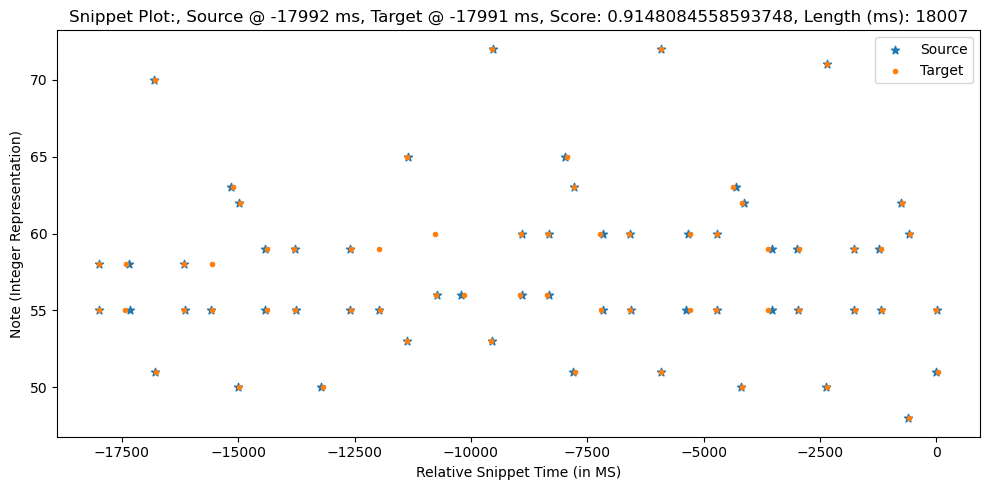

0.9151270721875
Scores: [ 0.98    0.995   0.735   0.815   0.955   0.9625  0.9375  0.9675  0.975
 -0.      0.925   0.9425  0.9625  0.91    0.9     0.9725  0.9375  0.87
  0.96    0.945  -0.      0.9225  0.9875  0.975  -0.      0.9375  0.82
  0.9425  0.9375  0.9175  0.96    0.9225  0.95    0.9275  0.995   0.9125
  0.84    0.86    0.925   0.925   0.9925  0.985   0.815   0.855   0.955
  1.      0.8475  0.945   0.9     0.8075  0.7975  0.9275  0.95    0.9725
  0.9775  0.9925  0.97    0.9     0.9575  0.9725  0.94    0.925   0.96
  0.88    0.9575  0.8325  0.9325  0.975   0.9425  0.965   0.97    0.9675
  0.9725]
Sequence1:  [[-20393     58     36]
 [-20391     55     44]
 [-19835     55     49]
 [-19821     58     44]
 [-19184     70     58]
 [-19173     51     46]
 [-18574     55     45]
 [-18571     58     32]
 [-17967     55     48]
 [-17955     58     39]
 [-17521     63     52]
 [-17385     50     42]
 [-17373     62     56]
 [-16791     59     46]
 [-16789     55     46]
 [-16196     59   

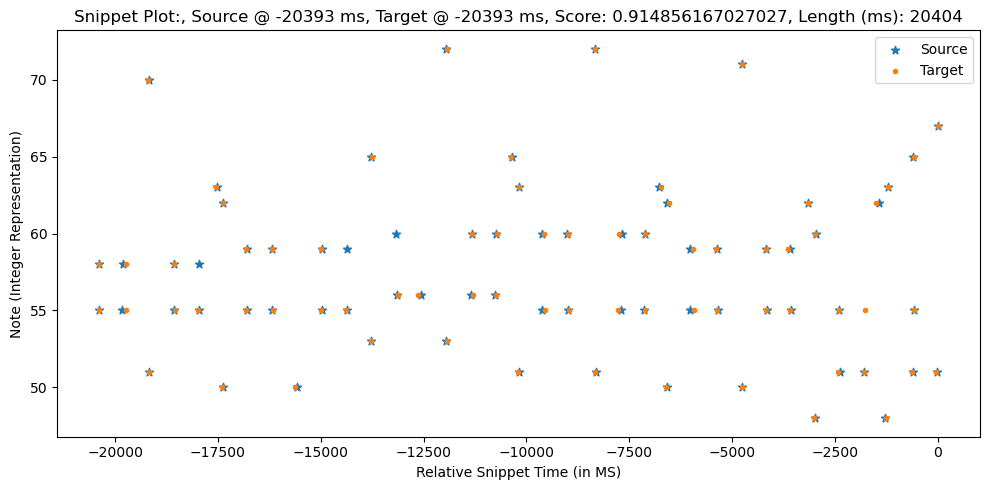

Scores: [ 0.995   0.98    0.815   0.735   0.955   0.9625  0.9675  0.9375  0.975
  0.925   0.9425  0.9625  0.9     0.91    0.9725  0.9375  0.87    0.945
  0.96    0.9225  0.9875  0.975   0.9375  0.82    0.9425  0.9375  0.96
  0.9175  0.9225  0.95    0.9275  0.9125  0.995   0.84    0.86    0.925
  0.925   0.9925  0.985   0.815   0.855   0.955   1.      0.8475  0.945
  0.9     0.8075  0.7975  0.9275  0.95    0.9725  0.9775  0.97    0.9925
  0.9     0.9575  0.9725  0.94    0.925   0.88    0.96    0.9575 -0.
  0.8325  0.9325  0.975   0.965   0.9425  0.97    0.9675  0.9725]
Sequence1:  [[-20404     55     49]
 [-20396     58     34]
 [-19758     58     26]
 [-19740     55     35]
 [-19213     70     53]
 [-19199     51     51]
 [-18569     58     33]
 [-18560     55     42]
 [-17988     55     48]
 [-17562     63     49]
 [-17419     50     44]
 [-17399     62     54]
 [-16840     55     44]
 [-16838     59     42]
 [-16196     59     41]
 [-16176     55     45]
 [-15644     50     51]
 [-15

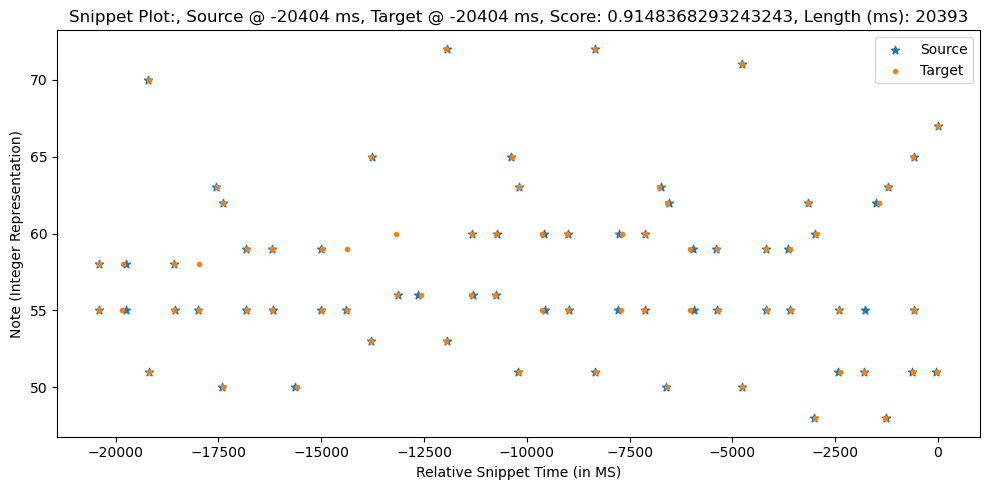

0.914856167027027
Scores: [ 0.98    0.995   0.735   0.815   0.955   0.9625  0.9375  0.9675  0.975
 -0.      0.925   0.9425  0.9625  0.91    0.9     0.9725  0.9375  0.87
  0.96    0.945  -0.      0.9225  0.9875  0.975  -0.      0.9375  0.82
  0.9425  0.9375  0.9175  0.96    0.9225  0.95    0.9275  0.995   0.9125
  0.84    0.86    0.925   0.925   0.9925  0.985   0.815   0.855   0.955
  1.      0.8475  0.945   0.9     0.8075  0.7975  0.9275  0.95    0.9725
  0.9775  0.9925  0.97    0.9     0.9575  0.9725  0.94    0.925   0.96
  0.88    0.9575  0.8325  0.9325  0.975   0.9425  0.965   0.97    0.9675
  0.9725  0.995   0.985   0.8775  0.8225  0.8575]
Sequence1:  [[-22270     58     36]
 [-22268     55     44]
 [-21712     55     49]
 [-21698     58     44]
 [-21061     70     58]
 [-21050     51     46]
 [-20451     55     45]
 [-20448     58     32]
 [-19844     55     48]
 [-19832     58     39]
 [-19398     63     52]
 [-19262     50     42]
 [-19250     62     56]
 [-18668     59     46]


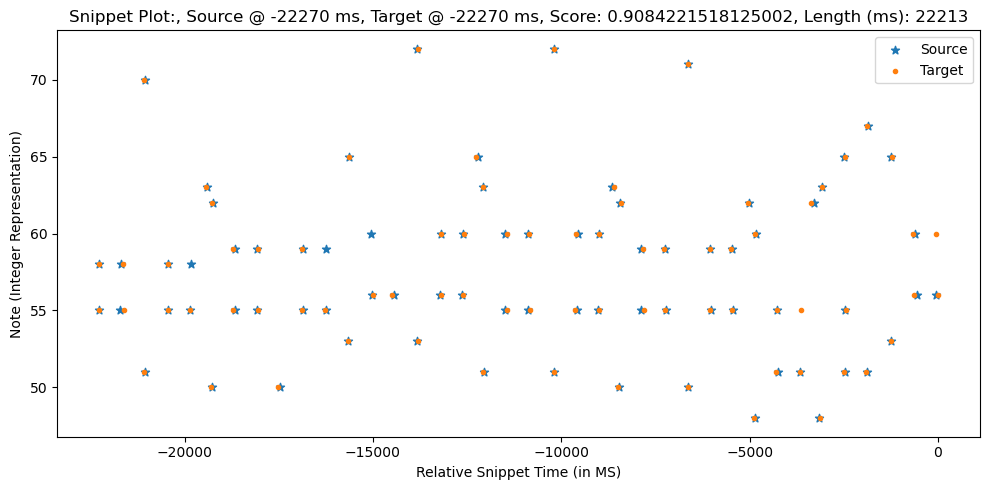

Scores: [ 0.9775  0.9975  0.8325  0.7525  0.9375  0.945   0.985   0.955   0.9575
  0.9075  0.925   0.945   0.8825  0.8925  0.99    0.955   0.8525  0.9275
  0.9425  0.905   0.97    0.9925  0.955   0.8025  0.96    0.955   0.9775
  0.935   0.94    0.9675  0.91    0.895   0.9875  0.8575  0.8775  0.9425
  0.9425  0.99    0.9675  0.7975  0.8375  0.9725  0.9825  0.865   0.9275
  0.9175  0.825   0.815   0.91    0.9325  0.955   0.96    0.9525  0.975
  0.8825  0.94    0.955   0.9225  0.9075  0.8625  0.9775  0.975  -0.
  0.815   0.95    0.9925  0.9475  0.96    0.9875  0.95    0.955   0.9775
  0.9975  0.86    0.805   0.      0.875 ]
Sequence1:  [[-22220     55     49]
 [-22212     58     34]
 [-21574     58     26]
 [-21556     55     35]
 [-21029     70     53]
 [-21015     51     51]
 [-20385     58     33]
 [-20376     55     42]
 [-19804     55     48]
 [-19378     63     49]
 [-19235     50     44]
 [-19215     62     54]
 [-18656     55     44]
 [-18654     59     42]
 [-18012     59     41]

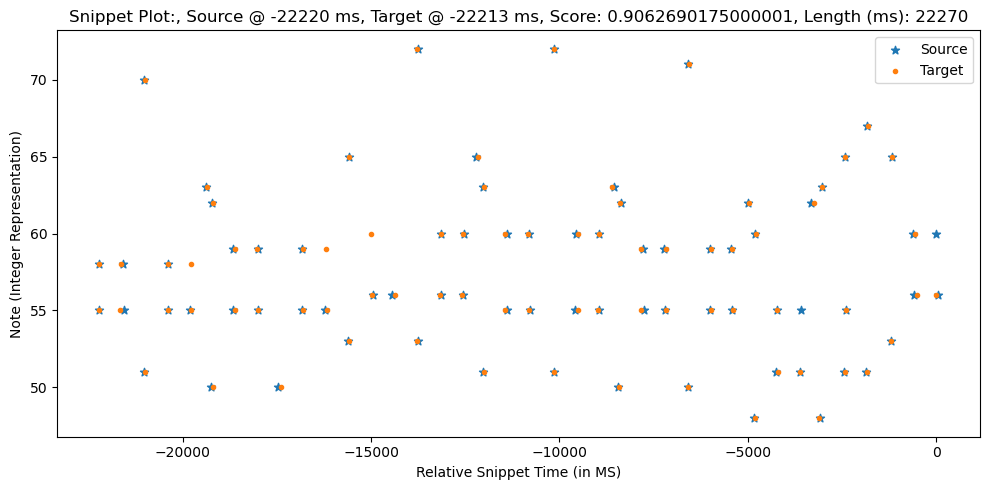

0.9084221518125002
Scores: [ 0.98    0.995   0.735   0.815   0.955   0.9625  0.9375  0.9675  0.975
 -0.      0.925   0.9425  0.9625  0.91    0.9     0.9725  0.9375  0.87
  0.96    0.945  -0.      0.9225  0.9875  0.975  -0.      0.9375  0.82
  0.9425  0.9375  0.9175  0.96    0.9225  0.95    0.9275  0.995   0.9125
  0.84    0.86    0.925   0.925   0.9925  0.985   0.815   0.855   0.955
  1.      0.8475  0.945   0.9     0.8075  0.7975  0.9275  0.95    0.9725
  0.9775  0.9925  0.97    0.9     0.9575  0.9725  0.94    0.925   0.96
  0.88    0.9575  0.8325  0.9325  0.975   0.9425  0.965   0.97    0.9675
  0.9725  0.995   0.985   0.8775  0.8225  0.8575  0.98    0.9725  0.995
  0.925   0.84    0.9925  0.97  ]
Sequence1:  [[-24444     58     36]
 [-24442     55     44]
 [-23886     55     49]
 [-23872     58     44]
 [-23235     70     58]
 [-23224     51     46]
 [-22625     55     45]
 [-22622     58     32]
 [-22018     55     48]
 [-22006     58     39]
 [-21572     63     52]
 [-21436     50

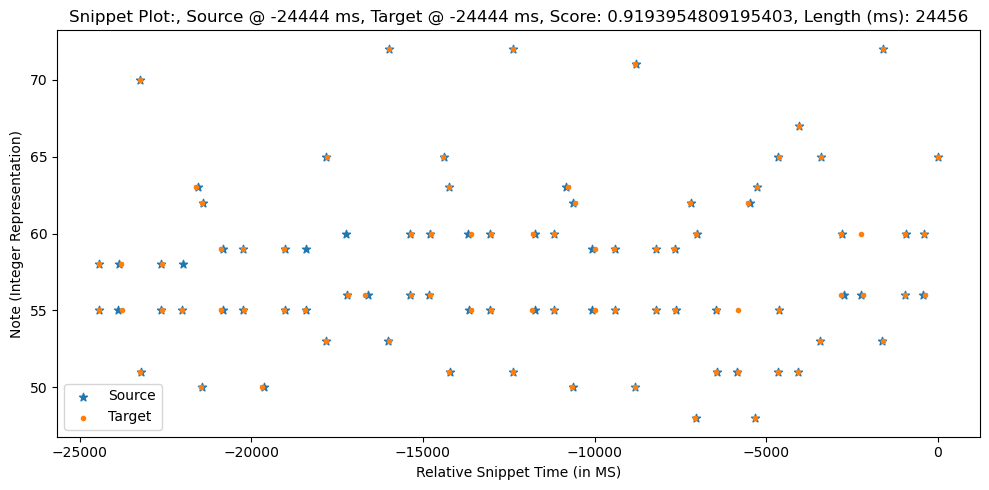

Scores: [ 0.995   0.98    0.815   0.735   0.955   0.9625  0.9675  0.9375  0.975
  0.925   0.9425  0.9625  0.9     0.91    0.9725  0.9375  0.87    0.945
  0.96    0.9225  0.9875  0.975   0.9375  0.82    0.9425  0.9375  0.96
  0.9175  0.9225  0.95    0.9275  0.9125  0.995   0.84    0.86    0.925
  0.925   0.9925  0.985   0.815   0.855   0.955   1.      0.8475  0.945
  0.9     0.8075  0.7975  0.9275  0.95    0.9725  0.9775  0.97    0.9925
  0.9     0.9575  0.9725  0.94    0.925   0.88    0.96    0.9575 -0.
  0.8325  0.9325  0.975   0.965   0.9425  0.97    0.9675  0.9725  0.995
  0.985   0.8775  0.8225 -0.      0.8575  0.9725  0.98    0.995   0.925
  0.9925  0.84    0.97  ]
Sequence1:  [[-24456     55     49]
 [-24448     58     34]
 [-23810     58     26]
 [-23792     55     35]
 [-23265     70     53]
 [-23251     51     51]
 [-22621     58     33]
 [-22612     55     42]
 [-22040     55     48]
 [-21614     63     49]
 [-21471     50     44]
 [-21451     62     54]
 [-20892     55     4

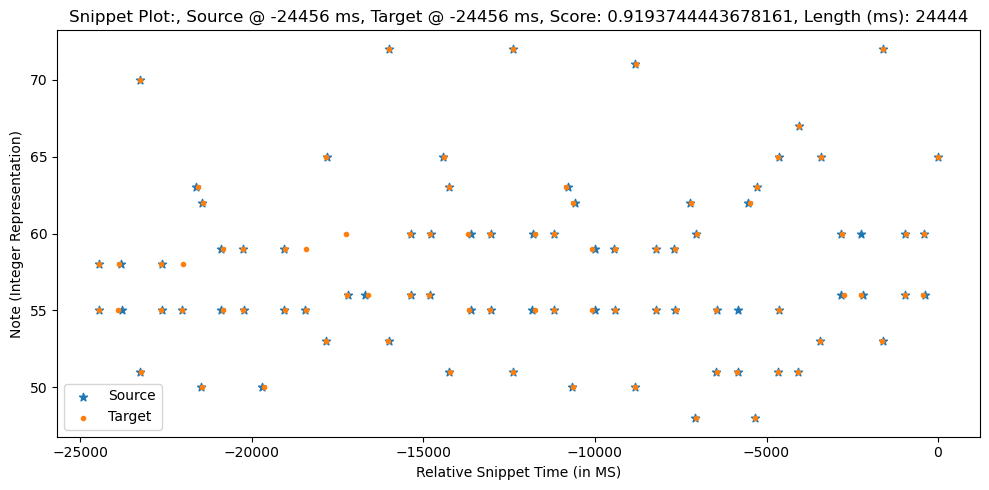

0.9193954809195403
Scores: [ 0.9775  0.9975  0.7325  0.8125  0.9575  0.965   0.935   0.965   0.9775
 -0.      0.9275  0.945   0.965   0.9125  0.9025  0.97    0.935   0.8725
  0.9625  0.9475 -0.      0.925   0.99    0.9725 -0.      0.935   0.8225
  0.94    0.935   0.915   0.9575  0.92    0.9475  0.93    0.9925  0.915
  0.8375  0.8575  0.9225  0.9225  0.99    0.9875  0.8175  0.8575  0.9525
  0.9975  0.845   0.9475  0.8975  0.805   0.795   0.93    0.9525  0.975
  0.98    0.995   0.9725  0.9025  0.96    0.975   0.9425  0.9275  0.9575
  0.8825  0.955   0.835   0.93    0.9725  0.94    0.9675  0.9675  0.97
  0.975   0.9975  0.9825  0.88    0.825   0.855   0.9775  0.975   0.9925
  0.9275  0.8375  0.995   0.9725  0.965   0.9725  0.99    0.9075  0.9725
  0.835   0.9875  1.    ]
Sequence1:  [[-26429     58     36]
 [-26427     55     44]
 [-25871     55     49]
 [-25857     58     44]
 [-25220     70     58]
 [-25209     51     46]
 [-24610     55     45]
 [-24607     58     32]
 [-24003     55  

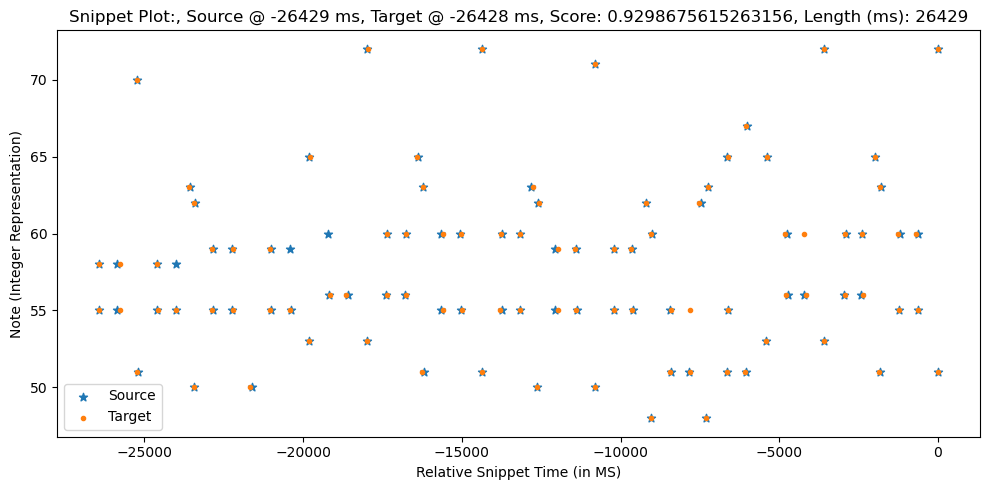

Scores: [ 0.9975  0.9775  0.8125  0.7325  0.9575  0.965   0.965   0.935   0.9775
  0.9275  0.945   0.965   0.9025  0.9125  0.97    0.935   0.8725  0.9475
  0.9625  0.925   0.99    0.9725  0.935   0.8225  0.94    0.935   0.9575
  0.915   0.92    0.9475  0.93    0.915   0.9925  0.8375  0.8575  0.9225
  0.9225  0.99    0.9875  0.8175  0.8575  0.9525  0.9975  0.845   0.9475
  0.8975  0.805   0.795   0.93    0.9525  0.975   0.98    0.9725  0.995
  0.9025  0.96    0.975   0.9425  0.9275  0.8825  0.9575  0.955  -0.
  0.835   0.93    0.9725  0.9675  0.94    0.9675  0.97    0.975   0.9975
  0.9825  0.88    0.825  -0.      0.855   0.975   0.9775  0.9925  0.9275
  0.995   0.8375  0.9725  0.965   0.9725  0.9075  0.99    0.835   0.9725
  1.      0.9875]
Sequence1:  [[-26426     55     49]
 [-26418     58     34]
 [-25780     58     26]
 [-25762     55     35]
 [-25235     70     53]
 [-25221     51     51]
 [-24591     58     33]
 [-24582     55     42]
 [-24010     55     48]
 [-23584     63     4

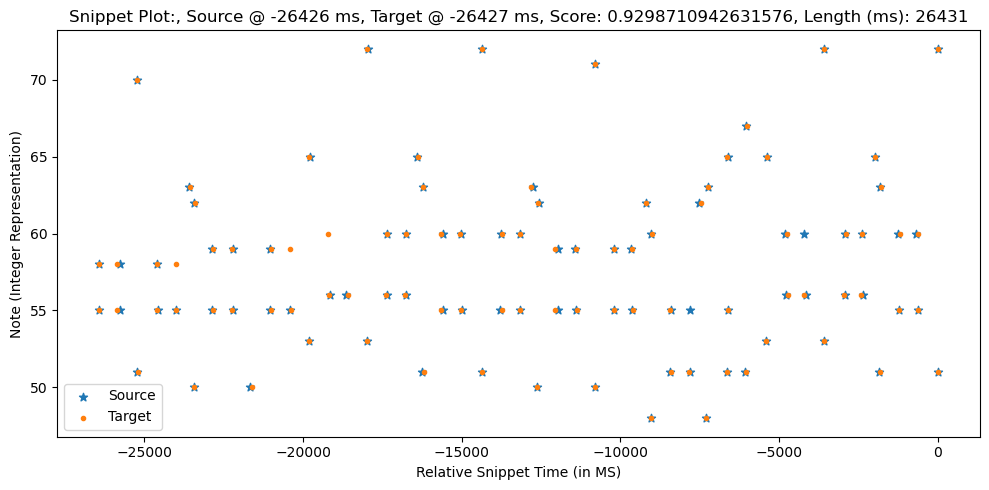

0.9298710942631576
Scores: [ 0.97    0.995   0.725   0.805   0.965   0.9725  0.9275  0.9575  0.985
 -0.      0.935   0.9525  0.9725  0.92    0.91    0.9625  0.9275  0.88
  0.97    0.955  -0.      0.9325  0.9975  0.965  -0.      0.9275  0.83
  0.9325  0.9275  0.9075  0.95    0.9125  0.94    0.9375  0.985   0.9225
  0.83    0.85    0.915   0.915   0.9825  0.995   0.825   0.865   0.945
  0.99    0.8375  0.955   0.89    0.7975  0.7875  0.9375  0.96    0.9825
  0.9875  0.9975  0.98    0.91    0.9675  0.9825  0.95    0.935   0.95
  0.89    0.9475  0.8425  0.9225  0.965   0.9325  0.975   0.96    0.9775
  0.9825  0.995   0.975   0.8875  0.8325  0.8475  0.97    0.9825  0.985
  0.935   0.83    0.9975  0.98    0.9725  0.98    0.9825  0.915   0.98
  0.8425  0.98    0.9925  0.935   0.94   -0.      0.8925  0.8925  0.7625
  0.905 ]
Sequence1:  [[-28244     58     36]
 [-28242     55     44]
 [-27686     55     49]
 [-27672     58     44]
 [-27035     70     58]
 [-27024     51     46]
 [-26425     55

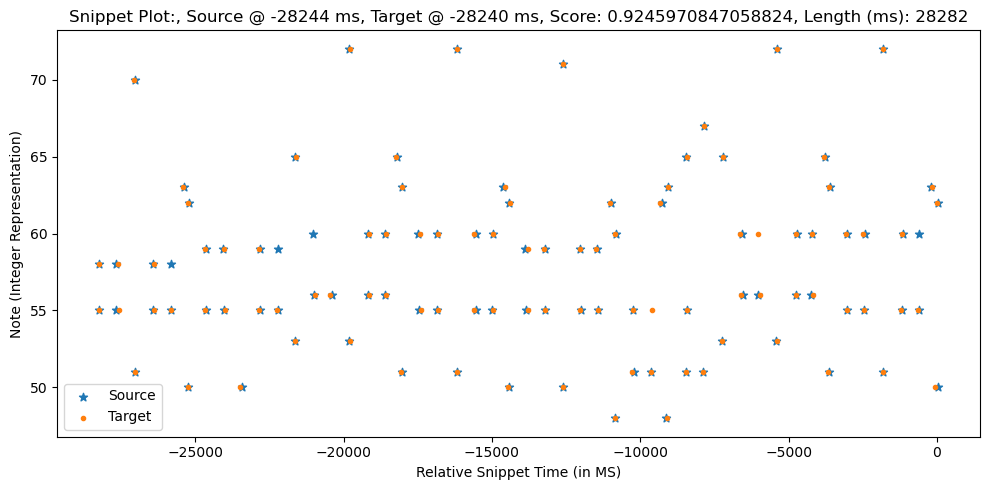

Scores: [ 0.995   0.97    0.805   0.725   0.965   0.9725  0.9575  0.9275  0.985
  0.935   0.9525  0.9725  0.91    0.92    0.9625  0.9275  0.88    0.955
  0.97    0.9325  0.9975  0.965   0.9275  0.83    0.9325  0.9275  0.95
  0.9075  0.9125  0.94    0.9375  0.9225  0.985   0.83    0.85    0.915
  0.915   0.9825  0.995   0.825   0.865   0.945   0.99    0.8375  0.955
  0.89    0.7975  0.7875  0.9375  0.96    0.9825  0.9875  0.98    0.9975
  0.91    0.9675  0.9825  0.95    0.935   0.89    0.95    0.9475 -0.
  0.8425  0.9225  0.965   0.975   0.9325  0.96    0.9775  0.9825  0.995
  0.975   0.8875  0.8325 -0.      0.8475  0.9825  0.97    0.985   0.935
  0.9975  0.83    0.98    0.9725  0.98    0.915   0.9825  0.8425  0.98
  0.9925  0.98    0.935   0.94    0.8925  0.8925  0.7625  0.905 ]
Sequence1:  [[-28278     55     49]
 [-28270     58     34]
 [-27632     58     26]
 [-27614     55     35]
 [-27087     70     53]
 [-27073     51     51]
 [-26443     58     33]
 [-26434     55     42]
 [-258

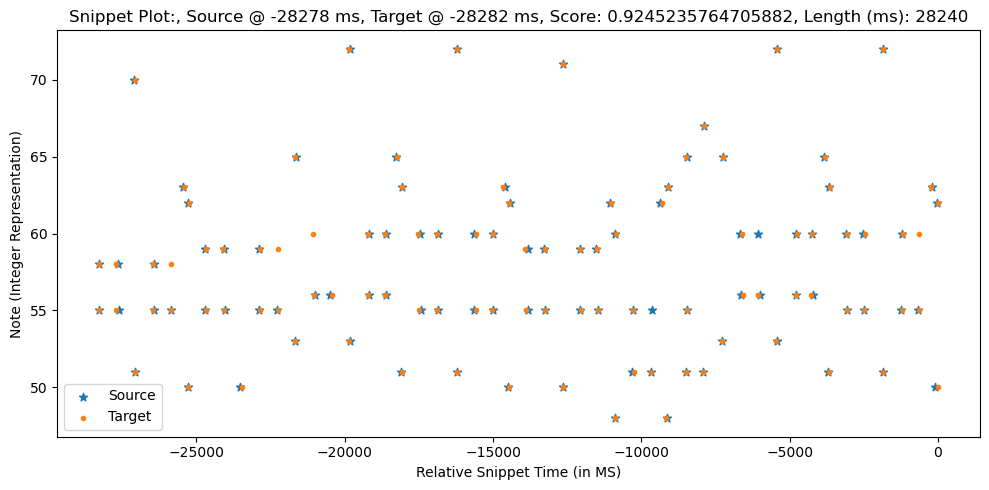

0.9245970847058824
Scores: [ 0.9675  0.9925  0.7225  0.8025  0.9675  0.975   0.925   0.955   0.9875
 -0.      0.9375  0.955   0.975   0.9225  0.9125  0.96    0.925   0.8825
  0.9725  0.9575 -0.      0.935   1.      0.9625 -0.      0.925   0.8325
  0.93    0.925   0.905   0.9475  0.91    0.9375  0.94    0.9825  0.925
  0.8275  0.8475  0.9125  0.9125  0.98    0.9975  0.8275  0.8675  0.9425
  0.9875  0.835   0.9575  0.8875  0.795   0.785   0.94    0.9625  0.985
  0.99    0.995   0.9825  0.9125  0.97    0.985   0.9525  0.9375  0.9475
  0.8925  0.945   0.845   0.92    0.9625  0.93    0.9775  0.9575  0.98
  0.985   0.9925  0.9725  0.89    0.835   0.845   0.9675  0.985   0.9825
  0.9375  0.8275  0.995   0.9825  0.975   0.9825  0.98    0.9175  0.9825
  0.845   0.9775  0.99    0.9375  0.9425 -0.      0.895   0.89    0.765
  0.9075  0.995   0.9725  0.98    0.9325  0.955   0.9025]
Sequence1:  [[-30012     58     36]
 [-30010     55     44]
 [-29454     55     49]
 [-29440     58     44]
 [-28803 

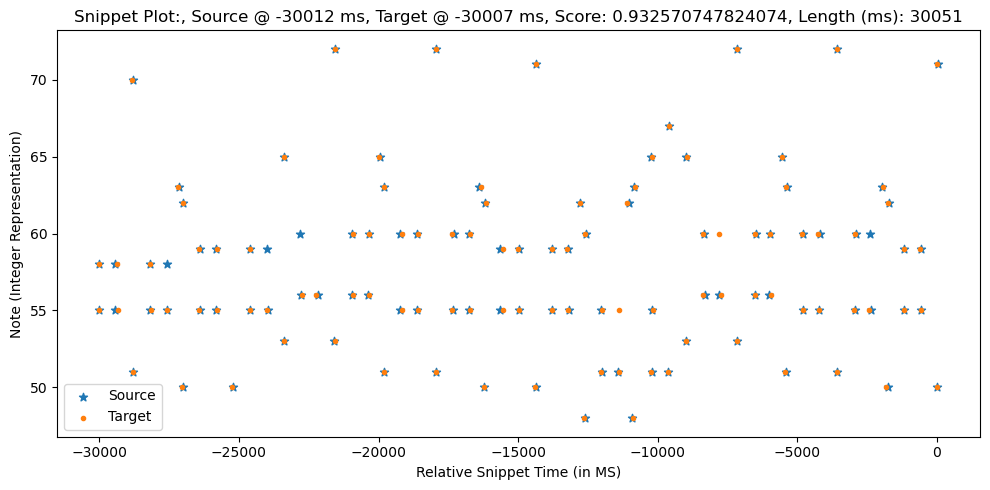

Scores: [ 0.9925  0.9675  0.8025  0.7225  0.9675  0.975   0.955   0.925   0.9875
  0.9375  0.955   0.975   0.9125  0.9225  0.96    0.925   0.8825  0.9575
  0.9725  0.935   1.      0.9625  0.925   0.8325  0.93    0.925   0.9475
  0.905   0.91    0.9375  0.94    0.925   0.9825  0.8275  0.8475  0.9125
  0.9125  0.98    0.9975  0.8275  0.8675  0.9425  0.9875  0.835   0.9575
  0.8875  0.795   0.785   0.94    0.9625  0.985   0.99    0.9825  0.995
  0.9125  0.97    0.985   0.9525  0.9375  0.8925  0.9475  0.945  -0.
  0.845   0.92    0.9625  0.9775  0.93    0.9575  0.98    0.985   0.9925
  0.9725  0.89    0.835  -0.      0.845   0.985   0.9675  0.9825  0.9375
  0.995   0.8275  0.9825  0.975   0.9825  0.9175  0.98    0.845   0.9825
  0.99    0.9775  0.9375  0.9425  0.895   0.89    0.765   0.9075  0.995
  0.9725  0.9325  0.98    0.955   0.9025]
Sequence1:  [[-30046     55     49]
 [-30038     58     34]
 [-29400     58     26]
 [-29382     55     35]
 [-28855     70     53]
 [-28841     51     5

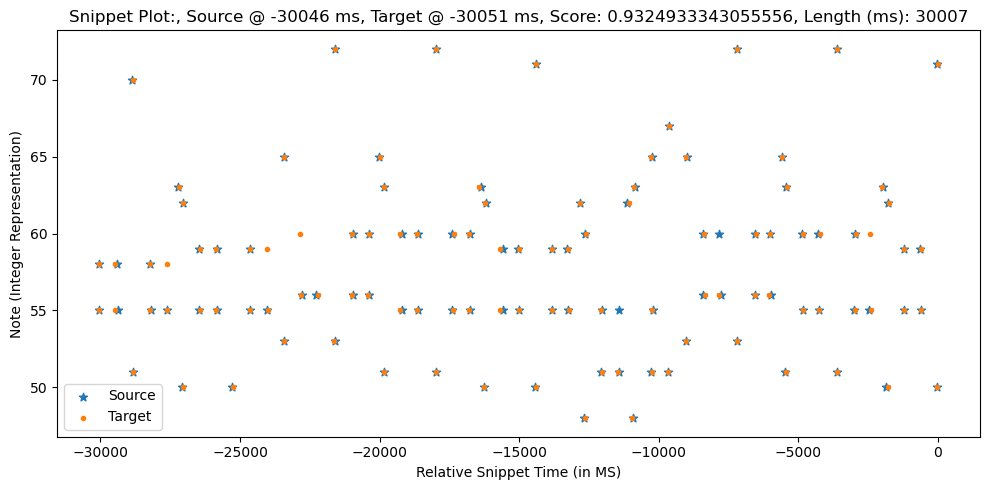

0.932570747824074
Scores: [ 0.96    0.985   0.715   0.795   0.975   0.9825  0.9175  0.9475  0.995
 -0.      0.945   0.9625  0.9825  0.93    0.92    0.9525  0.9175  0.89
  0.98    0.965  -0.      0.9425  0.9925  0.955  -0.      0.9175  0.84
  0.9225  0.9175  0.8975  0.94    0.9025  0.93    0.9475  0.975   0.9325
  0.82    0.84    0.905   0.905   0.9725  0.995   0.835   0.875   0.935
  0.98    0.8275  0.965   0.88    0.7875  0.7775  0.9475  0.97    0.9925
  0.9975  0.9875  0.99    0.92    0.9775  0.9925  0.96    0.945   0.94
  0.9     0.9375  0.8525  0.9125  0.955   0.9225  0.985   0.95    0.9875
  0.9925  0.985   0.965   0.8975  0.8425  0.8375  0.96    0.9925  0.975
  0.945   0.82    0.9875  0.99    0.9825  0.99    0.9725  0.925   0.99
  0.8525  0.97    0.9825  0.945   0.95   -0.      0.9025  0.8825  0.7725
  0.915   0.9875  0.98    0.9875  0.94    0.9625  0.91    0.9025  0.8775
  0.8925  0.8925  0.86    0.7925  0.9025  0.9725  0.99  ]
Sequence1:  [[-32444     58     36]
 [-32442     55

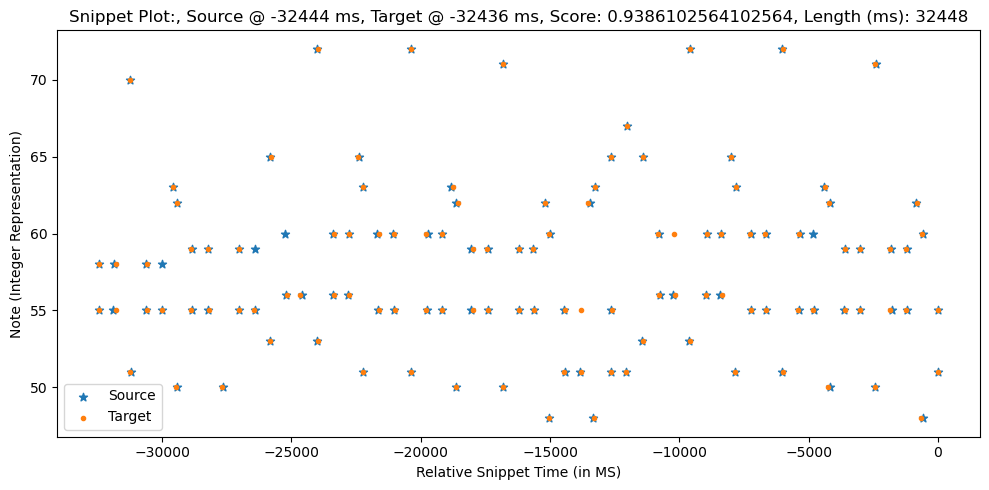

Scores: [ 0.985   0.96    0.795   0.715   0.975   0.9825  0.9475  0.9175  0.995
  0.945   0.9625  0.9825  0.92    0.93    0.9525  0.9175  0.89    0.965
  0.98    0.9425  0.9925  0.955   0.9175  0.84    0.9225  0.9175  0.94
  0.8975  0.9025  0.93    0.9475  0.9325  0.975   0.82    0.84    0.905
  0.905   0.9725  0.995   0.835   0.875   0.935   0.98    0.8275  0.965
  0.88    0.7875  0.7775  0.9475  0.97    0.9925  0.9975  0.99    0.9875
  0.92    0.9775  0.9925  0.96    0.945   0.9     0.94    0.9375 -0.
  0.8525  0.9125  0.955   0.985   0.9225  0.95    0.9875  0.9925  0.985
  0.965   0.8975  0.8425 -0.      0.8375  0.9925  0.96    0.975   0.945
  0.9875  0.82    0.99    0.9825  0.99    0.925   0.9725  0.8525  0.99
  0.9825  0.97    0.945   0.95    0.9025  0.8825  0.7725  0.915   0.9875
  0.98    0.94    0.9875  0.9625  0.91    0.9025  0.8775  0.8925  0.8925
  0.86    0.7925  0.9025  0.9725  0.99  ]
Sequence1:  [[-32440     55     49]
 [-32432     58     34]
 [-31794     58     26]
 [-3

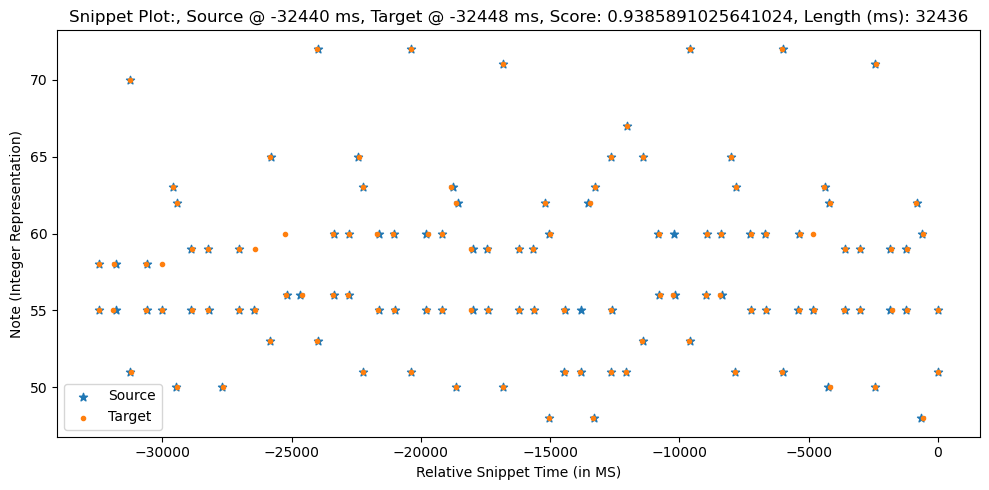

0.9386102564102564
Scores: [ 0.96    0.985   0.715   0.795   0.975   0.9825  0.9175  0.9475  0.995
 -0.      0.945   0.9625  0.9825  0.93    0.92    0.9525  0.9175  0.89
  0.98    0.965  -0.      0.9425  0.9925  0.955  -0.      0.9175  0.84
  0.9225  0.9175  0.8975  0.94    0.9025  0.93    0.9475  0.975   0.9325
  0.82    0.84    0.905   0.905   0.9725  0.995   0.835   0.875   0.935
  0.98    0.8275  0.965   0.88    0.7875  0.7775  0.9475  0.97    0.9925
  0.9975  0.9875  0.99    0.92    0.9775  0.9925  0.96    0.945   0.94
  0.9     0.9375  0.8525  0.9125  0.955   0.9225  0.985   0.95    0.9875
  0.9925  0.985   0.965   0.8975  0.8425  0.8375  0.96    0.9925  0.975
  0.945   0.82    0.9875  0.99    0.9825  0.99    0.9725  0.925   0.99
  0.8525  0.97    0.9825  0.945   0.95   -0.      0.9025  0.8825  0.7725
  0.915   0.9875  0.98    0.9875  0.94    0.9625  0.91    0.9025  0.8775
  0.8925  0.8925  0.86    0.7925  0.9025  0.9725  0.99    0.93    0.9725
  0.905   0.8425  0.88  ]
Sequence1

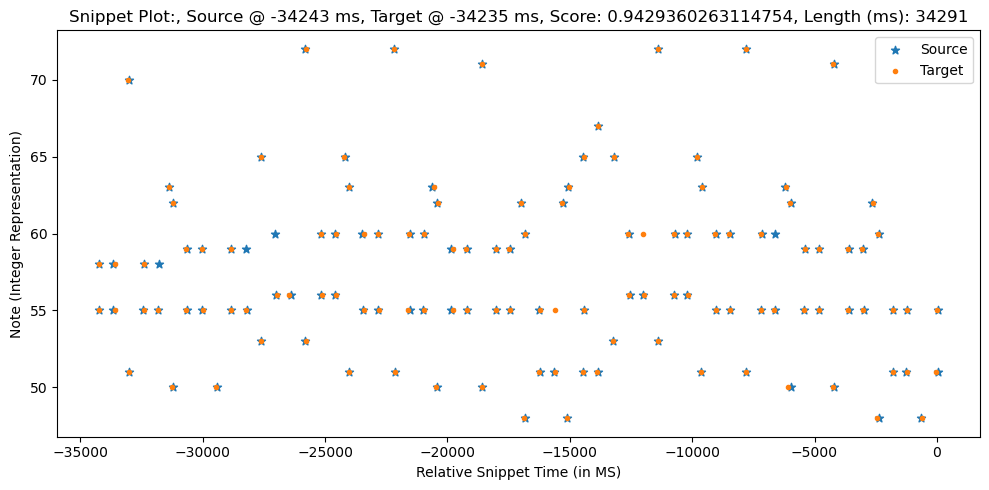

Scores: [ 0.985   0.96    0.795   0.715   0.975   0.9825  0.9475  0.9175  0.995
  0.945   0.9625  0.9825  0.92    0.93    0.9525  0.9175  0.89    0.965
  0.98    0.9425  0.9925  0.955   0.9175  0.84    0.9225  0.9175  0.94
  0.8975  0.9025  0.93    0.9475  0.9325  0.975   0.82    0.84    0.905
  0.905   0.9725  0.995   0.835   0.875   0.935   0.98    0.8275  0.965
  0.88    0.7875  0.7775  0.9475  0.97    0.9925  0.9975  0.99    0.9875
  0.92    0.9775  0.9925  0.96    0.945   0.9     0.94    0.9375 -0.
  0.8525  0.9125  0.955   0.985   0.9225  0.95    0.9875  0.9925  0.985
  0.965   0.8975  0.8425 -0.      0.8375  0.9925  0.96    0.975   0.945
  0.9875  0.82    0.99    0.9825  0.99    0.925   0.9725  0.8525  0.99
  0.9825  0.97    0.945   0.95    0.9025  0.8825  0.7725  0.915   0.9875
  0.98    0.94    0.9875  0.9625  0.91    0.9025  0.8775  0.8925  0.8925
  0.86    0.7925  0.9025  0.9725  0.99    0.93    0.9725  0.905   0.8425
  0.88  ]
Sequence1:  [[-34283     55     49]
 [-34275   

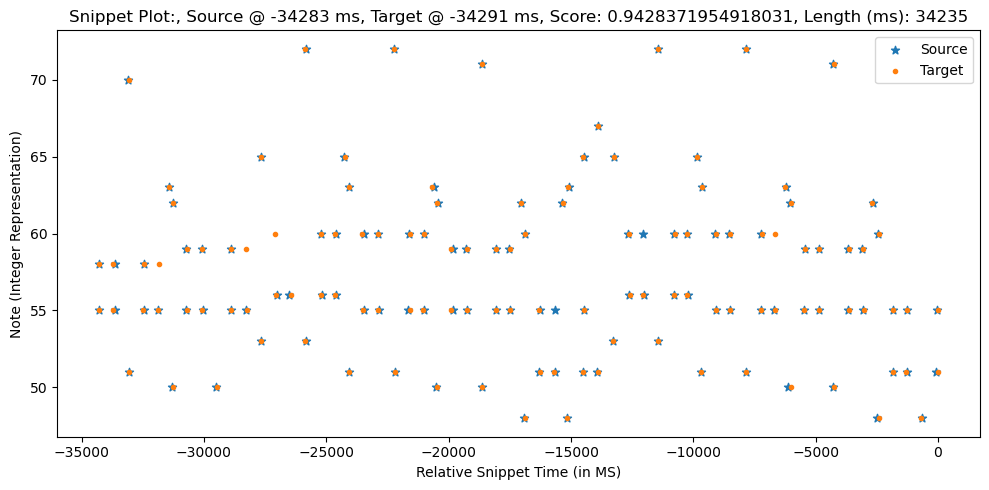

0.9429360263114754
Scores: [ 0.9575  0.9825  0.7125  0.7925  0.9775  0.985   0.915   0.945   0.9975
 -0.      0.9475  0.965   0.985   0.9325  0.9225  0.95    0.915   0.8925
  0.9825  0.9675 -0.      0.945   0.99    0.9525 -0.      0.915   0.8425
  0.92    0.915   0.895   0.9375  0.9     0.9275  0.95    0.9725  0.935
  0.8175  0.8375  0.9025  0.9025  0.97    0.9925  0.8375  0.8775  0.9325
  0.9775  0.825   0.9675  0.8775  0.785   0.775   0.95    0.9725  0.995
  1.      0.985   0.9925  0.9225  0.98    0.995   0.9625  0.9475  0.9375
  0.9025  0.935   0.855   0.91    0.9525  0.92    0.9875  0.9475  0.99
  0.995   0.9825  0.9625  0.9     0.845   0.835   0.9575  0.995   0.9725
  0.9475  0.8175  0.985   0.9925  0.985   0.9925  0.97    0.9275  0.9925
  0.855   0.9675  0.98    0.9475  0.9525 -0.      0.905   0.88    0.775
  0.9175  0.985   0.9825  0.99    0.9425  0.965   0.9125  0.905   0.88
  0.895   0.895   0.8575  0.795   0.905   0.975   0.9925  0.9275  0.97
  0.9025  0.845   0.8825  0.8825 

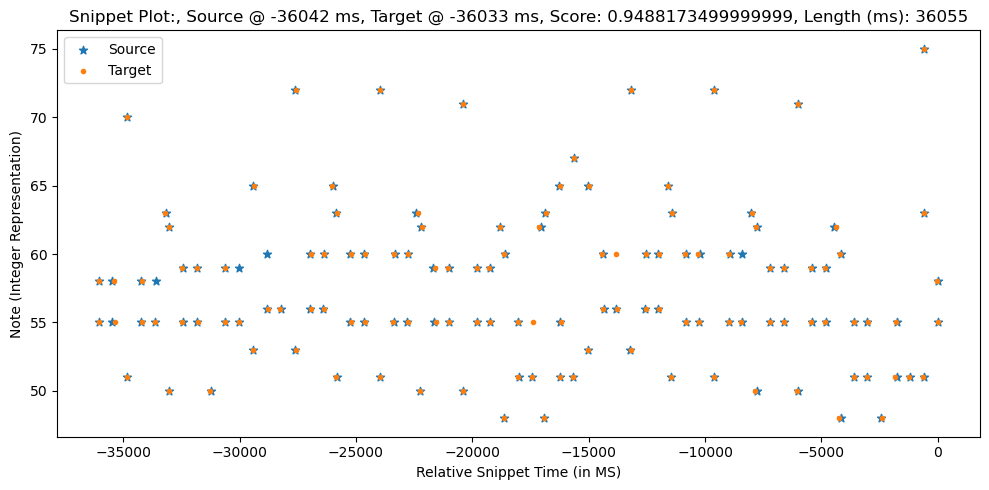

Scores: [ 0.9825  0.9575  0.7925  0.7125  0.9775  0.985   0.945   0.915   0.9975
  0.9475  0.965   0.985   0.9225  0.9325  0.95    0.915   0.8925  0.9675
  0.9825  0.945   0.99    0.9525  0.915   0.8425  0.92    0.915   0.9375
  0.895   0.9     0.9275  0.95    0.935   0.9725  0.8175  0.8375  0.9025
  0.9025  0.97    0.9925  0.8375  0.8775  0.9325  0.9775  0.825   0.9675
  0.8775  0.785   0.775   0.95    0.9725  0.995   1.      0.9925  0.985
  0.9225  0.98    0.995   0.9625  0.9475  0.9025  0.9375  0.935  -0.
  0.855   0.91    0.9525  0.9875  0.92    0.9475  0.99    0.995   0.9825
  0.9625  0.9     0.845  -0.      0.835   0.995   0.9575  0.9725  0.9475
  0.985   0.8175  0.9925  0.985   0.9925  0.9275  0.97    0.855   0.9925
  0.98    0.9675  0.9475  0.9525  0.905   0.88    0.775   0.9175  0.985
  0.9825  0.9425  0.99    0.965   0.9125  0.905   0.88    0.895   0.895
  0.8575  0.795   0.905   0.975   0.9925  0.9275  0.97    0.9025  0.845
  0.8825  0.8825  0.925   0.945   0.945   0.935   0

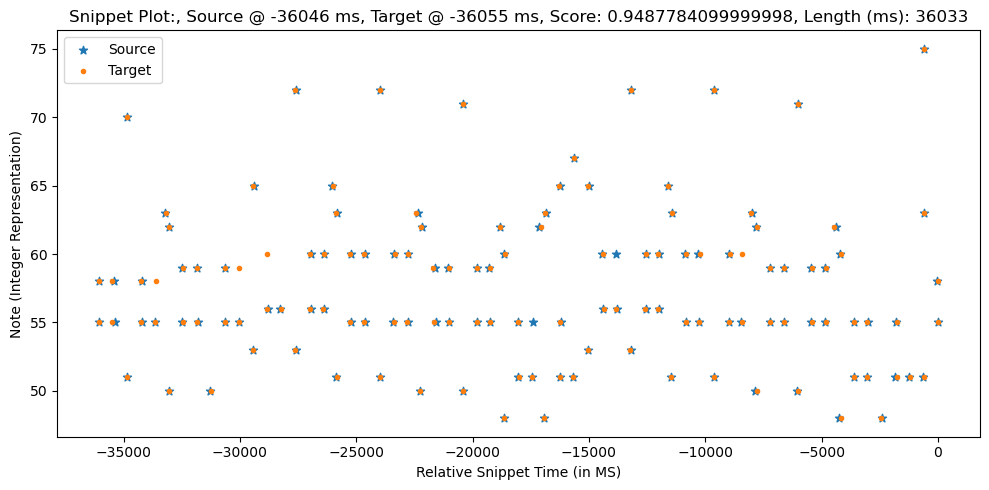

0.9488173499999999
Scores: [ 0.9575  0.9825  0.7125  0.7925  0.9775  0.985   0.915   0.945   0.9975
 -0.      0.9475  0.965   0.985   0.9325  0.9225  0.95    0.915   0.8925
  0.9825  0.9675 -0.      0.945   0.99    0.9525 -0.      0.915   0.8425
  0.92    0.915   0.895   0.9375  0.9     0.9275  0.95    0.9725  0.935
  0.8175  0.8375  0.9025  0.9025  0.97    0.9925  0.8375  0.8775  0.9325
  0.9775  0.825   0.9675  0.8775  0.785   0.775   0.95    0.9725  0.995
  1.      0.985   0.9925  0.9225  0.98    0.995   0.9625  0.9475  0.9375
  0.9025  0.935   0.855   0.91    0.9525  0.92    0.9875  0.9475  0.99
  0.995   0.9825  0.9625  0.9     0.845   0.835   0.9575  0.995   0.9725
  0.9475  0.8175  0.985   0.9925  0.985   0.9925  0.97    0.9275  0.9925
  0.855   0.9675  0.98    0.9475  0.9525 -0.      0.905   0.88    0.775
  0.9175  0.985   0.9825  0.99    0.9425  0.965   0.9125  0.905   0.88
  0.895   0.895   0.8575  0.795   0.905   0.975   0.9925  0.9275  0.97
  0.9025  0.845   0.8825  0.8825 

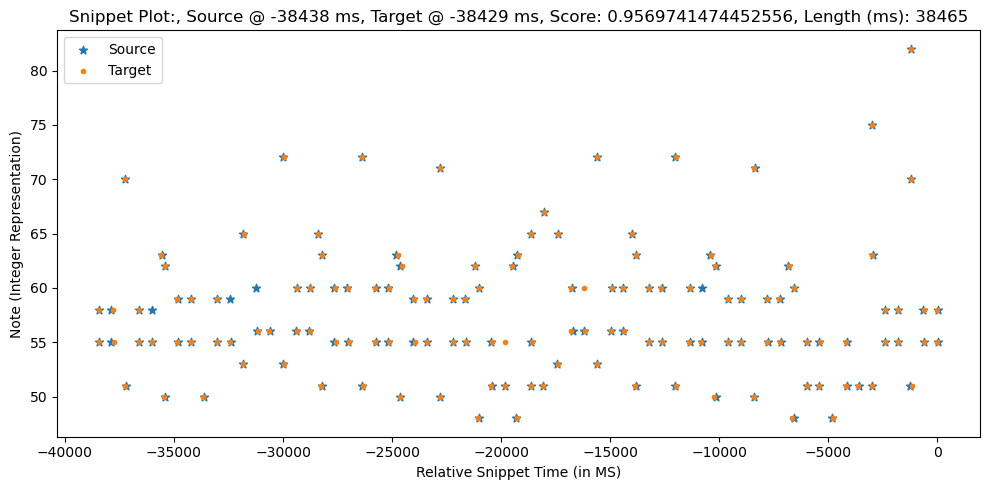

Scores: [ 0.9825  0.9575  0.7925  0.7125  0.9775  0.985   0.945   0.915   0.9975
  0.9475  0.965   0.985   0.9225  0.9325  0.95    0.915   0.8925  0.9675
  0.9825  0.945   0.99    0.9525  0.915   0.8425  0.92    0.915   0.9375
  0.895   0.9     0.9275  0.95    0.935   0.9725  0.8175  0.8375  0.9025
  0.9025  0.97    0.9925  0.8375  0.8775  0.9325  0.9775  0.825   0.9675
  0.8775  0.785   0.775   0.95    0.9725  0.995   1.      0.9925  0.985
  0.9225  0.98    0.995   0.9625  0.9475  0.9025  0.9375  0.935  -0.
  0.855   0.91    0.9525  0.9875  0.92    0.9475  0.99    0.995   0.9825
  0.9625  0.9     0.845  -0.      0.835   0.995   0.9575  0.9725  0.9475
  0.985   0.8175  0.9925  0.985   0.9925  0.9275  0.97    0.855   0.9925
  0.98    0.9675  0.9475  0.9525  0.905   0.88    0.775   0.9175  0.985
  0.9825  0.9425  0.99    0.965   0.9125  0.905   0.88    0.895   0.895
  0.8575  0.795   0.905   0.975   0.9925  0.9275  0.97    0.9025  0.845
  0.8825  0.8825  0.925   0.945   0.945   0.935   0

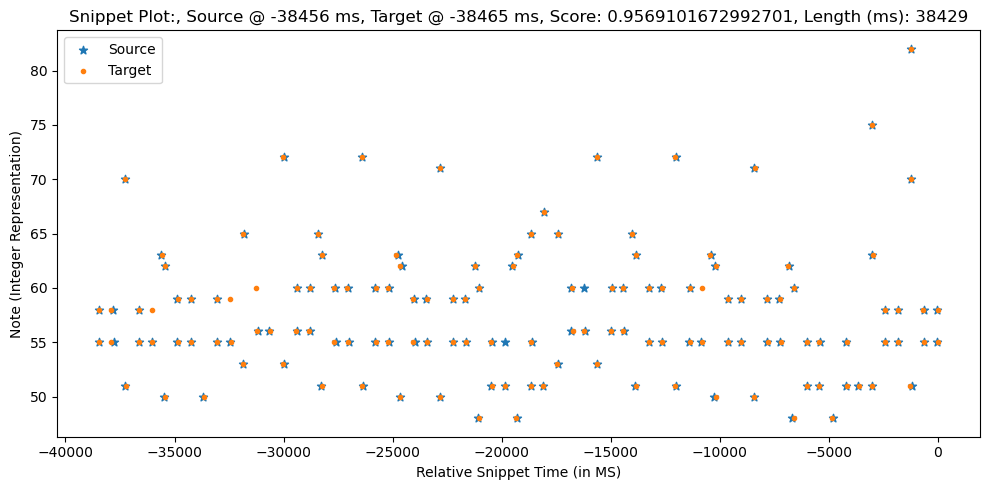

0.9569741474452556
Scores: [ 0.96    0.985   0.715   0.795   0.975   0.9825  0.9175  0.9475  0.995
 -0.      0.945   0.9625  0.9825  0.93    0.92    0.9525  0.9175  0.89
  0.98    0.965  -0.      0.9425  0.9925  0.955  -0.      0.9175  0.84
  0.9225  0.9175  0.8975  0.94    0.9025  0.93    0.9475  0.975   0.9325
  0.82    0.84    0.905   0.905   0.9725  0.995   0.835   0.875   0.935
  0.98    0.8275  0.965   0.88    0.7875  0.7775  0.9475  0.97    0.9925
  0.9975  0.9875  0.99    0.92    0.9775  0.9925  0.96    0.945   0.94
  0.9     0.9375  0.8525  0.9125  0.955   0.9225  0.985   0.95    0.9875
  0.9925  0.985   0.965   0.8975  0.8425  0.8375  0.96    0.9925  0.975
  0.945   0.82    0.9875  0.99    0.9825  0.99    0.9725  0.925   0.99
  0.8525  0.97    0.9825  0.945   0.95   -0.      0.9025  0.8825  0.7725
  0.915   0.9875  0.98    0.9875  0.94    0.9625  0.91    0.9025  0.8775
  0.8925  0.8925  0.86    0.7925  0.9025  0.9725  0.99    0.93    0.9725
  0.905   0.8425  0.88    0.88    0

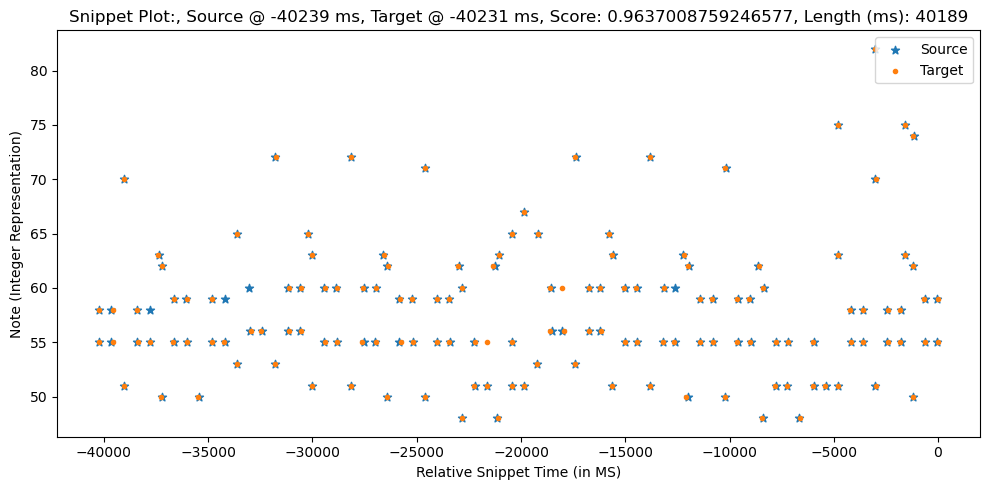

Scores: [ 0.985   0.96    0.795   0.715   0.975   0.9825  0.9475  0.9175  0.995
  0.945   0.9625  0.9825  0.92    0.93    0.9525  0.9175  0.89    0.965
  0.98    0.9425  0.9925  0.955   0.9175  0.84    0.9225  0.9175  0.94
  0.8975  0.9025  0.93    0.9475  0.9325  0.975   0.82    0.84    0.905
  0.905   0.9725  0.995   0.835   0.875   0.935   0.98    0.8275  0.965
  0.88    0.7875  0.7775  0.9475  0.97    0.9925  0.9975  0.99    0.9875
  0.92    0.9775  0.9925  0.96    0.945   0.9     0.94    0.9375 -0.
  0.8525  0.9125  0.955   0.985   0.9225  0.95    0.9875  0.9925  0.985
  0.965   0.8975  0.8425 -0.      0.8375  0.9925  0.96    0.975   0.945
  0.9875  0.82    0.99    0.9825  0.99    0.925   0.9725  0.8525  0.99
  0.9825  0.97    0.945   0.95    0.9025  0.8825  0.7725  0.915   0.9875
  0.98    0.94    0.9875  0.9625  0.91    0.9025  0.8775  0.8925  0.8925
  0.86    0.7925  0.9025  0.9725  0.99    0.93    0.9725  0.905   0.8425
  0.88    0.88    0.9225  0.9425  0.9425  0.9325  0.965  

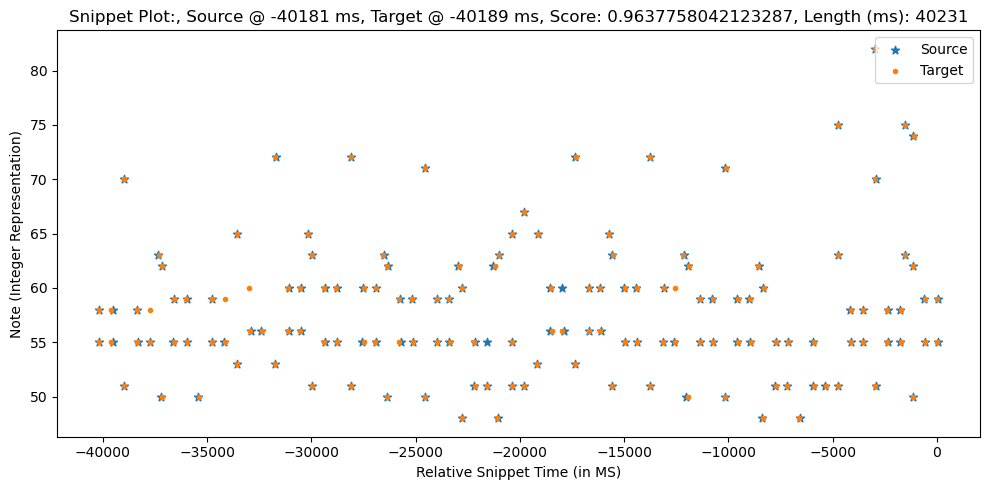

0.9637758042123287
Scores: [-0.     -0.     -0.     -0.     -0.     -0.     -0.     -0.     -0.
 -0.     -0.     -0.     -0.     -0.      0.3725 -0.      0.535  -0.
 -0.      0.455  -0.      0.33   -0.     -0.     -0.     -0.     -0.
 -0.     -0.     -0.     -0.     -0.     -0.      0.8475 -0.     -0.
 -0.     -0.     -0.     -0.      0.3775 -0.     -0.      0.3175 -0.
  0.3975  0.85   -0.     -0.     -0.      0.53   -0.      0.3375 -0.
 -0.     -0.      0.355  -0.      0.51    0.93   -0.     -0.      0.55
 -0.     -0.     -0.     -0.     -0.     -0.     -0.      0.4075 -0.
 -0.     -0.     -0.     -0.     -0.     -0.     -0.     -0.     -0.
 -0.     -0.     -0.      0.84   -0.     -0.     -0.      0.3625 -0.
  0.395   0.42   -0.     -0.      0.3725  0.4025 -0.      0.8525 -0.
 -0.      0.3375 -0.      0.28   -0.     -0.     -0.     -0.      0.345
 -0.      0.2375  0.9925 -0.     -0.     -0.      0.32   -0.      0.3775
 -0.     -0.      0.3525 -0.      0.18   -0.     -0.     -0.      0

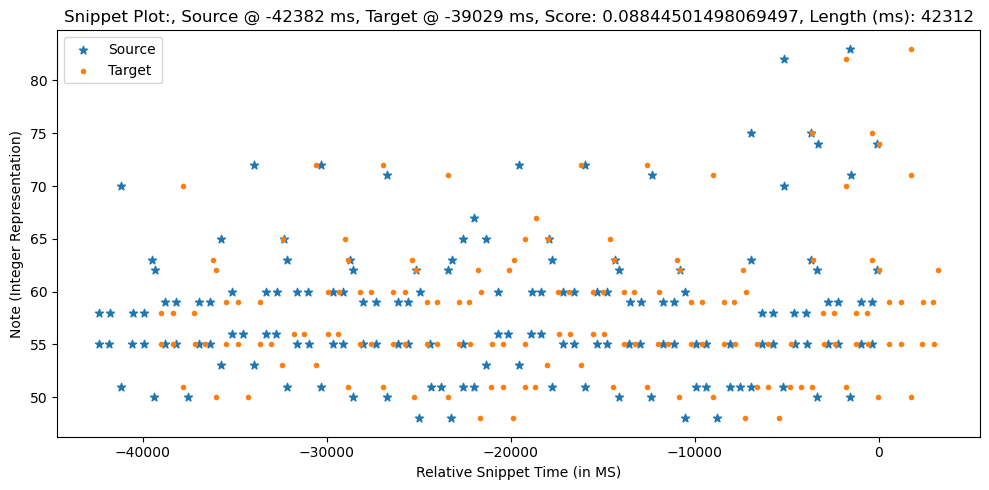

Scores: [ 0.98    0.955   0.79    0.71    0.98    0.9875  0.9425  0.9125  1.
  0.95    0.9675  0.9875  0.925   0.935   0.9475  0.9125  0.895   0.97
  0.985   0.9475  0.9875  0.95    0.9125  0.845   0.9175  0.9125  0.935
  0.8925  0.8975  0.925   0.9525  0.9375  0.97    0.815   0.835   0.9
  0.9     0.9675  0.99    0.84    0.88    0.93    0.975   0.8225  0.97
  0.875   0.7825  0.7725  0.9525  0.975   0.9975  0.9975  0.995   0.9825
  0.925   0.9825  0.9975  0.965   0.95    0.905   0.935   0.9325 -0.
  0.8575  0.9075  0.95    0.99    0.9175  0.945   0.9925  0.9975  0.98
  0.96    0.9025  0.8475 -0.      0.8325  0.9975  0.955   0.97    0.95
  0.9825  0.815   0.995   0.9875  0.995   0.93    0.9675  0.8575  0.995
  0.9775  0.965   0.95    0.955   0.9075  0.8775  0.7775  0.92    0.9825
  0.985   0.945   0.9925  0.9675  0.915   0.9075  0.8825  0.8975  0.8975
  0.855   0.7975  0.9075  0.9775  0.995   0.925   0.9675  0.9     0.8475
  0.885   0.885   0.9275  0.9475  0.9475  0.9375  0.97    0.9975

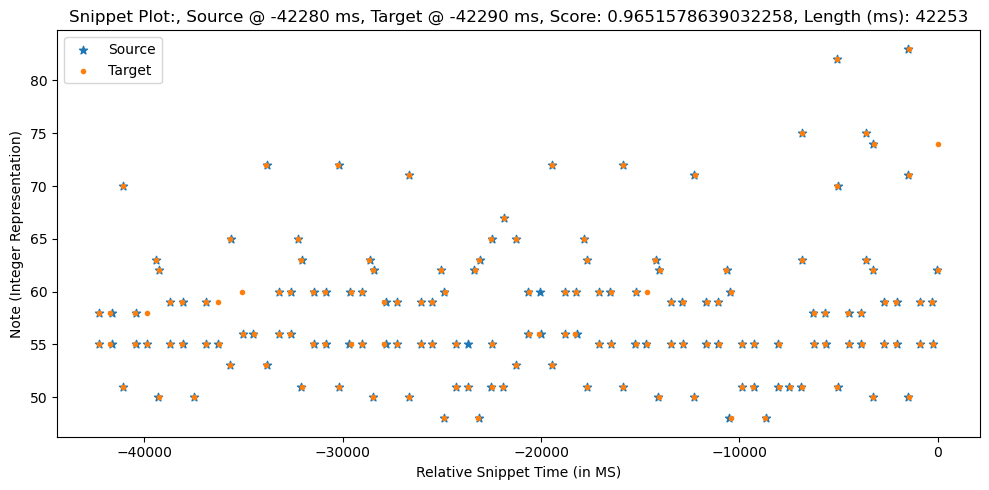

0.9651578639032258
Scores: [ 0.955   0.98    0.71    0.79    0.98    0.9875  0.9125  0.9425  1.
 -0.      0.95    0.9675  0.9875  0.935   0.925   0.9475  0.9125  0.895
  0.985   0.97   -0.      0.9475  0.9875  0.95   -0.      0.9125  0.845
  0.9175  0.9125  0.8925  0.935   0.8975  0.925   0.9525  0.97    0.9375
  0.815   0.835   0.9     0.9     0.9675  0.99    0.84    0.88    0.93
  0.975   0.8225  0.97    0.875   0.7825  0.7725  0.9525  0.975   0.9975
  0.9975  0.9825  0.995   0.925   0.9825  0.9975  0.965   0.95    0.935
  0.905   0.9325  0.8575  0.9075  0.95    0.9175  0.99    0.945   0.9925
  0.9975  0.98    0.96    0.9025  0.8475  0.8325  0.955   0.9975  0.97
  0.95    0.815   0.9825  0.995   0.9875  0.995   0.9675  0.93    0.995
  0.8575  0.965   0.9775  0.95    0.955  -0.      0.9075  0.8775  0.7775
  0.92    0.9825  0.985   0.9925  0.945   0.9675  0.915   0.9075  0.8825
  0.8975  0.8975  0.855   0.7975  0.9075  0.9775  0.995   0.925   0.9675
  0.9     0.8475  0.885   0.885   0.

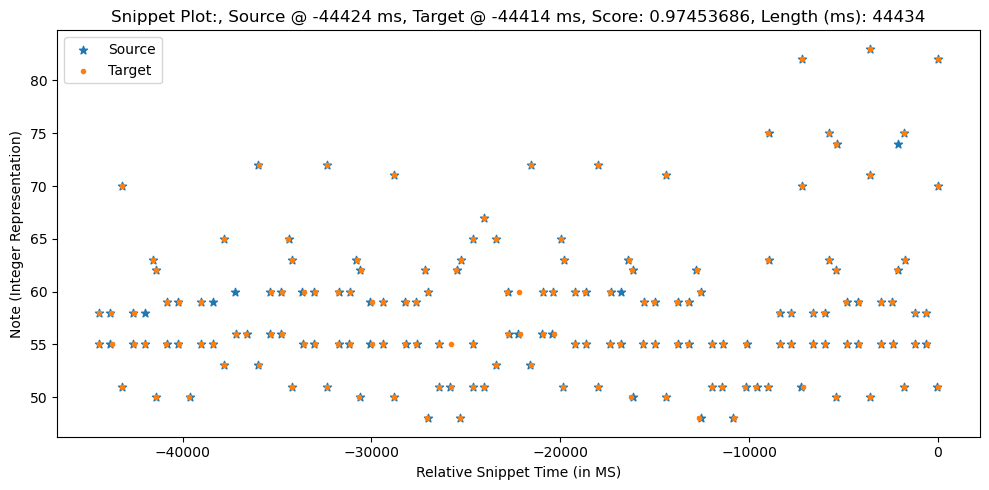

Scores: [ 0.98    0.955   0.79    0.71    0.98    0.9875  0.9425  0.9125  1.
  0.95    0.9675  0.9875  0.925   0.935   0.9475  0.9125  0.895   0.97
  0.985   0.9475  0.9875  0.95    0.9125  0.845   0.9175  0.9125  0.935
  0.8925  0.8975  0.925   0.9525  0.9375  0.97    0.815   0.835   0.9
  0.9     0.9675  0.99    0.84    0.88    0.93    0.975   0.8225  0.97
  0.875   0.7825  0.7725  0.9525  0.975   0.9975  0.9975  0.995   0.9825
  0.925   0.9825  0.9975  0.965   0.95    0.905   0.935   0.9325 -0.
  0.8575  0.9075  0.95    0.99    0.9175  0.945   0.9925  0.9975  0.98
  0.96    0.9025  0.8475 -0.      0.8325  0.9975  0.955   0.97    0.95
  0.9825  0.815   0.995   0.9875  0.995   0.93    0.9675  0.8575  0.995
  0.9775  0.965   0.95    0.955   0.9075  0.8775  0.7775  0.92    0.9825
  0.985   0.945   0.9925  0.9675  0.915   0.9075  0.8825  0.8975  0.8975
  0.855   0.7975  0.9075  0.9775  0.995   0.925   0.9675  0.9     0.8475
  0.885   0.885   0.9275  0.9475  0.9475  0.9375  0.97    0.9975

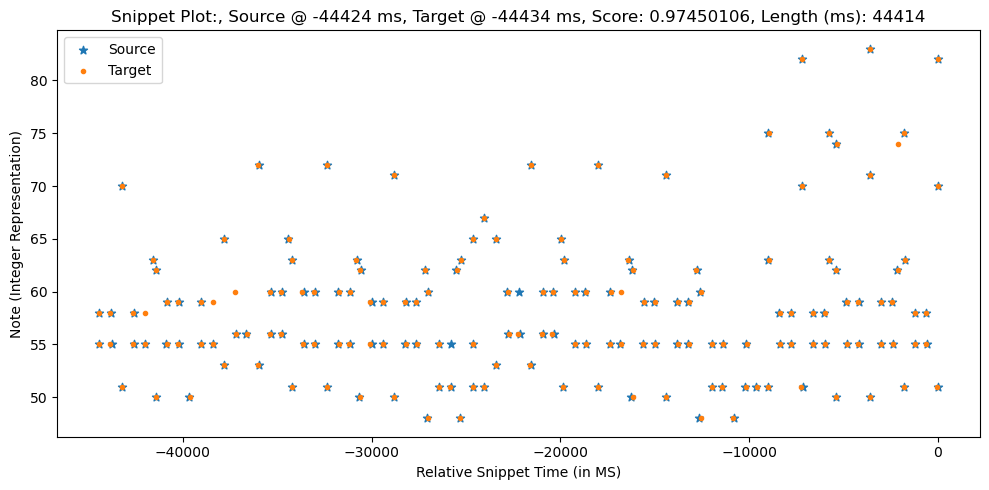

0.97453686
Scores: [ 0.9525  0.9775  0.7075  0.7875  0.9825  0.99    0.91    0.94    0.9975
 -0.      0.9525  0.97    0.99    0.9375  0.9275  0.945   0.91    0.8975
  0.9875  0.9725 -0.      0.95    0.985   0.9475 -0.      0.91    0.8475
  0.915   0.91    0.89    0.9325  0.895   0.9225  0.955   0.9675  0.94
  0.8125  0.8325  0.8975  0.8975  0.965   0.9875  0.8425  0.8825  0.9275
  0.9725  0.82    0.9725  0.8725  0.78    0.77    0.955   0.9775  1.
  0.995   0.98    0.9975  0.9275  0.985   1.      0.9675  0.9525  0.9325
  0.9075  0.93    0.86    0.905   0.9475  0.915   0.9925  0.9425  0.995
  1.      0.9775  0.9575  0.905   0.85    0.83    0.9525  1.      0.9675
  0.9525  0.8125  0.98    0.9975  0.99    0.9975  0.965   0.9325  0.9975
  0.86    0.9625  0.975   0.9525  0.9575 -0.      0.91    0.875   0.78
  0.9225  0.98    0.9875  0.995   0.9475  0.97    0.9175  0.91    0.885
  0.9     0.9     0.8525  0.8     0.91    0.98    0.9975  0.9225  0.965
  0.8975  0.85    0.8875  0.8875  0.93    0

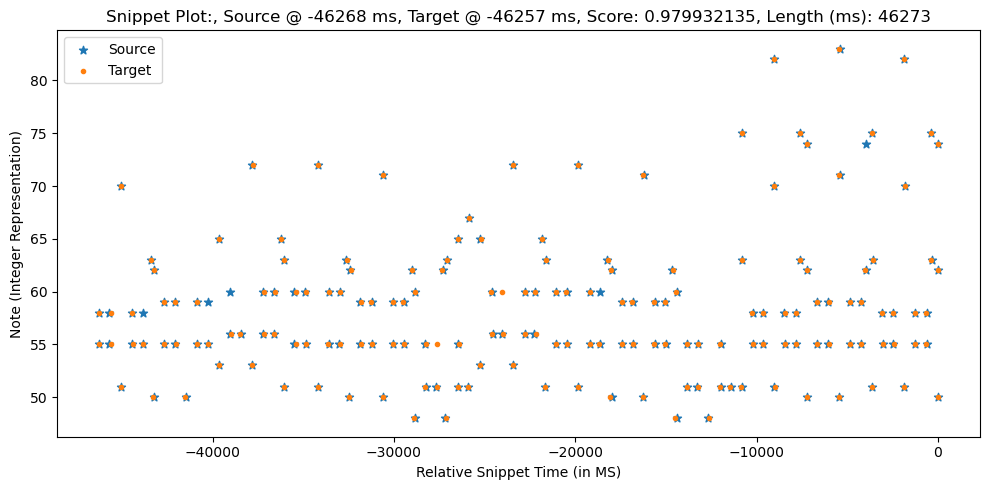

Scores: [ 0.9775  0.9525  0.7875  0.7075  0.9825  0.99    0.94    0.91    0.9975
  0.9525  0.97    0.99    0.9275  0.9375  0.945   0.91    0.8975  0.9725
  0.9875  0.95    0.985   0.9475  0.91    0.8475  0.915   0.91    0.9325
  0.89    0.895   0.9225  0.955   0.94    0.9675  0.8125  0.8325  0.8975
  0.8975  0.965   0.9875  0.8425  0.8825  0.9275  0.9725  0.82    0.9725
  0.8725  0.78    0.77    0.955   0.9775  1.      0.995   0.9975  0.98
  0.9275  0.985   1.      0.9675  0.9525  0.9075  0.9325  0.93   -0.
  0.86    0.905   0.9475  0.9925  0.915   0.9425  0.995   1.      0.9775
  0.9575  0.905   0.85   -0.      0.83    1.      0.9525  0.9675  0.9525
  0.98    0.8125  0.9975  0.99    0.9975  0.9325  0.965   0.86    0.9975
  0.975   0.9625  0.9525  0.9575  0.91    0.875   0.78    0.9225  0.98
  0.9875  0.9475  0.995   0.97    0.9175  0.91    0.885   0.9     0.9
  0.8525  0.8     0.91    0.98    0.9975  0.9225  0.965   0.8975  0.85
  0.8875  0.8875  0.93    0.95    0.95    0.94    0.9725

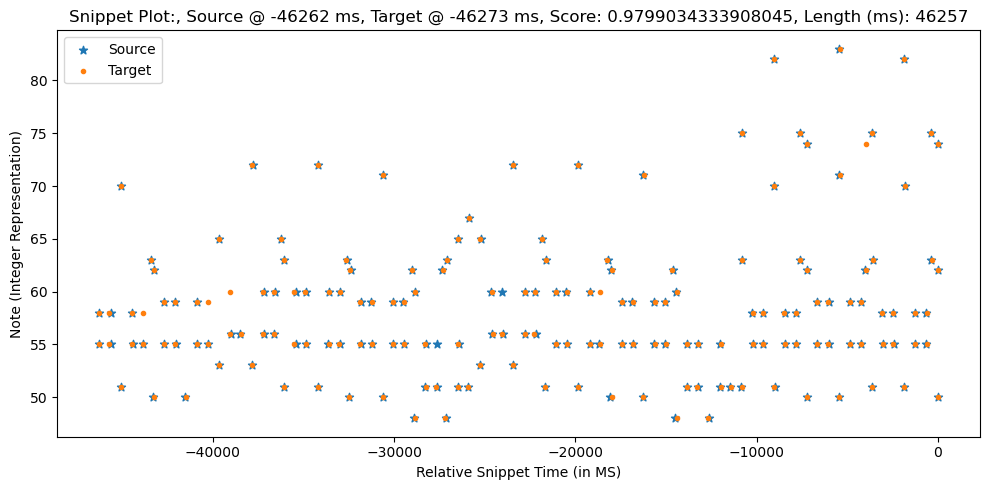

0.979932135
Scores: [ 0.94    0.965   0.695   0.775   0.995   0.9975  0.8975  0.9275  0.985
 -0.      0.965   0.9825  0.9975  0.95    0.94    0.9325  0.8975  0.91
  1.      0.985  -0.      0.9625  0.9725  0.935  -0.      0.8975  0.86
  0.9025  0.8975  0.8775  0.92    0.8825  0.91    0.9675  0.955   0.9525
  0.8     0.82    0.885   0.885   0.9525  0.975   0.855   0.895   0.915
  0.96    0.8075  0.985   0.86    0.7675  0.7575  0.9675  0.99    0.9875
  0.9825  0.9675  0.99    0.94    0.9975  0.9875  0.98    0.965   0.92
  0.92    0.9175  0.8725  0.8925  0.935   0.9025  0.995   0.93    0.9925
  0.9875  0.965   0.945   0.9175  0.8625  0.8175  0.94    0.9875  0.955
  0.965   0.8     0.9675  0.99    0.9975  0.99    0.9525  0.945   0.99
  0.8725  0.95    0.9625  0.965   0.97   -0.      0.9225  0.8625  0.7925
  0.935   0.9675  1.      0.9925  0.96    0.9825  0.93    0.9225  0.8975
  0.9125  0.9125  0.84    0.8125  0.9225  0.9925  0.99    0.91    0.9525
  0.885   0.8625  0.9     0.9     0.9425  

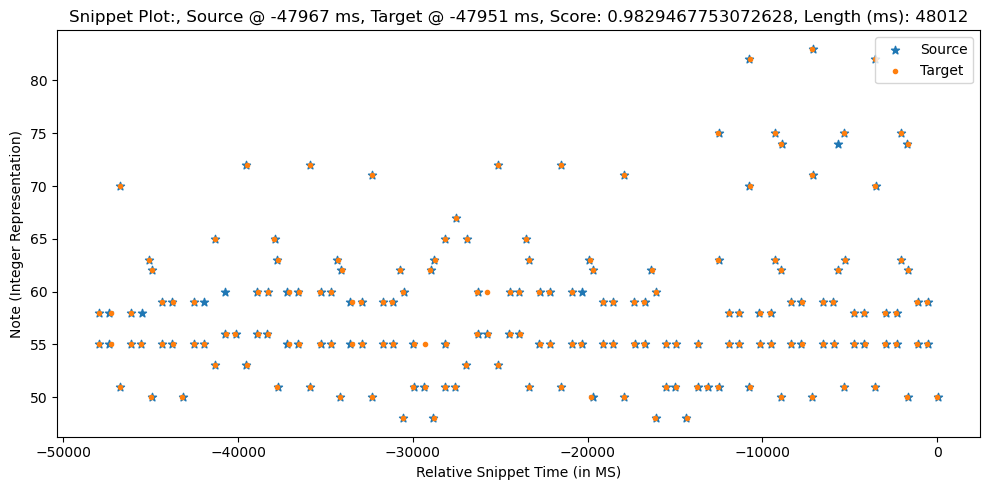

Scores: [ 0.9725  0.9475  0.7825  0.7025  0.9875  0.995   0.935   0.905   0.9925
  0.9575  0.975   0.995   0.9325  0.9425  0.94    0.905   0.9025  0.9775
  0.9925  0.955   0.98    0.9425  0.905   0.8525  0.91    0.905   0.9275
  0.885   0.89    0.9175  0.96    0.945   0.9625  0.8075  0.8275  0.8925
  0.8925  0.96    0.9825  0.8475  0.8875  0.9225  0.9675  0.815   0.9775
  0.8675  0.775   0.765   0.96    0.9825  0.995   0.99    0.9975  0.975
  0.9325  0.99    0.995   0.9725  0.9575  0.9125  0.9275  0.925  -0.
  0.865   0.9     0.9425  0.9975  0.91    0.9375  1.      0.995   0.9725
  0.9525  0.91    0.855  -0.      0.825   0.995   0.9475  0.9625  0.9575
  0.975   0.8075  0.9975  0.995   0.9975  0.9375  0.96    0.865   0.9975
  0.97    0.9575  0.9575  0.9625  0.915   0.87    0.785   0.9275  0.975
  0.9925  0.9525  1.      0.975   0.9225  0.915   0.89    0.905   0.905
  0.8475  0.805   0.915   0.985   0.9975  0.9175  0.96    0.8925  0.855
  0.8925  0.8925  0.935   0.955   0.955   0.945   0

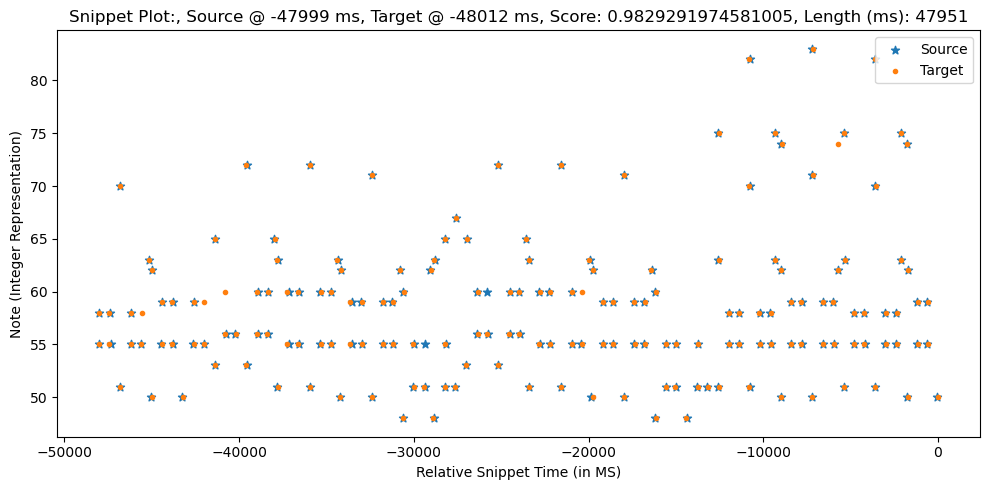

0.9829467753072628
Scores: [ 0.9825  0.9925  0.7375  0.8175  0.9525  0.96    0.94    0.97    0.9725
 -0.      0.9225  0.94    0.96    0.9075  0.8975  0.975   0.94    0.8675]
Sequence1:  [[-4759    58    36]
 [-4757    55    44]
 [-4201    55    49]
 [-4187    58    44]
 [-3550    70    58]
 [-3539    51    46]
 [-2940    55    45]
 [-2937    58    32]
 [-2333    55    48]
 [-2321    58    39]
 [-1887    63    52]
 [-1751    50    42]
 [-1739    62    56]
 [-1157    59    46]
 [-1155    55    46]
 [ -562    59    42]
 [ -556    55    48]
 [   53    50    46]]
Sequence2:  [[-4760    55    49]
 [-4752    58    34]
 [-4114    58    26]
 [-4096    55    35]
 [-3569    70    53]
 [-3555    51    51]
 [-2925    58    33]
 [-2916    55    42]
 [-2344    55    48]
 [-1918    63    49]
 [-1775    50    44]
 [-1755    62    54]
 [-1196    55    44]
 [-1194    59    42]
 [ -552    59    41]
 [ -532    55    45]
 [    0    50    51]]
mean_offset1:  53.23529411764706
mean_offset2:  -53.2352941176470

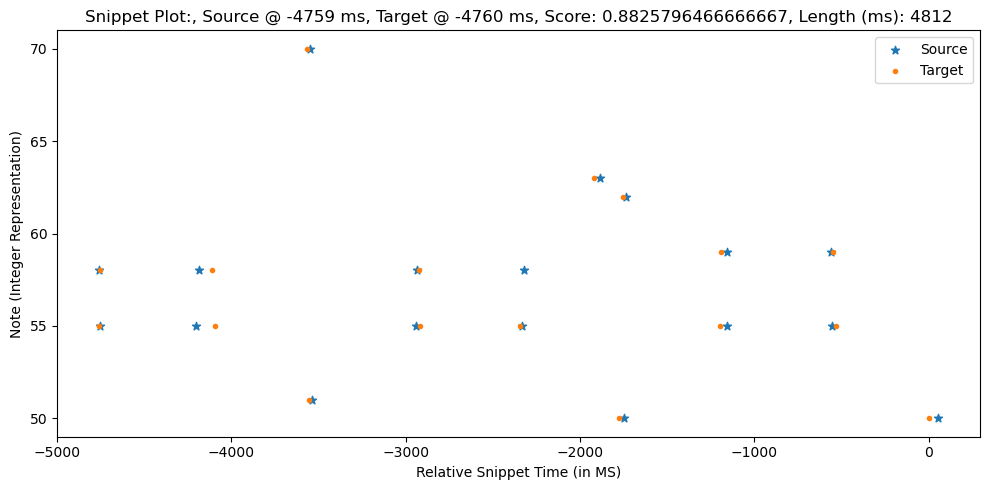

Scores: [0.9925 0.9825 0.8175 0.7375 0.9525 0.96   0.97   0.94   0.9725 0.9225
 0.94   0.96   0.8975 0.9075 0.975  0.94   0.8675]
Sequence1:  [[-4813    55    49]
 [-4805    58    34]
 [-4167    58    26]
 [-4149    55    35]
 [-3622    70    53]
 [-3608    51    51]
 [-2978    58    33]
 [-2969    55    42]
 [-2397    55    48]
 [-1971    63    49]
 [-1828    50    44]
 [-1808    62    54]
 [-1249    55    44]
 [-1247    59    42]
 [ -605    59    41]
 [ -585    55    45]
 [  -53    50    51]]
Sequence2:  [[-4812    58    36]
 [-4810    55    44]
 [-4254    55    49]
 [-4240    58    44]
 [-3603    70    58]
 [-3592    51    46]
 [-2993    55    45]
 [-2990    58    32]
 [-2386    55    48]
 [-2374    58    39]
 [-1940    63    52]
 [-1804    50    42]
 [-1792    62    56]
 [-1210    59    46]
 [-1208    55    46]
 [ -615    59    42]
 [ -609    55    48]
 [    0    50    46]]
mean_offset1:  -53.23529411764706
mean_offset2:  53.23529411764706
mo:  [0]
Count zeros:  0


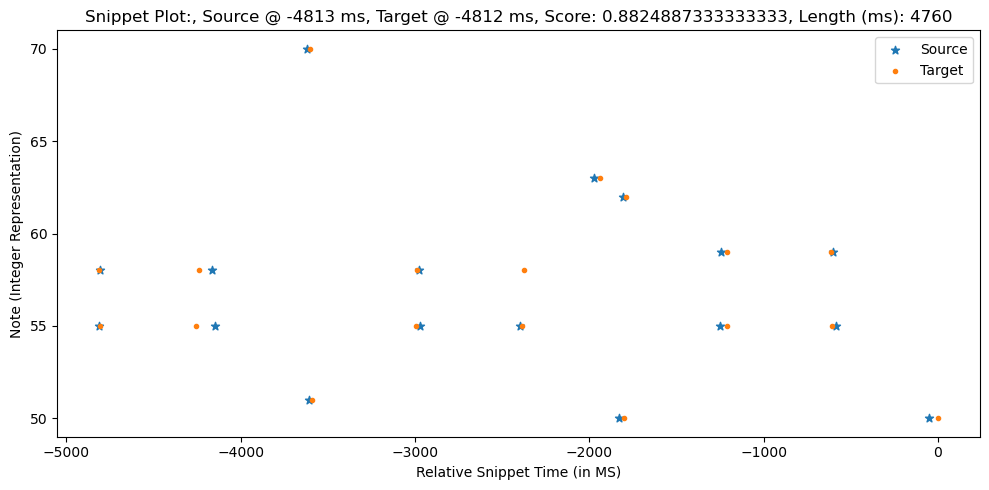

0.8825796466666667
Scores: [ 0.9775  0.9975  0.7325  0.8125  0.9575  0.965   0.935   0.965   0.9775
 -0.      0.9275  0.945   0.965   0.9125  0.9025  0.97    0.935   0.8725
  0.9625  0.9475 -0.      0.925   0.99    0.9725]
Sequence1:  [[-6634    58    36]
 [-6632    55    44]
 [-6076    55    49]
 [-6062    58    44]
 [-5425    70    58]
 [-5414    51    46]
 [-4815    55    45]
 [-4812    58    32]
 [-4208    55    48]
 [-4196    58    39]
 [-3762    63    52]
 [-3626    50    42]
 [-3614    62    56]
 [-3032    59    46]
 [-3030    55    46]
 [-2437    59    42]
 [-2431    55    48]
 [-1822    50    46]
 [-1221    59    39]
 [-1219    55    44]
 [ -613    59    34]
 [ -597    55    41]
 [  -14    53    47]
 [  -11    65    54]]
Sequence2:  [[-6633    55    49]
 [-6625    58    34]
 [-5987    58    26]
 [-5969    55    35]
 [-5442    70    53]
 [-5428    51    51]
 [-4798    58    33]
 [-4789    55    42]
 [-4217    55    48]
 [-3791    63    49]
 [-3648    50    44]
 [-3628    62    

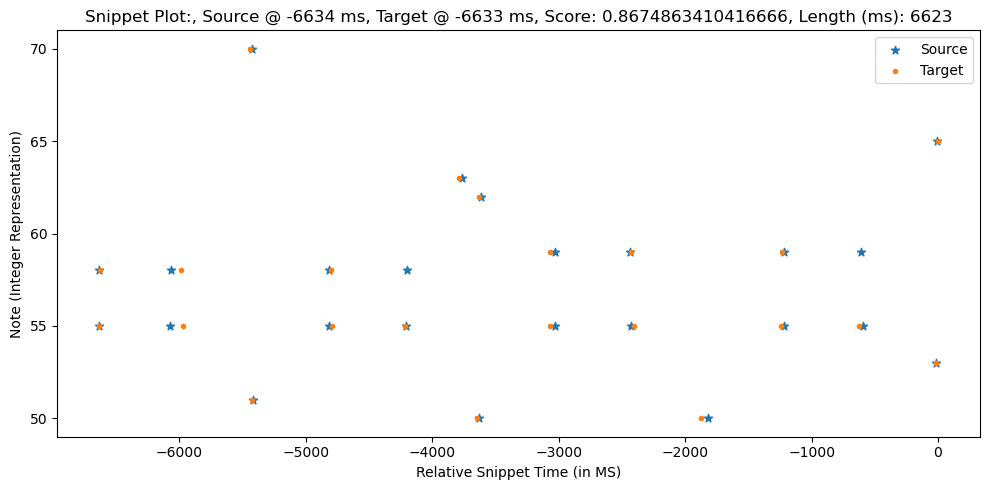

Scores: [0.9975 0.9775 0.8125 0.7325 0.9575 0.965  0.965  0.935  0.9775 0.9275
 0.945  0.965  0.9025 0.9125 0.97   0.935  0.8725 0.9475 0.9625 0.925
 0.99   0.9725]
Sequence1:  [[-6622    55    49]
 [-6614    58    34]
 [-5976    58    26]
 [-5958    55    35]
 [-5431    70    53]
 [-5417    51    51]
 [-4787    58    33]
 [-4778    55    42]
 [-4206    55    48]
 [-3780    63    49]
 [-3637    50    44]
 [-3617    62    54]
 [-3058    55    44]
 [-3056    59    42]
 [-2414    59    41]
 [-2394    55    45]
 [-1862    50    51]
 [-1229    55    44]
 [-1225    59    40]
 [ -616    55    47]
 [   -7    53    43]
 [   11    65    49]]
Sequence2:  [[-6623    58    36]
 [-6621    55    44]
 [-6065    55    49]
 [-6051    58    44]
 [-5414    70    58]
 [-5403    51    46]
 [-4804    55    45]
 [-4801    58    32]
 [-4197    55    48]
 [-4185    58    39]
 [-3751    63    52]
 [-3615    50    42]
 [-3603    62    56]
 [-3021    59    46]
 [-3019    55    46]
 [-2426    59    42]
 [-2420    5

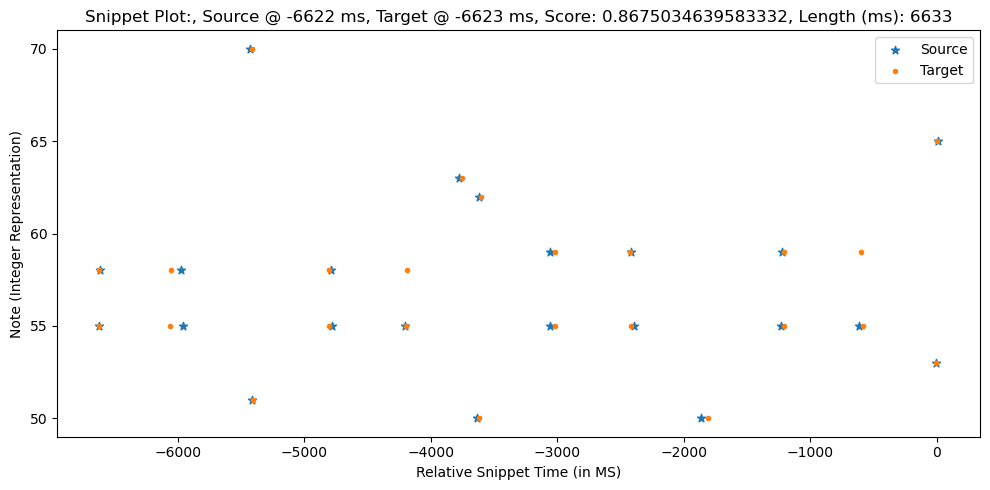

0.8675034639583332
Scores: [ 0.9775  0.9975  0.7325  0.8125  0.9575  0.965   0.935   0.965   0.9775
 -0.      0.9275  0.945   0.965   0.9125  0.9025  0.97    0.935   0.8725
  0.9625  0.9475 -0.      0.925   0.99    0.9725 -0.      0.935   0.8225
  0.94    0.935 ]
Sequence1:  [[-8465    58    36]
 [-8463    55    44]
 [-7907    55    49]
 [-7893    58    44]
 [-7256    70    58]
 [-7245    51    46]
 [-6646    55    45]
 [-6643    58    32]
 [-6039    55    48]
 [-6027    58    39]
 [-5593    63    52]
 [-5457    50    42]
 [-5445    62    56]
 [-4863    59    46]
 [-4861    55    46]
 [-4268    59    42]
 [-4262    55    48]
 [-3653    50    46]
 [-3052    59    39]
 [-3050    55    44]
 [-2444    59    34]
 [-2428    55    41]
 [-1845    53    47]
 [-1842    65    54]
 [-1254    60    34]
 [-1227    56    44]
 [ -625    56    45]
 [  -33    53    46]
 [  -26    72    59]]
Sequence2:  [[-8464    55    49]
 [-8456    58    34]
 [-7818    58    26]
 [-7800    55    35]
 [-7273    70    5

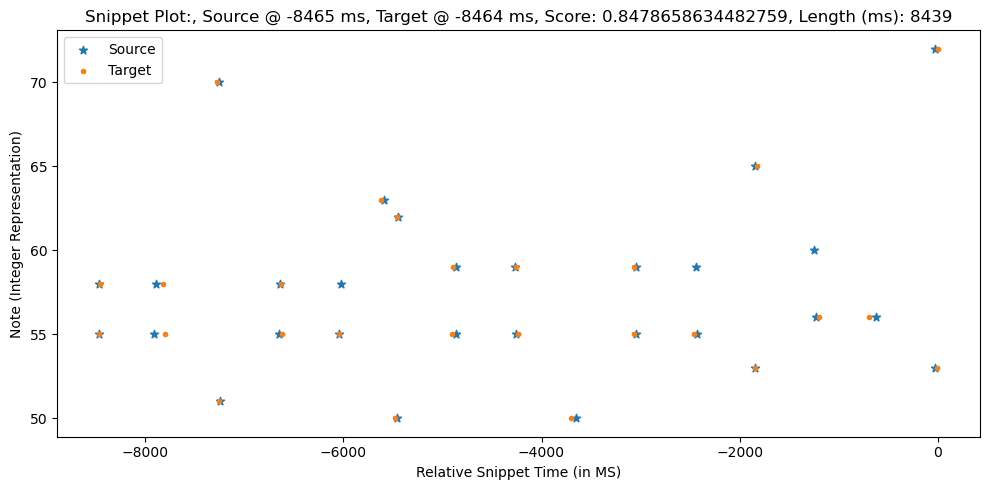

Scores: [0.9975 0.9775 0.8125 0.7325 0.9575 0.965  0.965  0.935  0.9775 0.9275
 0.945  0.965  0.9025 0.9125 0.97   0.935  0.8725 0.9475 0.9625 0.925
 0.99   0.9725 0.935  0.8225 0.94   0.935 ]
Sequence1:  [[-8438    55    49]
 [-8430    58    34]
 [-7792    58    26]
 [-7774    55    35]
 [-7247    70    53]
 [-7233    51    51]
 [-6603    58    33]
 [-6594    55    42]
 [-6022    55    48]
 [-5596    63    49]
 [-5453    50    44]
 [-5433    62    54]
 [-4874    55    44]
 [-4872    59    42]
 [-4230    59    41]
 [-4210    55    45]
 [-3678    50    51]
 [-3045    55    44]
 [-3041    59    40]
 [-2432    55    47]
 [-1823    53    43]
 [-1805    65    49]
 [-1175    56    41]
 [ -670    56    41]
 [   17    53    54]
 [   26    72    55]]
Sequence2:  [[-8439    58    36]
 [-8437    55    44]
 [-7881    55    49]
 [-7867    58    44]
 [-7230    70    58]
 [-7219    51    46]
 [-6620    55    45]
 [-6617    58    32]
 [-6013    55    48]
 [-6001    58    39]
 [-5567    63    52]
 [-54

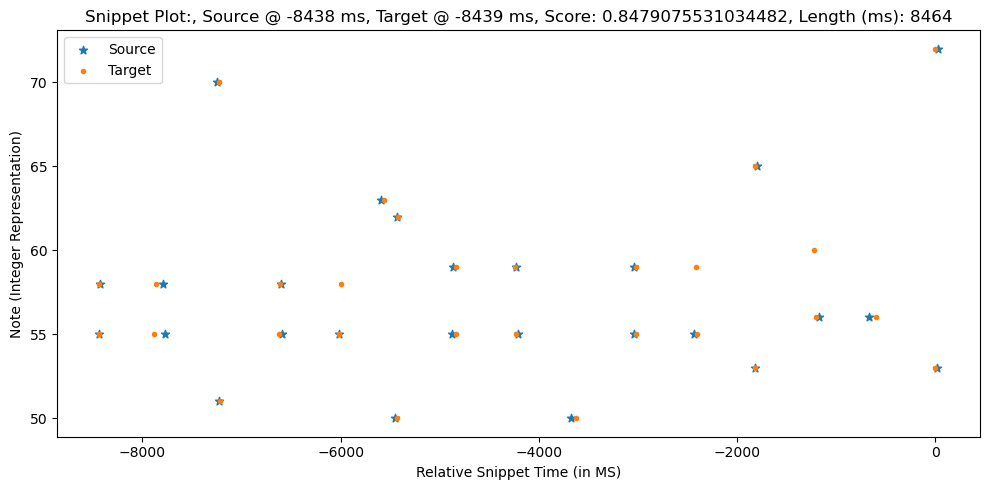

0.8479075531034482
Scores: [ 0.99    0.985   0.745   0.825   0.945   0.9525  0.9475  0.9775  0.965
 -0.      0.915   0.9325  0.9525  0.9     0.89    0.9825  0.9475  0.86
  0.95    0.935  -0.      0.9125  0.9775  0.985  -0.      0.9475  0.81
  0.9525  0.9475  0.9275  0.97    0.9325  0.96    0.9175  0.995   0.9025
  0.85    0.87  ]
Sequence1:  [[-10832     58     36]
 [-10830     55     44]
 [-10274     55     49]
 [-10260     58     44]
 [ -9623     70     58]
 [ -9612     51     46]
 [ -9013     55     45]
 [ -9010     58     32]
 [ -8406     55     48]
 [ -8394     58     39]
 [ -7960     63     52]
 [ -7824     50     42]
 [ -7812     62     56]
 [ -7230     59     46]
 [ -7228     55     46]
 [ -6635     59     42]
 [ -6629     55     48]
 [ -6020     50     46]
 [ -5419     59     39]
 [ -5417     55     44]
 [ -4811     59     34]
 [ -4795     55     41]
 [ -4212     53     47]
 [ -4209     65     54]
 [ -3621     60     34]
 [ -3594     56     44]
 [ -2992     56     45]
 [ -2400

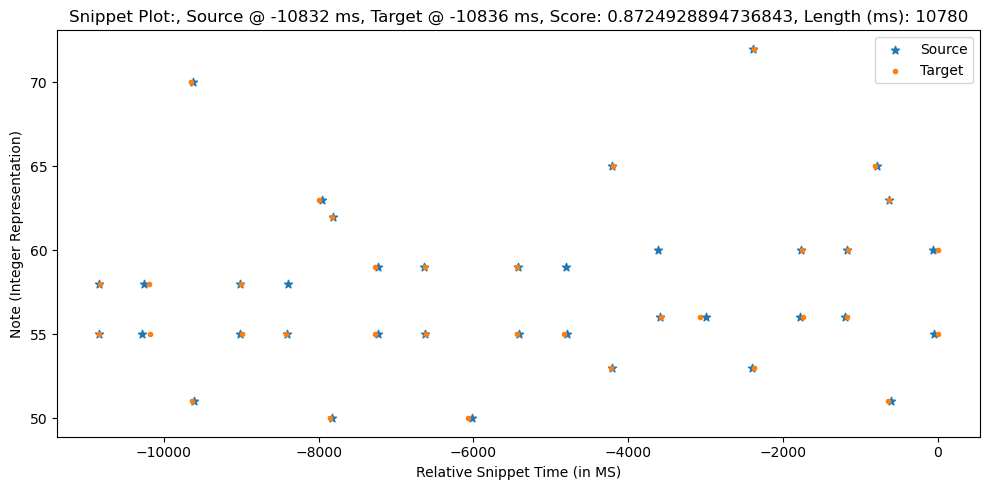

Scores: [0.985  0.99   0.825  0.745  0.945  0.9525 0.9775 0.9475 0.965  0.915
 0.9325 0.9525 0.89   0.9    0.9825 0.9475 0.86   0.935  0.95   0.9125
 0.9775 0.985  0.9475 0.81   0.9525 0.9475 0.97   0.9275 0.9325 0.96
 0.9175 0.9025 0.995  0.85   0.87  ]
Sequence1:  [[-10784     55     49]
 [-10776     58     34]
 [-10138     58     26]
 [-10120     55     35]
 [ -9593     70     53]
 [ -9579     51     51]
 [ -8949     58     33]
 [ -8940     55     42]
 [ -8368     55     48]
 [ -7942     63     49]
 [ -7799     50     44]
 [ -7779     62     54]
 [ -7220     55     44]
 [ -7218     59     42]
 [ -6576     59     41]
 [ -6556     55     45]
 [ -6024     50     51]
 [ -5391     55     44]
 [ -5387     59     40]
 [ -4778     55     47]
 [ -4169     53     43]
 [ -4151     65     49]
 [ -3521     56     41]
 [ -3016     56     41]
 [ -2329     53     54]
 [ -2320     72     55]
 [ -1703     60     32]
 [ -1697     56     44]
 [ -1124     56     48]
 [ -1108     60     31]
 [  -766     

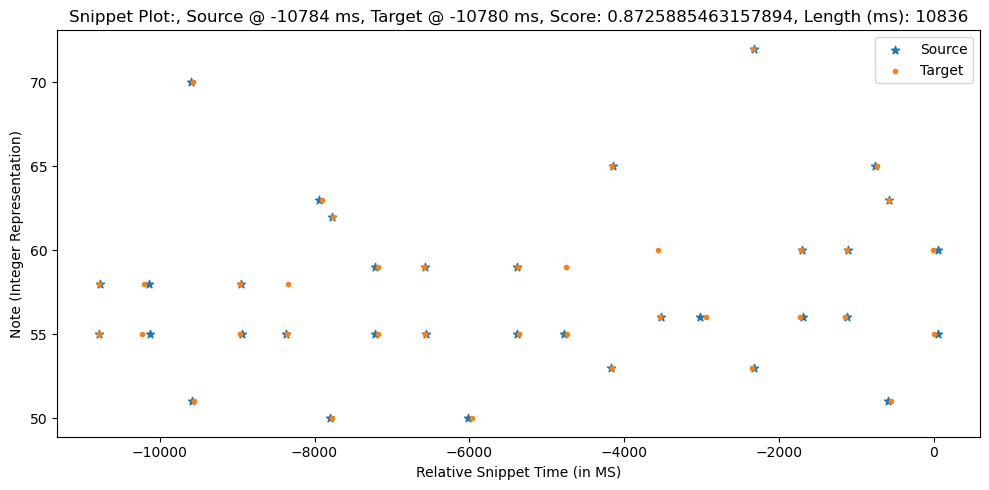

0.8725885463157894
Scores: [ 0.9825  0.9925  0.7375  0.8175  0.9525  0.96    0.94    0.97    0.9725
 -0.      0.9225  0.94    0.96    0.9075  0.8975  0.975   0.94    0.8675
  0.9575  0.9425 -0.      0.92    0.985   0.9775 -0.      0.94    0.8175
  0.945   0.94    0.92    0.9625  0.925   0.9525  0.925   0.9975  0.91
  0.8425  0.8625  0.9275  0.9275  0.995   0.9825  0.8125  0.8525]
Sequence1:  [[-12648     58     36]
 [-12646     55     44]
 [-12090     55     49]
 [-12076     58     44]
 [-11439     70     58]
 [-11428     51     46]
 [-10829     55     45]
 [-10826     58     32]
 [-10222     55     48]
 [-10210     58     39]
 [ -9776     63     52]
 [ -9640     50     42]
 [ -9628     62     56]
 [ -9046     59     46]
 [ -9044     55     46]
 [ -8451     59     42]
 [ -8445     55     48]
 [ -7836     50     46]
 [ -7235     59     39]
 [ -7233     55     44]
 [ -6627     59     34]
 [ -6611     55     41]
 [ -6028     53     47]
 [ -6025     65     54]
 [ -5437     60     34]
 [ -5

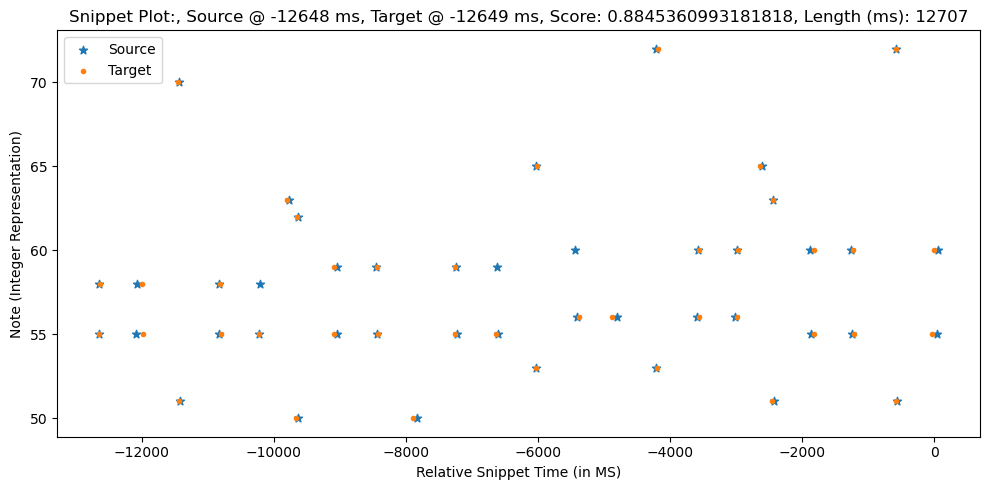

Scores: [0.9925 0.9825 0.8175 0.7375 0.9525 0.96   0.97   0.94   0.9725 0.9225
 0.94   0.96   0.8975 0.9075 0.975  0.94   0.8675 0.9425 0.9575 0.92
 0.985  0.9775 0.94   0.8175 0.945  0.94   0.9625 0.92   0.925  0.9525
 0.925  0.91   0.9975 0.8425 0.8625 0.9275 0.9275 0.995  0.9825 0.8125
 0.8525]
Sequence1:  [[-12708     55     49]
 [-12700     58     34]
 [-12062     58     26]
 [-12044     55     35]
 [-11517     70     53]
 [-11503     51     51]
 [-10873     58     33]
 [-10864     55     42]
 [-10292     55     48]
 [ -9866     63     49]
 [ -9723     50     44]
 [ -9703     62     54]
 [ -9144     55     44]
 [ -9142     59     42]
 [ -8500     59     41]
 [ -8480     55     45]
 [ -7948     50     51]
 [ -7315     55     44]
 [ -7311     59     40]
 [ -6702     55     47]
 [ -6093     53     43]
 [ -6075     65     49]
 [ -5445     56     41]
 [ -4940     56     41]
 [ -4253     53     54]
 [ -4244     72     55]
 [ -3627     60     32]
 [ -3621     56     44]
 [ -3048     56  

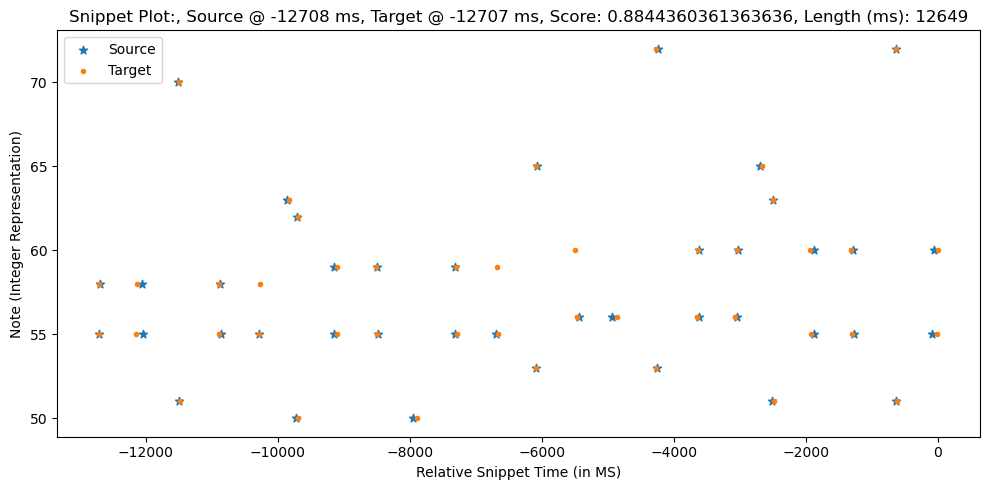

0.8845360993181818
Scores: [ 0.9975  0.9775  0.7525  0.8325  0.9375  0.945   0.955   0.985   0.9575
 -0.      0.9075  0.925   0.945   0.8925  0.8825  0.99    0.955   0.8525
  0.9425  0.9275 -0.      0.905   0.97    0.9925 -0.      0.955   0.8025
  0.96    0.955   0.935   0.9775  0.94    0.9675  0.91    0.9875  0.895
  0.8575  0.8775  0.9425  0.9425  0.99    0.9675  0.7975  0.8375  0.9725
  0.9825  0.865   0.9275  0.9175  0.825   0.815 ]
Sequence1:  [[-14451     58     36]
 [-14449     55     44]
 [-13893     55     49]
 [-13879     58     44]
 [-13242     70     58]
 [-13231     51     46]
 [-12632     55     45]
 [-12629     58     32]
 [-12025     55     48]
 [-12013     58     39]
 [-11579     63     52]
 [-11443     50     42]
 [-11431     62     56]
 [-10849     59     46]
 [-10847     55     46]
 [-10254     59     42]
 [-10248     55     48]
 [ -9639     50     46]
 [ -9038     59     39]
 [ -9036     55     44]
 [ -8430     59     34]
 [ -8414     55     41]
 [ -7831     53    

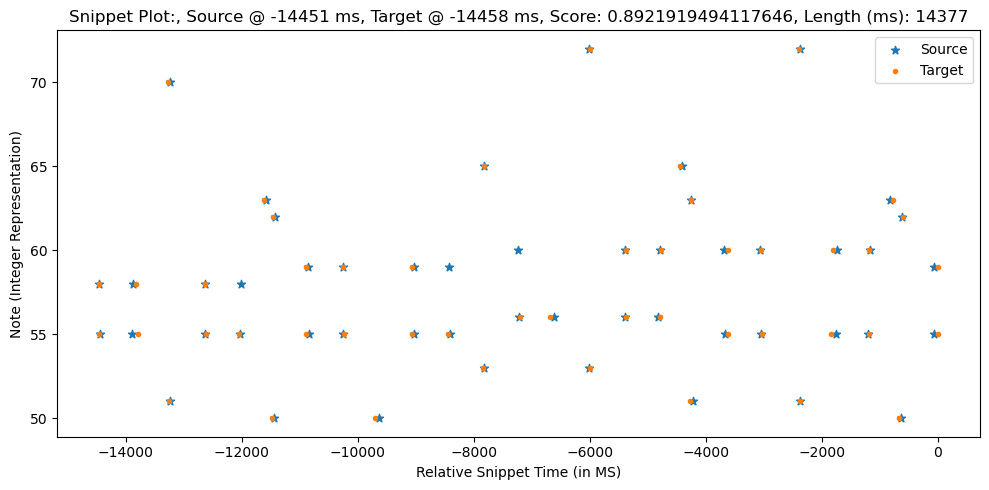

Scores: [0.9775 0.9975 0.8325 0.7525 0.9375 0.945  0.985  0.955  0.9575 0.9075
 0.925  0.945  0.8825 0.8925 0.99   0.955  0.8525 0.9275 0.9425 0.905
 0.97   0.9925 0.955  0.8025 0.96   0.955  0.9775 0.935  0.94   0.9675
 0.91   0.895  0.9875 0.8575 0.8775 0.9425 0.9425 0.99   0.9675 0.7975
 0.8375 0.9725 0.9825 0.865  0.9275 0.9175 0.825  0.815 ]
Sequence1:  [[-14384     55     49]
 [-14376     58     34]
 [-13738     58     26]
 [-13720     55     35]
 [-13193     70     53]
 [-13179     51     51]
 [-12549     58     33]
 [-12540     55     42]
 [-11968     55     48]
 [-11542     63     49]
 [-11399     50     44]
 [-11379     62     54]
 [-10820     55     44]
 [-10818     59     42]
 [-10176     59     41]
 [-10156     55     45]
 [ -9624     50     51]
 [ -8991     55     44]
 [ -8987     59     40]
 [ -8378     55     47]
 [ -7769     53     43]
 [ -7751     65     49]
 [ -7121     56     41]
 [ -6616     56     41]
 [ -5929     53     54]
 [ -5920     72     55]
 [ -5303     60

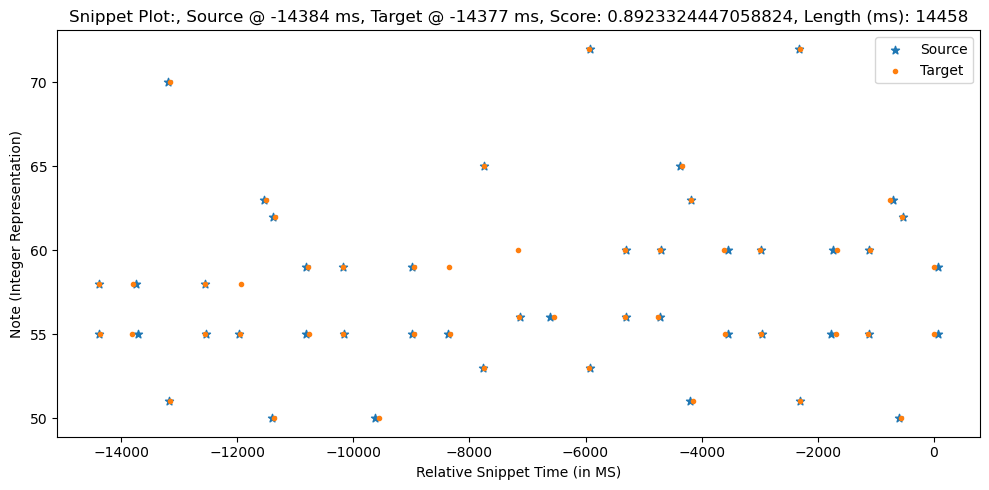

0.8923324447058824
Scores: [ 0.985   0.99    0.74    0.82    0.95    0.9575  0.9425  0.9725  0.97
 -0.      0.92    0.9375  0.9575  0.905   0.895   0.9775  0.9425  0.865
  0.955   0.94   -0.      0.9175  0.9825  0.98   -0.      0.9425  0.815
  0.9475  0.9425  0.9225  0.965   0.9275  0.955   0.9225  1.      0.9075
  0.845   0.865   0.93    0.93    0.9975  0.98    0.81    0.85    0.96
  0.995   0.8525  0.94    0.905   0.8125  0.8025  0.9225  0.945   0.9675
  0.9725  0.9875  0.965   0.895   0.9525]
Sequence1:  [[-16798     58     36]
 [-16796     55     44]
 [-16240     55     49]
 [-16226     58     44]
 [-15589     70     58]
 [-15578     51     46]
 [-14979     55     45]
 [-14976     58     32]
 [-14372     55     48]
 [-14360     58     39]
 [-13926     63     52]
 [-13790     50     42]
 [-13778     62     56]
 [-13196     59     46]
 [-13194     55     46]
 [-12601     59     42]
 [-12595     55     48]
 [-11986     50     46]
 [-11385     59     39]
 [-11383     55     44]
 [-1077

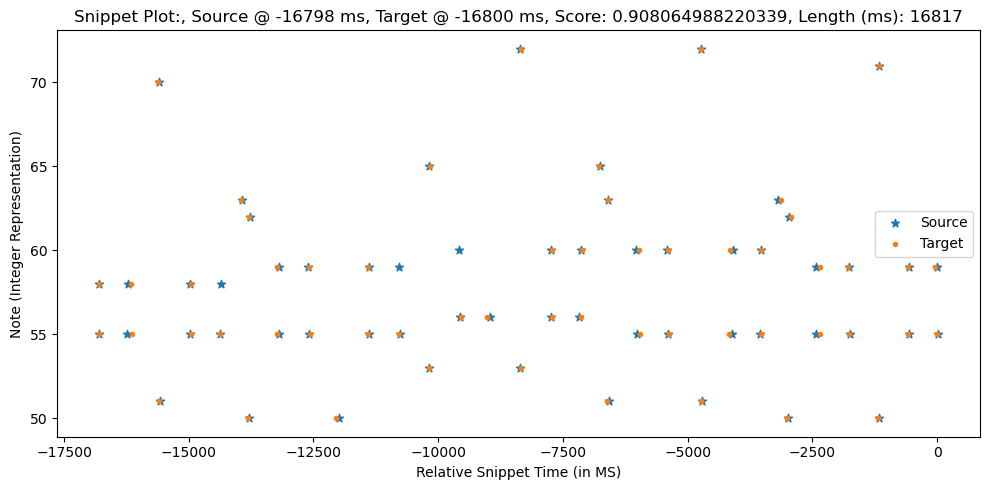

Scores: [0.99   0.985  0.82   0.74   0.95   0.9575 0.9725 0.9425 0.97   0.92
 0.9375 0.9575 0.895  0.905  0.9775 0.9425 0.865  0.94   0.955  0.9175
 0.9825 0.98   0.9425 0.815  0.9475 0.9425 0.965  0.9225 0.9275 0.955
 0.9225 0.9075 1.     0.845  0.865  0.93   0.93   0.9975 0.98   0.81
 0.85   0.96   0.995  0.8525 0.94   0.905  0.8125 0.8025 0.9225 0.945
 0.9675 0.9725 0.965  0.9875 0.895  0.9525]
Sequence1:  [[-16819     55     49]
 [-16811     58     34]
 [-16173     58     26]
 [-16155     55     35]
 [-15628     70     53]
 [-15614     51     51]
 [-14984     58     33]
 [-14975     55     42]
 [-14403     55     48]
 [-13977     63     49]
 [-13834     50     44]
 [-13814     62     54]
 [-13255     55     44]
 [-13253     59     42]
 [-12611     59     41]
 [-12591     55     45]
 [-12059     50     51]
 [-11426     55     44]
 [-11422     59     40]
 [-10813     55     47]
 [-10204     53     43]
 [-10186     65     49]
 [ -9556     56     41]
 [ -9051     56     41]
 [ -8364   

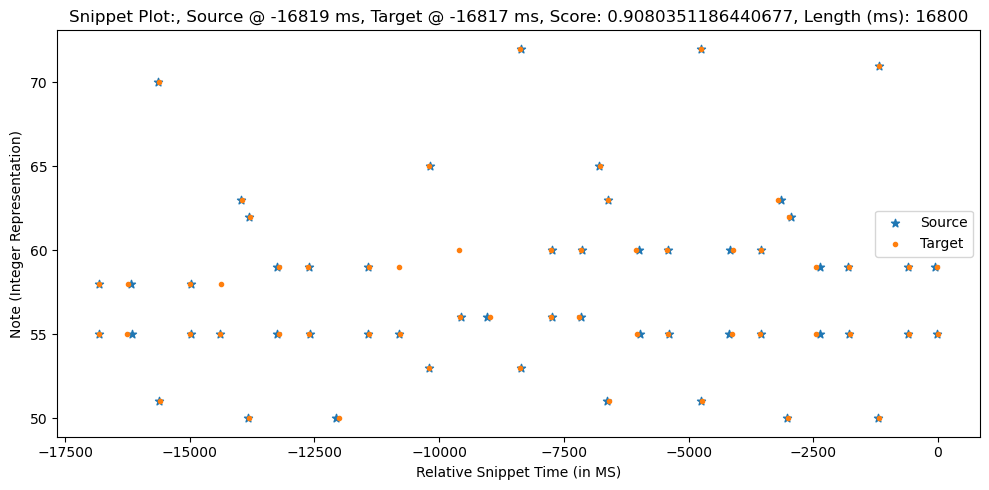

0.908064988220339
Scores: [ 0.985   0.99    0.74    0.82    0.95    0.9575  0.9425  0.9725  0.97
 -0.      0.92    0.9375  0.9575  0.905   0.895   0.9775  0.9425  0.865
  0.955   0.94   -0.      0.9175  0.9825  0.98   -0.      0.9425  0.815
  0.9475  0.9425  0.9225  0.965   0.9275  0.955   0.9225  1.      0.9075
  0.845   0.865   0.93    0.93    0.9975  0.98    0.81    0.85    0.96
  0.995   0.8525  0.94    0.905   0.8125  0.8025  0.9225  0.945   0.9675
  0.9725  0.9875  0.965   0.895   0.9525  0.9675  0.935   0.92    0.965
  0.875   0.9625]
Sequence1:  [[-18613     58     36]
 [-18611     55     44]
 [-18055     55     49]
 [-18041     58     44]
 [-17404     70     58]
 [-17393     51     46]
 [-16794     55     45]
 [-16791     58     32]
 [-16187     55     48]
 [-16175     58     39]
 [-15741     63     52]
 [-15605     50     42]
 [-15593     62     56]
 [-15011     59     46]
 [-15009     55     46]
 [-14416     59     42]
 [-14410     55     48]
 [-13801     50     46]
 [-13200

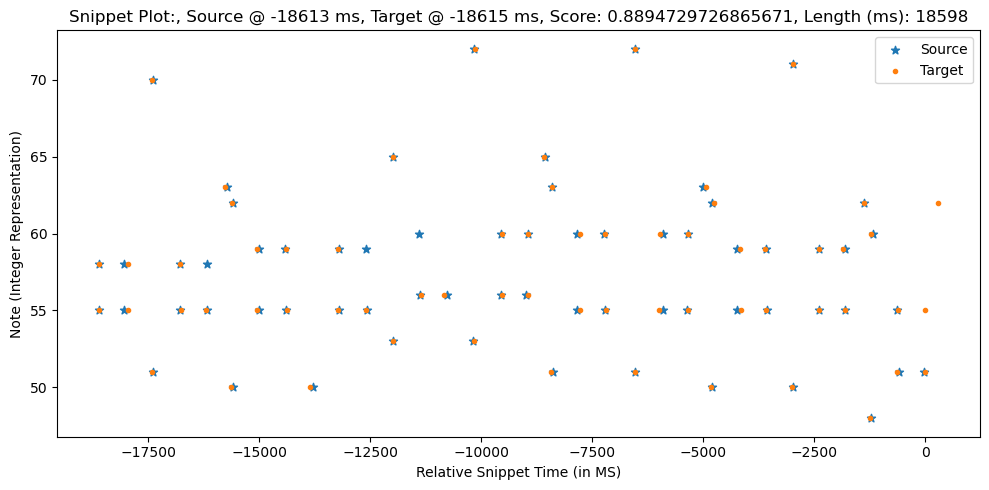

Scores: [-0.     -0.     -0.     -0.     -0.     -0.      0.93    0.9125  0.8725
 -0.     -0.     -0.      0.845  -0.     -0.      0.9875  0.8625  0.955
  0.97    0.99   -0.     -0.     -0.     -0.      0.93   -0.      0.8425
  0.895   0.9675 -0.     -0.     -0.     -0.      0.9025 -0.      0.875
 -0.     -0.      0.8975  0.9125  0.8175  0.8475  0.8    -0.     -0.
 -0.     -0.      0.8875 -0.      0.9275  0.97   -0.      0.9075  0.8925
  0.8025  0.8625 -0.     -0.     -0.     -0.      0.9175 -0.      0.9975
  0.6425]
Sequence1:  [[-19050     55     49]
 [-19042     58     34]
 [-18404     58     26]
 [-18386     55     35]
 [-17859     70     53]
 [-17845     51     51]
 [-17215     58     33]
 [-17206     55     42]
 [-16634     55     48]
 [-16208     63     49]
 [-16065     50     44]
 [-16045     62     54]
 [-15486     55     44]
 [-15484     59     42]
 [-14842     59     41]
 [-14822     55     45]
 [-14290     50     51]
 [-13657     55     44]
 [-13653     59     40]
 [-13044 

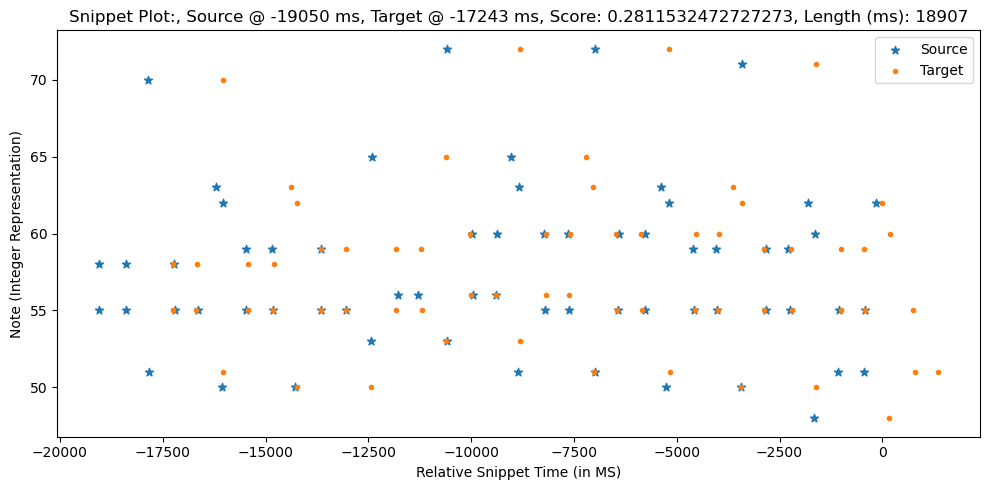

0.8894729726865671
Scores: [ 0.98    0.995   0.735   0.815   0.955   0.9625  0.9375  0.9675  0.975
 -0.      0.925   0.9425  0.9625  0.91    0.9     0.9725  0.9375  0.87
  0.96    0.945  -0.      0.9225  0.9875  0.975  -0.      0.9375  0.82
  0.9425  0.9375  0.9175  0.96    0.9225  0.95    0.9275  0.995   0.9125
  0.84    0.86    0.925   0.925   0.9925  0.985   0.815   0.855   0.955
  1.      0.8475  0.945   0.9     0.8075  0.7975  0.9275  0.95    0.9725
  0.9775  0.9925  0.97    0.9     0.9575  0.9725  0.94    0.925   0.96
  0.88    0.9575  0.8325  0.9325  0.975   0.9425  0.965   0.97    0.9675
  0.9725]
Sequence1:  [[-20393     58     36]
 [-20391     55     44]
 [-19835     55     49]
 [-19821     58     44]
 [-19184     70     58]
 [-19173     51     46]
 [-18574     55     45]
 [-18571     58     32]
 [-17967     55     48]
 [-17955     58     39]
 [-17521     63     52]
 [-17385     50     42]
 [-17373     62     56]
 [-16791     59     46]
 [-16789     55     46]
 [-16196     59

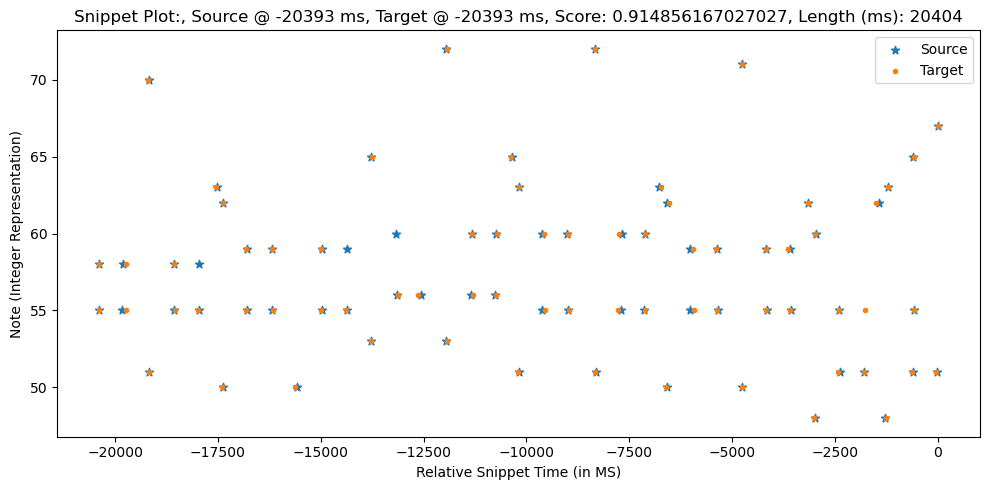

Scores: [ 0.995   0.98    0.815   0.735   0.955   0.9625  0.9675  0.9375  0.975
  0.925   0.9425  0.9625  0.9     0.91    0.9725  0.9375  0.87    0.945
  0.96    0.9225  0.9875  0.975   0.9375  0.82    0.9425  0.9375  0.96
  0.9175  0.9225  0.95    0.9275  0.9125  0.995   0.84    0.86    0.925
  0.925   0.9925  0.985   0.815   0.855   0.955   1.      0.8475  0.945
  0.9     0.8075  0.7975  0.9275  0.95    0.9725  0.9775  0.97    0.9925
  0.9     0.9575  0.9725  0.94    0.925   0.88    0.96    0.9575 -0.
  0.8325  0.9325  0.975   0.965   0.9425  0.97    0.9675  0.9725]
Sequence1:  [[-20404     55     49]
 [-20396     58     34]
 [-19758     58     26]
 [-19740     55     35]
 [-19213     70     53]
 [-19199     51     51]
 [-18569     58     33]
 [-18560     55     42]
 [-17988     55     48]
 [-17562     63     49]
 [-17419     50     44]
 [-17399     62     54]
 [-16840     55     44]
 [-16838     59     42]
 [-16196     59     41]
 [-16176     55     45]
 [-15644     50     51]
 [-15

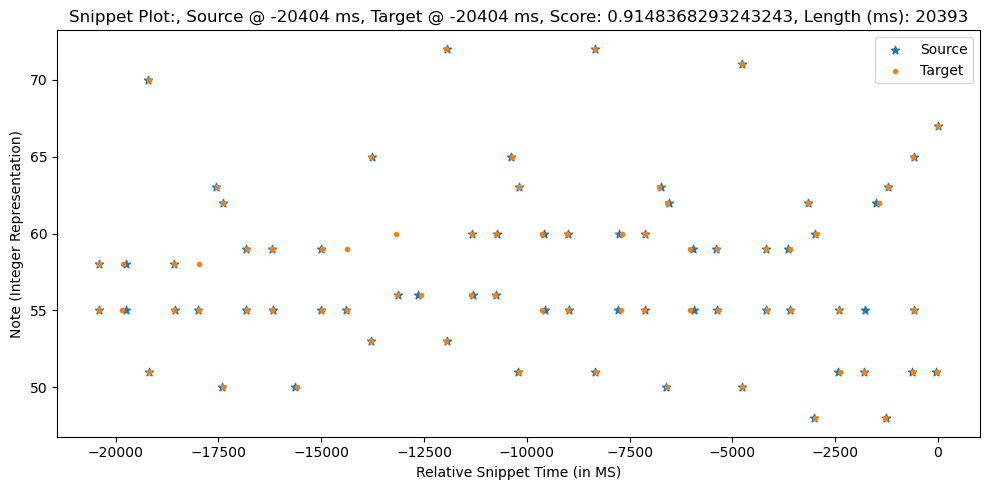

0.914856167027027
Scores: [ 0.9775  0.9975  0.7325  0.8125  0.9575  0.965   0.935   0.965   0.9775
 -0.      0.9275  0.945   0.965   0.9125  0.9025  0.97    0.935   0.8725
  0.9625  0.9475 -0.      0.925   0.99    0.9725 -0.      0.935   0.8225
  0.94    0.935   0.915   0.9575  0.92    0.9475  0.93    0.9925  0.915
  0.8375  0.8575  0.9225  0.9225  0.99    0.9875  0.8175  0.8575  0.9525
  0.9975  0.845   0.9475  0.8975  0.805   0.795   0.93    0.9525  0.975
  0.98    0.995   0.9725  0.9025  0.96    0.975   0.9425  0.9275  0.9575
  0.8825  0.955   0.835   0.93    0.9725  0.94    0.9675  0.9675  0.97
  0.975   0.9975  0.9825  0.88    0.825   0.855   0.9775  0.975 ]
Sequence1:  [[-22843     58     36]
 [-22841     55     44]
 [-22285     55     49]
 [-22271     58     44]
 [-21634     70     58]
 [-21623     51     46]
 [-21024     55     45]
 [-21021     58     32]
 [-20417     55     48]
 [-20405     58     39]
 [-19971     63     52]
 [-19835     50     42]
 [-19823     62     56]
 [-1

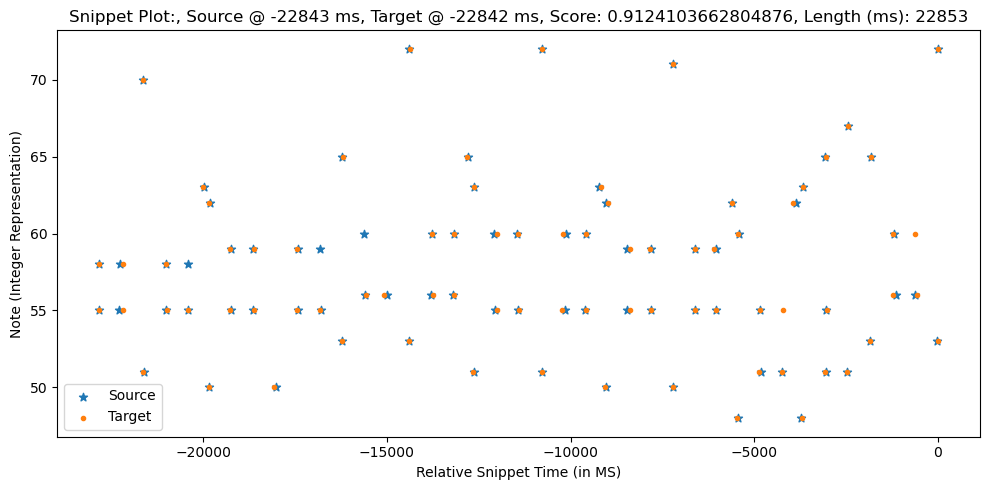

Scores: [ 0.995   0.98    0.815   0.735   0.955   0.9625  0.9675  0.9375  0.975
  0.925   0.9425  0.9625  0.9     0.91    0.9725  0.9375  0.87    0.945
  0.96    0.9225  0.9875  0.975   0.9375  0.82    0.9425  0.9375  0.96
  0.9175  0.9225  0.95    0.9275  0.9125  0.995   0.84    0.86    0.925
  0.925   0.9925  0.985   0.815   0.855   0.955   1.      0.8475  0.945
  0.9     0.8075  0.7975  0.9275  0.95    0.9725  0.9775  0.97    0.9925
  0.9     0.9575  0.9725  0.94    0.925   0.88    0.96    0.9575 -0.
  0.8325  0.9325  0.975   0.965   0.9425  0.97    0.9675  0.9725  0.995
  0.985   0.8775  0.8225 -0.      0.8575  0.9725  0.98  ]
Sequence1:  [[-22836     55     49]
 [-22828     58     34]
 [-22190     58     26]
 [-22172     55     35]
 [-21645     70     53]
 [-21631     51     51]
 [-21001     58     33]
 [-20992     55     42]
 [-20420     55     48]
 [-19994     63     49]
 [-19851     50     44]
 [-19831     62     54]
 [-19272     55     44]
 [-19270     59     42]
 [-18628     

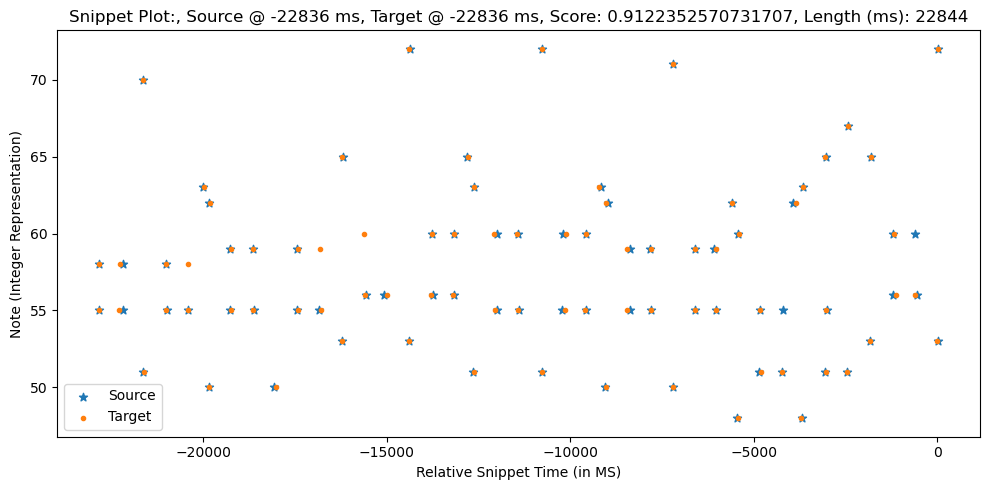

0.9124103662804876
Scores: [ 0.9775  0.9975  0.7325  0.8125  0.9575  0.965   0.935   0.965   0.9775
 -0.      0.9275  0.945   0.965   0.9125  0.9025  0.97    0.935   0.8725
  0.9625  0.9475 -0.      0.925   0.99    0.9725 -0.      0.935   0.8225
  0.94    0.935   0.915   0.9575  0.92    0.9475  0.93    0.9925  0.915
  0.8375  0.8575  0.9225  0.9225  0.99    0.9875  0.8175  0.8575  0.9525
  0.9975  0.845   0.9475  0.8975  0.805   0.795   0.93    0.9525  0.975
  0.98    0.995   0.9725  0.9025  0.96    0.975   0.9425  0.9275  0.9575
  0.8825  0.955   0.835   0.93    0.9725  0.94    0.9675  0.9675  0.97
  0.975   0.9975  0.9825  0.88    0.825   0.855   0.9775  0.975   0.9925
  0.9275  0.8375  0.995   0.9725  0.965   0.9725]
Sequence1:  [[-24617     58     36]
 [-24615     55     44]
 [-24059     55     49]
 [-24045     58     44]
 [-23408     70     58]
 [-23397     51     46]
 [-22798     55     45]
 [-22795     58     32]
 [-22191     55     48]
 [-22179     58     39]
 [-21745     63   

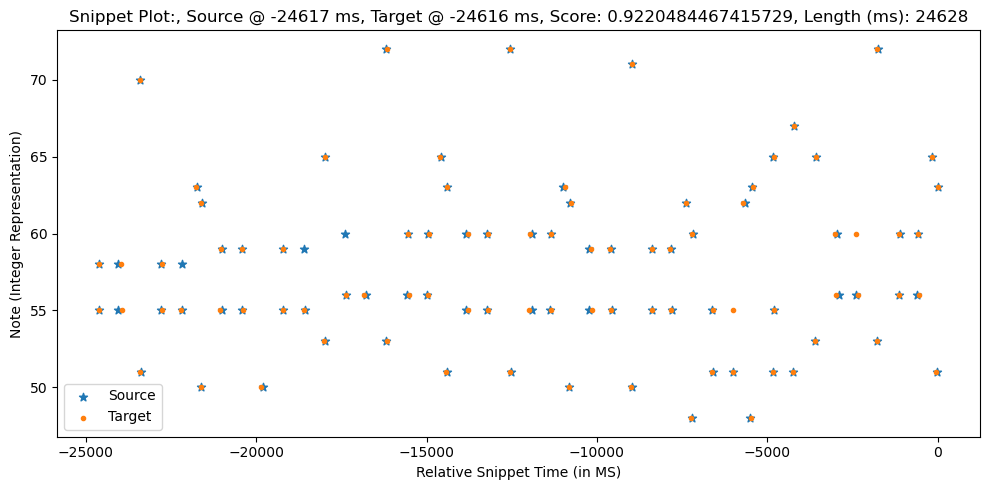

Scores: [ 0.9975  0.9775  0.8125  0.7325  0.9575  0.965   0.965   0.935   0.9775
  0.9275  0.945   0.965   0.9025  0.9125  0.97    0.935   0.8725  0.9475
  0.9625  0.925   0.99    0.9725  0.935   0.8225  0.94    0.935   0.9575
  0.915   0.92    0.9475  0.93    0.915   0.9925  0.8375  0.8575  0.9225
  0.9225  0.99    0.9875  0.8175  0.8575  0.9525  0.9975  0.845   0.9475
  0.8975  0.805   0.795   0.93    0.9525  0.975   0.98    0.9725  0.995
  0.9025  0.96    0.975   0.9425  0.9275  0.8825  0.9575  0.955  -0.
  0.835   0.93    0.9725  0.9675  0.94    0.9675  0.97    0.975   0.9975
  0.9825  0.88    0.825  -0.      0.855   0.975   0.9775  0.9925  0.9275
  0.995   0.8375  0.9725  0.965   0.9725]
Sequence1:  [[-24627     55     49]
 [-24619     58     34]
 [-23981     58     26]
 [-23963     55     35]
 [-23436     70     53]
 [-23422     51     51]
 [-22792     58     33]
 [-22783     55     42]
 [-22211     55     48]
 [-21785     63     49]
 [-21642     50     44]
 [-21622     62     54

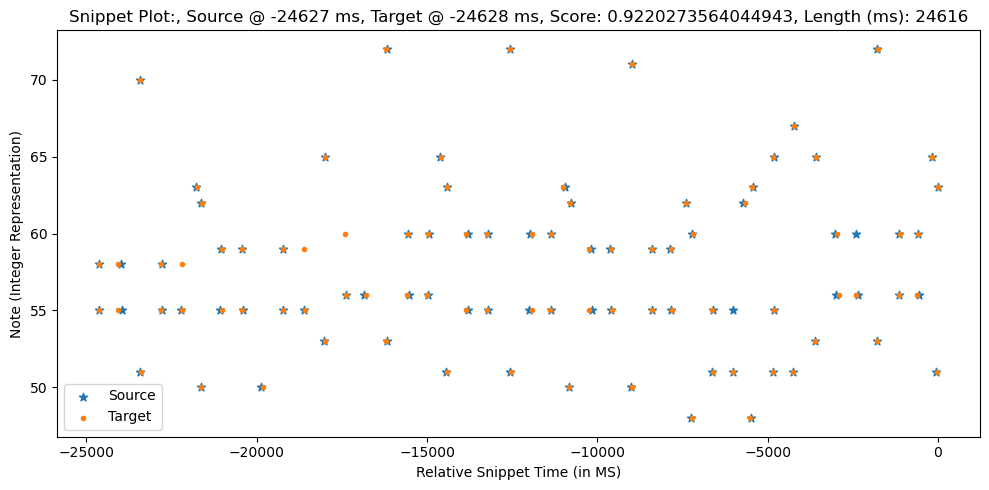

0.9220484467415729
Scores: [ 0.9775  0.9975  0.7325  0.8125  0.9575  0.965   0.935   0.965   0.9775
 -0.      0.9275  0.945   0.965   0.9125  0.9025  0.97    0.935   0.8725
  0.9625  0.9475 -0.      0.925   0.99    0.9725 -0.      0.935   0.8225
  0.94    0.935   0.915   0.9575  0.92    0.9475  0.93    0.9925  0.915
  0.8375  0.8575  0.9225  0.9225  0.99    0.9875  0.8175  0.8575  0.9525
  0.9975  0.845   0.9475  0.8975  0.805   0.795   0.93    0.9525  0.975
  0.98    0.995   0.9725  0.9025  0.96    0.975   0.9425  0.9275  0.9575
  0.8825  0.955   0.835   0.93    0.9725  0.94    0.9675  0.9675  0.97
  0.975   0.9975  0.9825  0.88    0.825   0.855   0.9775  0.975   0.9925
  0.9275  0.8375  0.995   0.9725  0.965   0.9725  0.99    0.9075  0.9725
  0.835   0.9875  1.    ]
Sequence1:  [[-26429     58     36]
 [-26427     55     44]
 [-25871     55     49]
 [-25857     58     44]
 [-25220     70     58]
 [-25209     51     46]
 [-24610     55     45]
 [-24607     58     32]
 [-24003     55  

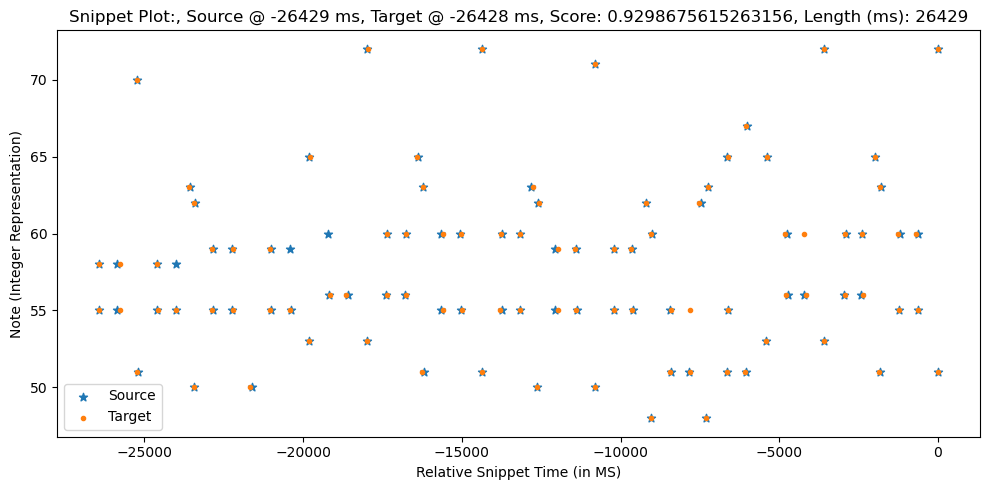

Scores: [ 0.9975  0.9775  0.8125  0.7325  0.9575  0.965   0.965   0.935   0.9775
  0.9275  0.945   0.965   0.9025  0.9125  0.97    0.935   0.8725  0.9475
  0.9625  0.925   0.99    0.9725  0.935   0.8225  0.94    0.935   0.9575
  0.915   0.92    0.9475  0.93    0.915   0.9925  0.8375  0.8575  0.9225
  0.9225  0.99    0.9875  0.8175  0.8575  0.9525  0.9975  0.845   0.9475
  0.8975  0.805   0.795   0.93    0.9525  0.975   0.98    0.9725  0.995
  0.9025  0.96    0.975   0.9425  0.9275  0.8825  0.9575  0.955  -0.
  0.835   0.93    0.9725  0.9675  0.94    0.9675  0.97    0.975   0.9975
  0.9825  0.88    0.825  -0.      0.855   0.975   0.9775  0.9925  0.9275
  0.995   0.8375  0.9725  0.965   0.9725  0.9075  0.99    0.835   0.9725
  1.      0.9875]
Sequence1:  [[-26426     55     49]
 [-26418     58     34]
 [-25780     58     26]
 [-25762     55     35]
 [-25235     70     53]
 [-25221     51     51]
 [-24591     58     33]
 [-24582     55     42]
 [-24010     55     48]
 [-23584     63     4

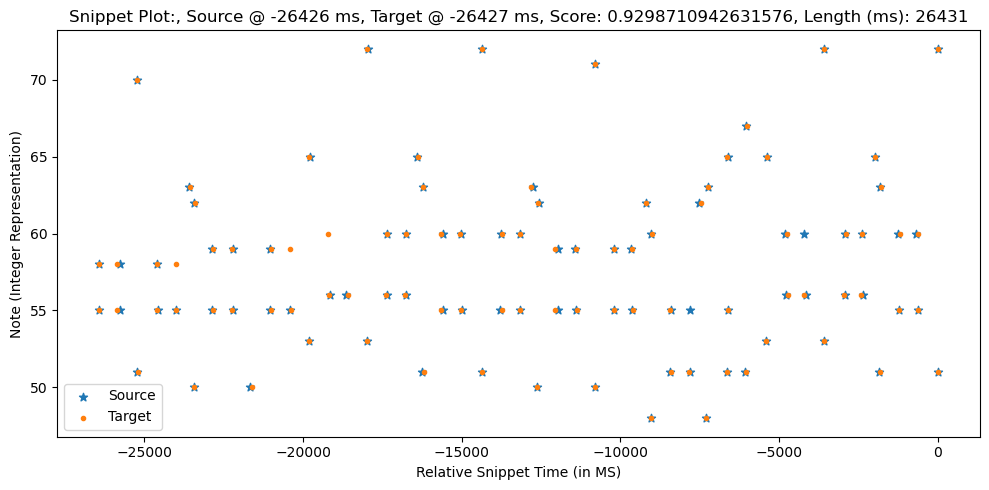

0.9298710942631576
Scores: [ 0.97    0.995   0.725   0.805   0.965   0.9725  0.9275  0.9575  0.985
 -0.      0.935   0.9525  0.9725  0.92    0.91    0.9625  0.9275  0.88
  0.97    0.955  -0.      0.9325  0.9975  0.965  -0.      0.9275  0.83
  0.9325  0.9275  0.9075  0.95    0.9125  0.94    0.9375  0.985   0.9225
  0.83    0.85    0.915   0.915   0.9825  0.995   0.825   0.865   0.945
  0.99    0.8375  0.955   0.89    0.7975  0.7875  0.9375  0.96    0.9825
  0.9875  0.9975  0.98    0.91    0.9675  0.9825  0.95    0.935   0.95
  0.89    0.9475  0.8425  0.9225  0.965   0.9325  0.975   0.96    0.9775
  0.9825  0.995   0.975   0.8875  0.8325  0.8475  0.97    0.9825  0.985
  0.935   0.83    0.9975  0.98    0.9725  0.98    0.9825  0.915   0.98
  0.8425  0.98    0.9925  0.935   0.94   -0.      0.8925  0.8925  0.7625
  0.905   0.9975  0.97  ]
Sequence1:  [[-28833     58     36]
 [-28831     55     44]
 [-28275     55     49]
 [-28261     58     44]
 [-27624     70     58]
 [-27613     51     46]

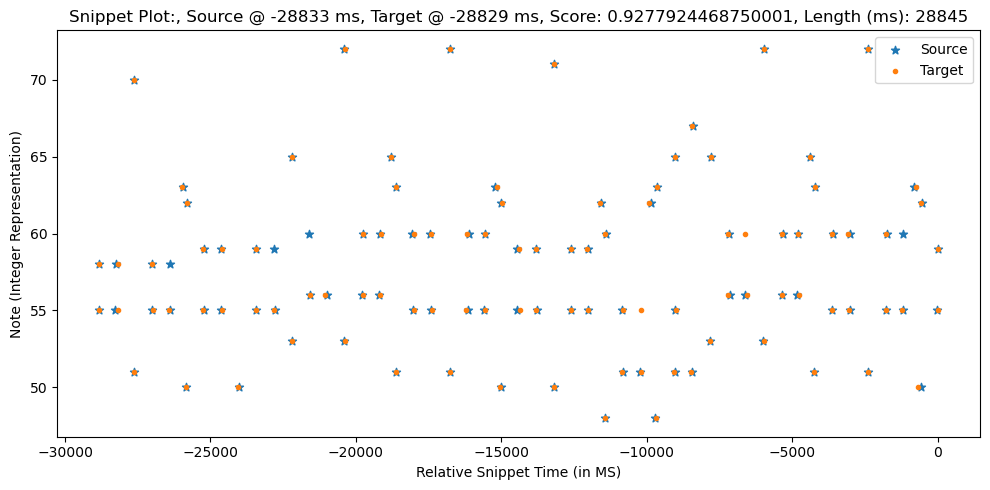

Scores: [ 0.995   0.97    0.805   0.725   0.965   0.9725  0.9575  0.9275  0.985
  0.935   0.9525  0.9725  0.91    0.92    0.9625  0.9275  0.88    0.955
  0.97    0.9325  0.9975  0.965   0.9275  0.83    0.9325  0.9275  0.95
  0.9075  0.9125  0.94    0.9375  0.9225  0.985   0.83    0.85    0.915
  0.915   0.9825  0.995   0.825   0.865   0.945   0.99    0.8375  0.955
  0.89    0.7975  0.7875  0.9375  0.96    0.9825  0.9875  0.98    0.9975
  0.91    0.9675  0.9825  0.95    0.935   0.89    0.95    0.9475 -0.
  0.8425  0.9225  0.965   0.975   0.9325  0.96    0.9775  0.9825  0.995
  0.975   0.8875  0.8325 -0.      0.8475  0.9825  0.97    0.985   0.935
  0.9975  0.83    0.98    0.9725  0.98    0.915   0.9825  0.8425  0.98
  0.9925  0.98    0.935   0.94    0.8925  0.8925  0.7625  0.905   0.9975
  0.97  ]
Sequence1:  [[-28841     55     49]
 [-28833     58     34]
 [-28195     58     26]
 [-28177     55     35]
 [-27650     70     53]
 [-27636     51     51]
 [-27006     58     33]
 [-26997     

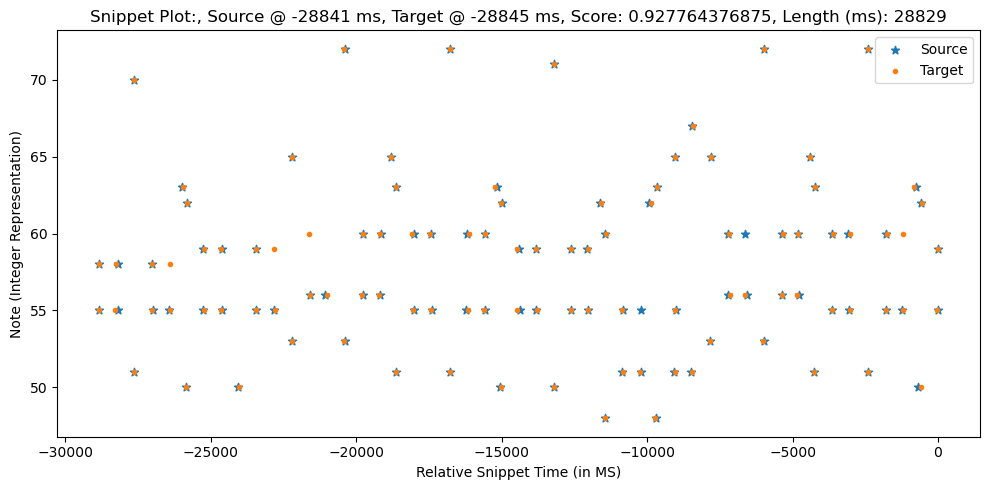

0.9277924468750001
Scores: [ 0.965   0.99    0.72    0.8     0.97    0.9775  0.9225  0.9525  0.99
 -0.      0.94    0.9575  0.9775  0.925   0.915   0.9575  0.9225  0.885
  0.975   0.96   -0.      0.9375  0.9975  0.96   -0.      0.9225  0.835
  0.9275  0.9225  0.9025  0.945   0.9075  0.935   0.9425  0.98    0.9275
  0.825   0.845   0.91    0.91    0.9775  1.      0.83    0.87    0.94
  0.985   0.8325  0.96    0.885   0.7925  0.7825  0.9425  0.965   0.9875
  0.9925  0.9925  0.985   0.915   0.9725  0.9875  0.955   0.94    0.945
  0.895   0.9425  0.8475  0.9175  0.96    0.9275  0.98    0.955   0.9825
  0.9875  0.99    0.97    0.8925  0.8375  0.8425  0.965   0.9875  0.98
  0.94    0.825   0.9925  0.985   0.9775  0.985   0.9775  0.92    0.985
  0.8475  0.975   0.9875  0.94    0.945  -0.      0.8975  0.8875  0.7675
  0.91    0.9925  0.975   0.9825  0.935   0.9575  0.905   0.8975  0.8725]
Sequence1:  [[-30606     58     36]
 [-30604     55     44]
 [-30048     55     49]
 [-30034     58     44

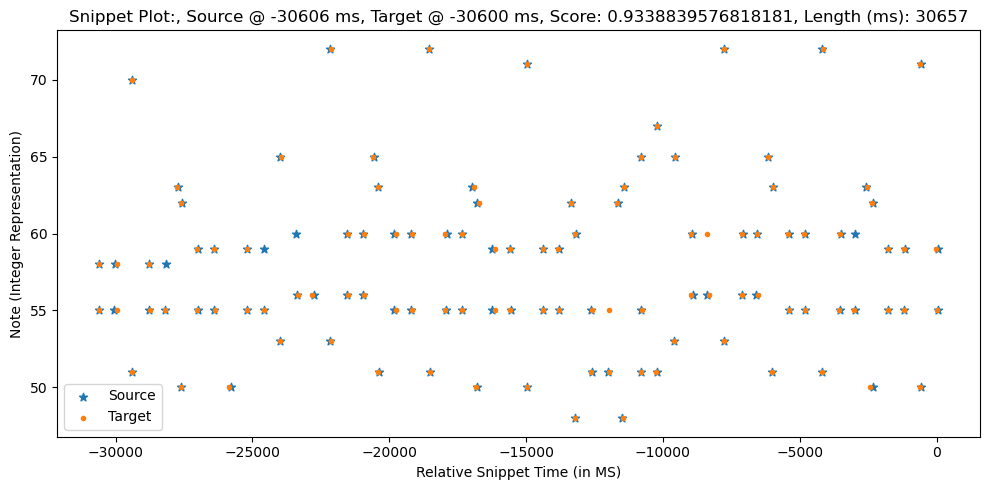

Scores: [ 0.99    0.965   0.8     0.72    0.97    0.9775  0.9525  0.9225  0.99
  0.94    0.9575  0.9775  0.915   0.925   0.9575  0.9225  0.885   0.96
  0.975   0.9375  0.9975  0.96    0.9225  0.835   0.9275  0.9225  0.945
  0.9025  0.9075  0.935   0.9425  0.9275  0.98    0.825   0.845   0.91
  0.91    0.9775  1.      0.83    0.87    0.94    0.985   0.8325  0.96
  0.885   0.7925  0.7825  0.9425  0.965   0.9875  0.9925  0.985   0.9925
  0.915   0.9725  0.9875  0.955   0.94    0.895   0.945   0.9425 -0.
  0.8475  0.9175  0.96    0.98    0.9275  0.955   0.9825  0.9875  0.99
  0.97    0.8925  0.8375 -0.      0.8425  0.9875  0.965   0.98    0.94
  0.9925  0.825   0.985   0.9775  0.985   0.92    0.9775  0.8475  0.985
  0.9875  0.975   0.94    0.945   0.8975  0.8875  0.7675  0.91    0.9925
  0.975   0.935   0.9825  0.9575  0.905   0.8975  0.8725]
Sequence1:  [[-30651     55     49]
 [-30643     58     34]
 [-30005     58     26]
 [-29987     55     35]
 [-29460     70     53]
 [-29446     51  

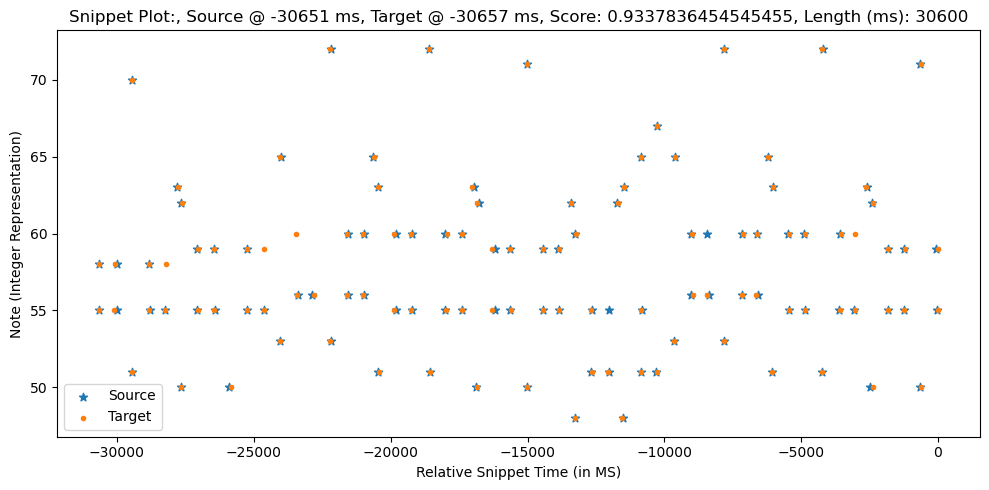

0.9338839576818181
Scores: [ 0.96    0.985   0.715   0.795   0.975   0.9825  0.9175  0.9475  0.995
 -0.      0.945   0.9625  0.9825  0.93    0.92    0.9525  0.9175  0.89
  0.98    0.965  -0.      0.9425  0.9925  0.955  -0.      0.9175  0.84
  0.9225  0.9175  0.8975  0.94    0.9025  0.93    0.9475  0.975   0.9325
  0.82    0.84    0.905   0.905   0.9725  0.995   0.835   0.875   0.935
  0.98    0.8275  0.965   0.88    0.7875  0.7775  0.9475  0.97    0.9925
  0.9975  0.9875  0.99    0.92    0.9775  0.9925  0.96    0.945   0.94
  0.9     0.9375  0.8525  0.9125  0.955   0.9225  0.985   0.95    0.9875
  0.9925  0.985   0.965   0.8975  0.8425  0.8375  0.96    0.9925  0.975
  0.945   0.82    0.9875  0.99    0.9825  0.99    0.9725  0.925   0.99
  0.8525  0.97    0.9825  0.945   0.95   -0.      0.9025  0.8825  0.7725
  0.915   0.9875  0.98    0.9875  0.94    0.9625  0.91    0.9025  0.8775
  0.8925  0.8925  0.86    0.7925  0.9025  0.9725  0.99  ]
Sequence1:  [[-32444     58     36]
 [-32442     5

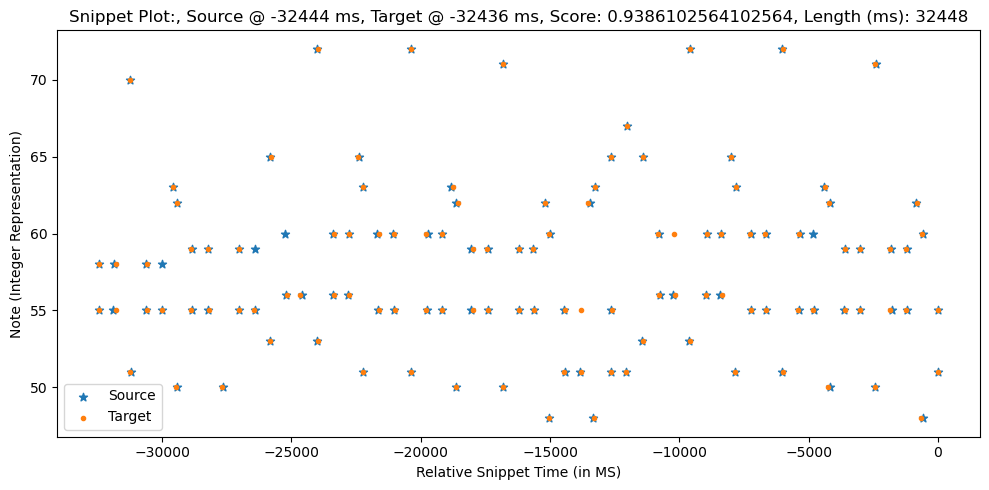

Scores: [ 0.985   0.96    0.795   0.715   0.975   0.9825  0.9475  0.9175  0.995
  0.945   0.9625  0.9825  0.92    0.93    0.9525  0.9175  0.89    0.965
  0.98    0.9425  0.9925  0.955   0.9175  0.84    0.9225  0.9175  0.94
  0.8975  0.9025  0.93    0.9475  0.9325  0.975   0.82    0.84    0.905
  0.905   0.9725  0.995   0.835   0.875   0.935   0.98    0.8275  0.965
  0.88    0.7875  0.7775  0.9475  0.97    0.9925  0.9975  0.99    0.9875
  0.92    0.9775  0.9925  0.96    0.945   0.9     0.94    0.9375 -0.
  0.8525  0.9125  0.955   0.985   0.9225  0.95    0.9875  0.9925  0.985
  0.965   0.8975  0.8425 -0.      0.8375  0.9925  0.96    0.975   0.945
  0.9875  0.82    0.99    0.9825  0.99    0.925   0.9725  0.8525  0.99
  0.9825  0.97    0.945   0.95    0.9025  0.8825  0.7725  0.915   0.9875
  0.98    0.94    0.9875  0.9625  0.91    0.9025  0.8775  0.8925  0.8925
  0.86    0.7925  0.9025  0.9725  0.99  ]
Sequence1:  [[-32440     55     49]
 [-32432     58     34]
 [-31794     58     26]
 [-3

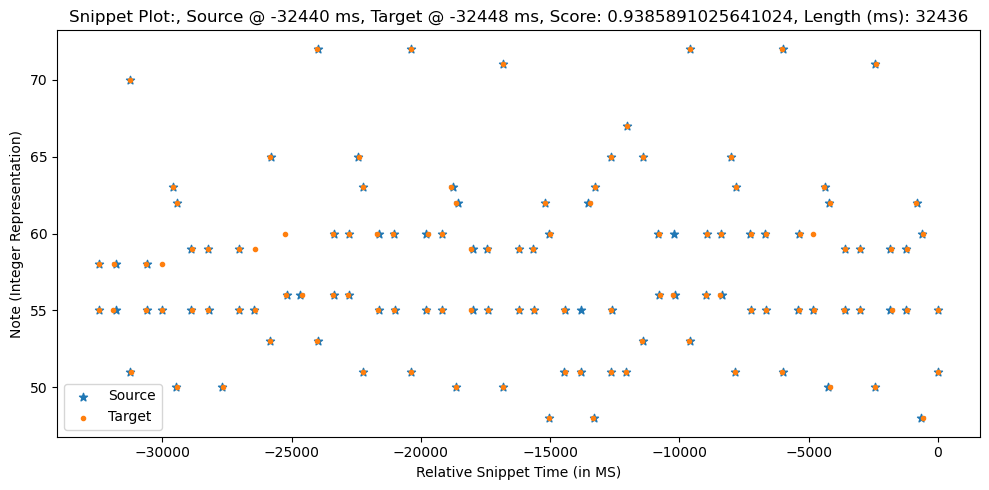

0.9386102564102564
Scores: [ 0.96    0.985   0.715   0.795   0.975   0.9825  0.9175  0.9475  0.995
 -0.      0.945   0.9625  0.9825  0.93    0.92    0.9525  0.9175  0.89
  0.98    0.965  -0.      0.9425  0.9925  0.955  -0.      0.9175  0.84
  0.9225  0.9175  0.8975  0.94    0.9025  0.93    0.9475  0.975   0.9325
  0.82    0.84    0.905   0.905   0.9725  0.995   0.835   0.875   0.935
  0.98    0.8275  0.965   0.88    0.7875  0.7775  0.9475  0.97    0.9925
  0.9975  0.9875  0.99    0.92    0.9775  0.9925  0.96    0.945   0.94
  0.9     0.9375  0.8525  0.9125  0.955   0.9225  0.985   0.95    0.9875
  0.9925  0.985   0.965   0.8975  0.8425  0.8375  0.96    0.9925  0.975
  0.945   0.82    0.9875  0.99    0.9825  0.99    0.9725  0.925   0.99
  0.8525  0.97    0.9825  0.945   0.95   -0.      0.9025  0.8825  0.7725
  0.915   0.9875  0.98    0.9875  0.94    0.9625  0.91    0.9025  0.8775
  0.8925  0.8925  0.86    0.7925  0.9025  0.9725  0.99    0.93    0.9725
  0.905   0.8425  0.88    0.88  ]
S

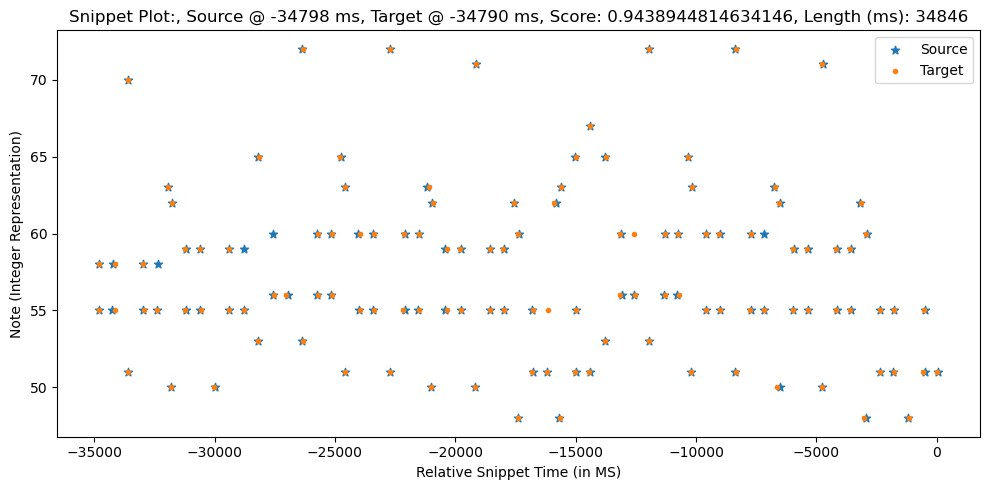

Scores: [ 0.985   0.96    0.795   0.715   0.975   0.9825  0.9475  0.9175  0.995
  0.945   0.9625  0.9825  0.92    0.93    0.9525  0.9175  0.89    0.965
  0.98    0.9425  0.9925  0.955   0.9175  0.84    0.9225  0.9175  0.94
  0.8975  0.9025  0.93    0.9475  0.9325  0.975   0.82    0.84    0.905
  0.905   0.9725  0.995   0.835   0.875   0.935   0.98    0.8275  0.965
  0.88    0.7875  0.7775  0.9475  0.97    0.9925  0.9975  0.99    0.9875
  0.92    0.9775  0.9925  0.96    0.945   0.9     0.94    0.9375 -0.
  0.8525  0.9125  0.955   0.985   0.9225  0.95    0.9875  0.9925  0.985
  0.965   0.8975  0.8425 -0.      0.8375  0.9925  0.96    0.975   0.945
  0.9875  0.82    0.99    0.9825  0.99    0.925   0.9725  0.8525  0.99
  0.9825  0.97    0.945   0.95    0.9025  0.8825  0.7725  0.915   0.9875
  0.98    0.94    0.9875  0.9625  0.91    0.9025  0.8775  0.8925  0.8925
  0.86    0.7925  0.9025  0.9725  0.99    0.93    0.9725  0.905   0.8425
  0.88    0.88  ]
Sequence1:  [[-34838     55     49]
 [-

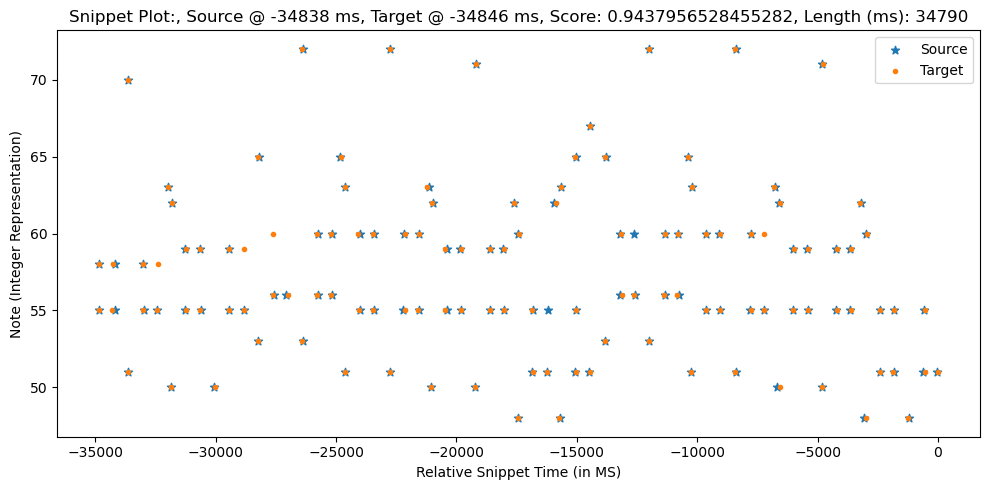

0.9438944814634146
Scores: [ 0.9575  0.9825  0.7125  0.7925  0.9775  0.985   0.915   0.945   0.9975
 -0.      0.9475  0.965   0.985   0.9325  0.9225  0.95    0.915   0.8925
  0.9825  0.9675 -0.      0.945   0.99    0.9525 -0.      0.915   0.8425
  0.92    0.915   0.895   0.9375  0.9     0.9275  0.95    0.9725  0.935
  0.8175  0.8375  0.9025  0.9025  0.97    0.9925  0.8375  0.8775  0.9325
  0.9775  0.825   0.9675  0.8775  0.785   0.775   0.95    0.9725  0.995
  1.      0.985   0.9925  0.9225  0.98    0.995   0.9625  0.9475  0.9375
  0.9025  0.935   0.855   0.91    0.9525  0.92    0.9875  0.9475  0.99
  0.995   0.9825  0.9625  0.9     0.845   0.835   0.9575  0.995   0.9725
  0.9475  0.8175  0.985   0.9925  0.985   0.9925  0.97    0.9275  0.9925
  0.855   0.9675  0.98    0.9475  0.9525 -0.      0.905   0.88    0.775
  0.9175  0.985   0.9825  0.99    0.9425  0.965   0.9125  0.905   0.88
  0.895   0.895   0.8575  0.795   0.905   0.975   0.9925  0.9275  0.97
  0.9025  0.845   0.8825  0.8825 

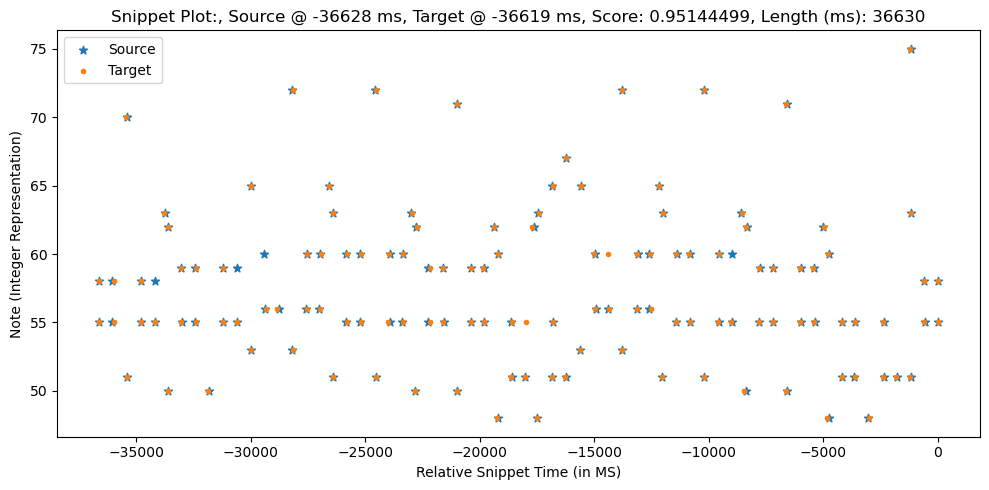

Scores: [ 0.985   0.96    0.795   0.715   0.975   0.9825  0.9475  0.9175  0.995
  0.945   0.9625  0.9825  0.92    0.93    0.9525  0.9175  0.89    0.965
  0.98    0.9425  0.9925  0.955   0.9175  0.84    0.9225  0.9175  0.94
  0.8975  0.9025  0.93    0.9475  0.9325  0.975   0.82    0.84    0.905
  0.905   0.9725  0.995   0.835   0.875   0.935   0.98    0.8275  0.965
  0.88    0.7875  0.7775  0.9475  0.97    0.9925  0.9975  0.99    0.9875
  0.92    0.9775  0.9925  0.96    0.945   0.9     0.94    0.9375 -0.
  0.8525  0.9125  0.955   0.985   0.9225  0.95    0.9875  0.9925  0.985
  0.965   0.8975  0.8425 -0.      0.8375  0.9925  0.96    0.975   0.945
  0.9875  0.82    0.99    0.9825  0.99    0.925   0.9725  0.8525  0.99
  0.9825  0.97    0.945   0.95    0.9025  0.8825  0.7725  0.915   0.9875
  0.98    0.94    0.9875  0.9625  0.91    0.9025  0.8775  0.8925  0.8925
  0.86    0.7925  0.9025  0.9725  0.99    0.93    0.9725  0.905   0.8425
  0.88    0.88    0.9225  0.9425  0.9425  0.9325  0.965  

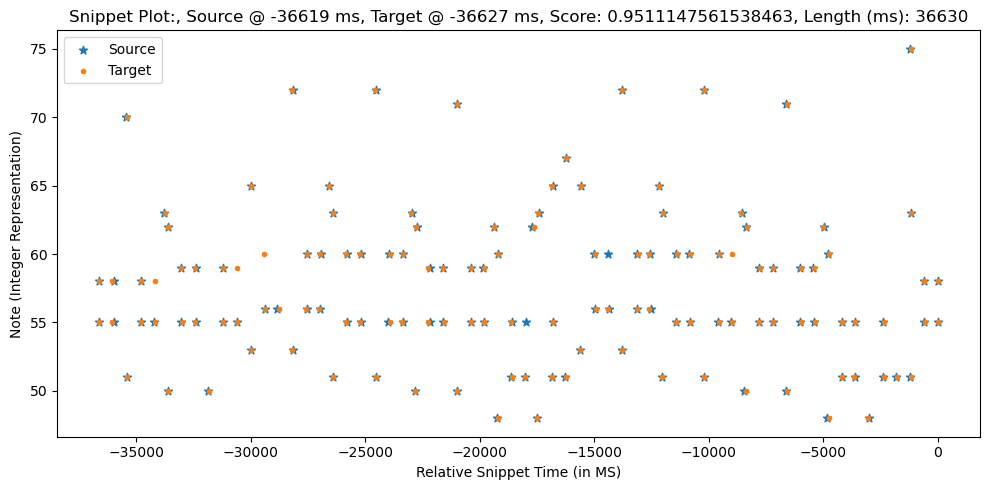

0.95144499
Scores: [ 0.96    0.985   0.715   0.795   0.975   0.9825  0.9175  0.9475  0.995
 -0.      0.945   0.9625  0.9825  0.93    0.92    0.9525  0.9175  0.89
  0.98    0.965  -0.      0.9425  0.9925  0.955  -0.      0.9175  0.84
  0.9225  0.9175  0.8975  0.94    0.9025  0.93    0.9475  0.975   0.9325
  0.82    0.84    0.905   0.905   0.9725  0.995   0.835   0.875   0.935
  0.98    0.8275  0.965   0.88    0.7875  0.7775  0.9475  0.97    0.9925
  0.9975  0.9875  0.99    0.92    0.9775  0.9925  0.96    0.945   0.94
  0.9     0.9375  0.8525  0.9125  0.955   0.9225  0.985   0.95    0.9875
  0.9925  0.985   0.965   0.8975  0.8425  0.8375  0.96    0.9925  0.975
  0.945   0.82    0.9875  0.99    0.9825  0.99    0.9725  0.925   0.99
  0.8525  0.97    0.9825  0.945   0.95   -0.      0.9025  0.8825  0.7725
  0.915   0.9875  0.98    0.9875  0.94    0.9625  0.91    0.9025  0.8775
  0.8925  0.8925  0.86    0.7925  0.9025  0.9725  0.99    0.93    0.9725
  0.905   0.8425  0.88    0.88    0.9225  0

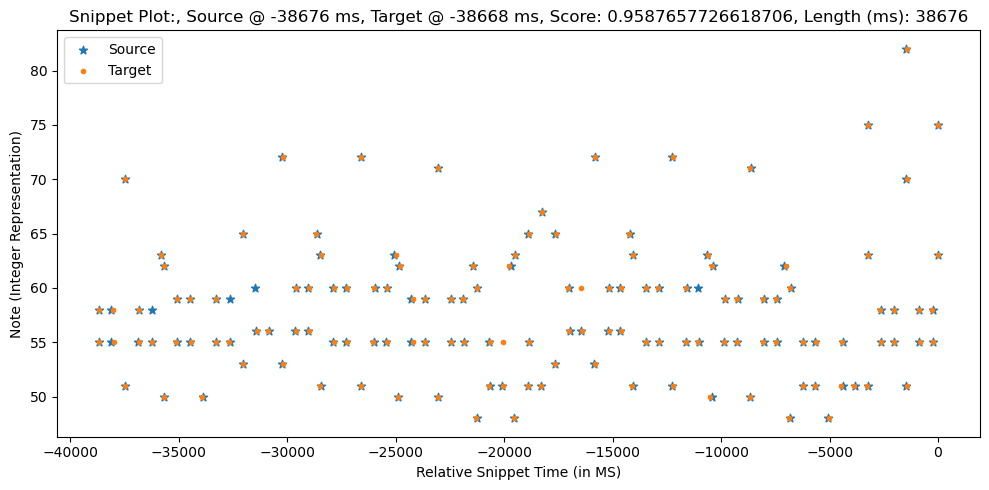

Scores: [ 0.985   0.96    0.795   0.715   0.975   0.9825  0.9475  0.9175  0.995
  0.945   0.9625  0.9825  0.92    0.93    0.9525  0.9175  0.89    0.965
  0.98    0.9425  0.9925  0.955   0.9175  0.84    0.9225  0.9175  0.94
  0.8975  0.9025  0.93    0.9475  0.9325  0.975   0.82    0.84    0.905
  0.905   0.9725  0.995   0.835   0.875   0.935   0.98    0.8275  0.965
  0.88    0.7875  0.7775  0.9475  0.97    0.9925  0.9975  0.99    0.9875
  0.92    0.9775  0.9925  0.96    0.945   0.9     0.94    0.9375 -0.
  0.8525  0.9125  0.955   0.985   0.9225  0.95    0.9875  0.9925  0.985
  0.965   0.8975  0.8425 -0.      0.8375  0.9925  0.96    0.975   0.945
  0.9875  0.82    0.99    0.9825  0.99    0.925   0.9725  0.8525  0.99
  0.9825  0.97    0.945   0.95    0.9025  0.8825  0.7725  0.915   0.9875
  0.98    0.94    0.9875  0.9625  0.91    0.9025  0.8775  0.8925  0.8925
  0.86    0.7925  0.9025  0.9725  0.99    0.93    0.9725  0.905   0.8425
  0.88    0.88    0.9225  0.9425  0.9425  0.9325  0.965  

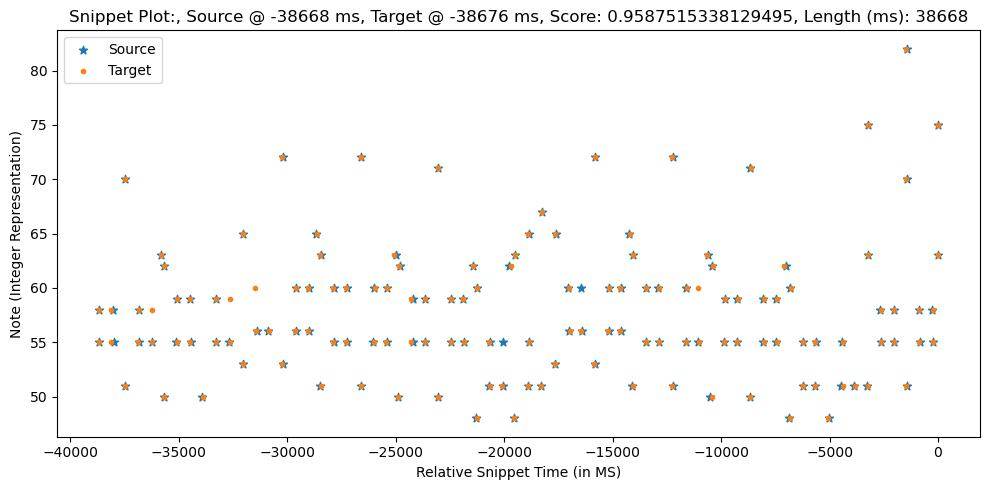

0.9587657726618706
Scores: [ 0.9575  0.9825  0.7125  0.7925  0.9775  0.985   0.915   0.945   0.9975
 -0.      0.9475  0.965   0.985   0.9325  0.9225  0.95    0.915   0.8925
  0.9825  0.9675 -0.      0.945   0.99    0.9525 -0.      0.915   0.8425
  0.92    0.915   0.895   0.9375  0.9     0.9275  0.95    0.9725  0.935
  0.8175  0.8375  0.9025  0.9025  0.97    0.9925  0.8375  0.8775  0.9325
  0.9775  0.825   0.9675  0.8775  0.785   0.775   0.95    0.9725  0.995
  1.      0.985   0.9925  0.9225  0.98    0.995   0.9625  0.9475  0.9375
  0.9025  0.935   0.855   0.91    0.9525  0.92    0.9875  0.9475  0.99
  0.995   0.9825  0.9625  0.9     0.845   0.835   0.9575  0.995   0.9725
  0.9475  0.8175  0.985   0.9925  0.985   0.9925  0.97    0.9275  0.9925
  0.855   0.9675  0.98    0.9475  0.9525 -0.      0.905   0.88    0.775
  0.9175  0.985   0.9825  0.99    0.9425  0.965   0.9125  0.905   0.88
  0.895   0.895   0.8575  0.795   0.905   0.975   0.9925  0.9275  0.97
  0.9025  0.845   0.8825  0.8825 

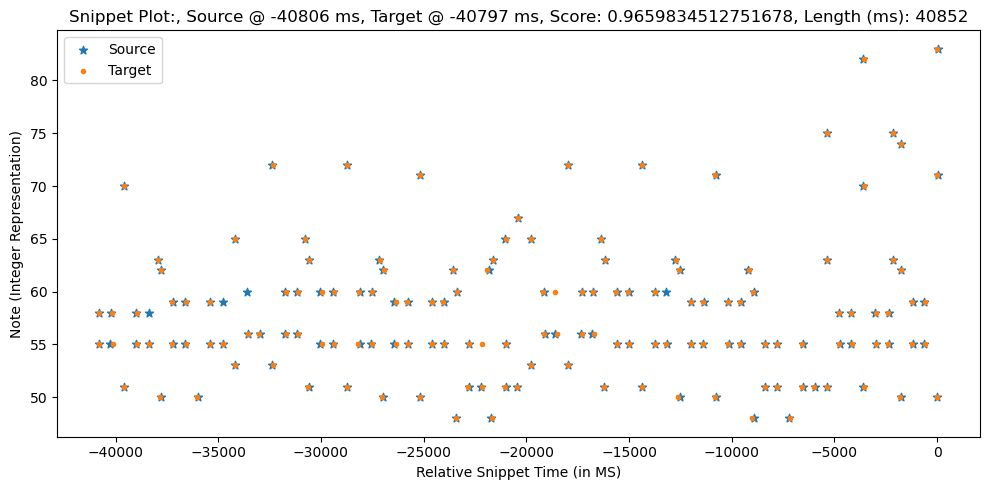

Scores: [ 0.9825  0.9575  0.7925  0.7125  0.9775  0.985   0.945   0.915   0.9975
  0.9475  0.965   0.985   0.9225  0.9325  0.95    0.915   0.8925  0.9675
  0.9825  0.945   0.99    0.9525  0.915   0.8425  0.92    0.915   0.9375
  0.895   0.9     0.9275  0.95    0.935   0.9725  0.8175  0.8375  0.9025
  0.9025  0.97    0.9925  0.8375  0.8775  0.9325  0.9775  0.825   0.9675
  0.8775  0.785   0.775   0.95    0.9725  0.995   1.      0.9925  0.985
  0.9225  0.98    0.995   0.9625  0.9475  0.9025  0.9375  0.935  -0.
  0.855   0.91    0.9525  0.9875  0.92    0.9475  0.99    0.995   0.9825
  0.9625  0.9     0.845  -0.      0.835   0.995   0.9575  0.9725  0.9475
  0.985   0.8175  0.9925  0.985   0.9925  0.9275  0.97    0.855   0.9925
  0.98    0.9675  0.9475  0.9525  0.905   0.88    0.775   0.9175  0.985
  0.9825  0.9425  0.99    0.965   0.9125  0.905   0.88    0.895   0.895
  0.8575  0.795   0.905   0.975   0.9925  0.9275  0.97    0.9025  0.845
  0.8825  0.8825  0.925   0.945   0.945   0.935   0

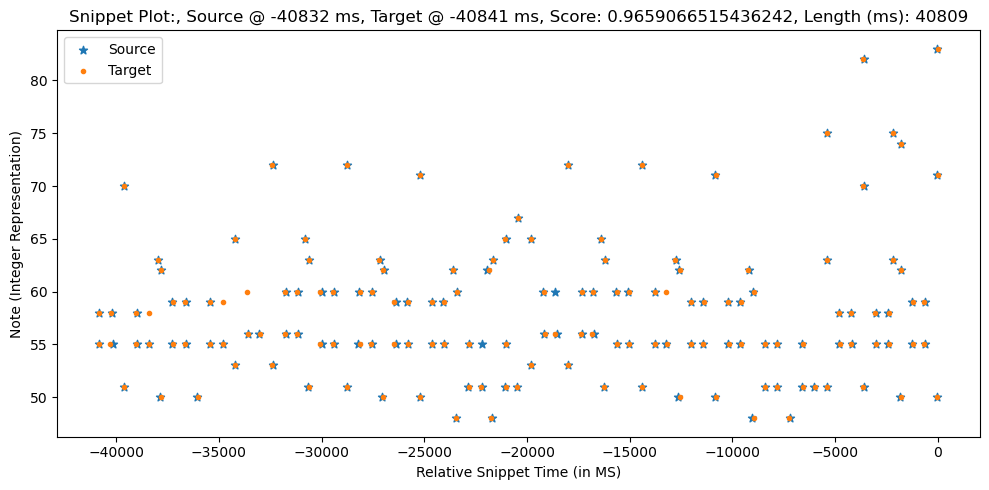

0.9659834512751678
Scores: [ 0.955   0.98    0.71    0.79    0.98    0.9875  0.9125  0.9425  1.
 -0.      0.95    0.9675  0.9875  0.935   0.925   0.9475  0.9125  0.895
  0.985   0.97   -0.      0.9475  0.9875  0.95   -0.      0.9125  0.845
  0.9175  0.9125  0.8925  0.935   0.8975  0.925   0.9525  0.97    0.9375
  0.815   0.835   0.9     0.9     0.9675  0.99    0.84    0.88    0.93
  0.975   0.8225  0.97    0.875   0.7825  0.7725  0.9525  0.975   0.9975
  0.9975  0.9825  0.995   0.925   0.9825  0.9975  0.965   0.95    0.935
  0.905   0.9325  0.8575  0.9075  0.95    0.9175  0.99    0.945   0.9925
  0.9975  0.98    0.96    0.9025  0.8475  0.8325  0.955   0.9975  0.97
  0.95    0.815   0.9825  0.995   0.9875  0.995   0.9675  0.93    0.995
  0.8575  0.965   0.9775  0.95    0.955  -0.      0.9075  0.8775  0.7775
  0.92    0.9825  0.985   0.9925  0.945   0.9675  0.915   0.9075  0.8825
  0.8975  0.8975  0.855   0.7975  0.9075  0.9775  0.995   0.925   0.9675
  0.9     0.8475  0.885   0.885   0.

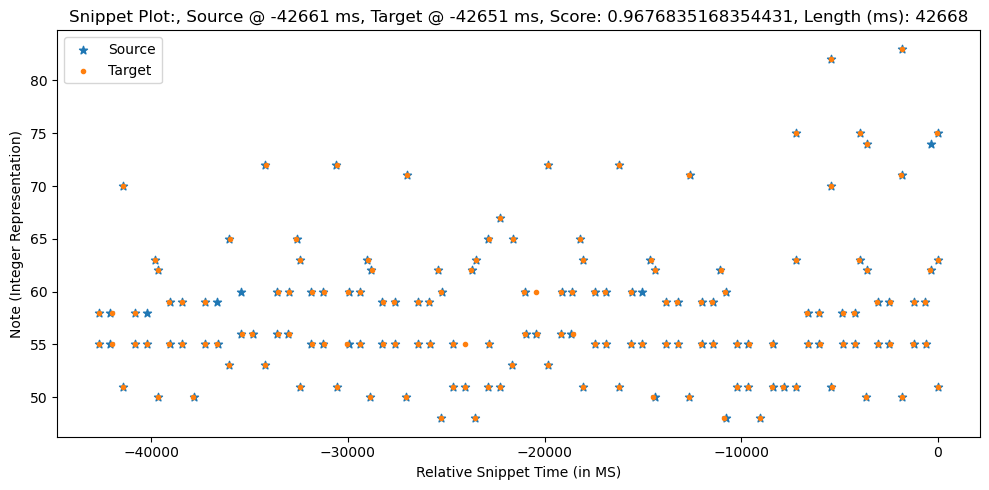

Scores: [ 0.98    0.955   0.79    0.71    0.98    0.9875  0.9425  0.9125  1.
  0.95    0.9675  0.9875  0.925   0.935   0.9475  0.9125  0.895   0.97
  0.985   0.9475  0.9875  0.95    0.9125  0.845   0.9175  0.9125  0.935
  0.8925  0.8975  0.925   0.9525  0.9375  0.97    0.815   0.835   0.9
  0.9     0.9675  0.99    0.84    0.88    0.93    0.975   0.8225  0.97
  0.875   0.7825  0.7725  0.9525  0.975   0.9975  0.9975  0.995   0.9825
  0.925   0.9825  0.9975  0.965   0.95    0.905   0.935   0.9325 -0.
  0.8575  0.9075  0.95    0.99    0.9175  0.945   0.9925  0.9975  0.98
  0.96    0.9025  0.8475 -0.      0.8325  0.9975  0.955   0.97    0.95
  0.9825  0.815   0.995   0.9875  0.995   0.93    0.9675  0.8575  0.995
  0.9775  0.965   0.95    0.955   0.9075  0.8775  0.7775  0.92    0.9825
  0.985   0.945   0.9925  0.9675  0.915   0.9075  0.8825  0.8975  0.8975
  0.855   0.7975  0.9075  0.9775  0.995   0.925   0.9675  0.9     0.8475
  0.885   0.885   0.9275  0.9475  0.9475  0.9375  0.97    0.9975

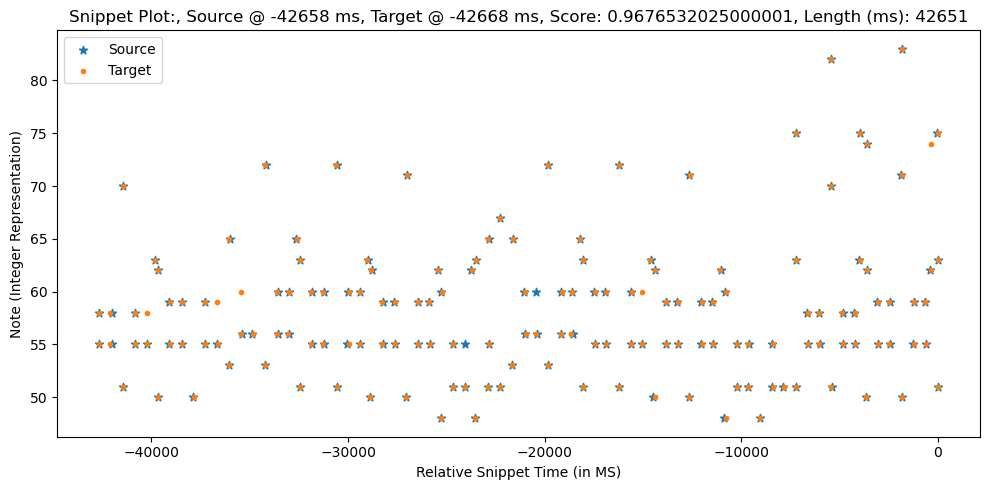

0.9676835168354431
Scores: [ 0.955   0.98    0.71    0.79    0.98    0.9875  0.9125  0.9425  1.
 -0.      0.95    0.9675  0.9875  0.935   0.925   0.9475  0.9125  0.895
  0.985   0.97   -0.      0.9475  0.9875  0.95   -0.      0.9125  0.845
  0.9175  0.9125  0.8925  0.935   0.8975  0.925   0.9525  0.97    0.9375
  0.815   0.835   0.9     0.9     0.9675  0.99    0.84    0.88    0.93
  0.975   0.8225  0.97    0.875   0.7825  0.7725  0.9525  0.975   0.9975
  0.9975  0.9825  0.995   0.925   0.9825  0.9975  0.965   0.95    0.935
  0.905   0.9325  0.8575  0.9075  0.95    0.9175  0.99    0.945   0.9925
  0.9975  0.98    0.96    0.9025  0.8475  0.8325  0.955   0.9975  0.97
  0.95    0.815   0.9825  0.995   0.9875  0.995   0.9675  0.93    0.995
  0.8575  0.965   0.9775  0.95    0.955  -0.      0.9075  0.8775  0.7775
  0.92    0.9825  0.985   0.9925  0.945   0.9675  0.915   0.9075  0.8825
  0.8975  0.8975  0.855   0.7975  0.9075  0.9775  0.995   0.925   0.9675
  0.9     0.8475  0.885   0.885   0.

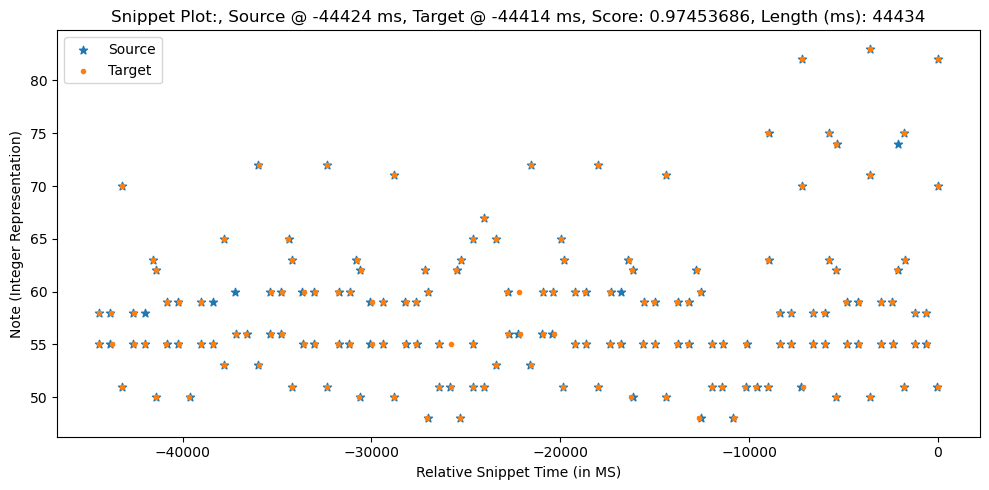

Scores: [ 0.98    0.955   0.79    0.71    0.98    0.9875  0.9425  0.9125  1.
  0.95    0.9675  0.9875  0.925   0.935   0.9475  0.9125  0.895   0.97
  0.985   0.9475  0.9875  0.95    0.9125  0.845   0.9175  0.9125  0.935
  0.8925  0.8975  0.925   0.9525  0.9375  0.97    0.815   0.835   0.9
  0.9     0.9675  0.99    0.84    0.88    0.93    0.975   0.8225  0.97
  0.875   0.7825  0.7725  0.9525  0.975   0.9975  0.9975  0.995   0.9825
  0.925   0.9825  0.9975  0.965   0.95    0.905   0.935   0.9325 -0.
  0.8575  0.9075  0.95    0.99    0.9175  0.945   0.9925  0.9975  0.98
  0.96    0.9025  0.8475 -0.      0.8325  0.9975  0.955   0.97    0.95
  0.9825  0.815   0.995   0.9875  0.995   0.93    0.9675  0.8575  0.995
  0.9775  0.965   0.95    0.955   0.9075  0.8775  0.7775  0.92    0.9825
  0.985   0.945   0.9925  0.9675  0.915   0.9075  0.8825  0.8975  0.8975
  0.855   0.7975  0.9075  0.9775  0.995   0.925   0.9675  0.9     0.8475
  0.885   0.885   0.9275  0.9475  0.9475  0.9375  0.97    0.9975

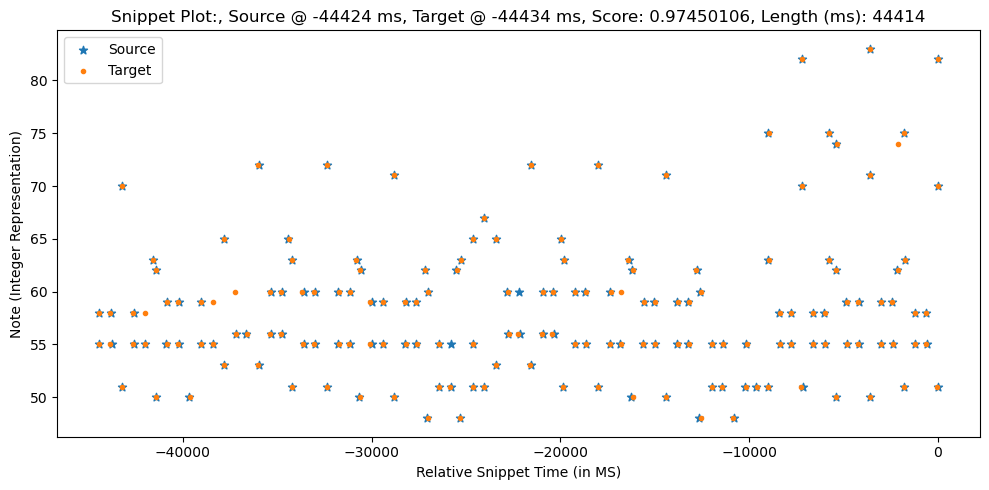

0.97453686
Scores: [ 0.95    0.975   0.705   0.785   0.985   0.9925  0.9075  0.9375  0.995
 -0.      0.955   0.9725  0.9925  0.94    0.93    0.9425  0.9075  0.9
  0.99    0.975  -0.      0.9525  0.9825  0.945  -0.      0.9075  0.85
  0.9125  0.9075  0.8875  0.93    0.8925  0.92    0.9575  0.965   0.9425
  0.81    0.83    0.895   0.895   0.9625  0.985   0.845   0.885   0.925
  0.97    0.8175  0.975   0.87    0.7775  0.7675  0.9575  0.98    0.9975
  0.9925  0.9775  1.      0.93    0.9875  0.9975  0.97    0.955   0.93
  0.91    0.9275  0.8625  0.9025  0.945   0.9125  0.995   0.94    0.9975
  0.9975  0.975   0.955   0.9075  0.8525  0.8275  0.95    0.9975  0.965
  0.955   0.81    0.9775  1.      0.9925  1.      0.9625  0.935   1.
  0.8625  0.96    0.9725  0.955   0.96   -0.      0.9125  0.8725  0.7825
  0.925   0.9775  0.99    0.9975  0.95    0.9725  0.92    0.9125  0.8875
  0.9025  0.9025  0.85    0.8025  0.9125  0.9825  1.      0.92    0.9625
  0.895   0.8525  0.89    0.89    0.9325  0.95

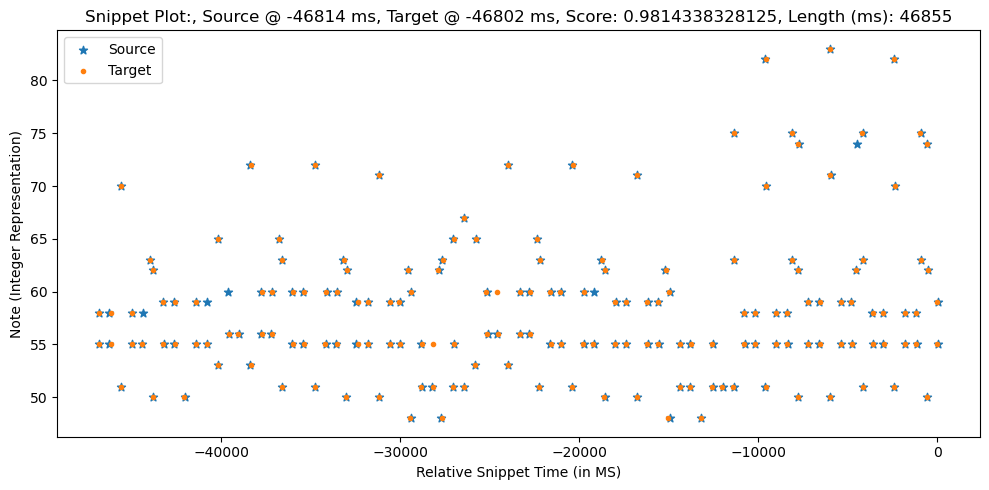

Scores: [ 0.975   0.95    0.785   0.705   0.985   0.9925  0.9375  0.9075  0.995
  0.955   0.9725  0.9925  0.93    0.94    0.9425  0.9075  0.9     0.975
  0.99    0.9525  0.9825  0.945   0.9075  0.85    0.9125  0.9075  0.93
  0.8875  0.8925  0.92    0.9575  0.9425  0.965   0.81    0.83    0.895
  0.895   0.9625  0.985   0.845   0.885   0.925   0.97    0.8175  0.975
  0.87    0.7775  0.7675  0.9575  0.98    0.9975  0.9925  1.      0.9775
  0.93    0.9875  0.9975  0.97    0.955   0.91    0.93    0.9275 -0.
  0.8625  0.9025  0.945   0.995   0.9125  0.94    0.9975  0.9975  0.975
  0.955   0.9075  0.8525 -0.      0.8275  0.9975  0.95    0.965   0.955
  0.9775  0.81    1.      0.9925  1.      0.935   0.9625  0.8625  1.
  0.9725  0.96    0.955   0.96    0.9125  0.8725  0.7825  0.925   0.9775
  0.99    0.95    0.9975  0.9725  0.92    0.9125  0.8875  0.9025  0.9025
  0.85    0.8025  0.9125  0.9825  1.      0.92    0.9625  0.895   0.8525
  0.89    0.89    0.9325  0.9525  0.9525  0.9425  0.975   0

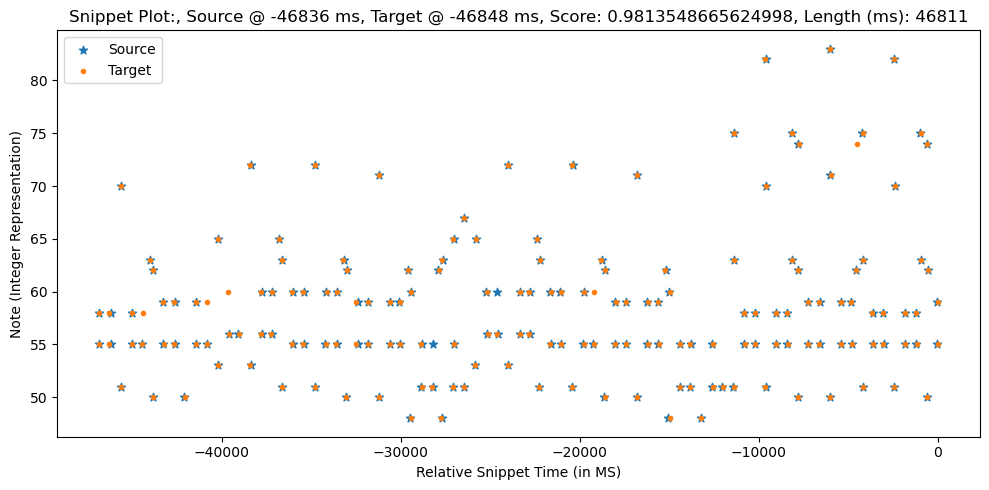

0.9814338328125
Scores: [ 0.9525  0.9775  0.7075  0.7875  0.9825  0.99    0.91    0.94    0.9975
 -0.      0.9525  0.97    0.99    0.9375  0.9275  0.945   0.91    0.8975
  0.9875  0.9725 -0.      0.95    0.985   0.9475 -0.      0.91    0.8475
  0.915   0.91    0.89    0.9325  0.895   0.9225  0.955   0.9675  0.94
  0.8125  0.8325  0.8975  0.8975  0.965   0.9875  0.8425  0.8825  0.9275
  0.9725  0.82    0.9725  0.8725  0.78    0.77    0.955   0.9775  1.
  0.995   0.98    0.9975  0.9275  0.985   1.      0.9675  0.9525  0.9325
  0.9075  0.93    0.86    0.905   0.9475  0.915   0.9925  0.9425  0.995
  1.      0.9775  0.9575  0.905   0.85    0.83    0.9525  1.      0.9675
  0.9525  0.8125  0.98    0.9975  0.99    0.9975  0.965   0.9325  0.9975
  0.86    0.9625  0.975   0.9525  0.9575 -0.      0.91    0.875   0.78
  0.9225  0.98    0.9875  0.995   0.9475  0.97    0.9175  0.91    0.885
  0.9     0.9     0.8525  0.8     0.91    0.98    0.9975  0.9225  0.965
  0.8975  0.85    0.8875  0.8875  0.93

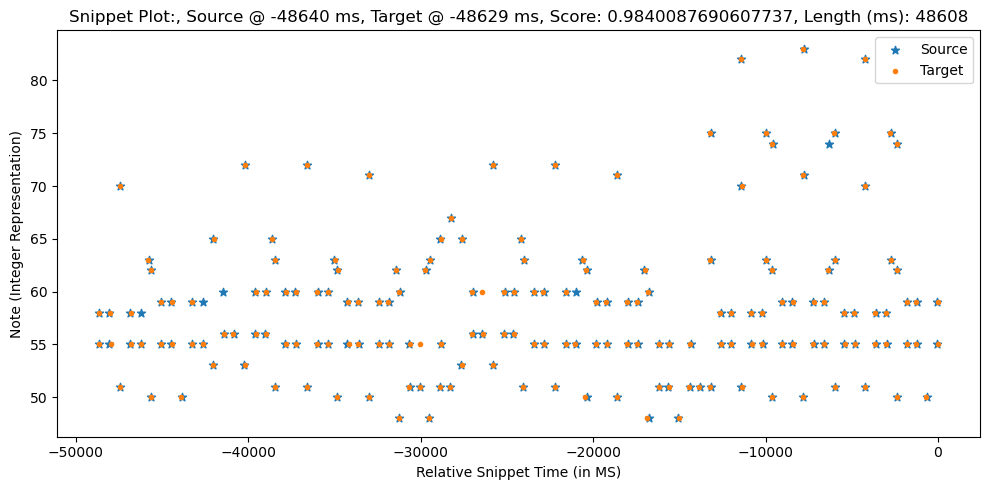

Scores: [ 0.9775  0.9525  0.7875  0.7075  0.9825  0.99    0.94    0.91    0.9975
  0.9525  0.97    0.99    0.9275  0.9375  0.945   0.91    0.8975  0.9725
  0.9875  0.95    0.985   0.9475  0.91    0.8475  0.915   0.91    0.9325
  0.89    0.895   0.9225  0.955   0.94    0.9675  0.8125  0.8325  0.8975
  0.8975  0.965   0.9875  0.8425  0.8825  0.9275  0.9725  0.82    0.9725
  0.8725  0.78    0.77    0.955   0.9775  1.      0.995   0.9975  0.98
  0.9275  0.985   1.      0.9675  0.9525  0.9075  0.9325  0.93   -0.
  0.86    0.905   0.9475  0.9925  0.915   0.9425  0.995   1.      0.9775
  0.9575  0.905   0.85   -0.      0.83    1.      0.9525  0.9675  0.9525
  0.98    0.8125  0.9975  0.99    0.9975  0.9325  0.965   0.86    0.9975
  0.975   0.9625  0.9525  0.9575  0.91    0.875   0.78    0.9225  0.98
  0.9875  0.9475  0.995   0.97    0.9175  0.91    0.885   0.9     0.9
  0.8525  0.8     0.91    0.98    0.9975  0.9225  0.965   0.8975  0.85
  0.8875  0.8875  0.93    0.95    0.95    0.94    0.9725

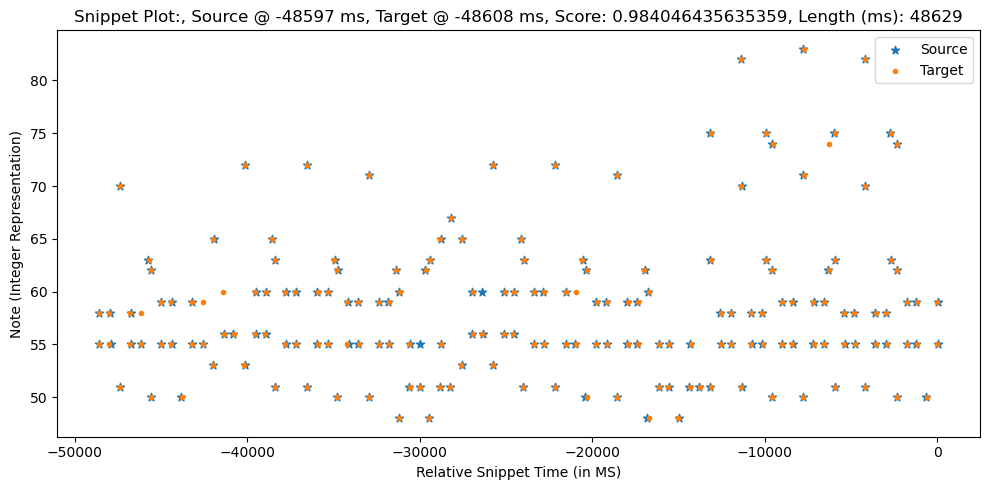

0.984046435635359
Scores: [ 0.73    0.81    0.96    0.9675  0.9325  0.9625  0.98   -0.      0.93
  0.9475  0.9675  0.915   0.905   0.9675  0.9325  0.875   0.965   0.95  ]
Sequence1:  [[-4837    55    49]
 [-4823    58    44]
 [-4186    70    58]
 [-4175    51    46]
 [-3576    55    45]
 [-3573    58    32]
 [-2969    55    48]
 [-2957    58    39]
 [-2523    63    52]
 [-2387    50    42]
 [-2375    62    56]
 [-1793    59    46]
 [-1791    55    46]
 [-1198    59    42]
 [-1192    55    48]
 [ -583    50    46]
 [   18    59    39]
 [   20    55    44]]
Sequence2:  [[-4747    58    26]
 [-4729    55    35]
 [-4202    70    53]
 [-4188    51    51]
 [-3558    58    33]
 [-3549    55    42]
 [-2977    55    48]
 [-2551    63    49]
 [-2408    50    44]
 [-2388    62    54]
 [-1829    55    44]
 [-1827    59    42]
 [-1185    59    41]
 [-1165    55    45]
 [ -633    50    51]
 [    0    55    44]
 [    4    59    40]]
mean_offset1:  20.647058823529413
mean_offset2:  -20.647058823529413

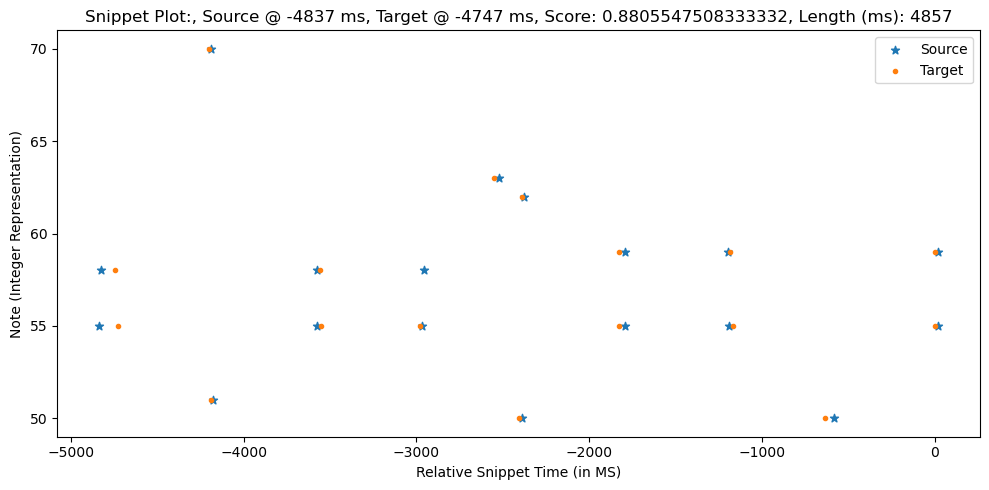

Scores: [0.81   0.73   0.96   0.9675 0.9625 0.9325 0.98   0.93   0.9475 0.9675
 0.905  0.915  0.9675 0.9325 0.875  0.95   0.965 ]
Sequence1:  [[-4765    58    26]
 [-4747    55    35]
 [-4220    70    53]
 [-4206    51    51]
 [-3576    58    33]
 [-3567    55    42]
 [-2995    55    48]
 [-2569    63    49]
 [-2426    50    44]
 [-2406    62    54]
 [-1847    55    44]
 [-1845    59    42]
 [-1203    59    41]
 [-1183    55    45]
 [ -651    50    51]
 [  -18    55    44]
 [  -14    59    40]]
Sequence2:  [[-4855    55    49]
 [-4841    58    44]
 [-4204    70    58]
 [-4193    51    46]
 [-3594    55    45]
 [-3591    58    32]
 [-2987    55    48]
 [-2975    58    39]
 [-2541    63    52]
 [-2405    50    42]
 [-2393    62    56]
 [-1811    59    46]
 [-1809    55    46]
 [-1216    59    42]
 [-1210    55    48]
 [ -601    50    46]
 [    0    59    39]
 [    2    55    44]]
mean_offset1:  -14.647058823529411
mean_offset2:  14.647058823529411
mo:  [2]
Count zeros:  0


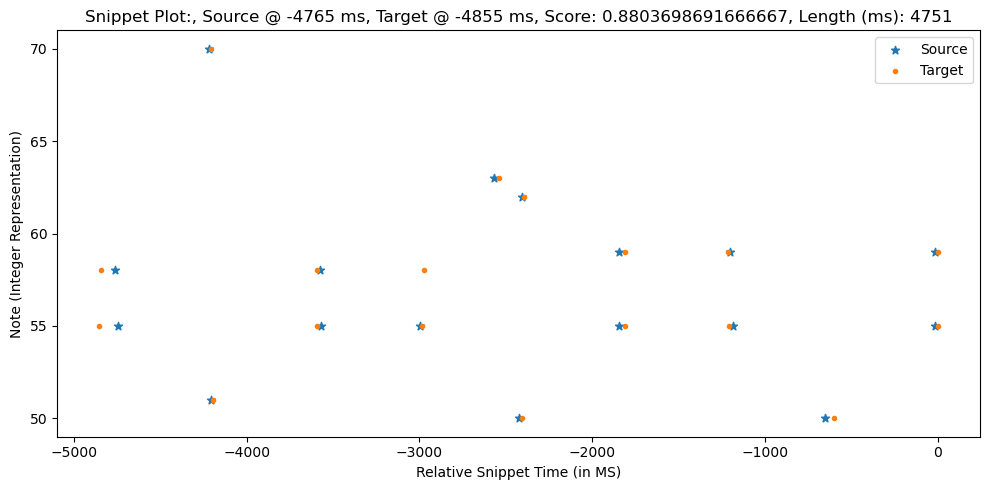

0.8805547508333332
Scores: [ 0.7325  0.8125  0.9575  0.965   0.935   0.965   0.9775 -0.      0.9275
  0.945   0.965   0.9125  0.9025  0.97    0.935   0.8725  0.9625  0.9475
 -0.      0.925   0.99    0.9725  0.      0.935 ]
Sequence1:  [[-6706    55    49]
 [-6692    58    44]
 [-6055    70    58]
 [-6044    51    46]
 [-5445    55    45]
 [-5442    58    32]
 [-4838    55    48]
 [-4826    58    39]
 [-4392    63    52]
 [-4256    50    42]
 [-4244    62    56]
 [-3662    59    46]
 [-3660    55    46]
 [-3067    59    42]
 [-3061    55    48]
 [-2452    50    46]
 [-1851    59    39]
 [-1849    55    44]
 [-1243    59    34]
 [-1227    55    41]
 [ -644    53    47]
 [ -641    65    54]
 [  -53    60    34]
 [  -26    56    44]]
Sequence2:  [[-6617    58    26]
 [-6599    55    35]
 [-6072    70    53]
 [-6058    51    51]
 [-5428    58    33]
 [-5419    55    42]
 [-4847    55    48]
 [-4421    63    49]
 [-4278    50    44]
 [-4258    62    54]
 [-3699    55    44]
 [-3697    59    

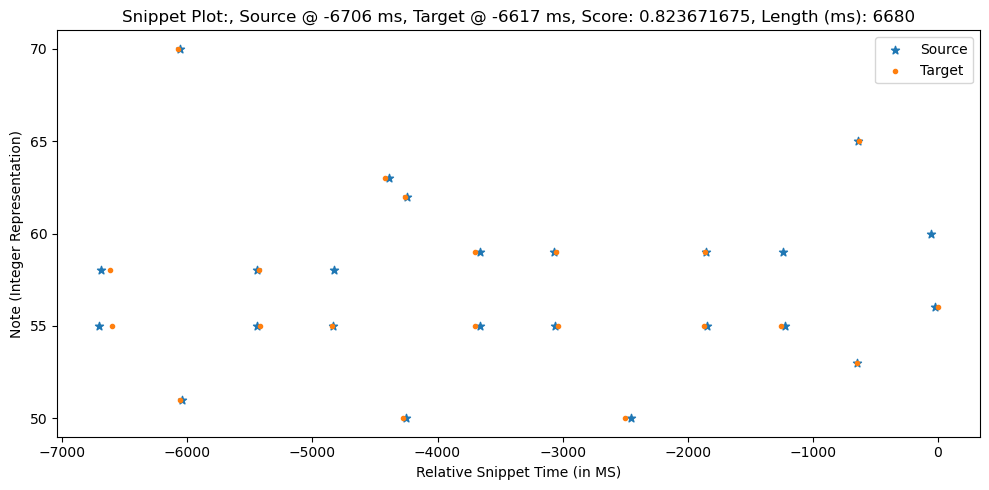

Scores: [0.8125 0.7325 0.9575 0.965  0.965  0.935  0.9775 0.9275 0.945  0.965
 0.9025 0.9125 0.97   0.935  0.8725 0.9475 0.9625 0.925  0.99   0.9725
 0.935 ]
Sequence1:  [[-6591    58    26]
 [-6573    55    35]
 [-6046    70    53]
 [-6032    51    51]
 [-5402    58    33]
 [-5393    55    42]
 [-4821    55    48]
 [-4395    63    49]
 [-4252    50    44]
 [-4232    62    54]
 [-3673    55    44]
 [-3671    59    42]
 [-3029    59    41]
 [-3009    55    45]
 [-2477    50    51]
 [-1844    55    44]
 [-1840    59    40]
 [-1231    55    47]
 [ -622    53    43]
 [ -604    65    49]
 [   26    56    41]]
Sequence2:  [[-6680    55    49]
 [-6666    58    44]
 [-6029    70    58]
 [-6018    51    46]
 [-5419    55    45]
 [-5416    58    32]
 [-4812    55    48]
 [-4800    58    39]
 [-4366    63    52]
 [-4230    50    42]
 [-4218    62    56]
 [-3636    59    46]
 [-3634    55    46]
 [-3041    59    42]
 [-3035    55    48]
 [-2426    50    46]
 [-1825    59    39]
 [-1823    55    44

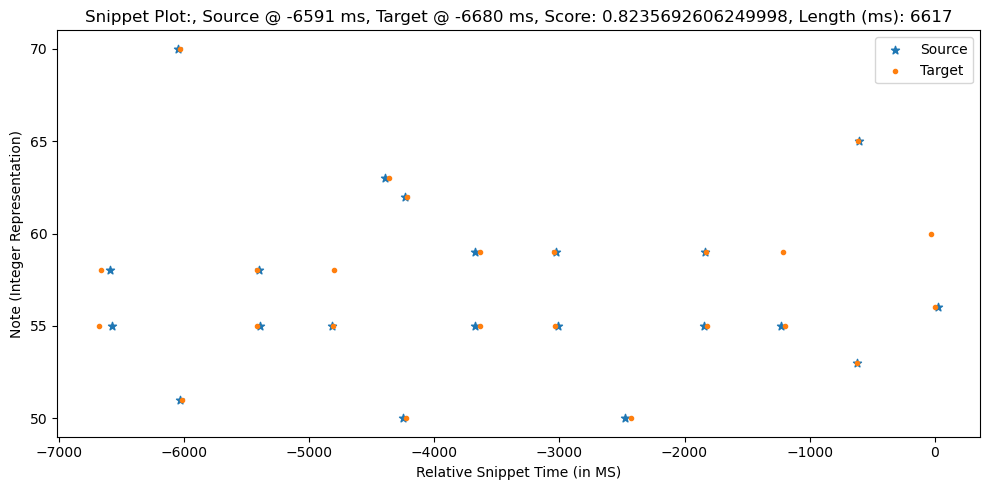

0.823671675
Scores: [ 0.7375  0.8175  0.9525  0.96    0.94    0.97    0.9725 -0.      0.9225
  0.94    0.96    0.9075  0.8975  0.975   0.94    0.8675  0.9575  0.9425
 -0.      0.92    0.985   0.9775 -0.      0.94    0.8175  0.945   0.94
  0.92    0.9625]
Sequence1:  [[-8522    55    49]
 [-8508    58    44]
 [-7871    70    58]
 [-7860    51    46]
 [-7261    55    45]
 [-7258    58    32]
 [-6654    55    48]
 [-6642    58    39]
 [-6208    63    52]
 [-6072    50    42]
 [-6060    62    56]
 [-5478    59    46]
 [-5476    55    46]
 [-4883    59    42]
 [-4877    55    48]
 [-4268    50    46]
 [-3667    59    39]
 [-3665    55    44]
 [-3059    59    34]
 [-3043    55    41]
 [-2460    53    47]
 [-2457    65    54]
 [-1869    60    34]
 [-1842    56    44]
 [-1240    56    45]
 [ -648    53    46]
 [ -641    72    59]
 [  -26    56    45]
 [  -15    60    30]]
Sequence2:  [[-8435    58    26]
 [-8417    55    35]
 [-7890    70    53]
 [-7876    51    51]
 [-7246    58    33]
 [-723

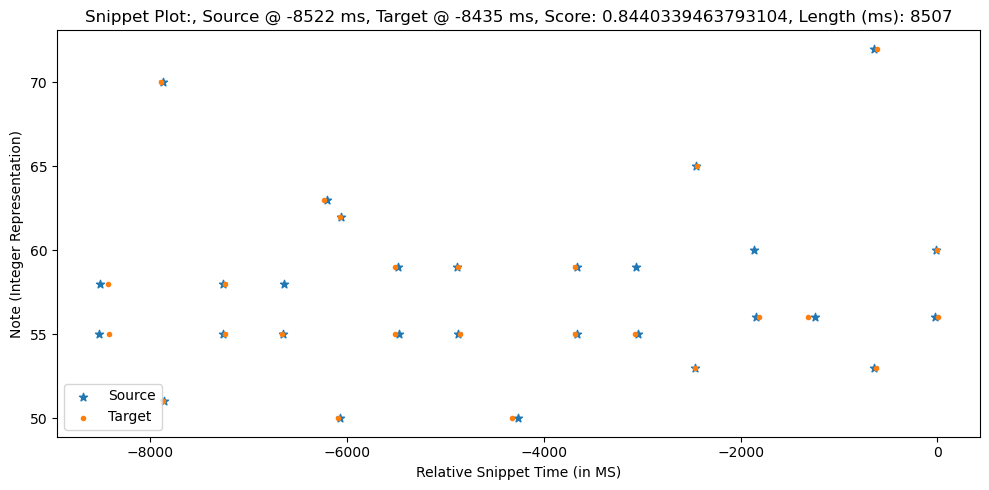

Scores: [0.8175 0.7375 0.9525 0.96   0.97   0.94   0.9725 0.9225 0.94   0.96
 0.8975 0.9075 0.975  0.94   0.8675 0.9425 0.9575 0.92   0.985  0.9775
 0.94   0.8175 0.945  0.94   0.9625 0.92  ]
Sequence1:  [[-8409    58    26]
 [-8391    55    35]
 [-7864    70    53]
 [-7850    51    51]
 [-7220    58    33]
 [-7211    55    42]
 [-6639    55    48]
 [-6213    63    49]
 [-6070    50    44]
 [-6050    62    54]
 [-5491    55    44]
 [-5489    59    42]
 [-4847    59    41]
 [-4827    55    45]
 [-4295    50    51]
 [-3662    55    44]
 [-3658    59    40]
 [-3049    55    47]
 [-2440    53    43]
 [-2422    65    49]
 [-1792    56    41]
 [-1287    56    41]
 [ -600    53    54]
 [ -591    72    55]
 [   26    60    32]
 [   32    56    44]]
Sequence2:  [[-8496    55    49]
 [-8482    58    44]
 [-7845    70    58]
 [-7834    51    46]
 [-7235    55    45]
 [-7232    58    32]
 [-6628    55    48]
 [-6616    58    39]
 [-6182    63    52]
 [-6046    50    42]
 [-6034    62    56]
 [-545

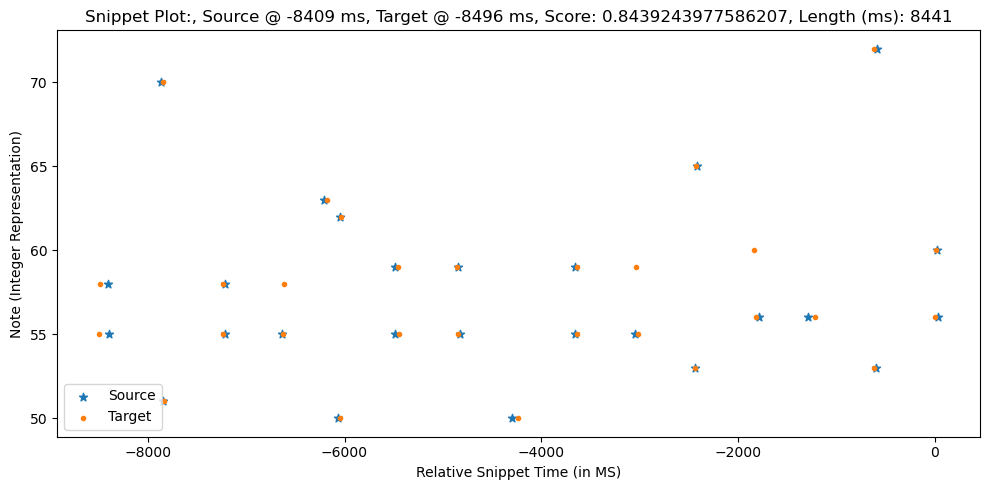

0.8440339463793104
Scores: [ 0.7475  0.8275  0.9425  0.95    0.95    0.98    0.9625 -0.      0.9125
  0.93    0.95    0.8975  0.8875  0.985   0.95    0.8575  0.9475  0.9325
 -0.      0.91    0.975   0.9875 -0.      0.95    0.8075  0.955   0.95
  0.93    0.9725  0.935   0.9625  0.915   0.9925  0.9     0.8525  0.8725
  0.9375  0.9375]
Sequence1:  [[-10867     55     49]
 [-10853     58     44]
 [-10216     70     58]
 [-10205     51     46]
 [ -9606     55     45]
 [ -9603     58     32]
 [ -8999     55     48]
 [ -8987     58     39]
 [ -8553     63     52]
 [ -8417     50     42]
 [ -8405     62     56]
 [ -7823     59     46]
 [ -7821     55     46]
 [ -7228     59     42]
 [ -7222     55     48]
 [ -6613     50     46]
 [ -6012     59     39]
 [ -6010     55     44]
 [ -5404     59     34]
 [ -5388     55     41]
 [ -4805     53     47]
 [ -4802     65     54]
 [ -4214     60     34]
 [ -4187     56     44]
 [ -3585     56     45]
 [ -2993     53     46]
 [ -2986     72     59]
 [ -2

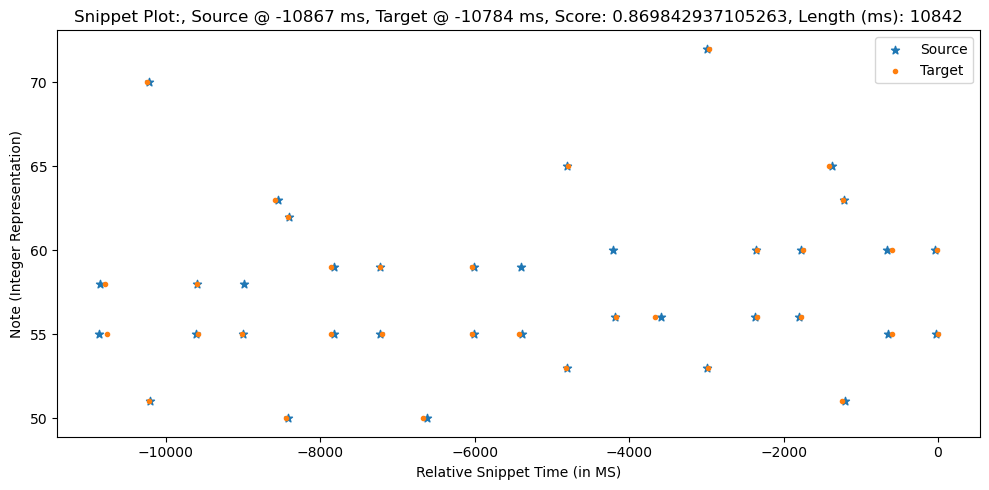

Scores: [0.8275 0.7475 0.9425 0.95   0.98   0.95   0.9625 0.9125 0.93   0.95
 0.8875 0.8975 0.985  0.95   0.8575 0.9325 0.9475 0.91   0.975  0.9875
 0.95   0.8075 0.955  0.95   0.9725 0.93   0.935  0.9625 0.915  0.9
 0.9925 0.8525 0.8725 0.9375 0.9375]
Sequence1:  [[-10759     58     26]
 [-10741     55     35]
 [-10214     70     53]
 [-10200     51     51]
 [ -9570     58     33]
 [ -9561     55     42]
 [ -8989     55     48]
 [ -8563     63     49]
 [ -8420     50     44]
 [ -8400     62     54]
 [ -7841     55     44]
 [ -7839     59     42]
 [ -7197     59     41]
 [ -7177     55     45]
 [ -6645     50     51]
 [ -6012     55     44]
 [ -6008     59     40]
 [ -5399     55     47]
 [ -4790     53     43]
 [ -4772     65     49]
 [ -4142     56     41]
 [ -3637     56     41]
 [ -2950     53     54]
 [ -2941     72     55]
 [ -2324     60     32]
 [ -2318     56     44]
 [ -1745     56     48]
 [ -1729     60     31]
 [ -1387     65     40]
 [ -1215     51     45]
 [ -1201     63

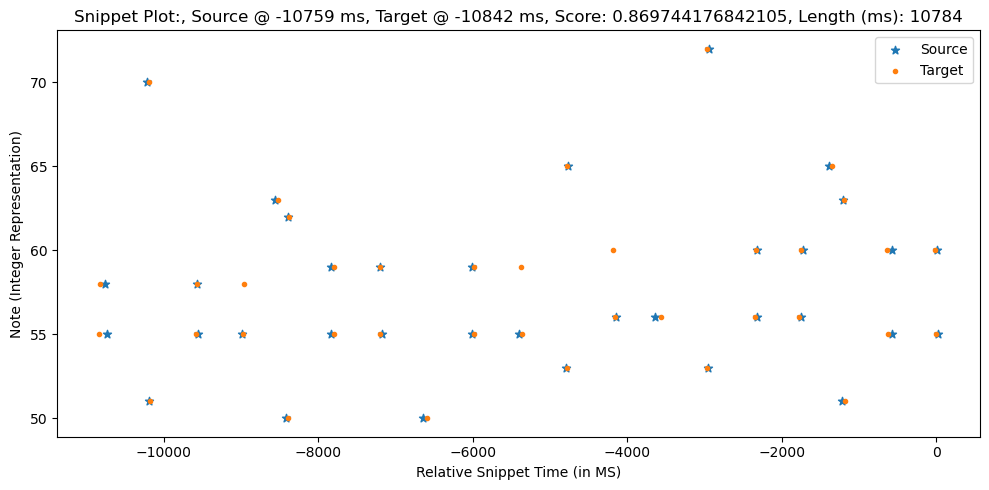

0.869842937105263
Scores: [ 0.7375  0.8175  0.9525  0.96    0.94    0.97    0.9725 -0.      0.9225
  0.94    0.96    0.9075  0.8975  0.975   0.94    0.8675  0.9575  0.9425
 -0.      0.92    0.985   0.9775 -0.      0.94    0.8175  0.945   0.94
  0.92    0.9625  0.925   0.9525  0.925   0.9975  0.91    0.8425  0.8625
  0.9275  0.9275  0.995   0.9825  0.8125  0.8525  0.9575  0.9975]
Sequence1:  [[-12711     55     49]
 [-12697     58     44]
 [-12060     70     58]
 [-12049     51     46]
 [-11450     55     45]
 [-11447     58     32]
 [-10843     55     48]
 [-10831     58     39]
 [-10397     63     52]
 [-10261     50     42]
 [-10249     62     56]
 [ -9667     59     46]
 [ -9665     55     46]
 [ -9072     59     42]
 [ -9066     55     48]
 [ -8457     50     46]
 [ -7856     59     39]
 [ -7854     55     44]
 [ -7248     59     34]
 [ -7232     55     41]
 [ -6649     53     47]
 [ -6646     65     54]
 [ -6058     60     34]
 [ -6031     56     44]
 [ -5429     56     45]
 [ -48

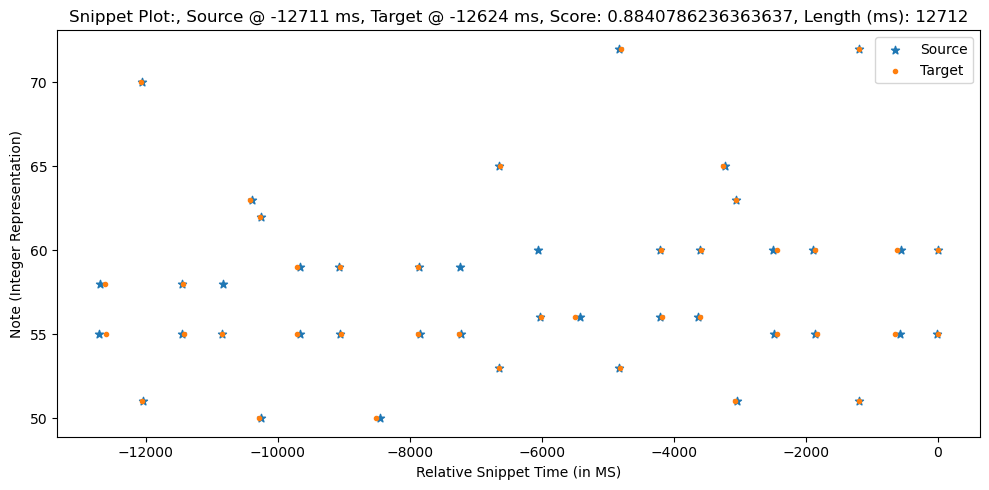

Scores: [0.8175 0.7375 0.9525 0.96   0.97   0.94   0.9725 0.9225 0.94   0.96
 0.8975 0.9075 0.975  0.94   0.8675 0.9425 0.9575 0.92   0.985  0.9775
 0.94   0.8175 0.945  0.94   0.9625 0.92   0.925  0.9525 0.925  0.91
 0.9975 0.8425 0.8625 0.9275 0.9275 0.995  0.9825 0.8125 0.8525 0.9575
 0.9975]
Sequence1:  [[-12625     58     26]
 [-12607     55     35]
 [-12080     70     53]
 [-12066     51     51]
 [-11436     58     33]
 [-11427     55     42]
 [-10855     55     48]
 [-10429     63     49]
 [-10286     50     44]
 [-10266     62     54]
 [ -9707     55     44]
 [ -9705     59     42]
 [ -9063     59     41]
 [ -9043     55     45]
 [ -8511     50     51]
 [ -7878     55     44]
 [ -7874     59     40]
 [ -7265     55     47]
 [ -6656     53     43]
 [ -6638     65     49]
 [ -6008     56     41]
 [ -5503     56     41]
 [ -4816     53     54]
 [ -4807     72     55]
 [ -4190     60     32]
 [ -4184     56     44]
 [ -3611     56     48]
 [ -3595     60     31]
 [ -3253     65    

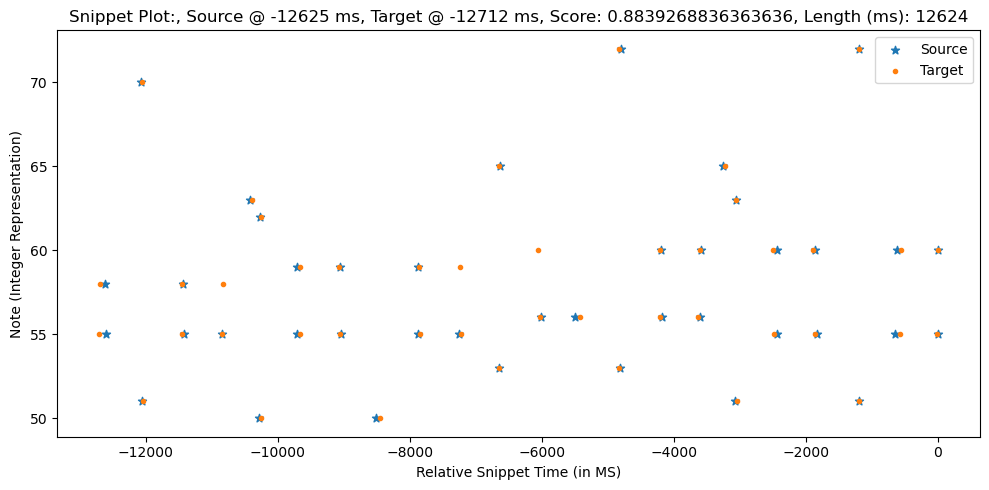

0.8840786236363637
Scores: [ 0.7475  0.8275  0.9425  0.95    0.95    0.98    0.9625 -0.      0.9125
  0.93    0.95    0.8975  0.8875  0.985   0.95    0.8575  0.9475  0.9325
 -0.      0.91    0.975   0.9875 -0.      0.95    0.8075  0.955   0.95
  0.93    0.9725  0.935   0.9625  0.915   0.9925  0.9     0.8525  0.8725
  0.9375  0.9375  0.995   0.9725  0.8025  0.8425  0.9675  0.9875  0.86
  0.9325  0.9125  0.82    0.81    0.915   0.9375]
Sequence1:  [[-14465     55     49]
 [-14451     58     44]
 [-13814     70     58]
 [-13803     51     46]
 [-13204     55     45]
 [-13201     58     32]
 [-12597     55     48]
 [-12585     58     39]
 [-12151     63     52]
 [-12015     50     42]
 [-12003     62     56]
 [-11421     59     46]
 [-11419     55     46]
 [-10826     59     42]
 [-10820     55     48]
 [-10211     50     46]
 [ -9610     59     39]
 [ -9608     55     44]
 [ -9002     59     34]
 [ -8986     55     41]
 [ -8403     53     47]
 [ -8400     65     54]
 [ -7812     60     34

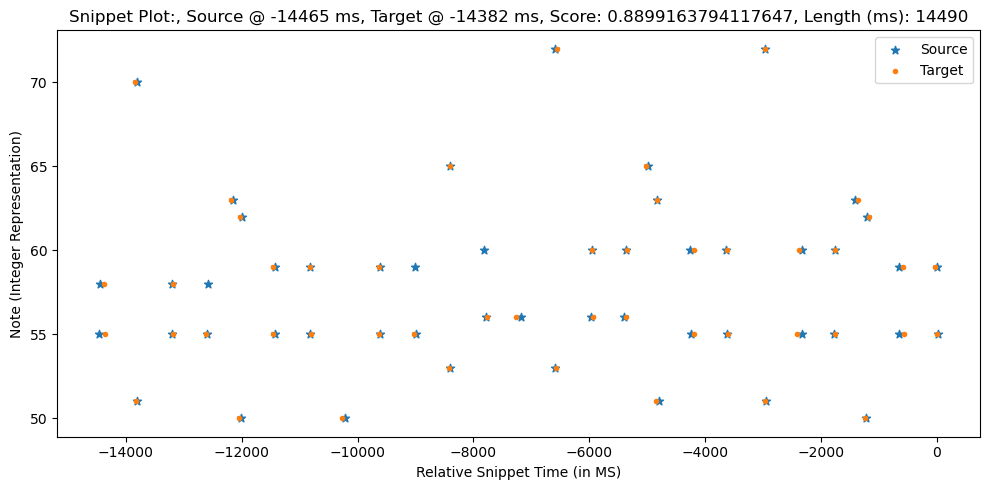

Scores: [0.8275 0.7475 0.9425 0.95   0.98   0.95   0.9625 0.9125 0.93   0.95
 0.8875 0.8975 0.985  0.95   0.8575 0.9325 0.9475 0.91   0.975  0.9875
 0.95   0.8075 0.955  0.95   0.9725 0.93   0.935  0.9625 0.915  0.9
 0.9925 0.8525 0.8725 0.9375 0.9375 0.995  0.9725 0.8025 0.8425 0.9675
 0.9875 0.86   0.9325 0.9125 0.82   0.81   0.915  0.9375]
Sequence1:  [[-14407     58     26]
 [-14389     55     35]
 [-13862     70     53]
 [-13848     51     51]
 [-13218     58     33]
 [-13209     55     42]
 [-12637     55     48]
 [-12211     63     49]
 [-12068     50     44]
 [-12048     62     54]
 [-11489     55     44]
 [-11487     59     42]
 [-10845     59     41]
 [-10825     55     45]
 [-10293     50     51]
 [ -9660     55     44]
 [ -9656     59     40]
 [ -9047     55     47]
 [ -8438     53     43]
 [ -8420     65     49]
 [ -7790     56     41]
 [ -7285     56     41]
 [ -6598     53     54]
 [ -6589     72     55]
 [ -5972     60     32]
 [ -5966     56     44]
 [ -5393     56    

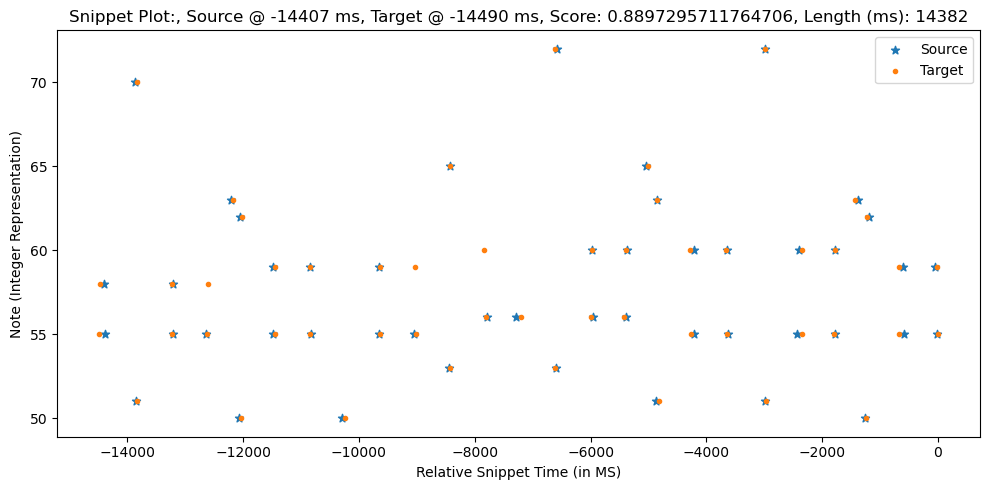

0.8899163794117647
Scores: [ 0.7375  0.8175  0.9525  0.96    0.94    0.97    0.9725 -0.      0.9225
  0.94    0.96    0.9075  0.8975  0.975   0.94    0.8675  0.9575  0.9425
 -0.      0.92    0.985   0.9775 -0.      0.94    0.8175  0.945   0.94
  0.92    0.9625  0.925   0.9525  0.925   0.9975  0.91    0.8425  0.8625
  0.9275  0.9275  0.995   0.9825  0.8125  0.8525  0.9575  0.9975  0.85
  0.9425  0.9025  0.81    0.8     0.925   0.9475  0.97    0.975   0.99
  0.9675  0.8975  0.955   0.97    0.9375  0.9225]
Sequence1:  [[-16842     55     49]
 [-16828     58     44]
 [-16191     70     58]
 [-16180     51     46]
 [-15581     55     45]
 [-15578     58     32]
 [-14974     55     48]
 [-14962     58     39]
 [-14528     63     52]
 [-14392     50     42]
 [-14380     62     56]
 [-13798     59     46]
 [-13796     55     46]
 [-13203     59     42]
 [-13197     55     48]
 [-12588     50     46]
 [-11987     59     39]
 [-11985     55     44]
 [-11379     59     34]
 [-11363     55     41]

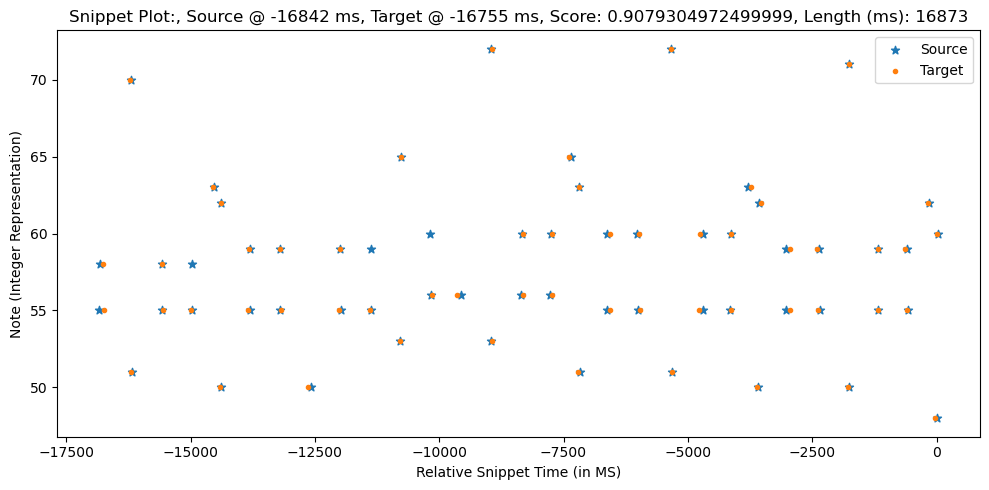

Scores: [0.8175 0.7375 0.9525 0.96   0.97   0.94   0.9725 0.9225 0.94   0.96
 0.8975 0.9075 0.975  0.94   0.8675 0.9425 0.9575 0.92   0.985  0.9775
 0.94   0.8175 0.945  0.94   0.9625 0.92   0.925  0.9525 0.925  0.91
 0.9975 0.8425 0.8625 0.9275 0.9275 0.995  0.9825 0.8125 0.8525 0.9575
 0.9975 0.85   0.9425 0.9025 0.81   0.8    0.925  0.9475 0.97   0.975
 0.9675 0.99   0.8975 0.955  0.97   0.9375 0.9225]
Sequence1:  [[-16786     58     26]
 [-16768     55     35]
 [-16241     70     53]
 [-16227     51     51]
 [-15597     58     33]
 [-15588     55     42]
 [-15016     55     48]
 [-14590     63     49]
 [-14447     50     44]
 [-14427     62     54]
 [-13868     55     44]
 [-13866     59     42]
 [-13224     59     41]
 [-13204     55     45]
 [-12672     50     51]
 [-12039     55     44]
 [-12035     59     40]
 [-11426     55     47]
 [-10817     53     43]
 [-10799     65     49]
 [-10169     56     41]
 [ -9664     56     41]
 [ -8977     53     54]
 [ -8968     72     55]
 [ 

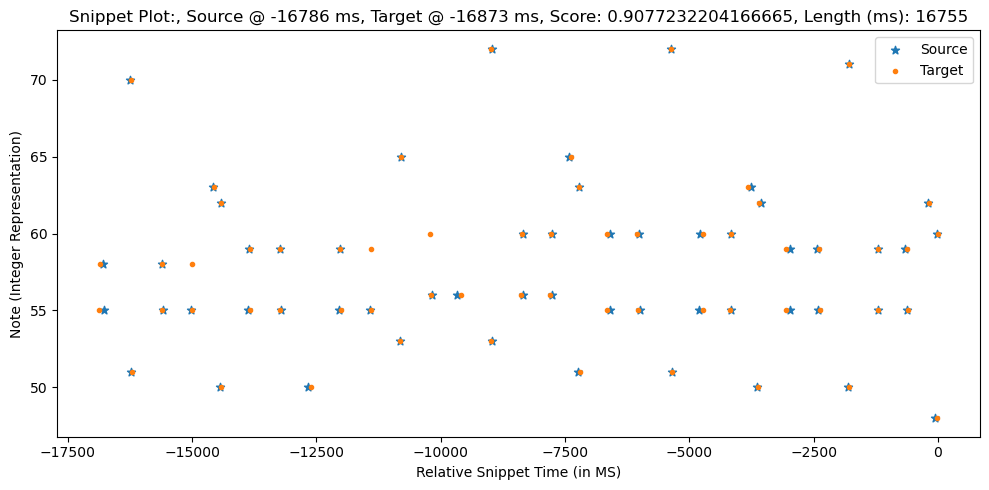

0.9079304972499999
Scores: [ 0.7375  0.8175  0.9525  0.96    0.94    0.97    0.9725 -0.      0.9225
  0.94    0.96    0.9075  0.8975  0.975   0.94    0.8675  0.9575  0.9425
 -0.      0.92    0.985   0.9775 -0.      0.94    0.8175  0.945   0.94
  0.92    0.9625  0.925   0.9525  0.925   0.9975  0.91    0.8425  0.8625
  0.9275  0.9275  0.995   0.9825  0.8125  0.8525  0.9575  0.9975  0.85
  0.9425  0.9025  0.81    0.8     0.925   0.9475  0.97    0.975   0.99
  0.9675  0.8975  0.955   0.97    0.9375  0.9225  0.9625  0.8775  0.96
  0.83    0.935   0.9775]
Sequence1:  [[-18628     55     49]
 [-18614     58     44]
 [-17977     70     58]
 [-17966     51     46]
 [-17367     55     45]
 [-17364     58     32]
 [-16760     55     48]
 [-16748     58     39]
 [-16314     63     52]
 [-16178     50     42]
 [-16166     62     56]
 [-15584     59     46]
 [-15582     55     46]
 [-14989     59     42]
 [-14983     55     48]
 [-14374     50     46]
 [-13773     59     39]
 [-13771     55     44]


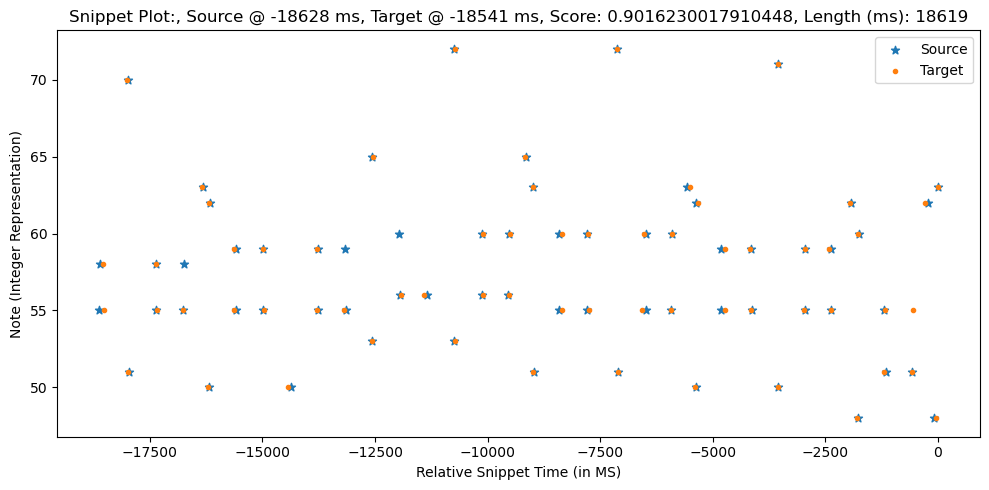

Scores: [ 0.8175  0.7375  0.9525  0.96    0.97    0.94    0.9725  0.9225  0.94
  0.96    0.8975  0.9075  0.975   0.94    0.8675  0.9425  0.9575  0.92
  0.985   0.9775  0.94    0.8175  0.945   0.94    0.9625  0.92    0.925
  0.9525  0.925   0.91    0.9975  0.8425  0.8625  0.9275  0.9275  0.995
  0.9825  0.8125  0.8525  0.9575  0.9975  0.85    0.9425  0.9025  0.81
  0.8     0.925   0.9475  0.97    0.975   0.9675  0.99    0.8975  0.955
  0.97    0.9375  0.9225  0.8775  0.9625  0.96   -0.      0.83    0.935
  0.9775]
Sequence1:  [[-18532     58     26]
 [-18514     55     35]
 [-17987     70     53]
 [-17973     51     51]
 [-17343     58     33]
 [-17334     55     42]
 [-16762     55     48]
 [-16336     63     49]
 [-16193     50     44]
 [-16173     62     54]
 [-15614     55     44]
 [-15612     59     42]
 [-14970     59     41]
 [-14950     55     45]
 [-14418     50     51]
 [-13785     55     44]
 [-13781     59     40]
 [-13172     55     47]
 [-12563     53     43]
 [-12545     

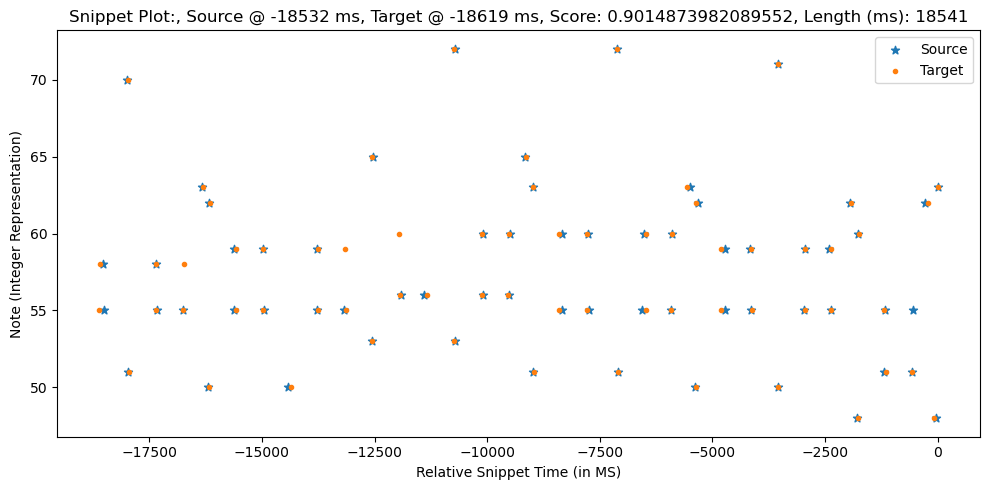

0.9016230017910448
Scores: [ 0.7375  0.8175  0.9525  0.96    0.94    0.97    0.9725 -0.      0.9225
  0.94    0.96    0.9075  0.8975  0.975   0.94    0.8675  0.9575  0.9425
 -0.      0.92    0.985   0.9775 -0.      0.94    0.8175  0.945   0.94
  0.92    0.9625  0.925   0.9525  0.925   0.9975  0.91    0.8425  0.8625
  0.9275  0.9275  0.995   0.9825  0.8125  0.8525  0.9575  0.9975  0.85
  0.9425  0.9025  0.81    0.8     0.925   0.9475  0.97    0.975   0.99
  0.9675  0.8975  0.955   0.97    0.9375  0.9225  0.9625  0.8775  0.96
  0.83    0.935   0.9775  0.945   0.9625  0.9725  0.965   0.97    0.9925
  0.9875]
Sequence1:  [[-20480     55     49]
 [-20466     58     44]
 [-19829     70     58]
 [-19818     51     46]
 [-19219     55     45]
 [-19216     58     32]
 [-18612     55     48]
 [-18600     58     39]
 [-18166     63     52]
 [-18030     50     42]
 [-18018     62     56]
 [-17436     59     46]
 [-17434     55     46]
 [-16841     59     42]
 [-16835     55     48]
 [-16226     50

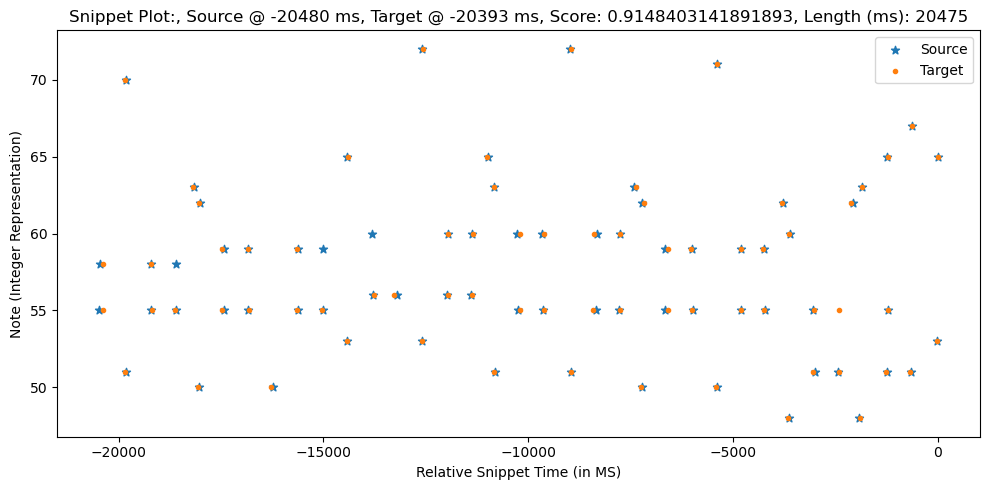

Scores: [ 0.8175  0.7375  0.9525  0.96    0.97    0.94    0.9725  0.9225  0.94
  0.96    0.8975  0.9075  0.975   0.94    0.8675  0.9425  0.9575  0.92
  0.985   0.9775  0.94    0.8175  0.945   0.94    0.9625  0.92    0.925
  0.9525  0.925   0.91    0.9975  0.8425  0.8625  0.9275  0.9275  0.995
  0.9825  0.8125  0.8525  0.9575  0.9975  0.85    0.9425  0.9025  0.81
  0.8     0.925   0.9475  0.97    0.975   0.9675  0.99    0.8975  0.955
  0.97    0.9375  0.9225  0.8775  0.9625  0.96   -0.      0.83    0.935
  0.9775  0.9625  0.945   0.9725  0.965   0.97    0.9925  0.9875]
Sequence1:  [[-20388     58     26]
 [-20370     55     35]
 [-19843     70     53]
 [-19829     51     51]
 [-19199     58     33]
 [-19190     55     42]
 [-18618     55     48]
 [-18192     63     49]
 [-18049     50     44]
 [-18029     62     54]
 [-17470     55     44]
 [-17468     59     42]
 [-16826     59     41]
 [-16806     55     45]
 [-16274     50     51]
 [-15641     55     44]
 [-15637     59     40]
 [-15

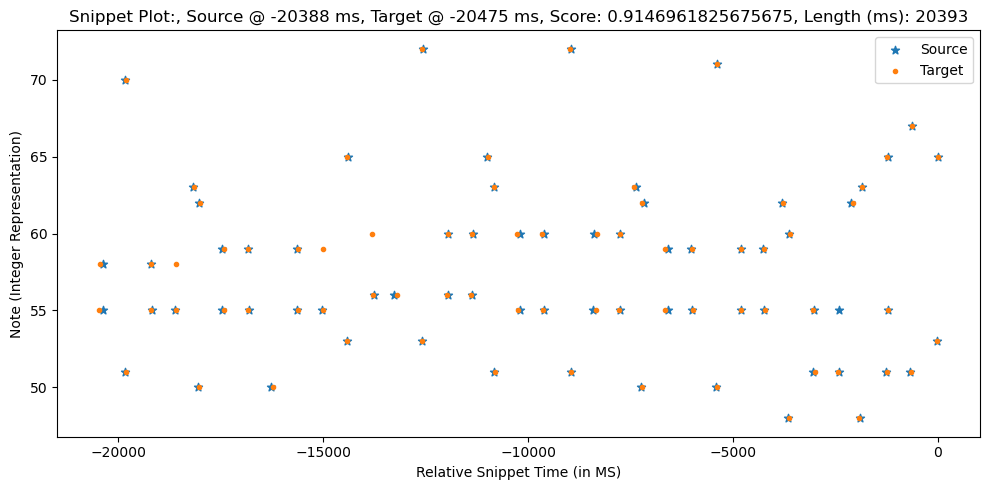

0.9148403141891893
Scores: [ 0.7325  0.8125  0.9575  0.965   0.935   0.965   0.9775 -0.      0.9275
  0.945   0.965   0.9125  0.9025  0.97    0.935   0.8725  0.9625  0.9475
 -0.      0.925   0.99    0.9725 -0.      0.935   0.8225  0.94    0.935
  0.915   0.9575  0.92    0.9475  0.93    0.9925  0.915   0.8375  0.8575
  0.9225  0.9225  0.99    0.9875  0.8175  0.8575  0.9525  0.9975  0.845
  0.9475  0.8975  0.805   0.795   0.93    0.9525  0.975   0.98    0.995
  0.9725  0.9025  0.96    0.975   0.9425  0.9275  0.9575  0.8825  0.955
  0.835   0.93    0.9725  0.94    0.9675  0.9675  0.97    0.975   0.9975
  0.9825  0.88    0.825   0.855   0.9775  0.975 ]
Sequence1:  [[-22285     55     49]
 [-22271     58     44]
 [-21634     70     58]
 [-21623     51     46]
 [-21024     55     45]
 [-21021     58     32]
 [-20417     55     48]
 [-20405     58     39]
 [-19971     63     52]
 [-19835     50     42]
 [-19823     62     56]
 [-19241     59     46]
 [-19239     55     46]
 [-18646     59    

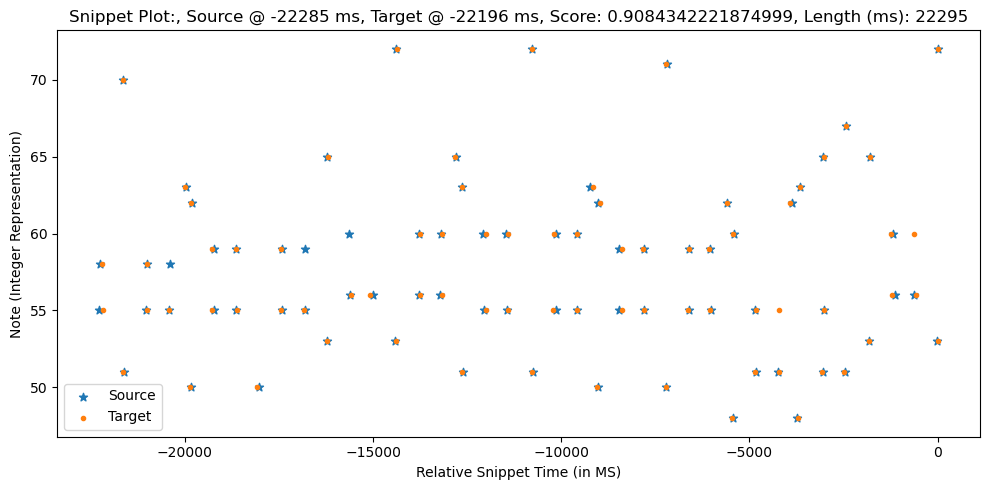

Scores: [ 0.815   0.735   0.955   0.9625  0.9675  0.9375  0.975   0.925   0.9425
  0.9625  0.9     0.91    0.9725  0.9375  0.87    0.945   0.96    0.9225
  0.9875  0.975   0.9375  0.82    0.9425  0.9375  0.96    0.9175  0.9225
  0.95    0.9275  0.9125  0.995   0.84    0.86    0.925   0.925   0.9925
  0.985   0.815   0.855   0.955   1.      0.8475  0.945   0.9     0.8075
  0.7975  0.9275  0.95    0.9725  0.9775  0.97    0.9925  0.9     0.9575
  0.9725  0.94    0.925   0.88    0.96    0.9575 -0.      0.8325  0.9325
  0.975   0.965   0.9425  0.97    0.9675  0.9725  0.995   0.985   0.8775
  0.8225 -0.      0.8575  0.9725  0.98  ]
Sequence1:  [[-22190     58     26]
 [-22172     55     35]
 [-21645     70     53]
 [-21631     51     51]
 [-21001     58     33]
 [-20992     55     42]
 [-20420     55     48]
 [-19994     63     49]
 [-19851     50     44]
 [-19831     62     54]
 [-19272     55     44]
 [-19270     59     42]
 [-18628     59     41]
 [-18608     55     45]
 [-18076     50   

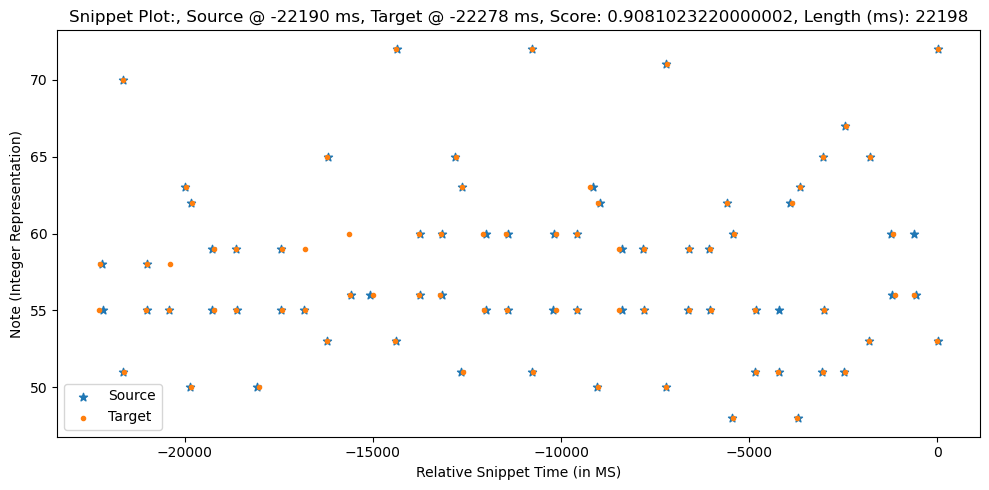

0.9084342221874999
Scores: [ 0.7325  0.8125  0.9575  0.965   0.935   0.965   0.9775 -0.      0.9275
  0.945   0.965   0.9125  0.9025  0.97    0.935   0.8725  0.9625  0.9475
 -0.      0.925   0.99    0.9725 -0.      0.935   0.8225  0.94    0.935
  0.915   0.9575  0.92    0.9475  0.93    0.9925  0.915   0.8375  0.8575
  0.9225  0.9225  0.99    0.9875  0.8175  0.8575  0.9525  0.9975  0.845
  0.9475  0.8975  0.805   0.795   0.93    0.9525  0.975   0.98    0.995
  0.9725  0.9025  0.96    0.975   0.9425  0.9275  0.9575  0.8825  0.955
  0.835   0.93    0.9725  0.94    0.9675  0.9675  0.97    0.975   0.9975
  0.9825  0.88    0.825   0.855   0.9775  0.975   0.9925  0.9275  0.8375
  0.995   0.9725  0.965   0.9725  0.99    0.9075]
Sequence1:  [[-24627     55     49]
 [-24613     58     44]
 [-23976     70     58]
 [-23965     51     46]
 [-23366     55     45]
 [-23363     58     32]
 [-22759     55     48]
 [-22747     58     39]
 [-22313     63     52]
 [-22177     50     42]
 [-22165     62   

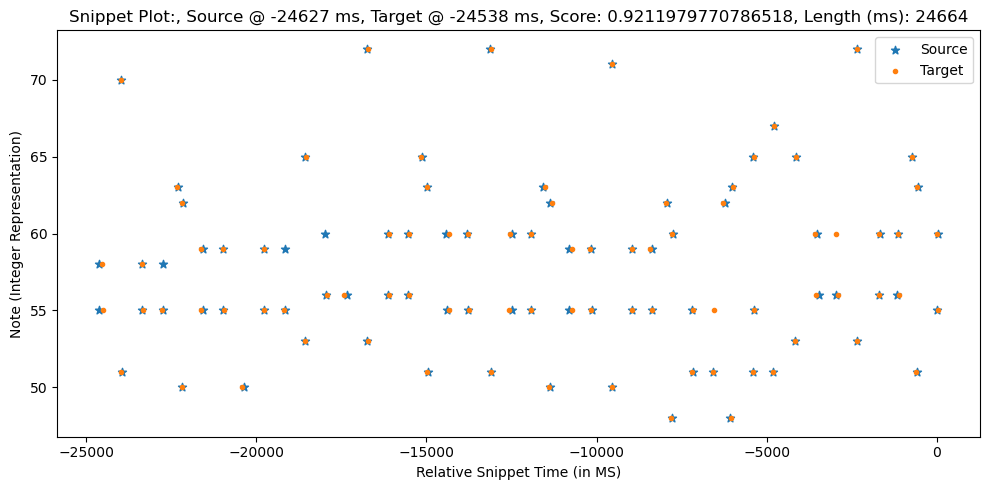

Scores: [ 0.815   0.735   0.955   0.9625  0.9675  0.9375  0.975   0.925   0.9425
  0.9625  0.9     0.91    0.9725  0.9375  0.87    0.945   0.96    0.9225
  0.9875  0.975   0.9375  0.82    0.9425  0.9375  0.96    0.9175  0.9225
  0.95    0.9275  0.9125  0.995   0.84    0.86    0.925   0.925   0.9925
  0.985   0.815   0.855   0.955   1.      0.8475  0.945   0.9     0.8075
  0.7975  0.9275  0.95    0.9725  0.9775  0.97    0.9925  0.9     0.9575
  0.9725  0.94    0.925   0.88    0.96    0.9575 -0.      0.8325  0.9325
  0.975   0.965   0.9425  0.97    0.9675  0.9725  0.995   0.985   0.8775
  0.8225 -0.      0.8575  0.9725  0.98    0.995   0.925   0.9925  0.84
  0.97    0.9625  0.97    0.905   0.9925]
Sequence1:  [[-24559     58     26]
 [-24541     55     35]
 [-24014     70     53]
 [-24000     51     51]
 [-23370     58     33]
 [-23361     55     42]
 [-22789     55     48]
 [-22363     63     49]
 [-22220     50     44]
 [-22200     62     54]
 [-21641     55     44]
 [-21639     59    

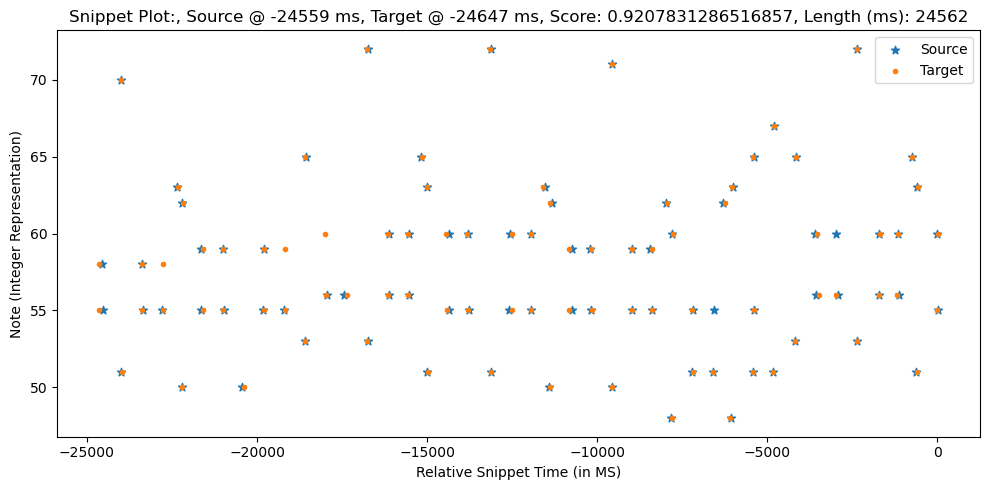

0.9211979770786518
Scores: [ 0.7275  0.8075  0.9625  0.97    0.93    0.96    0.9825 -0.      0.9325
  0.95    0.97    0.9175  0.9075  0.965   0.93    0.8775  0.9675  0.9525
 -0.      0.93    0.995   0.9675 -0.      0.93    0.8275  0.935   0.93
  0.91    0.9525  0.915   0.9425  0.935   0.9875  0.92    0.8325  0.8525
  0.9175  0.9175  0.985   0.9925  0.8225  0.8625  0.9475  0.9925  0.84
  0.9525  0.8925  0.8     0.79    0.935   0.9575  0.98    0.985   1.
  0.9775  0.9075  0.965   0.98    0.9475  0.9325  0.9525  0.8875  0.95
  0.84    0.925   0.9675  0.935   0.9725  0.9625  0.975   0.98    0.9975
  0.9775  0.885   0.83    0.85    0.9725  0.98    0.9875  0.9325  0.8325
  1.      0.9775  0.97    0.9775  0.985   0.9125  0.9775  0.84    0.9825
  0.995   0.9325  0.9375]
Sequence1:  [[-26512     55     49]
 [-26498     58     44]
 [-25861     70     58]
 [-25850     51     46]
 [-25251     55     45]
 [-25248     58     32]
 [-24644     55     48]
 [-24632     58     39]
 [-24198     63     52]

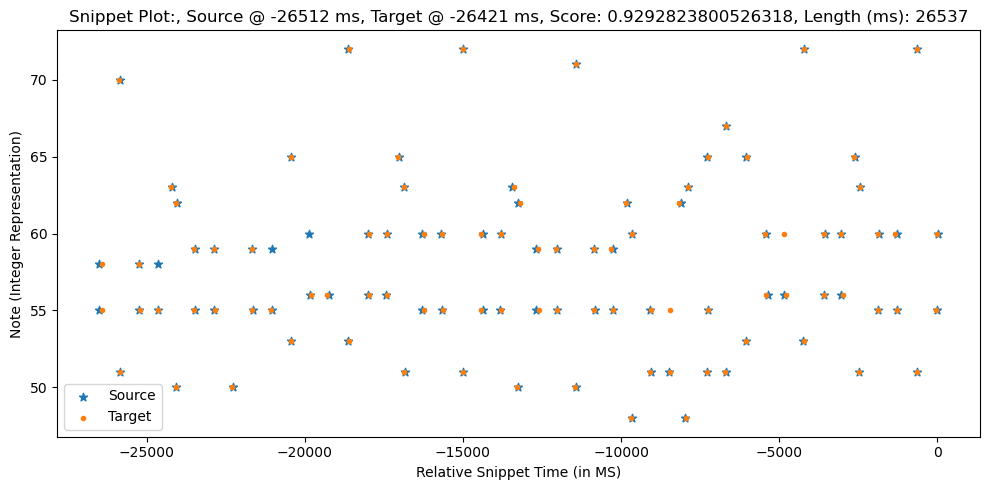

Scores: [ 0.8075  0.7275  0.9625  0.97    0.96    0.93    0.9825  0.9325  0.95
  0.97    0.9075  0.9175  0.965   0.93    0.8775  0.9525  0.9675  0.93
  0.995   0.9675  0.93    0.8275  0.935   0.93    0.9525  0.91    0.915
  0.9425  0.935   0.92    0.9875  0.8325  0.8525  0.9175  0.9175  0.985
  0.9925  0.8225  0.8625  0.9475  0.9925  0.84    0.9525  0.8925  0.8
  0.79    0.935   0.9575  0.98    0.985   0.9775  1.      0.9075  0.965
  0.98    0.9475  0.9325  0.8875  0.9525  0.95   -0.      0.84    0.925
  0.9675  0.9725  0.935   0.9625  0.975   0.98    0.9975  0.9775  0.885
  0.83   -0.      0.85    0.98    0.9725  0.9875  0.9325  1.      0.8325
  0.9775  0.97    0.9775  0.9125  0.985   0.84    0.9775  0.995   0.9825
  0.9325  0.9375]
Sequence1:  [[-26446     58     26]
 [-26428     55     35]
 [-25901     70     53]
 [-25887     51     51]
 [-25257     58     33]
 [-25248     55     42]
 [-24676     55     48]
 [-24250     63     49]
 [-24107     50     44]
 [-24087     62     54]
 [-2

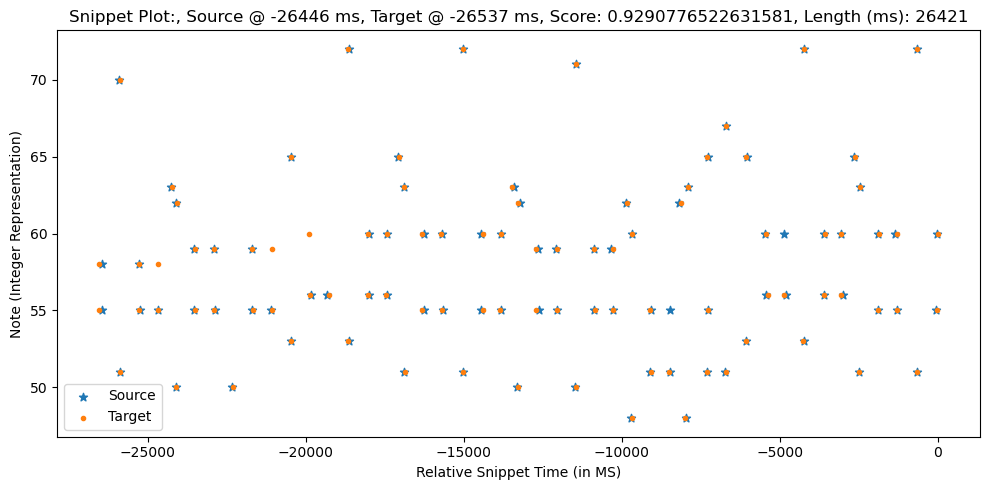

0.9292823800526318
Scores: [ 0.7225  0.8025  0.9675  0.975   0.925   0.955   0.9875 -0.      0.9375
  0.955   0.975   0.9225  0.9125  0.96    0.925   0.8825  0.9725  0.9575
 -0.      0.935   1.      0.9625 -0.      0.925   0.8325  0.93    0.925
  0.905   0.9475  0.91    0.9375  0.94    0.9825  0.925   0.8275  0.8475
  0.9125  0.9125  0.98    0.9975  0.8275  0.8675  0.9425  0.9875  0.835
  0.9575  0.8875  0.795   0.785   0.94    0.9625  0.985   0.99    0.995
  0.9825  0.9125  0.97    0.985   0.9525  0.9375  0.9475  0.8925  0.945
  0.845   0.92    0.9625  0.93    0.9775  0.9575  0.98    0.985   0.9925
  0.9725  0.89    0.835   0.845   0.9675  0.985   0.9825  0.9375  0.8275
  0.995   0.9825  0.975   0.9825  0.98    0.9175  0.9825  0.845   0.9775
  0.99    0.9375  0.9425 -0.      0.895   0.89    0.765   0.9075  0.995
  0.9725  0.98    0.9325]
Sequence1:  [[-28854     55     49]
 [-28840     58     44]
 [-28203     70     58]
 [-28192     51     46]
 [-27593     55     45]
 [-27590     58  

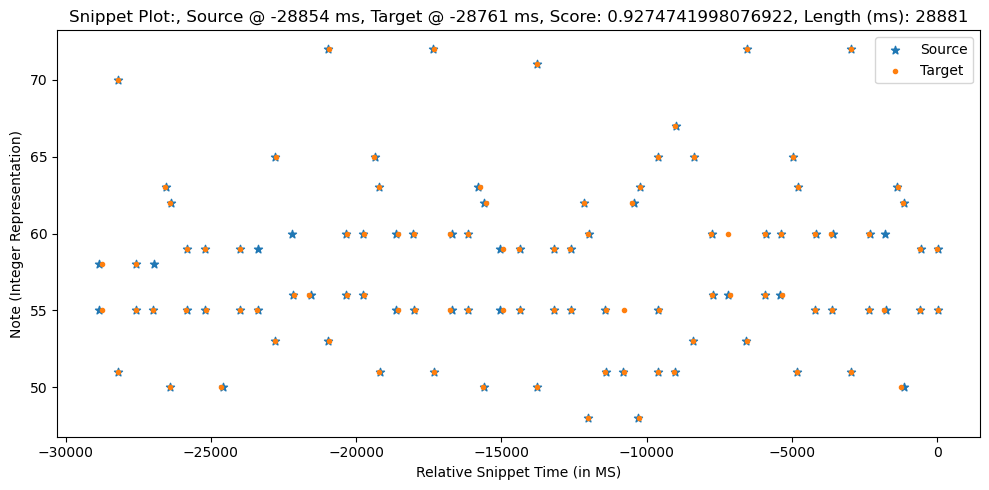

Scores: [ 0.8025  0.7225  0.9675  0.975   0.955   0.925   0.9875  0.9375  0.955
  0.975   0.9125  0.9225  0.96    0.925   0.8825  0.9575  0.9725  0.935
  1.      0.9625  0.925   0.8325  0.93    0.925   0.9475  0.905   0.91
  0.9375  0.94    0.925   0.9825  0.8275  0.8475  0.9125  0.9125  0.98
  0.9975  0.8275  0.8675  0.9425  0.9875  0.835   0.9575  0.8875  0.795
  0.785   0.94    0.9625  0.985   0.99    0.9825  0.995   0.9125  0.97
  0.985   0.9525  0.9375  0.8925  0.9475  0.945  -0.      0.845   0.92
  0.9625  0.9775  0.93    0.9575  0.98    0.985   0.9925  0.9725  0.89
  0.835  -0.      0.845   0.985   0.9675  0.9825  0.9375  0.995   0.8275
  0.9825  0.975   0.9825  0.9175  0.98    0.845   0.9825  0.99    0.9775
  0.9375  0.9425  0.895   0.89    0.765   0.9075  0.995   0.9725  0.9325
  0.98  ]
Sequence1:  [[-28780     58     26]
 [-28762     55     35]
 [-28235     70     53]
 [-28221     51     51]
 [-27591     58     33]
 [-27582     55     42]
 [-27010     55     48]
 [-26584    

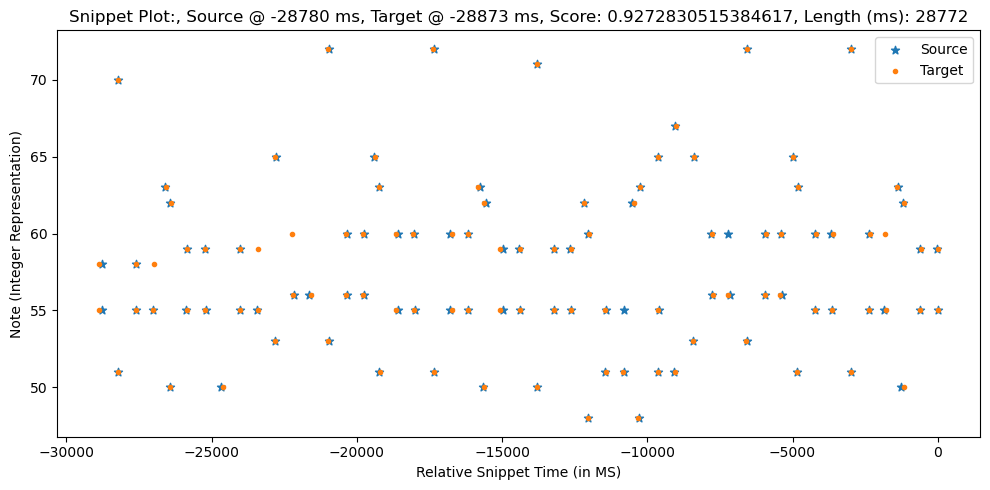

0.9274741998076922
Scores: [ 0.7175  0.7975  0.9725  0.98    0.92    0.95    0.9925 -0.      0.9425
  0.96    0.98    0.9275  0.9175  0.955   0.92    0.8875  0.9775  0.9625
 -0.      0.94    0.995   0.9575 -0.      0.92    0.8375  0.925   0.92
  0.9     0.9425  0.905   0.9325  0.945   0.9775  0.93    0.8225  0.8425
  0.9075  0.9075  0.975   0.9975  0.8325  0.8725  0.9375  0.9825  0.83
  0.9625  0.8825  0.79    0.78    0.945   0.9675  0.99    0.995   0.99
  0.9875  0.9175  0.975   0.99    0.9575  0.9425  0.9425  0.8975  0.94
  0.85    0.915   0.9575  0.925   0.9825  0.9525  0.985   0.99    0.9875
  0.9675  0.895   0.84    0.84    0.9625  0.99    0.9775  0.9425  0.8225
  0.99    0.9875  0.98    0.9875  0.975   0.9225  0.9875  0.85    0.9725
  0.985   0.9425  0.9475 -0.      0.9     0.885   0.77    0.9125  0.99
  0.9775  0.985   0.9375  0.96    0.9075  0.9     0.875   0.89    0.89  ]
Sequence1:  [[-30646     55     49]
 [-30632     58     44]
 [-29995     70     58]
 [-29984     51     46

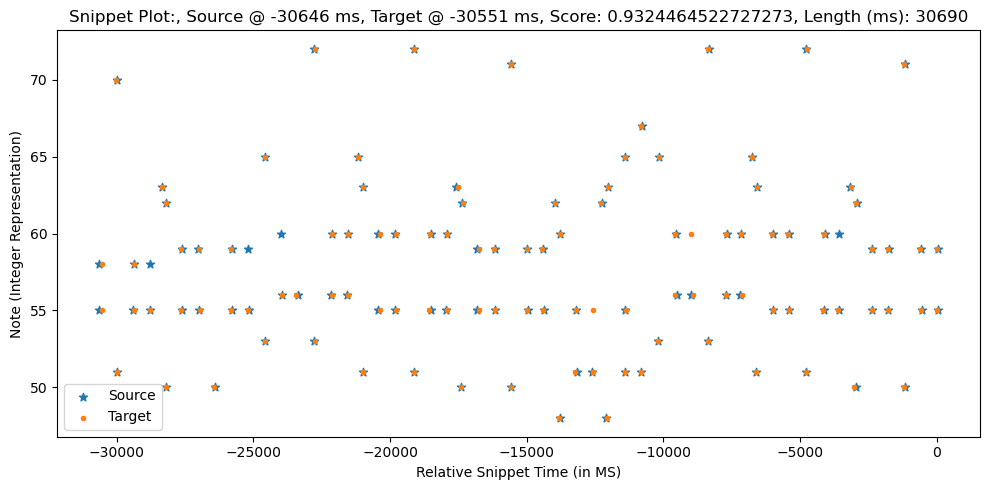

Scores: [ 0.7975  0.7175  0.9725  0.98    0.95    0.92    0.9925  0.9425  0.96
  0.98    0.9175  0.9275  0.955   0.92    0.8875  0.9625  0.9775  0.94
  0.995   0.9575  0.92    0.8375  0.925   0.92    0.9425  0.9     0.905
  0.9325  0.945   0.93    0.9775  0.8225  0.8425  0.9075  0.9075  0.975
  0.9975  0.8325  0.8725  0.9375  0.9825  0.83    0.9625  0.8825  0.79
  0.78    0.945   0.9675  0.99    0.995   0.9875  0.99    0.9175  0.975
  0.99    0.9575  0.9425  0.8975  0.9425  0.94   -0.      0.85    0.915
  0.9575  0.9825  0.925   0.9525  0.985   0.99    0.9875  0.9675  0.895
  0.84   -0.      0.84    0.99    0.9625  0.9775  0.9425  0.99    0.8225
  0.9875  0.98    0.9875  0.9225  0.975   0.85    0.9875  0.985   0.9725
  0.9425  0.9475  0.9     0.885   0.77    0.9125  0.99    0.9775  0.9375
  0.985   0.96    0.9075  0.9     0.875   0.89    0.89  ]
Sequence1:  [[-30595     58     26]
 [-30577     55     35]
 [-30050     70     53]
 [-30036     51     51]
 [-29406     58     33]
 [-29397  

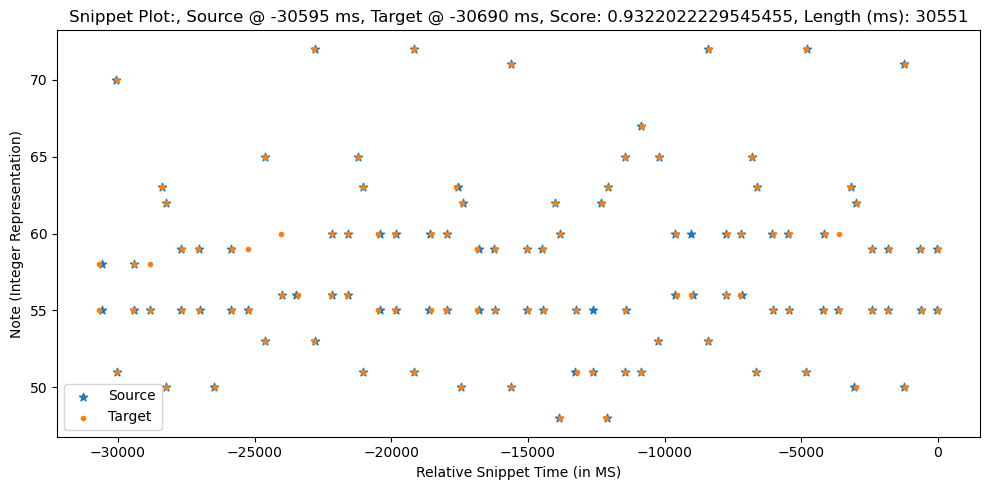

0.9324464522727273
Scores: [ 0.7175  0.7975  0.9725  0.98    0.92    0.95    0.9925 -0.      0.9425
  0.96    0.98    0.9275  0.9175  0.955   0.92    0.8875  0.9775  0.9625
 -0.      0.94    0.995   0.9575 -0.      0.92    0.8375  0.925   0.92
  0.9     0.9425  0.905   0.9325  0.945   0.9775  0.93    0.8225  0.8425
  0.9075  0.9075  0.975   0.9975  0.8325  0.8725  0.9375  0.9825  0.83
  0.9625  0.8825  0.79    0.78    0.945   0.9675  0.99    0.995   0.99
  0.9875  0.9175  0.975   0.99    0.9575  0.9425  0.9425  0.8975  0.94
  0.85    0.915   0.9575  0.925   0.9825  0.9525  0.985   0.99    0.9875
  0.9675  0.895   0.84    0.84    0.9625  0.99    0.9775  0.9425  0.8225
  0.99    0.9875  0.98    0.9875  0.975   0.9225  0.9875  0.85    0.9725
  0.985   0.9425  0.9475 -0.      0.9     0.885   0.77    0.9125  0.99
  0.9775  0.985   0.9375  0.96    0.9075  0.9     0.875   0.89    0.89
  0.8625  0.79    0.9     0.97    0.9875  0.9325  0.975 ]
Sequence1:  [[-32472     55     49]
 [-32458     58

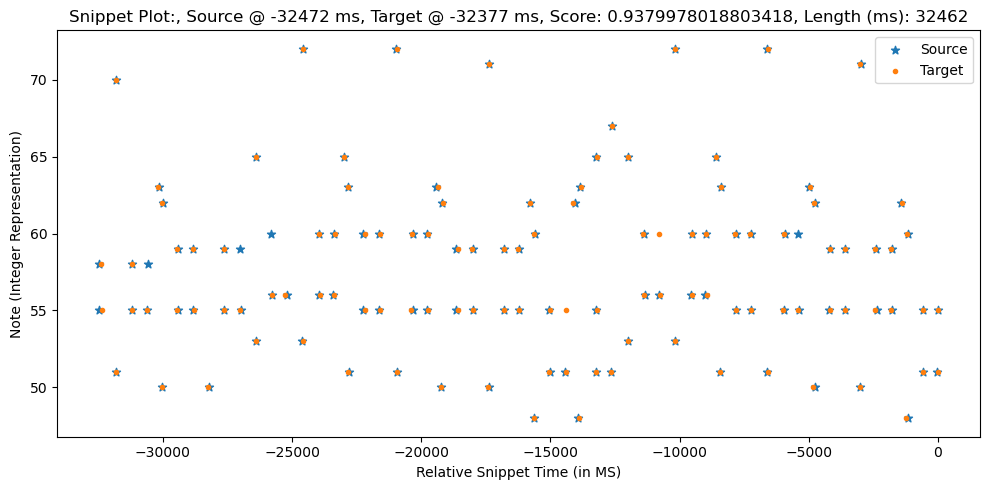

Scores: [ 0.7975  0.7175  0.9725  0.98    0.95    0.92    0.9925  0.9425  0.96
  0.98    0.9175  0.9275  0.955   0.92    0.8875  0.9625  0.9775  0.94
  0.995   0.9575  0.92    0.8375  0.925   0.92    0.9425  0.9     0.905
  0.9325  0.945   0.93    0.9775  0.8225  0.8425  0.9075  0.9075  0.975
  0.9975  0.8325  0.8725  0.9375  0.9825  0.83    0.9625  0.8825  0.79
  0.78    0.945   0.9675  0.99    0.995   0.9875  0.99    0.9175  0.975
  0.99    0.9575  0.9425  0.8975  0.9425  0.94   -0.      0.85    0.915
  0.9575  0.9825  0.925   0.9525  0.985   0.99    0.9875  0.9675  0.895
  0.84   -0.      0.84    0.99    0.9625  0.9775  0.9425  0.99    0.8225
  0.9875  0.98    0.9875  0.9225  0.975   0.85    0.9875  0.985   0.9725
  0.9425  0.9475  0.9     0.885   0.77    0.9125  0.99    0.9775  0.9375
  0.985   0.96    0.9075  0.9     0.875   0.89    0.89    0.8625  0.79
  0.9     0.97    0.9875  0.9325  0.975 ]
Sequence1:  [[-32367     58     26]
 [-32349     55     35]
 [-31822     70     53]
 [-

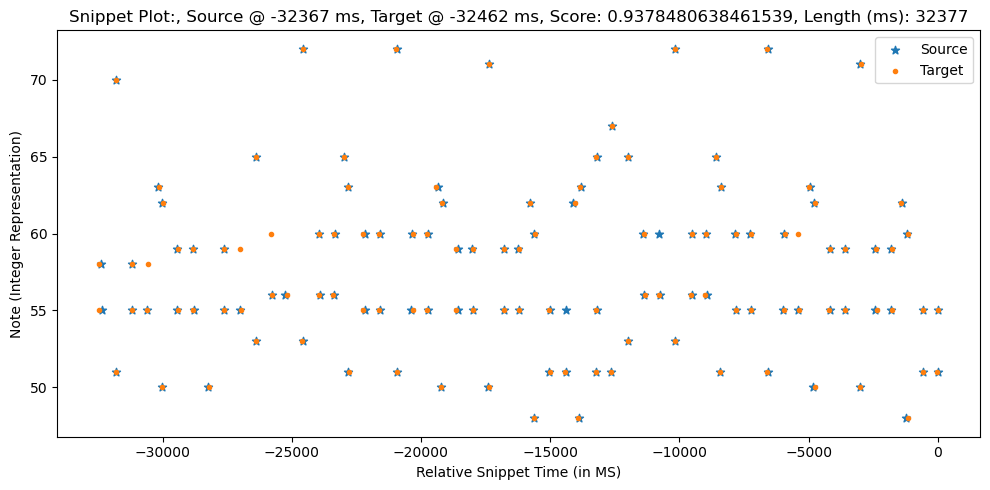

0.9379978018803418
Scores: [ 0.7125  0.7925  0.9775  0.985   0.915   0.945   0.9975 -0.      0.9475
  0.965   0.985   0.9325  0.9225  0.95    0.915   0.8925  0.9825  0.9675
 -0.      0.945   0.99    0.9525 -0.      0.915   0.8425  0.92    0.915
  0.895   0.9375  0.9     0.9275  0.95    0.9725  0.935   0.8175  0.8375
  0.9025  0.9025  0.97    0.9925  0.8375  0.8775  0.9325  0.9775  0.825
  0.9675  0.8775  0.785   0.775   0.95    0.9725  0.995   1.      0.985
  0.9925  0.9225  0.98    0.995   0.9625  0.9475  0.9375  0.9025  0.935
  0.855   0.91    0.9525  0.92    0.9875  0.9475  0.99    0.995   0.9825
  0.9625  0.9     0.845   0.835   0.9575  0.995   0.9725  0.9475  0.8175
  0.985   0.9925  0.985   0.9925  0.97    0.9275  0.9925  0.855   0.9675
  0.98    0.9475  0.9525 -0.      0.905   0.88    0.775   0.9175  0.985
  0.9825  0.99    0.9425  0.965   0.9125  0.905   0.88    0.895   0.895
  0.8575  0.795   0.905   0.975   0.9925  0.9275  0.97    0.9025  0.845
  0.8825  0.8825  0.925   0.945

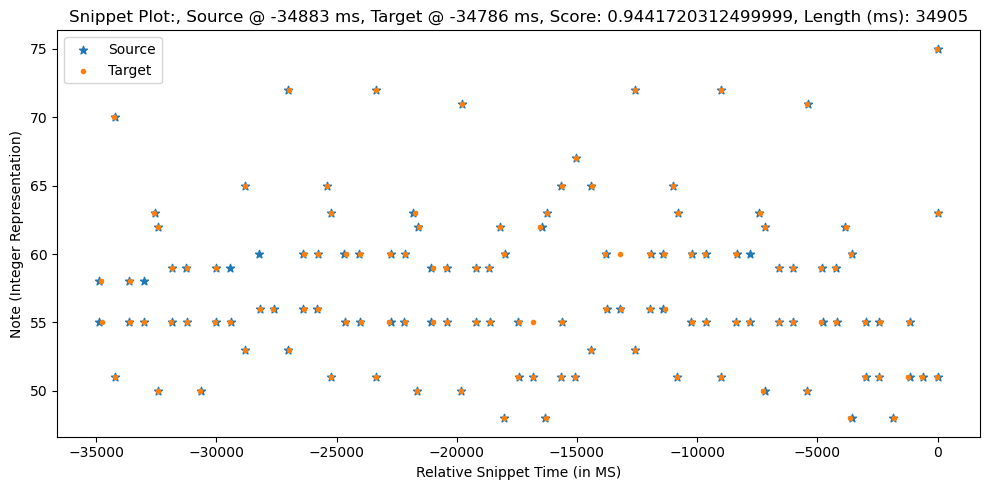

Scores: [ 0.7925  0.7125  0.9775  0.985   0.945   0.915   0.9975  0.9475  0.965
  0.985   0.9225  0.9325  0.95    0.915   0.8925  0.9675  0.9825  0.945
  0.99    0.9525  0.915   0.8425  0.92    0.915   0.9375  0.895   0.9
  0.9275  0.95    0.935   0.9725  0.8175  0.8375  0.9025  0.9025  0.97
  0.9925  0.8375  0.8775  0.9325  0.9775  0.825   0.9675  0.8775  0.785
  0.775   0.95    0.9725  0.995   1.      0.9925  0.985   0.9225  0.98
  0.995   0.9625  0.9475  0.9025  0.9375  0.935  -0.      0.855   0.91
  0.9525  0.9875  0.92    0.9475  0.99    0.995   0.9825  0.9625  0.9
  0.845  -0.      0.835   0.995   0.9575  0.9725  0.9475  0.985   0.8175
  0.9925  0.985   0.9925  0.9275  0.97    0.855   0.9925  0.98    0.9675
  0.9475  0.9525  0.905   0.88    0.775   0.9175  0.985   0.9825  0.9425
  0.99    0.965   0.9125  0.905   0.88    0.895   0.895   0.8575  0.795
  0.905   0.975   0.9925  0.9275  0.97    0.9025  0.845   0.8825  0.8825
  0.925   0.945   0.945 ]
Sequence1:  [[-34808     58     2

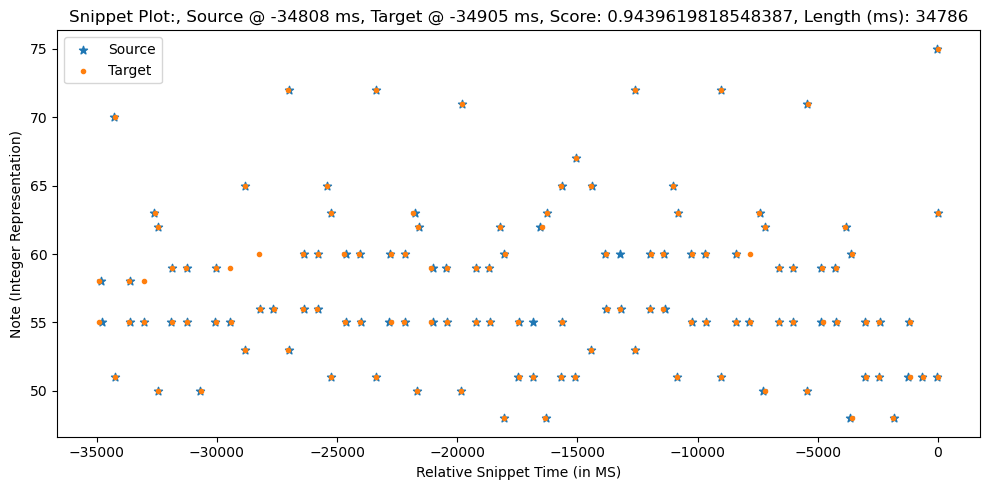

0.9441720312499999
Scores: [ 0.715   0.795   0.975   0.9825  0.9175  0.9475  0.995  -0.      0.945
  0.9625  0.9825  0.93    0.92    0.9525  0.9175  0.89    0.98    0.965
 -0.      0.9425  0.9925  0.955  -0.      0.9175  0.84    0.9225  0.9175
  0.8975  0.94    0.9025  0.93    0.9475  0.975   0.9325  0.82    0.84
  0.905   0.905   0.9725  0.995   0.835   0.875   0.935   0.98    0.8275
  0.965   0.88    0.7875  0.7775  0.9475  0.97    0.9925  0.9975  0.9875
  0.99    0.92    0.9775  0.9925  0.96    0.945   0.94    0.9     0.9375
  0.8525  0.9125  0.955   0.9225  0.985   0.95    0.9875  0.9925  0.985
  0.965   0.8975  0.8425  0.8375  0.96    0.9925  0.975   0.945   0.82
  0.9875  0.99    0.9825  0.99    0.9725  0.925   0.99    0.8525  0.97
  0.9825  0.945   0.95   -0.      0.9025  0.8825  0.7725  0.915   0.9875
  0.98    0.9875  0.94    0.9625  0.91    0.9025  0.8775  0.8925  0.8925
  0.86    0.7925  0.9025  0.9725  0.99    0.93    0.9725  0.905   0.8425
  0.88    0.88    0.9225  0.9425 

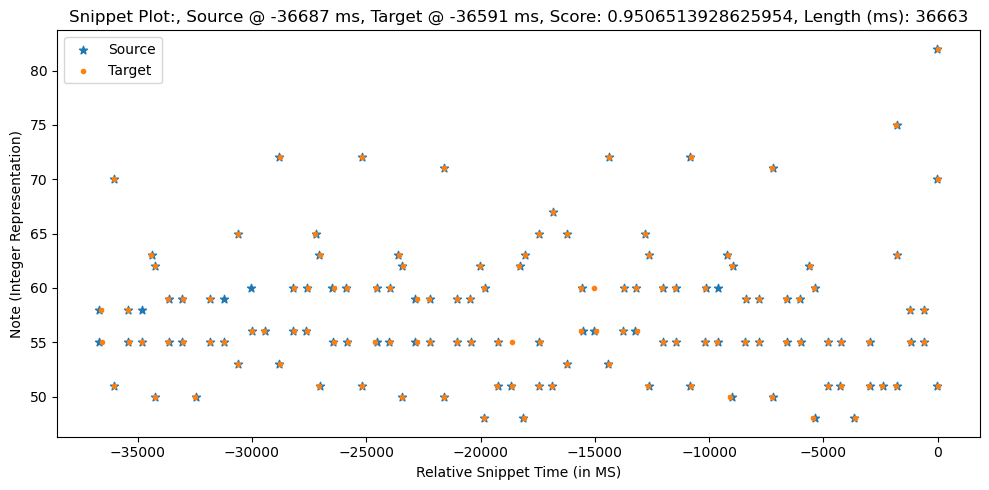

Scores: [ 0.795   0.715   0.975   0.9825  0.9475  0.9175  0.995   0.945   0.9625
  0.9825  0.92    0.93    0.9525  0.9175  0.89    0.965   0.98    0.9425
  0.9925  0.955   0.9175  0.84    0.9225  0.9175  0.94    0.8975  0.9025
  0.93    0.9475  0.9325  0.975   0.82    0.84    0.905   0.905   0.9725
  0.995   0.835   0.875   0.935   0.98    0.8275  0.965   0.88    0.7875
  0.7775  0.9475  0.97    0.9925  0.9975  0.99    0.9875  0.92    0.9775
  0.9925  0.96    0.945   0.9     0.94    0.9375 -0.      0.8525  0.9125
  0.955   0.985   0.9225  0.95    0.9875  0.9925  0.985   0.965   0.8975
  0.8425 -0.      0.8375  0.9925  0.96    0.975   0.945   0.9875  0.82
  0.99    0.9825  0.99    0.925   0.9725  0.8525  0.99    0.9825  0.97
  0.945   0.95    0.9025  0.8825  0.7725  0.915   0.9875  0.98    0.94
  0.9875  0.9625  0.91    0.9025  0.8775  0.8925  0.8925  0.86    0.7925
  0.9025  0.9725  0.99    0.93    0.9725  0.905   0.8425  0.88    0.88
  0.9225  0.9425  0.9425  0.9325  0.965   0.9925  0

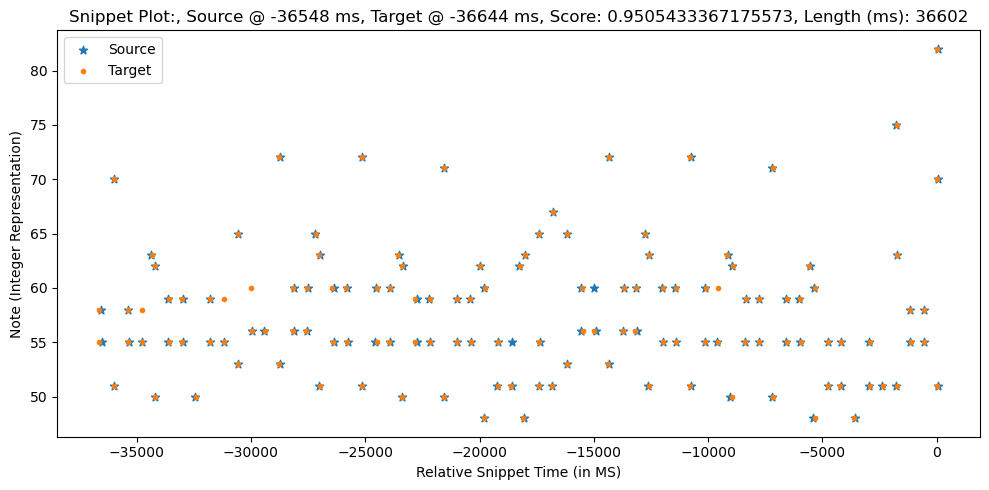

0.9506513928625954
Scores: [ 0.7125  0.7925  0.9775  0.985   0.915   0.945   0.9975 -0.      0.9475
  0.965   0.985   0.9325  0.9225  0.95    0.915   0.8925  0.9825  0.9675
 -0.      0.945   0.99    0.9525 -0.      0.915   0.8425  0.92    0.915
  0.895   0.9375  0.9     0.9275  0.95    0.9725  0.935   0.8175  0.8375
  0.9025  0.9025  0.97    0.9925  0.8375  0.8775  0.9325  0.9775  0.825
  0.9675  0.8775  0.785   0.775   0.95    0.9725  0.995   1.      0.985
  0.9925  0.9225  0.98    0.995   0.9625  0.9475  0.9375  0.9025  0.935
  0.855   0.91    0.9525  0.92    0.9875  0.9475  0.99    0.995   0.9825
  0.9625  0.9     0.845   0.835   0.9575  0.995   0.9725  0.9475  0.8175
  0.985   0.9925  0.985   0.9925  0.97    0.9275  0.9925  0.855   0.9675
  0.98    0.9475  0.9525 -0.      0.905   0.88    0.775   0.9175  0.985
  0.9825  0.99    0.9425  0.965   0.9125  0.905   0.88    0.895   0.895
  0.8575  0.795   0.905   0.975   0.9925  0.9275  0.97    0.9025  0.845
  0.8825  0.8825  0.925   0.945

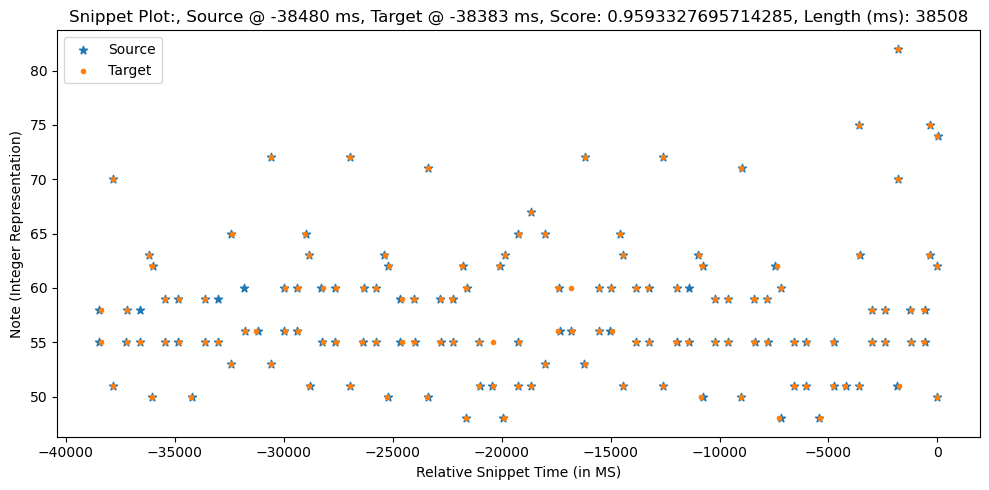

Scores: [ 0.795   0.715   0.975   0.9825  0.9475  0.9175  0.995   0.945   0.9625
  0.9825  0.92    0.93    0.9525  0.9175  0.89    0.965   0.98    0.9425
  0.9925  0.955   0.9175  0.84    0.9225  0.9175  0.94    0.8975  0.9025
  0.93    0.9475  0.9325  0.975   0.82    0.84    0.905   0.905   0.9725
  0.995   0.835   0.875   0.935   0.98    0.8275  0.965   0.88    0.7875
  0.7775  0.9475  0.97    0.9925  0.9975  0.99    0.9875  0.92    0.9775
  0.9925  0.96    0.945   0.9     0.94    0.9375 -0.      0.8525  0.9125
  0.955   0.985   0.9225  0.95    0.9875  0.9925  0.985   0.965   0.8975
  0.8425 -0.      0.8375  0.9925  0.96    0.975   0.945   0.9875  0.82
  0.99    0.9825  0.99    0.925   0.9725  0.8525  0.99    0.9825  0.97
  0.945   0.95    0.9025  0.8825  0.7725  0.915   0.9875  0.98    0.94
  0.9875  0.9625  0.91    0.9025  0.8775  0.8925  0.8925  0.86    0.7925
  0.9025  0.9725  0.99    0.93    0.9725  0.905   0.8425  0.88    0.88
  0.9225  0.9425  0.9425  0.9325  0.965   0.9925  0

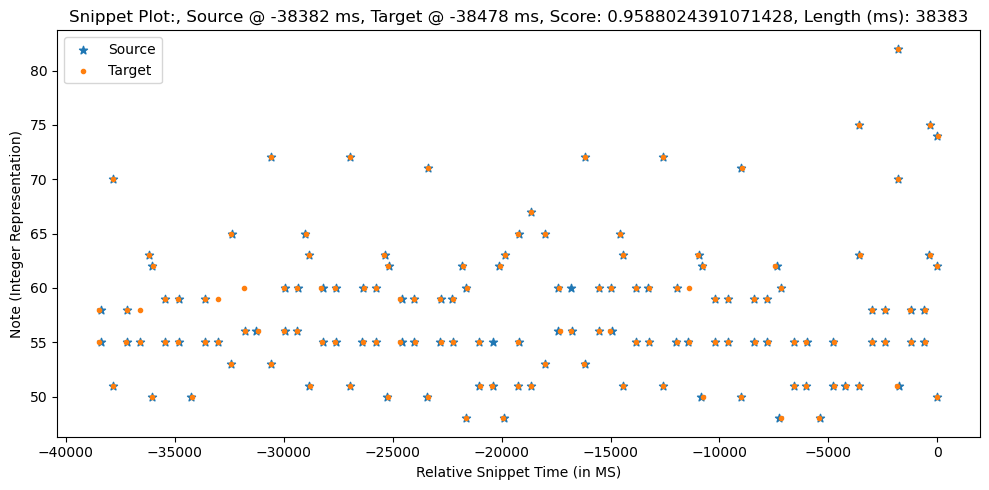

0.9593327695714285
Scores: [ 0.7125  0.7925  0.9775  0.985   0.915   0.945   0.9975 -0.      0.9475
  0.965   0.985   0.9325  0.9225  0.95    0.915   0.8925  0.9825  0.9675
 -0.      0.945   0.99    0.9525 -0.      0.915   0.8425  0.92    0.915
  0.895   0.9375  0.9     0.9275  0.95    0.9725  0.935   0.8175  0.8375
  0.9025  0.9025  0.97    0.9925  0.8375  0.8775  0.9325  0.9775  0.825
  0.9675  0.8775  0.785   0.775   0.95    0.9725  0.995   1.      0.985
  0.9925  0.9225  0.98    0.995   0.9625  0.9475  0.9375  0.9025  0.935
  0.855   0.91    0.9525  0.92    0.9875  0.9475  0.99    0.995   0.9825
  0.9625  0.9     0.845   0.835   0.9575  0.995   0.9725  0.9475  0.8175
  0.985   0.9925  0.985   0.9925  0.97    0.9275  0.9925  0.855   0.9675
  0.98    0.9475  0.9525 -0.      0.905   0.88    0.775   0.9175  0.985
  0.9825  0.99    0.9425  0.965   0.9125  0.905   0.88    0.895   0.895
  0.8575  0.795   0.905   0.975   0.9925  0.9275  0.97    0.9025  0.845
  0.8825  0.8825  0.925   0.945

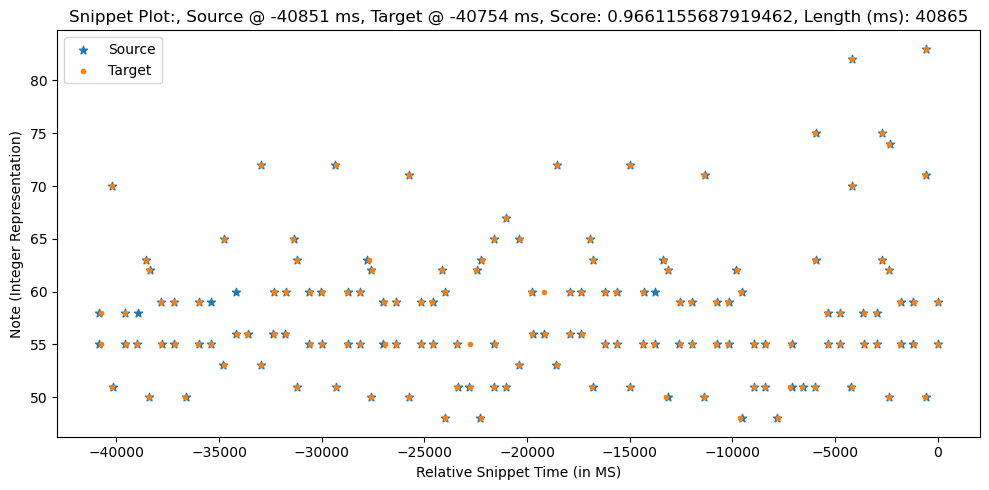

Scores: [ 0.795   0.715   0.975   0.9825  0.9475  0.9175  0.995   0.945   0.9625
  0.9825  0.92    0.93    0.9525  0.9175  0.89    0.965   0.98    0.9425
  0.9925  0.955   0.9175  0.84    0.9225  0.9175  0.94    0.8975  0.9025
  0.93    0.9475  0.9325  0.975   0.82    0.84    0.905   0.905   0.9725
  0.995   0.835   0.875   0.935   0.98    0.8275  0.965   0.88    0.7875
  0.7775  0.9475  0.97    0.9925  0.9975  0.99    0.9875  0.92    0.9775
  0.9925  0.96    0.945   0.9     0.94    0.9375 -0.      0.8525  0.9125
  0.955   0.985   0.9225  0.95    0.9875  0.9925  0.985   0.965   0.8975
  0.8425 -0.      0.8375  0.9925  0.96    0.975   0.945   0.9875  0.82
  0.99    0.9825  0.99    0.925   0.9725  0.8525  0.99    0.9825  0.97
  0.945   0.95    0.9025  0.8825  0.7725  0.915   0.9875  0.98    0.94
  0.9875  0.9625  0.91    0.9025  0.8775  0.8925  0.8925  0.86    0.7925
  0.9025  0.9725  0.99    0.93    0.9725  0.905   0.8425  0.88    0.88
  0.9225  0.9425  0.9425  0.9325  0.965   0.9925  0

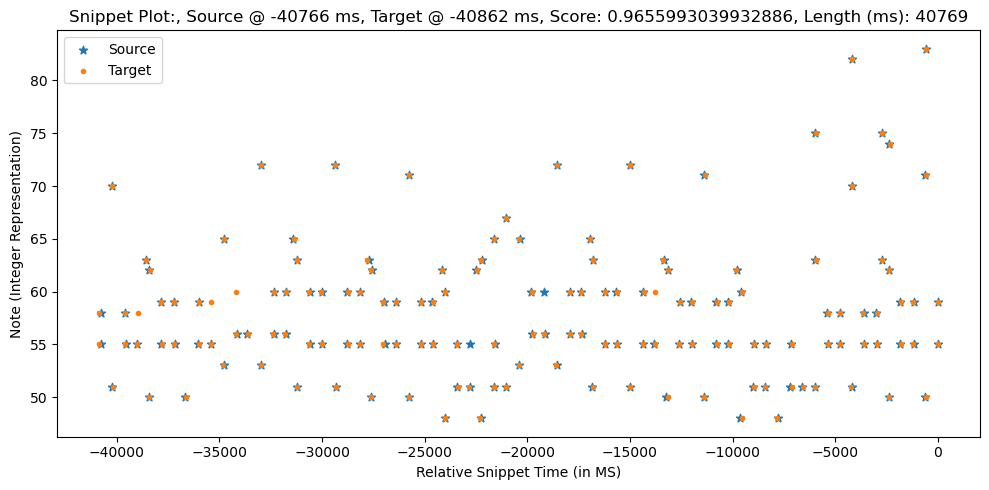

0.9661155687919462
Scores: [ 0.7125  0.7925  0.9775  0.985   0.915   0.945   0.9975 -0.      0.9475
  0.965   0.985   0.9325  0.9225  0.95    0.915   0.8925  0.9825  0.9675
 -0.      0.945   0.99    0.9525 -0.      0.915   0.8425  0.92    0.915
  0.895   0.9375  0.9     0.9275  0.95    0.9725  0.935   0.8175  0.8375
  0.9025  0.9025  0.97    0.9925  0.8375  0.8775  0.9325  0.9775  0.825
  0.9675  0.8775  0.785   0.775   0.95    0.9725  0.995   1.      0.985
  0.9925  0.9225  0.98    0.995   0.9625  0.9475  0.9375  0.9025  0.935
  0.855   0.91    0.9525  0.92    0.9875  0.9475  0.99    0.995   0.9825
  0.9625  0.9     0.845   0.835   0.9575  0.995   0.9725  0.9475  0.8175
  0.985   0.9925  0.985   0.9925  0.97    0.9275  0.9925  0.855   0.9675
  0.98    0.9475  0.9525 -0.      0.905   0.88    0.775   0.9175  0.985
  0.9825  0.99    0.9425  0.965   0.9125  0.905   0.88    0.895   0.895
  0.8575  0.795   0.905   0.975   0.9925  0.9275  0.97    0.9025  0.845
  0.8825  0.8825  0.925   0.945

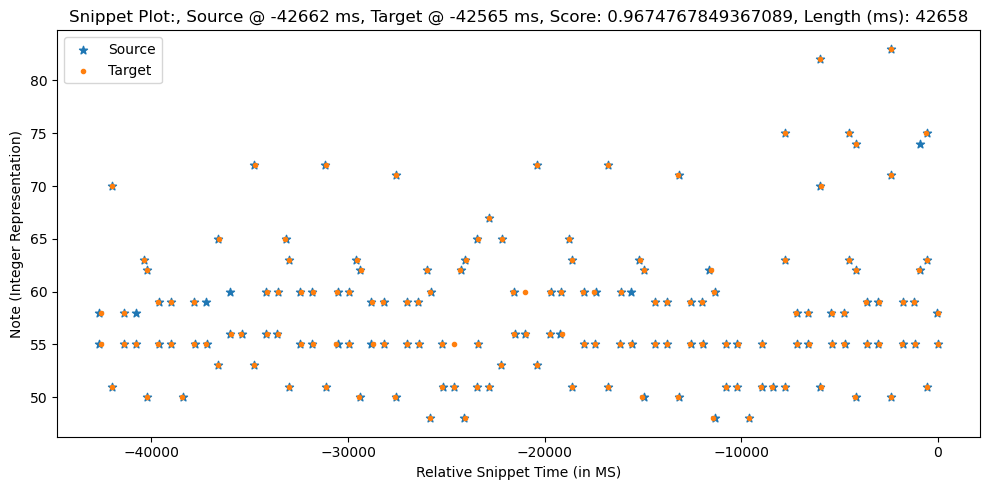

Scores: [ 0.7925  0.7125  0.9775  0.985   0.945   0.915   0.9975  0.9475  0.965
  0.985   0.9225  0.9325  0.95    0.915   0.8925  0.9675  0.9825  0.945
  0.99    0.9525  0.915   0.8425  0.92    0.915   0.9375  0.895   0.9
  0.9275  0.95    0.935   0.9725  0.8175  0.8375  0.9025  0.9025  0.97
  0.9925  0.8375  0.8775  0.9325  0.9775  0.825   0.9675  0.8775  0.785
  0.775   0.95    0.9725  0.995   1.      0.9925  0.985   0.9225  0.98
  0.995   0.9625  0.9475  0.9025  0.9375  0.935  -0.      0.855   0.91
  0.9525  0.9875  0.92    0.9475  0.99    0.995   0.9825  0.9625  0.9
  0.845  -0.      0.835   0.995   0.9575  0.9725  0.9475  0.985   0.8175
  0.9925  0.985   0.9925  0.9275  0.97    0.855   0.9925  0.98    0.9675
  0.9475  0.9525  0.905   0.88    0.775   0.9175  0.985   0.9825  0.9425
  0.99    0.965   0.9125  0.905   0.88    0.895   0.895   0.8575  0.795
  0.905   0.975   0.9925  0.9275  0.97    0.9025  0.845   0.8825  0.8825
  0.925   0.945   0.945   0.935   0.9675  0.995   0.97    0

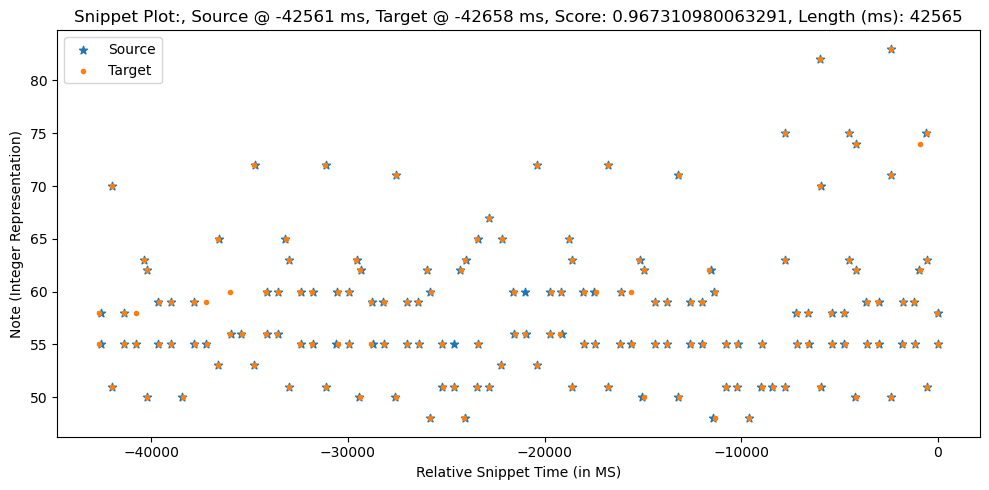

0.9674767849367089
Scores: [ 0.71    0.79    0.98    0.9875  0.9125  0.9425  1.     -0.      0.95
  0.9675  0.9875  0.935   0.925   0.9475  0.9125  0.895   0.985   0.97
 -0.      0.9475  0.9875  0.95   -0.      0.9125  0.845   0.9175  0.9125
  0.8925  0.935   0.8975  0.925   0.9525  0.97    0.9375  0.815   0.835
  0.9     0.9     0.9675  0.99    0.84    0.88    0.93    0.975   0.8225
  0.97    0.875   0.7825  0.7725  0.9525  0.975   0.9975  0.9975  0.9825
  0.995   0.925   0.9825  0.9975  0.965   0.95    0.935   0.905   0.9325
  0.8575  0.9075  0.95    0.9175  0.99    0.945   0.9925  0.9975  0.98
  0.96    0.9025  0.8475  0.8325  0.955   0.9975  0.97    0.95    0.815
  0.9825  0.995   0.9875  0.995   0.9675  0.93    0.995   0.8575  0.965
  0.9775  0.95    0.955  -0.      0.9075  0.8775  0.7775  0.92    0.9825
  0.985   0.9925  0.945   0.9675  0.915   0.9075  0.8825  0.8975  0.8975
  0.855   0.7975  0.9075  0.9775  0.995   0.925   0.9675  0.9     0.8475
  0.885   0.885   0.9275  0.9475 

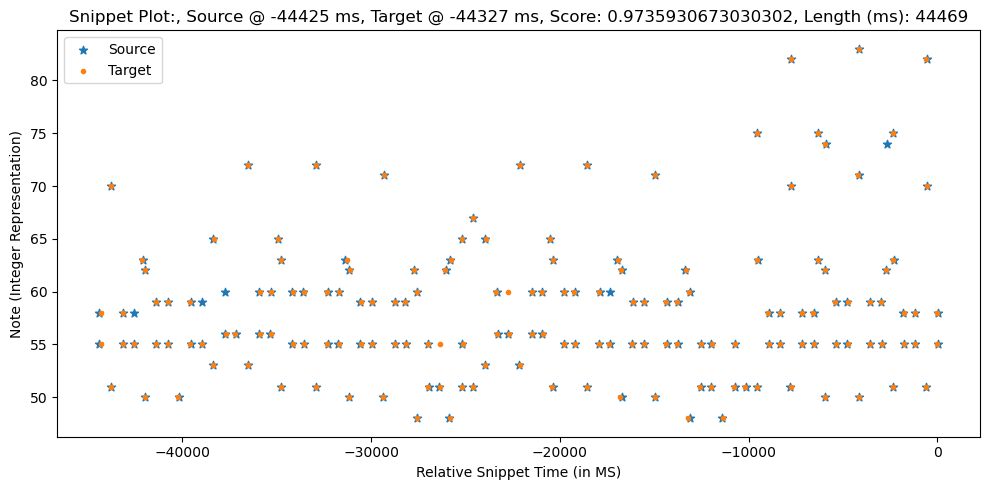

Scores: [ 0.79    0.71    0.98    0.9875  0.9425  0.9125  1.      0.95    0.9675
  0.9875  0.925   0.935   0.9475  0.9125  0.895   0.97    0.985   0.9475
  0.9875  0.95    0.9125  0.845   0.9175  0.9125  0.935   0.8925  0.8975
  0.925   0.9525  0.9375  0.97    0.815   0.835   0.9     0.9     0.9675
  0.99    0.84    0.88    0.93    0.975   0.8225  0.97    0.875   0.7825
  0.7725  0.9525  0.975   0.9975  0.9975  0.995   0.9825  0.925   0.9825
  0.9975  0.965   0.95    0.905   0.935   0.9325 -0.      0.8575  0.9075
  0.95    0.99    0.9175  0.945   0.9925  0.9975  0.98    0.96    0.9025
  0.8475 -0.      0.8325  0.9975  0.955   0.97    0.95    0.9825  0.815
  0.995   0.9875  0.995   0.93    0.9675  0.8575  0.995   0.9775  0.965
  0.95    0.955   0.9075  0.8775  0.7775  0.92    0.9825  0.985   0.945
  0.9925  0.9675  0.915   0.9075  0.8825  0.8975  0.8975  0.855   0.7975
  0.9075  0.9775  0.995   0.925   0.9675  0.9     0.8475  0.885   0.885
  0.9275  0.9475  0.9475  0.9375  0.97    0.997

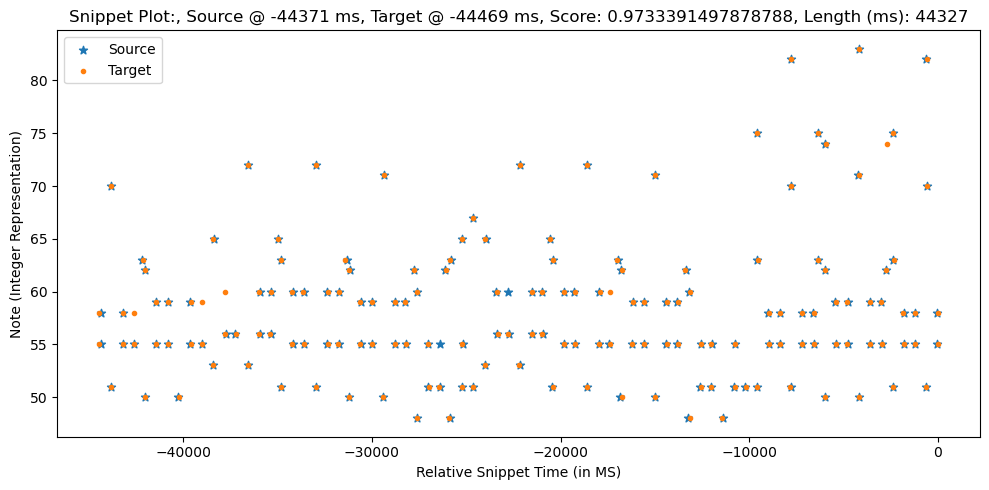

0.9735930673030302
Scores: [ 0.695   0.775   0.995   0.9975  0.8975  0.9275  0.985  -0.      0.965
  0.9825  0.9975  0.95    0.94    0.9325  0.8975  0.91    1.      0.985
 -0.      0.9625  0.9725  0.935  -0.      0.8975  0.86    0.9025  0.8975
  0.8775  0.92    0.8825  0.91    0.9675  0.955   0.9525  0.8     0.82
  0.885   0.885   0.9525  0.975   0.855   0.895   0.915   0.96    0.8075
  0.985   0.86    0.7675  0.7575  0.9675  0.99    0.9875  0.9825  0.9675
  0.99    0.94    0.9975  0.9875  0.98    0.965   0.92    0.92    0.9175
  0.8725  0.8925  0.935   0.9025  0.995   0.93    0.9925  0.9875  0.965
  0.945   0.9175  0.8625  0.8175  0.94    0.9875  0.955   0.965   0.8
  0.9675  0.99    0.9975  0.99    0.9525  0.945   0.99    0.8725  0.95
  0.9625  0.965   0.97   -0.      0.9225  0.8625  0.7925  0.935   0.9675
  1.      0.9925  0.96    0.9825  0.93    0.9225  0.8975  0.9125  0.9125
  0.84    0.8125  0.9225  0.9925  0.99    0.91    0.9525  0.885   0.8625
  0.9     0.9     0.9425  0.9625  

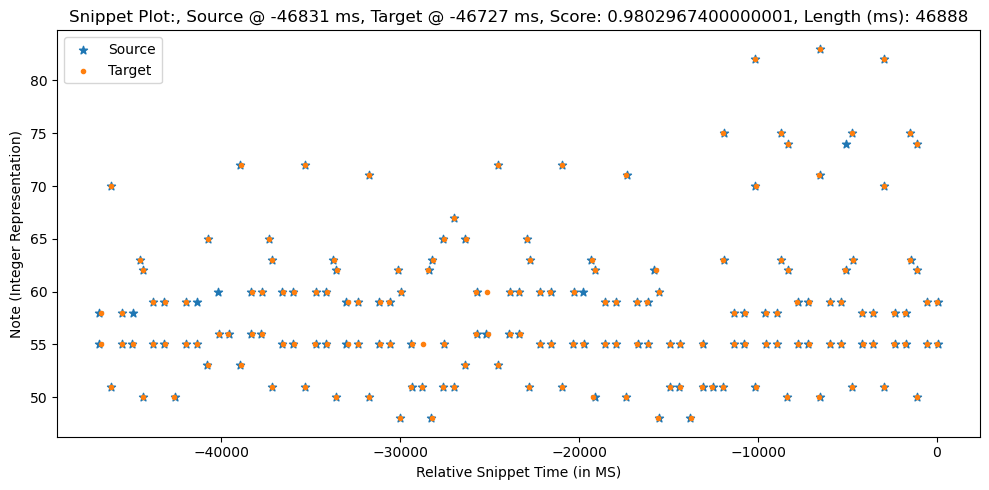

Scores: [ 0.7825  0.7025  0.9875  0.995   0.935   0.905   0.9925  0.9575  0.975
  0.995   0.9325  0.9425  0.94    0.905   0.9025  0.9775  0.9925  0.955
  0.98    0.9425  0.905   0.8525  0.91    0.905   0.9275  0.885   0.89
  0.9175  0.96    0.945   0.9625  0.8075  0.8275  0.8925  0.8925  0.96
  0.9825  0.8475  0.8875  0.9225  0.9675  0.815   0.9775  0.8675  0.775
  0.765   0.96    0.9825  0.995   0.99    0.9975  0.975   0.9325  0.99
  0.995   0.9725  0.9575  0.9125  0.9275  0.925  -0.      0.865   0.9
  0.9425  0.9975  0.91    0.9375  1.      0.995   0.9725  0.9525  0.91
  0.855  -0.      0.825   0.995   0.9475  0.9625  0.9575  0.975   0.8075
  0.9975  0.995   0.9975  0.9375  0.96    0.865   0.9975  0.97    0.9575
  0.9575  0.9625  0.915   0.87    0.785   0.9275  0.975   0.9925  0.9525
  1.      0.975   0.9225  0.915   0.89    0.905   0.905   0.8475  0.805
  0.915   0.985   0.9975  0.9175  0.96    0.8925  0.855   0.8925  0.8925
  0.935   0.955   0.955   0.945   0.9775  0.995   0.96    

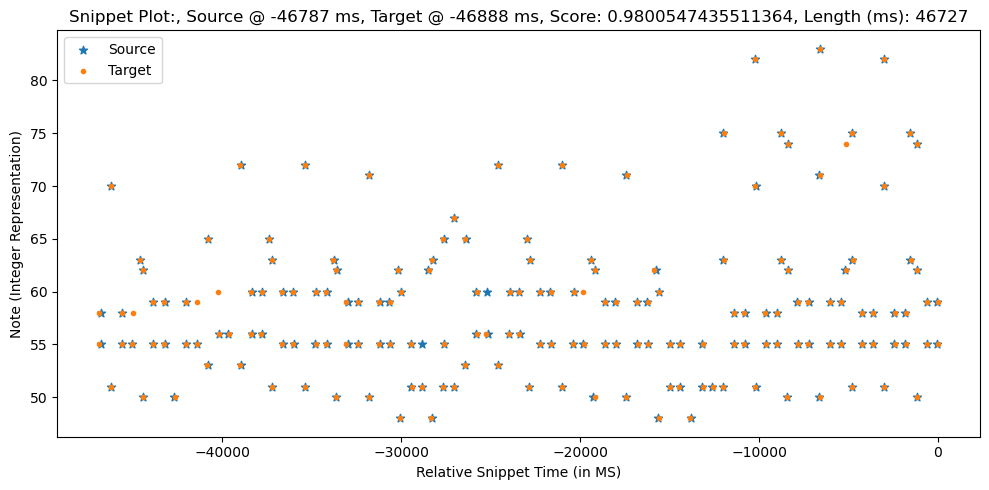

0.9802967400000001
Scores: [ 0.7025  0.7825  0.9875  0.995   0.905   0.935   0.9925 -0.      0.9575
  0.975   0.995   0.9425  0.9325  0.94    0.905   0.9025  0.9925  0.9775
 -0.      0.955   0.98    0.9425 -0.      0.905   0.8525  0.91    0.905
  0.885   0.9275  0.89    0.9175  0.96    0.9625  0.945   0.8075  0.8275
  0.8925  0.8925  0.96    0.9825  0.8475  0.8875  0.9225  0.9675  0.815
  0.9775  0.8675  0.775   0.765   0.96    0.9825  0.995   0.99    0.975
  0.9975  0.9325  0.99    0.995   0.9725  0.9575  0.9275  0.9125  0.925
  0.865   0.9     0.9425  0.91    0.9975  0.9375  1.      0.995   0.9725
  0.9525  0.91    0.855   0.825   0.9475  0.995   0.9625  0.9575  0.8075
  0.975   0.9975  0.995   0.9975  0.96    0.9375  0.9975  0.865   0.9575
  0.97    0.9575  0.9625 -0.      0.915   0.87    0.785   0.9275  0.975
  0.9925  1.      0.9525  0.975   0.9225  0.915   0.89    0.905   0.905
  0.8475  0.805   0.915   0.985   0.9975  0.9175  0.96    0.8925  0.855
  0.8925  0.8925  0.935   0.955

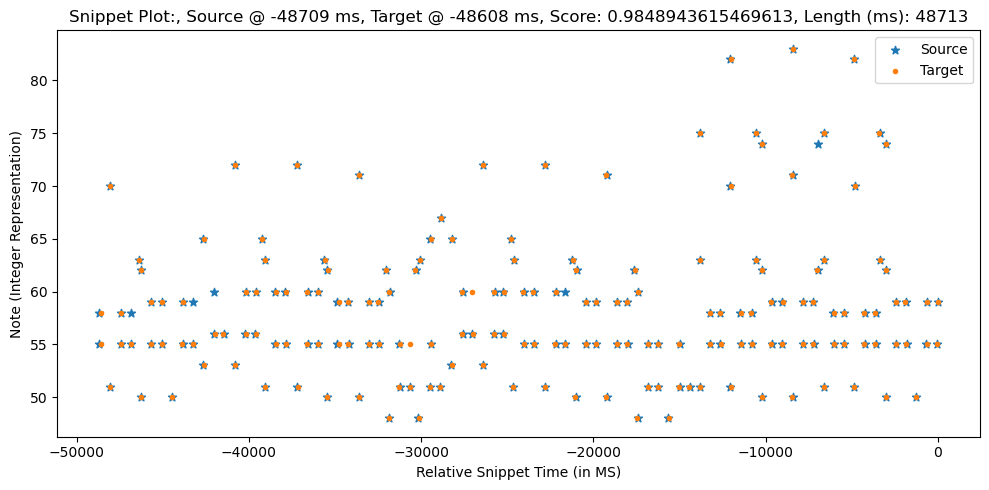

Scores: [ 0.7825  0.7025  0.9875  0.995   0.935   0.905   0.9925  0.9575  0.975
  0.995   0.9325  0.9425  0.94    0.905   0.9025  0.9775  0.9925  0.955
  0.98    0.9425  0.905   0.8525  0.91    0.905   0.9275  0.885   0.89
  0.9175  0.96    0.945   0.9625  0.8075  0.8275  0.8925  0.8925  0.96
  0.9825  0.8475  0.8875  0.9225  0.9675  0.815   0.9775  0.8675  0.775
  0.765   0.96    0.9825  0.995   0.99    0.9975  0.975   0.9325  0.99
  0.995   0.9725  0.9575  0.9125  0.9275  0.925  -0.      0.865   0.9
  0.9425  0.9975  0.91    0.9375  1.      0.995   0.9725  0.9525  0.91
  0.855  -0.      0.825   0.995   0.9475  0.9625  0.9575  0.975   0.8075
  0.9975  0.995   0.9975  0.9375  0.96    0.865   0.9975  0.97    0.9575
  0.9575  0.9625  0.915   0.87    0.785   0.9275  0.975   0.9925  0.9525
  1.      0.975   0.9225  0.915   0.89    0.905   0.905   0.8475  0.805
  0.915   0.985   0.9975  0.9175  0.96    0.8925  0.855   0.8925  0.8925
  0.935   0.955   0.955   0.945   0.9775  0.995   0.96    

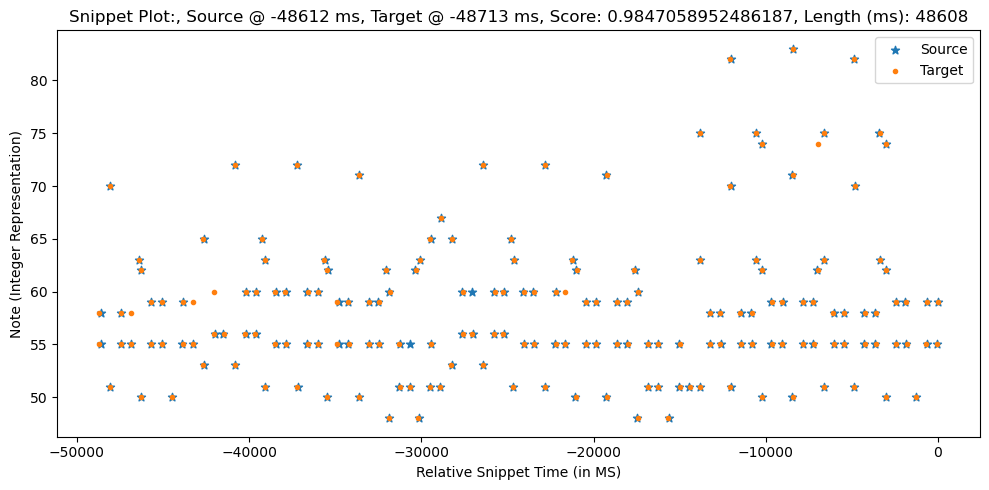

0.9848943615469613
Scores: [ 0.99    0.9975  0.9025  0.9325  0.99   -0.      0.96    0.9775  0.9975
  0.945   0.935   0.9375  0.9025  0.905   0.995   0.98  ]
Sequence1:  [[-4198    70    58]
 [-4187    51    46]
 [-3588    55    45]
 [-3585    58    32]
 [-2981    55    48]
 [-2969    58    39]
 [-2535    63    52]
 [-2399    50    42]
 [-2387    62    56]
 [-1805    59    46]
 [-1803    55    46]
 [-1210    59    42]
 [-1204    55    48]
 [ -595    50    46]
 [    6    59    39]
 [    8    55    44]]
Sequence2:  [[-4202    70    53]
 [-4188    51    51]
 [-3558    58    33]
 [-3549    55    42]
 [-2977    55    48]
 [-2551    63    49]
 [-2408    50    44]
 [-2388    62    54]
 [-1829    55    44]
 [-1827    59    42]
 [-1185    59    41]
 [-1165    55    45]
 [ -633    50    51]
 [    0    55    44]
 [    4    59    40]]
mean_offset1:  8.466666666666667
mean_offset2:  -8.466666666666667
mo:  [4]
Count zeros:  1


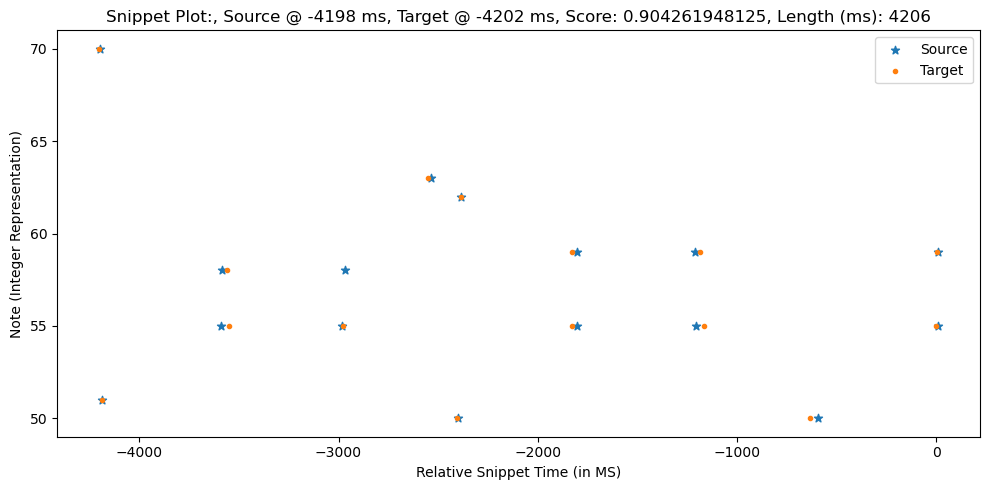

Scores: [0.99   0.9975 0.9325 0.9025 0.99   0.96   0.9775 0.9975 0.935  0.945
 0.9375 0.9025 0.905  0.98   0.995 ]
Sequence1:  [[-4208    70    53]
 [-4194    51    51]
 [-3564    58    33]
 [-3555    55    42]
 [-2983    55    48]
 [-2557    63    49]
 [-2414    50    44]
 [-2394    62    54]
 [-1835    55    44]
 [-1833    59    42]
 [-1191    59    41]
 [-1171    55    45]
 [ -639    50    51]
 [   -6    55    44]
 [   -2    59    40]]
Sequence2:  [[-4204    70    58]
 [-4193    51    46]
 [-3594    55    45]
 [-3591    58    32]
 [-2987    55    48]
 [-2975    58    39]
 [-2541    63    52]
 [-2405    50    42]
 [-2393    62    56]
 [-1811    59    46]
 [-1809    55    46]
 [-1216    59    42]
 [-1210    55    48]
 [ -601    50    46]
 [    0    59    39]
 [    2    55    44]]
mean_offset1:  -2.466666666666667
mean_offset2:  2.466666666666667
mo:  [2]
Count zeros:  0


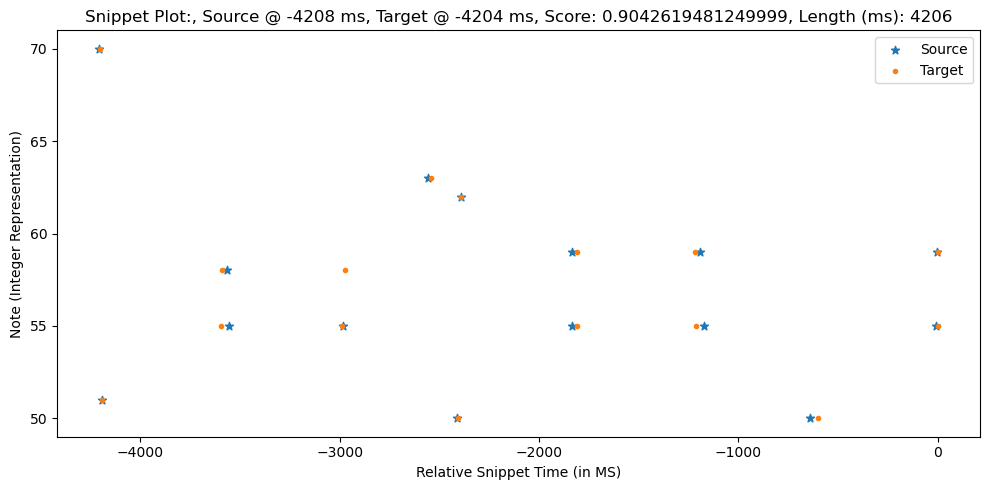

0.904261948125
Scores: [ 0.99    0.9975  0.9025  0.9325  0.99   -0.      0.96    0.9775  0.9975
  0.945   0.935   0.9375  0.9025  0.905   0.995   0.98   -0.      0.9575
  0.9775  0.94   -0.      0.9025  0.855 ]
Sequence1:  [[-6573    70    58]
 [-6562    51    46]
 [-5963    55    45]
 [-5960    58    32]
 [-5356    55    48]
 [-5344    58    39]
 [-4910    63    52]
 [-4774    50    42]
 [-4762    62    56]
 [-4180    59    46]
 [-4178    55    46]
 [-3585    59    42]
 [-3579    55    48]
 [-2970    50    46]
 [-2369    59    39]
 [-2367    55    44]
 [-1761    59    34]
 [-1745    55    41]
 [-1162    53    47]
 [-1159    65    54]
 [ -571    60    34]
 [ -544    56    44]
 [   58    56    45]]
Sequence2:  [[-6577    70    53]
 [-6563    51    51]
 [-5933    58    33]
 [-5924    55    42]
 [-5352    55    48]
 [-4926    63    49]
 [-4783    50    44]
 [-4763    62    54]
 [-4204    55    44]
 [-4202    59    42]
 [-3560    59    41]
 [-3540    55    45]
 [-3008    50    51]
 [-2375 

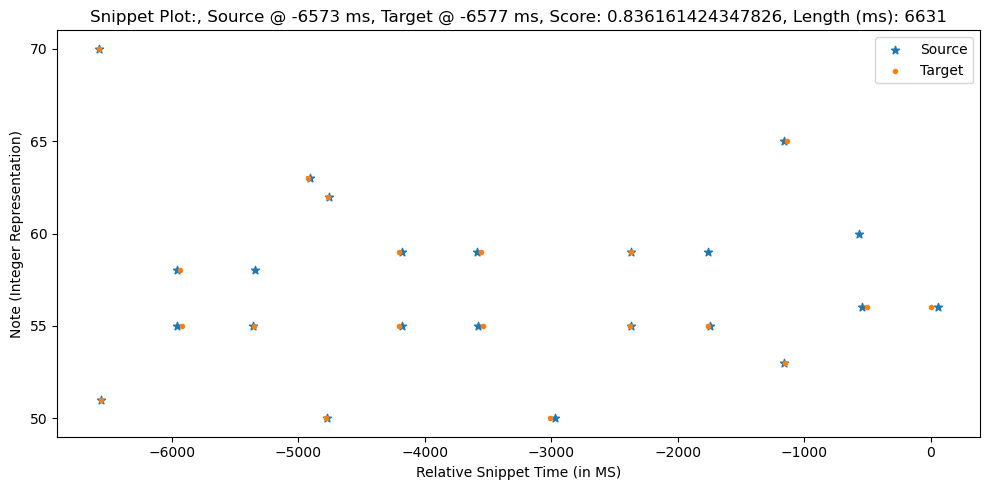

Scores: [0.99   0.9975 0.9325 0.9025 0.99   0.96   0.9775 0.9975 0.935  0.945
 0.9375 0.9025 0.905  0.98   0.995  0.9575 0.9775 0.94   0.9025 0.855 ]
Sequence1:  [[-6635    70    53]
 [-6621    51    51]
 [-5991    58    33]
 [-5982    55    42]
 [-5410    55    48]
 [-4984    63    49]
 [-4841    50    44]
 [-4821    62    54]
 [-4262    55    44]
 [-4260    59    42]
 [-3618    59    41]
 [-3598    55    45]
 [-3066    50    51]
 [-2433    55    44]
 [-2429    59    40]
 [-1820    55    47]
 [-1211    53    43]
 [-1193    65    49]
 [ -563    56    41]
 [  -58    56    41]]
Sequence2:  [[-6631    70    58]
 [-6620    51    46]
 [-6021    55    45]
 [-6018    58    32]
 [-5414    55    48]
 [-5402    58    39]
 [-4968    63    52]
 [-4832    50    42]
 [-4820    62    56]
 [-4238    59    46]
 [-4236    55    46]
 [-3643    59    42]
 [-3637    55    48]
 [-3028    50    46]
 [-2427    59    39]
 [-2425    55    44]
 [-1819    59    34]
 [-1803    55    41]
 [-1220    53    47]
 [-121

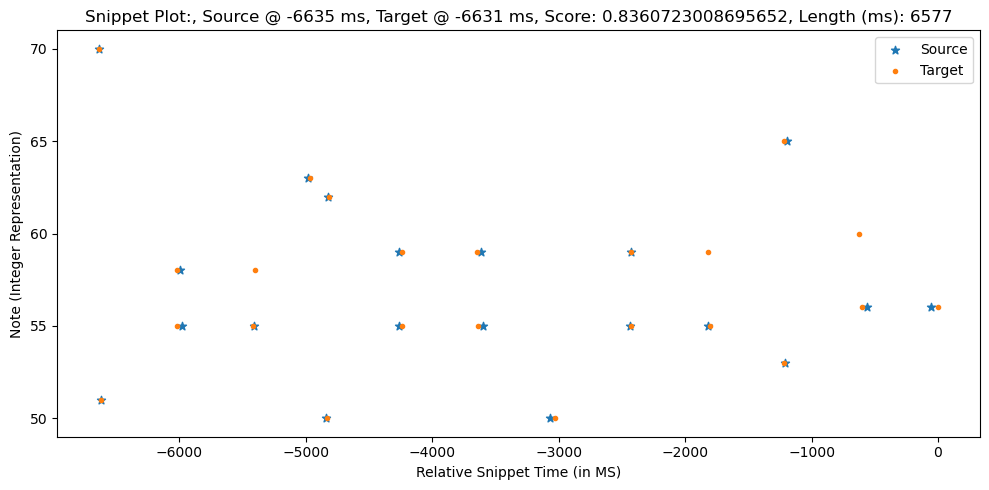

0.836161424347826
Scores: [ 0.965   0.9725  0.9275  0.9575  0.985  -0.      0.935   0.9525  0.9725
  0.92    0.91    0.9625  0.9275  0.88    0.97    0.955  -0.      0.9325
  0.9975  0.965  -0.      0.9275  0.83    0.9325  0.9275  0.9075  0.95
  0.9125  0.94  ]
Sequence1:  [[-8471    70    58]
 [-8460    51    46]
 [-7861    55    45]
 [-7858    58    32]
 [-7254    55    48]
 [-7242    58    39]
 [-6808    63    52]
 [-6672    50    42]
 [-6660    62    56]
 [-6078    59    46]
 [-6076    55    46]
 [-5483    59    42]
 [-5477    55    48]
 [-4868    50    46]
 [-4267    59    39]
 [-4265    55    44]
 [-3659    59    34]
 [-3643    55    41]
 [-3060    53    47]
 [-3057    65    54]
 [-2469    60    34]
 [-2442    56    44]
 [-1840    56    45]
 [-1248    53    46]
 [-1241    72    59]
 [ -626    56    45]
 [ -615    60    30]
 [  -51    56    49]
 [  -24    60    31]]
Sequence2:  [[-8485    70    53]
 [-8471    51    51]
 [-7841    58    33]
 [-7832    55    42]
 [-7260    55    48]


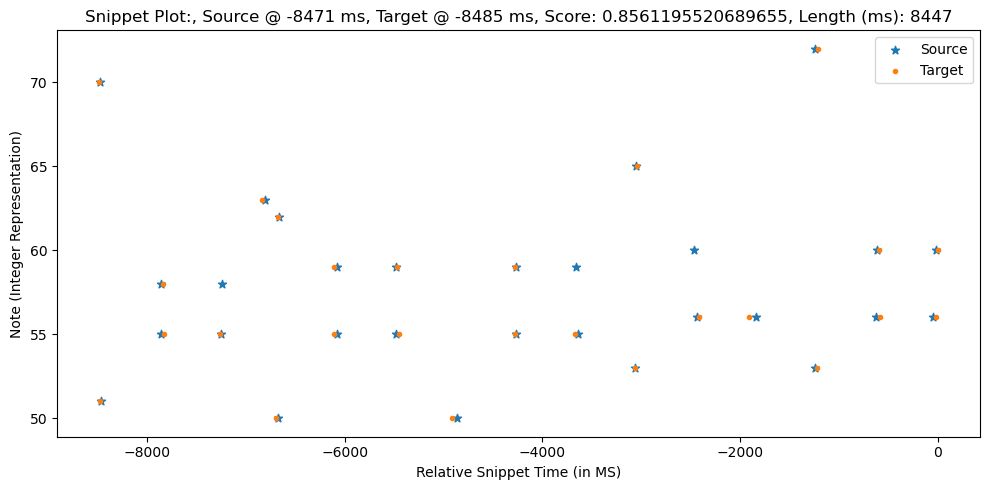

Scores: [0.965  0.9725 0.9575 0.9275 0.985  0.935  0.9525 0.9725 0.91   0.92
 0.9625 0.9275 0.88   0.955  0.97   0.9325 0.9975 0.965  0.9275 0.83
 0.9325 0.9275 0.95   0.9075 0.9125 0.94  ]
Sequence1:  [[-8461    70    53]
 [-8447    51    51]
 [-7817    58    33]
 [-7808    55    42]
 [-7236    55    48]
 [-6810    63    49]
 [-6667    50    44]
 [-6647    62    54]
 [-6088    55    44]
 [-6086    59    42]
 [-5444    59    41]
 [-5424    55    45]
 [-4892    50    51]
 [-4259    55    44]
 [-4255    59    40]
 [-3646    55    47]
 [-3037    53    43]
 [-3019    65    49]
 [-2389    56    41]
 [-1884    56    41]
 [-1197    53    54]
 [-1188    72    55]
 [ -571    60    32]
 [ -565    56    44]
 [    8    56    48]
 [   24    60    31]]
Sequence2:  [[-8447    70    58]
 [-8436    51    46]
 [-7837    55    45]
 [-7834    58    32]
 [-7230    55    48]
 [-7218    58    39]
 [-6784    63    52]
 [-6648    50    42]
 [-6636    62    56]
 [-6054    59    46]
 [-6052    55    46]
 [-5459 

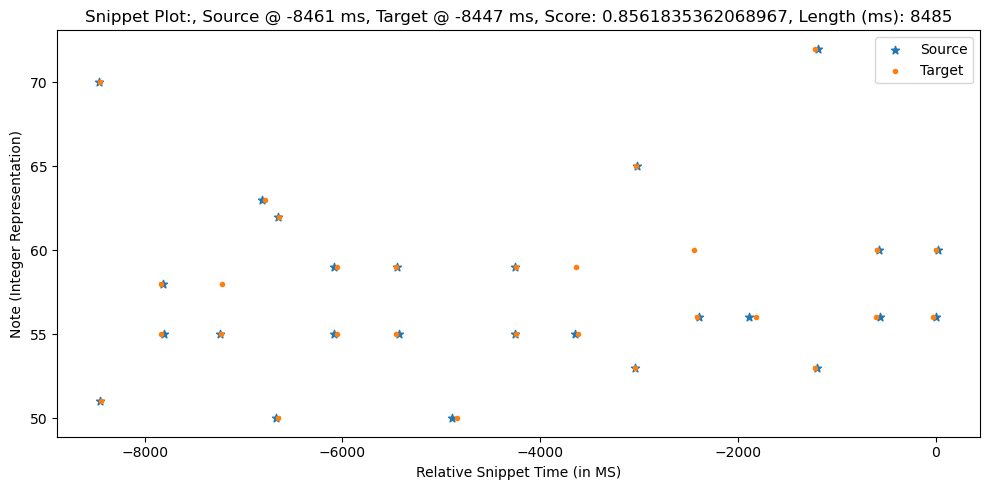

0.8561835362068967
Scores: [ 0.955   0.9625  0.9375  0.9675  0.975  -0.      0.925   0.9425  0.9625
  0.91    0.9     0.9725  0.9375  0.87    0.96    0.945  -0.      0.9225
  0.9875  0.975  -0.      0.9375  0.82    0.9425  0.9375  0.9175  0.96
  0.9225  0.95    0.9275  0.995   0.9125  0.84    0.86    0.925   0.925 ]
Sequence1:  [[-10221     70     58]
 [-10210     51     46]
 [ -9611     55     45]
 [ -9608     58     32]
 [ -9004     55     48]
 [ -8992     58     39]
 [ -8558     63     52]
 [ -8422     50     42]
 [ -8410     62     56]
 [ -7828     59     46]
 [ -7826     55     46]
 [ -7233     59     42]
 [ -7227     55     48]
 [ -6618     50     46]
 [ -6017     59     39]
 [ -6015     55     44]
 [ -5409     59     34]
 [ -5393     55     41]
 [ -4810     53     47]
 [ -4807     65     54]
 [ -4219     60     34]
 [ -4192     56     44]
 [ -3590     56     45]
 [ -2998     53     46]
 [ -2991     72     59]
 [ -2376     56     45]
 [ -2365     60     30]
 [ -1801     56     49

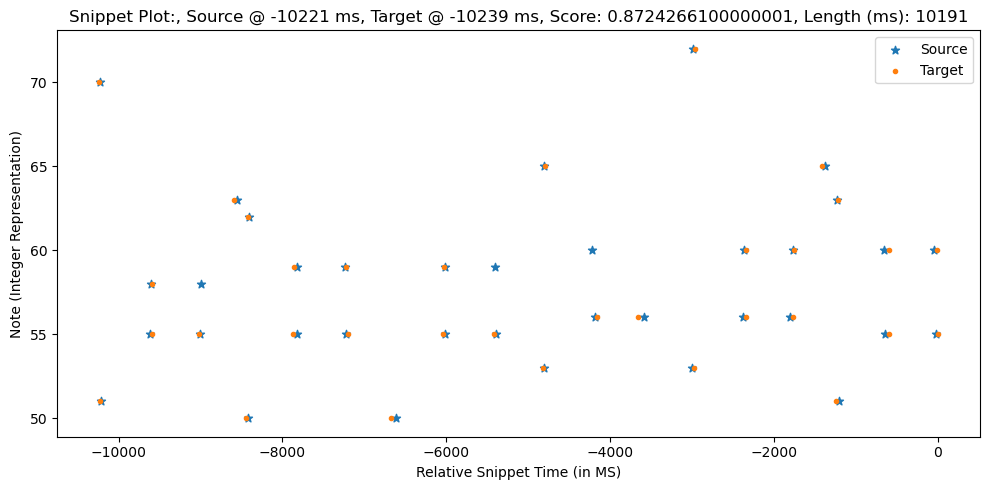

Scores: [0.955  0.9625 0.9675 0.9375 0.975  0.925  0.9425 0.9625 0.9    0.91
 0.9725 0.9375 0.87   0.945  0.96   0.9225 0.9875 0.975  0.9375 0.82
 0.9425 0.9375 0.96   0.9175 0.9225 0.95   0.9275 0.9125 0.995  0.84
 0.86   0.925  0.925 ]
Sequence1:  [[-10209     70     53]
 [-10195     51     51]
 [ -9565     58     33]
 [ -9556     55     42]
 [ -8984     55     48]
 [ -8558     63     49]
 [ -8415     50     44]
 [ -8395     62     54]
 [ -7836     55     44]
 [ -7834     59     42]
 [ -7192     59     41]
 [ -7172     55     45]
 [ -6640     50     51]
 [ -6007     55     44]
 [ -6003     59     40]
 [ -5394     55     47]
 [ -4785     53     43]
 [ -4767     65     49]
 [ -4137     56     41]
 [ -3632     56     41]
 [ -2945     53     54]
 [ -2936     72     55]
 [ -2319     60     32]
 [ -2313     56     44]
 [ -1740     56     48]
 [ -1724     60     31]
 [ -1382     65     40]
 [ -1210     51     45]
 [ -1196     63     51]
 [  -567     60     39]
 [  -564     55     44]
 [    

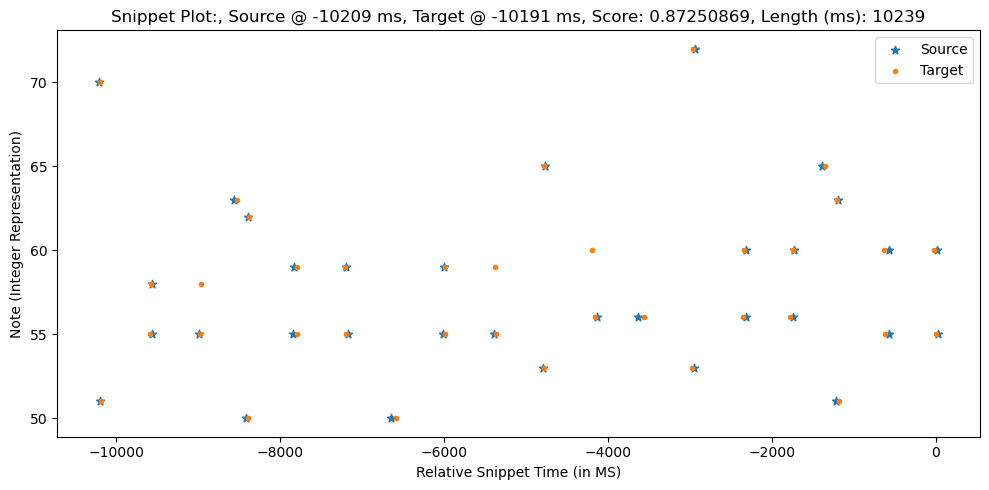

0.87250869
Scores: [ 0.9575  0.965   0.935   0.965   0.9775 -0.      0.9275  0.945   0.965
  0.9125  0.9025  0.97    0.935   0.8725  0.9625  0.9475 -0.      0.925
  0.99    0.9725 -0.      0.935   0.8225  0.94    0.935   0.915   0.9575
  0.92    0.9475  0.93    0.9925  0.915   0.8375  0.8575  0.9225  0.9225
  0.99    0.9875  0.8175  0.8575  0.9525  0.9975  0.845   0.9475  0.8975]
Sequence1:  [[-12654     70     58]
 [-12643     51     46]
 [-12044     55     45]
 [-12041     58     32]
 [-11437     55     48]
 [-11425     58     39]
 [-10991     63     52]
 [-10855     50     42]
 [-10843     62     56]
 [-10261     59     46]
 [-10259     55     46]
 [ -9666     59     42]
 [ -9660     55     48]
 [ -9051     50     46]
 [ -8450     59     39]
 [ -8448     55     44]
 [ -7842     59     34]
 [ -7826     55     41]
 [ -7243     53     47]
 [ -7240     65     54]
 [ -6652     60     34]
 [ -6625     56     44]
 [ -6023     56     45]
 [ -5431     53     46]
 [ -5424     72     59]
 [ -4

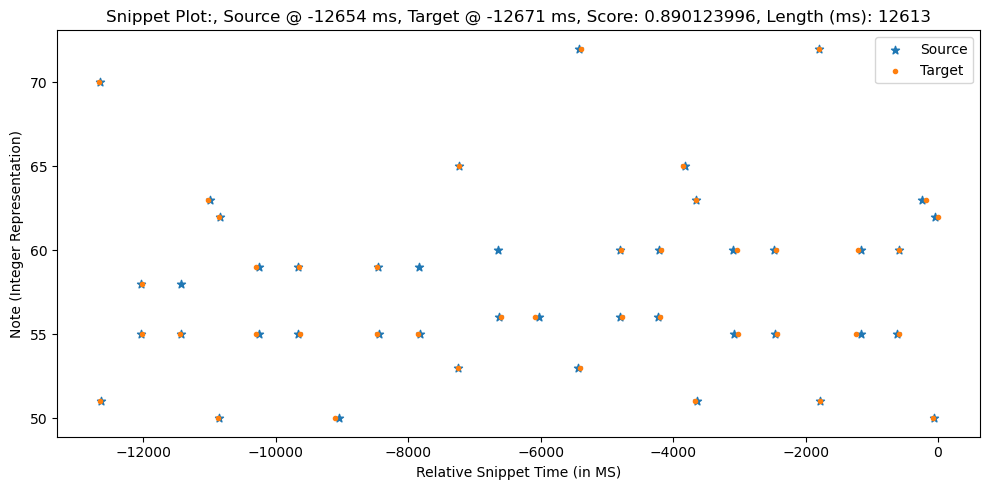

Scores: [0.9575 0.965  0.965  0.935  0.9775 0.9275 0.945  0.965  0.9025 0.9125
 0.97   0.935  0.8725 0.9475 0.9625 0.925  0.99   0.9725 0.935  0.8225
 0.94   0.935  0.9575 0.915  0.92   0.9475 0.93   0.915  0.9925 0.8375
 0.8575 0.9225 0.9225 0.99   0.9875 0.8175 0.8575 0.9525 0.9975 0.845
 0.9475 0.8975]
Sequence1:  [[-12630     70     53]
 [-12616     51     51]
 [-11986     58     33]
 [-11977     55     42]
 [-11405     55     48]
 [-10979     63     49]
 [-10836     50     44]
 [-10816     62     54]
 [-10257     55     44]
 [-10255     59     42]
 [ -9613     59     41]
 [ -9593     55     45]
 [ -9061     50     51]
 [ -8428     55     44]
 [ -8424     59     40]
 [ -7815     55     47]
 [ -7206     53     43]
 [ -7188     65     49]
 [ -6558     56     41]
 [ -6053     56     41]
 [ -5366     53     54]
 [ -5357     72     55]
 [ -4740     60     32]
 [ -4734     56     44]
 [ -4161     56     48]
 [ -4145     60     31]
 [ -3803     65     40]
 [ -3631     51     45]
 [ -3617 

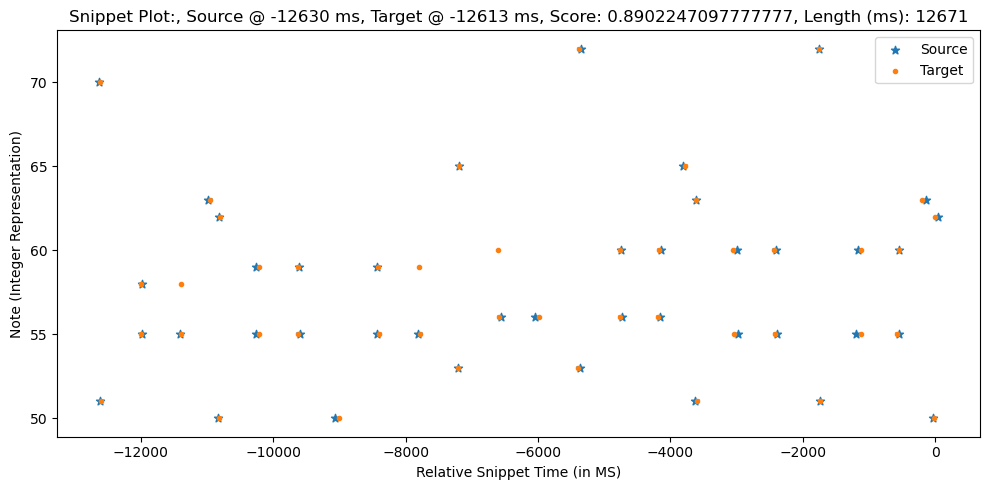

0.8902247097777777
Scores: [ 0.955   0.9625  0.9375  0.9675  0.975  -0.      0.925   0.9425  0.9625
  0.91    0.9     0.9725  0.9375  0.87    0.96    0.945  -0.      0.9225
  0.9875  0.975  -0.      0.9375  0.82    0.9425  0.9375  0.9175  0.96
  0.9225  0.95    0.9275  0.995   0.9125  0.84    0.86    0.925   0.925
  0.9925  0.985   0.815   0.855   0.955   1.      0.8475  0.945   0.9
  0.8075  0.7975  0.9275  0.95    0.9725  0.9775]
Sequence1:  [[-14423     70     58]
 [-14412     51     46]
 [-13813     55     45]
 [-13810     58     32]
 [-13206     55     48]
 [-13194     58     39]
 [-12760     63     52]
 [-12624     50     42]
 [-12612     62     56]
 [-12030     59     46]
 [-12028     55     46]
 [-11435     59     42]
 [-11429     55     48]
 [-10820     50     46]
 [-10219     59     39]
 [-10217     55     44]
 [ -9611     59     34]
 [ -9595     55     41]
 [ -9012     53     47]
 [ -9009     65     54]
 [ -8421     60     34]
 [ -8394     56     44]
 [ -7792     56     45]


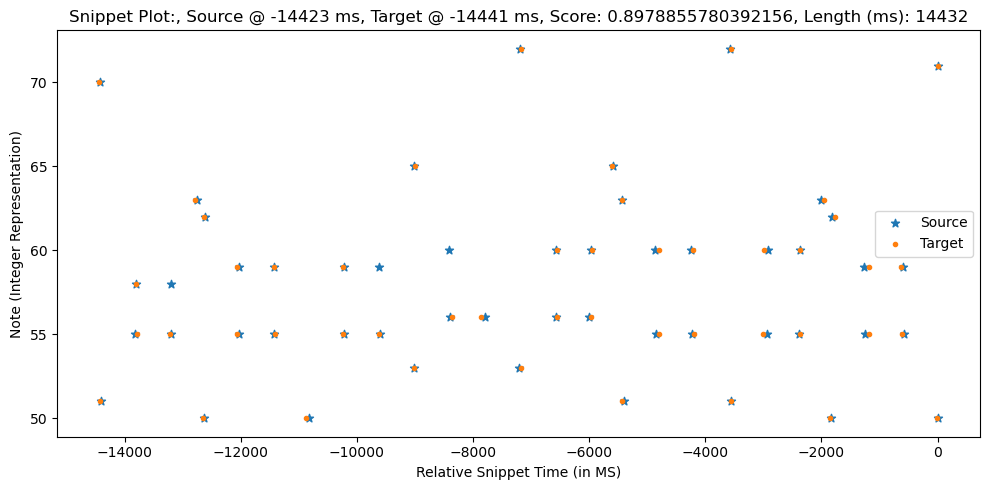

Scores: [0.955  0.9625 0.9675 0.9375 0.975  0.925  0.9425 0.9625 0.9    0.91
 0.9725 0.9375 0.87   0.945  0.96   0.9225 0.9875 0.975  0.9375 0.82
 0.9425 0.9375 0.96   0.9175 0.9225 0.95   0.9275 0.9125 0.995  0.84
 0.86   0.925  0.925  0.9925 0.985  0.815  0.855  0.955  1.     0.8475
 0.945  0.9    0.8075 0.7975 0.9275 0.95   0.9725 0.9775]
Sequence1:  [[-14450     70     53]
 [-14436     51     51]
 [-13806     58     33]
 [-13797     55     42]
 [-13225     55     48]
 [-12799     63     49]
 [-12656     50     44]
 [-12636     62     54]
 [-12077     55     44]
 [-12075     59     42]
 [-11433     59     41]
 [-11413     55     45]
 [-10881     50     51]
 [-10248     55     44]
 [-10244     59     40]
 [ -9635     55     47]
 [ -9026     53     43]
 [ -9008     65     49]
 [ -8378     56     41]
 [ -7873     56     41]
 [ -7186     53     54]
 [ -7177     72     55]
 [ -6560     60     32]
 [ -6554     56     44]
 [ -5981     56     48]
 [ -5965     60     31]
 [ -5623     65     

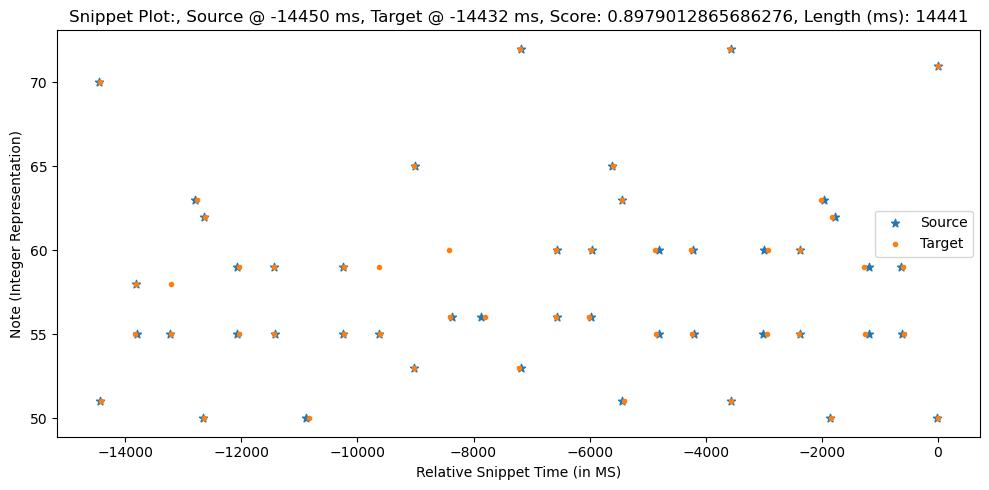

0.8979012865686276
Scores: [ 0.96    0.9675  0.9325  0.9625  0.98   -0.      0.93    0.9475  0.9675
  0.915   0.905   0.9675  0.9325  0.875   0.965   0.95   -0.      0.9275
  0.9925  0.97   -0.      0.9325  0.825   0.9375  0.9325  0.9125  0.955
  0.9175  0.945   0.9325  0.99    0.9175  0.835   0.855   0.92    0.92
  0.9875  0.99    0.82    0.86    0.95    0.995   0.8425  0.95    0.895
  0.8025  0.7925  0.9325  0.955   0.9775  0.9825  0.9975  0.975   0.905
  0.9625  0.9775  0.945   0.93  ]
Sequence1:  [[-16194     70     58]
 [-16183     51     46]
 [-15584     55     45]
 [-15581     58     32]
 [-14977     55     48]
 [-14965     58     39]
 [-14531     63     52]
 [-14395     50     42]
 [-14383     62     56]
 [-13801     59     46]
 [-13799     55     46]
 [-13206     59     42]
 [-13200     55     48]
 [-12591     50     46]
 [-11990     59     39]
 [-11988     55     44]
 [-11382     59     34]
 [-11366     55     41]
 [-10783     53     47]
 [-10780     65     54]
 [-10192     6

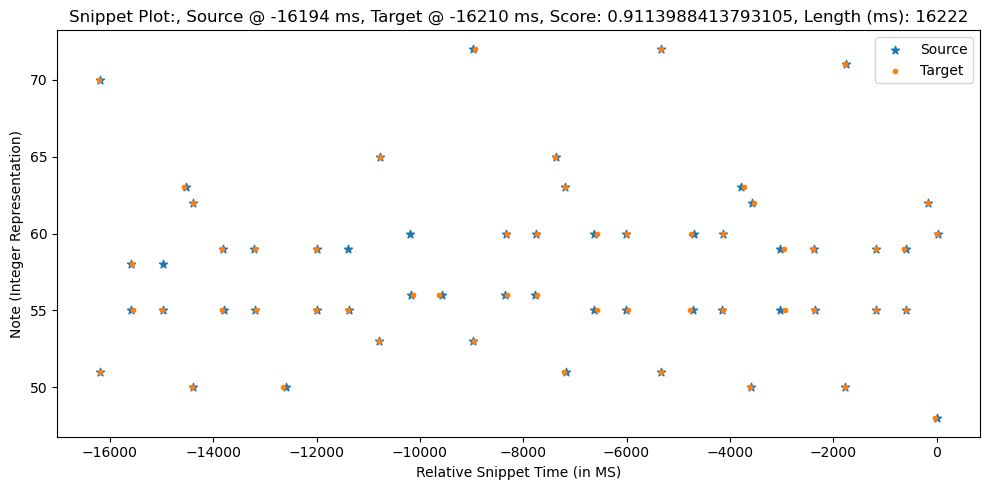

Scores: [0.96   0.9675 0.9625 0.9325 0.98   0.93   0.9475 0.9675 0.905  0.915
 0.9675 0.9325 0.875  0.95   0.965  0.9275 0.9925 0.97   0.9325 0.825
 0.9375 0.9325 0.955  0.9125 0.9175 0.945  0.9325 0.9175 0.99   0.835
 0.855  0.92   0.92   0.9875 0.99   0.82   0.86   0.95   0.995  0.8425
 0.95   0.895  0.8025 0.7925 0.9325 0.955  0.9775 0.9825 0.975  0.9975
 0.905  0.9625 0.9775 0.945  0.93  ]
Sequence1:  [[-16238     70     53]
 [-16224     51     51]
 [-15594     58     33]
 [-15585     55     42]
 [-15013     55     48]
 [-14587     63     49]
 [-14444     50     44]
 [-14424     62     54]
 [-13865     55     44]
 [-13863     59     42]
 [-13221     59     41]
 [-13201     55     45]
 [-12669     50     51]
 [-12036     55     44]
 [-12032     59     40]
 [-11423     55     47]
 [-10814     53     43]
 [-10796     65     49]
 [-10166     56     41]
 [ -9661     56     41]
 [ -8974     53     54]
 [ -8965     72     55]
 [ -8348     60     32]
 [ -8342     56     44]
 [ -7769     56

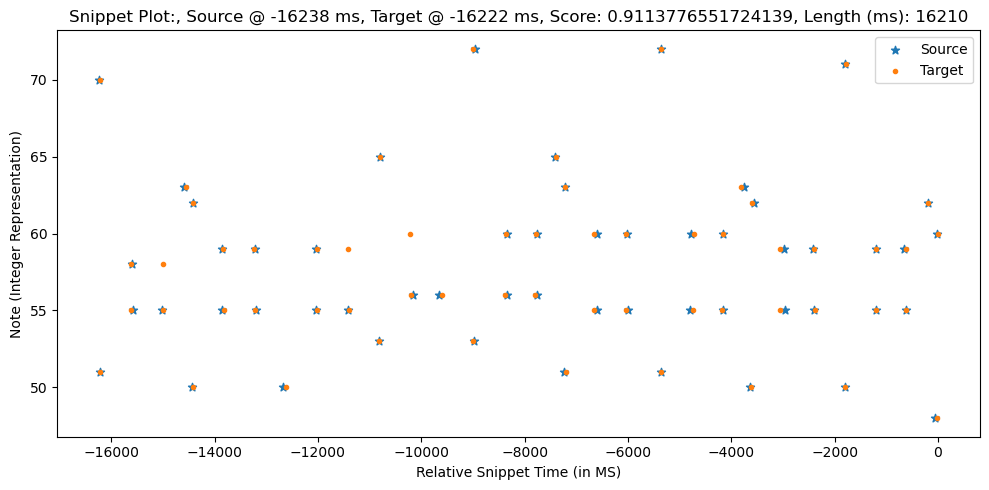

0.9113988413793105
Scores: [ 0.9575  0.965   0.935   0.965   0.9775 -0.      0.9275  0.945   0.965
  0.9125  0.9025  0.97    0.935   0.8725  0.9625  0.9475 -0.      0.925
  0.99    0.9725 -0.      0.935   0.8225  0.94    0.935   0.915   0.9575
  0.92    0.9475  0.93    0.9925  0.915   0.8375  0.8575  0.9225  0.9225
  0.99    0.9875  0.8175  0.8575  0.9525  0.9975  0.845   0.9475  0.8975
  0.805   0.795   0.93    0.9525  0.975   0.98    0.995   0.9725  0.9025
  0.96    0.975   0.9425  0.9275  0.9575  0.8825  0.955   0.835   0.93
  0.9725  0.94    0.9675  0.9675]
Sequence1:  [[-18615     70     58]
 [-18604     51     46]
 [-18005     55     45]
 [-18002     58     32]
 [-17398     55     48]
 [-17386     58     39]
 [-16952     63     52]
 [-16816     50     42]
 [-16804     62     56]
 [-16222     59     46]
 [-16220     55     46]
 [-15627     59     42]
 [-15621     55     48]
 [-15012     50     46]
 [-14411     59     39]
 [-14409     55     44]
 [-13803     59     34]
 [-13787    

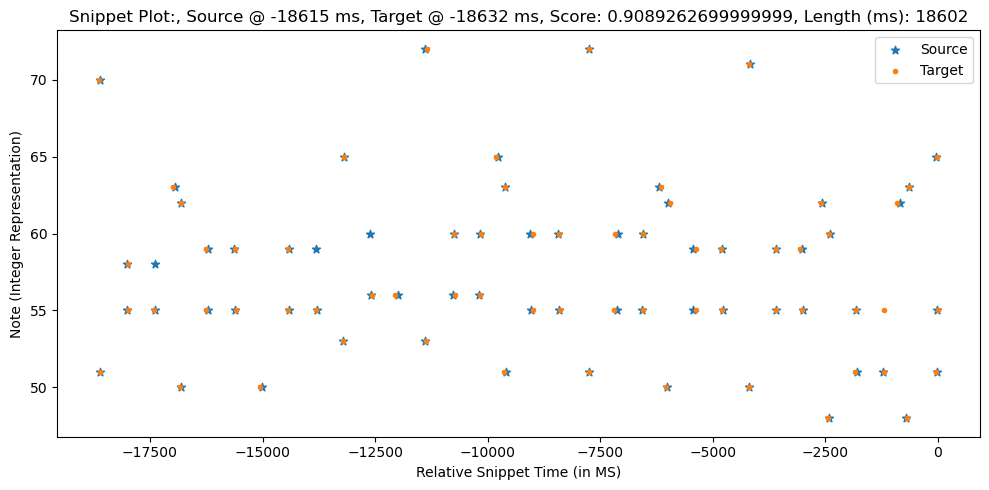

Scores: [ 0.9575  0.965   0.965   0.935   0.9775  0.9275  0.945   0.965   0.9025
  0.9125  0.97    0.935   0.8725  0.9475  0.9625  0.925   0.99    0.9725
  0.935   0.8225  0.94    0.935   0.9575  0.915   0.92    0.9475  0.93
  0.915   0.9925  0.8375  0.8575  0.9225  0.9225  0.99    0.9875  0.8175
  0.8575  0.9525  0.9975  0.845   0.9475  0.8975  0.805   0.795   0.93
  0.9525  0.975   0.98    0.9725  0.995   0.9025  0.96    0.975   0.9425
  0.9275  0.8825  0.9575  0.955  -0.      0.835   0.93    0.9725  0.9675
  0.94    0.9675]
Sequence1:  [[-18619     70     53]
 [-18605     51     51]
 [-17975     58     33]
 [-17966     55     42]
 [-17394     55     48]
 [-16968     63     49]
 [-16825     50     44]
 [-16805     62     54]
 [-16246     55     44]
 [-16244     59     42]
 [-15602     59     41]
 [-15582     55     45]
 [-15050     50     51]
 [-14417     55     44]
 [-14413     59     40]
 [-13804     55     47]
 [-13195     53     43]
 [-13177     65     49]
 [-12547     56     41]

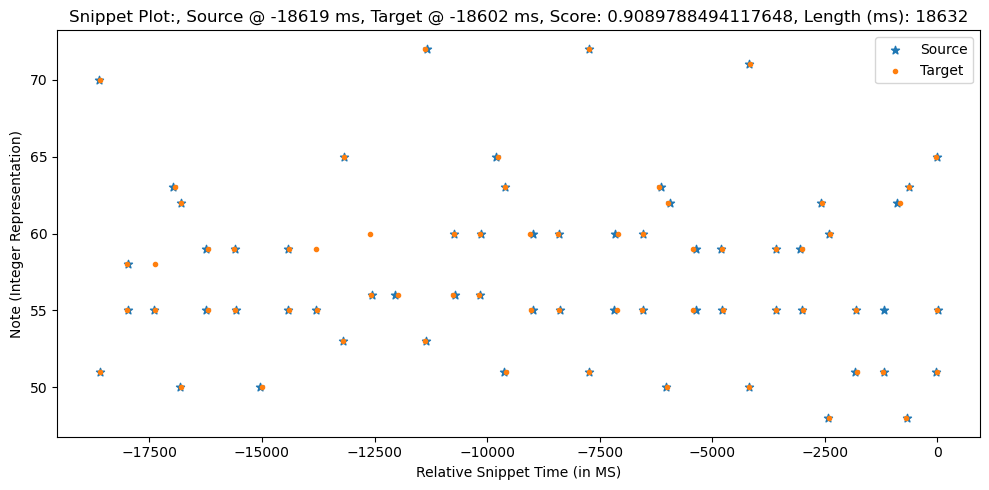

0.9089788494117648
Scores: [ 0.965   0.9725  0.9275  0.9575  0.985  -0.      0.935   0.9525  0.9725
  0.92    0.91    0.9625  0.9275  0.88    0.97    0.955  -0.      0.9325
  0.9975  0.965  -0.      0.9275  0.83    0.9325  0.9275  0.9075  0.95
  0.9125  0.94    0.9375  0.985   0.9225  0.83    0.85    0.915   0.915
  0.9825  0.995   0.825   0.865   0.945   0.99    0.8375  0.955   0.89
  0.7975  0.7875  0.9375  0.96    0.9825  0.9875  0.9975  0.98    0.91
  0.9675  0.9825  0.95    0.935   0.95    0.89    0.9475  0.8425  0.9225
  0.965   0.9325  0.975   0.96    0.9775  0.9825  0.995   0.975   0.8875
  0.8325]
Sequence1:  [[-20432     70     58]
 [-20421     51     46]
 [-19822     55     45]
 [-19819     58     32]
 [-19215     55     48]
 [-19203     58     39]
 [-18769     63     52]
 [-18633     50     42]
 [-18621     62     56]
 [-18039     59     46]
 [-18037     55     46]
 [-17444     59     42]
 [-17438     55     48]
 [-16829     50     46]
 [-16228     59     39]
 [-16226     5

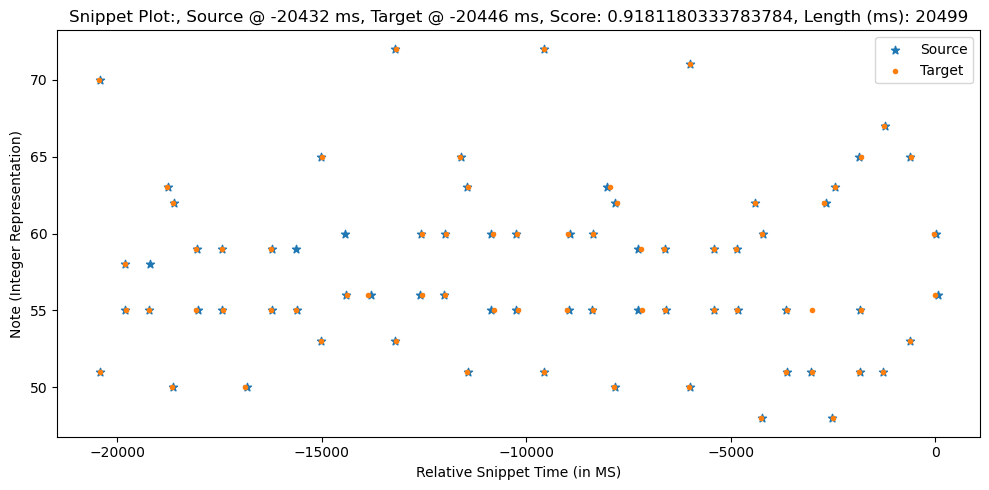

Scores: [ 0.965   0.9725  0.9575  0.9275  0.985   0.935   0.9525  0.9725  0.91
  0.92    0.9625  0.9275  0.88    0.955   0.97    0.9325  0.9975  0.965
  0.9275  0.83    0.9325  0.9275  0.95    0.9075  0.9125  0.94    0.9375
  0.9225  0.985   0.83    0.85    0.915   0.915   0.9825  0.995   0.825
  0.865   0.945   0.99    0.8375  0.955   0.89    0.7975  0.7875  0.9375
  0.96    0.9825  0.9875  0.98    0.9975  0.91    0.9675  0.9825  0.95
  0.935   0.89    0.95    0.9475 -0.      0.8425  0.9225  0.965   0.975
  0.9325  0.96    0.9775  0.9825  0.995   0.975   0.8875  0.8325]
Sequence1:  [[-20513     70     53]
 [-20499     51     51]
 [-19869     58     33]
 [-19860     55     42]
 [-19288     55     48]
 [-18862     63     49]
 [-18719     50     44]
 [-18699     62     54]
 [-18140     55     44]
 [-18138     59     42]
 [-17496     59     41]
 [-17476     55     45]
 [-16944     50     51]
 [-16311     55     44]
 [-16307     59     40]
 [-15698     55     47]
 [-15089     53     43]
 [

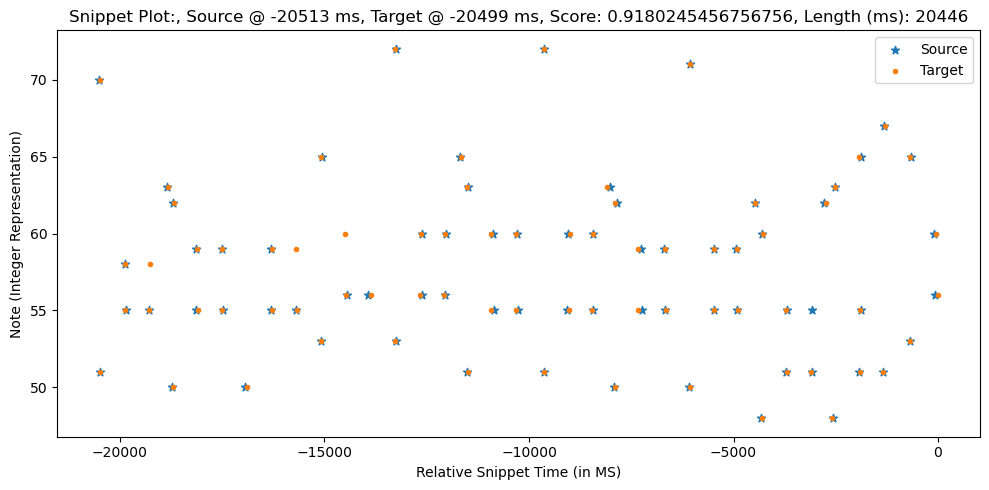

0.9181180333783784
Scores: [ 0.965   0.9725  0.9275  0.9575  0.985  -0.      0.935   0.9525  0.9725
  0.92    0.91    0.9625  0.9275  0.88    0.97    0.955  -0.      0.9325
  0.9975  0.965  -0.      0.9275  0.83    0.9325  0.9275  0.9075  0.95
  0.9125  0.94    0.9375  0.985   0.9225  0.83    0.85    0.915   0.915
  0.9825  0.995   0.825   0.865   0.945   0.99    0.8375  0.955   0.89
  0.7975  0.7875  0.9375  0.96    0.9825  0.9875  0.9975  0.98    0.91
  0.9675  0.9825  0.95    0.935   0.95    0.89    0.9475  0.8425  0.9225
  0.965   0.9325  0.975   0.96    0.9775  0.9825  0.995   0.975   0.8875
  0.8325  0.8475  0.97    0.9825  0.985   0.935 ]
Sequence1:  [[-22286     70     58]
 [-22275     51     46]
 [-21676     55     45]
 [-21673     58     32]
 [-21069     55     48]
 [-21057     58     39]
 [-20623     63     52]
 [-20487     50     42]
 [-20475     62     56]
 [-19893     59     46]
 [-19891     55     46]
 [-19298     59     42]
 [-19292     55     48]
 [-18683     50     46

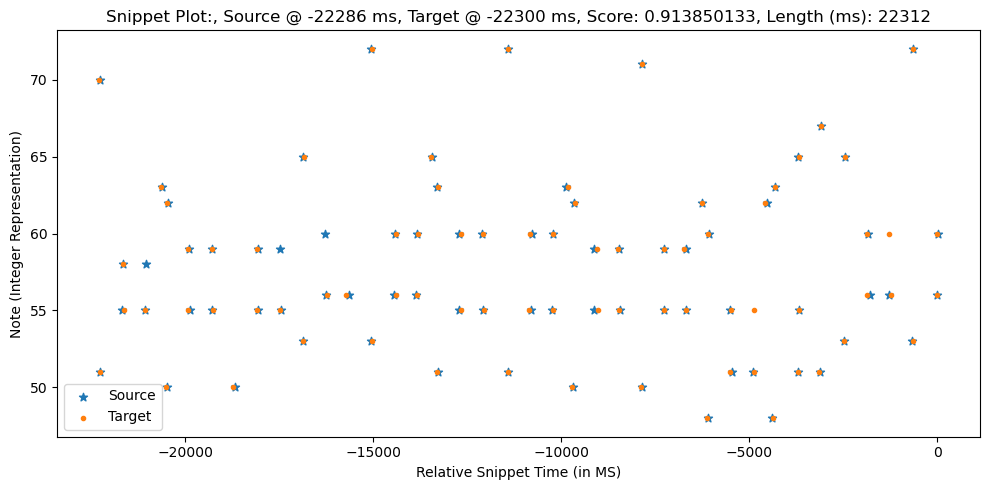

Scores: [ 0.965   0.9725  0.9575  0.9275  0.985   0.935   0.9525  0.9725  0.91
  0.92    0.9625  0.9275  0.88    0.955   0.97    0.9325  0.9975  0.965
  0.9275  0.83    0.9325  0.9275  0.95    0.9075  0.9125  0.94    0.9375
  0.9225  0.985   0.83    0.85    0.915   0.915   0.9825  0.995   0.825
  0.865   0.945   0.99    0.8375  0.955   0.89    0.7975  0.7875  0.9375
  0.96    0.9825  0.9875  0.98    0.9975  0.91    0.9675  0.9825  0.95
  0.935   0.89    0.95    0.9475 -0.      0.8425  0.9225  0.965   0.975
  0.9325  0.96    0.9775  0.9825  0.995   0.975   0.8875  0.8325 -0.
  0.8475  0.9825  0.97    0.985   0.935 ]
Sequence1:  [[-22326     70     53]
 [-22312     51     51]
 [-21682     58     33]
 [-21673     55     42]
 [-21101     55     48]
 [-20675     63     49]
 [-20532     50     44]
 [-20512     62     54]
 [-19953     55     44]
 [-19951     59     42]
 [-19309     59     41]
 [-19289     55     45]
 [-18757     50     51]
 [-18124     55     44]
 [-18120     59     40]
 [-17

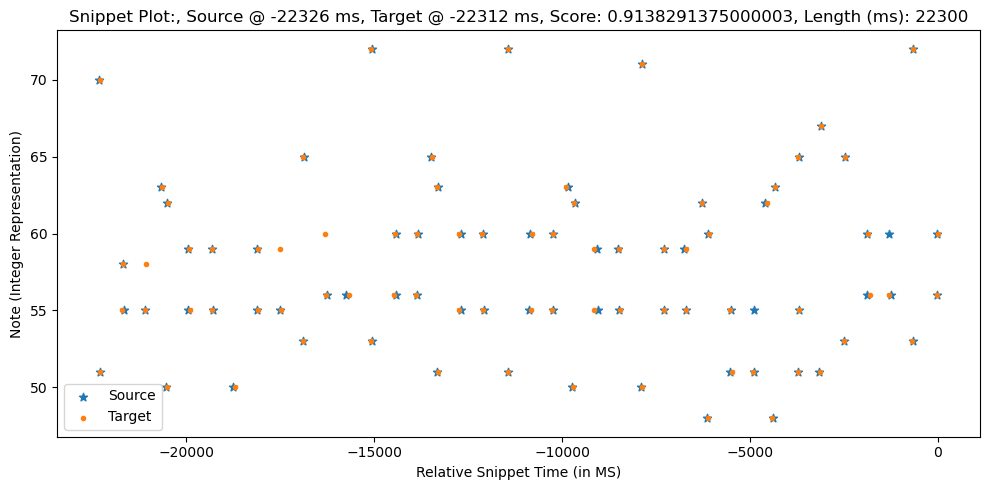

0.913850133
Scores: [ 0.965   0.9725  0.9275  0.9575  0.985  -0.      0.935   0.9525  0.9725
  0.92    0.91    0.9625  0.9275  0.88    0.97    0.955  -0.      0.9325
  0.9975  0.965  -0.      0.9275  0.83    0.9325  0.9275  0.9075  0.95
  0.9125  0.94    0.9375  0.985   0.9225  0.83    0.85    0.915   0.915
  0.9825  0.995   0.825   0.865   0.945   0.99    0.8375  0.955   0.89
  0.7975  0.7875  0.9375  0.96    0.9825  0.9875  0.9975  0.98    0.91
  0.9675  0.9825  0.95    0.935   0.95    0.89    0.9475  0.8425  0.9225
  0.965   0.9325  0.975   0.96    0.9775  0.9825  0.995   0.975   0.8875
  0.8325  0.8475  0.97    0.9825  0.985   0.935   0.83    0.9975  0.98
  0.9725  0.98    0.9825  0.915   0.98    0.8425]
Sequence1:  [[-24535     70     58]
 [-24524     51     46]
 [-23925     55     45]
 [-23922     58     32]
 [-23318     55     48]
 [-23306     58     39]
 [-22872     63     52]
 [-22736     50     42]
 [-22724     62     56]
 [-22142     59     46]
 [-22140     55     46]
 [-215

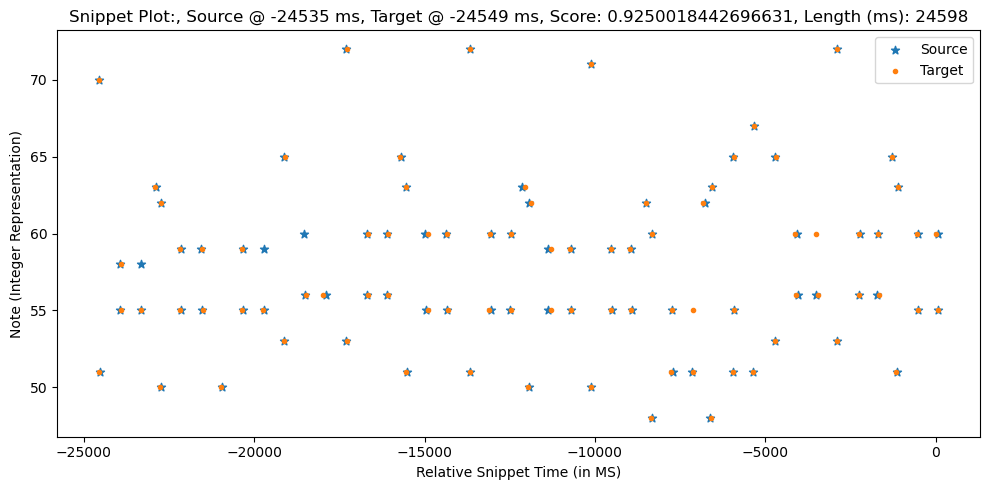

Scores: [ 0.965   0.9725  0.9575  0.9275  0.985   0.935   0.9525  0.9725  0.91
  0.92    0.9625  0.9275  0.88    0.955   0.97    0.9325  0.9975  0.965
  0.9275  0.83    0.9325  0.9275  0.95    0.9075  0.9125  0.94    0.9375
  0.9225  0.985   0.83    0.85    0.915   0.915   0.9825  0.995   0.825
  0.865   0.945   0.99    0.8375  0.955   0.89    0.7975  0.7875  0.9375
  0.96    0.9825  0.9875  0.98    0.9975  0.91    0.9675  0.9825  0.95
  0.935   0.89    0.95    0.9475 -0.      0.8425  0.9225  0.965   0.975
  0.9325  0.96    0.9775  0.9825  0.995   0.975   0.8875  0.8325 -0.
  0.8475  0.9825  0.97    0.985   0.935   0.9975  0.83    0.98    0.9725
  0.98    0.915   0.9825  0.8425  0.98  ]
Sequence1:  [[-24607     70     53]
 [-24593     51     51]
 [-23963     58     33]
 [-23954     55     42]
 [-23382     55     48]
 [-22956     63     49]
 [-22813     50     44]
 [-22793     62     54]
 [-22234     55     44]
 [-22232     59     42]
 [-21590     59     41]
 [-21570     55     45]
 [-2

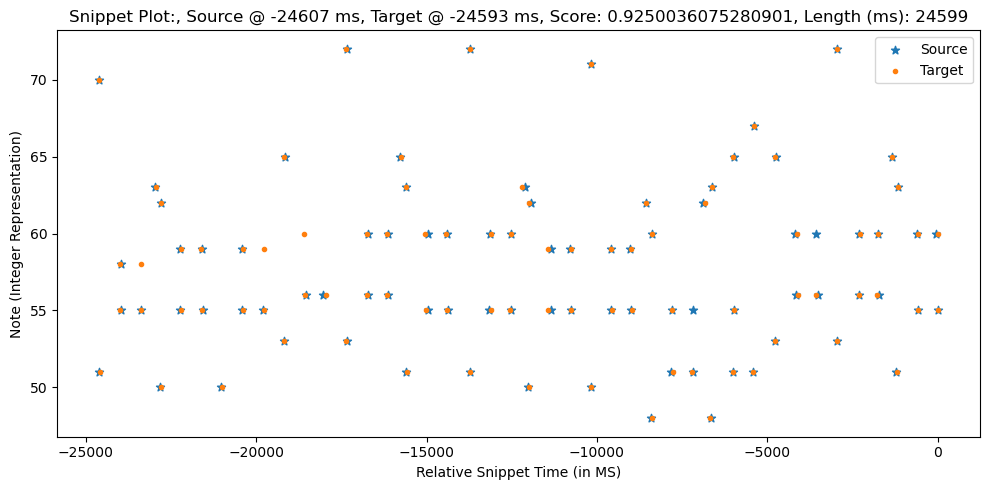

0.9250036075280901
Scores: [ 0.9675  0.975   0.925   0.955   0.9875 -0.      0.9375  0.955   0.975
  0.9225  0.9125  0.96    0.925   0.8825  0.9725  0.9575 -0.      0.935
  1.      0.9625 -0.      0.925   0.8325  0.93    0.925   0.905   0.9475
  0.91    0.9375  0.94    0.9825  0.925   0.8275  0.8475  0.9125  0.9125
  0.98    0.9975  0.8275  0.8675  0.9425  0.9875  0.835   0.9575  0.8875
  0.795   0.785   0.94    0.9625  0.985   0.99    0.995   0.9825  0.9125
  0.97    0.985   0.9525  0.9375  0.9475  0.8925  0.945   0.845   0.92
  0.9625  0.93    0.9775  0.9575  0.98    0.985   0.9925  0.9725  0.89
  0.835   0.845   0.9675  0.985   0.9825  0.9375  0.8275  0.995   0.9825
  0.975   0.9825  0.98    0.9175  0.9825  0.845   0.9775  0.99    0.9375
  0.9425  0.      0.895 ]
Sequence1:  [[-26386     70     58]
 [-26375     51     46]
 [-25776     55     45]
 [-25773     58     32]
 [-25169     55     48]
 [-25157     58     39]
 [-24723     63     52]
 [-24587     50     42]
 [-24575     62    

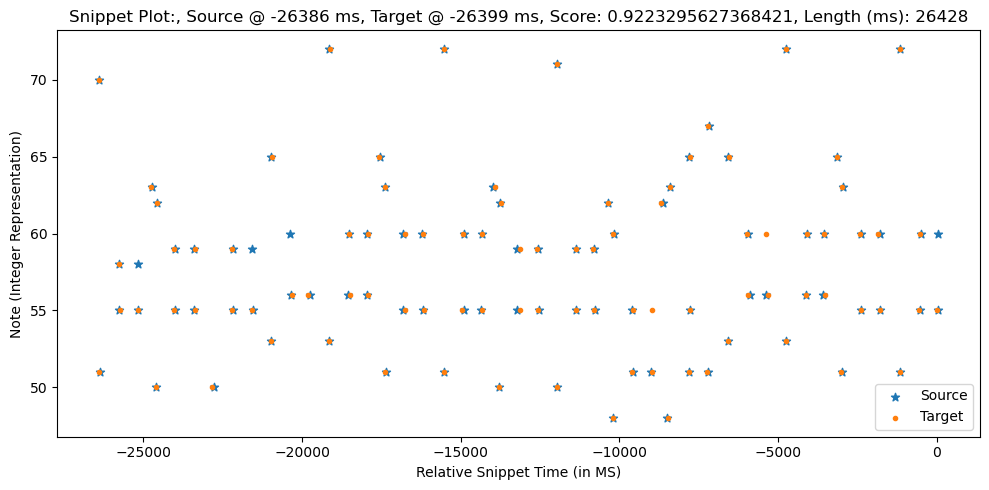

Scores: [ 0.9675  0.975   0.955   0.925   0.9875  0.9375  0.955   0.975   0.9125
  0.9225  0.96    0.925   0.8825  0.9575  0.9725  0.935   1.      0.9625
  0.925   0.8325  0.93    0.925   0.9475  0.905   0.91    0.9375  0.94
  0.925   0.9825  0.8275  0.8475  0.9125  0.9125  0.98    0.9975  0.8275
  0.8675  0.9425  0.9875  0.835   0.9575  0.8875  0.795   0.785   0.94
  0.9625  0.985   0.99    0.9825  0.995   0.9125  0.97    0.985   0.9525
  0.9375  0.8925  0.9475  0.945  -0.      0.845   0.92    0.9625  0.9775
  0.93    0.9575  0.98    0.985   0.9925  0.9725  0.89    0.835  -0.
  0.845   0.985   0.9675  0.9825  0.9375  0.995   0.8275  0.9825  0.975
  0.9825  0.9175  0.98    0.845   0.9825  0.99    0.9775  0.9375  0.9425
  0.895 ]
Sequence1:  [[-26441     70     53]
 [-26427     51     51]
 [-25797     58     33]
 [-25788     55     42]
 [-25216     55     48]
 [-24790     63     49]
 [-24647     50     44]
 [-24627     62     54]
 [-24068     55     44]
 [-24066     59     42]
 [-23424 

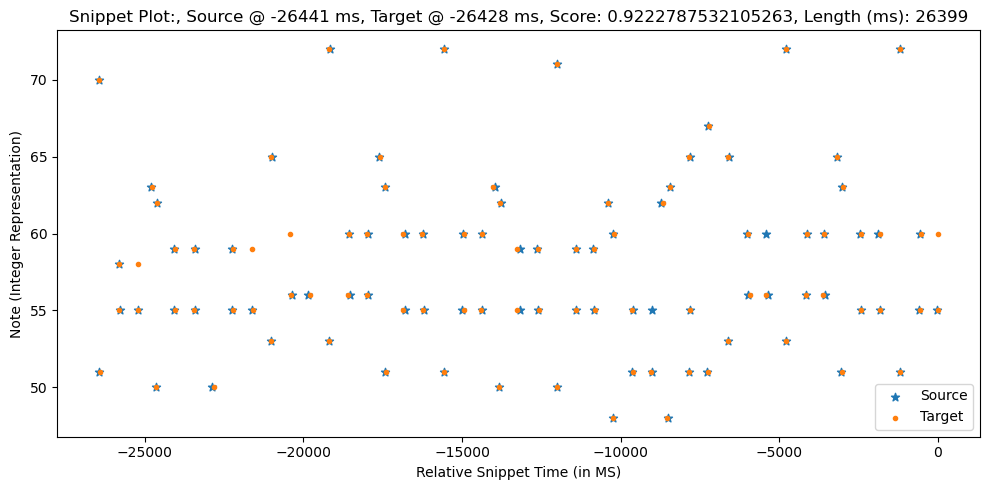

0.9223295627368421
Scores: [ 0.9725  0.98    0.92    0.95    0.9925 -0.      0.9425  0.96    0.98
  0.9275  0.9175  0.955   0.92    0.8875  0.9775  0.9625 -0.      0.94
  0.995   0.9575 -0.      0.92    0.8375  0.925   0.92    0.9     0.9425
  0.905   0.9325  0.945   0.9775  0.93    0.8225  0.8425  0.9075  0.9075
  0.975   0.9975  0.8325  0.8725  0.9375  0.9825  0.83    0.9625  0.8825
  0.79    0.78    0.945   0.9675  0.99    0.995   0.99    0.9875  0.9175
  0.975   0.99    0.9575  0.9425  0.9425  0.8975  0.94    0.85    0.915
  0.9575  0.925   0.9825  0.9525  0.985   0.99    0.9875  0.9675  0.895
  0.84    0.84    0.9625  0.99    0.9775  0.9425  0.8225  0.99    0.9875
  0.98    0.9875  0.975   0.9225  0.9875  0.85    0.9725  0.985   0.9425
  0.9475 -0.      0.9     0.885   0.77    0.9125  0.99    0.9775  0.985
  0.9375]
Sequence1:  [[-28205     70     58]
 [-28194     51     46]
 [-27595     55     45]
 [-27592     58     32]
 [-26988     55     48]
 [-26976     58     39]
 [-26542   

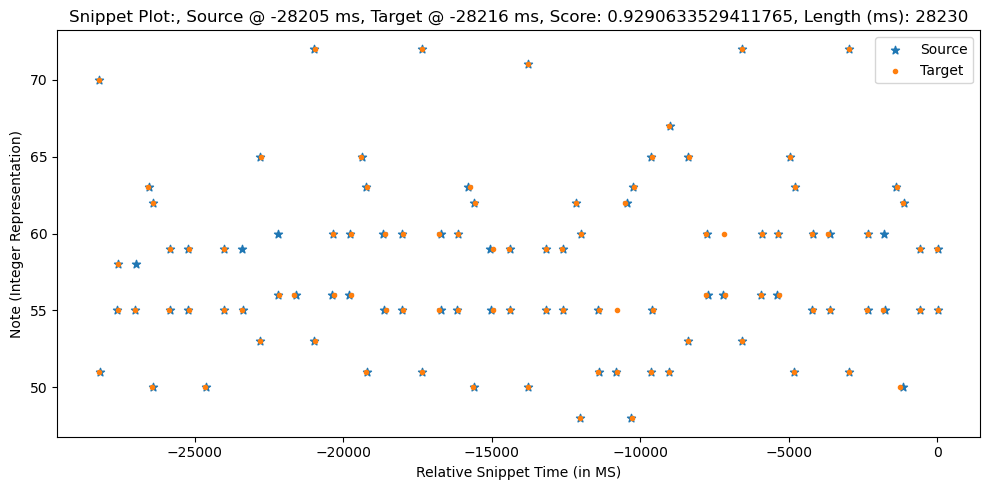

Scores: [ 0.9725  0.98    0.95    0.92    0.9925  0.9425  0.96    0.98    0.9175
  0.9275  0.955   0.92    0.8875  0.9625  0.9775  0.94    0.995   0.9575
  0.92    0.8375  0.925   0.92    0.9425  0.9     0.905   0.9325  0.945
  0.93    0.9775  0.8225  0.8425  0.9075  0.9075  0.975   0.9975  0.8325
  0.8725  0.9375  0.9825  0.83    0.9625  0.8825  0.79    0.78    0.945
  0.9675  0.99    0.995   0.9875  0.99    0.9175  0.975   0.99    0.9575
  0.9425  0.8975  0.9425  0.94   -0.      0.85    0.915   0.9575  0.9825
  0.925   0.9525  0.985   0.99    0.9875  0.9675  0.895   0.84   -0.
  0.84    0.99    0.9625  0.9775  0.9425  0.99    0.8225  0.9875  0.98
  0.9875  0.9225  0.975   0.85    0.9875  0.985   0.9725  0.9425  0.9475
  0.9     0.885   0.77    0.9125  0.99    0.9775  0.9375  0.985 ]
Sequence1:  [[-28233     70     53]
 [-28219     51     51]
 [-27589     58     33]
 [-27580     55     42]
 [-27008     55     48]
 [-26582     63     49]
 [-26439     50     44]
 [-26419     62     54]


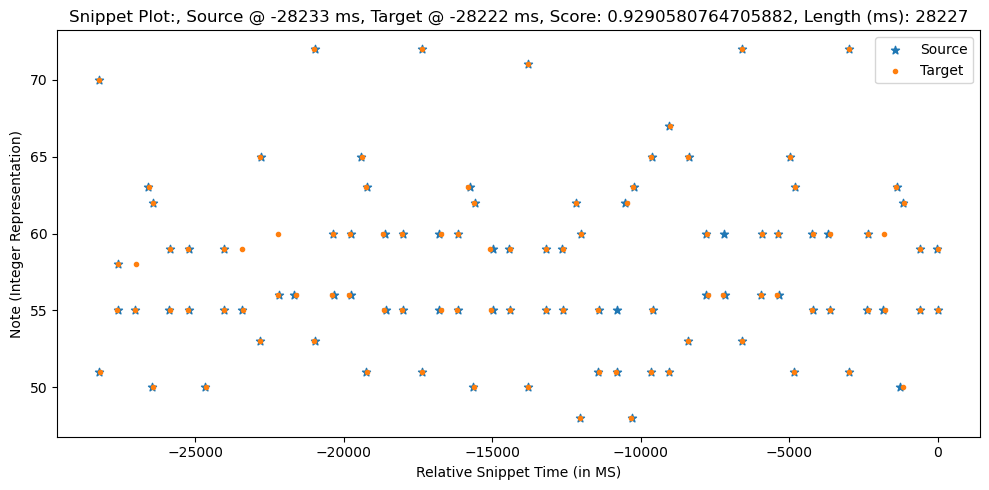

0.9290633529411765
Scores: [ 0.98    0.9875  0.9125  0.9425  1.     -0.      0.95    0.9675  0.9875
  0.935   0.925   0.9475  0.9125  0.895   0.985   0.97   -0.      0.9475
  0.9875  0.95   -0.      0.9125  0.845   0.9175  0.9125  0.8925  0.935
  0.8975  0.925   0.9525  0.97    0.9375  0.815   0.835   0.9     0.9
  0.9675  0.99    0.84    0.88    0.93    0.975   0.8225  0.97    0.875
  0.7825  0.7725  0.9525  0.975   0.9975  0.9975  0.9825  0.995   0.925
  0.9825  0.9975  0.965   0.95    0.935   0.905   0.9325  0.8575  0.9075
  0.95    0.9175  0.99    0.945   0.9925  0.9975  0.98    0.96    0.9025
  0.8475  0.8325  0.955   0.9975  0.97    0.95    0.815   0.9825  0.995
  0.9875  0.995   0.9675  0.93    0.995   0.8575  0.965   0.9775  0.95
  0.955  -0.      0.9075  0.8775  0.7775  0.92    0.9825  0.985   0.9925
  0.945   0.9675  0.915   0.9075  0.8825  0.8975  0.8975  0.855   0.7975
  0.9075]
Sequence1:  [[-30631     70     58]
 [-30620     51     46]
 [-30021     55     45]
 [-30018    

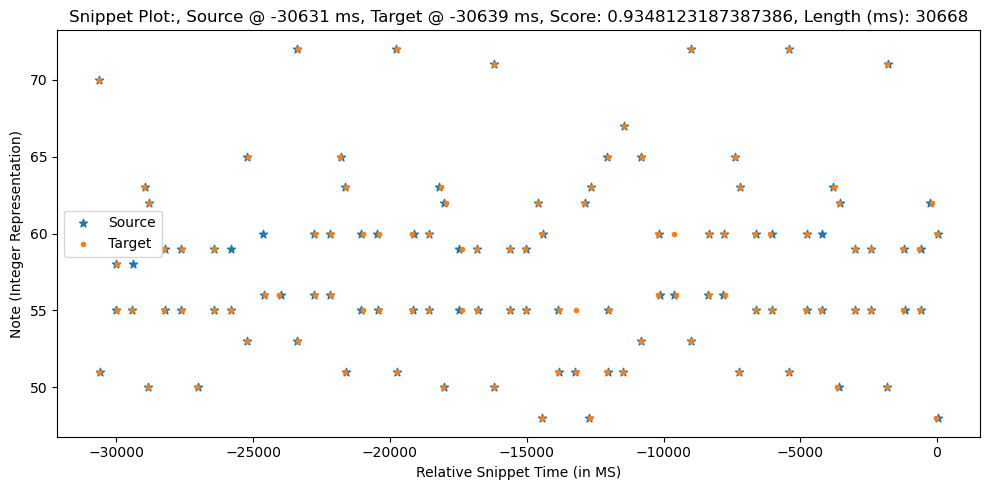

Scores: [ 0.98    0.9875  0.9425  0.9125  1.      0.95    0.9675  0.9875  0.925
  0.935   0.9475  0.9125  0.895   0.97    0.985   0.9475  0.9875  0.95
  0.9125  0.845   0.9175  0.9125  0.935   0.8925  0.8975  0.925   0.9525
  0.9375  0.97    0.815   0.835   0.9     0.9     0.9675  0.99    0.84
  0.88    0.93    0.975   0.8225  0.97    0.875   0.7825  0.7725  0.9525
  0.975   0.9975  0.9975  0.995   0.9825  0.925   0.9825  0.9975  0.965
  0.95    0.905   0.935   0.9325 -0.      0.8575  0.9075  0.95    0.99
  0.9175  0.945   0.9925  0.9975  0.98    0.96    0.9025  0.8475 -0.
  0.8325  0.9975  0.955   0.97    0.95    0.9825  0.815   0.995   0.9875
  0.995   0.93    0.9675  0.8575  0.995   0.9775  0.965   0.95    0.955
  0.9075  0.8775  0.7775  0.92    0.9825  0.985   0.945   0.9925  0.9675
  0.915   0.9075  0.8825  0.8975  0.8975  0.855   0.7975  0.9075]
Sequence1:  [[-30676     70     53]
 [-30662     51     51]
 [-30032     58     33]
 [-30023     55     42]
 [-29451     55     48]
 [-2

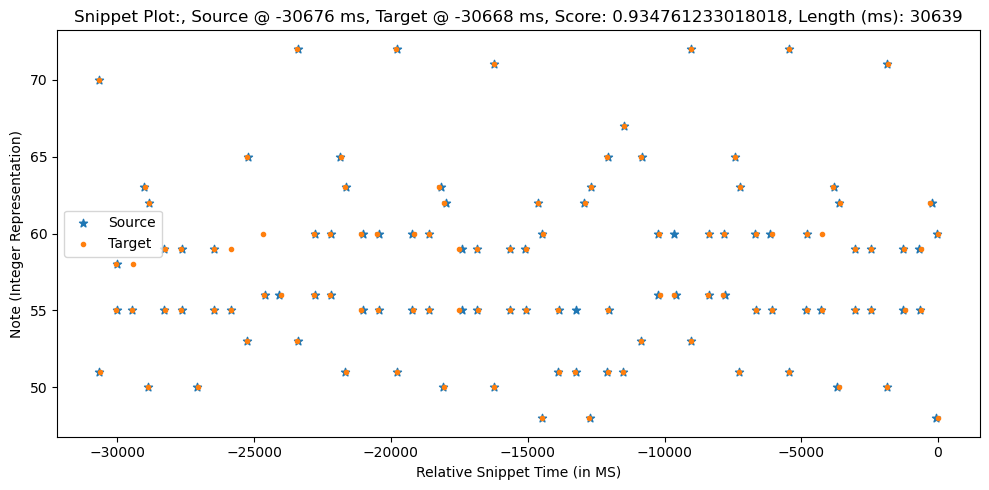

0.9348123187387386
Scores: [ 0.975   0.9825  0.9175  0.9475  0.995  -0.      0.945   0.9625  0.9825
  0.93    0.92    0.9525  0.9175  0.89    0.98    0.965  -0.      0.9425
  0.9925  0.955  -0.      0.9175  0.84    0.9225  0.9175  0.8975  0.94
  0.9025  0.93    0.9475  0.975   0.9325  0.82    0.84    0.905   0.905
  0.9725  0.995   0.835   0.875   0.935   0.98    0.8275  0.965   0.88
  0.7875  0.7775  0.9475  0.97    0.9925  0.9975  0.9875  0.99    0.92
  0.9775  0.9925  0.96    0.945   0.94    0.9     0.9375  0.8525  0.9125
  0.955   0.9225  0.985   0.95    0.9875  0.9925  0.985   0.965   0.8975
  0.8425  0.8375  0.96    0.9925  0.975   0.945   0.82    0.9875  0.99
  0.9825  0.99    0.9725  0.925   0.99    0.8525  0.97    0.9825  0.945
  0.95   -0.      0.9025  0.8825  0.7725  0.915   0.9875  0.98    0.9875
  0.94    0.9625  0.91    0.9025  0.8775  0.8925  0.8925  0.86    0.7925
  0.9025  0.9725  0.99    0.93    0.9725  0.905 ]
Sequence1:  [[-32419     70     58]
 [-32408     51     4

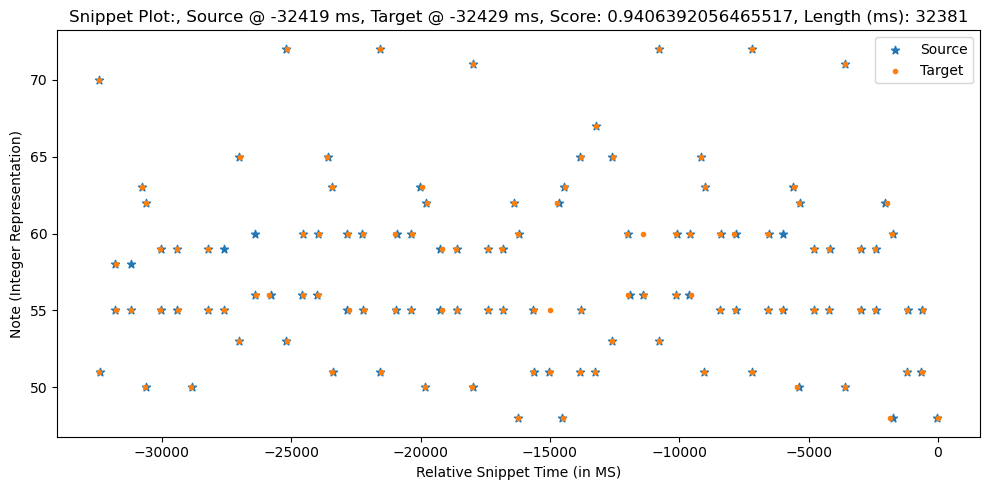

Scores: [ 0.975   0.9825  0.9475  0.9175  0.995   0.945   0.9625  0.9825  0.92
  0.93    0.9525  0.9175  0.89    0.965   0.98    0.9425  0.9925  0.955
  0.9175  0.84    0.9225  0.9175  0.94    0.8975  0.9025  0.93    0.9475
  0.9325  0.975   0.82    0.84    0.905   0.905   0.9725  0.995   0.835
  0.875   0.935   0.98    0.8275  0.965   0.88    0.7875  0.7775  0.9475
  0.97    0.9925  0.9975  0.99    0.9875  0.92    0.9775  0.9925  0.96
  0.945   0.9     0.94    0.9375 -0.      0.8525  0.9125  0.955   0.985
  0.9225  0.95    0.9875  0.9925  0.985   0.965   0.8975  0.8425 -0.
  0.8375  0.9925  0.96    0.975   0.945   0.9875  0.82    0.99    0.9825
  0.99    0.925   0.9725  0.8525  0.99    0.9825  0.97    0.945   0.95
  0.9025  0.8825  0.7725  0.915   0.9875  0.98    0.94    0.9875  0.9625
  0.91    0.9025  0.8775  0.8925  0.8925  0.86    0.7925  0.9025  0.9725
  0.99    0.93    0.9725  0.905 ]
Sequence1:  [[-32391     70     53]
 [-32377     51     51]
 [-31747     58     33]
 [-31738   

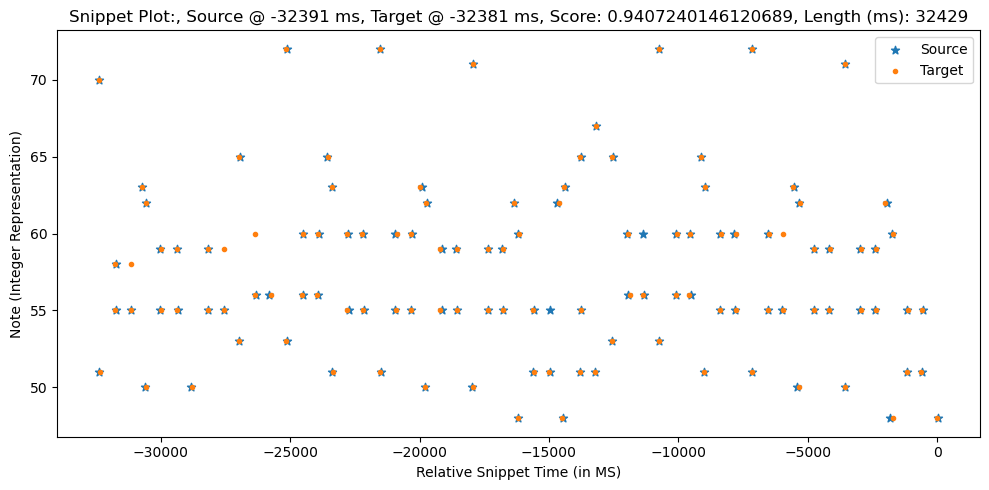

0.9407240146120689
Scores: [ 0.9825  0.99    0.91    0.94    0.9975 -0.      0.9525  0.97    0.99
  0.9375  0.9275  0.945   0.91    0.8975  0.9875  0.9725 -0.      0.95
  0.985   0.9475 -0.      0.91    0.8475  0.915   0.91    0.89    0.9325
  0.895   0.9225  0.955   0.9675  0.94    0.8125  0.8325  0.8975  0.8975
  0.965   0.9875  0.8425  0.8825  0.9275  0.9725  0.82    0.9725  0.8725
  0.78    0.77    0.955   0.9775  1.      0.995   0.98    0.9975  0.9275
  0.985   1.      0.9675  0.9525  0.9325  0.9075  0.93    0.86    0.905
  0.9475  0.915   0.9925  0.9425  0.995   1.      0.9775  0.9575  0.905
  0.85    0.83    0.9525  1.      0.9675  0.9525  0.8125  0.98    0.9975
  0.99    0.9975  0.965   0.9325  0.9975  0.86    0.9625  0.975   0.9525
  0.9575 -0.      0.91    0.875   0.78    0.9225  0.98    0.9875  0.995
  0.9475  0.97    0.9175  0.91    0.885   0.9     0.9     0.8525  0.8
  0.91    0.98    0.9975  0.9225  0.965   0.8975  0.85    0.8875  0.8875
  0.93    0.95    0.95  ]
Sequence

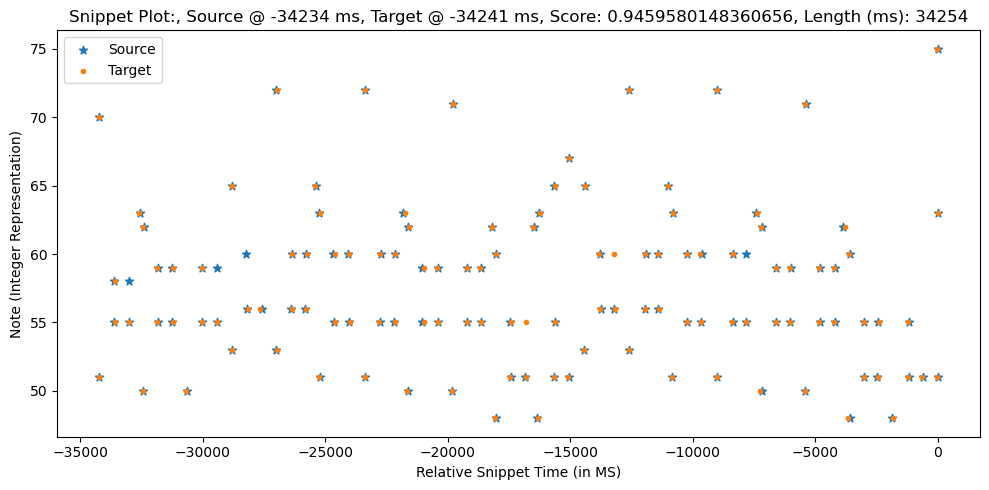

Scores: [ 0.9825  0.99    0.94    0.91    0.9975  0.9525  0.97    0.99    0.9275
  0.9375  0.945   0.91    0.8975  0.9725  0.9875  0.95    0.985   0.9475
  0.91    0.8475  0.915   0.91    0.9325  0.89    0.895   0.9225  0.955
  0.94    0.9675  0.8125  0.8325  0.8975  0.8975  0.965   0.9875  0.8425
  0.8825  0.9275  0.9725  0.82    0.9725  0.8725  0.78    0.77    0.955
  0.9775  1.      0.995   0.9975  0.98    0.9275  0.985   1.      0.9675
  0.9525  0.9075  0.9325  0.93   -0.      0.86    0.905   0.9475  0.9925
  0.915   0.9425  0.995   1.      0.9775  0.9575  0.905   0.85   -0.
  0.83    1.      0.9525  0.9675  0.9525  0.98    0.8125  0.9975  0.99
  0.9975  0.9325  0.965   0.86    0.9975  0.975   0.9625  0.9525  0.9575
  0.91    0.875   0.78    0.9225  0.98    0.9875  0.9475  0.995   0.97
  0.9175  0.91    0.885   0.9     0.9     0.8525  0.8     0.91    0.98
  0.9975  0.9225  0.965   0.8975  0.85    0.8875  0.8875  0.93    0.95
  0.95  ]
Sequence1:  [[-34261     70     53]
 [-34247   

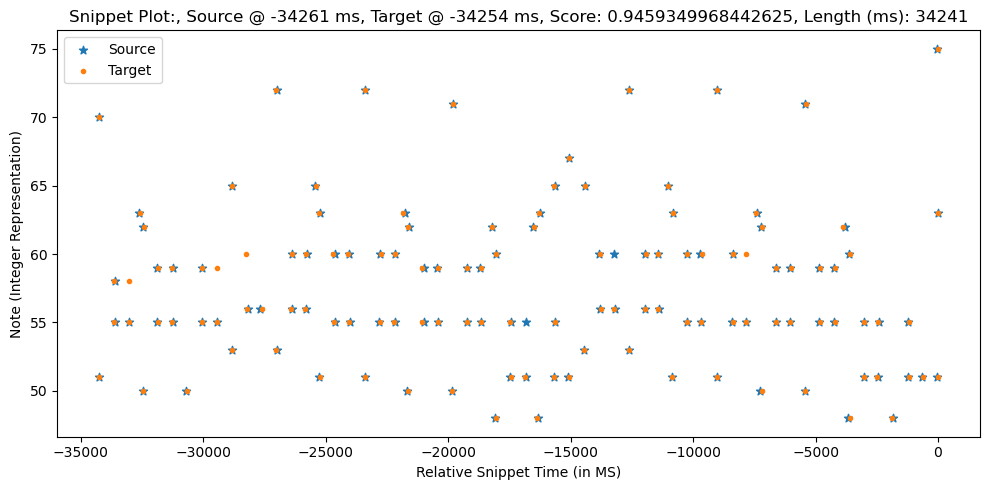

0.9459580148360656
Scores: [ 0.9775  0.985   0.915   0.945   0.9975 -0.      0.9475  0.965   0.985
  0.9325  0.9225  0.95    0.915   0.8925  0.9825  0.9675 -0.      0.945
  0.99    0.9525 -0.      0.915   0.8425  0.92    0.915   0.895   0.9375
  0.9     0.9275  0.95    0.9725  0.935   0.8175  0.8375  0.9025  0.9025
  0.97    0.9925  0.8375  0.8775  0.9325  0.9775  0.825   0.9675  0.8775
  0.785   0.775   0.95    0.9725  0.995   1.      0.985   0.9925  0.9225
  0.98    0.995   0.9625  0.9475  0.9375  0.9025  0.935   0.855   0.91
  0.9525  0.92    0.9875  0.9475  0.99    0.995   0.9825  0.9625  0.9
  0.845   0.835   0.9575  0.995   0.9725  0.9475  0.8175  0.985   0.9925
  0.985   0.9925  0.97    0.9275  0.9925  0.855   0.9675  0.98    0.9475
  0.9525 -0.      0.905   0.88    0.775   0.9175  0.985   0.9825  0.99
  0.9425  0.965   0.9125  0.905   0.88    0.895   0.895   0.8575  0.795
  0.905   0.975   0.9925  0.9275  0.97    0.9025  0.845   0.8825  0.8825
  0.925   0.945   0.945   0.935   

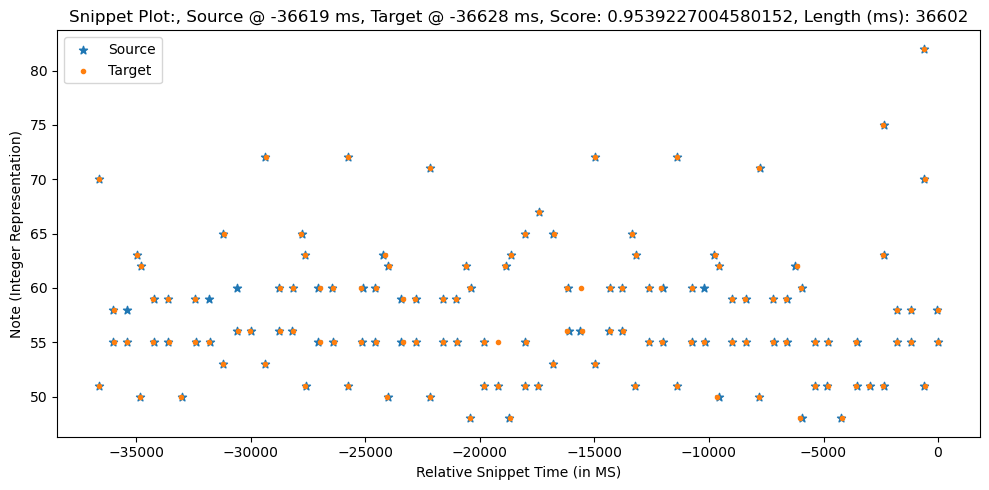

Scores: [ 0.9775  0.985   0.945   0.915   0.9975  0.9475  0.965   0.985   0.9225
  0.9325  0.95    0.915   0.8925  0.9675  0.9825  0.945   0.99    0.9525
  0.915   0.8425  0.92    0.915   0.9375  0.895   0.9     0.9275  0.95
  0.935   0.9725  0.8175  0.8375  0.9025  0.9025  0.97    0.9925  0.8375
  0.8775  0.9325  0.9775  0.825   0.9675  0.8775  0.785   0.775   0.95
  0.9725  0.995   1.      0.9925  0.985   0.9225  0.98    0.995   0.9625
  0.9475  0.9025  0.9375  0.935  -0.      0.855   0.91    0.9525  0.9875
  0.92    0.9475  0.99    0.995   0.9825  0.9625  0.9     0.845  -0.
  0.835   0.995   0.9575  0.9725  0.9475  0.985   0.8175  0.9925  0.985
  0.9925  0.9275  0.97    0.855   0.9925  0.98    0.9675  0.9475  0.9525
  0.905   0.88    0.775   0.9175  0.985   0.9825  0.9425  0.99    0.965
  0.9125  0.905   0.88    0.895   0.895   0.8575  0.795   0.905   0.975
  0.9925  0.9275  0.97    0.9025  0.845   0.8825  0.8825  0.925   0.945
  0.945   0.935   0.9675  0.995   0.97    0.96    0.937

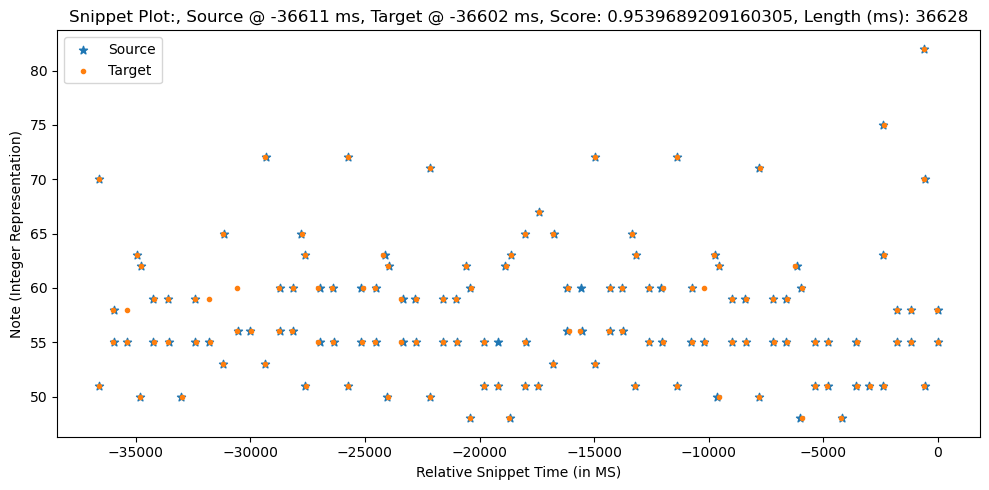

0.9539689209160305
Scores: [ 0.9825  0.99    0.91    0.94    0.9975 -0.      0.9525  0.97    0.99
  0.9375  0.9275  0.945   0.91    0.8975  0.9875  0.9725 -0.      0.95
  0.985   0.9475 -0.      0.91    0.8475  0.915   0.91    0.89    0.9325
  0.895   0.9225  0.955   0.9675  0.94    0.8125  0.8325  0.8975  0.8975
  0.965   0.9875  0.8425  0.8825  0.9275  0.9725  0.82    0.9725  0.8725
  0.78    0.77    0.955   0.9775  1.      0.995   0.98    0.9975  0.9275
  0.985   1.      0.9675  0.9525  0.9325  0.9075  0.93    0.86    0.905
  0.9475  0.915   0.9925  0.9425  0.995   1.      0.9775  0.9575  0.905
  0.85    0.83    0.9525  1.      0.9675  0.9525  0.8125  0.98    0.9975
  0.99    0.9975  0.965   0.9325  0.9975  0.86    0.9625  0.975   0.9525
  0.9575 -0.      0.91    0.875   0.78    0.9225  0.98    0.9875  0.995
  0.9475  0.97    0.9175  0.91    0.885   0.9     0.9     0.8525  0.8
  0.91    0.98    0.9975  0.9225  0.965   0.8975  0.85    0.8875  0.8875
  0.93    0.95    0.95    0.94    

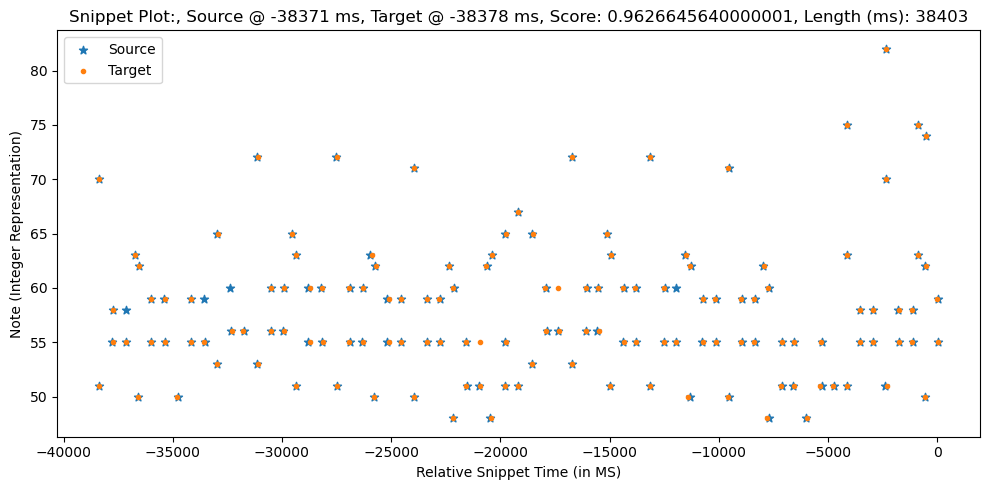

Scores: [ 0.9825  0.99    0.94    0.91    0.9975  0.9525  0.97    0.99    0.9275
  0.9375  0.945   0.91    0.8975  0.9725  0.9875  0.95    0.985   0.9475
  0.91    0.8475  0.915   0.91    0.9325  0.89    0.895   0.9225  0.955
  0.94    0.9675  0.8125  0.8325  0.8975  0.8975  0.965   0.9875  0.8425
  0.8825  0.9275  0.9725  0.82    0.9725  0.8725  0.78    0.77    0.955
  0.9775  1.      0.995   0.9975  0.98    0.9275  0.985   1.      0.9675
  0.9525  0.9075  0.9325  0.93   -0.      0.86    0.905   0.9475  0.9925
  0.915   0.9425  0.995   1.      0.9775  0.9575  0.905   0.85   -0.
  0.83    1.      0.9525  0.9675  0.9525  0.98    0.8125  0.9975  0.99
  0.9975  0.9325  0.965   0.86    0.9975  0.975   0.9625  0.9525  0.9575
  0.91    0.875   0.78    0.9225  0.98    0.9875  0.9475  0.995   0.97
  0.9175  0.91    0.885   0.9     0.9     0.8525  0.8     0.91    0.98
  0.9975  0.9225  0.965   0.8975  0.85    0.8875  0.8875  0.93    0.95
  0.95    0.94    0.9725  1.      0.965   0.955   0.9325 

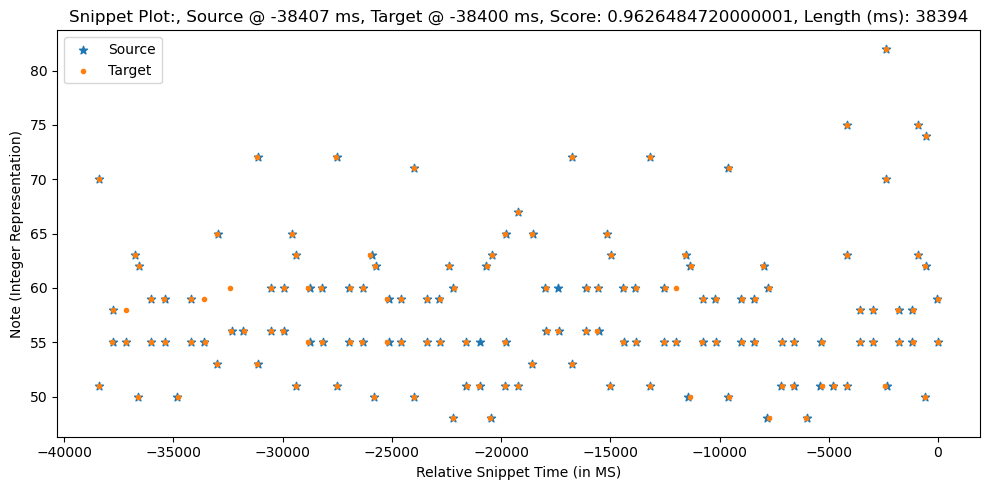

0.9626645640000001
Scores: [ 0.9825  0.99    0.91    0.94    0.9975 -0.      0.9525  0.97    0.99
  0.9375  0.9275  0.945   0.91    0.8975  0.9875  0.9725 -0.      0.95
  0.985   0.9475 -0.      0.91    0.8475  0.915   0.91    0.89    0.9325
  0.895   0.9225  0.955   0.9675  0.94    0.8125  0.8325  0.8975  0.8975
  0.965   0.9875  0.8425  0.8825  0.9275  0.9725  0.82    0.9725  0.8725
  0.78    0.77    0.955   0.9775  1.      0.995   0.98    0.9975  0.9275
  0.985   1.      0.9675  0.9525  0.9325  0.9075  0.93    0.86    0.905
  0.9475  0.915   0.9925  0.9425  0.995   1.      0.9775  0.9575  0.905
  0.85    0.83    0.9525  1.      0.9675  0.9525  0.8125  0.98    0.9975
  0.99    0.9975  0.965   0.9325  0.9975  0.86    0.9625  0.975   0.9525
  0.9575 -0.      0.91    0.875   0.78    0.9225  0.98    0.9875  0.995
  0.9475  0.97    0.9175  0.91    0.885   0.9     0.9     0.8525  0.8
  0.91    0.98    0.9975  0.9225  0.965   0.8975  0.85    0.8875  0.8875
  0.93    0.95    0.95    0.94    

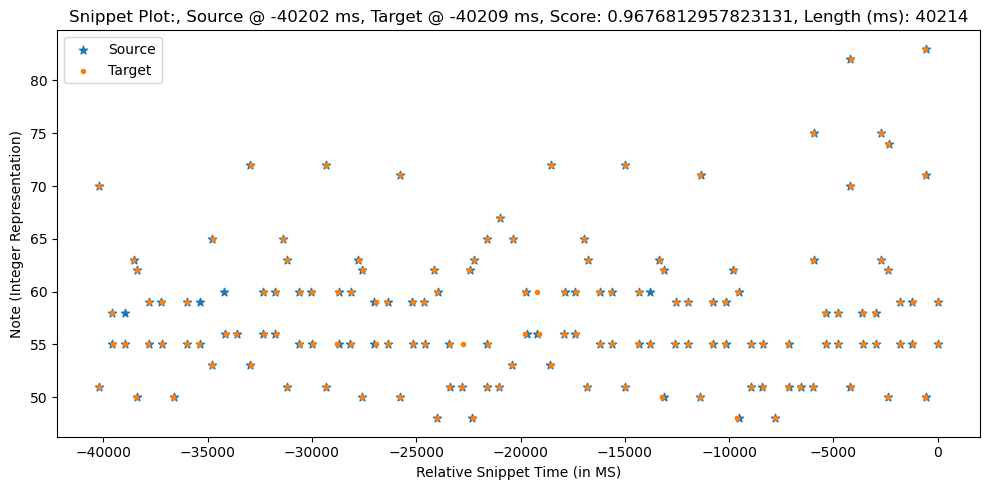

Scores: [ 0.98    0.9875  0.9425  0.9125  1.      0.95    0.9675  0.9875  0.925
  0.935   0.9475  0.9125  0.895   0.97    0.985   0.9475  0.9875  0.95
  0.9125  0.845   0.9175  0.9125  0.935   0.8925  0.8975  0.925   0.9525
  0.9375  0.97    0.815   0.835   0.9     0.9     0.9675  0.99    0.84
  0.88    0.93    0.975   0.8225  0.97    0.875   0.7825  0.7725  0.9525
  0.975   0.9975  0.9975  0.995   0.9825  0.925   0.9825  0.9975  0.965
  0.95    0.905   0.935   0.9325 -0.      0.8575  0.9075  0.95    0.99
  0.9175  0.945   0.9925  0.9975  0.98    0.96    0.9025  0.8475 -0.
  0.8325  0.9975  0.955   0.97    0.95    0.9825  0.815   0.995   0.9875
  0.995   0.93    0.9675  0.8575  0.995   0.9775  0.965   0.95    0.955
  0.9075  0.8775  0.7775  0.92    0.9825  0.985   0.945   0.9925  0.9675
  0.915   0.9075  0.8825  0.8975  0.8975  0.855   0.7975  0.9075  0.9775
  0.995   0.925   0.9675  0.9     0.8475  0.885   0.885   0.9275  0.9475
  0.9475  0.9375  0.97    0.9975  0.9675  0.9575  0.935 

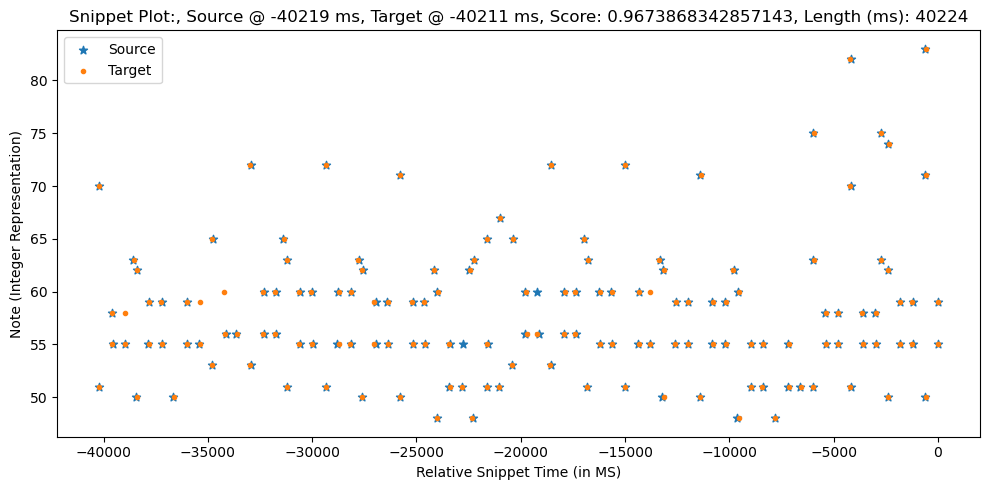

0.9676812957823131
Scores: [ 0.98    0.9875  0.9125  0.9425  1.     -0.      0.95    0.9675  0.9875
  0.935   0.925   0.9475  0.9125  0.895   0.985   0.97   -0.      0.9475
  0.9875  0.95   -0.      0.9125  0.845   0.9175  0.9125  0.8925  0.935
  0.8975  0.925   0.9525  0.97    0.9375  0.815   0.835   0.9     0.9
  0.9675  0.99    0.84    0.88    0.93    0.975   0.8225  0.97    0.875
  0.7825  0.7725  0.9525  0.975   0.9975  0.9975  0.9825  0.995   0.925
  0.9825  0.9975  0.965   0.95    0.935   0.905   0.9325  0.8575  0.9075
  0.95    0.9175  0.99    0.945   0.9925  0.9975  0.98    0.96    0.9025
  0.8475  0.8325  0.955   0.9975  0.97    0.95    0.815   0.9825  0.995
  0.9875  0.995   0.9675  0.93    0.995   0.8575  0.965   0.9775  0.95
  0.955  -0.      0.9075  0.8775  0.7775  0.92    0.9825  0.985   0.9925
  0.945   0.9675  0.915   0.9075  0.8825  0.8975  0.8975  0.855   0.7975
  0.9075  0.9775  0.995   0.925   0.9675  0.9     0.8475  0.885   0.885
  0.9275  0.9475  0.9475  0.9375  

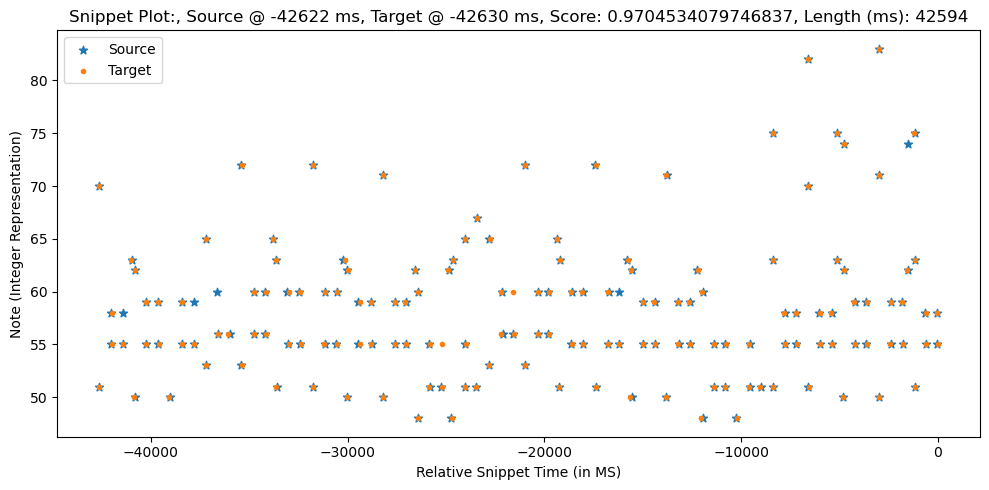

Scores: [ 0.98    0.9875  0.9425  0.9125  1.      0.95    0.9675  0.9875  0.925
  0.935   0.9475  0.9125  0.895   0.97    0.985   0.9475  0.9875  0.95
  0.9125  0.845   0.9175  0.9125  0.935   0.8925  0.8975  0.925   0.9525
  0.9375  0.97    0.815   0.835   0.9     0.9     0.9675  0.99    0.84
  0.88    0.93    0.975   0.8225  0.97    0.875   0.7825  0.7725  0.9525
  0.975   0.9975  0.9975  0.995   0.9825  0.925   0.9825  0.9975  0.965
  0.95    0.905   0.935   0.9325 -0.      0.8575  0.9075  0.95    0.99
  0.9175  0.945   0.9925  0.9975  0.98    0.96    0.9025  0.8475 -0.
  0.8325  0.9975  0.955   0.97    0.95    0.9825  0.815   0.995   0.9875
  0.995   0.93    0.9675  0.8575  0.995   0.9775  0.965   0.95    0.955
  0.9075  0.8775  0.7775  0.92    0.9825  0.985   0.945   0.9925  0.9675
  0.915   0.9075  0.8825  0.8975  0.8975  0.855   0.7975  0.9075  0.9775
  0.995   0.925   0.9675  0.9     0.8475  0.885   0.885   0.9275  0.9475
  0.9475  0.9375  0.97    0.9975  0.9675  0.9575  0.935 

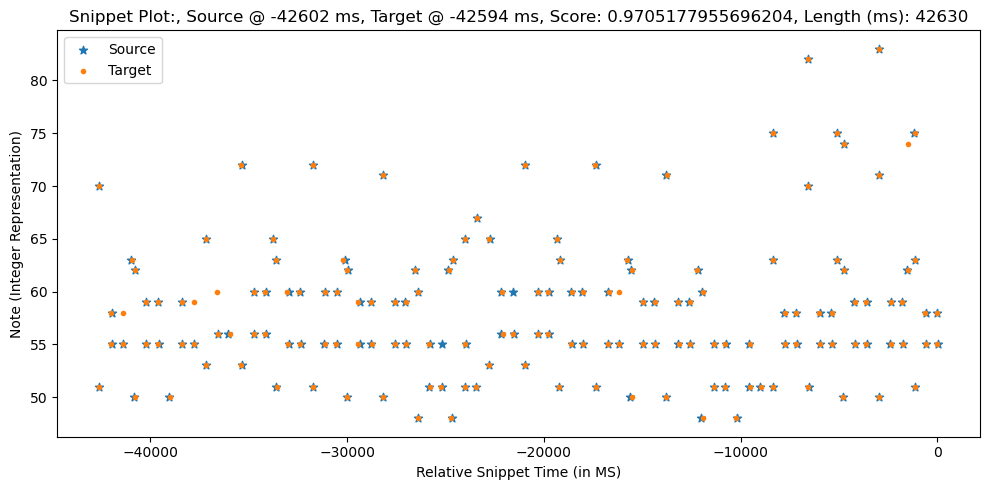

0.9705177955696204
Scores: [ 0.9875  0.995   0.905   0.935   0.9925 -0.      0.9575  0.975   0.995
  0.9425  0.9325  0.94    0.905   0.9025  0.9925  0.9775 -0.      0.955
  0.98    0.9425 -0.      0.905   0.8525  0.91    0.905   0.885   0.9275
  0.89    0.9175  0.96    0.9625  0.945   0.8075  0.8275  0.8925  0.8925
  0.96    0.9825  0.8475  0.8875  0.9225  0.9675  0.815   0.9775  0.8675
  0.775   0.765   0.96    0.9825  0.995   0.99    0.975   0.9975  0.9325
  0.99    0.995   0.9725  0.9575  0.9275  0.9125  0.925   0.865   0.9
  0.9425  0.91    0.9975  0.9375  1.      0.995   0.9725  0.9525  0.91
  0.855   0.825   0.9475  0.995   0.9625  0.9575  0.8075  0.975   0.9975
  0.995   0.9975  0.96    0.9375  0.9975  0.865   0.9575  0.97    0.9575
  0.9625 -0.      0.915   0.87    0.785   0.9275  0.975   0.9925  1.
  0.9525  0.975   0.9225  0.915   0.89    0.905   0.905   0.8475  0.805
  0.915   0.985   0.9975  0.9175  0.96    0.8925  0.855   0.8925  0.8925
  0.935   0.955   0.955   0.945   0.

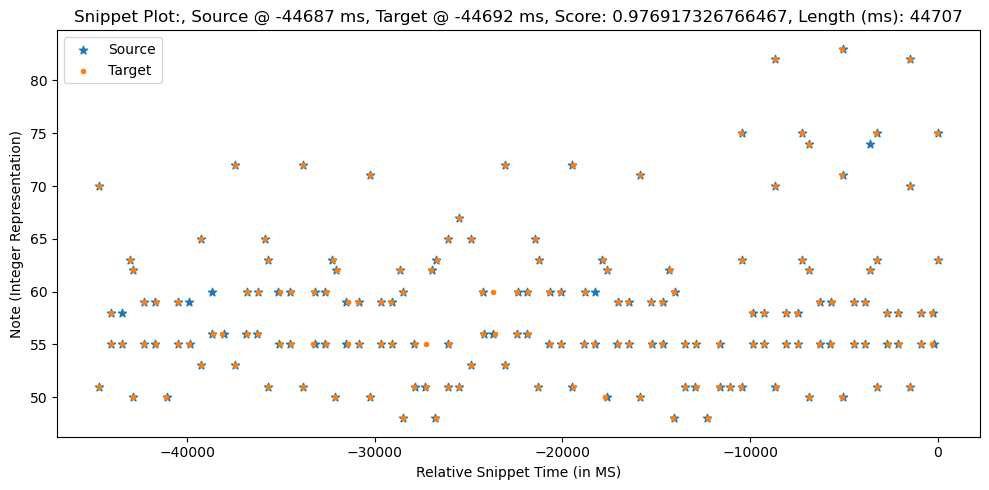

Scores: [ 0.9875  0.995   0.935   0.905   0.9925  0.9575  0.975   0.995   0.9325
  0.9425  0.94    0.905   0.9025  0.9775  0.9925  0.955   0.98    0.9425
  0.905   0.8525  0.91    0.905   0.9275  0.885   0.89    0.9175  0.96
  0.945   0.9625  0.8075  0.8275  0.8925  0.8925  0.96    0.9825  0.8475
  0.8875  0.9225  0.9675  0.815   0.9775  0.8675  0.775   0.765   0.96
  0.9825  0.995   0.99    0.9975  0.975   0.9325  0.99    0.995   0.9725
  0.9575  0.9125  0.9275  0.925  -0.      0.865   0.9     0.9425  0.9975
  0.91    0.9375  1.      0.995   0.9725  0.9525  0.91    0.855  -0.
  0.825   0.995   0.9475  0.9625  0.9575  0.975   0.8075  0.9975  0.995
  0.9975  0.9375  0.96    0.865   0.9975  0.97    0.9575  0.9575  0.9625
  0.915   0.87    0.785   0.9275  0.975   0.9925  0.9525  1.      0.975
  0.9225  0.915   0.89    0.905   0.905   0.8475  0.805   0.915   0.985
  0.9975  0.9175  0.96    0.8925  0.855   0.8925  0.8925  0.935   0.955
  0.955   0.945   0.9775  0.995   0.96    0.95    0.927

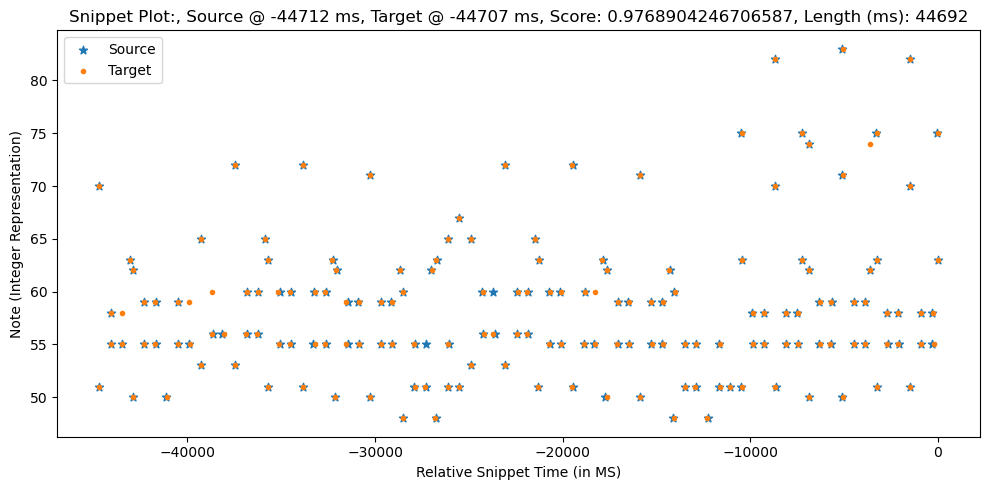

0.976917326766467
Scores: [ 0.9975  0.995   0.895   0.925   0.9825 -0.      0.9675  0.985   0.995
  0.9525  0.9425  0.93    0.895   0.9125  0.9975  0.9875 -0.      0.965
  0.97    0.9325 -0.      0.895   0.8625  0.9     0.895   0.875   0.9175
  0.88    0.9075  0.97    0.9525  0.955   0.7975  0.8175  0.8825  0.8825
  0.95    0.9725  0.8575  0.8975  0.9125  0.9575  0.805   0.9875  0.8575
  0.765   0.755   0.97    0.9925  0.985   0.98    0.965   0.9875  0.9425
  1.      0.985   0.9825  0.9675  0.9175  0.9225  0.915   0.875   0.89
  0.9325  0.9     0.9925  0.9275  0.99    0.985   0.9625  0.9425  0.92
  0.865   0.815   0.9375  0.985   0.9525  0.9675  0.7975  0.965   0.9875
  0.995   0.9875  0.95    0.9475  0.9875  0.875   0.9475  0.96    0.9675
  0.9725 -0.      0.925   0.86    0.795   0.9375  0.965   0.9975  0.99
  0.9625  0.985   0.9325  0.925   0.9     0.915   0.915   0.8375  0.815
  0.925   0.995   0.9875  0.9075  0.95    0.8825  0.865   0.9025  0.9025
  0.945   0.965   0.965   0.955   

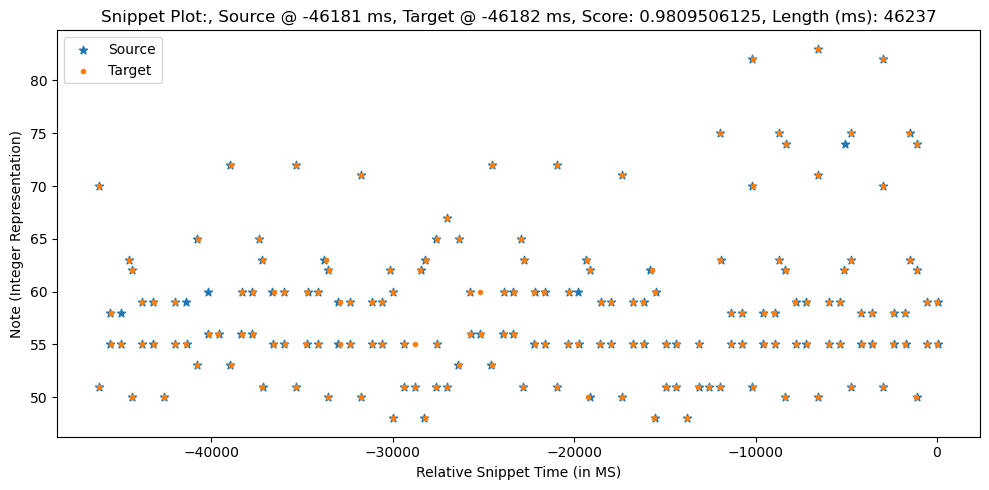

Scores: [ 0.99    0.9975  0.9325  0.9025  0.99    0.96    0.9775  0.9975  0.935
  0.945   0.9375  0.9025  0.905   0.98    0.995   0.9575  0.9775  0.94
  0.9025  0.855   0.9075  0.9025  0.925   0.8825  0.8875  0.915   0.9625
  0.9475  0.96    0.805   0.825   0.89    0.89    0.9575  0.98    0.85
  0.89    0.92    0.965   0.8125  0.98    0.865   0.7725  0.7625  0.9625
  0.985   0.9925  0.9875  0.995   0.9725  0.935   0.9925  0.9925  0.975
  0.96    0.915   0.925   0.9225 -0.      0.8675  0.8975  0.94    1.
  0.9075  0.935   0.9975  0.9925  0.97    0.95    0.9125  0.8575 -0.
  0.8225  0.9925  0.945   0.96    0.96    0.9725  0.805   0.995   0.9975
  0.995   0.94    0.9575  0.8675  0.995   0.9675  0.955   0.96    0.965
  0.9175  0.8675  0.7875  0.93    0.9725  0.995   0.955   0.9975  0.9775
  0.925   0.9175  0.8925  0.9075  0.9075  0.845   0.8075  0.9175  0.9875
  0.995   0.915   0.9575  0.89    0.8575  0.895   0.895   0.9375  0.9575
  0.9575  0.9475  0.98    0.9925  0.9575  0.9475  0.925   

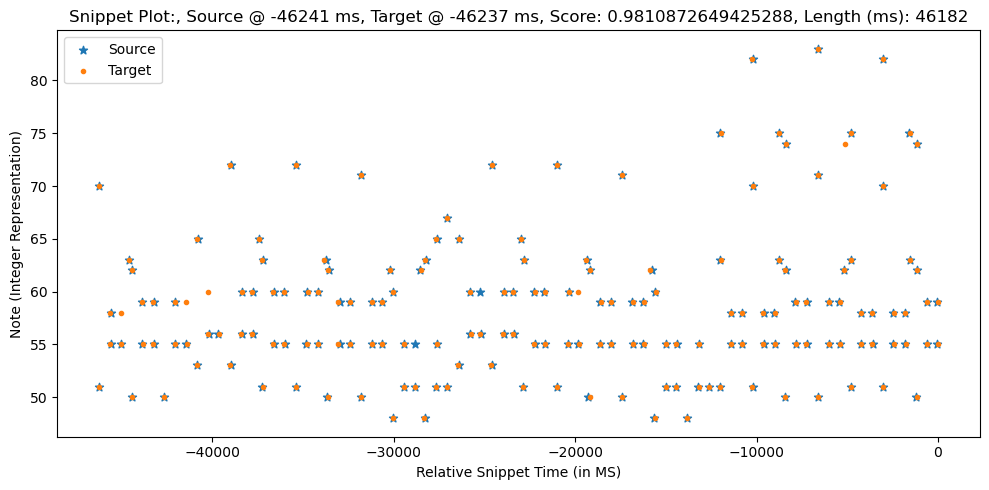

0.9810872649425288
Scores: [ 0.9875  0.995   0.905   0.935   0.9925 -0.      0.9575  0.975   0.995
  0.9425  0.9325  0.94    0.905   0.9025  0.9925  0.9775 -0.      0.955
  0.98    0.9425 -0.      0.905   0.8525  0.91    0.905   0.885   0.9275
  0.89    0.9175  0.96    0.9625  0.945   0.8075  0.8275  0.8925  0.8925
  0.96    0.9825  0.8475  0.8875  0.9225  0.9675  0.815   0.9775  0.8675
  0.775   0.765   0.96    0.9825  0.995   0.99    0.975   0.9975  0.9325
  0.99    0.995   0.9725  0.9575  0.9275  0.9125  0.925   0.865   0.9
  0.9425  0.91    0.9975  0.9375  1.      0.995   0.9725  0.9525  0.91
  0.855   0.825   0.9475  0.995   0.9625  0.9575  0.8075  0.975   0.9975
  0.995   0.9975  0.96    0.9375  0.9975  0.865   0.9575  0.97    0.9575
  0.9625 -0.      0.915   0.87    0.785   0.9275  0.975   0.9925  1.
  0.9525  0.975   0.9225  0.915   0.89    0.905   0.905   0.8475  0.805
  0.915   0.985   0.9975  0.9175  0.96    0.8925  0.855   0.8925  0.8925
  0.935   0.955   0.955   0.945   0.

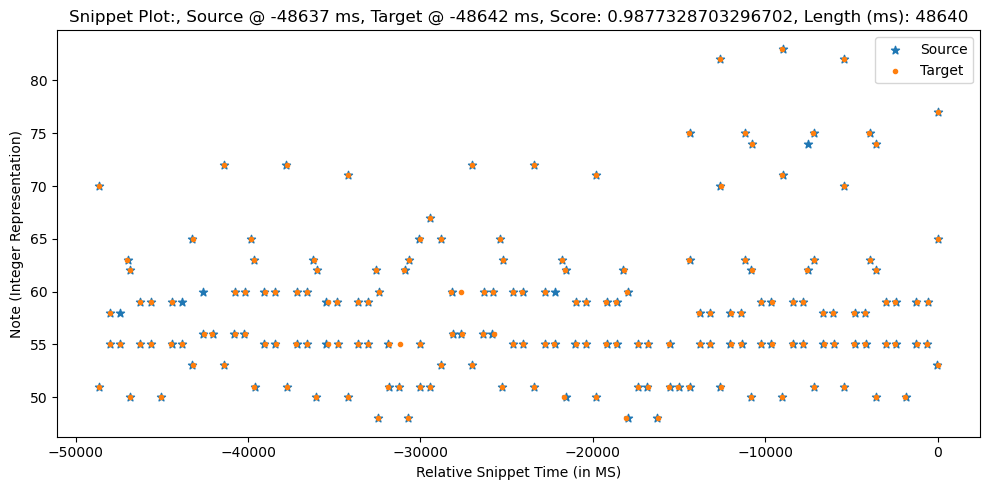

Scores: [ 0.9875  0.995   0.935   0.905   0.9925  0.9575  0.975   0.995   0.9325
  0.9425  0.94    0.905   0.9025  0.9775  0.9925  0.955   0.98    0.9425
  0.905   0.8525  0.91    0.905   0.9275  0.885   0.89    0.9175  0.96
  0.945   0.9625  0.8075  0.8275  0.8925  0.8925  0.96    0.9825  0.8475
  0.8875  0.9225  0.9675  0.815   0.9775  0.8675  0.775   0.765   0.96
  0.9825  0.995   0.99    0.9975  0.975   0.9325  0.99    0.995   0.9725
  0.9575  0.9125  0.9275  0.925  -0.      0.865   0.9     0.9425  0.9975
  0.91    0.9375  1.      0.995   0.9725  0.9525  0.91    0.855  -0.
  0.825   0.995   0.9475  0.9625  0.9575  0.975   0.8075  0.9975  0.995
  0.9975  0.9375  0.96    0.865   0.9975  0.97    0.9575  0.9575  0.9625
  0.915   0.87    0.785   0.9275  0.975   0.9925  0.9525  1.      0.975
  0.9225  0.915   0.89    0.905   0.905   0.8475  0.805   0.915   0.985
  0.9975  0.9175  0.96    0.8925  0.855   0.8925  0.8925  0.935   0.955
  0.955   0.945   0.9775  0.995   0.96    0.95    0.927

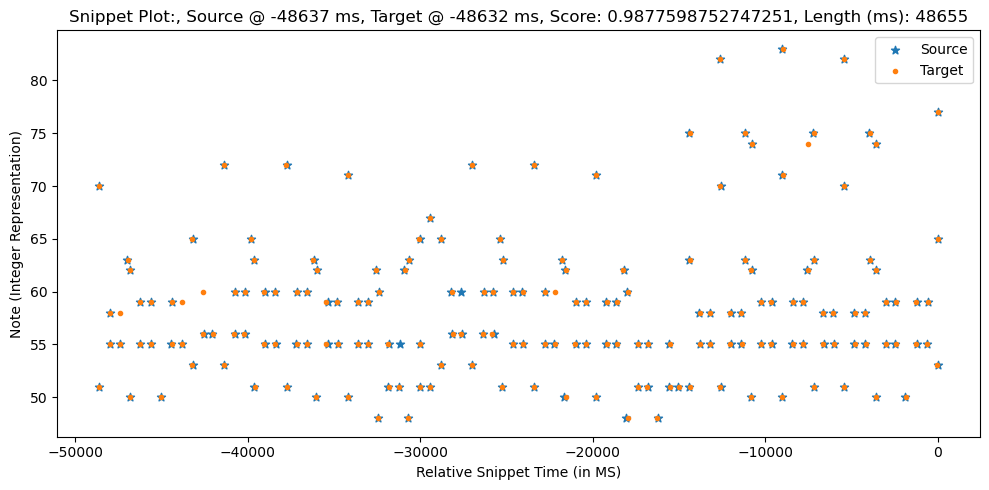

0.9877598752747251
Scores: [ 0.9     0.93    0.9875 -0.      0.9625  0.98    1.      0.9475  0.9375
  0.935   0.9     0.9075  0.9975  0.9825  0.      0.96  ]
Sequence1:  [[-4202    55    45]
 [-4199    58    32]
 [-3595    55    48]
 [-3583    58    39]
 [-3149    63    52]
 [-3013    50    42]
 [-3001    62    56]
 [-2419    59    46]
 [-2417    55    46]
 [-1824    59    42]
 [-1818    55    48]
 [-1209    50    46]
 [ -608    59    39]
 [ -606    55    44]
 [    0    59    34]
 [   16    55    41]]
Sequence2:  [[-4171    58    33]
 [-4162    55    42]
 [-3590    55    48]
 [-3164    63    49]
 [-3021    50    44]
 [-3001    62    54]
 [-2442    55    44]
 [-2440    59    42]
 [-1798    59    41]
 [-1778    55    45]
 [-1246    50    51]
 [ -613    55    44]
 [ -609    59    40]
 [    0    55    47]]
mean_offset1:  16.642857142857142
mean_offset2:  -16.642857142857142
mo:  [0]
Count zeros:  2


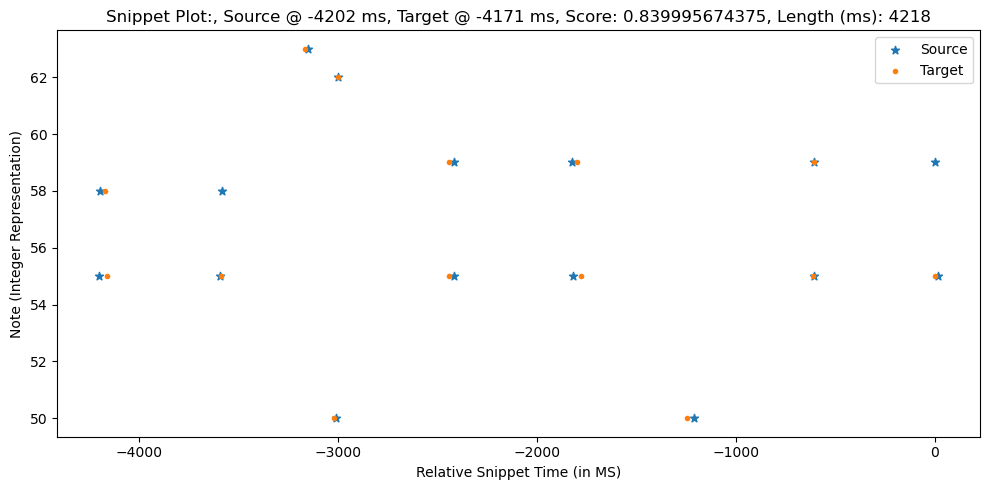

Scores: [0.93   0.9    0.9875 0.9625 0.98   1.     0.9375 0.9475 0.935  0.9
 0.9075 0.9825 0.9975 0.96  ]
Sequence1:  [[-4187    58    33]
 [-4178    55    42]
 [-3606    55    48]
 [-3180    63    49]
 [-3037    50    44]
 [-3017    62    54]
 [-2458    55    44]
 [-2456    59    42]
 [-1814    59    41]
 [-1794    55    45]
 [-1262    50    51]
 [ -629    55    44]
 [ -625    59    40]
 [  -16    55    47]]
Sequence2:  [[-4218    55    45]
 [-4215    58    32]
 [-3611    55    48]
 [-3599    58    39]
 [-3165    63    52]
 [-3029    50    42]
 [-3017    62    56]
 [-2435    59    46]
 [-2433    55    46]
 [-1840    59    42]
 [-1834    55    48]
 [-1225    50    46]
 [ -624    59    39]
 [ -622    55    44]
 [  -16    59    34]
 [    0    55    41]]
mean_offset1:  -16.642857142857142
mean_offset2:  16.642857142857142
mo:  [0]
Count zeros:  0


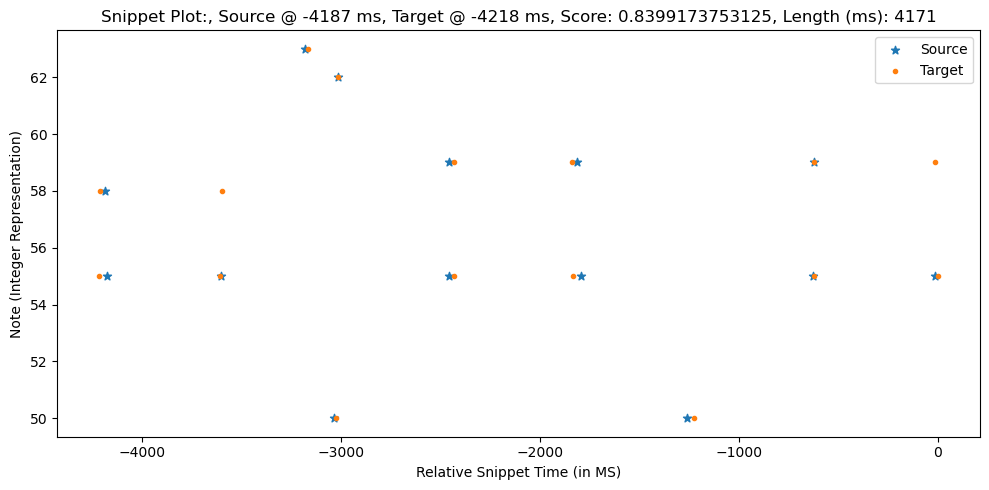

0.839995674375
Scores: [-0.     -0.      0.9175  0.97   -0.     -0.     -0.     -0.     -0.
  0.96    0.94   -0.     -0.     -0.      0.9775  0.9275 -0.     -0.
 -0.     -0.      0.905   0.      0.    ]
Sequence1:  [[-6564    55    45]
 [-6561    58    32]
 [-5957    55    48]
 [-5945    58    39]
 [-5511    63    52]
 [-5375    50    42]
 [-5363    62    56]
 [-4781    59    46]
 [-4779    55    46]
 [-4186    59    42]
 [-4180    55    48]
 [-3571    50    46]
 [-2970    59    39]
 [-2968    55    44]
 [-2362    59    34]
 [-2346    55    41]
 [-1763    53    47]
 [-1760    65    54]
 [-1172    60    34]
 [-1145    56    44]
 [ -543    56    45]
 [   49    53    46]
 [   56    72    59]]
Sequence2:  [[-5933    58    33]
 [-5924    55    42]
 [-5352    55    48]
 [-4926    63    49]
 [-4783    50    44]
 [-4763    62    54]
 [-4204    55    44]
 [-4202    59    42]
 [-3560    59    41]
 [-3540    55    45]
 [-3008    50    51]
 [-2375    55    44]
 [-2371    59    40]
 [-1762    55   

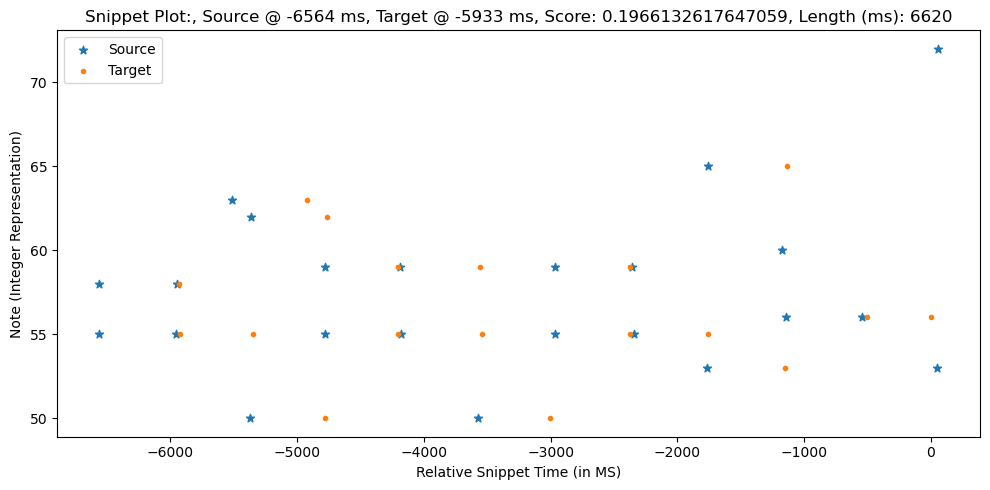

Scores: [0.9325 0.9025 0.99   0.96   0.9775 0.9975 0.935  0.945  0.9375 0.9025
 0.905  0.98   0.995  0.9575 0.9775 0.94   0.9025 0.855 ]
Sequence1:  [[-5991    58    33]
 [-5982    55    42]
 [-5410    55    48]
 [-4984    63    49]
 [-4841    50    44]
 [-4821    62    54]
 [-4262    55    44]
 [-4260    59    42]
 [-3618    59    41]
 [-3598    55    45]
 [-3066    50    51]
 [-2433    55    44]
 [-2429    59    40]
 [-1820    55    47]
 [-1211    53    43]
 [-1193    65    49]
 [ -563    56    41]
 [  -58    56    41]]
Sequence2:  [[-6021    55    45]
 [-6018    58    32]
 [-5414    55    48]
 [-5402    58    39]
 [-4968    63    52]
 [-4832    50    42]
 [-4820    62    56]
 [-4238    59    46]
 [-4236    55    46]
 [-3643    59    42]
 [-3637    55    48]
 [-3028    50    46]
 [-2427    59    39]
 [-2425    55    44]
 [-1819    59    34]
 [-1803    55    41]
 [-1220    53    47]
 [-1217    65    54]
 [ -629    60    34]
 [ -602    56    44]
 [    0    56    45]
 [  592    53    46

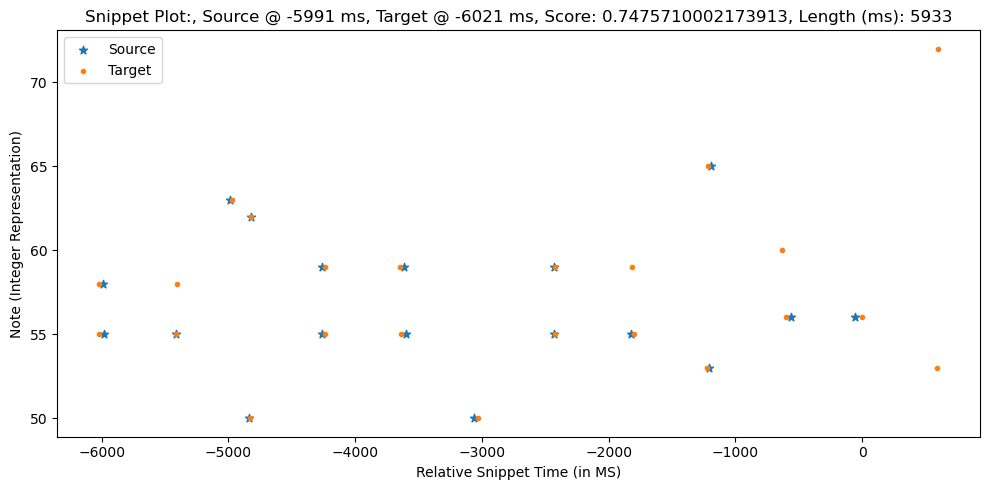

0.7475710002173913
Oops
Scores: [ 0.9225  0.9525  0.99   -0.      0.94    0.9575  0.9775  0.925   0.915
  0.9575  0.9225  0.885   0.975   0.96   -0.      0.9375  0.9975  0.96
 -0.      0.9225  0.835   0.9275  0.9225  0.9025  0.945   0.9075  0.935
  0.9425  0.98    0.9275]
Sequence1:  [[-8377    55    45]
 [-8374    58    32]
 [-7770    55    48]
 [-7758    58    39]
 [-7324    63    52]
 [-7188    50    42]
 [-7176    62    56]
 [-6594    59    46]
 [-6592    55    46]
 [-5999    59    42]
 [-5993    55    48]
 [-5384    50    46]
 [-4783    59    39]
 [-4781    55    44]
 [-4175    59    34]
 [-4159    55    41]
 [-3576    53    47]
 [-3573    65    54]
 [-2985    60    34]
 [-2958    56    44]
 [-2356    56    45]
 [-1764    53    46]
 [-1757    72    59]
 [-1142    56    45]
 [-1131    60    30]
 [ -567    56    49]
 [ -540    60    31]
 [ -149    65    44]
 [    6    63    49]
 [   29    51    46]]
Sequence2:  [[-8355    58    33]
 [-8346    55    42]
 [-7774    55    48]
 [-7348  

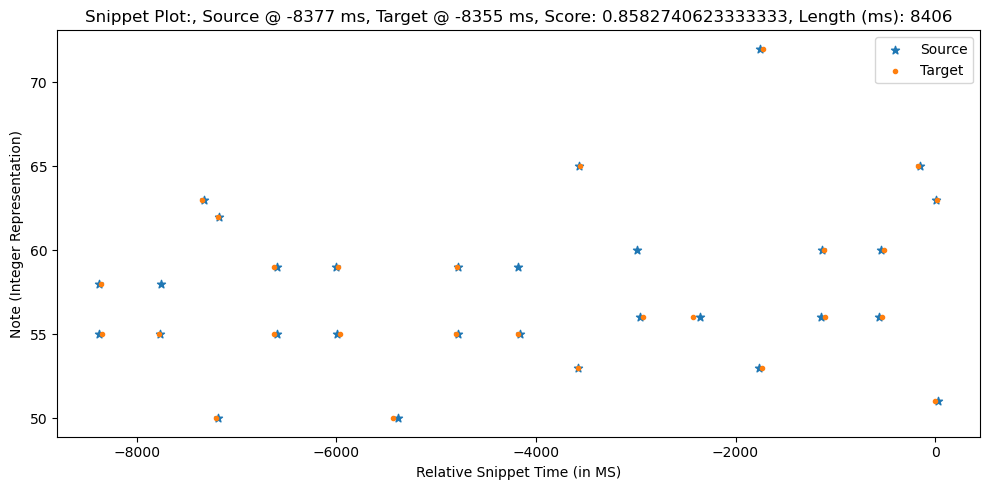

Scores: [0.955  0.925  0.9875 0.9375 0.955  0.975  0.9125 0.9225 0.96   0.925
 0.8825 0.9575 0.9725 0.935  1.     0.9625 0.925  0.8325 0.93   0.925
 0.9475 0.905  0.91   0.9375 0.94   0.925  0.9825]
Sequence1:  [[-8362    58    33]
 [-8353    55    42]
 [-7781    55    48]
 [-7355    63    49]
 [-7212    50    44]
 [-7192    62    54]
 [-6633    55    44]
 [-6631    59    42]
 [-5989    59    41]
 [-5969    55    45]
 [-5437    50    51]
 [-4804    55    44]
 [-4800    59    40]
 [-4191    55    47]
 [-3582    53    43]
 [-3564    65    49]
 [-2934    56    41]
 [-2429    56    41]
 [-1742    53    54]
 [-1733    72    55]
 [-1116    60    32]
 [-1110    56    44]
 [ -537    56    48]
 [ -521    60    31]
 [ -179    65    40]
 [   -7    51    45]
 [    7    63    51]]
Sequence2:  [[-8383    55    45]
 [-8380    58    32]
 [-7776    55    48]
 [-7764    58    39]
 [-7330    63    52]
 [-7194    50    42]
 [-7182    62    56]
 [-6600    59    46]
 [-6598    55    46]
 [-6005    59    42]

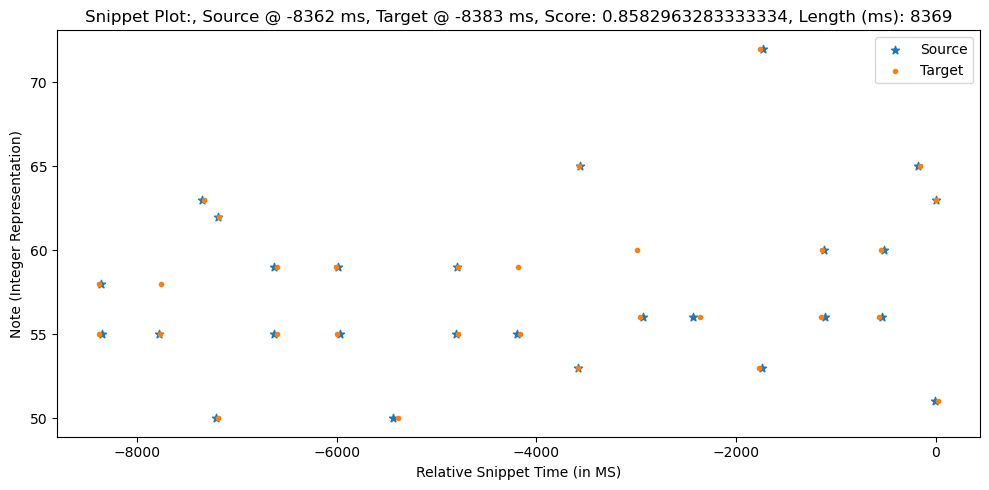

0.8582963283333334
Scores: [ 0.9375  0.9675  0.975  -0.      0.925   0.9425  0.9625  0.91    0.9
  0.9725  0.9375  0.87    0.96    0.945  -0.      0.9225  0.9875  0.975
 -0.      0.9375  0.82    0.9425  0.9375  0.9175  0.96    0.9225  0.95
  0.9275  0.995   0.9125  0.84    0.86    0.925   0.925   0.9925  0.985 ]
Sequence1:  [[-10254     55     45]
 [-10251     58     32]
 [ -9647     55     48]
 [ -9635     58     39]
 [ -9201     63     52]
 [ -9065     50     42]
 [ -9053     62     56]
 [ -8471     59     46]
 [ -8469     55     46]
 [ -7876     59     42]
 [ -7870     55     48]
 [ -7261     50     46]
 [ -6660     59     39]
 [ -6658     55     44]
 [ -6052     59     34]
 [ -6036     55     41]
 [ -5453     53     47]
 [ -5450     65     54]
 [ -4862     60     34]
 [ -4835     56     44]
 [ -4233     56     45]
 [ -3641     53     46]
 [ -3634     72     59]
 [ -3019     56     45]
 [ -3008     60     30]
 [ -2444     56     49]
 [ -2417     60     31]
 [ -2026     65     44]
 [

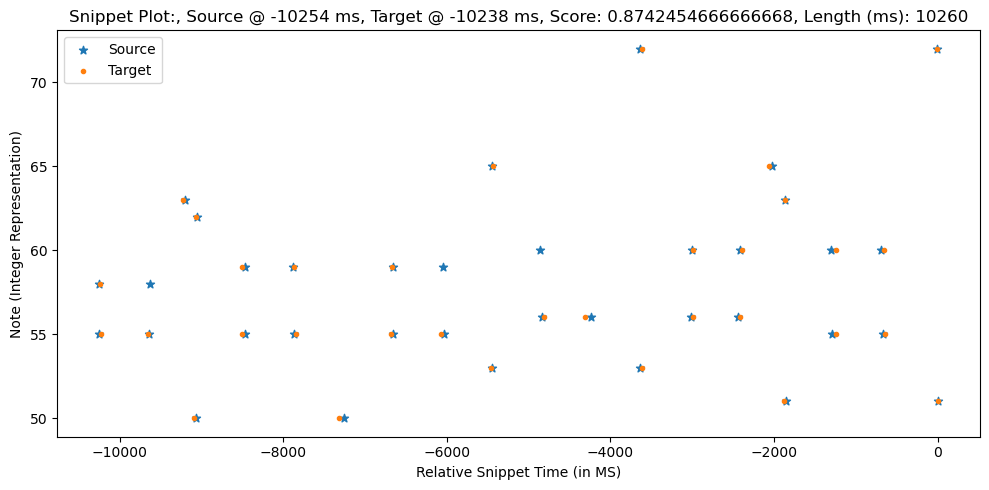

Scores: [0.9675 0.9375 0.975  0.925  0.9425 0.9625 0.9    0.91   0.9725 0.9375
 0.87   0.945  0.96   0.9225 0.9875 0.975  0.9375 0.82   0.9425 0.9375
 0.96   0.9175 0.9225 0.95   0.9275 0.9125 0.995  0.84   0.86   0.925
 0.925  0.9925 0.985 ]
Sequence1:  [[-10244     58     33]
 [-10235     55     42]
 [ -9663     55     48]
 [ -9237     63     49]
 [ -9094     50     44]
 [ -9074     62     54]
 [ -8515     55     44]
 [ -8513     59     42]
 [ -7871     59     41]
 [ -7851     55     45]
 [ -7319     50     51]
 [ -6686     55     44]
 [ -6682     59     40]
 [ -6073     55     47]
 [ -5464     53     43]
 [ -5446     65     49]
 [ -4816     56     41]
 [ -4311     56     41]
 [ -3624     53     54]
 [ -3615     72     55]
 [ -2998     60     32]
 [ -2992     56     44]
 [ -2419     56     48]
 [ -2403     60     31]
 [ -2061     65     40]
 [ -1889     51     45]
 [ -1875     63     51]
 [ -1246     60     39]
 [ -1243     55     44]
 [  -666     60     39]
 [  -649     55     42]
 

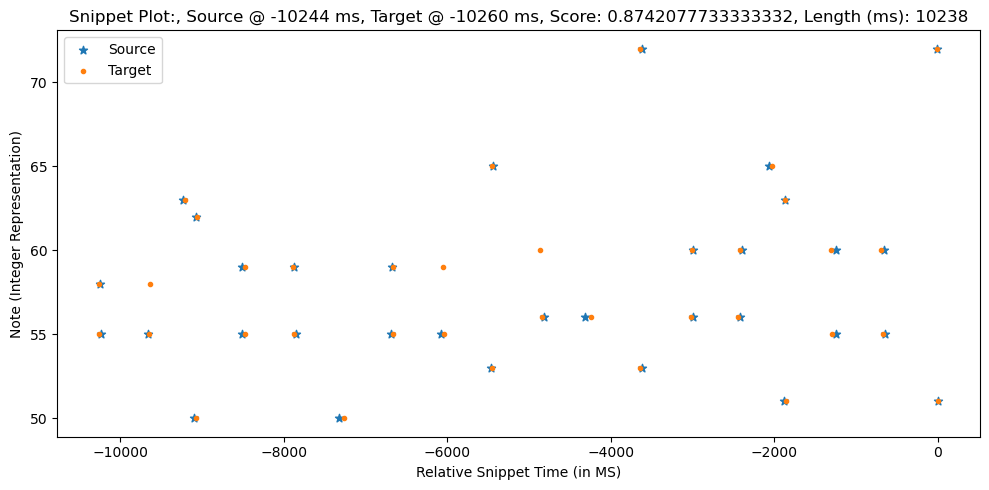

0.8742454666666668
Scores: [-0.     -0.      0.0575  0.11   -0.     -0.     -0.     -0.      0.4275
  0.18    0.2    -0.      0.385   0.43    0.1625  0.2125 -0.     -0.
 -0.     -0.      0.045  -0.     -0.      0.1825 -0.     -0.      0.04
 -0.     -0.     -0.      0.665  -0.     -0.      0.0125 -0.     -0.
  0.2325  0.1625  0.1725  0.155  -0.     -0.     -0.     -0.      0.625 ]
Sequence1:  [[-12408     55     45]
 [-12405     58     32]
 [-11801     55     48]
 [-11789     58     39]
 [-11355     63     52]
 [-11219     50     42]
 [-11207     62     56]
 [-10625     59     46]
 [-10623     55     46]
 [-10030     59     42]
 [-10024     55     48]
 [ -9415     50     46]
 [ -8814     59     39]
 [ -8812     55     44]
 [ -8206     59     34]
 [ -8190     55     41]
 [ -7607     53     47]
 [ -7604     65     54]
 [ -7016     60     34]
 [ -6989     56     44]
 [ -6387     56     45]
 [ -5795     53     46]
 [ -5788     72     59]
 [ -5173     56     45]
 [ -5162     60     30]
 [ -4

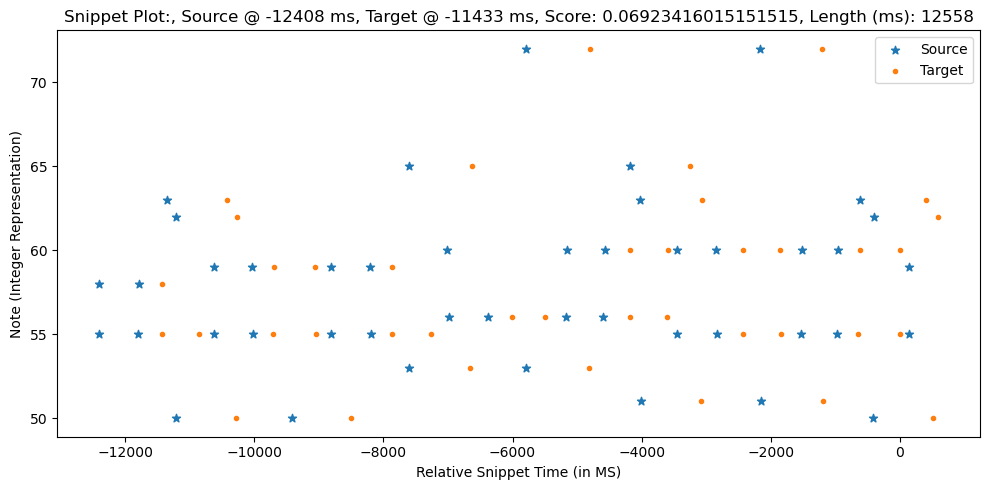

Scores: [0.9675 0.9375 0.975  0.925  0.9425 0.9625 0.9    0.91   0.9725 0.9375
 0.87   0.945  0.96   0.9225 0.9875 0.975  0.9375 0.82   0.9425 0.9375
 0.96   0.9175 0.9225 0.95   0.9275 0.9125 0.995  0.84   0.86   0.925
 0.925  0.9925 0.985  0.815  0.855  0.955  1.     0.8475 0.945  0.9   ]
Sequence1:  [[-11987     58     33]
 [-11978     55     42]
 [-11406     55     48]
 [-10980     63     49]
 [-10837     50     44]
 [-10817     62     54]
 [-10258     55     44]
 [-10256     59     42]
 [ -9614     59     41]
 [ -9594     55     45]
 [ -9062     50     51]
 [ -8429     55     44]
 [ -8425     59     40]
 [ -7816     55     47]
 [ -7207     53     43]
 [ -7189     65     49]
 [ -6559     56     41]
 [ -6054     56     41]
 [ -5367     53     54]
 [ -5358     72     55]
 [ -4741     60     32]
 [ -4735     56     44]
 [ -4162     56     48]
 [ -4146     60     31]
 [ -3804     65     40]
 [ -3632     51     45]
 [ -3618     63     51]
 [ -2989     60     39]
 [ -2986     55     44]


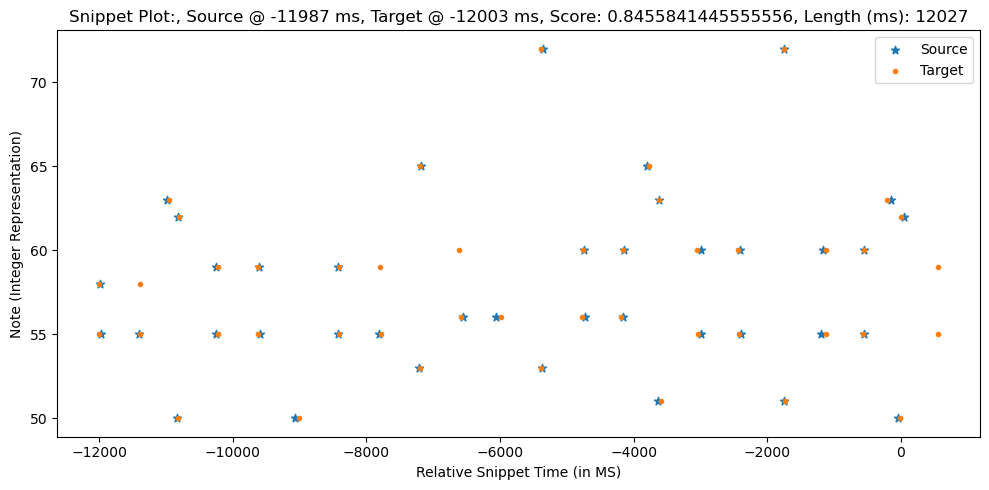

0.8455841445555556
Scores: [ 0.94    0.97    0.9725 -0.      0.9225  0.94    0.96    0.9075  0.8975
  0.975   0.94    0.8675  0.9575  0.9425 -0.      0.92    0.985   0.9775
 -0.      0.94    0.8175  0.945   0.94    0.92    0.9625  0.925   0.9525
  0.925   0.9975  0.91    0.8425  0.8625  0.9275  0.9275  0.995   0.9825
  0.8125  0.8525  0.9575  0.9975  0.85    0.9425  0.9025  0.81    0.8
  0.925   0.9475  0.97    0.975   0.99    0.9675]
Sequence1:  [[-14401     55     45]
 [-14398     58     32]
 [-13794     55     48]
 [-13782     58     39]
 [-13348     63     52]
 [-13212     50     42]
 [-13200     62     56]
 [-12618     59     46]
 [-12616     55     46]
 [-12023     59     42]
 [-12017     55     48]
 [-11408     50     46]
 [-10807     59     39]
 [-10805     55     44]
 [-10199     59     34]
 [-10183     55     41]
 [ -9600     53     47]
 [ -9597     65     54]
 [ -9009     60     34]
 [ -8982     56     44]
 [ -8380     56     45]
 [ -7788     53     46]
 [ -7781     72     5

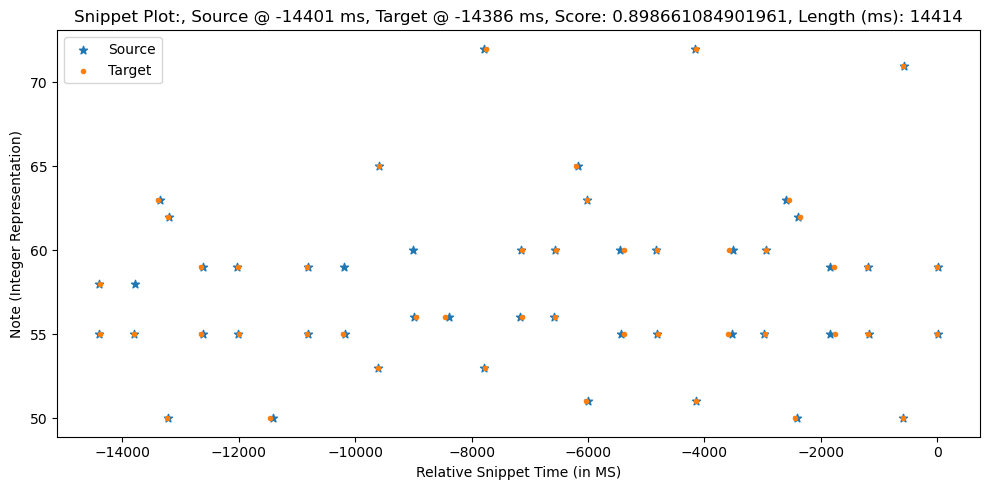

Scores: [0.97   0.94   0.9725 0.9225 0.94   0.96   0.8975 0.9075 0.975  0.94
 0.8675 0.9425 0.9575 0.92   0.985  0.9775 0.94   0.8175 0.945  0.94
 0.9625 0.92   0.925  0.9525 0.925  0.91   0.9975 0.8425 0.8625 0.9275
 0.9275 0.995  0.9825 0.8125 0.8525 0.9575 0.9975 0.85   0.9425 0.9025
 0.81   0.8    0.925  0.9475 0.97   0.975  0.9675 0.99  ]
Sequence1:  [[-14393     58     33]
 [-14384     55     42]
 [-13812     55     48]
 [-13386     63     49]
 [-13243     50     44]
 [-13223     62     54]
 [-12664     55     44]
 [-12662     59     42]
 [-12020     59     41]
 [-12000     55     45]
 [-11468     50     51]
 [-10835     55     44]
 [-10831     59     40]
 [-10222     55     47]
 [ -9613     53     43]
 [ -9595     65     49]
 [ -8965     56     41]
 [ -8460     56     41]
 [ -7773     53     54]
 [ -7764     72     55]
 [ -7147     60     32]
 [ -7141     56     44]
 [ -6568     56     48]
 [ -6552     60     31]
 [ -6210     65     40]
 [ -6038     51     45]
 [ -6024     63   

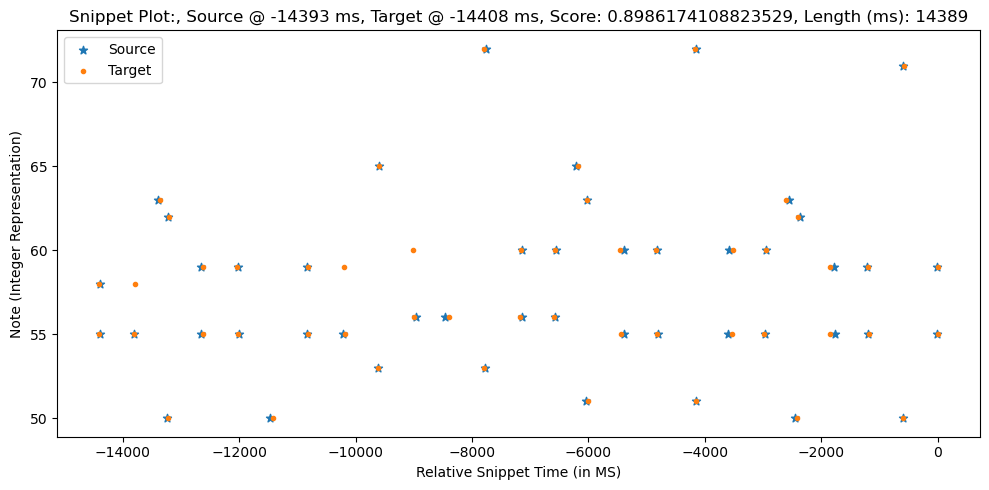

0.898661084901961
Scores: [ 0.9325  0.9625  0.98   -0.      0.93    0.9475  0.9675  0.915   0.905
  0.9675  0.9325  0.875   0.965   0.95   -0.      0.9275  0.9925  0.97
 -0.      0.9325  0.825   0.9375  0.9325  0.9125  0.955   0.9175  0.945
  0.9325  0.99    0.9175  0.835   0.855   0.92    0.92    0.9875  0.99
  0.82    0.86    0.95    0.995   0.8425  0.95    0.895   0.8025  0.7925
  0.9325  0.955   0.9775  0.9825  0.9975  0.975   0.905   0.9625  0.9775
  0.945   0.93    0.955   0.885 ]
Sequence1:  [[-16162     55     45]
 [-16159     58     32]
 [-15555     55     48]
 [-15543     58     39]
 [-15109     63     52]
 [-14973     50     42]
 [-14961     62     56]
 [-14379     59     46]
 [-14377     55     46]
 [-13784     59     42]
 [-13778     55     48]
 [-13169     50     46]
 [-12568     59     39]
 [-12566     55     44]
 [-11960     59     34]
 [-11944     55     41]
 [-11361     53     47]
 [-11358     65     54]
 [-10770     60     34]
 [-10743     56     44]
 [-10141     56 

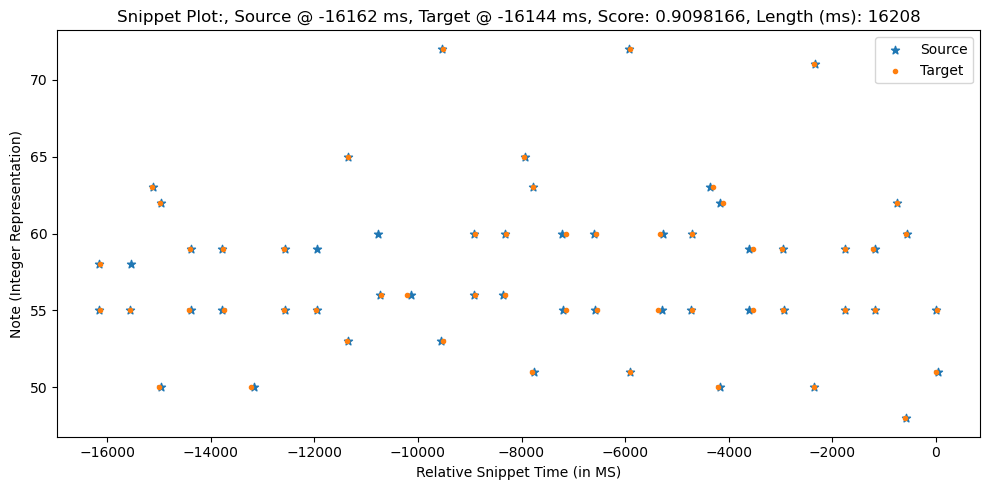

Scores: [0.965  0.935  0.9775 0.9275 0.945  0.965  0.9025 0.9125 0.97   0.935
 0.8725 0.9475 0.9625 0.925  0.99   0.9725 0.935  0.8225 0.94   0.935
 0.9575 0.915  0.92   0.9475 0.93   0.915  0.9925 0.8375 0.8575 0.9225
 0.9225 0.99   0.9875 0.8175 0.8575 0.9525 0.9975 0.845  0.9475 0.8975
 0.805  0.795  0.93   0.9525 0.975  0.98   0.9725 0.995  0.9025 0.96
 0.975  0.9425 0.9275 0.8825 0.9575]
Sequence1:  [[-16155     58     33]
 [-16146     55     42]
 [-15574     55     48]
 [-15148     63     49]
 [-15005     50     44]
 [-14985     62     54]
 [-14426     55     44]
 [-14424     59     42]
 [-13782     59     41]
 [-13762     55     45]
 [-13230     50     51]
 [-12597     55     44]
 [-12593     59     40]
 [-11984     55     47]
 [-11375     53     43]
 [-11357     65     49]
 [-10727     56     41]
 [-10222     56     41]
 [ -9535     53     54]
 [ -9526     72     55]
 [ -8909     60     32]
 [ -8903     56     44]
 [ -8330     56     48]
 [ -8314     60     31]
 [ -7972     65 

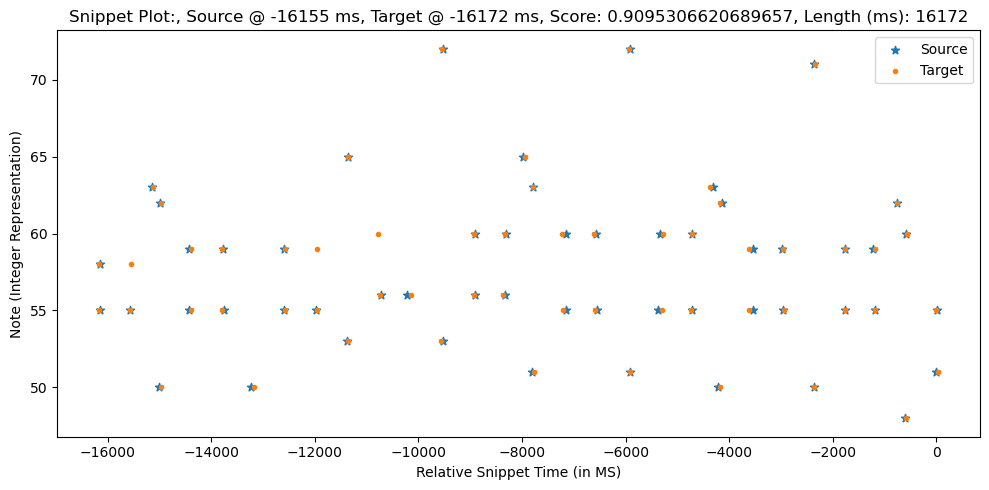

0.9098166
Scores: [ 0.9325  0.9625  0.98   -0.      0.93    0.9475  0.9675  0.915   0.905
  0.9675  0.9325  0.875   0.965   0.95   -0.      0.9275  0.9925  0.97
 -0.      0.9325  0.825   0.9375  0.9325  0.9125  0.955   0.9175  0.945
  0.9325  0.99    0.9175  0.835   0.855   0.92    0.92    0.9875  0.99
  0.82    0.86    0.95    0.995   0.8425  0.95    0.895   0.8025  0.7925
  0.9325  0.955   0.9775  0.9825  0.9975  0.975   0.905   0.9625  0.9775
  0.945   0.93    0.955   0.885   0.9525  0.8375  0.9275  0.97    0.9375
  0.97    0.965   0.9725  0.9775]
Sequence1:  [[-18576     55     45]
 [-18573     58     32]
 [-17969     55     48]
 [-17957     58     39]
 [-17523     63     52]
 [-17387     50     42]
 [-17375     62     56]
 [-16793     59     46]
 [-16791     55     46]
 [-16198     59     42]
 [-16192     55     48]
 [-15583     50     46]
 [-14982     59     39]
 [-14980     55     44]
 [-14374     59     34]
 [-14358     55     41]
 [-13775     53     47]
 [-13772     65     54]

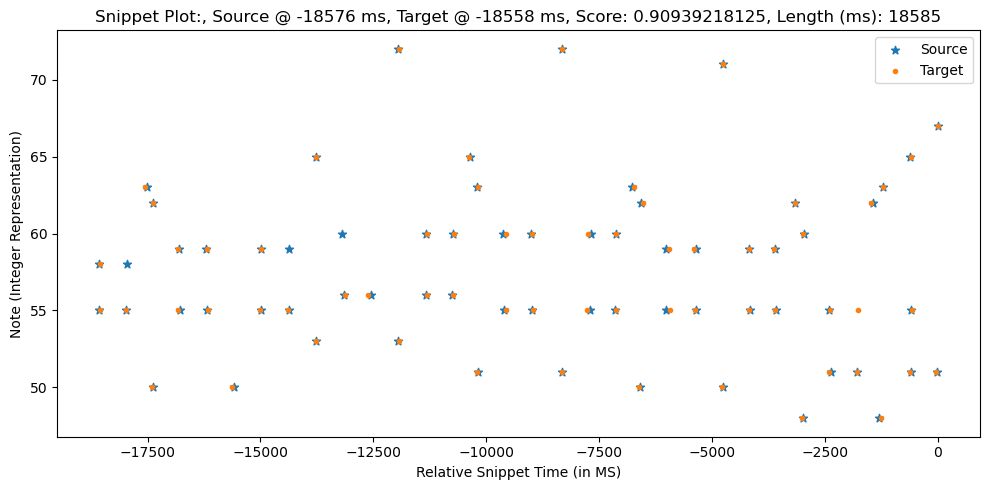

Scores: [ 0.9625  0.9325  0.98    0.93    0.9475  0.9675  0.905   0.915   0.9675
  0.9325  0.875   0.95    0.965   0.9275  0.9925  0.97    0.9325  0.825
  0.9375  0.9325  0.955   0.9125  0.9175  0.945   0.9325  0.9175  0.99
  0.835   0.855   0.92    0.92    0.9875  0.99    0.82    0.86    0.95
  0.995   0.8425  0.95    0.895   0.8025  0.7925  0.9325  0.955   0.9775
  0.9825  0.975   0.9975  0.905   0.9625  0.9775  0.945   0.93    0.885
  0.955   0.9525 -0.      0.8375  0.9275  0.97    0.97    0.9375  0.965
  0.9725  0.9775]
Sequence1:  [[-18567     58     33]
 [-18558     55     42]
 [-17986     55     48]
 [-17560     63     49]
 [-17417     50     44]
 [-17397     62     54]
 [-16838     55     44]
 [-16836     59     42]
 [-16194     59     41]
 [-16174     55     45]
 [-15642     50     51]
 [-15009     55     44]
 [-15005     59     40]
 [-14396     55     47]
 [-13787     53     43]
 [-13769     65     49]
 [-13139     56     41]
 [-12634     56     41]
 [-11947     53     54]
 [

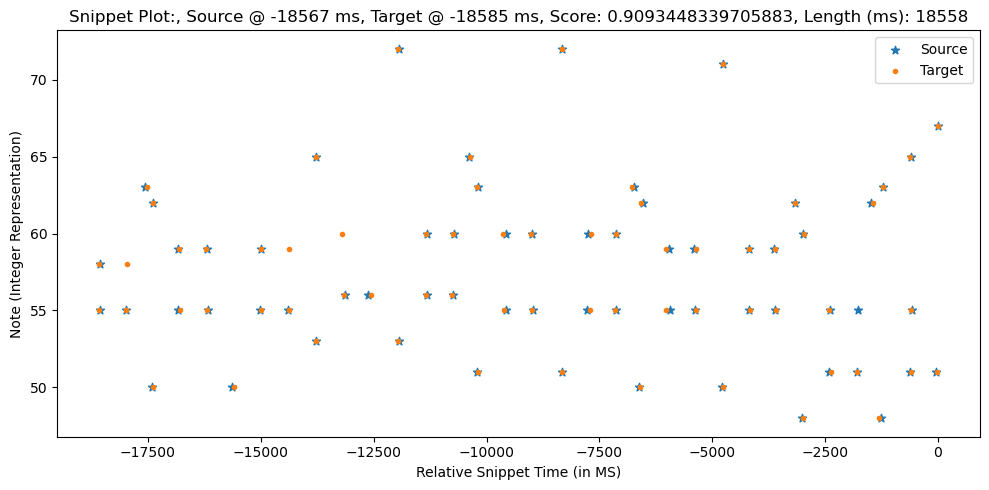

0.90939218125
Scores: [ 0.9325  0.9625  0.98   -0.      0.93    0.9475  0.9675  0.915   0.905
  0.9675  0.9325  0.875   0.965   0.95   -0.      0.9275  0.9925  0.97
 -0.      0.9325  0.825   0.9375  0.9325  0.9125  0.955   0.9175  0.945
  0.9325  0.99    0.9175  0.835   0.855   0.92    0.92    0.9875  0.99
  0.82    0.86    0.95    0.995   0.8425  0.95    0.895   0.8025  0.7925
  0.9325  0.955   0.9775  0.9825  0.9975  0.975   0.905   0.9625  0.9775
  0.945   0.93    0.955   0.885   0.9525  0.8375  0.9275  0.97    0.9375
  0.97    0.965   0.9725  0.9775  1.      0.98    0.8825  0.8275  0.8525]
Sequence1:  [[-20453     55     45]
 [-20450     58     32]
 [-19846     55     48]
 [-19834     58     39]
 [-19400     63     52]
 [-19264     50     42]
 [-19252     62     56]
 [-18670     59     46]
 [-18668     55     46]
 [-18075     59     42]
 [-18069     55     48]
 [-17460     50     46]
 [-16859     59     39]
 [-16857     55     44]
 [-16251     59     34]
 [-16235     55     41]
 [-

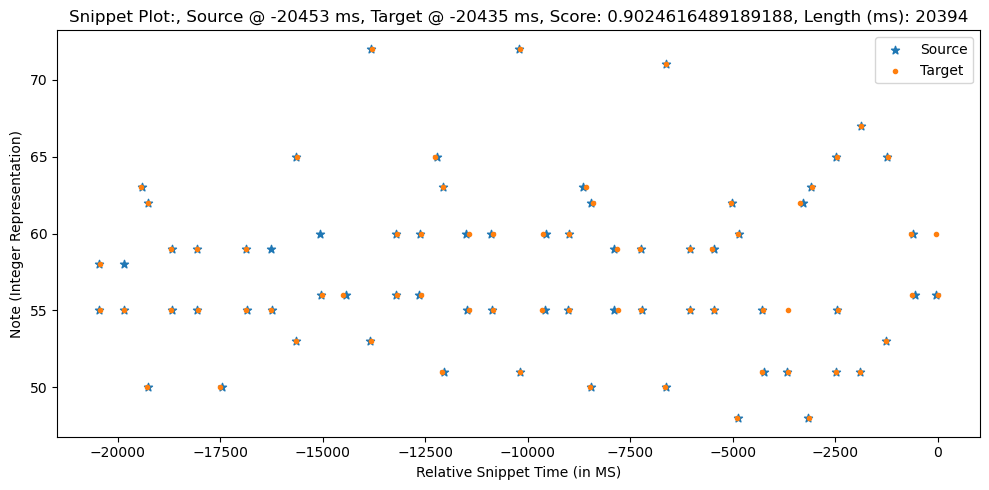

Scores: [ 0.9825  0.9525  0.96    0.91    0.9275  0.9475  0.885   0.895   0.9875
  0.9525  0.855   0.93    0.945   0.9075  0.9725  0.99    0.9525  0.805
  0.9575  0.9525  0.975   0.9325  0.9375  0.965   0.9125  0.8975  0.99
  0.855   0.875   0.94    0.94    0.9925  0.97    0.8     0.84    0.97
  0.985   0.8625  0.93    0.915   0.8225  0.8125  0.9125  0.935   0.9575
  0.9625  0.955   0.9775  0.885   0.9425  0.9575  0.925   0.91    0.865
  0.975   0.9725 -0.      0.8175  0.9475  0.99    0.95    0.9575  0.985
  0.9525  0.9575  0.98    1.      0.8625  0.8075  0.      0.8725]
Sequence1:  [[-20384     58     33]
 [-20375     55     42]
 [-19803     55     48]
 [-19377     63     49]
 [-19234     50     44]
 [-19214     62     54]
 [-18655     55     44]
 [-18653     59     42]
 [-18011     59     41]
 [-17991     55     45]
 [-17459     50     51]
 [-16826     55     44]
 [-16822     59     40]
 [-16213     55     47]
 [-15604     53     43]
 [-15586     65     49]
 [-14956     56     41]
 [

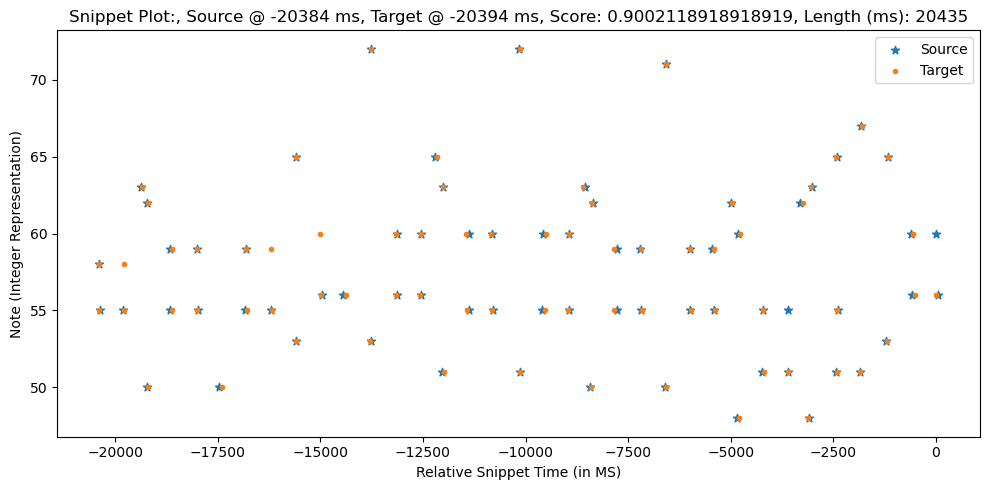

0.9024616489189188
Scores: [ 0.9325  0.9625  0.98   -0.      0.93    0.9475  0.9675  0.915   0.905
  0.9675  0.9325  0.875   0.965   0.95   -0.      0.9275  0.9925  0.97
 -0.      0.9325  0.825   0.9375  0.9325  0.9125  0.955   0.9175  0.945
  0.9325  0.99    0.9175  0.835   0.855   0.92    0.92    0.9875  0.99
  0.82    0.86    0.95    0.995   0.8425  0.95    0.895   0.8025  0.7925
  0.9325  0.955   0.9775  0.9825  0.9975  0.975   0.905   0.9625  0.9775
  0.945   0.93    0.955   0.885   0.9525  0.8375  0.9275  0.97    0.9375
  0.97    0.965   0.9725  0.9775  1.      0.98    0.8825  0.8275  0.8525
  0.975   0.9775  0.99    0.93    0.835   0.9975  0.975 ]
Sequence1:  [[-22627     55     45]
 [-22624     58     32]
 [-22020     55     48]
 [-22008     58     39]
 [-21574     63     52]
 [-21438     50     42]
 [-21426     62     56]
 [-20844     59     46]
 [-20842     55     46]
 [-20249     59     42]
 [-20243     55     48]
 [-19634     50     46]
 [-19033     59     39]
 [-19031     

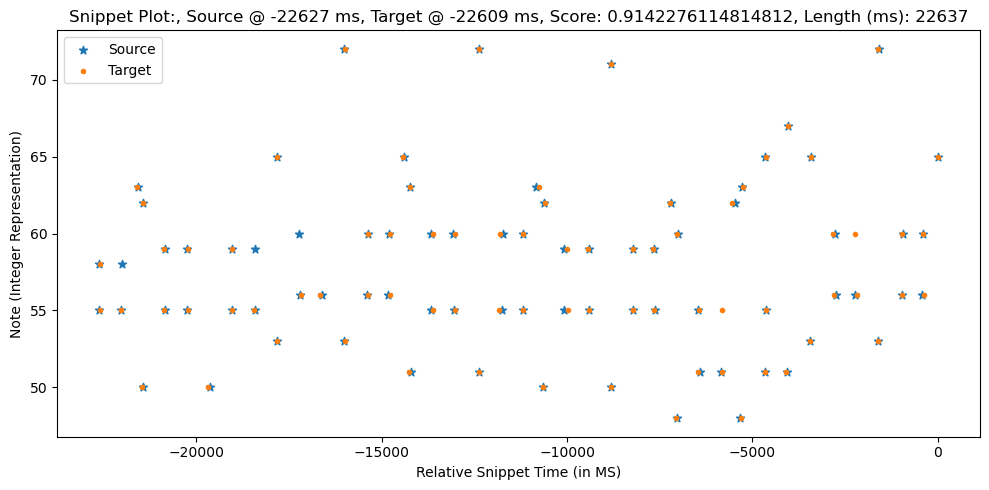

Scores: [ 0.9625  0.9325  0.98    0.93    0.9475  0.9675  0.905   0.915   0.9675
  0.9325  0.875   0.95    0.965   0.9275  0.9925  0.97    0.9325  0.825
  0.9375  0.9325  0.955   0.9125  0.9175  0.945   0.9325  0.9175  0.99
  0.835   0.855   0.92    0.92    0.9875  0.99    0.82    0.86    0.95
  0.995   0.8425  0.95    0.895   0.8025  0.7925  0.9325  0.955   0.9775
  0.9825  0.975   0.9975  0.905   0.9625  0.9775  0.945   0.93    0.885
  0.955   0.9525 -0.      0.8375  0.9275  0.97    0.97    0.9375  0.965
  0.9725  0.9775  1.      0.98    0.8825  0.8275 -0.      0.8525  0.9775
  0.975   0.99    0.93    0.9975  0.835   0.975 ]
Sequence1:  [[-22619     58     33]
 [-22610     55     42]
 [-22038     55     48]
 [-21612     63     49]
 [-21469     50     44]
 [-21449     62     54]
 [-20890     55     44]
 [-20888     59     42]
 [-20246     59     41]
 [-20226     55     45]
 [-19694     50     51]
 [-19061     55     44]
 [-19057     59     40]
 [-18448     55     47]
 [-17839     53  

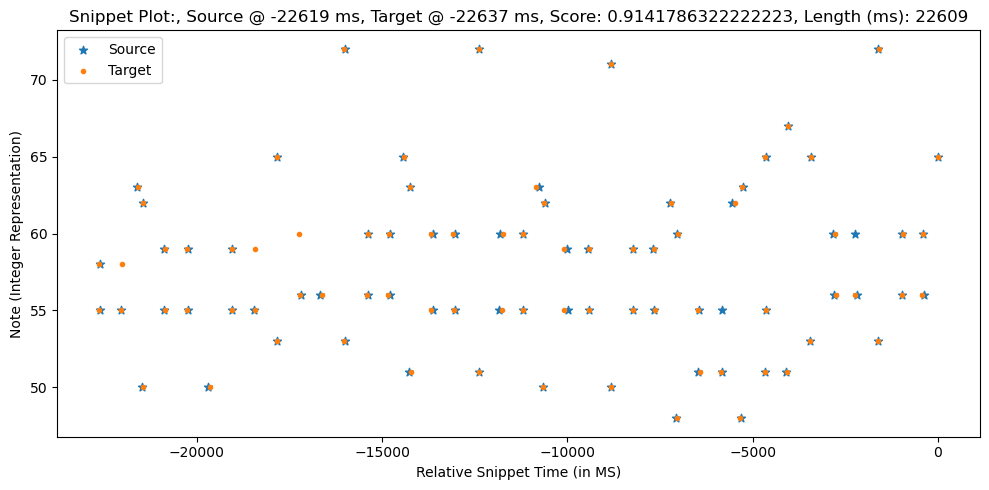

0.9142276114814812
Scores: [ 0.93    0.96    0.9825 -0.      0.9325  0.95    0.97    0.9175  0.9075
  0.965   0.93    0.8775  0.9675  0.9525 -0.      0.93    0.995   0.9675
 -0.      0.93    0.8275  0.935   0.93    0.91    0.9525  0.915   0.9425
  0.935   0.9875  0.92    0.8325  0.8525  0.9175  0.9175  0.985   0.9925
  0.8225  0.8625  0.9475  0.9925  0.84    0.9525  0.8925  0.8     0.79
  0.935   0.9575  0.98    0.985   1.      0.9775  0.9075  0.965   0.98
  0.9475  0.9325  0.9525  0.8875  0.95    0.84    0.925   0.9675  0.935
  0.9725  0.9625  0.975   0.98    0.9975  0.9775  0.885   0.83    0.85
  0.9725  0.98    0.9875  0.9325  0.8325  1.      0.9775  0.97    0.9775
  0.985   0.9125  0.9775  0.84    0.9825  0.995 ]
Sequence1:  [[-24612     55     45]
 [-24609     58     32]
 [-24005     55     48]
 [-23993     58     39]
 [-23559     63     52]
 [-23423     50     42]
 [-23411     62     56]
 [-22829     59     46]
 [-22827     55     46]
 [-22234     59     42]
 [-22228     55     4

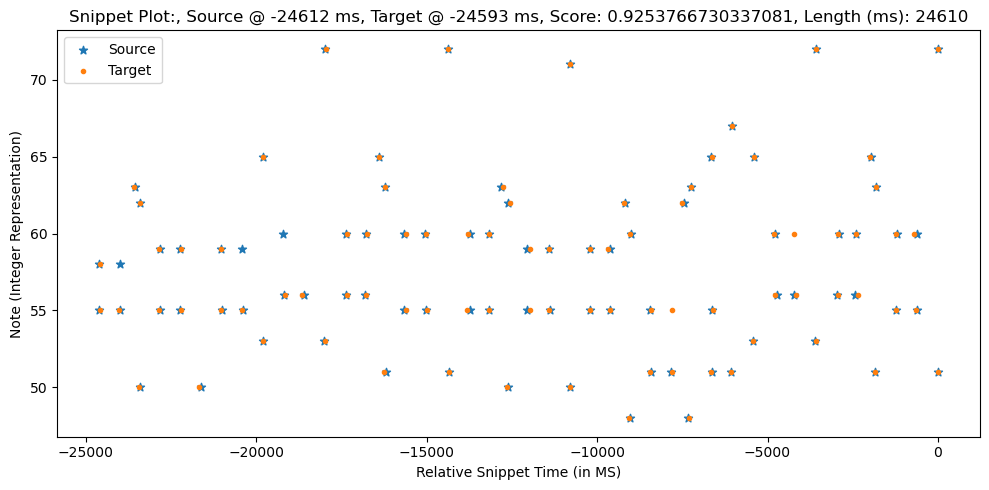

Scores: [ 0.96    0.93    0.9825  0.9325  0.95    0.97    0.9075  0.9175  0.965
  0.93    0.8775  0.9525  0.9675  0.93    0.995   0.9675  0.93    0.8275
  0.935   0.93    0.9525  0.91    0.915   0.9425  0.935   0.92    0.9875
  0.8325  0.8525  0.9175  0.9175  0.985   0.9925  0.8225  0.8625  0.9475
  0.9925  0.84    0.9525  0.8925  0.8     0.79    0.935   0.9575  0.98
  0.985   0.9775  1.      0.9075  0.965   0.98    0.9475  0.9325  0.8875
  0.9525  0.95   -0.      0.84    0.925   0.9675  0.9725  0.935   0.9625
  0.975   0.98    0.9975  0.9775  0.885   0.83   -0.      0.85    0.98
  0.9725  0.9875  0.9325  1.      0.8325  0.9775  0.97    0.9775  0.9125
  0.985   0.84    0.9775  0.995   0.9825]
Sequence1:  [[-24589     58     33]
 [-24580     55     42]
 [-24008     55     48]
 [-23582     63     49]
 [-23439     50     44]
 [-23419     62     54]
 [-22860     55     44]
 [-22858     59     42]
 [-22216     59     41]
 [-22196     55     45]
 [-21664     50     51]
 [-21031     55     44

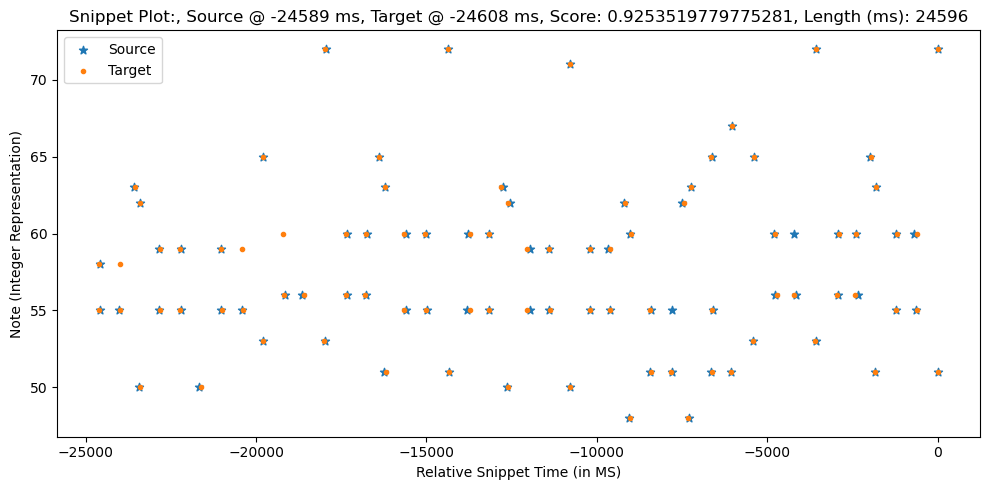

0.9253766730337081
Scores: [ 0.9225  0.9525  0.99   -0.      0.94    0.9575  0.9775  0.925   0.915
  0.9575  0.9225  0.885   0.975   0.96   -0.      0.9375  0.9975  0.96
 -0.      0.9225  0.835   0.9275  0.9225  0.9025  0.945   0.9075  0.935
  0.9425  0.98    0.9275  0.825   0.845   0.91    0.91    0.9775  1.
  0.83    0.87    0.94    0.985   0.8325  0.96    0.885   0.7925  0.7825
  0.9425  0.965   0.9875  0.9925  0.9925  0.985   0.915   0.9725  0.9875
  0.955   0.94    0.945   0.895   0.9425  0.8475  0.9175  0.96    0.9275
  0.98    0.955   0.9825  0.9875  0.99    0.97    0.8925  0.8375  0.8425
  0.965   0.9875  0.98    0.94    0.825   0.9925  0.985   0.9775  0.985
  0.9775  0.92    0.985   0.8475  0.975   0.9875  0.94    0.945  -0.
  0.8975  0.8875  0.7675  0.91  ]
Sequence1:  [[-26427     55     45]
 [-26424     58     32]
 [-25820     55     48]
 [-25808     58     39]
 [-25374     63     52]
 [-25238     50     42]
 [-25226     62     56]
 [-24644     59     46]
 [-24642     55   

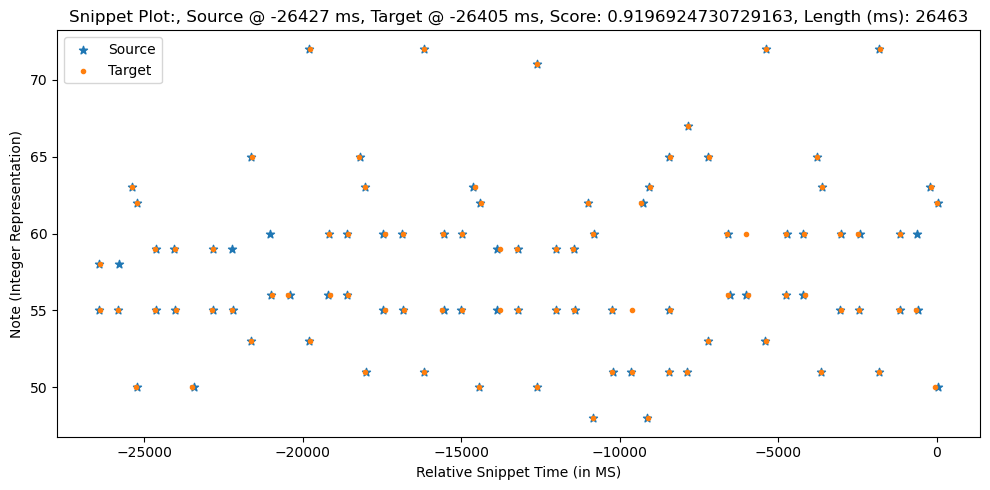

Scores: [ 0.9525  0.9225  0.99    0.94    0.9575  0.9775  0.915   0.925   0.9575
  0.9225  0.885   0.96    0.975   0.9375  0.9975  0.96    0.9225  0.835
  0.9275  0.9225  0.945   0.9025  0.9075  0.935   0.9425  0.9275  0.98
  0.825   0.845   0.91    0.91    0.9775  1.      0.83    0.87    0.94
  0.985   0.8325  0.96    0.885   0.7925  0.7825  0.9425  0.965   0.9875
  0.9925  0.985   0.9925  0.915   0.9725  0.9875  0.955   0.94    0.895
  0.945   0.9425 -0.      0.8475  0.9175  0.96    0.98    0.9275  0.955
  0.9825  0.9875  0.99    0.97    0.8925  0.8375 -0.      0.8425  0.9875
  0.965   0.98    0.94    0.9925  0.825   0.985   0.9775  0.985   0.92
  0.9775  0.8475  0.985   0.9875  0.975   0.94    0.945   0.8975  0.8875
  0.7675  0.91  ]
Sequence1:  [[-26441     58     33]
 [-26432     55     42]
 [-25860     55     48]
 [-25434     63     49]
 [-25291     50     44]
 [-25271     62     54]
 [-24712     55     44]
 [-24710     59     42]
 [-24068     59     41]
 [-24048     55     45]
 

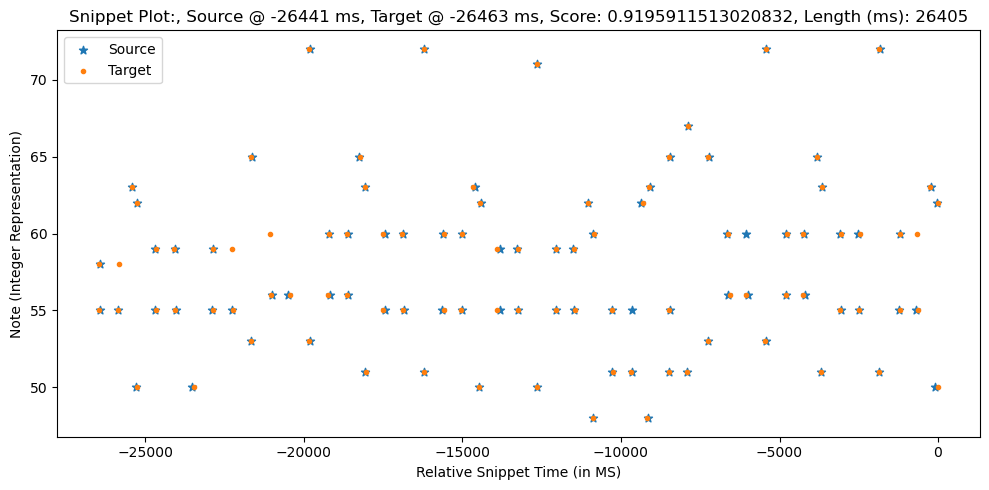

0.9196924730729163
Scores: [ 0.92    0.95    0.9925 -0.      0.9425  0.96    0.98    0.9275  0.9175
  0.955   0.92    0.8875  0.9775  0.9625 -0.      0.94    0.995   0.9575
 -0.      0.92    0.8375  0.925   0.92    0.9     0.9425  0.905   0.9325
  0.945   0.9775  0.93    0.8225  0.8425  0.9075  0.9075  0.975   0.9975
  0.8325  0.8725  0.9375  0.9825  0.83    0.9625  0.8825  0.79    0.78
  0.945   0.9675  0.99    0.995   0.99    0.9875  0.9175  0.975   0.99
  0.9575  0.9425  0.9425  0.8975  0.94    0.85    0.915   0.9575  0.925
  0.9825  0.9525  0.985   0.99    0.9875  0.9675  0.895   0.84    0.84
  0.9625  0.99    0.9775  0.9425  0.8225  0.99    0.9875  0.98    0.9875
  0.975   0.9225  0.9875  0.85    0.9725  0.985   0.9425  0.9475 -0.
  0.9     0.885   0.77    0.9125  0.99    0.9775  0.985   0.9375  0.96
  0.9075]
Sequence1:  [[-28195     55     45]
 [-28192     58     32]
 [-27588     55     48]
 [-27576     58     39]
 [-27142     63     52]
 [-27006     50     42]
 [-26994     62  

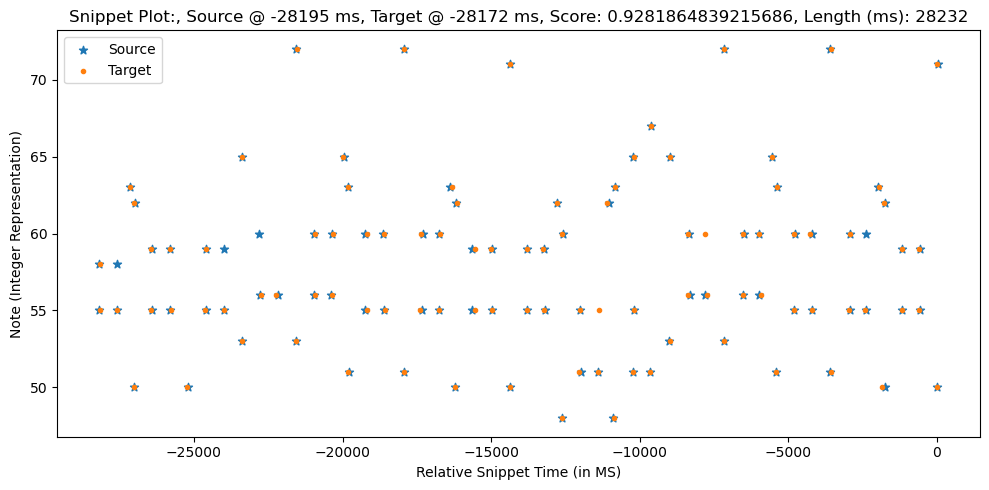

Scores: [ 0.95    0.92    0.9925  0.9425  0.96    0.98    0.9175  0.9275  0.955
  0.92    0.8875  0.9625  0.9775  0.94    0.995   0.9575  0.92    0.8375
  0.925   0.92    0.9425  0.9     0.905   0.9325  0.945   0.93    0.9775
  0.8225  0.8425  0.9075  0.9075  0.975   0.9975  0.8325  0.8725  0.9375
  0.9825  0.83    0.9625  0.8825  0.79    0.78    0.945   0.9675  0.99
  0.995   0.9875  0.99    0.9175  0.975   0.99    0.9575  0.9425  0.8975
  0.9425  0.94   -0.      0.85    0.915   0.9575  0.9825  0.925   0.9525
  0.985   0.99    0.9875  0.9675  0.895   0.84   -0.      0.84    0.99
  0.9625  0.9775  0.9425  0.99    0.8225  0.9875  0.98    0.9875  0.9225
  0.975   0.85    0.9875  0.985   0.9725  0.9425  0.9475  0.9     0.885
  0.77    0.9125  0.99    0.9775  0.9375  0.985   0.96    0.9075]
Sequence1:  [[-28209     58     33]
 [-28200     55     42]
 [-27628     55     48]
 [-27202     63     49]
 [-27059     50     44]
 [-27039     62     54]
 [-26480     55     44]
 [-26478     59     42

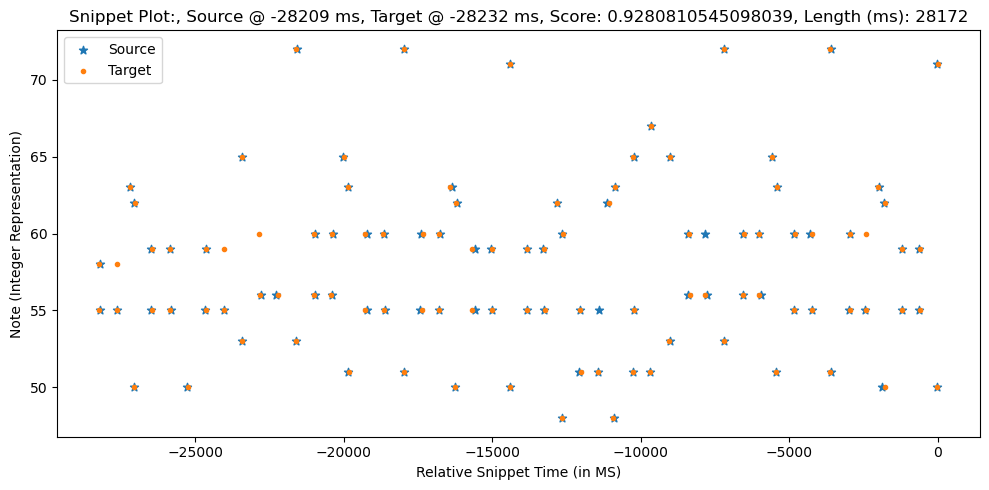

0.9281864839215686
Scores: [ 0.9125  0.9425  1.     -0.      0.95    0.9675  0.9875  0.935   0.925
  0.9475  0.9125  0.895   0.985   0.97   -0.      0.9475  0.9875  0.95
 -0.      0.9125  0.845   0.9175  0.9125  0.8925  0.935   0.8975  0.925
  0.9525  0.97    0.9375  0.815   0.835   0.9     0.9     0.9675  0.99
  0.84    0.88    0.93    0.975   0.8225  0.97    0.875   0.7825  0.7725
  0.9525  0.975   0.9975  0.9975  0.9825  0.995   0.925   0.9825  0.9975
  0.965   0.95    0.935   0.905   0.9325  0.8575  0.9075  0.95    0.9175
  0.99    0.945   0.9925  0.9975  0.98    0.96    0.9025  0.8475  0.8325
  0.955   0.9975  0.97    0.95    0.815   0.9825  0.995   0.9875  0.995
  0.9675  0.93    0.995   0.8575  0.965   0.9775  0.95    0.955  -0.
  0.9075  0.8775  0.7775  0.92    0.9825  0.985   0.9925  0.945   0.9675
  0.915   0.9075  0.8825  0.8975  0.8975  0.855   0.7975  0.9075  0.9775
  0.995 ]
Sequence1:  [[-30627     55     45]
 [-30624     58     32]
 [-30020     55     48]
 [-30008     5

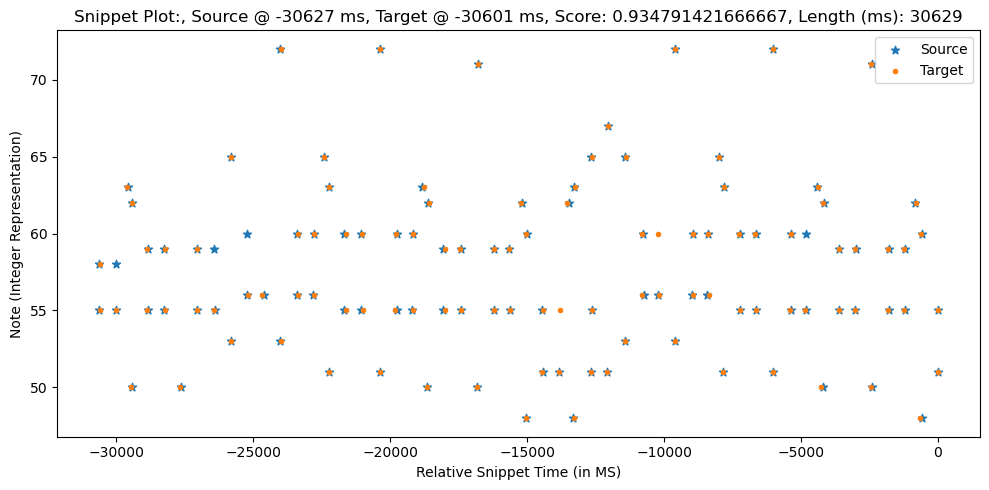

Scores: [ 0.9425  0.9125  1.      0.95    0.9675  0.9875  0.925   0.935   0.9475
  0.9125  0.895   0.97    0.985   0.9475  0.9875  0.95    0.9125  0.845
  0.9175  0.9125  0.935   0.8925  0.8975  0.925   0.9525  0.9375  0.97
  0.815   0.835   0.9     0.9     0.9675  0.99    0.84    0.88    0.93
  0.975   0.8225  0.97    0.875   0.7825  0.7725  0.9525  0.975   0.9975
  0.9975  0.995   0.9825  0.925   0.9825  0.9975  0.965   0.95    0.905
  0.935   0.9325 -0.      0.8575  0.9075  0.95    0.99    0.9175  0.945
  0.9925  0.9975  0.98    0.96    0.9025  0.8475 -0.      0.8325  0.9975
  0.955   0.97    0.95    0.9825  0.815   0.995   0.9875  0.995   0.93
  0.9675  0.8575  0.995   0.9775  0.965   0.95    0.955   0.9075  0.8775
  0.7775  0.92    0.9825  0.985   0.945   0.9925  0.9675  0.915   0.9075
  0.8825  0.8975  0.8975  0.855   0.7975  0.9075  0.9775  0.995 ]
Sequence1:  [[-30603     58     33]
 [-30594     55     42]
 [-30022     55     48]
 [-29596     63     49]
 [-29453     50     44]


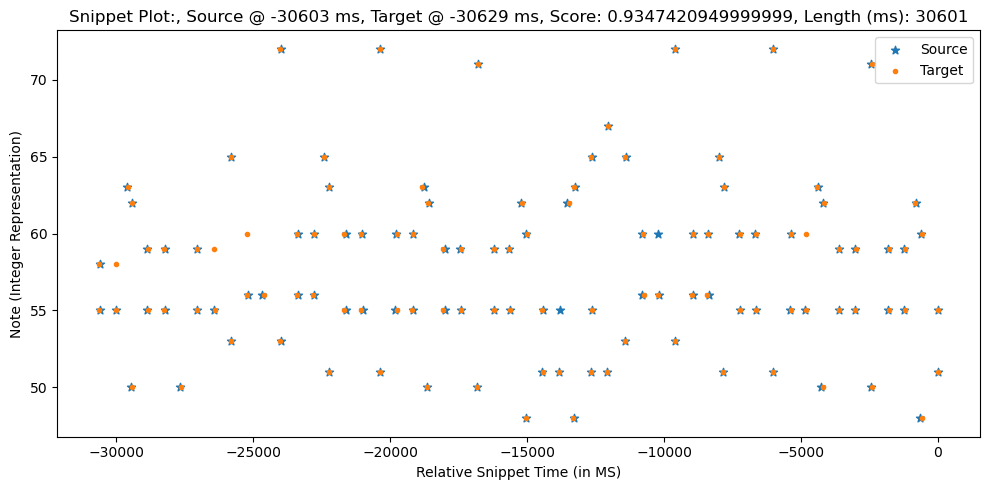

0.934791421666667
Scores: [ 0.9125  0.9425  1.     -0.      0.95    0.9675  0.9875  0.935   0.925
  0.9475  0.9125  0.895   0.985   0.97   -0.      0.9475  0.9875  0.95
 -0.      0.9125  0.845   0.9175  0.9125  0.8925  0.935   0.8975  0.925
  0.9525  0.97    0.9375  0.815   0.835   0.9     0.9     0.9675  0.99
  0.84    0.88    0.93    0.975   0.8225  0.97    0.875   0.7825  0.7725
  0.9525  0.975   0.9975  0.9975  0.9825  0.995   0.925   0.9825  0.9975
  0.965   0.95    0.935   0.905   0.9325  0.8575  0.9075  0.95    0.9175
  0.99    0.945   0.9925  0.9975  0.98    0.96    0.9025  0.8475  0.8325
  0.955   0.9975  0.97    0.95    0.815   0.9825  0.995   0.9875  0.995
  0.9675  0.93    0.995   0.8575  0.965   0.9775  0.95    0.955  -0.
  0.9075  0.8775  0.7775  0.92    0.9825  0.985   0.9925  0.945   0.9675
  0.915   0.9075  0.8825  0.8975  0.8975  0.855   0.7975  0.9075  0.9775
  0.995   0.925   0.9675  0.9     0.8475  0.885 ]
Sequence1:  [[-32426     55     45]
 [-32423     58     32]

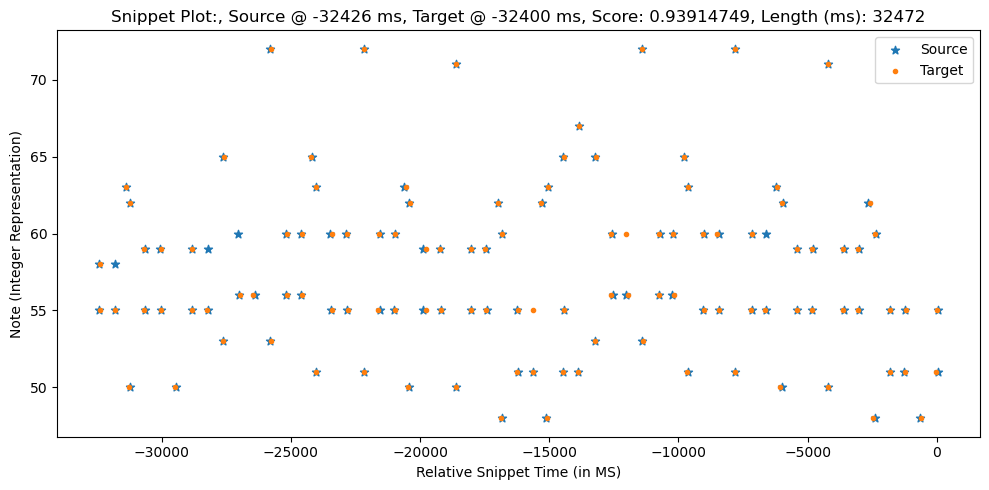

Scores: [ 0.9425  0.9125  1.      0.95    0.9675  0.9875  0.925   0.935   0.9475
  0.9125  0.895   0.97    0.985   0.9475  0.9875  0.95    0.9125  0.845
  0.9175  0.9125  0.935   0.8925  0.8975  0.925   0.9525  0.9375  0.97
  0.815   0.835   0.9     0.9     0.9675  0.99    0.84    0.88    0.93
  0.975   0.8225  0.97    0.875   0.7825  0.7725  0.9525  0.975   0.9975
  0.9975  0.995   0.9825  0.925   0.9825  0.9975  0.965   0.95    0.905
  0.935   0.9325 -0.      0.8575  0.9075  0.95    0.99    0.9175  0.945
  0.9925  0.9975  0.98    0.96    0.9025  0.8475 -0.      0.8325  0.9975
  0.955   0.97    0.95    0.9825  0.815   0.995   0.9875  0.995   0.93
  0.9675  0.8575  0.995   0.9775  0.965   0.95    0.955   0.9075  0.8775
  0.7775  0.92    0.9825  0.985   0.945   0.9925  0.9675  0.915   0.9075
  0.8825  0.8975  0.8975  0.855   0.7975  0.9075  0.9775  0.995   0.925
  0.9675  0.9     0.8475  0.885 ]
Sequence1:  [[-32446     58     33]
 [-32437     55     42]
 [-31865     55     48]
 [-31439

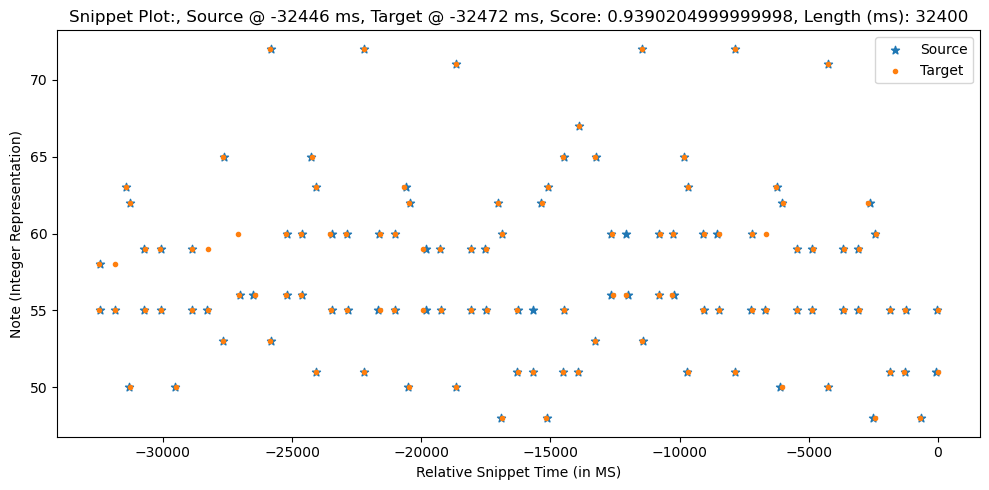

0.93914749
Scores: [ 0.91    0.94    0.9975 -0.      0.9525  0.97    0.99    0.9375  0.9275
  0.945   0.91    0.8975  0.9875  0.9725 -0.      0.95    0.985   0.9475
 -0.      0.91    0.8475  0.915   0.91    0.89    0.9325  0.895   0.9225
  0.955   0.9675  0.94    0.8125  0.8325  0.8975  0.8975  0.965   0.9875
  0.8425  0.8825  0.9275  0.9725  0.82    0.9725  0.8725  0.78    0.77
  0.955   0.9775  1.      0.995   0.98    0.9975  0.9275  0.985   1.
  0.9675  0.9525  0.9325  0.9075  0.93    0.86    0.905   0.9475  0.915
  0.9925  0.9425  0.995   1.      0.9775  0.9575  0.905   0.85    0.83
  0.9525  1.      0.9675  0.9525  0.8125  0.98    0.9975  0.99    0.9975
  0.965   0.9325  0.9975  0.86    0.9625  0.975   0.9525  0.9575 -0.
  0.91    0.875   0.78    0.9225  0.98    0.9875  0.995   0.9475  0.97
  0.9175  0.91    0.885   0.9     0.9     0.8525  0.8     0.91    0.98
  0.9975  0.9225  0.965   0.8975  0.85    0.8875  0.8875  0.93    0.95
  0.95    0.94    0.9725]
Sequence1:  [[-34225     

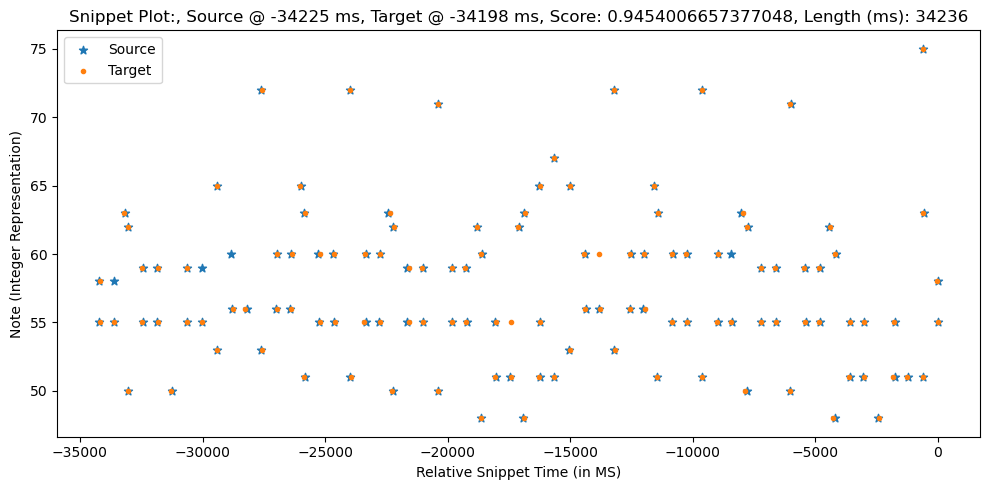

Scores: [ 0.94    0.91    0.9975  0.9525  0.97    0.99    0.9275  0.9375  0.945
  0.91    0.8975  0.9725  0.9875  0.95    0.985   0.9475  0.91    0.8475
  0.915   0.91    0.9325  0.89    0.895   0.9225  0.955   0.94    0.9675
  0.8125  0.8325  0.8975  0.8975  0.965   0.9875  0.8425  0.8825  0.9275
  0.9725  0.82    0.9725  0.8725  0.78    0.77    0.955   0.9775  1.
  0.995   0.9975  0.98    0.9275  0.985   1.      0.9675  0.9525  0.9075
  0.9325  0.93   -0.      0.86    0.905   0.9475  0.9925  0.915   0.9425
  0.995   1.      0.9775  0.9575  0.905   0.85   -0.      0.83    1.
  0.9525  0.9675  0.9525  0.98    0.8125  0.9975  0.99    0.9975  0.9325
  0.965   0.86    0.9975  0.975   0.9625  0.9525  0.9575  0.91    0.875
  0.78    0.9225  0.98    0.9875  0.9475  0.995   0.97    0.9175  0.91
  0.885   0.9     0.9     0.8525  0.8     0.91    0.98    0.9975  0.9225
  0.965   0.8975  0.85    0.8875  0.8875  0.93    0.95    0.95    0.94
  0.9725]
Sequence1:  [[-34209     58     33]
 [-34200   

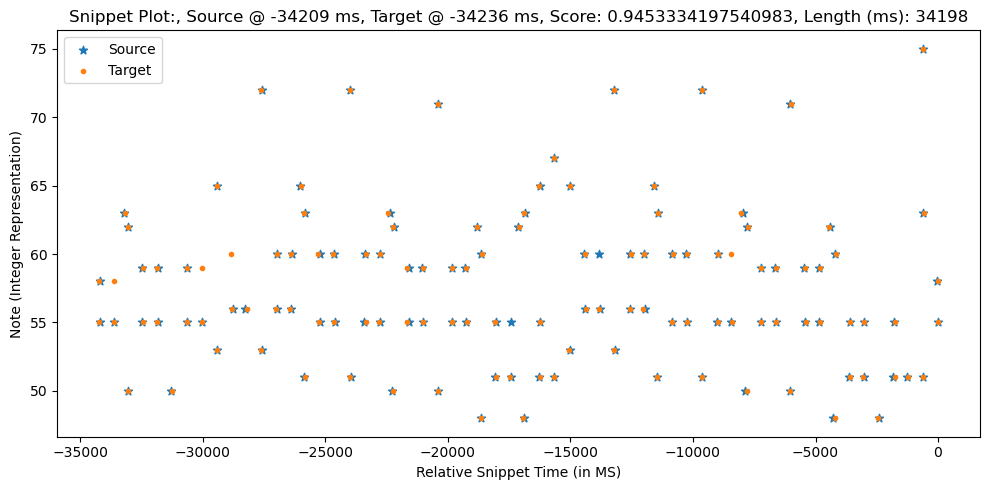

0.9454006657377048
Scores: [ 0.9125  0.9425  1.     -0.      0.95    0.9675  0.9875  0.935   0.925
  0.9475  0.9125  0.895   0.985   0.97   -0.      0.9475  0.9875  0.95
 -0.      0.9125  0.845   0.9175  0.9125  0.8925  0.935   0.8975  0.925
  0.9525  0.97    0.9375  0.815   0.835   0.9     0.9     0.9675  0.99
  0.84    0.88    0.93    0.975   0.8225  0.97    0.875   0.7825  0.7725
  0.9525  0.975   0.9975  0.9975  0.9825  0.995   0.925   0.9825  0.9975
  0.965   0.95    0.935   0.905   0.9325  0.8575  0.9075  0.95    0.9175
  0.99    0.945   0.9925  0.9975  0.98    0.96    0.9025  0.8475  0.8325
  0.955   0.9975  0.97    0.95    0.815   0.9825  0.995   0.9875  0.995
  0.9675  0.93    0.995   0.8575  0.965   0.9775  0.95    0.955  -0.
  0.9075  0.8775  0.7775  0.92    0.9825  0.985   0.9925  0.945   0.9675
  0.915   0.9075  0.8825  0.8975  0.8975  0.855   0.7975  0.9075  0.9775
  0.995   0.925   0.9675  0.9     0.8475  0.885   0.885   0.9275  0.9475
  0.9475  0.9375  0.97    0.9675  0

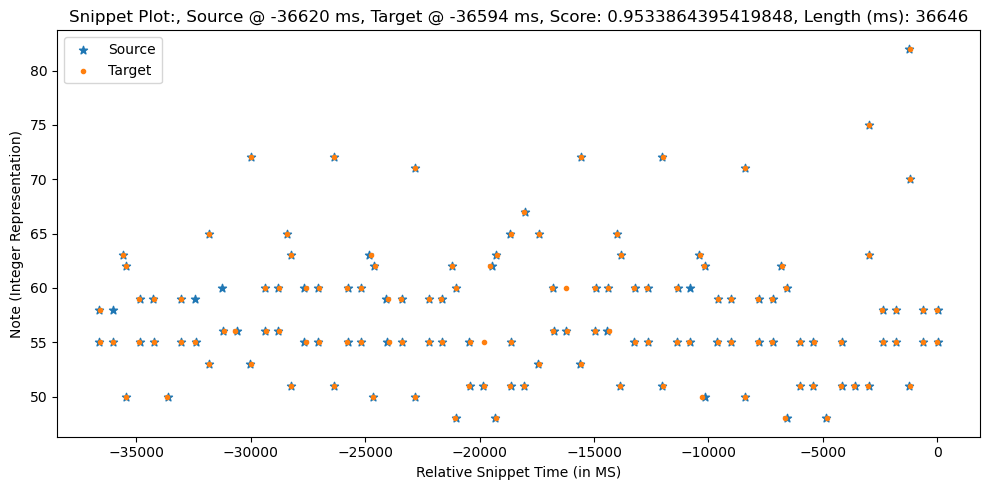

Scores: [ 0.9425  0.9125  1.      0.95    0.9675  0.9875  0.925   0.935   0.9475
  0.9125  0.895   0.97    0.985   0.9475  0.9875  0.95    0.9125  0.845
  0.9175  0.9125  0.935   0.8925  0.8975  0.925   0.9525  0.9375  0.97
  0.815   0.835   0.9     0.9     0.9675  0.99    0.84    0.88    0.93
  0.975   0.8225  0.97    0.875   0.7825  0.7725  0.9525  0.975   0.9975
  0.9975  0.995   0.9825  0.925   0.9825  0.9975  0.965   0.95    0.905
  0.935   0.9325 -0.      0.8575  0.9075  0.95    0.99    0.9175  0.945
  0.9925  0.9975  0.98    0.96    0.9025  0.8475 -0.      0.8325  0.9975
  0.955   0.97    0.95    0.9825  0.815   0.995   0.9875  0.995   0.93
  0.9675  0.8575  0.995   0.9775  0.965   0.95    0.955   0.9075  0.8775
  0.7775  0.92    0.9825  0.985   0.945   0.9925  0.9675  0.915   0.9075
  0.8825  0.8975  0.8975  0.855   0.7975  0.9075  0.9775  0.995   0.925
  0.9675  0.9     0.8475  0.885   0.885   0.9275  0.9475  0.9475  0.9375
  0.97    0.9975  0.9675  0.9575  0.935   0.86    0.9

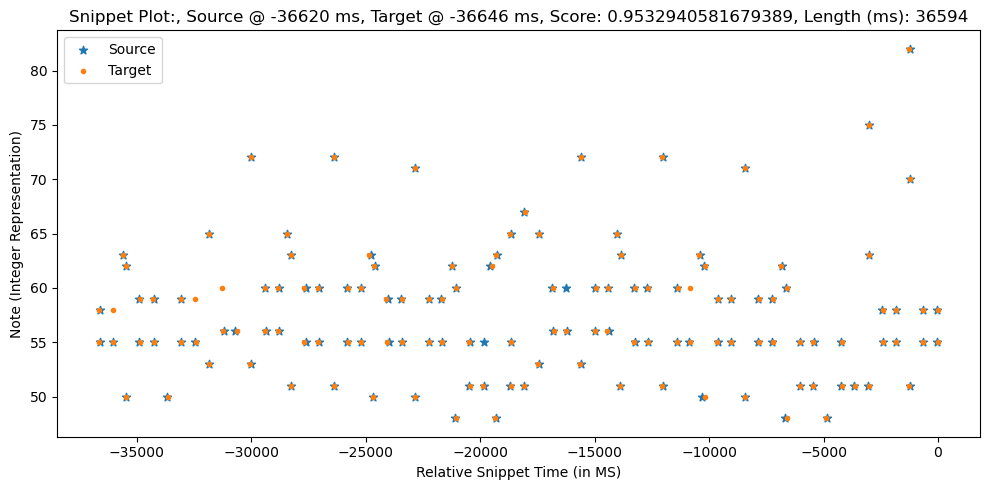

0.9533864395419848
Scores: [ 0.915   0.945   0.9975 -0.      0.9475  0.965   0.985   0.9325  0.9225
  0.95    0.915   0.8925  0.9825  0.9675 -0.      0.945   0.99    0.9525
 -0.      0.915   0.8425  0.92    0.915   0.895   0.9375  0.9     0.9275
  0.95    0.9725  0.935   0.8175  0.8375  0.9025  0.9025  0.97    0.9925
  0.8375  0.8775  0.9325  0.9775  0.825   0.9675  0.8775  0.785   0.775
  0.95    0.9725  0.995   1.      0.985   0.9925  0.9225  0.98    0.995
  0.9625  0.9475  0.9375  0.9025  0.935   0.855   0.91    0.9525  0.92
  0.9875  0.9475  0.99    0.995   0.9825  0.9625  0.9     0.845   0.835
  0.9575  0.995   0.9725  0.9475  0.8175  0.985   0.9925  0.985   0.9925
  0.97    0.9275  0.9925  0.855   0.9675  0.98    0.9475  0.9525 -0.
  0.905   0.88    0.775   0.9175  0.985   0.9825  0.99    0.9425  0.965
  0.9125  0.905   0.88    0.895   0.895   0.8575  0.795   0.905   0.975
  0.9925  0.9275  0.97    0.9025  0.845   0.8825  0.8825  0.925   0.945
  0.945   0.935   0.9675  0.97    0.

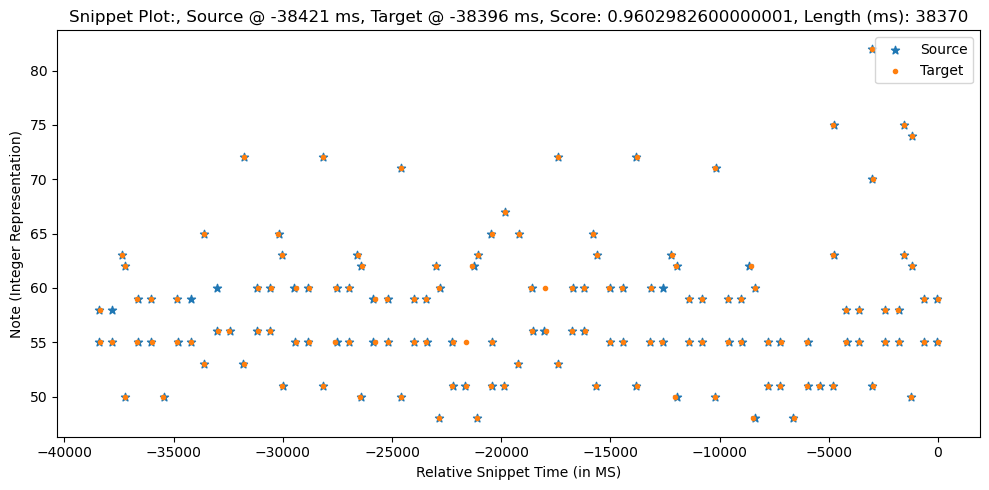

Scores: [ 0.945   0.915   0.9975  0.9475  0.965   0.985   0.9225  0.9325  0.95
  0.915   0.8925  0.9675  0.9825  0.945   0.99    0.9525  0.915   0.8425
  0.92    0.915   0.9375  0.895   0.9     0.9275  0.95    0.935   0.9725
  0.8175  0.8375  0.9025  0.9025  0.97    0.9925  0.8375  0.8775  0.9325
  0.9775  0.825   0.9675  0.8775  0.785   0.775   0.95    0.9725  0.995
  1.      0.9925  0.985   0.9225  0.98    0.995   0.9625  0.9475  0.9025
  0.9375  0.935  -0.      0.855   0.91    0.9525  0.9875  0.92    0.9475
  0.99    0.995   0.9825  0.9625  0.9     0.845  -0.      0.835   0.995
  0.9575  0.9725  0.9475  0.985   0.8175  0.9925  0.985   0.9925  0.9275
  0.97    0.855   0.9925  0.98    0.9675  0.9475  0.9525  0.905   0.88
  0.775   0.9175  0.985   0.9825  0.9425  0.99    0.965   0.9125  0.905
  0.88    0.895   0.895   0.8575  0.795   0.905   0.975   0.9925  0.9275
  0.97    0.9025  0.845   0.8825  0.8825  0.925   0.945   0.945   0.935
  0.9675  0.995   0.97    0.96    0.9375  0.8625  0

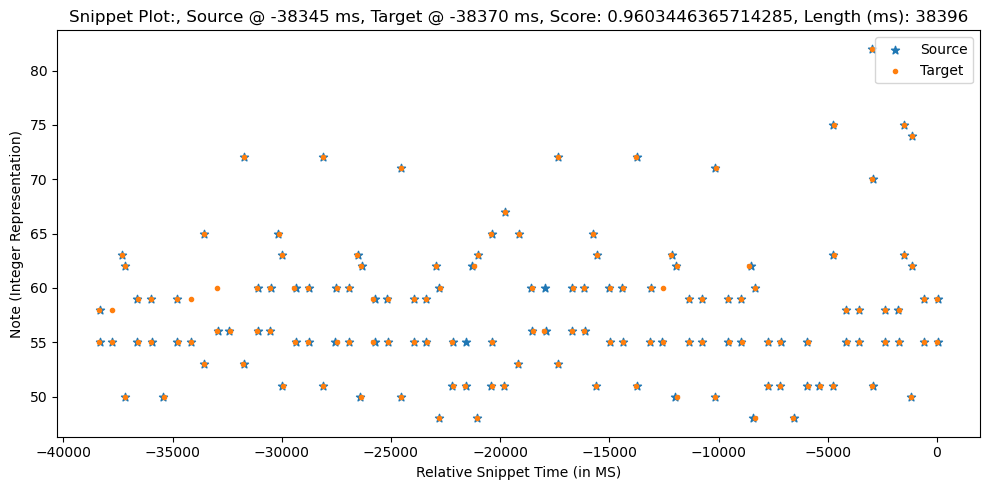

0.9603446365714285
Scores: [-0.     -0.     -0.     -0.     -0.     -0.     -0.     -0.     -0.
 -0.     -0.     -0.     -0.      0.43   -0.      0.305  -0.     -0.
 -0.     -0.     -0.     -0.     -0.     -0.     -0.     -0.     -0.
  0.8225 -0.     -0.     -0.     -0.     -0.     -0.      0.3525 -0.
 -0.      0.2925 -0.      0.3725  0.825  -0.     -0.     -0.      0.505
 -0.      0.3125 -0.     -0.     -0.      0.33   -0.      0.485   0.905
 -0.     -0.      0.525  -0.     -0.     -0.     -0.     -0.     -0.
 -0.      0.3825 -0.     -0.     -0.     -0.     -0.     -0.     -0.
 -0.     -0.     -0.     -0.     -0.     -0.      0.815  -0.     -0.
 -0.      0.3375 -0.      0.37    0.395  -0.     -0.      0.3475  0.3775
 -0.      0.8275 -0.     -0.      0.3125 -0.      0.255  -0.     -0.
 -0.     -0.      0.32   -0.      0.2125  0.9675 -0.     -0.     -0.
  0.295  -0.      0.3525 -0.     -0.      0.3775 -0.      0.205  -0.
 -0.     -0.      0.31    0.3475 -0.      0.105  -0.     -0.     -

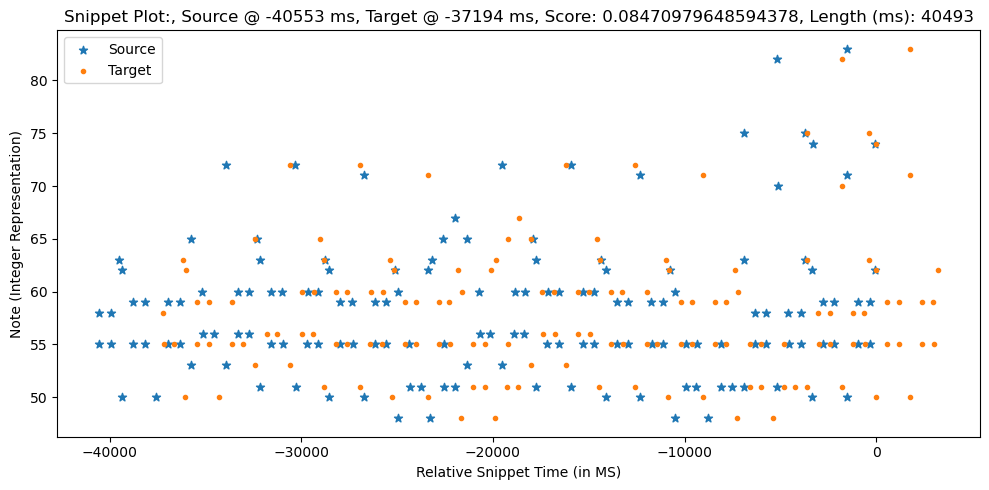

Scores: [ 0.94    0.91    0.9975  0.9525  0.97    0.99    0.9275  0.9375  0.945
  0.91    0.8975  0.9725  0.9875  0.95    0.985   0.9475  0.91    0.8475
  0.915   0.91    0.9325  0.89    0.895   0.9225  0.955   0.94    0.9675
  0.8125  0.8325  0.8975  0.8975  0.965   0.9875  0.8425  0.8825  0.9275
  0.9725  0.82    0.9725  0.8725  0.78    0.77    0.955   0.9775  1.
  0.995   0.9975  0.98    0.9275  0.985   1.      0.9675  0.9525  0.9075
  0.9325  0.93   -0.      0.86    0.905   0.9475  0.9925  0.915   0.9425
  0.995   1.      0.9775  0.9575  0.905   0.85   -0.      0.83    1.
  0.9525  0.9675  0.9525  0.98    0.8125  0.9975  0.99    0.9975  0.9325
  0.965   0.86    0.9975  0.975   0.9625  0.9525  0.9575  0.91    0.875
  0.78    0.9225  0.98    0.9875  0.9475  0.995   0.97    0.9175  0.91
  0.885   0.9     0.9     0.8525  0.8     0.91    0.98    0.9975  0.9225
  0.965   0.8975  0.85    0.8875  0.8875  0.93    0.95    0.95    0.94
  0.9725  1.      0.965   0.955   0.9325  0.8575  0.9175 

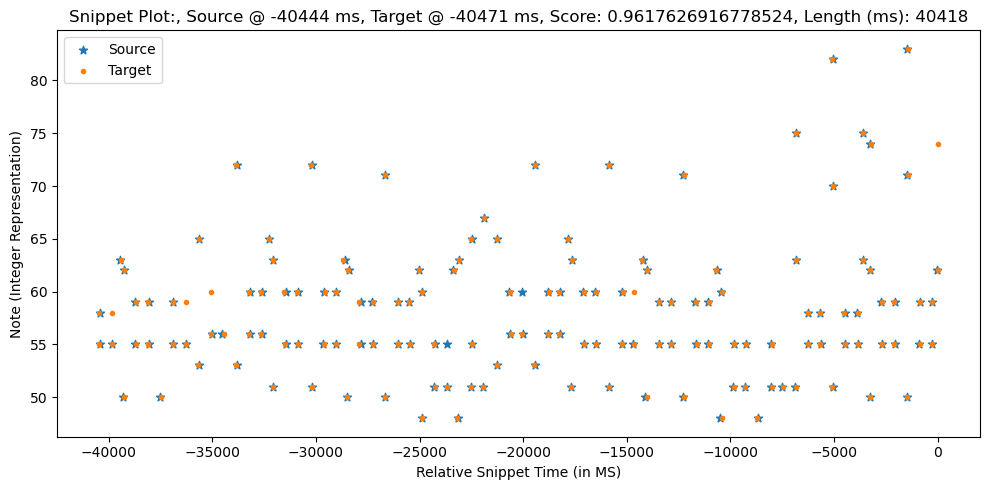

0.9617626916778524
Scores: [ 0.91    0.94    0.9975 -0.      0.9525  0.97    0.99    0.9375  0.9275
  0.945   0.91    0.8975  0.9875  0.9725 -0.      0.95    0.985   0.9475
 -0.      0.91    0.8475  0.915   0.91    0.89    0.9325  0.895   0.9225
  0.955   0.9675  0.94    0.8125  0.8325  0.8975  0.8975  0.965   0.9875
  0.8425  0.8825  0.9275  0.9725  0.82    0.9725  0.8725  0.78    0.77
  0.955   0.9775  1.      0.995   0.98    0.9975  0.9275  0.985   1.
  0.9675  0.9525  0.9325  0.9075  0.93    0.86    0.905   0.9475  0.915
  0.9925  0.9425  0.995   1.      0.9775  0.9575  0.905   0.85    0.83
  0.9525  1.      0.9675  0.9525  0.8125  0.98    0.9975  0.99    0.9975
  0.965   0.9325  0.9975  0.86    0.9625  0.975   0.9525  0.9575 -0.
  0.91    0.875   0.78    0.9225  0.98    0.9875  0.995   0.9475  0.97
  0.9175  0.91    0.885   0.9     0.9     0.8525  0.8     0.91    0.98
  0.9975  0.9225  0.965   0.8975  0.85    0.8875  0.8875  0.93    0.95
  0.95    0.94    0.9725  0.965   1.      0

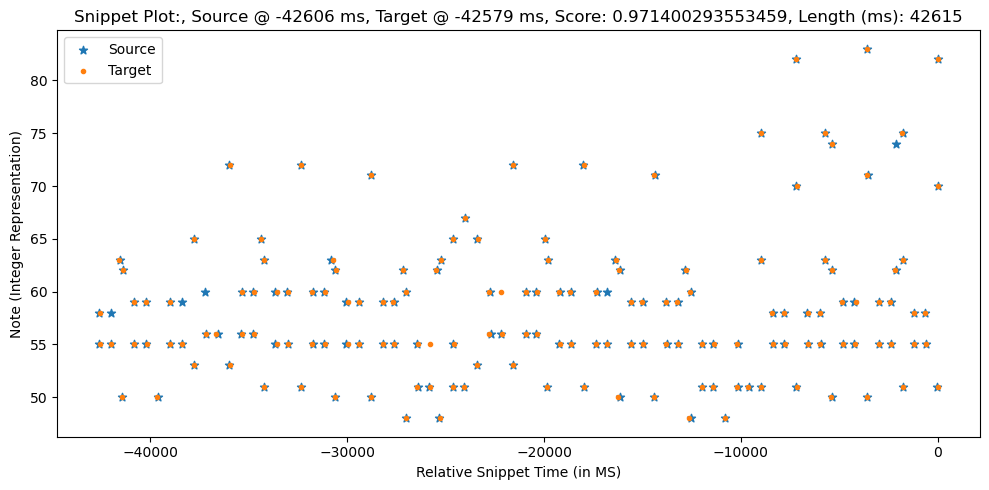

Scores: [ 0.94    0.91    0.9975  0.9525  0.97    0.99    0.9275  0.9375  0.945
  0.91    0.8975  0.9725  0.9875  0.95    0.985   0.9475  0.91    0.8475
  0.915   0.91    0.9325  0.89    0.895   0.9225  0.955   0.94    0.9675
  0.8125  0.8325  0.8975  0.8975  0.965   0.9875  0.8425  0.8825  0.9275
  0.9725  0.82    0.9725  0.8725  0.78    0.77    0.955   0.9775  1.
  0.995   0.9975  0.98    0.9275  0.985   1.      0.9675  0.9525  0.9075
  0.9325  0.93   -0.      0.86    0.905   0.9475  0.9925  0.915   0.9425
  0.995   1.      0.9775  0.9575  0.905   0.85   -0.      0.83    1.
  0.9525  0.9675  0.9525  0.98    0.8125  0.9975  0.99    0.9975  0.9325
  0.965   0.86    0.9975  0.975   0.9625  0.9525  0.9575  0.91    0.875
  0.78    0.9225  0.98    0.9875  0.9475  0.995   0.97    0.9175  0.91
  0.885   0.9     0.9     0.8525  0.8     0.91    0.98    0.9975  0.9225
  0.965   0.8975  0.85    0.8875  0.8875  0.93    0.95    0.95    0.94
  0.9725  1.      0.965   0.955   0.9325  0.8575  0.9175 

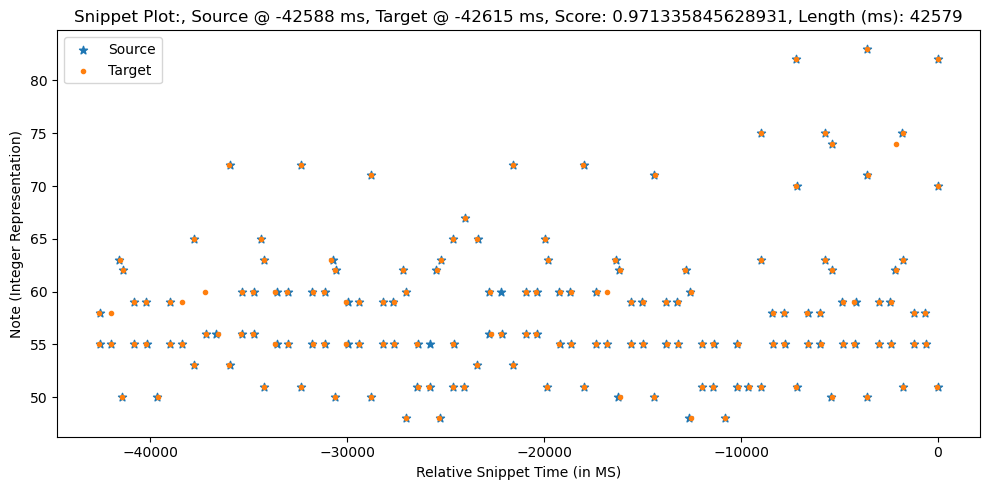

0.971400293553459
Scores: [ 0.905   0.935   0.9925 -0.      0.9575  0.975   0.995   0.9425  0.9325
  0.94    0.905   0.9025  0.9925  0.9775 -0.      0.955   0.98    0.9425
 -0.      0.905   0.8525  0.91    0.905   0.885   0.9275  0.89    0.9175
  0.96    0.9625  0.945   0.8075  0.8275  0.8925  0.8925  0.96    0.9825
  0.8475  0.8875  0.9225  0.9675  0.815   0.9775  0.8675  0.775   0.765
  0.96    0.9825  0.995   0.99    0.975   0.9975  0.9325  0.99    0.995
  0.9725  0.9575  0.9275  0.9125  0.925   0.865   0.9     0.9425  0.91
  0.9975  0.9375  1.      0.995   0.9725  0.9525  0.91    0.855   0.825
  0.9475  0.995   0.9625  0.9575  0.8075  0.975   0.9975  0.995   0.9975
  0.96    0.9375  0.9975  0.865   0.9575  0.97    0.9575  0.9625 -0.
  0.915   0.87    0.785   0.9275  0.975   0.9925  1.      0.9525  0.975
  0.9225  0.915   0.89    0.905   0.905   0.8475  0.805   0.915   0.985
  0.9975  0.9175  0.96    0.8925  0.855   0.8925  0.8925  0.935   0.955
  0.955   0.945   0.9775  0.96    0.9

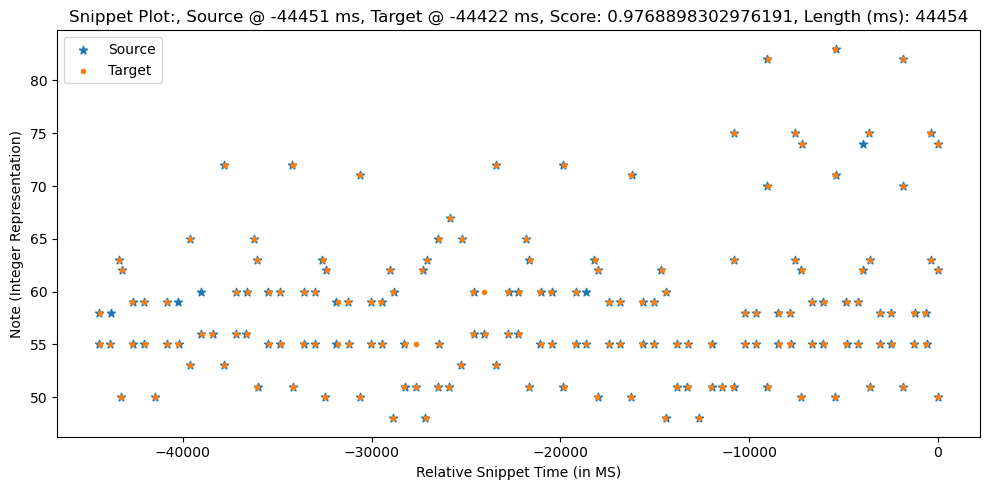

Scores: [ 0.935   0.905   0.9925  0.9575  0.975   0.995   0.9325  0.9425  0.94
  0.905   0.9025  0.9775  0.9925  0.955   0.98    0.9425  0.905   0.8525
  0.91    0.905   0.9275  0.885   0.89    0.9175  0.96    0.945   0.9625
  0.8075  0.8275  0.8925  0.8925  0.96    0.9825  0.8475  0.8875  0.9225
  0.9675  0.815   0.9775  0.8675  0.775   0.765   0.96    0.9825  0.995
  0.99    0.9975  0.975   0.9325  0.99    0.995   0.9725  0.9575  0.9125
  0.9275  0.925  -0.      0.865   0.9     0.9425  0.9975  0.91    0.9375
  1.      0.995   0.9725  0.9525  0.91    0.855  -0.      0.825   0.995
  0.9475  0.9625  0.9575  0.975   0.8075  0.9975  0.995   0.9975  0.9375
  0.96    0.865   0.9975  0.97    0.9575  0.9575  0.9625  0.915   0.87
  0.785   0.9275  0.975   0.9925  0.9525  1.      0.975   0.9225  0.915
  0.89    0.905   0.905   0.8475  0.805   0.915   0.985   0.9975  0.9175
  0.96    0.8925  0.855   0.8925  0.8925  0.935   0.955   0.955   0.945
  0.9775  0.995   0.96    0.95    0.9275  0.8525  0

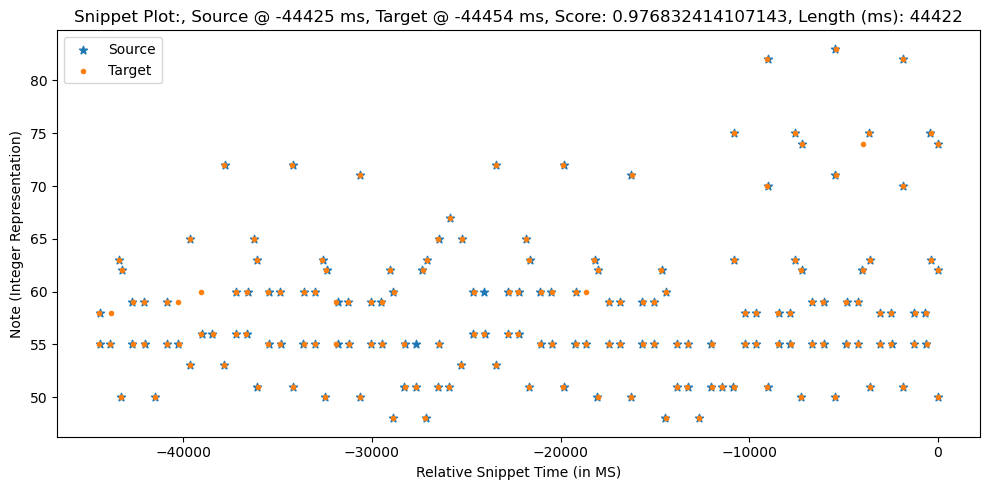

0.9768898302976191
Scores: [ 0.895   0.925   0.9825 -0.      0.9675  0.985   0.995   0.9525  0.9425
  0.93    0.895   0.9125  0.9975  0.9875 -0.      0.965   0.97    0.9325
 -0.      0.895   0.8625  0.9     0.895   0.875   0.9175  0.88    0.9075
  0.97    0.9525  0.955   0.7975  0.8175  0.8825  0.8825  0.95    0.9725
  0.8575  0.8975  0.9125  0.9575  0.805   0.9875  0.8575  0.765   0.755
  0.97    0.9925  0.985   0.98    0.965   0.9875  0.9425  1.      0.985
  0.9825  0.9675  0.9175  0.9225  0.915   0.875   0.89    0.9325  0.9
  0.9925  0.9275  0.99    0.985   0.9625  0.9425  0.92    0.865   0.815
  0.9375  0.985   0.9525  0.9675  0.7975  0.965   0.9875  0.995   0.9875
  0.95    0.9475  0.9875  0.875   0.9475  0.96    0.9675  0.9725 -0.
  0.925   0.86    0.795   0.9375  0.965   0.9975  0.99    0.9625  0.985
  0.9325  0.925   0.9     0.915   0.915   0.8375  0.815   0.925   0.995
  0.9875  0.9075  0.95    0.8825  0.865   0.9025  0.9025  0.945   0.965
  0.965   0.955   0.9875  0.95    0.9

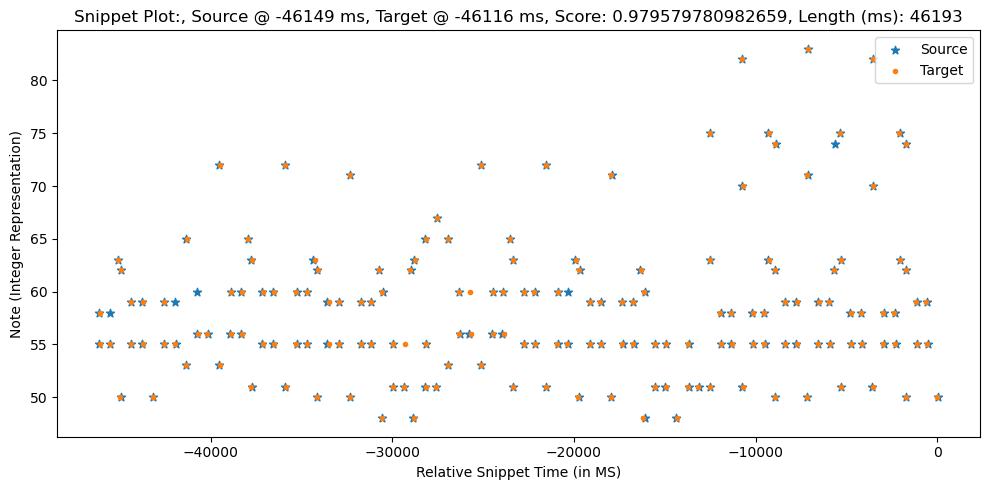

Scores: [ 0.9325  0.9025  0.99    0.96    0.9775  0.9975  0.935   0.945   0.9375
  0.9025  0.905   0.98    0.995   0.9575  0.9775  0.94    0.9025  0.855
  0.9075  0.9025  0.925   0.8825  0.8875  0.915   0.9625  0.9475  0.96
  0.805   0.825   0.89    0.89    0.9575  0.98    0.85    0.89    0.92
  0.965   0.8125  0.98    0.865   0.7725  0.7625  0.9625  0.985   0.9925
  0.9875  0.995   0.9725  0.935   0.9925  0.9925  0.975   0.96    0.915
  0.925   0.9225 -0.      0.8675  0.8975  0.94    1.      0.9075  0.935
  0.9975  0.9925  0.97    0.95    0.9125  0.8575 -0.      0.8225  0.9925
  0.945   0.96    0.96    0.9725  0.805   0.995   0.9975  0.995   0.94
  0.9575  0.8675  0.995   0.9675  0.955   0.96    0.965   0.9175  0.8675
  0.7875  0.93    0.9725  0.995   0.955   0.9975  0.9775  0.925   0.9175
  0.8925  0.9075  0.9075  0.845   0.8075  0.9175  0.9875  0.995   0.915
  0.9575  0.89    0.8575  0.895   0.895   0.9375  0.9575  0.9575  0.9475
  0.98    0.9925  0.9575  0.9475  0.925   0.85    0.9

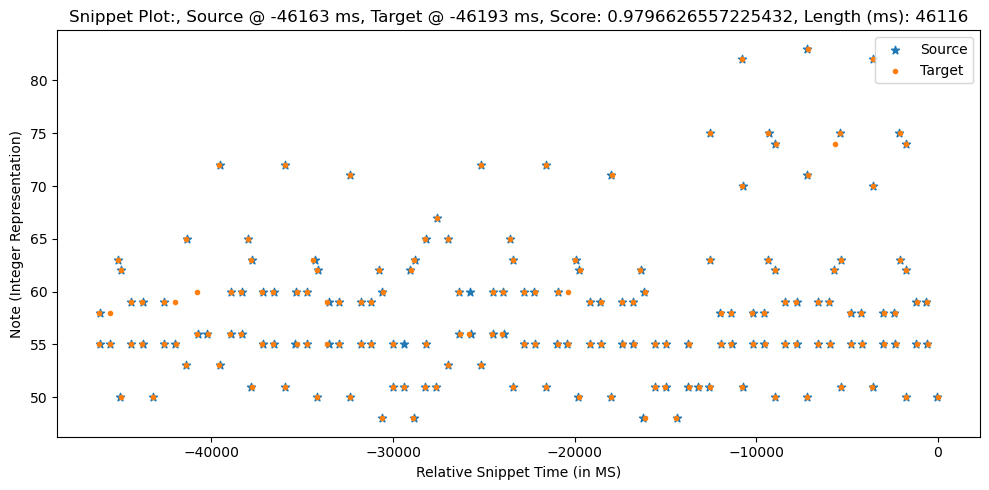

0.9796626557225432
Scores: [ 0.9025  0.9325  0.99   -0.      0.96    0.9775  0.9975  0.945   0.935
  0.9375  0.9025  0.905   0.995   0.98   -0.      0.9575  0.9775  0.94
 -0.      0.9025  0.855   0.9075  0.9025  0.8825  0.925   0.8875  0.915
  0.9625  0.96    0.9475  0.805   0.825   0.89    0.89    0.9575  0.98
  0.85    0.89    0.92    0.965   0.8125  0.98    0.865   0.7725  0.7625
  0.9625  0.985   0.9925  0.9875  0.9725  0.995   0.935   0.9925  0.9925
  0.975   0.96    0.925   0.915   0.9225  0.8675  0.8975  0.94    0.9075
  1.      0.935   0.9975  0.9925  0.97    0.95    0.9125  0.8575  0.8225
  0.945   0.9925  0.96    0.96    0.805   0.9725  0.995   0.9975  0.995
  0.9575  0.94    0.995   0.8675  0.955   0.9675  0.96    0.965  -0.
  0.9175  0.8675  0.7875  0.93    0.9725  0.995   0.9975  0.955   0.9775
  0.925   0.9175  0.8925  0.9075  0.9075  0.845   0.8075  0.9175  0.9875
  0.995   0.915   0.9575  0.89    0.8575  0.895   0.895   0.9375  0.9575
  0.9575  0.9475  0.98    0.9575  0

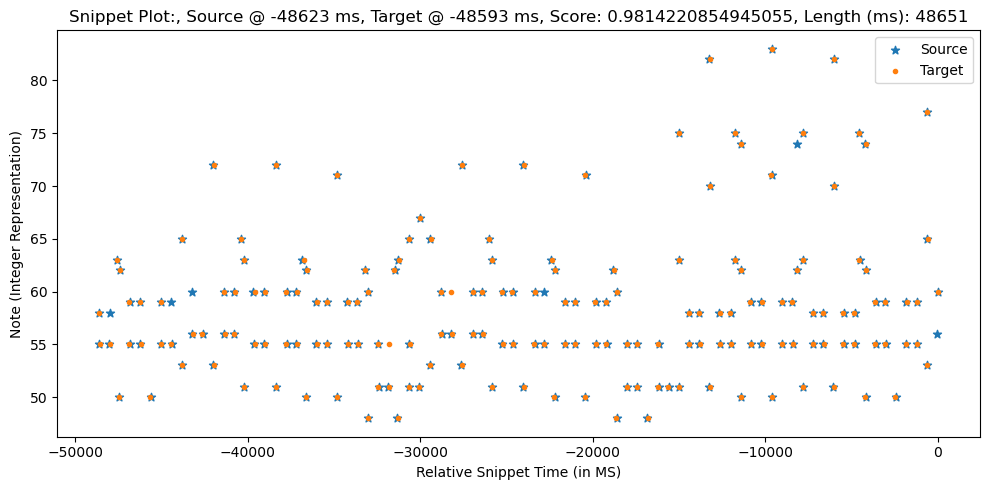

Scores: [ 0.9325  0.9025  0.99    0.96    0.9775  0.9975  0.935   0.945   0.9375
  0.9025  0.905   0.98    0.995   0.9575  0.9775  0.94    0.9025  0.855
  0.9075  0.9025  0.925   0.8825  0.8875  0.915   0.9625  0.9475  0.96
  0.805   0.825   0.89    0.89    0.9575  0.98    0.85    0.89    0.92
  0.965   0.8125  0.98    0.865   0.7725  0.7625  0.9625  0.985   0.9925
  0.9875  0.995   0.9725  0.935   0.9925  0.9925  0.975   0.96    0.915
  0.925   0.9225 -0.      0.8675  0.8975  0.94    1.      0.9075  0.935
  0.9975  0.9925  0.97    0.95    0.9125  0.8575 -0.      0.8225  0.9925
  0.945   0.96    0.96    0.9725  0.805   0.995   0.9975  0.995   0.94
  0.9575  0.8675  0.995   0.9675  0.955   0.96    0.965   0.9175  0.8675
  0.7875  0.93    0.9725  0.995   0.955   0.9975  0.9775  0.925   0.9175
  0.8925  0.9075  0.9075  0.845   0.8075  0.9175  0.9875  0.995   0.915
  0.9575  0.89    0.8575  0.895   0.895   0.9375  0.9575  0.9575  0.9475
  0.98    0.9925  0.9575  0.9475  0.925   0.85    0.9

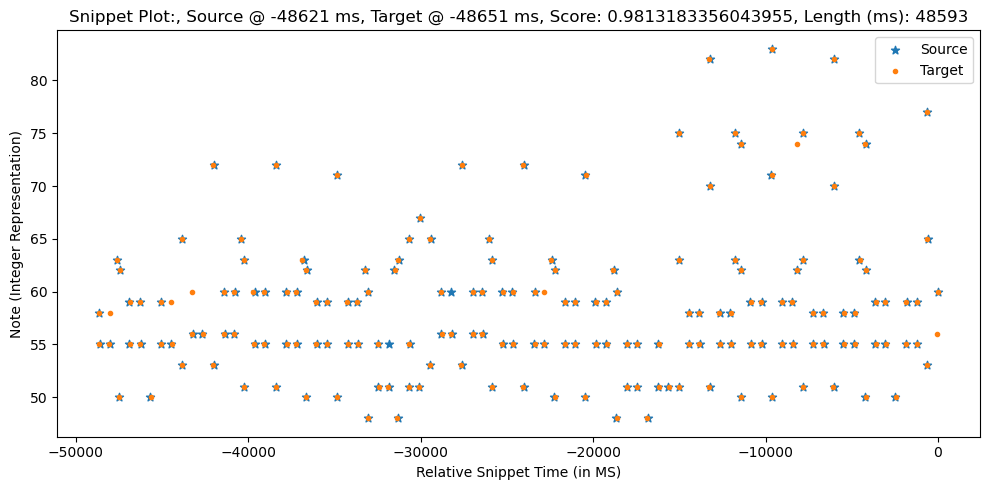

0.9814220854945055


In [63]:
fig = plt.figure()
ax = fig.add_subplot(projection='3d')

# matches=[]
for x in range(5000,10000,500):
#     print(x)
#     x = 0
    for y in range(5000,50000,2000):
        t1 = [y+x,0+x] # timestamps in ms
        t2 = [191400+y+x,191400+x]
#         t2 = [413000+y+x,413000+x]
#         t2 = [587000+y+x,587000+x]

        tf1 = time_to_sequence(notes, t1)
        tf2 = time_to_sequence(notes, t2)

#         a,b,c,d,score = musical_similarity(tf1,tf2,True)
        a,b,c,d,score = two_way_similarity(tf1,tf2,True)
        print(score)
#         matches.append([x,y,score])
        ax.scatter(x,y,score)
        if score<0.8:
            print("Oops")
#             a,b,c,d,score = two_way_similarity(tf1,tf2,True)
#             display_snippet_plot(notes, time_to_index(notes,t1[0]),time_to_index(notes,t1[1]),time_to_index(notes,t2[0]),time_to_index(notes,t2[1]), score, t1[0], t2[0])
    #         play_match(t1[0],t1[1],t2[0],t2[1])
    #         predict(notes, time_to_index(notes,t1[0]), time_to_index(notes,t1[1]), time_to_index(notes,t2[0]),time_to_index(notes,t2[1]), tf1[-1][0],pred_time=100,sound=True)
    #         time.sleep(2)
#         break
#     break

# plt.scatter3D(matches)
ax.set_xlabel('Start position (ms)')
ax.set_ylabel('Length of snip (ms)')
ax.set_zlabel('Score')
plt.show()

In [106]:
def calculate_similarity_time(notes, source_id, currTime, max_matches=None, skip = 100, disp=False):
    """ Function that calls musical similarity on targets generated for a source_id.
        Target snips start at every 100 ms, and has same time length as source.
    
    Args:
        notes: list of all notes from a recording [[t,note,vel],[t,note,vel],[t,note,vel],...]
        source_id: indices of note array corresponding to current time snippet (source_id_start>source_id_end) 
                   [source_id_start, source_id_end]
        currTime: time stamp at which we are searching for matches (ms)
        max_matches: optional param to state how many matches to stop after
        disp: boolean whether to print each match (defaults True)
    
    Returns:
        matches: list of matches [[currTime, pastTime1, score1], [currTime, pastTime2, score2],...] 
    
    """
    calcstart = timeit.default_timer()
    matches = []
    last_id_end = 0 # track previous end index of target
    last_id_start = 0
    source_id_start, source_id_end = source_id
    source_end = notes[source_id_end][0] # start and end time stamps of source
    length_ms = currTime - source_end #in milliseconds
#     count = 0 # counting num "good" matches
    
    target_start = length_ms
    rewinded = False
    while target_start < currTime-5000:
#     for target_start in range(currTime-5000, currTime-1000, skip):
#         starttime = timeit.default_timer()
        target_end = target_start - length_ms # pick target_end by time length of course snip
        
        # finding new end index
        for i in range(last_id_end,len(notes)):
            if notes[i][0] >= target_end:
                target_id_end = i
                break
             
        # finding new start index
        for i in range(target_id_end,len(notes)):
            if notes[i][0] > target_start:
                target_id_start = i
                break
                
        if target_id_end > target_id_start-4:
            last_id_end = target_id_end
            last_id_start = target_id_start
            target_start += skip
            continue
        if target_id_end == last_id_end and last_id_start == target_id_start:
            target_start += skip
            continue
            
#         lm1,lm2,mo1,mo2,score = musical_similarity(notes[source_id_end:source_id_start], notes[target_id_end:target_id_start],disp=disp)
        lm1,lm2,mo1,mo2,score = two_way_similarity(notes[source_id_end:source_id_start], notes[target_id_end:target_id_start],disp=disp)
        
        if score:
            if score>0.7:
#                 count += 1
                # Dsiplaying matches > 0.7 if disp is True
                if disp:
                    display_match(notes, source_id_start, source_id_end, target_id_start, target_id_end, score, source_end, notes[target_id_end][0])
#                     display_snippet_plot(notes, source_id_start, source_id_end, target_id_start, target_id_end, score, source_end, notes[target_id_end][0])
                    play_match(currTime, source_end, target_start, target_end)
#                     predict(notes, source_id_start, source_id_end, target_id_start, target_id_end, currTime, target_start)
                    time.sleep(5)

            if score>0.5:
                target_time = target_start
#                 if rewinded:
#                     rewinded = False
                # case 1
                if lm1 >= source_id_start - source_id_end - 2:
#                     target_time = notes[target_id_end+lm2][0] + (currTime - notes[source_id_end+lm1][0])
                    target_time = notes[target_id_start-1][0] + int(mo2) + (currTime - notes[source_id_start-1][0])
                    
#                     rewinded = True
#                     continue
#                     print(target_id_end+lm2,target_time)
                # case 2 - run again with target slightly ahead?
                elif lm2 >= target_id_start - target_id_end - 2:
                    if currTime - notes[source_id_end+lm1][0] < 1:
                        print("oops something went wrong with time calculations - might end in infinite loop")
                    target_start += currTime - notes[source_id_end+lm1][0]
                    continue
                # case 1 - lenient
#                 elif lm1 >= source_id_start - source_id_end - 3:
#                     target_time = notes[target_id_end+lm2][0] + (currTime - notes[source_id_end+lm1][0])
#                     rewinded = True
#                     continue
#                 # case 2 - lenient
#                 elif lm2 >= target_id_start - target_id_end - 3:
#                     if currTime - notes[source_id_end+lm1][0] < 0:
#                         print("oops something went wrong with time calculations - might end in infinite loop")
#                     target_start += currTime - notes[source_id_end+lm1][0]
#                     continue
                # random??
#                 else:
#                     target_time = notes[target_id_end+lm2][0] + (currTime - notes[source_id_end+lm1][0])
#                     rewinded = True
#                     continue
                target_time = notes[target_id_start-1][0] - int(mo2) + (currTime - notes[source_id_start-1][0])    
                if target_time<currTime-5000:
                    matches.append([currTime, target_time, score, source_id_start, source_id_end, target_id_end+lm2, target_id_end])
        
        last_id_end = target_id_end
        last_id_start = target_id_start
        target_start += skip
        
#         if max_matches and count > max_matches:
#             break

#         looptime = timeit.default_timer() - starttime
#         if looptime>0.05:
#             print("LoopTime:",looptime,"target&source:",currTime,target_start)
        
    calctime = timeit.default_timer() - calcstart
    global t_exec
    t_exec[currTime]=calctime
#     if calctime>1:
#         print("Time:",calctime,"for source:",currTime,"and length",length_ms,"ms",",score:",matches[:][2])
    
    return matches


In [14]:
def get_source_notes(notes, start_time, min_notes, max_notes, min_time):
    """ Function that ...
    
    Args:
        snips: list of all note arrays of lengths min_notes to max_notes snip[1][2][3][4]
               1 - length of snip, 2 - start index from notes, 3 - index of note in array, 4 - [t, note, vel]
        start_time: start index of notes array - corresponding to current time
        min_notes: min number of notes for a valid sequence, integer
        max_notes: max note length for a snippet, integer
        min_time: min time length for a valid sequence, integer (ms)
        offset: used to find note snippets longer than min_length, integer, default=0
    
    Returns:
        matches: list of matches [[currTime, pastTime1, score1], [currTime, pastTime2, score2],...] 
    
    """
    start_index = np.argwhere(notes[:,0] > start_time)
    if start_index.any():
        start_index = start_index[0]
    else:
        print("Error: Start time too large")
        return np.array([None,None])
    
    if start_index<min_notes:
        return np.array([None,None])
    
    end_index = np.arange(start_index-min_notes, start_index - max_notes - 1, -1)
    ids = (start_time - notes[end_index,0] >= min_time) * end_index
    ids = ids[np.nonzero(ids)]
    if ids.any():
        source_id = np.array([start_index[0],ids[0]])
        return source_id
        
#     print("Error: Trying to access snippet length > max_notes",end=" ")
    return np.array([None,None])

In [15]:
def find_matches_at_timestamp(i, notes, minNotes, minTime, maxNotes, maxTime, thresh, disp):
    """Function that finds similarity from lengths minNotes to maxNotes ...
    
    Args:
    
    Returns:
    
    """
    sims_arr = []
    print("\r",end="")
    print("i:",i,end="   ")
    # only calculate on historical timestamps
    offset = 500
#     count = notes[-1,0] + 1 # count number of relevant matches
    numSourceNotes = 0
    sourceTime = 0
#     attempt = 1
#     while numSourceNotes < maxNotes:
    while sourceTime < maxTime:
        sourceId = get_source_notes(notes, i, minNotes, maxNotes, sourceTime+offset)
        if not sourceId.any():
#             print("Failed for source_id = ", sourceId, ", on attempt ", attempt,end=" ")
#             if offset>0:
#                 percentage_matches_any += 1
            break

        # num notes in source snippet
        numSourceNotes = (sourceId[0] - sourceId[1])
        # total time in ms in source snippet
        sourceTime = i - notes[sourceId[1]][0]
        
        sim = calculate_similarity_time(notes, sourceId, i, disp=disp)
        for match in sim:
            match.append(numSourceNotes)
            match.append(sourceTime)
        sims_arr.extend(sim)
#         sim = np.array(sim)
#         count = np.sum(np.nonzero(sim[:,2] > thresh)[0])
        offset += 500
#         attempt += 1

#     print(sims_arr)
#     for i in sims_arr:
#         if len(i) != 9:
#             print("Error! ",i)
    return np.array(sims_arr)

In [16]:
sd.play(piano_audio, samplerate)

In [17]:
sd.stop()

In [125]:
midiPath = '../midi-recordings/ladispute.txt'
# midiPath = '../midi-recordings/2_prelude.txt'
notes = midi_to_timeseries(midiPath)

global t_exec

minNotes = 8
maxNotes = 200 # max length of snippet to be calculated
minTime = 1500 # min time in ms
maxTime = 30000 # if more matches, increase snippet length
thresh = 0.7
start = 191400
skip = 10
end = 365000
# start = 360400
# skip = 500
# end = 370000
t_exec = np.zeros(notes[-1][0])

# calculating similarity
sims_arr = []
curr_times = np.arange(start, end, skip)
# fmt = np.vectorize(find_matches_at_timestamp,signature="(),"+str(notes.shape)+",(),(),(),(),(),()") #,signature="(2),(2),()->()", otypes=[np.float]
# sims_arr = fmt(curr_times, notes, minNotes, minTime, maxNotes, maxTime, thresh, disp=False)

fm = functools.partial(find_matches_at_timestamp, notes=notes, minNotes=minNotes, minTime=minTime, maxNotes=maxNotes, maxTime=maxTime, thresh=thresh, disp=False)

# Running without pooling
# for i in curr_times:
#     sims_arr.extend(find_matches_at_timestamp(i, notes, minNotes, minTime, maxNotes, maxTime, thresh, disp=False))
# sarr = sims_a

# Running with time allocation to functions - analyse speed and bottlenecks
# %prun sims_arr.extend(find_matches_at_timestamp(25000, notes, minNotes, minTime, maxNotes, maxTime, thresh, disp=False))



In [ ]:
fm(25000)

with Pool(4) as p:
    sims_arr = p.map(fm, curr_times)

sarr = []
for i in range(len(sims_arr)):
    sarr.extend(sims_arr[i])

i: 25000    191400    202250    213100    223950    202260    191410    213110    202270    223960    191420    202280    191430    213120    202290    223970    191440    202300    213130    191450    202310    223980    213140    191460    202320    191470    223990    213150    202330    191480    202340    213160    224000    191490    202350    213170    191500    202360    224010    202370    191510    213180    202380    224020    202390    191520    213190    202400    191530    202410    224030    213200    202420    191540    202430    213210    224040    191550    202440    202450    213220    224050    191560    202460    202470    213230    191570    224060    202480    202490    191580    213240    202500    224070    191590    213250    202510    202520    191600    224080    213260    202530    191610    202540    224090    213270    202550    191620    202560    213280    224100    191630    202570    191640    213290    202580    224110    202590    191650    213300  

i: 193670    225260    205240    193680    214710    205250    193690    225270    205260    214720    193700    205270    225280    193710    214730    205280    193720    205290    225290    214740    193730    205300    193740    205310    214750    225300    193750    205320    214760    193760    205330    225310    193770    205340    214770    205350    193780    225320    205360    193790    214780    205370    225330    193800    205380    193810    214790    205390    225340    193820    205400    214800    193830    205410    225350    193840    205420    214810    205430    193850    225360    205440    214820    193860    205450    193870    205460    225370    214830    205470    193880    214840    205480    193890    225380    205490    193900    214850    205500    225390    193910    205510    214860    193920    205520    225400    193930    205530    214870    193940    205540    225410    214880    193950    205550    193960    205560    225420    214890    193970 

i:  207790    196290    216370    207800    226620    196300    207810    196310    216380    207820    226630    196320    216390    207830    196330    207840    226640    196340    216400    207850    196350    207860    216410    226650    196360    207870    196370    216420    207880    226660    196380    207890    196390    216430    207900    196400    226670    207910    216440    196410    207920    226680    196420    216450    207930    196430    207940    216460    226690    196440    207950    216470    196450    207960    226700    196460    207970    216480    196470    226710    207980    216490    196480    207990    196490    226720    208000    216500    196500    196510    208010    226730    216510    196520    208020    196530    216520    226740    208030    196540    196550    208040    216530    196560    226750    208050    196570    216540    208060    196580    226760    208070    196590    216550    196600    208080    226770    216560    196610    208090

i: 880160    199140    228010    217950    210170    199150    199160    228020    210180    217960    199170    210190    199180    228030    217970    199190    210200    199200    210210    217980    199210    228040    199220    210220    199230    217990    228050    210230    199240    210240    199250    218000    228060    199260    210250    199270    218010    210260    199280    228070    210270    199290    218020    199300    210280    228080    199310    218030    210290    199320    228090    210300    199330    218040    199340    210310    228100    199350    218050    210320    199360    199370    210330    218060    228110    199380    210340    199390    218070    i:    199400    210350    199410    218080    210360    199420    228130    199430    210370    218090    199440    199450    210380    228140    199460    218100    210390    199470    228150    199480    210400    218110    199490    199500    210410    228160    218120    199510    210420    199520    1

i:51009400    234830    212350    229440    219410    234840    212360    229450    212370    219420    234850    229460    212380    234860    219430    212390    229470    212400    234870    229480    219440    212410    234880    229490    212420    219450    234890    212430    229500    219460    212440    234900    229510    212450    219470    234910    229520    212460    219480    234920    229530    212470    219490    212480    234930    229540    212490    219500    229550    234940    212500    229560    219510    234950    212510    212520    229570    219520    234960    212530    229580    219530    234970    212540    212550    229590    219540    234980    212560    229600    219550    212570    234990    212580    229610    219560    235000    212590    229620    212600    219570    235010    212610    219580    229630    212620    235020    212630    219590    229640    212640    235030    219600    229650    212650    235040    212660    219610    229660    212670

i:  247030    221400    236830    231510    247040    221410    236840    231520    247050    221420    236850    231530    221430    247060    236860    231540    221440    247070    231550    236870    221450    231560    247080    236880    231570    221460    236890    247090    231580    221470    236900    247100    231590    221480    236910    247110    231600    221490    236920    231610    247120    236930    221500    231620    247130    236940    221510    231630    247140    236950    231640    221520    247150    236960    231650    221530    247160    236970    231660    221540    247170    236980    231670    221550    247180    236990    231680    221560    247190    237000    231690    221570    237010    247200    231700    221580    237020    247210    231710    221590    237030    247220    231720    221600    237040    247230    221610    231730    237050    247240    221620    231740    237060    247250    221630    231750    237070    221640    247260    231760

i: 241040    268180    258090    250940    241050    268190    241060    250950    258100    268200    241070    250960    258110    268210    241080    250970    258120    268220    241090    250980    258130    268230    241100    250990    258140    268240    241110    251000    258150    268250    241120    251010    258160    241130    251020    268260    241140    258170    251030    268270    241150    251040    258180    268280    241160    251050    258190    268290    241170    251060    258200    251070    241180    268300    258210    251080    241190    268310    258220    251090    241200    268320    251100    258230    241210    251110    268330    258240    241220    251120    258250    241230    268340    258260    251130    241240    268350    258270    251140    241250    268360    258280    251150    241260    268370    258290    251160    241270    258300    268380    251170    241280    258310    268390    251180    241290    258320    268400    251190    241300 

i:  270080    253010    260110    243250    270090    253020    243260    260120    270100    253030    243270    260130    243280    253040    270110    260140    243290    260150    253050    270120    243300    260160    253060    243310    270130    260170    243320    253070    270140    243330    260180    253080    270150    243340    260190    253090    243350    270160    260200    253100    243360    270170    260210    253110    243370    270180    260220    253120    243380    270190    253130    260230    243390    253140    270200    260240    243400    253150    260250    270210    243410    253160    260260    270220    243420    253170    260270    270230    243430    253180    260280    270240    243440    253190    260290    270250    243450    253200    270260    260300    243460    253210    270270    260310    243470    253220    270280    260320    243480    253230    270290    260330    243490    253240    270300    260340    243500    253250    270310    260350

i:  271990    262140    255090    245420    272000    262150    245430    255100    272010    262160    245440    255110    272020    262170    245450    255120    272030    262180    245460    255130    272040    245470    262190    255140    272050    245480    262200    255150    272060    245490    262210    272070    255160    245500    262220    272080    255170    245510    262230    272090    255180    245520    262240    272100    255190    245530    272110    262250    255200    245540    272120    262260    255210    245550    272130    262270    255220    245560    272140    255230    262280    245570    272150    255240    262290    245580    255250    272160    262300    245590    255260    272170    245600    262310    255270    272180    245610    255280    262320    272190    245620    255290    262330    245630    255300    272200    262340    245640    255310    272210   i: 278200 255320    262350    272220    255330    278210    262360    255340    272230    278220 

i:44204070    274030    280050    289790    264080    274040    289800    280060    264090    274050    289810    264100    280070    274060    289820    264110    280080    274070    289830    264120    280090    274080    289840    264130    280100    274090    264140    289850    280110    274100    264150    289860    280120    274110    264160    280130    289870    274120    264170    280140    289880    274130    264180    280150    289890    274140    264190    280160    289900    274150    264200    280170    264210    274160    289910    280180    264220    274170    289920    280190    264230    274180    280200    289930    264240    274190    280210    264250    289940    274200    264260    280220    289950    274210    264270    280230    274220    289960    264280    280240    264290    274230    289970    280250    264300    274240    289980    264310    280260    274250    289990    264320    280270    274260    264330    290000    280280    274270    264340    290010

i: 312660    302890    286250    295810    312670    302900    295820    286260    302910    312680    295830    286270    302920    312690    295840    286280    302930    295850    312700    302940    295860    286290    312710    302950    295870    286300    312720    302960    295880    312730    286310    302970    295890    312740    302980    286320    295900    302990    312750    286330    295910    303000    312760    295920    286340    303010    312770    295930    286350    303020    312780    295940    303030    286360    312790    295950    303040    286370    312800    295960    303050    286380    295970    312810    303060    286390    295980    312820    303070    286400    295990    312830    303080    296000    312840    286410    303090    296010    312850    286420    303100    296020    312860    286430    303110    296030    312870    286440    303120    296040    312880    286450    303130    296050    312890    286460    296060    303140    312900    296070 

i: 297870    314620    304950    288360    297880    314630    304960    288370    297890    314640    304970    288380    297900    314650    304980    297910    288390    314660    304990    297920    288400    314670    305000    297930    288410    314680    297940    305010    288420    314690    297950    305020    314700    288430    297960    305030    314710    288440    297970    305040    314720    288450    297980    305050    314730    288460    305060    297990    314740    288470    305070    298000    314750    288480    305080    298010    314760    305090    288490    298020    305100   i:314770    288500    298030    305110    288510    314780    298040    305120    288520    314790    298050    305130    288530    314800    298060    305140    288540    314810    298070    288550    305150    298080    314820    288560    305160    288570    298090    314830    305170    288580    298100    314840    305180    288590    298110    305190    314850    288600    298120

i:  316660    307030    332550    316670    322850    307040    332560    316680    322860    307050    316690    332570    322870    307060    316700    322880    332580    307070    316710    322890    316720    307080    332590    316730    322900    307090    332600    316740    307100    322910    316750    332610    307110    316760    322920    332620    316770    307120    322930    316780    307130    332630    316790    322940    307140    316800    332640    322950    307150    316810    332650    307160    322960    316820    307170    332660    316830    322970    316840    307180    332670    322980    316850    307190    332680    322990    316860    307200    332690    316870    323000    307210    332700    316880    307220    323010    332710    316890    307230    323020    332720    316900    307240    323030    332730    316910    307250    323040    316920    332740    307260    323050    316930    332750    307270    323060    316940    332760    323070    307280

i:  319000    309230    319010    324800    334250    309240    319020    309250    324810    334260    309260    319030    324820    309270    334270    319040    324830    309280    319050    334280    309290    324840    319060    309300    334290    324850    319070    309310    324860    319080    309320    334300    324870    319090    309330    334310    324880    309340    319100    309350    319110    324890    334320    309360    319120    324900    334330    309370    319130    324910    309380    319140    334340    324920    319150    309390    324930    334350    319160    309400    324940    319170    309410    334360    319180    324950    309420    319190    334370    309430    324960    319200    309440    334380    324970    319210    309450    319220    334390    324980    309460    319230    324990   i:334400    309470    319240    309480    325000    334410    319250    309490    325010    319260    334420    309500    319270    325020    309510    334430    31928

i:6190750    335950    343890    321430    326760    335960    321440    343900    326770    335970    321450    343910    326780    321460    335980    326790    321470    343920    335990    321480    326800    336000    343930    321490    326810    336010    321500    343940    326820    321510    336020    321520    343950    326830    336030    321530    326840    343960    321540    336040    321550    326850    343970    336050    321560    326860    321570    336060    343980    321580    326870    336070    321590    343990    326880    354150    336080    344000    326890    354160    336090    326900    344010    354170    336100    326910    344020    354180    326920    336110    344030    354190    326930    336120    344040    354200    326940    336130    354210    344050    326950    336140    354220    326960    344060    354230    326970    336150    344070    354240    326980    336160    344080    326990    354250    336170    344090    327000    354260    336180 

i:  328960    356160    337930    345720    328970    356170    337940    328980    345730    356180    337950    328990    345740    356190    329000    337960    356200    345750    329010    337970    356210    345760    329020    337980    356220    329030    345770    337990    356230    329040    345780    338000    356240    329050    345790    338010    356250    329060    329070    338020    345800    356260    329080    338030    356270    345810    329090    338040    329100    356280    345820    329110    338050    356290    345830    329120    338060    356300    329130    345840    338070    356310    329140    345850    338080    356320    329150    338090    345860    329160    356330    338100    329170    356340    345870   i:329180    338110    356350    345880    329190    338120    356360    345890    329200    356370    338130    345900    329210    356380    338140    345910    329220    356390    338150    329230    345920    356400    338160    329240    35641

i:89407570    339890    331200    358300    347580    339900    331210    358310    339910    347590    331220    358320    339920    331230    347600    358330    331240    339930    347610    331250    358340    339940    347620    331260    358350    339950    347630    331270    358360    347640    339960    331280    358370    347650    339970    331290    358380    347660    331300    339980    358390    347670    331310    339990    347680    358400    331320    347690    340000    358410    331330    347700    358420    340010    347710    331340    358430    347720    340020    331350    358440    347730    331360    340030    358450    347740    331370    340040    358460    347750    331380    358470    340050    347760    331390    358480    347770    340060    331400    358490    347780    331410    340070    358500    347790    331420    340080    358510    347800    331430    358520    340090    347810    331440    358530    340100    331450    347820    358540    340110

In [ ]:
# Should score = score*(score>.5) + 0*(score<.5) ? (similiar to minmin - try that again)

# 1 was 200 + 10*ratio (good visual results but low percentage and some best matches are not "right")
# 1 is 50 * ratio (better results but matches get wider as we get longer matches)
# 2 is 500 + 10*ratio  (blah)
# curr was 600 + min(10*ratio,200), also penalty for 0 is divided by 2. NO GOOD
# curr was Should score = score*(score>.5) + 0*(score<.5) ? (similiar to minmin - try that again) NOT GREAT
# curr is above but with updated zero counting. BLAH
# curr was old zero counting, 50 * ratio and removing scores <0.5. BLAH
# curr was above minus removing <0.5 scores - should be same as 1 BLAH - that means somewthing else went wrong
# undid all changes (ratio from end, count zeros diff?) WORKED
# old is now w/ ratio from end GOOD, still blurry for long matches
# curr is with calc in calc_sim_time for lm1-2 - 1) keep 2 different if conditions BAAAAAD
# curr is 1 change above no goood infinite loop
# curr is for every 10ms (check histogram)


# simsDF_1 = simsDF_old
# simsDFall_1 = simsDFall_old
# simsDF_2 = simsDF_old
# simsDFall_2 = simsDFall_old
# simsDF_old = simsDF
# simsDFall_old = simsDFall

# possible errors:
# calc in calc_sim_time for lm1-2 - 2) see percentage each one is invoked
# lm1

In [109]:
## choosing only significant scores and storing the new data in sims_plot

sarr = np.array(sarr)
sims_thresh = sarr * (sarr>thresh) # considering a match if score greater than a threshold

simsDF = pd.DataFrame(data=sims_thresh.copy(), columns=['source_timestamp', 'target_timestamp','score','source_id_start','source_id_end','target_id_start','target_id_end','match_len','match_time'])
simsDFall = pd.DataFrame(data=sarr.copy(), columns=['source_timestamp', 'target_timestamp','score','source_id_start','source_id_end','target_id_start','target_id_end','match_len','match_time'])


<AxesSubplot:title={'center':'All matches >0.7, for \nMin Notes=8 notes, Max Notes=200'}, xlabel='source_timestamp', ylabel='target_timestamp'>

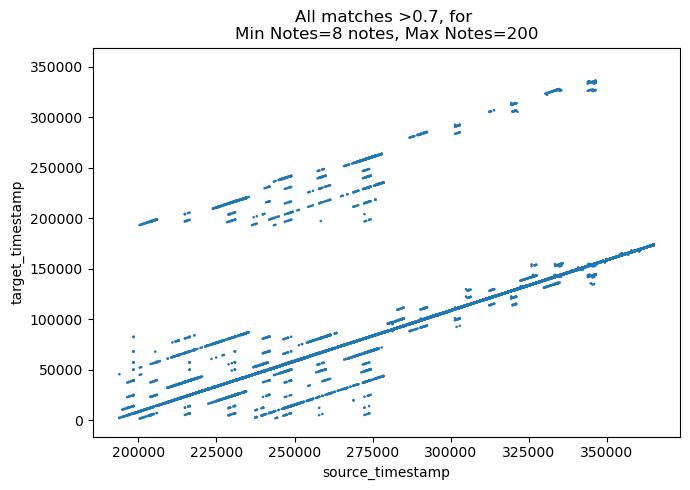

In [110]:
# plotting all mathes > threshold score

plt.rcParams["figure.figsize"] = [7, 5]
plt.rcParams["figure.autolayout"] = True

title = "All matches >"+str(thresh)+", for \nMin Notes=" + str(minNotes) + " notes, Max Notes=" + str(maxNotes)
simsDF.plot.scatter(x="source_timestamp", y="target_timestamp", s='score', title=title)


Percentage matches found: 98.6%
Percentage matches >0.7 found: 98.6%
Percentage matches within 500ms of line: 87.9%
Percentage matches >0.7 and within 500ms of the line: 87.9%
Minimum score of a "right match": 0.73


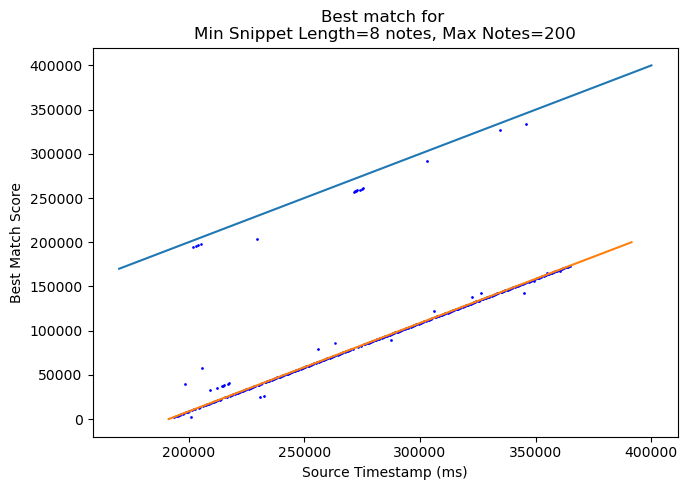

In [122]:
# Plotting best match only

percentage_matches_any = 0
percentage_matches_thresh = 0
percentage_matches_line = 0
percentage_matches_thresh_line = 0
acc = 500                            #ms accuracy for distance from line

plt.rcParams["figure.figsize"] = [7, 5]
plt.rcParams["figure.autolayout"] = True
bestMatches = []

toPlot = simsDFall
# toPlot = simsDFall_old

total = 0
distribution = np.arange(start,end,skip)
distribution_box = []
distribution_hist = []
close_matches = []
min_good_score = 1
for x in range(start,end,skip):
    y = toPlot.loc[toPlot['source_timestamp'] == x]['score']
    total += 1
    if y.any(): 
        y = y.idxmax()
        percentage_matches_any += 1
        if toPlot['score'].loc[y] > thresh:
            percentage_matches_thresh += 1
            if np.abs(toPlot['target_timestamp'].loc[y]-(x-191400))<acc:
                percentage_matches_thresh_line += 1
        if np.abs(toPlot['target_timestamp'].loc[y]-(x-191400))<acc:
            if toPlot['score'].loc[y] < min_good_score:
                min_good_score = toPlot['score'].loc[y]
            distribution_hist.append((toPlot['target_timestamp'].loc[y]-(x-191400)))
            percentage_matches_line += 1
            close_matches.append(toPlot.loc[y].tolist())
#             temp = toPlot['target_timestamp'].loc[y]
#             close_matches[-1].append(temp-(x-191400))
        distribution[(x-start)//skip] = np.abs(toPlot['target_timestamp'].loc[y]-(x-191400))
        distribution_box.append(np.abs(toPlot['target_timestamp'].loc[y]-(x-191400)))
    else:
        distribution[(x-start)//skip] = -1
        continue
#     bestMatch = [toPlot['source_timestamp'].loc[y],toPlot['target_timestamp'].loc[y],toPlot['score'].loc[y],toPlot['source_id_start'].loc[y],toPlot['source_id_end'].loc[y],toPlot['target_id_start'].loc[y],toPlot['target_id_end'].loc[y]]
#     bestMatches.append(bestMatch)
    plt.scatter(toPlot['source_timestamp'].loc[y],toPlot['target_timestamp'].loc[y],toPlot['score'].loc[y],c='blue')
# bestMatches = np.array(bestMatches)
# bestMatchesDF = pd.DataFrame(data=bestMatches, columns=["source_timestamp","target_timestamp", "score", "source_id_start", "source_id_end", "target_id_start", "target_id_end"])   

plt.plot(np.arange(170000,400000),np.arange(170000,400000))
plt.plot(np.arange(191400,391400),np.arange(200000))
percentage_matches_any /= total
percentage_matches_thresh /= total
percentage_matches_line /= total
percentage_matches_thresh_line /= total
print("Percentage matches found: {:.1f}%".format(percentage_matches_any*100))
print("Percentage matches >{:.1f} found: {:.1f}%".format(thresh,percentage_matches_thresh*100))
print("Percentage matches within {:d}ms of line: {:.1f}%".format(acc,percentage_matches_line*100))
print("Percentage matches >{:.1f} and within {:d}ms of the line: {:.1f}%".format(thresh,acc,percentage_matches_thresh_line*100))
print("Minimum score of a \"right match\": {:.2f}".format(min_good_score))

plt.title("Best match for \nMin Snippet Length=" + str(minNotes) + " notes, Max Notes=" + str(maxNotes))
plt.xlabel("Source Timestamp (ms)")
plt.ylabel("Best Match Score")
plt.show()


Distribution Mean:-1.76
Distribution Standad Deviation:13.18


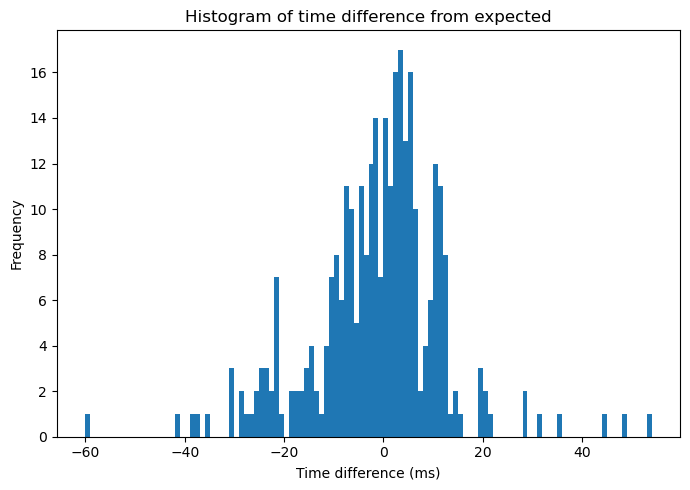

In [123]:
# also plot histogram
mean = np.mean(distribution_hist)
std = np.std(distribution_hist)
print("Distribution Mean:{:.2f}".format(mean))
print("Distribution Standad Deviation:{:.2f}".format(std))
plt.hist(distribution_hist,bins=int(max(distribution_hist)-min(distribution_hist)))
plt.title("Histogram of time difference from expected")
plt.xlabel("Time difference (ms)")
plt.ylabel("Frequency")
plt.show()

Distribution Mean:5.05
Distribution Standad Deviation:29.32


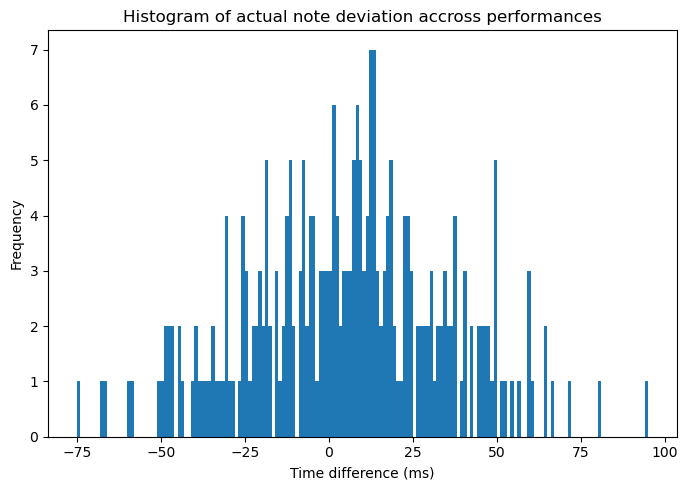

In [97]:
# Note distribution in first vs second playthrough

note_distribution_hist = []
for note in notes[time_to_index(notes,start):time_to_index(notes,end)]:
    # find closest note in history
    note2 = find_note(notes, note[0]-191400, note[1], max_time_dist = 100)
    if note2:
        note_distribution_hist.append(note[0]-notes[note2][0]-191400)
    
mean = np.mean(note_distribution_hist)
std = np.std(note_distribution_hist)
print("Distribution Mean:{:.2f}".format(mean))
print("Distribution Standad Deviation:{:.2f}".format(std))
plt.hist(note_distribution_hist,bins=int(max(note_distribution_hist)-min(note_distribution_hist)))
plt.title("Histogram of actual note deviation accross performances")
plt.xlabel("Time difference (ms)")
plt.ylabel("Frequency")
plt.show()

(306, 9)
source_timestamp    193900.000000
target_timestamp      2492.000000
score                    0.954087
source_id_start        766.000000
source_id_end          758.000000
target_id_start          7.000000
target_id_end            0.000000
match_len                8.000000
match_time            2226.000000
deviation               -8.000000
Name: 0, dtype: float64
(5, 10)
[[196900   5531      0    776    759     18      0     17   5223     31]
 [196400   5035      0    776    759     18      2     17   4723     35]
 [261400  70044      0   1014   1006    262    255      8   1686     44]
 [280400  89048      0   1092   1084    341    332      8   2314     48]
 [279900  88554      0   1091   1083    340    333      8   1833     54]]
[196900   5531      0    776    759     18      0     17   5223     31]


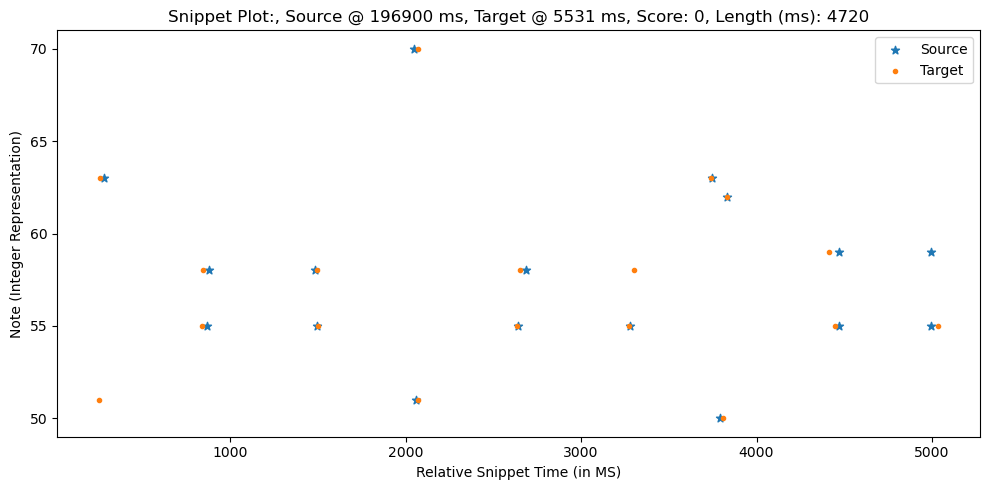

Source end notes:
 [[196394     59     37]
 [196397     55     51]
 [197053     50     42]
 [197056     71     55]
 [197640     59     37]]
Source end notes - 191400: [4994 4997 5653 5656 6240]
Target end notes:
 [[4446   55   49]
 [5035   55   45]
 [5059   59   39]
 [5665   71   55]
 [5676   50   45]]
Source diff between notes: [  3 656   3 584]
Target diff between notes: [589  24 606  11]
Source time - last note: 503
Target time - last note: 496

[196400   5035      0    776    759     18      2     17   4723     35]


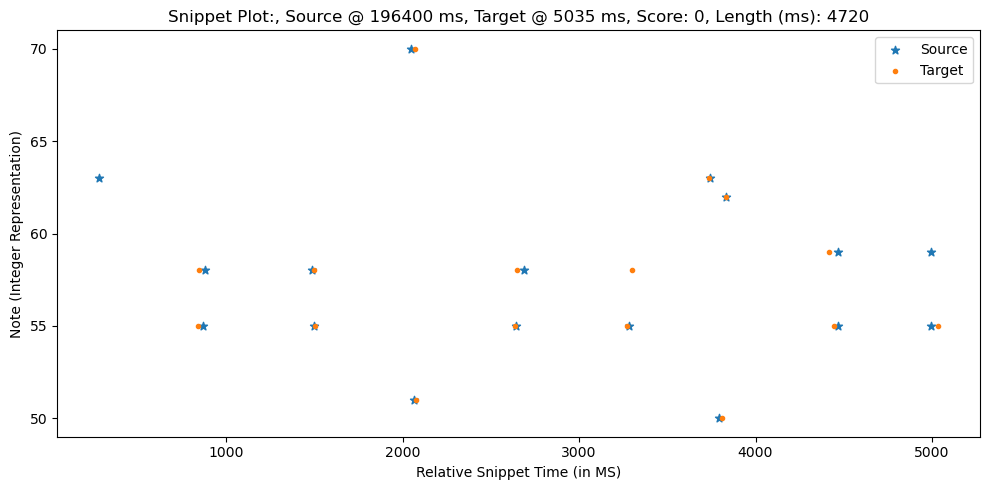

Source end notes:
 [[196394     59     37]
 [196397     55     51]
 [197053     50     42]
 [197056     71     55]
 [197640     59     37]]
Source end notes - 191400: [4994 4997 5653 5656 6240]
Target end notes:
 [[4446   55   49]
 [5035   55   45]
 [5059   59   39]
 [5665   71   55]
 [5676   50   45]]
Source diff between notes: [  3 656   3 584]
Target diff between notes: [589  24 606  11]
Source time - last note: 3
Target time - last note: 0

[261400  70044      0   1014   1006    262    255      8   1686     44]


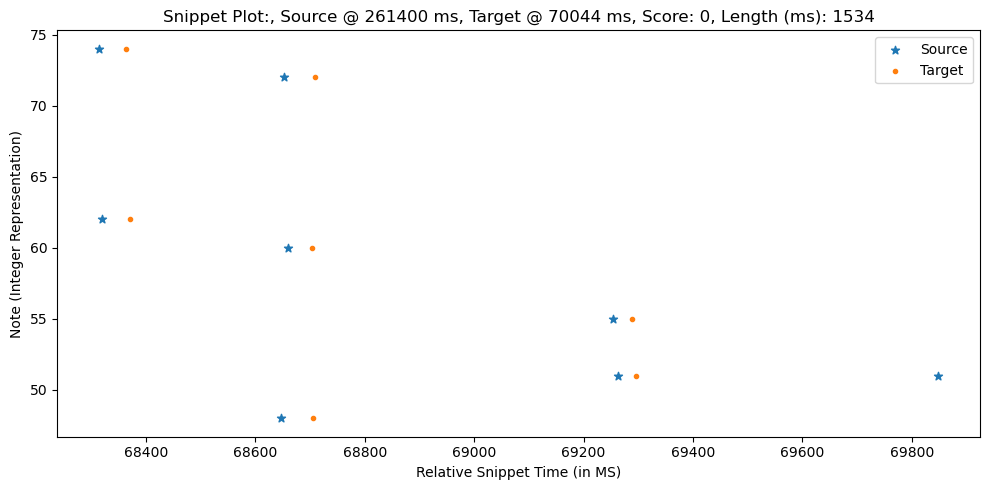

Source end notes:
 [[260663     51     52]
 [261248     51     48]
 [261481     74     61]
 [261820     48     57]
 [261827     75     61]]
Source end notes - 191400: [69263 69848 70081 70420 70427]
Target end notes:
 [[69288    55    34]
 [69296    51    48]
 [69872    51    45]
 [70118    74    50]
 [70121    62    41]]
Source diff between notes: [585 233 339   7]
Target diff between notes: [  8 576 246   3]
Source time - last note: 152
Target time - last note: 748

[280400  89048      0   1092   1084    341    332      8   2314     48]


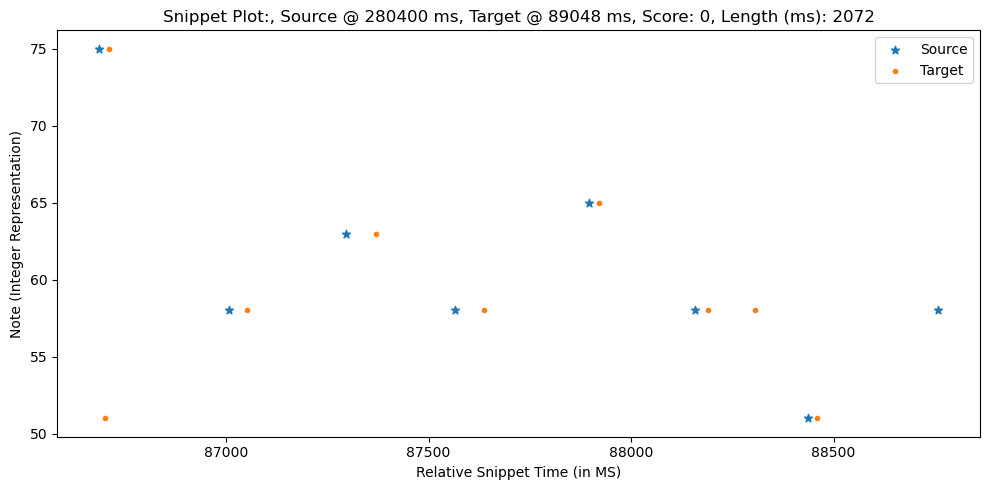

Source end notes:
 [[279838     51     54]
 [280158     58     56]
 [280444     74     67]
 [280447     63     54]
 [280822     58     49]]
Source end notes - 191400: [88438 88758 89044 89047 89422]
Target end notes:
 [[88307    58    15]
 [88460    51    58]
 [88760    58    49]
 [89046    63    56]
 [89055    74    65]]
Source diff between notes: [320 286   3 375]
Target diff between notes: [153 300 286   9]
Source time - last note: 242
Target time - last note: 588

[279900  88554      0   1091   1083    340    333      8   1833     54]


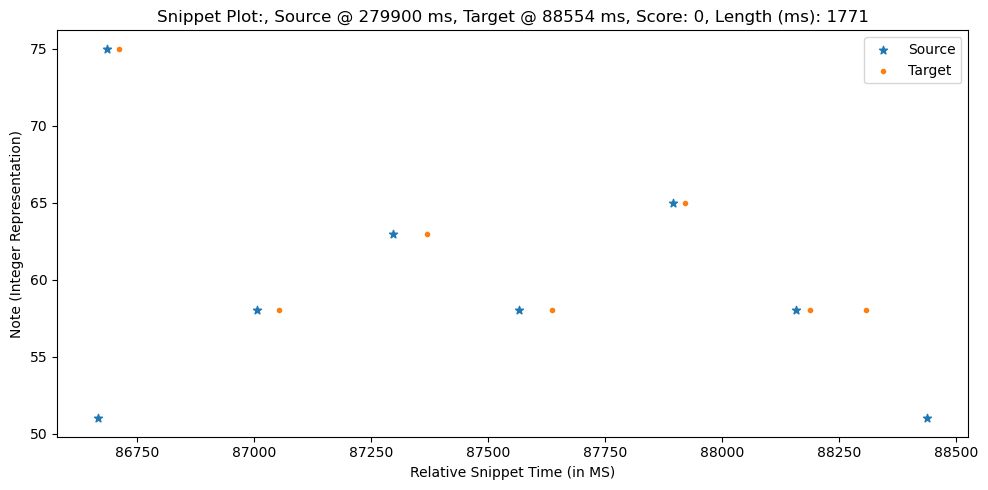

Source end notes:
 [[279559     58     57]
 [279838     51     54]
 [280158     58     56]
 [280444     74     67]
 [280447     63     54]]
Source end notes - 191400: [88159 88438 88758 89044 89047]
Target end notes:
 [[88189    58    57]
 [88307    58    15]
 [88460    51    58]
 [88760    58    49]
 [89046    63    56]]
Source diff between notes: [279 320 286   3]
Target diff between notes: [118 153 300 286]
Source time - last note: 62
Target time - last note: 247



In [124]:
#['source_timestamp', 'target_timestamp','score','source_id_start','source_id_end','target_id_start','target_id_end','match_len','match_time']
k = 5

# dtype = [('source_timestamp', float), ('target_timestamp', float), ('score', float),('source_id_start', float),\
#          ('source_id_end', float),('target_id_start', float),('target_id_end', float),('match_len', float),('match_time', float)]

close_matches_array = np.array(close_matches)
distribution_hist_array = np.array(distribution_hist)
print(close_matches_array.shape)
close_matches_df = pd.DataFrame(data = close_matches_array, columns=['source_timestamp', 'target_timestamp','score','source_id_start','source_id_end','target_id_start','target_id_end','match_len','match_time'])
close_matches_df['deviation'] = distribution_hist_array

# close_matches_array[:,[2,1]] = close_matches_array[:,[1,2]]

# print(close_matches_array.shape)
# print(distribution_hist_array.shape)
# np.hstack((distribution_hist_array,close_matches_array))

# ind = np.argpartition(close_matches_array, k, axis=0, order=[])[:k,:]
# print(ind.shape)
# worst_matches = close_matches_array[ind,np.arange(close_matches_array.shape[1])[None,:]]

# close_matches_sorted = np.sort(close_matches_array,axis=0)

worst_matches = close_matches_df.sort_values(by=['deviation']).iloc[-k:]
worst_matches = np.array(worst_matches,dtype=int)

print(close_matches_df.iloc[0])
print(worst_matches.shape)
print(worst_matches)
for match in worst_matches:
    print(match)
    # plot worst match (in terms of distance from expected timestamp)
#     display_snippet_plot(notes, source_id_start, source_id_end, target_id_start, target_id_end, score, source_timestamp, target_timestamp)
#     display_snippet_plot(notes, int(match[3]), int(match[4]), int(match[5]), int(match[6]), match[2], int(match[0]), int(match[1]))
    sequence1 = np.copy(notes[int(match[4]):int(match[3])])
    sequence1[:,0] = sequence1[:,0]-191400
    sequence2 = np.copy(notes[int(match[6]):int(match[5])])
#     print(notes[1190:])
#     print(sequence1)
#     print(sequence2)
#     two_way_similarity(sequence1, sequence2, disp = True)
    display_snippet_plot_2(sequence1,sequence2,int(match[0]),int(match[1]))
    
    a = notes[int(match[3])-2:int(match[3])+3]
    b = notes[int(match[5])-2:int(match[5])+3]
    print("Source end notes:\n",a)
    print("Source end notes - 191400:",a[:,0] - 191400)
    print("Target end notes:\n",b)
    print("Source diff between notes:",a[1:,0] - a[:-1,0])
    print("Target diff between notes:",b[1:,0] - b[:-1,0])
    print("Source time - last note:",match[0]-notes[int(match[3])-1][0])
    print("Target time - last note:",match[1]-notes[int(match[5])-1][0])
    print()
    
    
    


In [27]:
# Plotting best match score 

plt.rcParams["figure.figsize"] = [10, 3.50]
plt.rcParams["figure.autolayout"] = True

count = 0
# for x in curr_times:
#     y = simsDFall.loc[simsDFall['source_timestamp'] == x]['score'].max()
#     s = simsDFall.loc[(simsDFall['source_timestamp'] == x) & (simsDFall['score'] == y)]['match_len'].max()
# #     print(s)
#     if math.isnan(y):
#         count += 1
#         y = 0
#     else:
#         if (np.abs(simsDFall.loc[(simsDFall['source_timestamp'] == x) & (simsDFall['score'] == y) & (simsDFall['match_len'] == s)]['target_timestamp']-(x-191400))<100).any():
#             color = 'orange'
#         else:
#             color = 'blue'
#         plt.scatter(x,y,1,c=color) # need to include s (len of best match)

currDF = simsDFall.copy()
currDF.sort_values(['source_timestamp', 'score', 'match_len'], ascending=[True, False, False]).drop_duplicates(['source_timestamp']).reset_index(drop=True)
plt.scatter(curr_times,currDF.loc[currDF['source_timestamp'] == curr_times]['score'],currDF.loc[currDF['source_timestamp'] == curr_times]['match_len'])
# scores = s.max(axis = 0)
# # if math.isnan(y):
# #     count += 1
# #     y = 0
    

print(count)
plt.title("Best match score for \nMin Snippet Length=" + str(minNotes) + " notes, Max Notes=" + str(maxNotes))
# plt.colorbar()
plt.xlabel("Source Timestamp (ms)")
plt.ylabel("Best Match Score")
plt.show()

ValueError: ('Lengths must match to compare', (47204,), (348,))

In [ ]:
# Plotting note length of best match  

plt.rcParams["figure.figsize"] = [10, 3.50]
plt.rcParams["figure.autolayout"] = True

count = 0
for x in range(start,end,skip):
    y = simsDFall.loc[simsDFall['source_timestamp'] == x]['score'].max()
    s = simsDFall.loc[(simsDFall['source_timestamp'] == x) & (simsDFall['score'] == y)]['match_len'].max()
#     print(s)
    if math.isnan(y):
        count += 1
        y = 0
    
    if (np.abs(simsDFall.loc[(simsDFall['source_timestamp'] == x) & (simsDFall['score'] == y) & (simsDFall['match_len'] == s)]['target_timestamp']-(x-191400))<100).any():
        color = 'orange'
    else:
        color = 'blue'
    plt.scatter(x,s,1,c=color) # need to include s (len of best match)
    
# print(count)
plt.title("Best match length (in notes) for \nMin Snippet Length=" + str(minNotes) + " notes, Max Notes=" + str(maxNotes))
# plt.colorbar()
plt.xlabel("Source Timestamp (ms)")
plt.ylabel("Match Length (#notes)")
plt.show()

In [ ]:
# Plotting time length of best match  

plt.rcParams["figure.figsize"] = [10, 3.50]
plt.rcParams["figure.autolayout"] = True

count = 0
for x in range(start,end,skip):
    y = simsDFall.loc[simsDFall['source_timestamp'] == x]['score'].max()
    s = simsDFall.loc[(simsDFall['source_timestamp'] == x) & (simsDFall['score'] == y)]['match_time'].max()
#     print(s)
    if math.isnan(y):
        count += 1
        y = 0
    if (np.abs(simsDFall.loc[(simsDFall['source_timestamp'] == x) & (simsDFall['score'] == y) & (simsDFall['match_len'] == s)]['target_timestamp']-(x-191400))<100).any():
        color = 'orange'
    else:
        color = 'blue'
    plt.scatter(x,s,1,c=color) # need to include s (len of best match)
    
# print(count)
plt.title("Best match length (in time) for \nMin Snippet Length=" + str(minNotes) + " notes, Max Notes=" + str(maxNotes))
# plt.colorbar()
plt.xlabel("Source Timestamp (ms)")
plt.ylabel("Match Length (ms)")
plt.show()

In [ ]:
plt.scatter(curr_times,t_exec[curr_times])
# plt.scatter(range(len(t_exec)),t_exec)
plt.title("Execution time (in seconds) for \nMin Snippet Length=" + str(minNotes) + " notes, Max Notes=" + str(maxNotes))
plt.xlabel("Source Timestamp (ms)")
plt.ylabel("Execution Time (s)")
plt.show()

In [ ]:
# Generate predictions
pred_audio = gen_prediction_wav(notes, bestMatchesDF, thresh=0.7, pred_time=skip)
pred_audio /= np.max(pred_audio)

# combine orig and pred audio in left and right
audio_to_save = np.vstack((pred_audio, input_audio)).T

In [ ]:
# Predicted audio
ipd.Audio(pred_audio,rate=samplerate)

In [ ]:
# Combined Audio - NOT RUNNING, just save file and listen on computer
ipd.Audio((audio_to_save),rate=samplerate)

In [ ]:
# # Saves predicted WAV data to file
# pred_fname = "pred.wav"
# wavfile.write(pred_fname, samplerate, audio_to_save)

---

To play stereo, I use Audacity to combine the two mono files for now manually. 

This can be done by loading in the two WAV files to Audacity and moving the L-R sliders such that one of the files only plays out of the left ear and the other plays out of the right. (The two files in this case would be mono.wav and whatever output prediction we get from the above function.

Also, make sure to reduce distortion of the prediction WAV by going to Effect > Volume and Compression > Normalize and set the peak to -1.0 DB.